In [1]:
import sys
# sys.path.insert(0,'/eos/home-a/antoniov/SWAN_projects/env/uproot4/lib/python3.7/site-packages')
# sys.path.insert(0,'/eos/home-a/antoniov/SWAN_projects/env/uproot/lib/python3.8/site-packages')
# sys.path.insert(0,'/eos/home-a/antoniov/SWAN_projects/env/uproot-py39/lib/python3.9/site-packages')
print ( sys.path )

import numpy as np
import pandas as pd
import h5py
import matplotlib as mpl
import matplotlib.pyplot as plt
import mplhep
from matplotlib.colors import LogNorm
from joblib import dump, load
plt.style.use(mplhep.style.CMS)
import matplotlib.font_manager
mpl.rcParams.update(
    {'font.size': 24,
     'font.family': 'sans-serif',
     'legend.fontsize': 24,
     'axes.labelsize': 24,
     'axes.labelpad': 10,
     'xtick.labelsize': 22,
     'ytick.labelsize': 22 
    }
    )
# mpl.rcParams.update(
#     {'font.size': 18,
#      'font.family': 'sans-serif',
#      'font.sans-serif': ['Helvetica'],
#      'legend.fontsize': 14,
#      'axes.labelsize': 18,
#      'xtick.labelsize': 14,
#      'ytick.labelsize': 14
#     }
#     )
mpl.rcParams

['/cvmfs/sft.cern.ch/lcg/releases/condor/8.9.11-50a33/x86_64-centos7-gcc11-opt/lib/python3', '/cvmfs/sft.cern.ch/lcg/views/LCG_105a_swan/x86_64-centos7-gcc11-opt/lib/python3.9/site-packages/itk', '/cvmfs/sft.cern.ch/lcg/views/LCG_105a_swan/x86_64-centos7-gcc11-opt/python', '/cvmfs/sft.cern.ch/lcg/views/LCG_105a_swan/x86_64-centos7-gcc11-opt/lib', '', '/cvmfs/sft.cern.ch/lcg/views/LCG_105a_swan/x86_64-centos7-gcc11-opt/lib/python3.9/site-packages', '/srv/dask/lib', '/cvmfs/sft.cern.ch/lcg/releases/Python/3.9.12-9a1bc/x86_64-centos7-gcc11-opt/lib/python39.zip', '/cvmfs/sft.cern.ch/lcg/releases/Python/3.9.12-9a1bc/x86_64-centos7-gcc11-opt/lib/python3.9', '/cvmfs/sft.cern.ch/lcg/releases/Python/3.9.12-9a1bc/x86_64-centos7-gcc11-opt/lib/python3.9/lib-dynload', '/eos/user/m/malvesga/.local/lib/python3.9/site-packages', '/cvmfs/sft.cern.ch/lcg/releases/Python/3.9.12-9a1bc/x86_64-centos7-gcc11-opt/lib/python3.9/site-packages', '/cvmfs/sft.cern.ch/lcg/views/LCG_105a_swan/x86_64-centos7-gcc11-op

RcParams({'_internal.classic_mode': False,
          'agg.path.chunksize': 0,
          'animation.bitrate': -1,
          'animation.codec': 'h264',
          'animation.convert_args': ['-layers', 'OptimizePlus'],
          'animation.convert_path': 'convert',
          'animation.embed_limit': 20.0,
          'animation.ffmpeg_args': [],
          'animation.ffmpeg_path': 'ffmpeg',
          'animation.frame_format': 'png',
          'animation.html': 'none',
          'animation.writer': 'ffmpeg',
          'axes.autolimit_mode': 'data',
          'axes.axisbelow': 'line',
          'axes.edgecolor': 'black',
          'axes.facecolor': 'white',
          'axes.formatter.limits': [-5, 6],
          'axes.formatter.min_exponent': 0,
          'axes.formatter.offset_threshold': 4,
          'axes.formatter.use_locale': False,
          'axes.formatter.use_mathtext': False,
          'axes.formatter.useoffset': True,
          'axes.grid': False,
          'axes.grid.axis': 'both',
   

In [2]:
# run_ranges_periods, df_run_ranges, fiducial_cuts, fiducial_cuts_all, aperture_period_map, aperture_parametrisation, check_aperture, get_data, process_data_protons_multiRP
from processing import *

# norm_to_1fb = True
norm_to_1fb = False

# load_background = True
load_background = False

lepton_type = 'muon'
# lepton_type = 'electron'

# data_sample = '2017'
data_sample = '2018'

plot_separate_syst_uncertainties = False

save_figures = True

bkg_MC_mix_protons = False

run_dissociative_signal = True
# ## Nominal 
# single_dissociative_to_elastic_factor = 1.5 # relative to single-sided cross section
# double_dissociative_to_elastic_factor = 1.5
# plots_folder_str = "plots_nominal"
# Lower bound
# single_dissociative_to_elastic_factor = 1. # relative to single-sided cross section
# double_dissociative_to_elastic_factor = 1.
# plots_folder_str = "plots_lower"
## Upper bound 
single_dissociative_to_elastic_factor = 3.75 # relative to single-sided cross section
double_dissociative_to_elastic_factor = 5.5
plots_folder_str = "plots_upper"
# run_dissociative_signal = False
# plots_folder_str = "plots_norm"

# upper_mass_ratio_cut = True
upper_mass_ratio_cut = False

# run_tables = False

{'muon': {'2017B': 4.799881474, '2017C1': 5.785813941, '2017C2': 3.786684323, '2017D': 4.247682053, '2017E': 9.312832062, '2017F1': 1.738905587, '2017F2': 8.125575961, '2017F3': 3.674404546}, 'electron': {'2017B': 4.594096155565198, '2017C1': 5.521298099245362, '2017C2': 3.6135646891210857, '2017D': 4.0518639103567, '2017E': 8.906848461089172, '2017F1': 1.6584516422062712, '2017F2': 7.749629938012412, '2017F3': 3.504400870870218}}
Luminosity 2017 muon: 41.471779946999995
Luminosity 2017 electron: 39.60015376646642
{'muon': {'2018A': 12.103512482, '2018B1': 6.3798061, '2018B2': 0.40141386, '2018C': 6.524227381, '2018D1': 19.877577, '2018D2': 10.414449}, 'electron': {'2018A': 12.103189833, '2018B1': 6.379806, '2018B2': 0.40141386, '2018C': 6.527251329, '2018D1': 19.876804, '2018D2': 10.414449}}
Luminosity 2018 muon: 55.700985822999996
Luminosity 2018 electron: 55.702914022


### Event selection

In [3]:
def tau21_ddt_calculation(df, lepton_type, label_jet=None):
    
    label_jet_ = "_nom"
    if label_jet is not None: label_jet_ = label_jet
        
    jet0_tau21_ = ( df.loc[ :, "jet0_tau2"] / df.loc[ :, "jet0_tau1"] )
    
    M_ = 0. ##M is the slope of the tau21 versus rhoprime1
    rhoprime1_ = np.log((((df.loc[ :, "jet0_corrmass" + label_jet_])**2)/(df.loc[ :, "jet0_pt" + label_jet_])))
    if lepton_type == 'muon':
        #M_ = -0.06549078537121121 
        M_ = -0.06985584011450555
    if lepton_type == 'electron':
        #M_ = -0.05984253738963618    
        M_ = -0.057877831836395534   
    jet0_tau21_ddt_ = jet0_tau21_ - (M_*rhoprime1_)
    
    return jet0_tau21_, rhoprime1_, jet0_tau21_ddt_

In [4]:
def select_events( df_events, lepton_type, max_num_tracks = 4, label_jet=None, label_muon=None, label_electron=None ):

    max_num_tracks_ = max_num_tracks
    
#     label_jet_ = "_nom"
#     label_muon_ = "_nom"
#     label_WLep_ = "_nom"
#     label_WW_ = "_nom"
    label_jet_ = "_nom"
    if label_jet is not None: label_jet_ = label_jet
        
    label_muon_ = "_nom"
    if label_muon is not None: label_muon_ = label_muon
        
    label_electron_ = "_nom"
    if label_electron is not None: label_electron_ = label_electron
        
    label_WLep_ = "_nom"
    if label_muon is not None:
        label_WLep_ = label_muon
    elif label_electron is not None:
        label_WLep_ = label_electron
        
    label_WW_ = "_nom"
    if label_jet is not None:
        label_WW_ = label_jet
    elif label_muon is not None:
        label_WW_ = label_muon
    elif label_electron is not None:
        label_WW_ = label_electron
        
    label_xiCMS_ = "_nom"
    if label_jet is not None:
        label_xiCMS_ = label_jet
    elif label_muon is not None:
        label_xiCMS_ = label_muon
    elif label_electron is not None:
        label_xiCMS_ = label_electron
    
    lepton_var_phi_ = ""
    lepton_var_eta_ = ""
    if lepton_type == 'muon':
        lepton_var_phi_ = "muon0_phi"
        lepton_var_eta_ = "muon0_eta"
    elif lepton_type == 'electron':
        lepton_var_phi_ = "electron0_phi"
        lepton_var_eta_ = "electron0_eta"
        
    deltaPhi_jet_lep_ = ( df_events.loc[ :, "jet0_phi"] - df_events.loc[ :, lepton_var_phi_ ] )
    msk_dphi_ = ( deltaPhi_jet_lep_ < -np.pi )
    deltaPhi_jet_lep_.loc[ msk_dphi_ ] = deltaPhi_jet_lep_.loc[ msk_dphi_ ] + 2*np.pi
    msk_dphi_ = ( deltaPhi_jet_lep_ >= np.pi )
    deltaPhi_jet_lep_.loc[ msk_dphi_ ] = deltaPhi_jet_lep_.loc[ msk_dphi_ ] - 2*np.pi
    
    deltaEta_jet_lep_ = ( df_events.loc[ :, "jet0_eta"] - df_events.loc[ :, lepton_var_eta_ ] )
    deltaR_jet_lep_ = np.sqrt( ( deltaPhi_jet_lep_ ) ** 2 + ( deltaEta_jet_lep_ ) ** 2 )
    
    deltaPhi_jet_met_ = ( df_events.loc[ :, "jet0_phi"] - df_events.loc[ :, "met_phi"] )
    msk_dphi_ = ( deltaPhi_jet_met_ < -np.pi )
    deltaPhi_jet_met_.loc[ msk_dphi_ ] = deltaPhi_jet_met_.loc[ msk_dphi_ ] + 2*np.pi
    msk_dphi_ = ( deltaPhi_jet_met_ >= np.pi )
    deltaPhi_jet_met_.loc[ msk_dphi_ ] = deltaPhi_jet_met_.loc[ msk_dphi_ ] - 2*np.pi
    
    deltaPhi_jet_Wlep_ = ( df_events.loc[ :, "jet0_phi"] - df_events.loc[ :, "WLeptonicPhi"] )
    msk_dphi_ = ( deltaPhi_jet_Wlep_ < -np.pi )
    deltaPhi_jet_Wlep_.loc[ msk_dphi_ ] = deltaPhi_jet_Wlep_.loc[ msk_dphi_ ] + 2*np.pi
    msk_dphi_ = ( deltaPhi_jet_Wlep_ >= np.pi )
    deltaPhi_jet_Wlep_.loc[ msk_dphi_ ] = deltaPhi_jet_Wlep_.loc[ msk_dphi_ ] - 2*np.pi
    
    jet0_tau21_, rhoprime1_, jet0_tau21_ddt_ = tau21_ddt_calculation( df_events, lepton_type )
    
    msk_All_ = np.full( df_events.shape[0], True, dtype=bool )
    
    msk_lep_ = None
    if lepton_type == 'muon':
        msk_lep_ = ( ( df_events.loc[ :, "muon0_pt" + label_muon_ ] >= 50.0 ) &
                     ( np.abs( df_events.loc[ :, "muon0_eta"] ) <= 2.4 ) & 
                     ( df_events.loc[ :, "muon0_iso"] <= 0.10 ) )
    elif lepton_type == 'electron':
        msk_lep_ = ( ( df_events.loc[ :, "electron0_pt" + label_electron_ ] >= 50.0 ) &
                     ( np.abs( df_events.loc[ :, "electron0_eta"] ) <= 2.4 ) )
        
#     msk_jet_ = ( ( df_events.loc[ :, "jet0_pt" + label_jet_] >= 200.0 ) &
#                  ( np.abs( df_events.loc[ :, "jet0_eta"] ) <= 2.4 ) )
    msk_jet_ = ( ( df_events.loc[ :, "jet0_pt" + label_jet_] >= 220.0 ) &
                 ( np.abs( df_events.loc[ :, "jet0_eta"] ) <= 2.4 ) )
    
    msk_jet_lep_ = ( deltaR_jet_lep_ >= np.pi/2 )
    
    if lepton_type == 'muon':
        msk_met_ = ( df_events.loc[ :, "met"] >= 40.0 )
    elif lepton_type == 'electron':
        msk_met_ = ( df_events.loc[ :, "met"] >= 100.0 )  
    
    msk_jet_met_ = ( np.abs( deltaPhi_jet_met_ ) >= 2.0 )

    msk_pruned_mass_ = ( ( df_events.loc[ :, "jet0_corrmass" + label_jet_] >= 50.0 ) &
                         ( df_events.loc[ :, "jet0_corrmass" + label_jet_] <= 110.0 ) )

    msk_tau21_       = ( jet0_tau21_ddt_ <= 0.7 )
#     msk_tau21_       = ( jet0_tau21_ <= 0.6 )
    
    
    msk_bjet_veto_   = ( df_events.loc[ :, "num_bjets_ak4"] == 0 )
    
#     msk_xiCMS_ = msk_All_.copy()
    msk_xiCMS_       = ( ( df_events.loc[ :, "xiCMS_45" + label_xiCMS_ ] <= 0.20 ) & ( df_events.loc[ :, "xiCMS_56" + label_xiCMS_ ] <= 0.20 ) ) #& 
                         #( df_events.loc[ :, "R_MWW_MX" + label_xiCMS_ ] >= 0.80 ) & ( np.abs( df_events.loc[ :, "Diff_YWW_YX" + label_xiCMS_ ] <= 0.60 ) ) )
    
    msk_Wlep_ = ( df_events.loc[ :, "WLeptonicPt" + label_WLep_ ] >= 200.0 )
    
    msk_jet_Wlep_ = ( np.abs( deltaPhi_jet_Wlep_ ) >= 2.5 )
    
#     msk_MWW_ = ( df_events.loc[ :, "recoMWW"] >= 500.0 )
    msk_MWW_ = ( df_events.loc[ :, "MWW" + label_WW_ ] >= 500.0 )
    
    msk_extra_tracks_ = ( df_events.loc[ :, "pfcand_nextracks" ] <= max_num_tracks_ )
#     msk_extra_tracks_ = ( df_events.loc[ :, "pfcand_nextracks" ] <= 999 )

    msk_nprotons_ = ( ( df_events.loc[ :, "nprotons_arm0" ] <= 3 ) & ( df_events.loc[ :, "nprotons_arm1" ] <= 3 ) )
    
    masks_ = [ msk_All_, msk_lep_, msk_jet_, msk_jet_lep_, msk_met_, msk_jet_met_,
               msk_pruned_mass_, msk_tau21_, msk_bjet_veto_, msk_xiCMS_,
               msk_Wlep_, msk_jet_Wlep_, msk_MWW_, msk_extra_tracks_, msk_nprotons_ ]
    
#     masks_ = [ msk_All_, msk_lep_, msk_jet_, msk_jet_lep_, msk_met_, msk_jet_met_,
#                msk_pruned_mass_, msk_bjet_veto_, msk_xiCMS_,
#                msk_Wlep_, msk_jet_Wlep_, msk_MWW_, msk_extra_tracks_, msk_nprotons_ ]
    
    lepton_sel_name_ = ""
    jet_lepton_sel_name_ = ""
    if lepton_type == 'muon':
        lepton_sel_name_ = "Muon"
        jet_lepton_sel_name_ = "Jet_Muon"
    elif lepton_type == 'electron':
        lepton_sel_name_ = "Electron"
        jet_lepton_sel_name_ = "Jet_Electron"
        
    selection_keys_ = [ "All", lepton_sel_name_, "Jet", jet_lepton_sel_name_, "MET", "Jet_MET",
                        "PrunedMass", "Tau21", "BJet_Veto", "Xi_CMS",
                        "WLeptonic", "Jet_WLeptonic", "MWW", "ExtraTracks", "NProtons" ]
    
#     selection_keys_ = [ "All", lepton_sel_name_, "Jet", jet_lepton_sel_name_, "MET", "Jet_MET",
#                         "PrunedMass", "BJet_Veto", "Xi_CMS",
#                         "WLeptonic", "Jet_WLeptonic", "MWW", "ExtraTracks", "NProtons" ]
    
    selections_ = {}
    msk_ = masks_[ 0 ].copy()
    for idx_, key_ in enumerate( selection_keys_ ):
        msk_ = msk_ & masks_[ idx_ ]
        selections_[ key_ ] = np.sum( msk_ )
        
    df_events = df_events.loc[ msk_ ]
    
    return df_events, selection_keys_, selections_

### Signal

In [5]:
load_signal = True

labels_signals = []
if data_sample == '2017':
    if lepton_type == 'muon':
        if alpha_type == 'a0w':
#             labels_signals = [ "GGToWW-AQGC-muon-A0W1e-6", "GGToWW-AQGC-muon-A0W2e-6", "GGToWW-AQGC-muon-A0W5e-6" ]
            labels_signals = [ "GGToWW-AQGC-2017-muon-A0W1e-6", "GGToWW-AQGC-2017-muon-A0W2e-6", "GGToWW-AQGC-2017-muon-A0W5e-6" ]
    elif lepton_type == 'electron':
        if alpha_type == 'a0w':
#            labels_signals = [ "GGToWW-AQGC-electron-A0W1e-6", "GGToWW-AQGC-electron-A0W2e-6", "GGToWW-AQGC-electron-A0W5e-6" ]
            labels_signals = [ "GGToWW-AQGC-2017-electron-A0W1e-6", "GGToWW-AQGC-2017-electron-A0W2e-6", "GGToWW-AQGC-2017-electron-A0W5e-6" ]
elif data_sample == '2018':
    if lepton_type == 'muon':
        labels_signals = [ "GGToWW-AQGC-2018-muon-A0W1e-7", "GGToWW-AQGC-2018-muon-A0W2e-7", "GGToWW-AQGC-2018-muon-A0W5e-7", 
                           "GGToWW-AQGC-2018-muon-A0W1e-6", "GGToWW-AQGC-2018-muon-A0W2e-6", "GGToWW-AQGC-2018-muon-A0W5e-6", 
                           "GGToWW-AQGC-2018-muon-ACW5e-7", "GGToWW-AQGC-2018-muon-ACW1e-6", "GGToWW-AQGC-2018-muon-ACW2e-6", 
                           "GGToWW-AQGC-2018-muon-ACW5e-6", "GGToWW-AQGC-2018-muon-ACW1e-5", "GGToWW-AQGC-2018-muon-ACW2e-5" ]
    elif lepton_type == 'electron':
        labels_signals = [ "GGToWW-AQGC-2018-electron-A0W1e-7", "GGToWW-AQGC-2018-electron-A0W2e-7", "GGToWW-AQGC-2018-electron-A0W5e-7", 
                           "GGToWW-AQGC-2018-electron-A0W1e-6", "GGToWW-AQGC-2018-electron-A0W2e-6", "GGToWW-AQGC-2018-electron-A0W5e-6", 
                           "GGToWW-AQGC-2018-electron-ACW5e-7", "GGToWW-AQGC-2018-electron-ACW1e-6", "GGToWW-AQGC-2018-electron-ACW2e-6", 
                           "GGToWW-AQGC-2018-electron-ACW5e-6", "GGToWW-AQGC-2018-electron-ACW1e-5", "GGToWW-AQGC-2018-electron-ACW2e-5" ]
        # labels_signals[:3] - a0w
        # labels_signals[3:] - aCw
            
    
    
df_counts_signals = {}
df_signals_protons_multiRP_index = {}
df_signals_protons_multiRP_events = {}
if load_signal:
#     base_path_ = "output"
    base_path_ = "output-final"
    #base_path_ = "output_new"
    for label_ in labels_signals:
        print ( label_ )
        file_path_ = "{}/data-store-{}.h5".format( base_path_, label_ )
        with pd.HDFStore( file_path_, 'r' ) as store_:
            print ( list( store_ ) )           
            df_counts_signals[ label_ ] = store_[ "counts" ]
            df_signals_protons_multiRP_index[ label_ ] = store_[ "protons_multiRP" ]
            df_signals_protons_multiRP_events[ label_ ] = store_[ "events_multiRP" ]

GGToWW-AQGC-2018-muon-A0W1e-7
['/counts', '/events_multiRP', '/protons_multiRP']
GGToWW-AQGC-2018-muon-A0W2e-7
['/counts', '/events_multiRP', '/protons_multiRP']
GGToWW-AQGC-2018-muon-A0W5e-7
['/counts', '/events_multiRP', '/protons_multiRP']
GGToWW-AQGC-2018-muon-A0W1e-6
['/counts', '/events_multiRP', '/protons_multiRP']
GGToWW-AQGC-2018-muon-A0W2e-6
['/counts', '/events_multiRP', '/protons_multiRP']
GGToWW-AQGC-2018-muon-A0W5e-6
['/counts', '/events_multiRP', '/protons_multiRP']
GGToWW-AQGC-2018-muon-ACW5e-7
['/counts', '/events_multiRP', '/protons_multiRP']
GGToWW-AQGC-2018-muon-ACW1e-6
['/counts', '/events_multiRP', '/protons_multiRP']
GGToWW-AQGC-2018-muon-ACW2e-6
['/counts', '/events_multiRP', '/protons_multiRP']
GGToWW-AQGC-2018-muon-ACW5e-6
['/counts', '/events_multiRP', '/protons_multiRP']
GGToWW-AQGC-2018-muon-ACW1e-5
['/counts', '/events_multiRP', '/protons_multiRP']
GGToWW-AQGC-2018-muon-ACW2e-5
['/counts', '/events_multiRP', '/protons_multiRP']


In [6]:
df_signals_protons_multiRP_index[ "GGToWW-AQGC-2018-"+lepton_type+"-A0W1e-6" ].columns.values

array(['crossingAngle', 'betaStar', 'instLumi', 'xi', 'thx', 'thy', 't',
       'ismultirp', 'rpid', 'arm', 'random', 'jet0_pt', 'jet0_eta',
       'jet0_phi', 'jet0_energy', 'jet0_mass', 'jet0_corrmass',
       'jet0_tau1', 'jet0_tau2', 'jet0_vertexz', 'jet0_px', 'jet0_py',
       'jet0_pz', 'calo_met', 'met', 'met_x', 'met_y', 'met_phi',
       'nVertices', 'num_bjets_ak8', 'num_bjets_ak4', 'num_jets_ak4',
       'pfcand_nextracks', 'pfcand_nextracks_noDRl', 'recoMWhad',
       'recoMWlep', 'recoMWlep_metJER_Up', 'recoMWlep_metJER_Down',
       'recoMWlep_metJES_Up', 'recoMWlep_metJES_Down', 'recoMWW',
       'recoMWW_metJER_Up', 'recoMWW_metJER_Down', 'recoMWW_metJES_Up',
       'recoMWW_metJES_Down', 'recoRapidityWW', 'dphiWW', 'WLeptonicPt',
       'WLeptonicPt_metJER_Up', 'WLeptonicPt_metJER_Down',
       'WLeptonicPt_metJES_Up', 'WLeptonicPt_metJES_Down', 'WLeptonicEta',
       'WLeptonicPhi', 'muon0_pt', 'muon0_eta', 'muon0_phi',
       'muon0_energy', 'muon0_charge', 'muon0_is

In [7]:
labels_signals[6:]

['GGToWW-AQGC-2018-muon-ACW5e-7',
 'GGToWW-AQGC-2018-muon-ACW1e-6',
 'GGToWW-AQGC-2018-muon-ACW2e-6',
 'GGToWW-AQGC-2018-muon-ACW5e-6',
 'GGToWW-AQGC-2018-muon-ACW1e-5',
 'GGToWW-AQGC-2018-muon-ACW2e-5']

In [8]:
# df_signals_protons_multiRP_events[ 'GGToWW-AQGC-2017-muon-A0W1e-6' ]
# df_signals_protons_multiRP_index[ 'GGToWW-AQGC-2018-muon-A0W1e-6' ].columns.values
# df_signals_protons_multiRP_index[ 'GGToWW-AQGC-2018-muon-A0W1e-6' ][ ['pileupWeight','xi','random','arm','ismultirp', 'eff_proton_all'] ]
# df_signals_protons_multiRP_events[ 'GGToWW-AQGC-2018-muon-A0W1e-6' ]
# df_signals_protons_multiRP_events[ 'GGToWW-AQGC-2018-electron-A0W5e-7' ]

label_ref_ = ""
if data_sample == '2017':
    if lepton_type == 'muon':
        label_ref_ = 'GGToWW-AQGC-2017-muon-A0W2e-6'
    elif lepton_type == 'electron':
        label_ref_ = 'GGToWW-AQGC-2017-electron-A0W2e-6'
elif data_sample == '2018':
    if lepton_type == 'muon':
        label_ref_ = 'GGToWW-AQGC-2018-muon-A0W1e-6'
    elif lepton_type == 'electron':
        label_ref_ = 'GGToWW-AQGC-2018-electron-A0W1e-6'
      
pd.set_option('display.max_columns', None)
df_signals_protons_multiRP_events[ label_ref_ ]

crossingAngle  betaStar  \
run lumiblock event hash_id              slice                            
1   1         47    15229368566655889067 0              152.0       0.4   
              39    6615972076948660353  0              152.0       0.4   
              9     16152929223387802418 0              152.0       0.4   
              25    612952748622173452   0              152.0       0.4   
              14    10567006550655886280 0              152.0       0.4   
...                                                       ...       ...   
              56    6653175637758252602  0              152.0       0.4   
              52    16289905149151803676 0              152.0       0.4   
              24    15425204359478783634 0              152.0       0.4   
              45    6700407395091971073  0              152.0       0.4   
              50    9091931865045312748  0              152.0       0.4   

                                                instLumi     jet0_pt  \
run lumiblock event hash_id              slice                         
1   1         47    15229368566655889067 0           0.0  582.643921   
              39    6615972076948660353  0           0.0  213.974960   
              9     16152929223387802418 0           0.0  234.147827   
              25    612952748622173452   0           0.0  491.847076   
              14    10567006550655886280 0           0.0  309.176147   
...                                                  ...         ...   
              56    6653175637758252602  0           0.0  448.476868   
              52    16289905149151803676 0           0.0  293.653656   
              24    15425204359478783634 0           0.0  356.139832   
              45    6700407395091971073  0           0.0  213.539993   
              50    9091931865045312748  0           0.0  712.183838   

                                                jet0_eta  jet0_phi  \
run lumiblock event hash_id              slice                       
1   1         47    15229368566655889067 0     -0.021575 -1.090935   
              39    6615972076948660353  0     -0.659755 -0.968055   
              9     16152929223387802418 0     -0.147853  2.169319   
              25    612952748622173452   0      0.460279 -1.664441   
              14    10567006550655886280 0      0.229405 -1.962235   
...                                                  ...       ...   
              56    6653175637758252602  0      1.334890 -2.981384   
              52    16289905149151803676 0     -0.835408  1.637657   
              24    15425204359478783634 0     -1.449022 -0.894164   
              45    6700407395091971073  0      0.909278 -0.158602   
              50    9091931865045312748  0     -0.650220  0.312413   

                                                jet0_energy  jet0_mass  \
run lumiblock event hash_id              slice                           
1   1         47    15229368566655889067 0       592.300964  73.230850   
              39    6615972076948660353  0       267.436951  32.587322   
              9     16152929223387802418 0       240.822052  11.273107   
              25    612952748622173452   0       554.811646  83.352753   
              14    10567006550655886280 0       331.127686  71.394066   
...                                                     ...        ...   
              56    6653175637758252602  0       916.845581  62.028114   
              52    16289905149151803676 0       416.540771  88.258957   
              24    15425204359478783634 0       807.454346  79.405746   
              45    6700407395091971073  0       309.582886   6.584173   
              50    9091931865045312748  0       875.097046  78.264168   

                                                jet0_corrmass  jet0_tau1  \
run lumiblock event hash_id              slice                             
1   1         47    15229368566655889067 0          78.207260   0.172779   
              39    6615972076948

In [9]:
msk_columns_ = [ key_[ :len( 'MX' ) ] == 'MX' for key_ in df_signals_protons_multiRP_events[ label_ref_ ].columns ]
columns_ = df_signals_protons_multiRP_events[ label_ref_ ].columns[ msk_columns_ ]
df_signals_protons_multiRP_events[ label_ref_ ][ columns_ ]

MX       MX_nom  \
run lumiblock event hash_id              slice                             
1   1         47    15229368566655889067 0      1312.237777  1312.237777   
              39    6615972076948660353  0       854.955085   854.955085   
              9     16152929223387802418 0       801.432282   801.432282   
              25    612952748622173452   0      1063.100018  1063.100018   
              14    10567006550655886280 0       834.002279   834.002279   
...                                                     ...          ...   
              56    6653175637758252602  0      1838.462412  1838.462412   
              52    16289905149151803676 0      1144.393720  1144.393720   
              24    15425204359478783634 0      1261.179902  1261.179902   
              45    6700407395091971073  0       958.036698   958.036698   
              50    9091931865045312748  0      1602.983505  1602.983505   

                                                 MX_nom_nom  MX_nom_p100  \
run lumiblock event hash_id              slice                             
1   1         47    15229368566655889067 0      1312.237777  1360.085100   
              39    6615972076948660353  0       854.955085   889.627648   
              9     16152929223387802418 0       801.432282   833.860232   
              25    612952748622173452   0      1063.100018  1105.862147   
              14    10567006550655886280 0       834.002279   866.315695   
...                                                     ...          ...   
              56    6653175637758252602  0      1838.462412  1899.950428   
              52    16289905149151803676 0      1144.393720  1190.052455   
              24    15425204359478783634 0      1261.179902  1303.240532   
              45    6700407395091971073  0       958.036698   994.920054   
              50    9091931865045312748  0      1602.983505  1657.841802   

                                                MX_nom_m100  MX_p100_nom  \
run lumiblock event hash_id              slice                             
1   1         47    15229368566655889067 0      1262.578462  1357.690618   
              39    6615972076948660353  0       818.815594   886.222981   
              9     16152929223387802418 0       767.635708   831.531323   
              25    612952748622173452   0      1018.544136  1099.695932   
              14    10567006550655886280 0       800.385487   866.311997   
...                                                     ...          ...   
              56    6653175637758252602  0      1774.845604  1915.108347   
              52    16289905149151803676 0      1096.835984  1183.868227   
              24    15425204359478783634 0      1217.667213  1308.489656   
              45    6700407395091971073  0       919.675227   993.612487   
              50    9091931865045312748  0      1546.180069  1658.123111   

                                                MX_p100_p100  MX_p100_m100  \
run lumiblock event hash_id              slice                               
1   1         47    15229368566655889067 0       1407.195284   1306.311243   
              39    6615972076948660353  0        922.163629    848.761795   
              9     16152929223387802418 0        865.177135    796.465447   
              25    612952748622173452   0       1143.930109   1053.606280   
              14    10567006550655886280 0        899.877185    831.392810   
...                                                      ...           ...   
              56    6653175637758252602  0       1979.159744   1848.839275   
              52    16289905149151803676 0       1231.101895   1134.670033   
              24    15425204359478783634 0       1352.128111   1263.344739   
              45    6700407395091971073  0       1031.865526    953.826549   
              50    9091931865045312748  0       1714.868428   1599.365742   

                                                MX_m100_nom  MX_m100_p100  

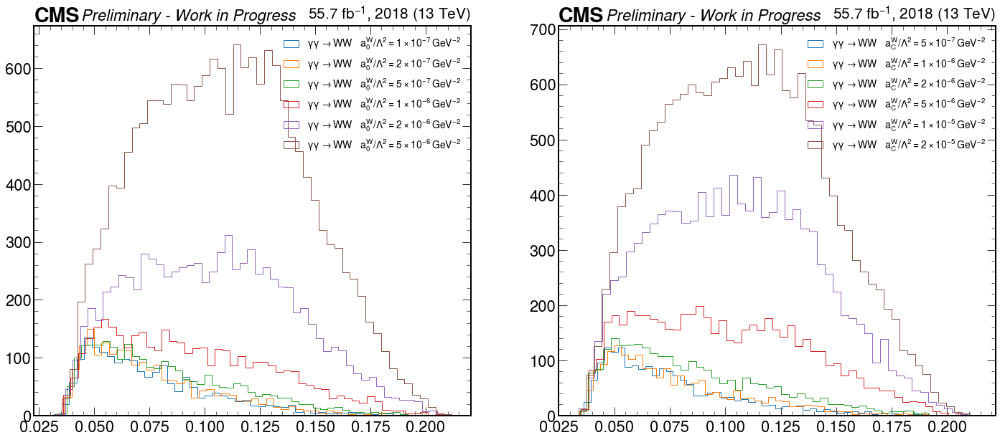

In [10]:
labels_samples = {
#     "GGToWW-AQGC-A0W5e-7": r"$\gamma\gamma \to WW \quad a_0^W/\Lambda^2 = 5 \times 10^{-7} \,\rm{GeV}^{-2}$",
    "GGToWW-AQGC-A0W1e-7": r"$\gamma\gamma \to WW \quad a_0^W/\Lambda^2 = 1 \times 10^{-7} \,\rm{GeV}^{-2}$",
    "GGToWW-AQGC-A0W2e-7": r"$\gamma\gamma \to WW \quad a_0^W/\Lambda^2 = 2 \times 10^{-7} \,\rm{GeV}^{-2}$",
    "GGToWW-AQGC-A0W5e-7": r"$\gamma\gamma \to WW \quad a_0^W/\Lambda^2 = 5 \times 10^{-7} \,\rm{GeV}^{-2}$",
    "GGToWW-AQGC-A0W1e-6": r"$\gamma\gamma \to WW \quad a_0^W/\Lambda^2 = 1 \times 10^{-6} \,\rm{GeV}^{-2}$",
    "GGToWW-AQGC-A0W2e-6": r"$\gamma\gamma \to WW \quad a_0^W/\Lambda^2 = 2 \times 10^{-6} \,\rm{GeV}^{-2}$",
    "GGToWW-AQGC-A0W5e-6": r"$\gamma\gamma \to WW \quad a_0^W/\Lambda^2 = 5 \times 10^{-6} \,\rm{GeV}^{-2}$",
    "GGToWW-AQGC-ACW5e-7": r"$\gamma\gamma \to WW \quad a_C^W/\Lambda^2 = 5 \times 10^{-7} \,\rm{GeV}^{-2}$",
    "GGToWW-AQGC-ACW1e-6": r"$\gamma\gamma \to WW \quad a_C^W/\Lambda^2 = 1 \times 10^{-6} \,\rm{GeV}^{-2}$",
    "GGToWW-AQGC-ACW2e-6": r"$\gamma\gamma \to WW \quad a_C^W/\Lambda^2 = 2 \times 10^{-6} \,\rm{GeV}^{-2}$",
    "GGToWW-AQGC-ACW5e-6": r"$\gamma\gamma \to WW \quad a_C^W/\Lambda^2 = 5 \times 10^{-6} \,\rm{GeV}^{-2}$",
    "GGToWW-AQGC-ACW1e-5": r"$\gamma\gamma \to WW \quad a_C^W/\Lambda^2 = 1 \times 10^{-5} \,\rm{GeV}^{-2}$",
    "GGToWW-AQGC-ACW2e-5": r"$\gamma\gamma \to WW \quad a_C^W/\Lambda^2 = 2 \times 10^{-5} \,\rm{GeV}^{-2}$"
}
labels_samples[ "GGToWW-AQGC-muon-A0W1e-7" ] = labels_samples[ "GGToWW-AQGC-A0W1e-7" ]
labels_samples[ "GGToWW-AQGC-muon-A0W2e-7" ] = labels_samples[ "GGToWW-AQGC-A0W2e-7" ]
labels_samples[ "GGToWW-AQGC-muon-A0W5e-7" ] = labels_samples[ "GGToWW-AQGC-A0W5e-7" ]
labels_samples[ "GGToWW-AQGC-muon-A0W1e-6" ] = labels_samples[ "GGToWW-AQGC-A0W1e-6" ]
labels_samples[ "GGToWW-AQGC-muon-A0W2e-6" ] = labels_samples[ "GGToWW-AQGC-A0W2e-6" ]
labels_samples[ "GGToWW-AQGC-muon-A0W5e-6" ] = labels_samples[ "GGToWW-AQGC-A0W5e-6" ]
labels_samples[ "GGToWW-AQGC-electron-A0W1e-7" ] = labels_samples[ "GGToWW-AQGC-A0W1e-7" ]
labels_samples[ "GGToWW-AQGC-electron-A0W2e-7" ] = labels_samples[ "GGToWW-AQGC-A0W2e-7" ]
labels_samples[ "GGToWW-AQGC-electron-A0W5e-7" ] = labels_samples[ "GGToWW-AQGC-A0W5e-7" ]
labels_samples[ "GGToWW-AQGC-electron-A0W1e-6" ] = labels_samples[ "GGToWW-AQGC-A0W1e-6" ]
labels_samples[ "GGToWW-AQGC-electron-A0W2e-6" ] = labels_samples[ "GGToWW-AQGC-A0W2e-6" ]
labels_samples[ "GGToWW-AQGC-electron-A0W5e-6" ] = labels_samples[ "GGToWW-AQGC-A0W5e-6" ]
labels_samples[ "GGToWW-AQGC-2017-muon-A0W1e-6" ] = labels_samples[ "GGToWW-AQGC-A0W1e-6" ]
labels_samples[ "GGToWW-AQGC-2017-muon-A0W2e-6" ] = labels_samples[ "GGToWW-AQGC-A0W2e-6" ]
labels_samples[ "GGToWW-AQGC-2017-muon-A0W5e-6" ] = labels_samples[ "GGToWW-AQGC-A0W5e-6" ]
labels_samples[ "GGToWW-AQGC-2017-electron-A0W1e-6" ] = labels_samples[ "GGToWW-AQGC-A0W1e-6" ]
labels_samples[ "GGToWW-AQGC-2017-electron-A0W2e-6" ] = labels_samples[ "GGToWW-AQGC-A0W2e-6" ]
labels_samples[ "GGToWW-AQGC-2017-electron-A0W5e-6" ] = labels_samples[ "GGToWW-AQGC-A0W5e-6" ]
# labels_samples[ "GGToWW-AQGC-2018-muon-A0W5e-7" ] = labels_samples[ "GGToWW-AQGC-A0W5e-7" ]
labels_samples[ "GGToWW-AQGC-2018-muon-A0W1e-7" ] = labels_samples[ "GGToWW-AQGC-A0W1e-7" ]
labels_samples[ "GGToWW-AQGC-2018-muon-A0W2e-7" ] = labels_samples[ "GGToWW-AQGC-A0W2e-7" ]
labels_samples[ "GGToWW-AQGC-2018-muon-A0W5e-7" ] = labels_samples[ "GGToWW-AQGC-A0W5e-7" ]
labels_samples[ "GGToWW-AQGC-2018-muon-A0W1e-6" ] = labels_samples[ "GGToWW-AQGC-A0W1e-6" ]
labels_samples[ "GGToWW-AQGC-2018-muon-A0W2e-6" ] = labels_samples[ "GGToWW-AQGC-A0W2e-6" ]
labels_samples[ "GGToWW-AQGC-2018-muon-A0W5e-6" ] = labels_samples[ "GGToWW-AQGC-A0W5e-6" ]
# labels_samples[ "GGToWW-AQGC-2018-electron-A0W5e-7" ] = labels_samples[ "GGToWW-AQGC-A0W5e-7" ]
labels_samples[ "GGToWW-AQGC-2018-electron-A0W1e-7" ] = labels_samples[ "GGToWW-AQGC-A0W1e-7" ]
labels_samples[ "GGToWW-AQGC-2018-electron-A0W2e-7" ] = labels_samples[ "GGToWW-AQGC-A0W2e-7" ]
labels_samples[ "GGToWW-AQGC-2018-electron-A0W5e-7" ] = labels_samples[ "GGToWW-AQGC-A0W5e-7" ]
labels_samples[ "GGToWW-AQGC-2018-electron-A0W1e-6" ] = labels_samples[ "GGToWW-AQGC-A0W1e-6" ]
labels_samples[ "GGToWW-AQGC-2018-electron-A0W2e-6" ] = labels_samples[ "GGToWW-AQGC-A0W2e-6" ]
labels_samples[ "GGToWW-AQGC-2018-electron-A0W5e-6" ] = labels_samples[ "GGToWW-AQGC-A0W5e-6" ]
labels_samples[ "GGToWW-AQGC-muon-ACW5e-7" ] = labels_samples[ "GGToWW-AQGC-ACW5e-7" ]
labels_samples[ "GGToWW-AQGC-muon-ACW1e-6" ] = labels_samples[ "GGToWW-AQGC-ACW1e-6" ]
labels_samples[ "GGToWW-AQGC-muon-ACW2e-6" ] = labels_samples[ "GGToWW-AQGC-ACW2e-6" ]
labels_samples[ "GGToWW-AQGC-muon-ACW5e-6" ] = labels_samples[ "GGToWW-AQGC-ACW5e-6" ]
labels_samples[ "GGToWW-AQGC-muon-ACW1e-5" ] = labels_samples[ "GGToWW-AQGC-ACW1e-5" ]
labels_samples[ "GGToWW-AQGC-muon-ACW2e-5" ] = labels_samples[ "GGToWW-AQGC-ACW2e-5" ]
labels_samples[ "GGToWW-AQGC-electron-ACW5e-7" ] = labels_samples[ "GGToWW-AQGC-ACW5e-7" ]
labels_samples[ "GGToWW-AQGC-electron-ACW1e-6" ] = labels_samples[ "GGToWW-AQGC-ACW1e-6" ]
labels_samples[ "GGToWW-AQGC-electron-ACW2e-6" ] = labels_samples[ "GGToWW-AQGC-ACW2e-6" ]
labels_samples[ "GGToWW-AQGC-electron-ACW5e-6" ] = labels_samples[ "GGToWW-AQGC-ACW5e-6" ]
labels_samples[ "GGToWW-AQGC-electron-ACW1e-5" ] = labels_samples[ "GGToWW-AQGC-ACW1e-5" ]
labels_samples[ "GGToWW-AQGC-electron-ACW2e-5" ] = labels_samples[ "GGToWW-AQGC-ACW2e-5" ]
labels_samples[ "GGToWW-AQGC-2017-muon-ACW5e-7" ] = labels_samples[ "GGToWW-AQGC-ACW5e-7" ]
labels_samples[ "GGToWW-AQGC-2017-muon-ACW5e-6" ] = labels_samples[ "GGToWW-AQGC-ACW5e-6" ]
labels_samples[ "GGToWW-AQGC-2017-muon-ACW2e-5" ] = labels_samples[ "GGToWW-AQGC-ACW2e-5" ]
labels_samples[ "GGToWW-AQGC-2017-electron-ACW5e-7" ] = labels_samples[ "GGToWW-AQGC-ACW5e-7" ]
labels_samples[ "GGToWW-AQGC-2017-electron-ACW5e-6" ] = labels_samples[ "GGToWW-AQGC-ACW5e-6" ]
labels_samples[ "GGToWW-AQGC-2017-electron-ACW2e-5" ] = labels_samples[ "GGToWW-AQGC-ACW2e-5" ]
labels_samples[ "GGToWW-AQGC-2018-muon-ACW5e-7" ] = labels_samples[ "GGToWW-AQGC-ACW5e-7" ]
labels_samples[ "GGToWW-AQGC-2018-muon-ACW1e-6" ] = labels_samples[ "GGToWW-AQGC-ACW1e-6" ]
labels_samples[ "GGToWW-AQGC-2018-muon-ACW2e-6" ] = labels_samples[ "GGToWW-AQGC-ACW2e-6" ]
labels_samples[ "GGToWW-AQGC-2018-muon-ACW5e-6" ] = labels_samples[ "GGToWW-AQGC-ACW5e-6" ]
labels_samples[ "GGToWW-AQGC-2018-muon-ACW1e-5" ] = labels_samples[ "GGToWW-AQGC-ACW1e-5" ]
labels_samples[ "GGToWW-AQGC-2018-muon-ACW2e-5" ] = labels_samples[ "GGToWW-AQGC-ACW2e-5" ]
labels_samples[ "GGToWW-AQGC-2018-electron-ACW5e-7" ] = labels_samples[ "GGToWW-AQGC-ACW5e-7" ]
labels_samples[ "GGToWW-AQGC-2018-electron-ACW1e-6" ] = labels_samples[ "GGToWW-AQGC-ACW1e-6" ]
labels_samples[ "GGToWW-AQGC-2018-electron-ACW2e-6" ] = labels_samples[ "GGToWW-AQGC-ACW2e-6" ]
labels_samples[ "GGToWW-AQGC-2018-electron-ACW5e-6" ] = labels_samples[ "GGToWW-AQGC-ACW5e-6" ]
labels_samples[ "GGToWW-AQGC-2018-electron-ACW1e-5" ] = labels_samples[ "GGToWW-AQGC-ACW1e-5" ]
labels_samples[ "GGToWW-AQGC-2018-electron-ACW2e-5" ] = labels_samples[ "GGToWW-AQGC-ACW2e-5" ]

if load_signal:
    fig, axes = plt.subplots( 1, 2, figsize=(2*12,10) )
    for label_ in labels_signals[:6]: 
        axes[0].hist( df_signals_protons_multiRP_index[ label_ ][ 'xi' ], histtype='step', density=False, bins=50, label=labels_samples[ label_ ] )
    axes[0].legend( loc='best', fontsize=14 )
    mplhep.cms.label('Preliminary - Work in Progress', ax=axes[0], data=True, lumi=55.7, year=2018, loc=0, fontsize=22)
    
    for label_ in labels_signals[6:]: 
        axes[1].hist( df_signals_protons_multiRP_index[ label_ ][ 'xi' ], histtype='step', density=False, bins=50, label=labels_samples[ label_ ] )
    axes[1].legend( loc='best', fontsize=14 )
    mplhep.cms.label('Preliminary - Work in Progress', ax=axes[1], data=True, lumi=55.7, year=2018, loc=0, fontsize=22)
    
#     fig = plt.figure( figsize=(12,10) )
#     for label_ in labels_signals[:3]: 
#         plt.hist( df_signals_protons_multiRP_index[ label_ ][ 'xi' ], histtype='step', density=False, bins=50, label=labels_samples[ label_ ] )
#     plt.legend( loc='best', fontsize=14 )

In [11]:
for label_ in labels_signals:
    jet0_tau21, rhoprime1, jet0_tau21_ddt = tau21_ddt_calculation(df_signals_protons_multiRP_events[ label_ ], lepton_type)
    print(jet0_tau21)
    df_signals_protons_multiRP_events[ label_ ][ "jet0_tau21" ] = jet0_tau21
    df_signals_protons_multiRP_events[ label_ ][ "jet0_tau21_ddt" ] = jet0_tau21_ddt

run  lumiblock  event  hash_id               slice
1    1          14     2966008387310822750   0        0.794940
                33     5480993288619747191   0        0.607981
                50     7811016634389351017   0        0.475059
                35     8818226675747049530   0        0.742975
                1      17751442426663485861  0        0.413899
                                                        ...   
                53     3605583601549327552   0        0.340691
                27     9390581389541256023   0        0.597196
                18     13398374148929825538  0        0.405345
                30     9805553159082941451   0        0.480971
                39     10376811137995619203  0        0.670390
Length: 545, dtype: float32
run  lumiblock  event  hash_id               slice
1    1          71     14148301483332454614  0        0.323753
                13     1597172181720516110   0        0.240370
                3      14814409561481229769  0     

### Ouf of acceptance protons

### Signal with pileup/data protons

In [12]:
labels_signals_mix_protons = []
if data_sample == '2017':
    if lepton_type == 'muon':
#         labels_signals_mix_protons = [ "GGToWW-AQGC-mix_protons-A0W1e-6", "GGToWW-AQGC-mix_protons-A0W2e-6", "GGToWW-AQGC-mix_protons-A0W5e-6" ]
#         labels_signals_mix_protons = [ "GGToWW-AQGC-mix_protons-muon-A0W1e-6", "GGToWW-AQGC-mix_protons-muon-A0W2e-6", "GGToWW-AQGC-mix_protons-muon-A0W5e-6" ]
        labels_signals_mix_protons = [ "GGToWW-AQGC-mix_protons-2017-muon-A0W1e-6", "GGToWW-AQGC-mix_protons-2017-muon-A0W2e-6", "GGToWW-AQGC-mix_protons-2017-muon-A0W5e-6" ]
    elif lepton_type == 'electron':
#         labels_signals_mix_protons = [ "GGToWW-AQGC-mix_protons-electron-A0W1e-6", "GGToWW-AQGC-mix_protons-electron-A0W2e-6", "GGToWW-AQGC-mix_protons-electron-A0W5e-6" ]
        labels_signals_mix_protons = [ "GGToWW-AQGC-mix_protons-2017-electron-A0W1e-6", "GGToWW-AQGC-mix_protons-2017-electron-A0W2e-6", "GGToWW-AQGC-mix_protons-2017-electron-A0W5e-6" ]
elif data_sample == '2018':
    if lepton_type == 'muon':
        labels_signals_mix_protons = [ "GGToWW-AQGC-mix_protons-2018-muon-A0W1e-7", "GGToWW-AQGC-mix_protons-2018-muon-A0W2e-7", "GGToWW-AQGC-mix_protons-2018-muon-A0W5e-7",
                                       "GGToWW-AQGC-mix_protons-2018-muon-A0W1e-6", "GGToWW-AQGC-mix_protons-2018-muon-A0W2e-6", "GGToWW-AQGC-mix_protons-2018-muon-A0W5e-6", 
                                       "GGToWW-AQGC-mix_protons-2018-muon-ACW5e-7", "GGToWW-AQGC-mix_protons-2018-muon-ACW1e-6", "GGToWW-AQGC-mix_protons-2018-muon-ACW2e-6", 
                                       "GGToWW-AQGC-mix_protons-2018-muon-ACW5e-6", "GGToWW-AQGC-mix_protons-2018-muon-ACW1e-5", "GGToWW-AQGC-mix_protons-2018-muon-ACW2e-5" ]
    elif lepton_type == 'electron':
        labels_signals_mix_protons = [ "GGToWW-AQGC-mix_protons-2018-electron-A0W1e-7", "GGToWW-AQGC-mix_protons-2018-electron-A0W2e-7", "GGToWW-AQGC-mix_protons-2018-electron-A0W5e-7",
                                       "GGToWW-AQGC-mix_protons-2018-electron-A0W1e-6", "GGToWW-AQGC-mix_protons-2018-electron-A0W2e-6", "GGToWW-AQGC-mix_protons-2018-electron-A0W5e-6", 
                                       "GGToWW-AQGC-mix_protons-2018-electron-ACW5e-7", "GGToWW-AQGC-mix_protons-2018-electron-ACW1e-6", "GGToWW-AQGC-mix_protons-2018-electron-ACW2e-6", 
                                       "GGToWW-AQGC-mix_protons-2018-electron-ACW5e-6", "GGToWW-AQGC-mix_protons-2018-electron-ACW1e-5", "GGToWW-AQGC-mix_protons-2018-electron-ACW2e-5" ]
map_labels_from_mix_protons = {}
map_labels_from_mix_protons[ 'GGToWW-AQGC-mix_protons-2017-muon-A0W1e-6' ] = 'GGToWW-AQGC-2017-muon-A0W1e-6'
map_labels_from_mix_protons[ 'GGToWW-AQGC-mix_protons-2017-muon-A0W2e-6' ] = 'GGToWW-AQGC-2017-muon-A0W2e-6'
map_labels_from_mix_protons[ 'GGToWW-AQGC-mix_protons-2017-muon-A0W5e-6' ] = 'GGToWW-AQGC-2017-muon-A0W5e-6'
map_labels_from_mix_protons[ 'GGToWW-AQGC-mix_protons-2017-electron-A0W1e-6' ] = 'GGToWW-AQGC-2017-electron-A0W1e-6'
map_labels_from_mix_protons[ 'GGToWW-AQGC-mix_protons-2017-electron-A0W2e-6' ] = 'GGToWW-AQGC-2017-electron-A0W2e-6'
map_labels_from_mix_protons[ 'GGToWW-AQGC-mix_protons-2017-electron-A0W5e-6' ] = 'GGToWW-AQGC-2017-electron-A0W5e-6'
map_labels_from_mix_protons[ 'GGToWW-AQGC-mix_protons-2018-muon-A0W1e-7' ] = 'GGToWW-AQGC-2018-muon-A0W1e-7'
map_labels_from_mix_protons[ 'GGToWW-AQGC-mix_protons-2018-muon-A0W2e-7' ] = 'GGToWW-AQGC-2018-muon-A0W2e-7'
map_labels_from_mix_protons[ 'GGToWW-AQGC-mix_protons-2018-muon-A0W5e-7' ] = 'GGToWW-AQGC-2018-muon-A0W5e-7'
map_labels_from_mix_protons[ 'GGToWW-AQGC-mix_protons-2018-muon-A0W1e-6' ] = 'GGToWW-AQGC-2018-muon-A0W1e-6'
map_labels_from_mix_protons[ 'GGToWW-AQGC-mix_protons-2018-muon-A0W2e-6' ] = 'GGToWW-AQGC-2018-muon-A0W2e-6'
map_labels_from_mix_protons[ 'GGToWW-AQGC-mix_protons-2018-muon-A0W5e-6' ] = 'GGToWW-AQGC-2018-muon-A0W5e-6'
map_labels_from_mix_protons[ 'GGToWW-AQGC-mix_protons-2018-muon-ACW5e-7' ] = 'GGToWW-AQGC-2018-muon-ACW5e-7'
map_labels_from_mix_protons[ 'GGToWW-AQGC-mix_protons-2018-muon-ACW1e-6' ] = 'GGToWW-AQGC-2018-muon-ACW1e-6'
map_labels_from_mix_protons[ 'GGToWW-AQGC-mix_protons-2018-muon-ACW2e-6' ] = 'GGToWW-AQGC-2018-muon-ACW2e-6'
map_labels_from_mix_protons[ 'GGToWW-AQGC-mix_protons-2018-muon-ACW5e-6' ] = 'GGToWW-AQGC-2018-muon-ACW5e-6'
map_labels_from_mix_protons[ 'GGToWW-AQGC-mix_protons-2018-muon-ACW1e-5' ] = 'GGToWW-AQGC-2018-muon-ACW1e-5'
map_labels_from_mix_protons[ 'GGToWW-AQGC-mix_protons-2018-muon-ACW2e-5' ] = 'GGToWW-AQGC-2018-muon-ACW2e-5'
map_labels_from_mix_protons[ 'GGToWW-AQGC-mix_protons-2018-electron-A0W1e-7' ] = 'GGToWW-AQGC-2018-electron-A0W1e-7'
map_labels_from_mix_protons[ 'GGToWW-AQGC-mix_protons-2018-electron-A0W2e-7' ] = 'GGToWW-AQGC-2018-electron-A0W2e-7'
map_labels_from_mix_protons[ 'GGToWW-AQGC-mix_protons-2018-electron-A0W5e-7' ] = 'GGToWW-AQGC-2018-electron-A0W5e-7'
map_labels_from_mix_protons[ 'GGToWW-AQGC-mix_protons-2018-electron-A0W1e-6' ] = 'GGToWW-AQGC-2018-electron-A0W1e-6'
map_labels_from_mix_protons[ 'GGToWW-AQGC-mix_protons-2018-electron-A0W2e-6' ] = 'GGToWW-AQGC-2018-electron-A0W2e-6'
map_labels_from_mix_protons[ 'GGToWW-AQGC-mix_protons-2018-electron-A0W5e-6' ] = 'GGToWW-AQGC-2018-electron-A0W5e-6'
map_labels_from_mix_protons[ 'GGToWW-AQGC-mix_protons-2018-electron-ACW5e-7' ] = 'GGToWW-AQGC-2018-electron-ACW5e-7'
map_labels_from_mix_protons[ 'GGToWW-AQGC-mix_protons-2018-electron-ACW1e-6' ] = 'GGToWW-AQGC-2018-electron-ACW1e-6'
map_labels_from_mix_protons[ 'GGToWW-AQGC-mix_protons-2018-electron-ACW2e-6' ] = 'GGToWW-AQGC-2018-electron-ACW2e-6'
map_labels_from_mix_protons[ 'GGToWW-AQGC-mix_protons-2018-electron-ACW5e-6' ] = 'GGToWW-AQGC-2018-electron-ACW5e-6'
map_labels_from_mix_protons[ 'GGToWW-AQGC-mix_protons-2018-electron-ACW1e-5' ] = 'GGToWW-AQGC-2018-electron-ACW1e-5'
map_labels_from_mix_protons[ 'GGToWW-AQGC-mix_protons-2018-electron-ACW2e-5' ] = 'GGToWW-AQGC-2018-electron-ACW2e-5'
        
df_counts_signals_mix_protons = {}
df_signals_protons_multiRP_mix_protons_index = {}
df_signals_protons_multiRP_mix_protons_events = {}
if load_signal:
#     base_path_ = "output"
    base_path_ = "output-final"
    #base_path_ = "output_new"
    for label_ in labels_signals_mix_protons:
        print ( label_ )
        file_path_ = "{}/data-store-{}.h5".format( base_path_, label_ )
        with pd.HDFStore( file_path_, 'r' ) as store_:
            print ( list( store_ ) )
            df_counts_signals_mix_protons[ label_ ] = store_[ "counts" ]
            df_signals_protons_multiRP_mix_protons_index[ label_ ] = store_[ "protons_multiRP" ]
            df_signals_protons_multiRP_mix_protons_events[ label_ ] = store_[ "events_multiRP" ]

GGToWW-AQGC-mix_protons-2018-muon-A0W1e-7
['/counts', '/events_multiRP', '/protons_multiRP']
GGToWW-AQGC-mix_protons-2018-muon-A0W2e-7
['/counts', '/events_multiRP', '/protons_multiRP']
GGToWW-AQGC-mix_protons-2018-muon-A0W5e-7
['/counts', '/events_multiRP', '/protons_multiRP']
GGToWW-AQGC-mix_protons-2018-muon-A0W1e-6
['/counts', '/events_multiRP', '/protons_multiRP']
GGToWW-AQGC-mix_protons-2018-muon-A0W2e-6
['/counts', '/events_multiRP', '/protons_multiRP']
GGToWW-AQGC-mix_protons-2018-muon-A0W5e-6
['/counts', '/events_multiRP', '/protons_multiRP']
GGToWW-AQGC-mix_protons-2018-muon-ACW5e-7
['/counts', '/events_multiRP', '/protons_multiRP']
GGToWW-AQGC-mix_protons-2018-muon-ACW1e-6
['/counts', '/events_multiRP', '/protons_multiRP']
GGToWW-AQGC-mix_protons-2018-muon-ACW2e-6
['/counts', '/events_multiRP', '/protons_multiRP']
GGToWW-AQGC-mix_protons-2018-muon-ACW5e-6
['/counts', '/events_multiRP', '/protons_multiRP']
GGToWW-AQGC-mix_protons-2018-muon-ACW1e-5
['/counts', '/events_multiRP

In [13]:
df_signals_protons_multiRP_mix_protons_index[ 'GGToWW-AQGC-mix_protons-2018-'+lepton_type+'-A0W1e-6' ].columns.values

array(['crossingAngle', 'betaStar', 'instLumi', 'xi', 'thx', 'thy', 't',
       'ismultirp', 'rpid', 'arm', 'random', 'jet0_pt', 'jet0_eta',
       'jet0_phi', 'jet0_energy', 'jet0_mass', 'jet0_corrmass',
       'jet0_tau1', 'jet0_tau2', 'jet0_vertexz', 'jet0_px', 'jet0_py',
       'jet0_pz', 'calo_met', 'met', 'met_x', 'met_y', 'met_phi',
       'nVertices', 'num_bjets_ak8', 'num_bjets_ak4', 'num_jets_ak4',
       'pfcand_nextracks', 'pfcand_nextracks_noDRl', 'recoMWhad',
       'recoMWlep', 'recoMWlep_metJER_Up', 'recoMWlep_metJER_Down',
       'recoMWlep_metJES_Up', 'recoMWlep_metJES_Down', 'recoMWW',
       'recoMWW_metJER_Up', 'recoMWW_metJER_Down', 'recoMWW_metJES_Up',
       'recoMWW_metJES_Down', 'recoRapidityWW', 'dphiWW', 'WLeptonicPt',
       'WLeptonicPt_metJER_Up', 'WLeptonicPt_metJER_Down',
       'WLeptonicPt_metJES_Up', 'WLeptonicPt_metJES_Down', 'WLeptonicEta',
       'WLeptonicPhi', 'muon0_pt', 'muon0_eta', 'muon0_phi',
       'muon0_energy', 'muon0_charge', 'muon0_is

In [14]:
df_signals_protons_multiRP_mix_protons_events[ 'GGToWW-AQGC-mix_protons-2018-'+lepton_type+'-A0W1e-6' ].columns.values

array(['crossingAngle', 'betaStar', 'instLumi', 'jet0_pt', 'jet0_eta',
       'jet0_phi', 'jet0_energy', 'jet0_mass', 'jet0_corrmass',
       'jet0_tau1', 'jet0_tau2', 'jet0_vertexz', 'jet0_px', 'jet0_py',
       'jet0_pz', 'calo_met', 'met', 'met_x', 'met_y', 'met_phi',
       'nVertices', 'num_bjets_ak8', 'num_bjets_ak4', 'num_jets_ak4',
       'pfcand_nextracks', 'pfcand_nextracks_noDRl', 'recoMWhad',
       'recoMWlep', 'recoMWlep_metJER_Up', 'recoMWlep_metJER_Down',
       'recoMWlep_metJES_Up', 'recoMWlep_metJES_Down', 'recoMWW',
       'recoMWW_metJER_Up', 'recoMWW_metJER_Down', 'recoMWW_metJES_Up',
       'recoMWW_metJES_Down', 'recoRapidityWW', 'dphiWW', 'WLeptonicPt',
       'WLeptonicPt_metJER_Up', 'WLeptonicPt_metJER_Down',
       'WLeptonicPt_metJES_Up', 'WLeptonicPt_metJES_Down', 'WLeptonicEta',
       'WLeptonicPhi', 'muon0_pt', 'muon0_eta', 'muon0_phi',
       'muon0_energy', 'muon0_charge', 'muon0_iso', 'muon0_dxy',
       'muon0_dz', 'muon0_trackerLayersWithMeasuremen

In [15]:
# df_signals_protons_multiRP_mix_protons_events[ 'GGToWW-AQGC-mix_protons-2017-muon-A0W1e-6' ]
# df_signals_protons_multiRP_mix_protons_index[ 'GGToWW-AQGC-mix_protons-2018-muon-A0W1e-6' ]
# df_signals_protons_multiRP_mix_protons_events[ 'GGToWW-AQGC-mix_protons-2018-muon-A0W1e-6' ]
# df_signals_protons_multiRP_mix_protons_events[ 'GGToWW-AQGC-mix_protons-2018-electron-A0W5e-7' ]
label_ref_ = ""
if data_sample == '2017':
    if lepton_type == 'muon':
        label_ref_ = 'GGToWW-AQGC-mix_protons-2017-muon-A0W2e-6'
    elif lepton_type == 'electron':
        label_ref_ = 'GGToWW-AQGC-mix_protons-2017-electron-A0W2e-6'
elif data_sample == '2018':
    if lepton_type == 'muon':
        label_ref_ = 'GGToWW-AQGC-mix_protons-2018-muon-A0W1e-6'
    elif lepton_type == 'electron':
        label_ref_ = 'GGToWW-AQGC-mix_protons-2018-electron-A0W1e-6'
df_signals_protons_multiRP_mix_protons_events[ label_ref_ ]

crossingAngle  betaStar  \
run lumiblock event hash_id              slice                            
1   1         61    16731751402171208767 0              152.0       0.4   
              30    14419141713296797401 0              152.0       0.4   
              43    16711952665993879228 0              152.0       0.4   
              16    11755948584429352345 0              152.0       0.4   
              4     8184246480708302934  0              152.0       0.4   
...                                                       ...       ...   
              33    11979334025631828134 0              152.0       0.4   
              49    3915332319193279271  0              152.0       0.4   
              13    14194816659450244142 0              152.0       0.4   
              16    5902029217208915155  0              152.0       0.4   
              45    6700407395091971073  0              152.0       0.4   

                                                instLumi     jet0_pt  \
run lumiblock event hash_id              slice                         
1   1         61    16731751402171208767 0           0.0  335.766144   
              30    14419141713296797401 0           0.0  894.767578   
              43    16711952665993879228 0           0.0  541.739929   
              16    11755948584429352345 0           0.0  611.639099   
              4     8184246480708302934  0           0.0  311.516510   
...                                                  ...         ...   
              33    11979334025631828134 0           0.0  417.171204   
              49    3915332319193279271  0           0.0  727.098694   
              13    14194816659450244142 0           0.0  506.675354   
              16    5902029217208915155  0           0.0  978.833923   
              45    6700407395091971073  0           0.0  213.539993   

                                                jet0_eta  jet0_phi  \
run lumiblock event hash_id              slice                       
1   1         61    16731751402171208767 0     -0.384665  2.140793   
              30    14419141713296797401 0      0.231653 -0.445450   
              43    16711952665993879228 0     -0.701640  1.665387   
              16    11755948584429352345 0      0.976334 -2.850758   
              4     8184246480708302934  0      0.674705  2.191400   
...                                                  ...       ...   
              33    11979334025631828134 0      1.315942  3.084553   
              49    3915332319193279271  0     -1.322082  1.064752   
              13    14194816659450244142 0     -0.792019 -2.793381   
              16    5902029217208915155  0     -0.555194 -0.257214   
              45    6700407395091971073  0      0.909278 -0.158602   

                                                jet0_energy  jet0_mass  \
run lumiblock event hash_id              slice                           
1   1         61    16731751402171208767 0       376.611542  94.357437   
              30    14419141713296797401 0       923.057495  62.616585   
              43    16711952665993879228 0       688.007446  68.973320   
              16    11755948584429352345 0       931.373901  22.232868   
              4     8184246480708302934  0       398.983765  98.066635   
...                                                     ...        ...   
              33    11979334025631828134 0       841.720581  73.382629   
              49    3915332319193279271  0      1466.512573   8.078239   
              13    14194816659450244142 0       683.680054  80.078499   
              16    5902029217208915155  0      1140.340454  71.652222   
              45    6700407395091971073  0       309.582886   6.584173   

                                                jet0_corrmass  jet0_tau1  \
run lumiblock event hash_id              slice                             
1   1         61    16731751402171208767 0         101.201401   0.282122   
              30    1441914171329

In [16]:
label__ = 'eff_proton'
msk_columns_ = [ key_[ :len( label__ ) ] == label__ for key_ in df_signals_protons_multiRP_mix_protons_events[ label_ref_ ].columns ]
columns_ = df_signals_protons_multiRP_mix_protons_events[ label_ref_ ].columns[ msk_columns_ ]
df_signals_protons_multiRP_mix_protons_events[ label_ref_ ][ columns_ ]

eff_proton_all  \
run lumiblock event hash_id              slice                   
1   1         61    16731751402171208767 0                 1.0   
              30    14419141713296797401 0                 1.0   
              43    16711952665993879228 0                 1.0   
              16    11755948584429352345 0                 1.0   
              4     8184246480708302934  0                 1.0   
...                                                        ...   
              33    11979334025631828134 0                 1.0   
              49    3915332319193279271  0                 1.0   
              13    14194816659450244142 0                 1.0   
              16    5902029217208915155  0                 1.0   
              45    6700407395091971073  0                 1.0   

                                                eff_proton_all_weighted  \
run lumiblock event hash_id              slice                            
1   1         61    16731751402171208767 0                          1.0   
              30    14419141713296797401 0                          1.0   
              43    16711952665993879228 0                          1.0   
              16    11755948584429352345 0                          1.0   
              4     8184246480708302934  0                          1.0   
...                                                                 ...   
              33    11979334025631828134 0                          1.0   
              49    3915332319193279271  0                          1.0   
              13    14194816659450244142 0                          1.0   
              16    5902029217208915155  0                          1.0   
              45    6700407395091971073  0                          1.0   

                                                eff_proton_unc  \
run lumiblock event hash_id              slice                   
1   1         61    16731751402171208767 0                 0.0   
              30    14419141713296797401 0                 0.0   
              43    16711952665993879228 0                 0.0   
              16    11755948584429352345 0                 0.0   
              4     8184246480708302934  0                 0.0   
...                                                        ...   
              33    11979334025631828134 0                 0.0   
              49    3915332319193279271  0                 0.0   
              13    14194816659450244142 0                 0.0   
              16    5902029217208915155  0                 0.0   
              45    6700407395091971073  0                 0.0   

                                                eff_proton_var_up  \
run lumiblock event hash_id              slice                      
1   1         61    16731751402171208767 0                    1.0   
              30    14419141713296797401 0                    1.0   
              43    16711952665993879228 0                    1.0   
              16    11755948584429352345 0                    1.0   
              4     8184246480708302934  0                    1.0   
...                                                           ...   
              33    11979334025631828134 0                    1.0   
              49    3915332319193279271  0                    1.0   
              13    14194816659450244142 0                    1.0   
              16    5902029217208915155  0                    1.0   
              45    6700407395091971073  0                    1.0   

                                                eff_proton_var_dw  
run lumiblock event hash_id              slice                     
1   1         61    16731751402171208767 0                    1.0  
              30    14419141713296797401 0                    1.0  
              43    16711952665993879228 0                    1.0  
              16    11755948584429352345 0                    1.0  
              4     8184246480708302934  0      

In [17]:
label__ = 'MX'
msk_columns_ = [ key_[ :len( label__ ) ] == label__ for key_ in df_signals_protons_multiRP_mix_protons_events[ label_ref_ ].columns ]
columns_ = df_signals_protons_multiRP_mix_protons_events[ label_ref_ ].columns[ msk_columns_ ]
df_signals_protons_multiRP_mix_protons_events[ label_ref_ ][ columns_ ]

MX       MX_nom  \
run lumiblock event hash_id              slice                             
1   1         61    16731751402171208767 0      1005.743206  1005.743206   
              30    14419141713296797401 0      1595.134653  1595.134653   
              43    16711952665993879228 0       926.751710   926.751710   
              16    11755948584429352345 0      1197.438821  1197.438821   
              4     8184246480708302934  0      1380.096272  1380.096272   
...                                                     ...          ...   
              33    11979334025631828134 0       718.235668   718.235668   
              49    3915332319193279271  0      1148.992710  1148.992710   
              13    14194816659450244142 0      1348.969258  1348.969258   
              16    5902029217208915155  0      1179.163933  1179.163933   
              45    6700407395091971073  0      1100.618757  1100.618757   

                                                 MX_nom_nom  MX_nom_p100  \
run lumiblock event hash_id              slice                             
1   1         61    16731751402171208767 0      1005.743206  1005.743215   
              30    14419141713296797401 0      1595.134653  1595.134585   
              43    16711952665993879228 0       926.751710   926.751720   
              16    11755948584429352345 0      1197.438821  1197.438810   
              4     8184246480708302934  0      1380.096272  1380.096230   
...                                                     ...          ...   
              33    11979334025631828134 0       718.235668   718.235680   
              49    3915332319193279271  0      1148.992710  1148.992722   
              13    14194816659450244142 0      1348.969258  1348.969313   
              16    5902029217208915155  0      1179.163933  1179.163950   
              45    6700407395091971073  0      1100.618757  1100.618804   

                                                MX_nom_m100  MX_p100_nom  \
run lumiblock event hash_id              slice                             
1   1         61    16731751402171208767 0      1005.743215  1005.743215   
              30    14419141713296797401 0      1595.134585  1595.134585   
              43    16711952665993879228 0       926.751720   926.751720   
              16    11755948584429352345 0      1197.438810  1197.438810   
              4     8184246480708302934  0      1380.096230  1380.096230   
...                                                     ...          ...   
              33    11979334025631828134 0       718.235680   718.235680   
              49    3915332319193279271  0      1148.992722  1148.992722   
              13    14194816659450244142 0      1348.969313  1348.969313   
              16    5902029217208915155  0      1179.163950  1179.163950   
              45    6700407395091971073  0      1100.618804  1100.618804   

                                                MX_p100_p100  MX_p100_m100  \
run lumiblock event hash_id              slice                               
1   1         61    16731751402171208767 0       1005.743215   1005.743215   
              30    14419141713296797401 0       1595.134585   1595.134585   
              43    16711952665993879228 0        926.751720    926.751720   
              16    11755948584429352345 0       1197.438810   1197.438810   
              4     8184246480708302934  0       1380.096230   1380.096230   
...                                                      ...           ...   
              33    11979334025631828134 0        718.235680    718.235680   
              49    3915332319193279271  0       1148.992722   1148.992722   
              13    14194816659450244142 0       1348.969313   1348.969313   
              16    5902029217208915155  0       1179.163950   1179.163950   
              45    6700407395091971073  0       1100.618804   1100.618804   

                                                MX_m100_nom  MX_m100_p100  

In [18]:
for label_ in labels_signals_mix_protons:
    jet0_tau21, rhoprime1, jet0_tau21_ddt = tau21_ddt_calculation(df_signals_protons_multiRP_mix_protons_events[ label_ ], lepton_type)
    print(jet0_tau21)
    df_signals_protons_multiRP_mix_protons_events[ label_ ][ "jet0_tau21" ] = jet0_tau21
    df_signals_protons_multiRP_mix_protons_events[ label_ ][ "jet0_tau21_ddt" ] = jet0_tau21_ddt

run  lumiblock  event  hash_id               slice
1    1          50     7811016634389351017   0        0.475059
                5      15006376197490617952  0        0.604666
                13     10031506732852437485  0        0.836641
                38     6376591860817797904   0        0.539921
                34     12281212784331231745  0        0.325935
                                                        ...   
                29     5911599173471858965   0        0.356541
                59     3846830586862186935   0        0.341298
                30     8972031231397630108   0        0.371757
                13     16255699981991430564  0        0.757498
                52     3643820003333457624   0        0.197544
Length: 349, dtype: float32
run  lumiblock  event  hash_id               slice
1    1          22     8160671984509926260   0        0.839449
                51     4247728539175398744   0        0.599517
                33     16803665110901673419  0     

### Signal with event mixing (signal and pileup protons)

In [19]:
df_signals_protons_multiRP_sig_plus_mix_2protons_events = {}
df_signals_protons_multiRP_sig_plus_mix_events_categories = {}
# base_path_ = "output"
base_path_ = "output-final"
#base_path_ = "output_new"
for label_ in labels_signals:
    print ( label_ )
    file_path_ = "{}/data-store-signal-plus-mix-events-{}.h5".format( base_path_, label_ )
    with pd.HDFStore( file_path_, 'r' ) as store_:
        df_signals_protons_multiRP_sig_plus_mix_2protons_events[ label_ ] = store_[ "/events_multiRP/all" ]
        df_signals_protons_multiRP_sig_plus_mix_events_categories[ label_ ] = {}
        for key_ in [ '2protons_sig', '1proton_sig_Arm0', '1proton_sig_Arm1', '2protons_mix' ]:
            print ( key_ )
            df_protons_multiRP_events__ = store_[ "events_multiRP/{}".format( key_ ) ]
            df_signals_protons_multiRP_sig_plus_mix_events_categories[ label_ ][ key_ ] = df_protons_multiRP_events__

GGToWW-AQGC-2018-muon-A0W1e-7
2protons_sig
1proton_sig_Arm0
1proton_sig_Arm1
2protons_mix
GGToWW-AQGC-2018-muon-A0W2e-7
2protons_sig
1proton_sig_Arm0
1proton_sig_Arm1
2protons_mix
GGToWW-AQGC-2018-muon-A0W5e-7
2protons_sig
1proton_sig_Arm0
1proton_sig_Arm1
2protons_mix
GGToWW-AQGC-2018-muon-A0W1e-6
2protons_sig
1proton_sig_Arm0
1proton_sig_Arm1
2protons_mix
GGToWW-AQGC-2018-muon-A0W2e-6
2protons_sig
1proton_sig_Arm0
1proton_sig_Arm1
2protons_mix
GGToWW-AQGC-2018-muon-A0W5e-6
2protons_sig
1proton_sig_Arm0
1proton_sig_Arm1
2protons_mix
GGToWW-AQGC-2018-muon-ACW5e-7
2protons_sig
1proton_sig_Arm0
1proton_sig_Arm1
2protons_mix
GGToWW-AQGC-2018-muon-ACW1e-6
2protons_sig
1proton_sig_Arm0
1proton_sig_Arm1
2protons_mix
GGToWW-AQGC-2018-muon-ACW2e-6
2protons_sig
1proton_sig_Arm0
1proton_sig_Arm1
2protons_mix
GGToWW-AQGC-2018-muon-ACW5e-6
2protons_sig
1proton_sig_Arm0
1proton_sig_Arm1
2protons_mix
GGToWW-AQGC-2018-muon-ACW1e-5
2protons_sig
1proton_sig_Arm0
1proton_sig_Arm1
2protons_mix
GGToWW-AQG

In [20]:
label_ = ""
coupling_str_ = "A0W1e-6"
if data_sample == '2017':
    if lepton_type == 'muon':
#         label_ = "GGToWW-AQGC-A0W2e-6"
#         label_ = "GGToWW-AQGC-muon-A0W2e-6"
        label_ = "GGToWW-AQGC-2017-muon-" + coupling_str_
    elif lepton_type == 'electron':
#         label_ = "GGToWW-AQGC-electron-A0W2e-6"
        label_ = "GGToWW-AQGC-2017-electron-" + coupling_str_
elif data_sample == '2018':
    if lepton_type == 'muon':
        label_ = "GGToWW-AQGC-2018-muon-" + coupling_str_
    elif lepton_type == 'electron':
        label_ = "GGToWW-AQGC-2018-electron-" + coupling_str_
    
# columns__ = df_signals_protons_multiRP_sig_plus_mix_2protons_events[ label_ ].columns.values
# columns_electron__ = columns__[ [ key_.find( "electron" ) >= 0 for key_ in columns__ ] ]
# df_signals_protons_multiRP_sig_plus_mix_2protons_events[ label_ ][ columns_electron__ ]
df_signals_protons_multiRP_sig_plus_mix_2protons_events[ label_ ]

crossingAngle  betaStar  \
run lumiblock event hash_id              slice                            
1   1         1     799212099676227512   0              152.0       0.4   
                    827622107189391433   0              152.0       0.4   
                    1247044482829852213  0              152.0       0.4   
                    1816717923656033682  0              152.0       0.4   
                    3802744810626132177  0              152.0       0.4   
...                                                       ...       ...   
              77    3046317698572791667  0              152.0       0.4   
                    5125698041244686104  0              152.0       0.4   
                    11638223642421898357 0              152.0       0.4   
              78    17620637749453754677 0              152.0       0.4   
              81    12436448535456606844 0              152.0       0.4   

                                                instLumi     jet0_pt  \
run lumiblock event hash_id              slice                         
1   1         1     799212099676227512   0           0.0  215.824432   
                    827622107189391433   0           0.0  239.028000   
                    1247044482829852213  0           0.0  473.297638   
                    1816717923656033682  0           0.0  202.251755   
                    3802744810626132177  0           0.0  218.559845   
...                                                  ...         ...   
              77    3046317698572791667  0           0.0  708.425049   
                    5125698041244686104  0           0.0  380.463989   
                    11638223642421898357 0           0.0  852.769043   
              78    17620637749453754677 0           0.0  480.292297   
              81    12436448535456606844 0           0.0  924.670410   

                                                jet0_eta  jet0_phi  \
run lumiblock event hash_id              slice                       
1   1         1     799212099676227512   0     -2.083264  3.004949   
                    827622107189391433   0     -1.746339  0.096786   
                    1247044482829852213  0     -0.274682  1.815818   
                    1816717923656033682  0      0.524712 -1.196700   
                    3802744810626132177  0     -2.062641 -2.737771   
...                                                  ...       ...   
              77    3046317698572791667  0     -0.573536  2.940253   
                    5125698041244686104  0     -1.020185  0.842777   
                    11638223642421898357 0     -0.220859  2.476344   
              78    17620637749453754677 0     -1.375478 -2.956462   
              81    12436448535456606844 0     -0.049477  0.739952   

                                                jet0_energy  jet0_mass  \
run lumiblock event hash_id              slice                           
1   1         1     799212099676227512   0       881.269592   7.957243   
                    827622107189391433   0       706.926453   5.813744   
                    1247044482829852213  0       499.403534   8.459281   
                    1816717923656033682  0       243.556427  66.756721   
                    3802744810626132177  0       878.528809  60.285259   
...                                                     ...        ...   
              77    3046317698572791667  0       833.866272  63.495262   
                    5125698041244686104  0       605.812439  81.875908   
                    11638223642421898357 0       881.460510  77.996742   
              78    17620637749453754677 0      1016.614319  74.025459   
              81    12436448535456606844 0       932.244629  70.046097   

                                                jet0_corrmass  jet0_tau1  \
run lumiblock event hash_id              slice                             
1   1         1     799212099676227512   0           8.807981   0.124543   
                    8276221071893

In [21]:
for label_ in labels_signals:
    jet0_tau21, rhoprime1, jet0_tau21_ddt = tau21_ddt_calculation(df_signals_protons_multiRP_sig_plus_mix_2protons_events[ label_ ], lepton_type)
    print(jet0_tau21)
    df_signals_protons_multiRP_sig_plus_mix_2protons_events[ label_ ][ "jet0_tau21" ] = jet0_tau21
    df_signals_protons_multiRP_sig_plus_mix_2protons_events[ label_ ][ "jet0_tau21_ddt" ] = jet0_tau21_ddt

run  lumiblock  event  hash_id               slice
1    1          1      1393320173803788337   0        0.248608
                       3676998944588347133   0        0.463785
                       4021555018524781966   0        0.343499
                       4687279865667742438   0        0.705891
                       10178550743817031182  0        0.295134
                                                        ...   
                71     11553536008692014375  0        0.259548
                       12713365177161461930  0        0.665610
                72     4988665848090421150   0        0.393640
                74     539381383799111865    0        0.409350
                       13613729500493607075  0        0.378134
Length: 813, dtype: float32
run  lumiblock  event  hash_id               slice
1    1          1      69133566712232268     0        0.227086
                       7913637966581957837   0        0.341975
                       9242965237529600370   0     

In [22]:
for label_ in labels_signals:
    jet0_tau21, rhoprime1, jet0_tau21_ddt = tau21_ddt_calculation(df_signals_protons_multiRP_sig_plus_mix_events_categories[ label_ ][ '2protons_sig' ], lepton_type)
    print(jet0_tau21)
    df_signals_protons_multiRP_sig_plus_mix_events_categories[ label_ ][ '2protons_sig' ][ "jet0_tau21" ] = jet0_tau21
    df_signals_protons_multiRP_sig_plus_mix_events_categories[ label_ ][ '2protons_sig' ][ "jet0_tau21_ddt" ] = jet0_tau21_ddt

run  lumiblock  event  hash_id               slice
1    1          1      10178550743817031182  0        0.295134
                2      3069483749740649877   0        0.312412
                       9390859599208823311   0        0.548349
                       9478327587094317677   0        0.235495
                       10378469172577291420  0        0.839222
                                                        ...   
                69     14436265380931849211  0        0.674319
                       17806506132781844049  0        0.782533
                71     1812585250569304807   0        0.885297
                       5397692699373371881   0        0.267791
                       12713365177161461930  0        0.665610
Length: 360, dtype: float32
run  lumiblock  event  hash_id               slice
1    1          1      9242965237529600370   0        0.800868
                       12680430589702708969  0        0.461392
                       13506216484697999142  0     

In [23]:
df_signals_protons_multiRP_sig_plus_mix_events_categories[ label_ ][ '2protons_sig' ]

crossingAngle  betaStar  \
run lumiblock event hash_id              slice                            
1   1         1     189401660968051111   0              152.0       0.4   
                    662694460272212950   0              152.0       0.4   
                    766762606095806411   0              152.0       0.4   
                    2553581352076966370  0              152.0       0.4   
                    3926998819250179563  0              152.0       0.4   
...                                                       ...       ...   
              78    5556255848827654892  0              152.0       0.4   
                    14956211930800449894 0              152.0       0.4   
              79    8746236940289589709  0              152.0       0.4   
              81    14931901520978831354 0              152.0       0.4   
              83    8610996815565184452  0              152.0       0.4   

                                                instLumi     jet0_pt  \
run lumiblock event hash_id              slice                         
1   1         1     189401660968051111   0           0.0  663.475220   
                    662694460272212950   0           0.0  764.611084   
                    766762606095806411   0           0.0  707.953613   
                    2553581352076966370  0           0.0  338.459442   
                    3926998819250179563  0           0.0  426.105652   
...                                                  ...         ...   
              78    5556255848827654892  0           0.0  626.767395   
                    14956211930800449894 0           0.0  946.146729   
              79    8746236940289589709  0           0.0  602.863159   
              81    14931901520978831354 0           0.0  354.157257   
              83    8610996815565184452  0           0.0  556.298645   

                                                jet0_eta  jet0_phi  \
run lumiblock event hash_id              slice                       
1   1         1     189401660968051111   0      0.587558  1.945752   
                    662694460272212950   0     -0.629811  2.799723   
                    766762606095806411   0     -0.417884  0.961588   
                    2553581352076966370  0      1.471371 -0.924169   
                    3926998819250179563  0      0.274804 -1.980815   
...                                                  ...       ...   
              78    5556255848827654892  0      0.910338 -2.527717   
                    14956211930800449894 0     -0.345923  1.675565   
              79    8746236940289589709  0     -0.395448  3.122449   
              81    14931901520978831354 0      1.551993 -1.530023   
              83    8610996815565184452  0     -0.680695  2.457466   

                                                jet0_energy  jet0_mass  \
run lumiblock event hash_id              slice                           
1   1         1     189401660968051111   0       787.155518  67.859200   
                    662694460272212950   0       928.418396  86.276688   
                    766762606095806411   0       778.761475  79.232437   
                    2553581352076966370  0       781.477661  78.338593   
                    3926998819250179563  0       454.003510  86.495918   
...                                                     ...        ...   
              78    5556255848827654892  0       911.167358  18.707470   
                    14956211930800449894 0      1012.525513  12.188830   
              79    8746236940289589709  0       656.539246  23.110018   
              81    14931901520978831354 0       881.312195  96.343391   
              83    8610996815565184452  0       695.930054  65.002243   

                                                jet0_corrmass  jet0_tau1  \
run lumiblock event hash_id              slice                             
1   1         1     189401660968051111   0          72.325317   0.092904   
                    6626944602722

In [24]:
for label_ in labels_signals:
    jet0_tau21, rhoprime1, jet0_tau21_ddt = tau21_ddt_calculation(df_signals_protons_multiRP_sig_plus_mix_events_categories[ label_ ][ '1proton_sig_Arm0' ], lepton_type)
    print(jet0_tau21)
    df_signals_protons_multiRP_sig_plus_mix_events_categories[ label_ ][ '1proton_sig_Arm0' ][ "jet0_tau21" ] = jet0_tau21
    df_signals_protons_multiRP_sig_plus_mix_events_categories[ label_ ][ '1proton_sig_Arm0' ][ "jet0_tau21_ddt" ] = jet0_tau21_ddt

run  lumiblock  event  hash_id               slice
1    1          1      4021555018524781966   0        0.343499
                2      1853523267246123311   0        0.531595
                       9645405618233839225   0        0.374137
                       11594642227482003302  0        0.368636
                3      15836937065875397296  0        0.515819
                                                        ...   
                66     10576817129759238904  0        0.369244
                67     11704451350164532529  0        0.659539
                       12923192626548235306  0        0.219127
                68     18196421832867551340  0        0.462813
                71     11553536008692014375  0        0.259548
Length: 186, dtype: float32
run  lumiblock  event  hash_id               slice
1    1          1      69133566712232268     0        0.227086
                       7913637966581957837   0        0.341975
                       10473262641260110680  0     

In [25]:
df_signals_protons_multiRP_sig_plus_mix_events_categories[ label_ ][ '1proton_sig_Arm0' ]

crossingAngle  betaStar  \
run lumiblock event hash_id              slice                            
1   1         1     1113449705518645050  0              152.0       0.4   
                    2284719505928345853  0              152.0       0.4   
                    6684630591113277179  0              152.0       0.4   
                    7550421458294905000  0              152.0       0.4   
                    8571823825074942797  0              152.0       0.4   
...                                                       ...       ...   
              73    16948401853800475630 0              152.0       0.4   
              74    1411986754419182550  0              152.0       0.4   
                    6819585968031897900  0              152.0       0.4   
              75    15652878056165300442 0              152.0       0.4   
              76    14068056800981205447 0              152.0       0.4   

                                                instLumi     jet0_pt  \
run lumiblock event hash_id              slice                         
1   1         1     1113449705518645050  0           0.0  507.997040   
                    2284719505928345853  0           0.0  547.743347   
                    6684630591113277179  0           0.0  511.679962   
                    7550421458294905000  0           0.0  404.562012   
                    8571823825074942797  0           0.0  392.543304   
...                                                  ...         ...   
              73    16948401853800475630 0           0.0  587.610413   
              74    1411986754419182550  0           0.0  419.167175   
                    6819585968031897900  0           0.0  336.031189   
              75    15652878056165300442 0           0.0  533.578125   
              76    14068056800981205447 0           0.0  658.925598   

                                                jet0_eta  jet0_phi  \
run lumiblock event hash_id              slice                       
1   1         1     1113449705518645050  0     -0.862402  2.391325   
                    2284719505928345853  0     -0.516551  1.910085   
                    6684630591113277179  0     -0.836223 -2.544637   
                    7550421458294905000  0     -0.634465 -0.382858   
                    8571823825074942797  0     -1.417105  1.335986   
...                                                  ...       ...   
              73    16948401853800475630 0     -0.806725  1.283652   
              74    1411986754419182550  0     -1.316456  2.335684   
                    6819585968031897900  0     -0.215010  0.025425   
              75    15652878056165300442 0     -0.437448  2.554282   
              76    14068056800981205447 0     -0.276346  2.151997   

                                                jet0_energy  jet0_mass  \
run lumiblock event hash_id              slice                           
1   1         1     1113449705518645050  0       714.860718  66.978806   
                    2284719505928345853  0       627.026794  13.839664   
                    6684630591113277179  0       708.064392  79.083031   
                    7550421458294905000  0       501.196228  77.321968   
                    8571823825074942797  0       862.553406  71.184830   
...                                                     ...        ...   
              73    16948401853800475630 0       796.420105  79.796844   
              74    1411986754419182550  0       844.070068  67.258133   
                    6819585968031897900  0       357.647705  77.768517   
              75    15652878056165300442 0       595.440613  75.446426   
              76    14068056800981205447 0       696.669678  93.352005   

                                                jet0_corrmass  jet0_tau1  \
run lumiblock event hash_id              slice                             
1   1         1     1113449705518645050  0          72.409790   0.131610   
                    2284719505928

In [26]:
df_signals_protons_multiRP_sig_plus_mix_events_categories[ label_ ][ '1proton_sig_Arm1' ]

crossingAngle  betaStar  \
run lumiblock event hash_id              slice                            
1   1         1     370532725540937990   0              152.0       0.4   
                    918838146416842268   0              152.0       0.4   
                    1322314699219968141  0              152.0       0.4   
                    1717620900563342815  0              152.0       0.4   
                    1728425132563132727  0              152.0       0.4   
...                                                       ...       ...   
              78    17967357419064079062 0              152.0       0.4   
              79    17858209739635494559 0              152.0       0.4   
              80    8774134932531808346  0              152.0       0.4   
                    12019746003337133782 0              152.0       0.4   
              81    7530984166589740896  0              152.0       0.4   

                                                instLumi     jet0_pt  \
run lumiblock event hash_id              slice                         
1   1         1     370532725540937990   0           0.0  691.039978   
                    918838146416842268   0           0.0  650.307312   
                    1322314699219968141  0           0.0  282.526337   
                    1717620900563342815  0           0.0  393.841736   
                    1728425132563132727  0           0.0  783.382568   
...                                                  ...         ...   
              78    17967357419064079062 0           0.0  579.312073   
              79    17858209739635494559 0           0.0  926.259460   
              80    8774134932531808346  0           0.0  695.947693   
                    12019746003337133782 0           0.0  303.014008   
              81    7530984166589740896  0           0.0  566.086792   

                                                jet0_eta  jet0_phi  \
run lumiblock event hash_id              slice                       
1   1         1     370532725540937990   0      0.410600  3.040455   
                    918838146416842268   0      0.254055  0.655611   
                    1322314699219968141  0     -1.849354 -1.735278   
                    1717620900563342815  0     -0.261912  2.784987   
                    1728425132563132727  0     -0.051097 -0.594266   
...                                                  ...       ...   
              78    17967357419064079062 0      0.265098 -0.422417   
              79    17858209739635494559 0     -0.575240  1.466848   
              80    8774134932531808346  0     -0.667053  0.375754   
                    12019746003337133782 0      1.755386 -0.294496   
              81    7530984166589740896  0     -0.829804 -1.992891   

                                                jet0_energy  jet0_mass  \
run lumiblock event hash_id              slice                           
1   1         1     370532725540937990   0       761.867981  74.109993   
                    918838146416842268   0       682.257751  83.149612   
                    1322314699219968141  0       924.857422  70.486778   
                    1717620900563342815  0       416.855255  70.594078   
                    1728425132563132727  0       792.482910  73.940468   
...                                                     ...        ...   
              78    17967357419064079062 0       608.236145  70.891937   
              79    17858209739635494559 0      1091.619263  76.802689   
              80    8774134932531808346  0       868.777832  75.476196   
                    12019746003337133782 0       906.323120  55.866840   
              81    7530984166589740896  0       779.738586  70.769547   

                                                jet0_corrmass  jet0_tau1  \
run lumiblock event hash_id              slice                             
1   1         1     370532725540937990   0          78.967979   0.156801   
                    9188381464168

In [27]:
for label_ in labels_signals:
    jet0_tau21, rhoprime1, jet0_tau21_ddt = tau21_ddt_calculation(df_signals_protons_multiRP_sig_plus_mix_events_categories[ label_ ][ '2protons_mix' ], lepton_type)
    print(jet0_tau21)
    df_signals_protons_multiRP_sig_plus_mix_events_categories[ label_ ][ '2protons_mix' ][ "jet0_tau21" ] = jet0_tau21
    df_signals_protons_multiRP_sig_plus_mix_events_categories[ label_ ][ '2protons_mix' ][ "jet0_tau21_ddt" ] = jet0_tau21_ddt

run  lumiblock  event  hash_id               slice
1    1          1      1393320173803788337   0        0.248608
                       12488847119872752478  0        0.690651
                2      14199660390677721477  0        0.276701
                       14355683007813457502  0        0.878907
                3      8867191423530509127   0        0.287235
                                                        ...   
                67     3549899934145128640   0        0.436924
                68     7214964624790979809   0        0.562194
                       16127493098646290731  0        0.385794
                74     539381383799111865    0        0.409350
                       13613729500493607075  0        0.378134
Length: 119, dtype: float32
run  lumiblock  event  hash_id               slice
1    1          1      12320922529338630679  0        0.759597
                       16158930507946844274  0        0.797739
                2      1576777460410083009   0     

In [28]:
df_signals_protons_multiRP_sig_plus_mix_events_categories[ label_ ][ '2protons_mix' ]

crossingAngle  betaStar  \
run lumiblock event hash_id              slice                            
1   1         1     1420847406382994     0              152.0       0.4   
                    779037114606974911   0              152.0       0.4   
                    854210178941973117   0              152.0       0.4   
                    872208428934322402   0              152.0       0.4   
                    1179683498511236959  0              152.0       0.4   
...                                                       ...       ...   
              78    18308683404713192355 0              152.0       0.4   
              79    9741804661732661434  0              152.0       0.4   
                    9834136011216077276  0              152.0       0.4   
              80    18215843510559066562 0              152.0       0.4   
              83    5024290108138609009  0              152.0       0.4   

                                                instLumi      jet0_pt  \
run lumiblock event hash_id              slice                          
1   1         1     1420847406382994     0           0.0   934.278992   
                    779037114606974911   0           0.0  1188.227295   
                    854210178941973117   0           0.0  1215.707520   
                    872208428934322402   0           0.0   999.237305   
                    1179683498511236959  0           0.0   234.907288   
...                                                  ...          ...   
              78    18308683404713192355 0           0.0   626.468811   
              79    9741804661732661434  0           0.0   862.187683   
                    9834136011216077276  0           0.0   563.833984   
              80    18215843510559066562 0           0.0   695.838806   
              83    5024290108138609009  0           0.0   877.142639   

                                                jet0_eta  jet0_phi  \
run lumiblock event hash_id              slice                       
1   1         1     1420847406382994     0     -0.770967 -1.032198   
                    779037114606974911   0     -0.026247  2.947608   
                    854210178941973117   0      0.015740  2.714137   
                    872208428934322402   0     -0.221123 -2.410476   
                    1179683498511236959  0     -1.641088  2.345723   
...                                                  ...       ...   
              78    18308683404713192355 0      0.887186 -2.062792   
              79    9741804661732661434  0      0.547622  2.995323   
                    9834136011216077276  0     -0.600384 -3.022622   
              80    18215843510559066562 0     -0.213731  2.397227   
              83    5024290108138609009  0     -0.769001 -0.426050   

                                                jet0_energy  jet0_mass  \
run lumiblock event hash_id              slice                           
1   1         1     1420847406382994     0      1231.633423  80.288528   
                    779037114606974911   0      1194.074707  77.207306   
                    854210178941973117   0      1228.110474  78.132301   
                    872208428934322402   0      1028.160034  10.716555   
                    1179683498511236959  0       635.068726  75.511360   
...                                                     ...        ...   
              78    18308683404713192355 0       897.052734  65.823196   
              79    9741804661732661434  0      1003.129456  66.393707   
                    9834136011216077276  0       676.752075  12.482888   
              80    18215843510559066562 0       720.212585  58.650223   
              83    5024290108138609009  0      1155.203613  73.830482   

                                                jet0_corrmass  jet0_tau1  \
run lumiblock event hash_id              slice                             
1   1         1     1420847406382994     0          85.963623   0.096286   
                    

In [29]:
cat__ = '1proton_sig_Arm0'
msk_columns_ = [ key_[ :len( 'MX' ) ] == 'MX' for key_ in df_signals_protons_multiRP_sig_plus_mix_events_categories[ label_ ][ cat__ ].columns ]
columns_ = df_signals_protons_multiRP_sig_plus_mix_events_categories[ label_ ][ cat__ ].columns[ msk_columns_ ]
df_signals_protons_multiRP_sig_plus_mix_events_categories[ label_ ][ cat__ ][ columns_ ]

MX       MX_nom  \
run lumiblock event hash_id              slice                             
1   1         1     1113449705518645050  0      1296.578817  1296.578817   
                    2284719505928345853  0      1399.333924  1399.333924   
                    6684630591113277179  0      1311.165757  1311.165757   
                    7550421458294905000  0      1119.757034  1119.757034   
                    8571823825074942797  0      1155.831143  1155.831143   
...                                                     ...          ...   
              73    16948401853800475630 0      2012.608409  2012.608409   
              74    1411986754419182550  0      1406.035982  1406.035982   
                    6819585968031897900  0      1191.397429  1191.397429   
              75    15652878056165300442 0       915.194377   915.194377   
              76    14068056800981205447 0      1472.764440  1472.764440   

                                                 MX_nom_nom  MX_nom_p100  \
run lumiblock event hash_id              slice                             
1   1         1     1113449705518645050  0      1296.578817  1296.578776   
                    2284719505928345853  0      1399.333924  1399.333894   
                    6684630591113277179  0      1311.165757  1311.165701   
                    7550421458294905000  0      1119.757034  1119.757093   
                    8571823825074942797  0      1155.831143  1155.831105   
...                                                     ...          ...   
              73    16948401853800475630 0      2012.608409  2012.608497   
              74    1411986754419182550  0      1406.035982  1406.036015   
                    6819585968031897900  0      1191.397429  1191.397401   
              75    15652878056165300442 0       915.194377   915.194337   
              76    14068056800981205447 0      1472.764440  1472.764424   

                                                MX_nom_m100  MX_p100_nom  \
run lumiblock event hash_id              slice                             
1   1         1     1113449705518645050  0      1296.578776  1345.927405   
                    2284719505928345853  0      1399.333894  1447.692247   
                    6684630591113277179  0      1311.165701  1311.165701   
                    7550421458294905000  0      1119.757093  1159.519924   
                    8571823825074942797  0      1155.831105  1200.495241   
...                                                     ...          ...   
              73    16948401853800475630 0      2012.608497  2012.608497   
              74    1411986754419182550  0      1406.036015  1406.036015   
                    6819585968031897900  0      1191.397401  1191.397401   
              75    15652878056165300442 0       915.194337   915.194337   
              76    14068056800981205447 0      1472.764424  1525.790881   

                                                MX_p100_p100  MX_p100_m100  \
run lumiblock event hash_id              slice                               
1   1         1     1113449705518645050  0       1345.927405   1345.927405   
                    2284719505928345853  0       1447.692247   1447.692247   
                    6684630591113277179  0       1311.165701   1311.165701   
                    7550421458294905000  0       1159.519924   1159.519924   
                    8571823825074942797  0       1200.495241   1200.495241   
...                                                      ...           ...   
              73    16948401853800475630 0       2012.608497   2012.608497   
              74    1411986754419182550  0       1406.036015   1406.036015   
                    6819585968031897900  0       1191.397401   1191.397401   
              75    15652878056165300442 0        915.194337    915.194337   
              76    14068056800981205447 0       1525.790881   1525.790881   

                                                MX_m100_nom  MX_m100_p100  

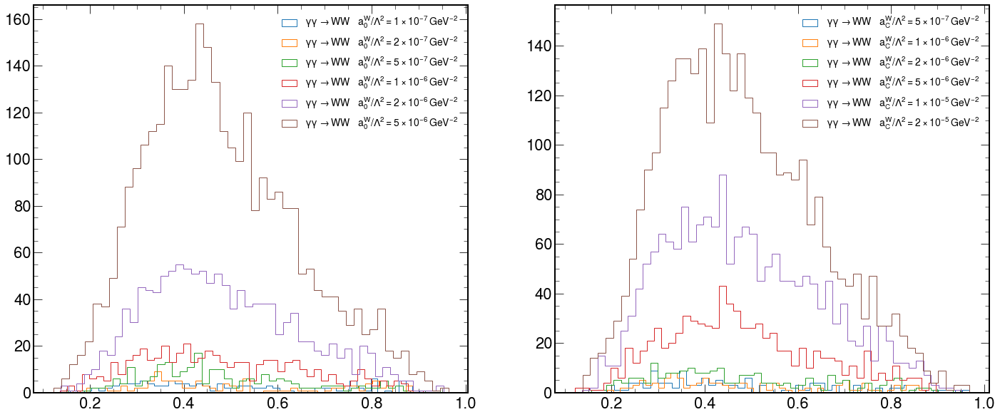

In [30]:
fig, axes = plt.subplots( 1, 2, figsize=(2*12,10) )
for label_ in labels_signals[:6]: 
    axes[0].hist( df_signals_protons_multiRP_sig_plus_mix_events_categories[ label_ ][ '2protons_mix' ]["jet0_tau21"], histtype='step', density=False, bins=50, label=labels_samples[ label_ ] )
axes[0].legend( loc='best', fontsize=14 )
    
for label_ in labels_signals[6:]: 
    axes[1].hist( df_signals_protons_multiRP_sig_plus_mix_events_categories[ label_ ][ '2protons_mix' ]["jet0_tau21"], histtype='step', density=False, bins=50, label=labels_samples[ label_ ] )
axes[1].legend( loc='best', fontsize=14 )

# fig = plt.figure( figsize=(12,10) )
# for label_ in labels_signals:
#     plt.plt.hist( df_signals_protons_multiRP_sig_plus_mix_events_categories[ label_ ][ '2protons_mix' ]["jet0_tau21"], histtype='step', density=False, bins=50, label=labels_samples[ label_ ] )
# plt.legend( loc='best', fontsize=14 )

## Dissociative signal template (signal plus pileup protons)

In [31]:
# Single-dissociative 
df_signals_protons_multiRP_sig_plus_mix_Arm0_2protons_events = {}
df_signals_protons_multiRP_sig_plus_mix_Arm0_events_categories = {}
df_signals_protons_multiRP_sig_plus_mix_Arm1_2protons_events = {}
df_signals_protons_multiRP_sig_plus_mix_Arm1_events_categories = {}

# Double-dissociative
# Use df_signals_protons_multiRP_mix_protons_events for double-dissociative category is always '2protons_mix'
df_signals_protons_multiRP_mix_protons_signal_label_events = {}

if run_dissociative_signal:
    for label_ in df_signals_protons_multiRP_mix_protons_events:
        print ( label_ )
        df_signals_protons_multiRP_mix_protons_signal_label_events[ map_labels_from_mix_protons[ label_ ] ] = df_signals_protons_multiRP_mix_protons_events[ label_ ]

    base_path_ = 'output-final'
    for label_ in labels_signals:
        print ( label_ )
    
        file_path_ = "{}/data-store-signal-plus-mix-events-{}-Arm0.h5".format( base_path_, label_ )
        with pd.HDFStore( file_path_, 'r' ) as store_:
            print ( store_.keys() )
            df_signals_protons_multiRP_sig_plus_mix_Arm0_2protons_events[ label_ ] = store_[ "/events_multiRP/all" ]
            df_signals_protons_multiRP_sig_plus_mix_Arm0_events_categories[ label_ ] = {}
            for key_ in [ '2protons_sig', '1proton_sig_Arm0', '1proton_sig_Arm1', '2protons_mix' ]:
                store_key__ = "/events_multiRP/{}".format( key_ )
                if store_key__ in store_.keys():
                    print ( store_key__ )
                    df_protons_multiRP_events__ = store_[ store_key__ ]
                    df_signals_protons_multiRP_sig_plus_mix_Arm0_events_categories[ label_ ][ key_ ] = df_protons_multiRP_events__
                
        file_path_ = "{}/data-store-signal-plus-mix-events-{}-Arm1.h5".format( base_path_, label_ )
        with pd.HDFStore( file_path_, 'r' ) as store_:
            print ( store_.keys() )
            df_signals_protons_multiRP_sig_plus_mix_Arm1_2protons_events[ label_ ] = store_[ "/events_multiRP/all" ]
            df_signals_protons_multiRP_sig_plus_mix_Arm1_events_categories[ label_ ] = {}
            for key_ in [ '2protons_sig', '1proton_sig_Arm0', '1proton_sig_Arm1', '2protons_mix' ]:
                store_key__ = "/events_multiRP/{}".format( key_ )
                if store_key__ in store_.keys():
                    print ( store_key__ )
                    df_protons_multiRP_events__ = store_[ store_key__ ]
                    df_signals_protons_multiRP_sig_plus_mix_Arm1_events_categories[ label_ ][ key_ ] = df_protons_multiRP_events__

GGToWW-AQGC-mix_protons-2018-muon-A0W1e-7
GGToWW-AQGC-mix_protons-2018-muon-A0W2e-7
GGToWW-AQGC-mix_protons-2018-muon-A0W5e-7
GGToWW-AQGC-mix_protons-2018-muon-A0W1e-6
GGToWW-AQGC-mix_protons-2018-muon-A0W2e-6
GGToWW-AQGC-mix_protons-2018-muon-A0W5e-6
GGToWW-AQGC-mix_protons-2018-muon-ACW5e-7
GGToWW-AQGC-mix_protons-2018-muon-ACW1e-6
GGToWW-AQGC-mix_protons-2018-muon-ACW2e-6
GGToWW-AQGC-mix_protons-2018-muon-ACW5e-6
GGToWW-AQGC-mix_protons-2018-muon-ACW1e-5
GGToWW-AQGC-mix_protons-2018-muon-ACW2e-5
GGToWW-AQGC-2018-muon-A0W1e-7
['/events_multiRP/1proton_sig_Arm0', '/events_multiRP/2protons_mix', '/events_multiRP/all']
/events_multiRP/1proton_sig_Arm0
/events_multiRP/2protons_mix
['/events_multiRP/1proton_sig_Arm1', '/events_multiRP/2protons_mix', '/events_multiRP/all']
/events_multiRP/1proton_sig_Arm1
/events_multiRP/2protons_mix
GGToWW-AQGC-2018-muon-A0W2e-7
['/events_multiRP/1proton_sig_Arm0', '/events_multiRP/2protons_mix', '/events_multiRP/all']
/events_multiRP/1proton_sig_Arm0
/ev

In [32]:
if run_dissociative_signal:
    print ( label_ )
    df_signals_protons_multiRP_mix_protons_signal_label_events[ label_ ]

GGToWW-AQGC-2018-muon-ACW2e-5


In [33]:
if run_dissociative_signal:
    df_signals_protons_multiRP_sig_plus_mix_Arm0_2protons_events[ label_ ]

In [34]:
if run_dissociative_signal:
    df_signals_protons_multiRP_sig_plus_mix_Arm0_events_categories[ label_ ].keys()

In [35]:
if run_dissociative_signal:
    df_signals_protons_multiRP_sig_plus_mix_Arm0_events_categories[ label_ ][ '1proton_sig_Arm0' ]

In [36]:
if run_dissociative_signal:
    df_signals_protons_multiRP_sig_plus_mix_Arm0_events_categories[ label_ ][ '2protons_mix' ]

In [37]:
if run_dissociative_signal:
    df_signals_protons_multiRP_sig_plus_mix_Arm1_2protons_events[ label_ ]

In [38]:
if run_dissociative_signal:
    df_signals_protons_multiRP_sig_plus_mix_Arm1_events_categories[ label_ ].keys()

In [39]:
if run_dissociative_signal:
    df_signals_protons_multiRP_sig_plus_mix_Arm1_events_categories[ label_ ][ '1proton_sig_Arm1' ]

In [40]:
if run_dissociative_signal:
    df_signals_protons_multiRP_sig_plus_mix_Arm1_events_categories[ label_ ][ '2protons_mix' ]

### Select events (signal)

In [41]:
df_signals_protons_multiRP_sig_plus_mix_2protons_selected_events = {}
df_signals_protons_multiRP_sig_plus_mix_selected_events_categories = {}

variations_ = { "jet": [ "_jes_up", "_jes_dw", "_jer_up", "_jer_dw" ] }
for label_ in labels_signals:
    print ( label_ )
    df_events__ = df_signals_protons_multiRP_sig_plus_mix_2protons_events[ label_ ]
    print ( df_events__.shape[0] )
#     df_selected_events__, selection_keys__, selections__  = select_events( df_events__ )
    df_selected_events__, selection_keys__, selections__  = select_events( df_events__, lepton_type )
    print ( df_selected_events__.shape[0] )
    print ( selection_keys__ )
    print ( selections__ )
    df_signals_protons_multiRP_sig_plus_mix_2protons_selected_events[ label_ ] = {}
    df_signals_protons_multiRP_sig_plus_mix_2protons_selected_events[ label_ ][ "_nom" ] = df_selected_events__
    for var_label__ in variations_:
        print ( var_label__ )
        for variation__ in variations_[ var_label__ ]:
            opt__ = { "label_" + var_label__ : variation__ }
            print ( opt__ )
            df_selected_events__, selection_keys__, selections__  = select_events( df_events__, lepton_type, **opt__ )
            print ( df_selected_events__.shape[0] )
            print ( selection_keys__ )
            print ( selections__ )
            df_signals_protons_multiRP_sig_plus_mix_2protons_selected_events[ label_ ][ variation__ ] = df_selected_events__
            
    df_signals_protons_multiRP_sig_plus_mix_selected_events_categories[ label_ ] = {}
    for cat__ in df_signals_protons_multiRP_sig_plus_mix_events_categories[ label_ ]:
        print ( cat__ )
        df_events__ = df_signals_protons_multiRP_sig_plus_mix_events_categories[ label_ ][ cat__ ]
        print ( df_events__.shape[0] )
        df_selected_events__, selection_keys__, selections__  = select_events( df_events__, lepton_type )
        print ( df_selected_events__.shape[0] )
        print ( selection_keys__ )
        print ( selections__ )
        df_signals_protons_multiRP_sig_plus_mix_selected_events_categories[ label_ ][ cat__ ] = {}
        df_signals_protons_multiRP_sig_plus_mix_selected_events_categories[ label_ ][ cat__ ][ "_nom" ] = df_selected_events__
        for var_label__ in variations_:
            print ( var_label__ )
            for variation__ in variations_[ var_label__ ]:
                opt__ = { "label_" + var_label__ : variation__ }
                print ( opt__ )
                df_selected_events__, selection_keys__, selections__  = select_events( df_events__, lepton_type, **opt__ )
                print ( df_selected_events__.shape[0] )
                print ( selection_keys__ )
                print ( selections__ )
                df_signals_protons_multiRP_sig_plus_mix_selected_events_categories[ label_ ][ cat__ ][ variation__ ] = df_selected_events__

GGToWW-AQGC-2018-muon-A0W1e-7
813
207
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 813, 'Muon': 813, 'Jet': 655, 'Jet_Muon': 655, 'MET': 554, 'Jet_MET': 533, 'PrunedMass': 375, 'Tau21': 312, 'BJet_Veto': 312, 'Xi_CMS': 309, 'WLeptonic': 286, 'Jet_WLeptonic': 286, 'MWW': 277, 'ExtraTracks': 218, 'NProtons': 207}
jet
{'label_jet': '_jes_up'}
207
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 813, 'Muon': 813, 'Jet': 669, 'Jet_Muon': 669, 'MET': 564, 'Jet_MET': 543, 'PrunedMass': 376, 'Tau21': 311, 'BJet_Veto': 311, 'Xi_CMS': 308, 'WLeptonic': 286, 'Jet_WLeptonic': 286, 'MWW': 277, 'ExtraTracks': 218, 'NProtons': 207}
{'label_jet': '_jes_dw'}
206
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS',

211
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 899, 'Muon': 899, 'Jet': 717, 'Jet_Muon': 717, 'MET': 608, 'Jet_MET': 576, 'PrunedMass': 407, 'Tau21': 327, 'BJet_Veto': 327, 'Xi_CMS': 321, 'WLeptonic': 299, 'Jet_WLeptonic': 299, 'MWW': 291, 'ExtraTracks': 221, 'NProtons': 211}
jet
{'label_jet': '_jes_up'}
212
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 899, 'Muon': 899, 'Jet': 733, 'Jet_Muon': 733, 'MET': 617, 'Jet_MET': 584, 'PrunedMass': 414, 'Tau21': 332, 'BJet_Veto': 332, 'Xi_CMS': 326, 'WLeptonic': 303, 'Jet_WLeptonic': 303, 'MWW': 294, 'ExtraTracks': 222, 'NProtons': 212}
{'label_jet': '_jes_dw'}
210
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MW

2protons_sig
434
111
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 434, 'Muon': 434, 'Jet': 373, 'Jet_Muon': 373, 'MET': 327, 'Jet_MET': 311, 'PrunedMass': 229, 'Tau21': 181, 'BJet_Veto': 181, 'Xi_CMS': 181, 'WLeptonic': 163, 'Jet_WLeptonic': 163, 'MWW': 160, 'ExtraTracks': 114, 'NProtons': 111}
jet
{'label_jet': '_jes_up'}
111
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 434, 'Muon': 434, 'Jet': 379, 'Jet_Muon': 379, 'MET': 330, 'Jet_MET': 314, 'PrunedMass': 229, 'Tau21': 181, 'BJet_Veto': 181, 'Xi_CMS': 181, 'WLeptonic': 163, 'Jet_WLeptonic': 163, 'MWW': 159, 'ExtraTracks': 114, 'NProtons': 111}
{'label_jet': '_jes_dw'}
110
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Je

654
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 1928, 'Muon': 1928, 'Jet': 1774, 'Jet_Muon': 1774, 'MET': 1598, 'Jet_MET': 1536, 'PrunedMass': 1162, 'Tau21': 973, 'BJet_Veto': 973, 'Xi_CMS': 910, 'WLeptonic': 888, 'Jet_WLeptonic': 888, 'MWW': 880, 'ExtraTracks': 667, 'NProtons': 654}
jet
{'label_jet': '_jes_up'}
651
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 1928, 'Muon': 1928, 'Jet': 1797, 'Jet_Muon': 1797, 'MET': 1618, 'Jet_MET': 1553, 'PrunedMass': 1173, 'Tau21': 980, 'BJet_Veto': 980, 'Xi_CMS': 909, 'WLeptonic': 885, 'Jet_WLeptonic': 885, 'MWW': 877, 'ExtraTracks': 664, 'NProtons': 651}
{'label_jet': '_jes_dw'}
653
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_W

176
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 473, 'Muon': 473, 'Jet': 444, 'Jet_Muon': 444, 'MET': 404, 'Jet_MET': 394, 'PrunedMass': 318, 'Tau21': 264, 'BJet_Veto': 264, 'Xi_CMS': 248, 'WLeptonic': 245, 'Jet_WLeptonic': 245, 'MWW': 244, 'ExtraTracks': 181, 'NProtons': 176}
2protons_mix
484
168
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 484, 'Muon': 484, 'Jet': 468, 'Jet_Muon': 468, 'MET': 426, 'Jet_MET': 405, 'PrunedMass': 306, 'Tau21': 262, 'BJet_Veto': 262, 'Xi_CMS': 229, 'WLeptonic': 227, 'Jet_WLeptonic': 227, 'MWW': 225, 'ExtraTracks': 170, 'NProtons': 168}
jet
{'label_jet': '_jes_up'}
166
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'Ext

505
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 1226, 'Muon': 1226, 'Jet': 1197, 'Jet_Muon': 1197, 'MET': 1094, 'Jet_MET': 1064, 'PrunedMass': 868, 'Tau21': 723, 'BJet_Veto': 723, 'Xi_CMS': 688, 'WLeptonic': 685, 'Jet_WLeptonic': 685, 'MWW': 683, 'ExtraTracks': 523, 'NProtons': 505}
{'label_jet': '_jer_up'}
499
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 1226, 'Muon': 1226, 'Jet': 1204, 'Jet_Muon': 1204, 'MET': 1100, 'Jet_MET': 1070, 'PrunedMass': 870, 'Tau21': 725, 'BJet_Veto': 725, 'Xi_CMS': 684, 'WLeptonic': 679, 'Jet_WLeptonic': 679, 'MWW': 677, 'ExtraTracks': 517, 'NProtons': 499}
{'label_jet': '_jer_dw'}
502
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLepton

722
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 1754, 'Muon': 1754, 'Jet': 1727, 'Jet_Muon': 1727, 'MET': 1585, 'Jet_MET': 1528, 'PrunedMass': 1232, 'Tau21': 1041, 'BJet_Veto': 1041, 'Xi_CMS': 974, 'WLeptonic': 970, 'Jet_WLeptonic': 970, 'MWW': 969, 'ExtraTracks': 750, 'NProtons': 722}
{'label_jet': '_jer_dw'}
723
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 1754, 'Muon': 1754, 'Jet': 1729, 'Jet_Muon': 1729, 'MET': 1587, 'Jet_MET': 1529, 'PrunedMass': 1234, 'Tau21': 1042, 'BJet_Veto': 1042, 'Xi_CMS': 975, 'WLeptonic': 971, 'Jet_WLeptonic': 971, 'MWW': 970, 'ExtraTracks': 751, 'NProtons': 723}
1proton_sig_Arm1
2994
1224
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLe

44
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 177, 'Muon': 177, 'Jet': 140, 'Jet_Muon': 140, 'MET': 124, 'Jet_MET': 120, 'PrunedMass': 91, 'Tau21': 73, 'BJet_Veto': 73, 'Xi_CMS': 72, 'WLeptonic': 66, 'Jet_WLeptonic': 66, 'MWW': 63, 'ExtraTracks': 48, 'NProtons': 44}
jet
{'label_jet': '_jes_up'}
46
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 177, 'Muon': 177, 'Jet': 146, 'Jet_Muon': 146, 'MET': 129, 'Jet_MET': 125, 'PrunedMass': 95, 'Tau21': 77, 'BJet_Veto': 77, 'Xi_CMS': 76, 'WLeptonic': 68, 'Jet_WLeptonic': 68, 'MWW': 65, 'ExtraTracks': 50, 'NProtons': 46}
{'label_jet': '_jes_dw'}
44
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'N

28
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 125, 'Muon': 125, 'Jet': 104, 'Jet_Muon': 104, 'MET': 94, 'Jet_MET': 90, 'PrunedMass': 65, 'Tau21': 52, 'BJet_Veto': 52, 'Xi_CMS': 52, 'WLeptonic': 48, 'Jet_WLeptonic': 48, 'MWW': 48, 'ExtraTracks': 29, 'NProtons': 28}
jet
{'label_jet': '_jes_up'}
28
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 125, 'Muon': 125, 'Jet': 108, 'Jet_Muon': 108, 'MET': 97, 'Jet_MET': 93, 'PrunedMass': 66, 'Tau21': 53, 'BJet_Veto': 53, 'Xi_CMS': 53, 'WLeptonic': 48, 'Jet_WLeptonic': 48, 'MWW': 48, 'ExtraTracks': 29, 'NProtons': 28}
{'label_jet': '_jes_dw'}
28
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProt

90
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 258, 'Muon': 258, 'Jet': 230, 'Jet_Muon': 230, 'MET': 202, 'Jet_MET': 194, 'PrunedMass': 151, 'Tau21': 122, 'BJet_Veto': 122, 'Xi_CMS': 119, 'WLeptonic': 116, 'Jet_WLeptonic': 116, 'MWW': 111, 'ExtraTracks': 94, 'NProtons': 90}
{'label_jet': '_jer_up'}
90
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 258, 'Muon': 258, 'Jet': 233, 'Jet_Muon': 233, 'MET': 205, 'Jet_MET': 196, 'PrunedMass': 151, 'Tau21': 122, 'BJet_Veto': 122, 'Xi_CMS': 119, 'WLeptonic': 116, 'Jet_WLeptonic': 116, 'MWW': 111, 'ExtraTracks': 94, 'NProtons': 90}
{'label_jet': '_jer_dw'}
90
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraT

185
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 576, 'Muon': 576, 'Jet': 530, 'Jet_Muon': 530, 'MET': 481, 'Jet_MET': 453, 'PrunedMass': 342, 'Tau21': 271, 'BJet_Veto': 271, 'Xi_CMS': 257, 'WLeptonic': 246, 'Jet_WLeptonic': 246, 'MWW': 243, 'ExtraTracks': 190, 'NProtons': 185}
{'label_jet': '_jer_up'}
185
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 576, 'Muon': 576, 'Jet': 536, 'Jet_Muon': 536, 'MET': 486, 'Jet_MET': 458, 'PrunedMass': 345, 'Tau21': 274, 'BJet_Veto': 274, 'Xi_CMS': 257, 'WLeptonic': 245, 'Jet_WLeptonic': 245, 'MWW': 242, 'ExtraTracks': 190, 'NProtons': 185}
{'label_jet': '_jer_dw'}
185
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 

503
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 1322, 'Muon': 1322, 'Jet': 1269, 'Jet_Muon': 1269, 'MET': 1136, 'Jet_MET': 1091, 'PrunedMass': 850, 'Tau21': 721, 'BJet_Veto': 721, 'Xi_CMS': 716, 'WLeptonic': 706, 'Jet_WLeptonic': 706, 'MWW': 701, 'ExtraTracks': 539, 'NProtons': 503}
{'label_jet': '_jer_dw'}
505
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 1322, 'Muon': 1322, 'Jet': 1270, 'Jet_Muon': 1270, 'MET': 1136, 'Jet_MET': 1091, 'PrunedMass': 852, 'Tau21': 723, 'BJet_Veto': 723, 'Xi_CMS': 718, 'WLeptonic': 708, 'Jet_WLeptonic': 708, 'MWW': 703, 'ExtraTracks': 541, 'NProtons': 505}
1proton_sig_Arm0
1143
465
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic'

4131
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 10157, 'Muon': 10157, 'Jet': 10056, 'Jet_Muon': 10056, 'MET': 9322, 'Jet_MET': 9001, 'PrunedMass': 7084, 'Tau21': 5945, 'BJet_Veto': 5944, 'Xi_CMS': 5537, 'WLeptonic': 5518, 'Jet_WLeptonic': 5518, 'MWW': 5516, 'ExtraTracks': 4285, 'NProtons': 4131}
2protons_sig
1913
799
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 1913, 'Muon': 1913, 'Jet': 1868, 'Jet_Muon': 1868, 'MET': 1684, 'Jet_MET': 1632, 'PrunedMass': 1291, 'Tau21': 1087, 'BJet_Veto': 1087, 'Xi_CMS': 1085, 'WLeptonic': 1070, 'Jet_WLeptonic': 1070, 'MWW': 1069, 'ExtraTracks': 840, 'NProtons': 799}
jet
{'label_jet': '_jes_up'}
800
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLepto

### Select events (dissociative signal)

In [42]:
# Single-dissociative
df_signals_protons_multiRP_sig_plus_mix_Arm0_2protons_selected_events = {}
df_signals_protons_multiRP_sig_plus_mix_Arm0_selected_events_categories = {}
df_signals_protons_multiRP_sig_plus_mix_Arm1_2protons_selected_events = {}
df_signals_protons_multiRP_sig_plus_mix_Arm1_selected_events_categories = {}
# Double-dissociative
df_signals_protons_multiRP_mix_protons_selected_events = {}

if run_dissociative_signal:
    variations_ = { "jet": [ "_jes_up", "_jes_dw", "_jer_up", "_jer_dw" ] }
    for label_ in labels_signals:
        print ( label_ )
        df_events_Arm0__ = df_signals_protons_multiRP_sig_plus_mix_Arm0_2protons_events[ label_ ]
        print ( df_events_Arm0__.shape[0] )
        df_events_Arm1__ = df_signals_protons_multiRP_sig_plus_mix_Arm1_2protons_events[ label_ ]
        print ( df_events_Arm1__.shape[0] )
        df_events_mix_protons__ = df_signals_protons_multiRP_mix_protons_signal_label_events[ label_ ]
        
    #     df_selected_events__, selection_keys__, selections__  = select_events( df_events__ )
        df_selected_events_Arm0__, selection_keys__, selections__  = select_events( df_events_Arm0__, lepton_type )
        print ( df_selected_events_Arm0__.shape[0] )
        print ( selection_keys__ )
        print ( selections__ )
        df_signals_protons_multiRP_sig_plus_mix_Arm0_2protons_selected_events[ label_ ] = {}
        df_signals_protons_multiRP_sig_plus_mix_Arm0_2protons_selected_events[ label_ ][ "_nom" ] = df_selected_events_Arm0__
        
        df_selected_events_Arm1__, selection_keys__, selections__  = select_events( df_events_Arm1__, lepton_type )
        print ( df_selected_events_Arm1__.shape[0] )
        print ( selection_keys__ )
        print ( selections__ )
        df_signals_protons_multiRP_sig_plus_mix_Arm1_2protons_selected_events[ label_ ] = {}
        df_signals_protons_multiRP_sig_plus_mix_Arm1_2protons_selected_events[ label_ ][ "_nom" ] = df_selected_events_Arm1__
        
        df_selected_events_mix_protons__, selection_keys__, selections__  = select_events( df_events_mix_protons__, lepton_type )
        print ( df_selected_events_mix_protons__.shape[0] )
        print ( selection_keys__ )
        print ( selections__ )
        df_signals_protons_multiRP_mix_protons_selected_events[ label_ ] = {}
        df_signals_protons_multiRP_mix_protons_selected_events[ label_ ][ "_nom" ] = df_selected_events_mix_protons__
       
        for var_label__ in variations_:
            print ( var_label__ )
            for variation__ in variations_[ var_label__ ]:
                opt__ = { "label_" + var_label__ : variation__ }
                print ( opt__ )
                
                df_selected_events_Arm0__, selection_keys__, selections__  = select_events( df_events_Arm0__, lepton_type, **opt__ )
                print ( df_selected_events_Arm0__.shape[0] )
                print ( selection_keys__ )
                print ( selections__ )
                df_signals_protons_multiRP_sig_plus_mix_Arm0_2protons_selected_events[ label_ ][ variation__ ] = df_selected_events_Arm0__
                
                df_selected_events_Arm1__, selection_keys__, selections__  = select_events( df_events_Arm1__, lepton_type, **opt__ )
                print ( df_selected_events_Arm1__.shape[0] )
                print ( selection_keys__ )
                print ( selections__ )
                df_signals_protons_multiRP_sig_plus_mix_Arm1_2protons_selected_events[ label_ ][ variation__ ] = df_selected_events_Arm0__
                
                df_selected_events_mix_protons__, selection_keys__, selections__  = select_events( df_events_mix_protons__, lepton_type, **opt__ )
                print ( df_selected_events_mix_protons__.shape[0] )
                print ( selection_keys__ )
                print ( selections__ )
                df_signals_protons_multiRP_mix_protons_selected_events[ label_ ][ variation__ ] = df_selected_events_mix_protons__

        df_signals_protons_multiRP_sig_plus_mix_Arm0_selected_events_categories[ label_ ] = {}
        for cat__ in df_signals_protons_multiRP_sig_plus_mix_Arm0_events_categories[ label_ ]:
            print ( cat__ )
            df_events__ = df_signals_protons_multiRP_sig_plus_mix_Arm0_events_categories[ label_ ][ cat__ ]
            print ( df_events__.shape[0] )
            df_selected_events__, selection_keys__, selections__  = select_events( df_events__, lepton_type )
            print ( df_selected_events__.shape[0] )
            print ( selection_keys__ )
            print ( selections__ )
            df_signals_protons_multiRP_sig_plus_mix_Arm0_selected_events_categories[ label_ ][ cat__ ] = {}
            df_signals_protons_multiRP_sig_plus_mix_Arm0_selected_events_categories[ label_ ][ cat__ ][ "_nom" ] = df_selected_events__
            for var_label__ in variations_:
                print ( var_label__ )
                for variation__ in variations_[ var_label__ ]:
                    opt__ = { "label_" + var_label__ : variation__ }
                    print ( opt__ )
                    df_selected_events__, selection_keys__, selections__  = select_events( df_events__, lepton_type, **opt__ )
                    print ( df_selected_events__.shape[0] )
                    print ( selection_keys__ )
                    print ( selections__ )
                    df_signals_protons_multiRP_sig_plus_mix_Arm0_selected_events_categories[ label_ ][ cat__ ][ variation__ ] = df_selected_events__

        df_signals_protons_multiRP_sig_plus_mix_Arm1_selected_events_categories[ label_ ] = {}
        for cat__ in df_signals_protons_multiRP_sig_plus_mix_Arm1_events_categories[ label_ ]:
            print ( cat__ )
            df_events__ = df_signals_protons_multiRP_sig_plus_mix_Arm1_events_categories[ label_ ][ cat__ ]
            print ( df_events__.shape[0] )
            df_selected_events__, selection_keys__, selections__  = select_events( df_events__, lepton_type )
            print ( df_selected_events__.shape[0] )
            print ( selection_keys__ )
            print ( selections__ )
            df_signals_protons_multiRP_sig_plus_mix_Arm1_selected_events_categories[ label_ ][ cat__ ] = {}
            df_signals_protons_multiRP_sig_plus_mix_Arm1_selected_events_categories[ label_ ][ cat__ ][ "_nom" ] = df_selected_events__
            for var_label__ in variations_:
                print ( var_label__ )
                for variation__ in variations_[ var_label__ ]:
                    opt__ = { "label_" + var_label__ : variation__ }
                    print ( opt__ )
                    df_selected_events__, selection_keys__, selections__  = select_events( df_events__, lepton_type, **opt__ )
                    print ( df_selected_events__.shape[0] )
                    print ( selection_keys__ )
                    print ( selections__ )
                    df_signals_protons_multiRP_sig_plus_mix_Arm1_selected_events_categories[ label_ ][ cat__ ][ variation__ ] = df_selected_events__

GGToWW-AQGC-2018-muon-A0W1e-7
534
520
130
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 534, 'Muon': 534, 'Jet': 427, 'Jet_Muon': 427, 'MET': 359, 'Jet_MET': 346, 'PrunedMass': 250, 'Tau21': 207, 'BJet_Veto': 207, 'Xi_CMS': 204, 'WLeptonic': 189, 'Jet_WLeptonic': 189, 'MWW': 182, 'ExtraTracks': 137, 'NProtons': 130}
126
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 520, 'Muon': 520, 'Jet': 426, 'Jet_Muon': 426, 'MET': 352, 'Jet_MET': 340, 'PrunedMass': 237, 'Tau21': 195, 'BJet_Veto': 195, 'Xi_CMS': 193, 'WLeptonic': 176, 'Jet_WLeptonic': 176, 'MWW': 170, 'ExtraTracks': 131, 'NProtons': 126}
79
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks'

88
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 333, 'Muon': 333, 'Jet': 277, 'Jet_Muon': 277, 'MET': 236, 'Jet_MET': 229, 'PrunedMass': 161, 'Tau21': 133, 'BJet_Veto': 133, 'Xi_CMS': 133, 'WLeptonic': 122, 'Jet_WLeptonic': 122, 'MWW': 118, 'ExtraTracks': 92, 'NProtons': 88}
jet
{'label_jet': '_jes_up'}
88
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 333, 'Muon': 333, 'Jet': 282, 'Jet_Muon': 282, 'MET': 238, 'Jet_MET': 231, 'PrunedMass': 159, 'Tau21': 132, 'BJet_Veto': 132, 'Xi_CMS': 132, 'WLeptonic': 122, 'Jet_WLeptonic': 122, 'MWW': 118, 'ExtraTracks': 92, 'NProtons': 88}
{'label_jet': '_jes_dw'}
88
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'Ex

87
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 354, 'Muon': 354, 'Jet': 276, 'Jet_Muon': 276, 'MET': 238, 'Jet_MET': 227, 'PrunedMass': 158, 'Tau21': 129, 'BJet_Veto': 129, 'Xi_CMS': 123, 'WLeptonic': 116, 'Jet_WLeptonic': 116, 'MWW': 114, 'ExtraTracks': 89, 'NProtons': 87}
{'label_jet': '_jer_dw'}
131
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 566, 'Muon': 566, 'Jet': 440, 'Jet_Muon': 440, 'MET': 372, 'Jet_MET': 354, 'PrunedMass': 244, 'Tau21': 197, 'BJet_Veto': 197, 'Xi_CMS': 191, 'WLeptonic': 180, 'Jet_WLeptonic': 180, 'MWW': 176, 'ExtraTracks': 134, 'NProtons': 131}
131
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{

164
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 558, 'Muon': 558, 'Jet': 486, 'Jet_Muon': 486, 'MET': 430, 'Jet_MET': 413, 'PrunedMass': 309, 'Tau21': 254, 'BJet_Veto': 254, 'Xi_CMS': 240, 'WLeptonic': 223, 'Jet_WLeptonic': 223, 'MWW': 221, 'ExtraTracks': 169, 'NProtons': 164}
jet
{'label_jet': '_jes_up'}
227
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 794, 'Muon': 794, 'Jet': 705, 'Jet_Muon': 705, 'MET': 620, 'Jet_MET': 591, 'PrunedMass': 435, 'Tau21': 354, 'BJet_Veto': 354, 'Xi_CMS': 336, 'WLeptonic': 313, 'Jet_WLeptonic': 313, 'MWW': 310, 'ExtraTracks': 238, 'NProtons': 227}
225
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProt

113
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 361, 'Muon': 361, 'Jet': 316, 'Jet_Muon': 316, 'MET': 282, 'Jet_MET': 272, 'PrunedMass': 207, 'Tau21': 168, 'BJet_Veto': 168, 'Xi_CMS': 158, 'WLeptonic': 150, 'Jet_WLeptonic': 150, 'MWW': 149, 'ExtraTracks': 116, 'NProtons': 113}
{'label_jet': '_jer_dw'}
113
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 361, 'Muon': 361, 'Jet': 314, 'Jet_Muon': 314, 'MET': 280, 'Jet_MET': 270, 'PrunedMass': 206, 'Tau21': 168, 'BJet_Veto': 168, 'Xi_CMS': 158, 'WLeptonic': 150, 'Jet_WLeptonic': 150, 'MWW': 149, 'ExtraTracks': 116, 'NProtons': 113}
GGToWW-AQGC-2018-muon-A0W1e-6
1373
1400
470
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLep

243
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 679, 'Muon': 679, 'Jet': 645, 'Jet_Muon': 645, 'MET': 593, 'Jet_MET': 570, 'PrunedMass': 432, 'Tau21': 369, 'BJet_Veto': 369, 'Xi_CMS': 330, 'WLeptonic': 327, 'Jet_WLeptonic': 327, 'MWW': 325, 'ExtraTracks': 246, 'NProtons': 243}
{'label_jet': '_jer_dw'}
247
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 679, 'Muon': 679, 'Jet': 647, 'Jet_Muon': 647, 'MET': 594, 'Jet_MET': 571, 'PrunedMass': 434, 'Tau21': 371, 'BJet_Veto': 371, 'Xi_CMS': 334, 'WLeptonic': 331, 'Jet_WLeptonic': 331, 'MWW': 329, 'ExtraTracks': 250, 'NProtons': 247}
1proton_sig_Arm1
734
253
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'Ext

1194
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 3109, 'Muon': 3109, 'Jet': 3014, 'Jet_Muon': 3014, 'MET': 2789, 'Jet_MET': 2696, 'PrunedMass': 2119, 'Tau21': 1764, 'BJet_Veto': 1764, 'Xi_CMS': 1626, 'WLeptonic': 1610, 'Jet_WLeptonic': 1610, 'MWW': 1605, 'ExtraTracks': 1224, 'NProtons': 1194}
1269
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 3272, 'Muon': 3272, 'Jet': 3180, 'Jet_Muon': 3180, 'MET': 2945, 'Jet_MET': 2845, 'PrunedMass': 2246, 'Tau21': 1864, 'BJet_Veto': 1864, 'Xi_CMS': 1731, 'WLeptonic': 1718, 'Jet_WLeptonic': 1718, 'MWW': 1716, 'ExtraTracks': 1308, 'NProtons': 1269}
943
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NP

639
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 1638, 'Muon': 1638, 'Jet': 1601, 'Jet_Muon': 1601, 'MET': 1500, 'Jet_MET': 1445, 'PrunedMass': 1136, 'Tau21': 947, 'BJet_Veto': 947, 'Xi_CMS': 855, 'WLeptonic': 847, 'Jet_WLeptonic': 847, 'MWW': 847, 'ExtraTracks': 646, 'NProtons': 639}
GGToWW-AQGC-2018-muon-A0W5e-6
7121
7784
2886
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 7121, 'Muon': 7121, 'Jet': 7053, 'Jet_Muon': 7053, 'MET': 6543, 'Jet_MET': 6285, 'PrunedMass': 4955, 'Tau21': 4188, 'BJet_Veto': 4186, 'Xi_CMS': 3839, 'WLeptonic': 3827, 'Jet_WLeptonic': 3827, 'MWW': 3823, 'ExtraTracks': 2965, 'NProtons': 2886}
3190
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLept

1040
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 2607, 'Muon': 2607, 'Jet': 2560, 'Jet_Muon': 2560, 'MET': 2337, 'Jet_MET': 2246, 'PrunedMass': 1794, 'Tau21': 1492, 'BJet_Veto': 1492, 'Xi_CMS': 1419, 'WLeptonic': 1410, 'Jet_WLeptonic': 1410, 'MWW': 1407, 'ExtraTracks': 1083, 'NProtons': 1040}
2protons_mix
4514
1847
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 4514, 'Muon': 4514, 'Jet': 4493, 'Jet_Muon': 4493, 'MET': 4206, 'Jet_MET': 4039, 'PrunedMass': 3162, 'Tau21': 2696, 'BJet_Veto': 2694, 'Xi_CMS': 2421, 'WLeptonic': 2418, 'Jet_WLeptonic': 2418, 'MWW': 2417, 'ExtraTracks': 1883, 'NProtons': 1847}
jet
{'label_jet': '_jes_up'}
1844
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLepto

['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 540, 'Muon': 540, 'Jet': 437, 'Jet_Muon': 437, 'MET': 383, 'Jet_MET': 360, 'PrunedMass': 265, 'Tau21': 222, 'BJet_Veto': 222, 'Xi_CMS': 221, 'WLeptonic': 206, 'Jet_WLeptonic': 206, 'MWW': 198, 'ExtraTracks': 148, 'NProtons': 140}
137
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 522, 'Muon': 522, 'Jet': 413, 'Jet_Muon': 413, 'MET': 364, 'Jet_MET': 345, 'PrunedMass': 258, 'Tau21': 207, 'BJet_Veto': 207, 'Xi_CMS': 206, 'WLeptonic': 195, 'Jet_WLeptonic': 195, 'MWW': 185, 'ExtraTracks': 143, 'NProtons': 137}
96
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 350, 'Muon': 350, 'J

['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 564, 'Muon': 564, 'Jet': 461, 'Jet_Muon': 461, 'MET': 395, 'Jet_MET': 382, 'PrunedMass': 268, 'Tau21': 223, 'BJet_Veto': 223, 'Xi_CMS': 220, 'WLeptonic': 210, 'Jet_WLeptonic': 210, 'MWW': 202, 'ExtraTracks': 148, 'NProtons': 140}
93
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 388, 'Muon': 388, 'Jet': 314, 'Jet_Muon': 314, 'MET': 277, 'Jet_MET': 269, 'PrunedMass': 185, 'Tau21': 155, 'BJet_Veto': 155, 'Xi_CMS': 154, 'WLeptonic': 145, 'Jet_WLeptonic': 145, 'MWW': 139, 'ExtraTracks': 96, 'NProtons': 93}
jet
{'label_jet': '_jes_up'}
143
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{

55
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 225, 'Muon': 225, 'Jet': 191, 'Jet_Muon': 191, 'MET': 172, 'Jet_MET': 166, 'PrunedMass': 117, 'Tau21': 96, 'BJet_Veto': 96, 'Xi_CMS': 96, 'WLeptonic': 89, 'Jet_WLeptonic': 89, 'MWW': 86, 'ExtraTracks': 57, 'NProtons': 55}
{'label_jet': '_jes_dw'}
55
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 225, 'Muon': 225, 'Jet': 182, 'Jet_Muon': 182, 'MET': 163, 'Jet_MET': 157, 'PrunedMass': 113, 'Tau21': 94, 'BJet_Veto': 94, 'Xi_CMS': 94, 'WLeptonic': 89, 'Jet_WLeptonic': 89, 'MWW': 86, 'ExtraTracks': 57, 'NProtons': 55}
{'label_jet': '_jer_up'}
55
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NPr

123
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 347, 'Muon': 347, 'Jet': 316, 'Jet_Muon': 316, 'MET': 288, 'Jet_MET': 275, 'PrunedMass': 210, 'Tau21': 180, 'BJet_Veto': 180, 'Xi_CMS': 160, 'WLeptonic': 155, 'Jet_WLeptonic': 155, 'MWW': 154, 'ExtraTracks': 126, 'NProtons': 123}
{'label_jet': '_jer_dw'}
123
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 347, 'Muon': 347, 'Jet': 315, 'Jet_Muon': 315, 'MET': 287, 'Jet_MET': 274, 'PrunedMass': 210, 'Tau21': 180, 'BJet_Veto': 180, 'Xi_CMS': 160, 'WLeptonic': 155, 'Jet_WLeptonic': 155, 'MWW': 154, 'ExtraTracks': 126, 'NProtons': 123}
1proton_sig_Arm1
473
158
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'Ext

307
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 913, 'Muon': 913, 'Jet': 833, 'Jet_Muon': 833, 'MET': 750, 'Jet_MET': 711, 'PrunedMass': 552, 'Tau21': 452, 'BJet_Veto': 452, 'Xi_CMS': 438, 'WLeptonic': 420, 'Jet_WLeptonic': 420, 'MWW': 414, 'ExtraTracks': 313, 'NProtons': 307}
2protons_mix
1120
460
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 1120, 'Muon': 1120, 'Jet': 1095, 'Jet_Muon': 1095, 'MET': 1025, 'Jet_MET': 984, 'PrunedMass': 773, 'Tau21': 662, 'BJet_Veto': 662, 'Xi_CMS': 603, 'WLeptonic': 598, 'Jet_WLeptonic': 598, 'MWW': 598, 'ExtraTracks': 469, 'NProtons': 460}
jet
{'label_jet': '_jes_up'}
454
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW'

1898
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 4735, 'Muon': 4735, 'Jet': 4629, 'Jet_Muon': 4629, 'MET': 4299, 'Jet_MET': 4119, 'PrunedMass': 3207, 'Tau21': 2720, 'BJet_Veto': 2720, 'Xi_CMS': 2527, 'WLeptonic': 2509, 'Jet_WLeptonic': 2509, 'MWW': 2505, 'ExtraTracks': 1957, 'NProtons': 1898}
1380
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 3448, 'Muon': 3448, 'Jet': 3375, 'Jet_Muon': 3375, 'MET': 3150, 'Jet_MET': 3022, 'PrunedMass': 2354, 'Tau21': 1993, 'BJet_Veto': 1993, 'Xi_CMS': 1828, 'WLeptonic': 1813, 'Jet_WLeptonic': 1813, 'MWW': 1811, 'ExtraTracks': 1411, 'NProtons': 1380}
{'label_jet': '_jer_up'}
1728
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic',

943
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 2381, 'Muon': 2381, 'Jet': 2318, 'Jet_Muon': 2318, 'MET': 2127, 'Jet_MET': 2036, 'PrunedMass': 1574, 'Tau21': 1336, 'BJet_Veto': 1336, 'Xi_CMS': 1278, 'WLeptonic': 1265, 'Jet_WLeptonic': 1265, 'MWW': 1262, 'ExtraTracks': 980, 'NProtons': 943}
2protons_mix
2354
944
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 2354, 'Muon': 2354, 'Jet': 2323, 'Jet_Muon': 2323, 'MET': 2182, 'Jet_MET': 2093, 'PrunedMass': 1644, 'Tau21': 1392, 'BJet_Veto': 1392, 'Xi_CMS': 1240, 'WLeptonic': 1231, 'Jet_WLeptonic': 1231, 'MWW': 1230, 'ExtraTracks': 966, 'NProtons': 944}
jet
{'label_jet': '_jes_up'}
938
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', '

1125
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 2716, 'Muon': 2716, 'Jet': 2683, 'Jet_Muon': 2683, 'MET': 2450, 'Jet_MET': 2352, 'PrunedMass': 1869, 'Tau21': 1556, 'BJet_Veto': 1556, 'Xi_CMS': 1479, 'WLeptonic': 1469, 'Jet_WLeptonic': 1469, 'MWW': 1468, 'ExtraTracks': 1165, 'NProtons': 1125}
jet
{'label_jet': '_jes_up'}
1118
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 'WLeptonic', 'Jet_WLeptonic', 'MWW', 'ExtraTracks', 'NProtons']
{'All': 2716, 'Muon': 2716, 'Jet': 2687, 'Jet_Muon': 2687, 'MET': 2453, 'Jet_MET': 2355, 'PrunedMass': 1871, 'Tau21': 1556, 'BJet_Veto': 1556, 'Xi_CMS': 1468, 'WLeptonic': 1458, 'Jet_WLeptonic': 1458, 'MWW': 1457, 'ExtraTracks': 1158, 'NProtons': 1118}
{'label_jet': '_jes_dw'}
1128
['All', 'Muon', 'Jet', 'Jet_Muon', 'MET', 'Jet_MET', 'PrunedMass', 'Tau21', 'BJet_Veto', 'Xi_CMS', 

In [43]:
import json
samples_info = None
if data_sample == '2017':
    samples_info = json.load( open( 'samples_info_2017.json' ) )
elif data_sample == '2018':
#     samples_info = json.load( open( 'samples_info_2018.json' ) )
#     samples_info = json.load( open( 'samples_info_UL.json' ) )
    samples_info = json.load( open( 'samples_info_UL18_XSDB.json' ) )
samples_info

{'FPMC_WW_bSM_13tev_a0w_1e-7_aCw_0_semi_pt0': [130939.0,
  0.01766328483,
  1.0,
  6],
 'FPMC_WW_bSM_13tev_a0w_2e-7_aCw_0_semi_pt0': [131183.0,
  0.01776035257,
  1.0,
  6],
 'FPMC_WW_bSM_13tev_a0w_5e-7_aCw_0_semi_pt0': [131046.0, 0.0181627419, 1.0, 6],
 'FPMC_WW_bSM_13tev_a0w_1e-6_aCw_0_semi_pt0': [130973.0, 0.0196156363, 1.0, 6],
 'FPMC_WW_bSM_13tev_a0w_2e-6_aCw_0_semi_pt0': [131203.0,
  0.02544316479,
  1.0,
  6],
 'FPMC_WW_bSM_13tev_a0w_5e-6_aCw_0_semi_pt0': [131351.0, 0.0657918945, 1.0, 6],
 'FPMC_WW_bSM_13tev_a0w_0_aCw_5e-7_semi_pt0': [131205.0,
  0.01773472225,
  1.0,
  6],
 'FPMC_WW_bSM_13tev_a0w_0_aCw_1e-6_semi_pt0': [131474.0,
  0.01790024426,
  1.0,
  6],
 'FPMC_WW_bSM_13tev_a0w_0_aCw_2e-6_semi_pt0': [131467.0,
  0.01836002257,
  1.0,
  6],
 'FPMC_WW_bSM_13tev_a0w_0_aCw_5e-6_semi_pt0': [131370.0,
  0.02134582041,
  1.0,
  6],
 'FPMC_WW_bSM_13tev_a0w_0_aCw_1e-5_semi_pt0': [131582.0,
  0.03178985067,
  1.0,
  6],
 'FPMC_WW_bSM_13tev_a0w_0_aCw_2e-5_semi_pt0': [131524.0,
  0.072

In [44]:
lumi_periods = None
if data_sample == '2017':
    if lepton_type == 'muon':
        lumi_periods = lumi_periods_2017[ 'muon' ]
    elif lepton_type == 'electron':
        lumi_periods = lumi_periods_2017[ 'electron' ]
elif data_sample == '2018':
    if lepton_type == 'muon':
        lumi_periods = lumi_periods_2018[ 'muon' ]
    elif lepton_type == 'electron':
        lumi_periods = lumi_periods_2018[ 'electron' ]
    
lumi = np.sum( list( lumi_periods.values() ) )
print ( lumi )

#labels_signals = [ "GGToWW-AQGC-test-A0W1e-6", "GGToWW-AQGC-test-A0W2e-6", "GGToWW-AQGC-test-A0W5e-6" ]
sample_names = {}
if data_sample == '2017':
#     sample_names[ "GGToWW-AQGC-A0W1e-6" ] = "GGToWW_bSM-A0W1e-6_13TeV-fpmc-herwig6"
#     sample_names[ "GGToWW-AQGC-A0W2e-6" ] = "GGToWW_bSM-A0W2e-6_13TeV-fpmc-herwig6"
#     sample_names[ "GGToWW-AQGC-A0W5e-6" ] = "GGToWW_bSM-A0W5e-6_13TeV-fpmc-herwig6"
#     sample_names[ "GGToWW-AQGC-muon-A0W1e-6" ] = "GGToWW_bSM-A0W1e-6_13TeV-fpmc-herwig6"
#     sample_names[ "GGToWW-AQGC-muon-A0W2e-6" ] = "GGToWW_bSM-A0W2e-6_13TeV-fpmc-herwig6"
#     sample_names[ "GGToWW-AQGC-muon-A0W5e-6" ] = "GGToWW_bSM-A0W5e-6_13TeV-fpmc-herwig6"
#     sample_names[ "GGToWW-AQGC-electron-A0W1e-6" ] = "GGToWW_bSM-A0W1e-6_13TeV-fpmc-herwig6"
#     sample_names[ "GGToWW-AQGC-electron-A0W2e-6" ] = "GGToWW_bSM-A0W2e-6_13TeV-fpmc-herwig6"
#     sample_names[ "GGToWW-AQGC-electron-A0W5e-6" ] = "GGToWW_bSM-A0W5e-6_13TeV-fpmc-herwig6"
    if lepton_type == 'muon':
        sample_names[ "GGToWW-AQGC-2017-muon-A0W1e-6" ] = "GGToWW_bSM-A0W1e-6_13TeV-fpmc-herwig6"
        sample_names[ "GGToWW-AQGC-2017-muon-A0W2e-6" ] = "GGToWW_bSM-A0W2e-6_13TeV-fpmc-herwig6"
        sample_names[ "GGToWW-AQGC-2017-muon-A0W5e-6" ] = "GGToWW_bSM-A0W5e-6_13TeV-fpmc-herwig6"
    if lepton_type == 'electron':
        sample_names[ "GGToWW-AQGC-2017-electron-A0W1e-6" ] = "GGToWW_bSM-A0W1e-6_13TeV-fpmc-herwig6"
        sample_names[ "GGToWW-AQGC-2017-electron-A0W2e-6" ] = "GGToWW_bSM-A0W2e-6_13TeV-fpmc-herwig6"
        sample_names[ "GGToWW-AQGC-2017-electron-A0W5e-6" ] = "GGToWW_bSM-A0W5e-6_13TeV-fpmc-herwig6"
elif data_sample == '2018':
#     sample_names[ "GGToWW-AQGC-2018-muon-A0W5e-7" ] = "GGToWW_bSM-A0W5e-7_13TeV-fpmc-herwig6-2018"
#     sample_names[ "GGToWW-AQGC-2018-muon-A0W1e-6" ] = "GGToWW_bSM-A0W1e-6_13TeV-fpmc-herwig6-2018"
#     sample_names[ "GGToWW-AQGC-2018-muon-A0W2e-6" ] = "GGToWW_bSM-A0W2e-6_13TeV-fpmc-herwig6-2018"
#     sample_names[ "GGToWW-AQGC-2018-muon-A0W5e-6" ] = "GGToWW_bSM-A0W5e-6_13TeV-fpmc-herwig6-2018"
#     sample_names[ "GGToWW-AQGC-2018-electron-A0W5e-7" ] = "GGToWW_bSM-A0W5e-7_13TeV-fpmc-herwig6-2018"
#     sample_names[ "GGToWW-AQGC-2018-electron-A0W1e-6" ] = "GGToWW_bSM-A0W1e-6_13TeV-fpmc-herwig6-2018"
#     sample_names[ "GGToWW-AQGC-2018-electron-A0W2e-6" ] = "GGToWW_bSM-A0W2e-6_13TeV-fpmc-herwig6-2018"
#     sample_names[ "GGToWW-AQGC-2018-electron-A0W5e-6" ] = "GGToWW_bSM-A0W5e-6_13TeV-fpmc-herwig6-2018"
#     sample_names[ "GGToWW-AQGC-2018-muon-A0W5e-7" ] = ""
    if lepton_type == 'muon':
        sample_names[ "GGToWW-AQGC-2018-muon-A0W1e-7" ] = "FPMC_WW_bSM_13tev_a0w_1e-7_aCw_0_semi_pt0"
        sample_names[ "GGToWW-AQGC-2018-muon-A0W2e-7" ] = "FPMC_WW_bSM_13tev_a0w_2e-7_aCw_0_semi_pt0"
        sample_names[ "GGToWW-AQGC-2018-muon-A0W5e-7" ] = "FPMC_WW_bSM_13tev_a0w_5e-7_aCw_0_semi_pt0"
        sample_names[ "GGToWW-AQGC-2018-muon-A0W1e-6" ] = "FPMC_WW_bSM_13tev_a0w_1e-6_aCw_0_semi_pt0"
        sample_names[ "GGToWW-AQGC-2018-muon-A0W2e-6" ] = "FPMC_WW_bSM_13tev_a0w_2e-6_aCw_0_semi_pt0"
        sample_names[ "GGToWW-AQGC-2018-muon-A0W5e-6" ] = "FPMC_WW_bSM_13tev_a0w_5e-6_aCw_0_semi_pt0"
        sample_names[ "GGToWW-AQGC-2018-muon-ACW5e-7" ] = "FPMC_WW_bSM_13tev_a0w_0_aCw_5e-7_semi_pt0"
        sample_names[ "GGToWW-AQGC-2018-muon-ACW1e-6" ] = "FPMC_WW_bSM_13tev_a0w_0_aCw_1e-6_semi_pt0"
        sample_names[ "GGToWW-AQGC-2018-muon-ACW2e-6" ] = "FPMC_WW_bSM_13tev_a0w_0_aCw_2e-6_semi_pt0"
        sample_names[ "GGToWW-AQGC-2018-muon-ACW5e-6" ] = "FPMC_WW_bSM_13tev_a0w_0_aCw_5e-6_semi_pt0"
        sample_names[ "GGToWW-AQGC-2018-muon-ACW1e-5" ] = "FPMC_WW_bSM_13tev_a0w_0_aCw_1e-5_semi_pt0"
        sample_names[ "GGToWW-AQGC-2018-muon-ACW2e-5" ] = "FPMC_WW_bSM_13tev_a0w_0_aCw_2e-5_semi_pt0"
    if lepton_type == 'electron':
        sample_names[ "GGToWW-AQGC-2018-electron-A0W1e-7" ] = "FPMC_WW_bSM_13tev_a0w_1e-7_aCw_0_semi_pt0"
        sample_names[ "GGToWW-AQGC-2018-electron-A0W2e-7" ] = "FPMC_WW_bSM_13tev_a0w_2e-7_aCw_0_semi_pt0"
        sample_names[ "GGToWW-AQGC-2018-electron-A0W5e-7" ] = "FPMC_WW_bSM_13tev_a0w_5e-7_aCw_0_semi_pt0"
        sample_names[ "GGToWW-AQGC-2018-electron-A0W1e-6" ] = "FPMC_WW_bSM_13tev_a0w_1e-6_aCw_0_semi_pt0"
        sample_names[ "GGToWW-AQGC-2018-electron-A0W2e-6" ] = "FPMC_WW_bSM_13tev_a0w_2e-6_aCw_0_semi_pt0"
        sample_names[ "GGToWW-AQGC-2018-electron-A0W5e-6" ] = "FPMC_WW_bSM_13tev_a0w_5e-6_aCw_0_semi_pt0"
        sample_names[ "GGToWW-AQGC-2018-electron-ACW5e-7" ] = "FPMC_WW_bSM_13tev_a0w_0_aCw_5e-7_semi_pt0"
        sample_names[ "GGToWW-AQGC-2018-electron-ACW1e-6" ] = "FPMC_WW_bSM_13tev_a0w_0_aCw_1e-6_semi_pt0"
        sample_names[ "GGToWW-AQGC-2018-electron-ACW2e-6" ] = "FPMC_WW_bSM_13tev_a0w_0_aCw_2e-6_semi_pt0"
        sample_names[ "GGToWW-AQGC-2018-electron-ACW5e-6" ] = "FPMC_WW_bSM_13tev_a0w_0_aCw_5e-6_semi_pt0"
        sample_names[ "GGToWW-AQGC-2018-electron-ACW1e-5" ] = "FPMC_WW_bSM_13tev_a0w_0_aCw_1e-5_semi_pt0"
        sample_names[ "GGToWW-AQGC-2018-electron-ACW2e-5" ] = "FPMC_WW_bSM_13tev_a0w_0_aCw_2e-5_semi_pt0"
    
# norm_factors = {}
# for label_ in labels_signals:
#     print ( label_ )
#     print ( samples_info[ sample_names[ label_ ] ] )
#     sample_nevents_, sample_cross_section_, sel_eff_, _ = samples_info[ sample_names[ label_ ] ]
#     sample_cross_section_ = sample_cross_section_ * sel_eff_
#     if norm_to_1fb:
#         sample_cross_section_ = 1.e-03
# #     if data_sample == '2018':
# #         sample_cross_section_ *= ( 0.14271*(1.174) )
#     print ( sample_cross_section_ )
#     norm_factors[ label_ ] = np.array( [ lumi / ( sample_nevents_ ), sample_cross_section_*1000, 1.0 ] )
#     print ( norm_factors[ label_ ] )
#     norm_factors_product_ = np.product( norm_factors[ label_ ] )
# #     df_signals_protons_multiRP_events[ label_ ].loc[ :, "norm" ] = norm_factors_product_
#     df_signals_protons_multiRP_sig_plus_mix_2protons_selected_events[ label_ ][ "_nom" ].loc[ :, "norm" ] = norm_factors_product_
#     for variation__ in df_signals_protons_multiRP_sig_plus_mix_2protons_selected_events[ label_ ]:
#         print ( variation__ )
#         df_signals_protons_multiRP_sig_plus_mix_2protons_selected_events[ label_ ][ variation__ ].loc[ :, "norm" ] = norm_factors_product_
#     for cat__ in df_signals_protons_multiRP_sig_plus_mix_selected_events_categories[ label_ ]:
#         print ( cat__ )
# #     for cat__ in df_signals_protons_multiRP_out_acceptance_misreconstructed_selected_events[ label_ ]:
# #         print ( cat__ )
# #         df_signals_protons_multiRP_out_acceptance_misreconstructed_selected_events[ label_ ][ cat__ ].loc[ :, "norm" ] = norm_factors_product_
#         for variation__ in df_signals_protons_multiRP_sig_plus_mix_selected_events_categories[ label_ ][ cat__ ]:
#             print ( variation__ )
#             df_signals_protons_multiRP_sig_plus_mix_selected_events_categories[ label_ ][ cat__ ][ variation__ ].loc[ :, "norm" ] = norm_factors_product_
    
def calculate_norm_factors( df_events, df_events_categories=None, dissociative_to_elastic_factor=-1 ):

    sample_number_events_ = {}
    cross_sections_ = {}
    norm_factors_ = {}
    
    for label_ in labels_signals:
        print ( label_ )
        print ( samples_info[ sample_names[ label_ ] ] )
        sample_nevents_, sample_cross_section_, gen_sel_eff_, _ = samples_info[ sample_names[ label_ ] ]
        sample_cross_section_ = sample_cross_section_ * gen_sel_eff_
        if run_dissociative_signal and dissociative_to_elastic_factor > 0.:
                sample_cross_section_ = sample_cross_section_ * dissociative_to_elastic_factor
        print ( sample_cross_section_ )
        
        sample_number_events_[ label_ ] = sample_nevents_
        cross_sections_[ label_ ] = ( sample_cross_section_ * 1000. ) # fb
        norm_factors_[ label_ ] = np.array( [ lumi / ( sample_nevents_ ), cross_sections_[ label_ ], 1.0 ] )
        print ( sample_number_events_[ label_ ] )
        print ( cross_sections_[ label_ ] )
        print ( norm_factors_[ label_ ] )
        norm_factors_product_ = np.product( norm_factors_[ label_ ] )

        df_events[ label_ ][ "_nom" ].loc[ :, "norm" ] = norm_factors_product_
        for variation__ in df_events[ label_ ]:
            print ( variation__ )
            df_events[ label_ ][ variation__ ].loc[ :, "norm" ] = norm_factors_product_
        
        if df_events_categories is not None:
            for cat__ in df_events_categories[ label_ ]:
                print ( cat__ )
                for variation__ in df_events_categories[ label_ ][ cat__ ]:
                    print ( variation__ )
                    df_events_categories[ label_ ][ cat__ ][ variation__ ].loc[ :, "norm" ] = norm_factors_product_
                
    return ( sample_number_events_, cross_sections_, norm_factors_ )

sample_nevents_elastic, cross_sections_elastic, norm_factors_elastic = calculate_norm_factors(
    df_signals_protons_multiRP_sig_plus_mix_2protons_selected_events,
    df_signals_protons_multiRP_sig_plus_mix_selected_events_categories )
print ( sample_nevents_elastic )
print ( cross_sections_elastic )
print ( norm_factors_elastic )

55.700985822999996
GGToWW-AQGC-2018-muon-A0W1e-7
[130939.0, 0.01766328483, 1.0, 6]
0.01766328483
130939.0
17.663284830000002
[4.25396450e-04 1.76632848e+01 1.00000000e+00]
_nom
_jes_up
_jes_dw
_jer_up
_jer_dw
2protons_sig
_nom
_jes_up
_jes_dw
_jer_up
_jer_dw
1proton_sig_Arm0
_nom
_jes_up
_jes_dw
_jer_up
_jer_dw
1proton_sig_Arm1
_nom
_jes_up
_jes_dw
_jer_up
_jer_dw
2protons_mix
_nom
_jes_up
_jes_dw
_jer_up
_jer_dw
GGToWW-AQGC-2018-muon-A0W2e-7
[131183.0, 0.01776035257, 1.0, 6]
0.01776035257
131183.0
17.76035257
[4.24605214e-04 1.77603526e+01 1.00000000e+00]
_nom
_jes_up
_jes_dw
_jer_up
_jer_dw
2protons_sig
_nom
_jes_up
_jes_dw
_jer_up
_jer_dw
1proton_sig_Arm0
_nom
_jes_up
_jes_dw
_jer_up
_jer_dw
1proton_sig_Arm1
_nom
_jes_up
_jes_dw
_jer_up
_jer_dw
2protons_mix
_nom
_jes_up
_jes_dw
_jer_up
_jer_dw
GGToWW-AQGC-2018-muon-A0W5e-7
[131046.0, 0.0181627419, 1.0, 6]
0.0181627419
131046.0
18.1627419
[4.25049111e-04 1.81627419e+01 1.00000000e+00]
_nom
_jes_up
_jes_dw
_jer_up
_jer_dw
2protons_sig

/tmp/ipykernel_612/4098649296.py:124: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_events[ label_ ][ "_nom" ].loc[ :, "norm" ] = norm_factors_product_
/tmp/ipykernel_612/4098649296.py:127: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_events[ label_ ][ variation__ ].loc[ :, "norm" ] = norm_factors_product_
/tmp/ipykernel_612/4098649296.py:127: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the ca

In [45]:
sample_nevents_dissociative_Arm0, cross_sections_dissociative_Arm0, norm_factors_dissociative_Arm0 = 3*[None]
sample_nevents_dissociative_Arm1, cross_sections_dissociative_Arm1, norm_factors_dissociative_Arm1 = 3*[None]
sample_nevents_double_dissociative, cross_sections_double_dissociative, norm_factors_double_dissociative = 3*[None]

if run_dissociative_signal:
    sample_nevents_dissociative_Arm0, cross_sections_dissociative_Arm0, norm_factors_dissociative_Arm0 = calculate_norm_factors(
        df_signals_protons_multiRP_sig_plus_mix_Arm0_2protons_selected_events,
        df_signals_protons_multiRP_sig_plus_mix_Arm0_selected_events_categories,
        dissociative_to_elastic_factor=single_dissociative_to_elastic_factor )
    print ( sample_nevents_dissociative_Arm0 )
    print ( cross_sections_dissociative_Arm0 )
    print ( norm_factors_dissociative_Arm0 )
    
    sample_nevents_dissociative_Arm1, cross_sections_dissociative_Arm1, norm_factors_dissociative_Arm1 = calculate_norm_factors(
        df_signals_protons_multiRP_sig_plus_mix_Arm1_2protons_selected_events,
        df_signals_protons_multiRP_sig_plus_mix_Arm1_selected_events_categories,
        dissociative_to_elastic_factor=single_dissociative_to_elastic_factor )
    print ( sample_nevents_dissociative_Arm1 )
    print ( cross_sections_dissociative_Arm1 )
    print ( norm_factors_dissociative_Arm1 )
    
    sample_nevents_double_dissociative, cross_sections_double_dissociative, norm_factors_double_dissociative = calculate_norm_factors(
        df_signals_protons_multiRP_mix_protons_selected_events,
        None,
        dissociative_to_elastic_factor=double_dissociative_to_elastic_factor )
    print ( sample_nevents_double_dissociative )
    print ( cross_sections_double_dissociative )
    print ( norm_factors_double_dissociative )

/tmp/ipykernel_612/4098649296.py:124: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_events[ label_ ][ "_nom" ].loc[ :, "norm" ] = norm_factors_product_
/tmp/ipykernel_612/4098649296.py:127: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_events[ label_ ][ variation__ ].loc[ :, "norm" ] = norm_factors_product_
/tmp/ipykernel_612/4098649296.py:127: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the ca

GGToWW-AQGC-2018-muon-A0W1e-7
[130939.0, 0.01766328483, 1.0, 6]
0.0662373181125
130939.0
66.23731811249999
[4.25396450e-04 6.62373181e+01 1.00000000e+00]
_nom
_jes_up
_jes_dw
_jer_up
_jer_dw
1proton_sig_Arm0
_nom
_jes_up
_jes_dw
_jer_up
_jer_dw
2protons_mix
_nom
_jes_up
_jes_dw
_jer_up
_jer_dw
GGToWW-AQGC-2018-muon-A0W2e-7
[131183.0, 0.01776035257, 1.0, 6]
0.0666013221375
131183.0
66.6013221375
[4.24605214e-04 6.66013221e+01 1.00000000e+00]
_nom
_jes_up
_jes_dw
_jer_up
_jer_dw
1proton_sig_Arm0
_nom
_jes_up
_jes_dw
_jer_up
_jer_dw
2protons_mix
_nom
_jes_up
_jes_dw
_jer_up
_jer_dw
GGToWW-AQGC-2018-muon-A0W5e-7
[131046.0, 0.0181627419, 1.0, 6]
0.068110282125
131046.0
68.110282125
[4.25049111e-04 6.81102821e+01 1.00000000e+00]
_nom
_jes_up
_jes_dw
_jer_up
_jer_dw
1proton_sig_Arm0
_nom
_jes_up
_jes_dw
_jer_up
_jer_dw
2protons_mix
_nom
_jes_up
_jes_dw
_jer_up
_jer_dw
GGToWW-AQGC-2018-muon-A0W1e-6
[130973.0, 0.0196156363, 1.0, 6]
0.073558636125
130973.0
73.55863612499999
[4.25286019e-04 7.355

/tmp/ipykernel_612/4098649296.py:127: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_events[ label_ ][ variation__ ].loc[ :, "norm" ] = norm_factors_product_
/tmp/ipykernel_612/4098649296.py:127: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_events[ label_ ][ variation__ ].loc[ :, "norm" ] = norm_factors_product_
/tmp/ipykernel_612/4098649296.py:127: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See t

/tmp/ipykernel_612/4098649296.py:134: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_events_categories[ label_ ][ cat__ ][ variation__ ].loc[ :, "norm" ] = norm_factors_product_
/tmp/ipykernel_612/4098649296.py:134: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_events_categories[ label_ ][ cat__ ][ variation__ ].loc[ :, "norm" ] = norm_factors_product_
/tmp/ipykernel_612/4098649296.py:124: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_ind

_jer_dw
GGToWW-AQGC-2018-muon-ACW1e-5
[131582.0, 0.03178985067, 1.0, 6]
0.1192119400125
131582.0
119.21194001250001
[4.23317671e-04 1.19211940e+02 1.00000000e+00]
_nom
_jes_up
_jes_dw
_jer_up
_jer_dw
1proton_sig_Arm1
_nom
_jes_up
_jes_dw
_jer_up
_jer_dw
2protons_mix
_nom
_jes_up
_jes_dw
_jer_up
_jer_dw
GGToWW-AQGC-2018-muon-ACW2e-5
[131524.0, 0.07283668034, 1.0, 6]
0.273137551275
131524.0
273.137551275
[4.23504348e-04 2.73137551e+02 1.00000000e+00]
_nom
_jes_up
_jes_dw
_jer_up
_jer_dw
1proton_sig_Arm1
_nom
_jes_up
_jes_dw
_jer_up
_jer_dw
2protons_mix
_nom
_jes_up
_jes_dw
_jer_up
_jer_dw
{'GGToWW-AQGC-2018-muon-A0W1e-7': 130939.0, 'GGToWW-AQGC-2018-muon-A0W2e-7': 131183.0, 'GGToWW-AQGC-2018-muon-A0W5e-7': 131046.0, 'GGToWW-AQGC-2018-muon-A0W1e-6': 130973.0, 'GGToWW-AQGC-2018-muon-A0W2e-6': 131203.0, 'GGToWW-AQGC-2018-muon-A0W5e-6': 131351.0, 'GGToWW-AQGC-2018-muon-ACW5e-7': 131205.0, 'GGToWW-AQGC-2018-muon-ACW1e-6': 131474.0, 'GGToWW-AQGC-2018-muon-ACW2e-6': 131467.0, 'GGToWW-AQGC-2018-

/tmp/ipykernel_612/4098649296.py:134: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_events_categories[ label_ ][ cat__ ][ variation__ ].loc[ :, "norm" ] = norm_factors_product_
/tmp/ipykernel_612/4098649296.py:134: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_events_categories[ label_ ][ cat__ ][ variation__ ].loc[ :, "norm" ] = norm_factors_product_
/tmp/ipykernel_612/4098649296.py:134: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_ind

In [46]:
def rescale_norm_factors( rescale_factors, df_events, df_events_categories=None ):
    for label_ in labels_signals:
        rescale_factor_ = rescale_factors[ label_ ]
        
        df_events[ label_ ][ "_nom" ].loc[ :, "norm" ] = rescale_factor_ * df_events[ label_ ][ "_nom" ].loc[ :, "norm" ]
        for variation__ in df_events[ label_ ]:
            print ( variation__ )
            df_events[ label_ ][ variation__ ].loc[ :, "norm" ] = rescale_factor_ * df_events[ label_ ][ variation__ ].loc[ :, "norm" ]
        
        if df_events_categories is not None:
            for cat__ in df_events_categories[ label_ ]:
                print ( cat__ )
                for variation__ in df_events_categories[ label_ ][ cat__ ]:
                    print ( variation__ )
                    df_events_categories[ label_ ][ cat__ ][ variation__ ].loc[ :, "norm" ] = rescale_factor_ * df_events_categories[ label_ ][ cat__ ][ variation__ ].loc[ :, "norm" ]
                    
if norm_to_1fb:
    
    sample_cross_section_ = 1. # fb
    
    if run_dissociative_signal:
        rescale_factors_ = {}
        for label_ in labels_signals:
            cross_section_el_      = cross_sections_elastic[ label_ ]
            cross_section_sd_Arm0_ = cross_sections_dissociative_Arm0[ label_ ]
            cross_section_sd_Arm1_ = cross_sections_dissociative_Arm1[ label_ ]
            cross_section_dd_      = cross_sections_double_dissociative[ label_ ]
            cross_section_tot_ = ( cross_section_el_ + cross_section_sd_Arm0_ + cross_section_sd_Arm1_ + cross_section_dd_ )
            rescale_factors_[ label_ ] = ( sample_cross_section_ / cross_section_tot_ )
        print ( rescale_factors_ )
        rescale_norm_factors(
            rescale_factors_,
            df_signals_protons_multiRP_sig_plus_mix_2protons_selected_events,
            df_signals_protons_multiRP_sig_plus_mix_selected_events_categories
            )
        rescale_norm_factors(
            rescale_factors_,
            df_signals_protons_multiRP_sig_plus_mix_Arm0_2protons_selected_events,
            df_signals_protons_multiRP_sig_plus_mix_Arm0_selected_events_categories
            )
        rescale_norm_factors(
            rescale_factors_,
            df_signals_protons_multiRP_sig_plus_mix_Arm1_2protons_selected_events,
            df_signals_protons_multiRP_sig_plus_mix_Arm1_selected_events_categories
            )
        rescale_norm_factors(
            rescale_factors_,
            df_signals_protons_multiRP_mix_protons_selected_events, None )
    else:
        rescale_factors_ = {}
        for label_ in labels_signals:
            rescale_factors_[ label_ ] = ( sample_cross_section_ / cross_sections_elastic[ label_ ] )
        print ( rescale_factors_ )
        rescale_norm_factors(
            rescale_factors_,
            df_signals_protons_multiRP_sig_plus_mix_2protons_selected_events,
            df_signals_protons_multiRP_sig_plus_mix_selected_events_categories
            )

In [47]:
label_ = ""
coupling_str_ = "A0W1e-6"
if data_sample == '2017':
    if lepton_type == 'muon':
#         label_ = "GGToWW-AQGC-A0W2e-6"
#         label_ = "GGToWW-AQGC-muon-A0W2e-6"
        label_ = "GGToWW-AQGC-2017-muon-" + coupling_str_
    elif lepton_type == 'electron':
#         label_ = "GGToWW-AQGC-electron-A0W2e-6"
        label_ = "GGToWW-AQGC-2017-electron-" + coupling_str_
elif data_sample == '2018':
    if lepton_type == 'muon':
        label_ = "GGToWW-AQGC-2018-muon-" + coupling_str_
    elif lepton_type == 'electron':
        label_ = "GGToWW-AQGC-2018-electron-" + coupling_str_
    
print ( df_signals_protons_multiRP_sig_plus_mix_2protons_events[ label_ ].columns.values )

['crossingAngle' 'betaStar' 'instLumi' 'jet0_pt' 'jet0_eta' 'jet0_phi'
 'jet0_energy' 'jet0_mass' 'jet0_corrmass' 'jet0_tau1' 'jet0_tau2'
 'jet0_vertexz' 'jet0_px' 'jet0_py' 'jet0_pz' 'calo_met' 'met' 'met_x'
 'met_y' 'met_phi' 'nVertices' 'num_bjets_ak8' 'num_bjets_ak4'
 'num_jets_ak4' 'pfcand_nextracks' 'pfcand_nextracks_noDRl' 'recoMWhad'
 'recoMWlep' 'recoMWlep_metJER_Up' 'recoMWlep_metJER_Down'
 'recoMWlep_metJES_Up' 'recoMWlep_metJES_Down' 'recoMWW'
 'recoMWW_metJER_Up' 'recoMWW_metJER_Down' 'recoMWW_metJES_Up'
 'recoMWW_metJES_Down' 'recoRapidityWW' 'dphiWW' 'WLeptonicPt'
 'WLeptonicPt_metJER_Up' 'WLeptonicPt_metJER_Down' 'WLeptonicPt_metJES_Up'
 'WLeptonicPt_metJES_Down' 'WLeptonicEta' 'WLeptonicPhi' 'muon0_pt'
 'muon0_eta' 'muon0_phi' 'muon0_energy' 'muon0_charge' 'muon0_iso'
 'muon0_dxy' 'muon0_dz' 'muon0_trackerLayersWithMeasurement'
 'muon0_Roccor' 'muon0_deltaRoccor' 'run_mc' 'pileupWeight'
 'mc_pu_trueinteractions' 'mcWeight' 'prefiring_weight'
 'prefiring_weight_up' 'pre

In [48]:
df_signals_protons_multiRP_sig_plus_mix_2protons_selected_events[ label_ ][ "_jes_up" ]

crossingAngle  betaStar  \
run lumiblock event hash_id              slice                            
1   1         1     8070565900056595430  0              152.0       0.4   
                    8250096791460465826  0              152.0       0.4   
                    9568872435858395477  0              152.0       0.4   
                    11131249701045524129 0              152.0       0.4   
                    14254087079447889208 0              152.0       0.4   
...                                                       ...       ...   
              76    11018286922893860328 0              152.0       0.4   
              77    3046317698572791667  0              152.0       0.4   
                    5125698041244686104  0              152.0       0.4   
              78    17620637749453754677 0              152.0       0.4   
              81    12436448535456606844 0              152.0       0.4   

                                                instLumi     jet0_pt  \
run lumiblock event hash_id              slice                         
1   1         1     8070565900056595430  0           0.0  424.609161   
                    8250096791460465826  0           0.0  285.551514   
                    9568872435858395477  0           0.0  888.245117   
                    11131249701045524129 0           0.0  327.732300   
                    14254087079447889208 0           0.0  815.415100   
...                                                  ...         ...   
              76    11018286922893860328 0           0.0  909.466980   
              77    3046317698572791667  0           0.0  708.425049   
                    5125698041244686104  0           0.0  380.463989   
              78    17620637749453754677 0           0.0  480.292297   
              81    12436448535456606844 0           0.0  924.670410   

                                                jet0_eta  jet0_phi  \
run lumiblock event hash_id              slice                       
1   1         1     8070565900056595430  0      0.138919 -1.711835   
                    8250096791460465826  0      1.240450  1.972337   
                    9568872435858395477  0     -0.372601 -2.602127   
                    11131249701045524129 0      1.128619  2.451129   
                    14254087079447889208 0     -0.361370 -1.456617   
...                                                  ...       ...   
              76    11018286922893860328 0     -0.115564  0.357190   
              77    3046317698572791667  0     -0.573536  2.940253   
                    5125698041244686104  0     -1.020185  0.842777   
              78    17620637749453754677 0     -1.375478 -2.956462   
              81    12436448535456606844 0     -0.049477  0.739952   

                                                jet0_energy  jet0_mass  \
run lumiblock event hash_id              slice                           
1   1         1     8070565900056595430  0       440.219543  80.868813   
                    8250096791460465826  0       545.938171  79.646797   
                    9568872435858395477  0       957.357666  72.662781   
                    11131249701045524129 0       568.980469  78.312988   
                    14254087079447889208 0       876.916931  80.198112   
...                                                     ...        ...   
              76    11018286922893860328 0       922.532715  69.975861   
              77    3046317698572791667  0       833.866272  63.495262   
                    5125698041244686104  0       605.812439  81.875908   
              78    17620637749453754677 0      1016.614319  74.025459   
              81    12436448535456606844 0       932.244629  70.046097   

                                                jet0_corrmass  jet0_tau1  \
run lumiblock event hash_id              slice                             
1   1         1     8070565900056595430  0          86.318069   0.244223   
                    8250096791460

In [49]:
df_signals_protons_multiRP_sig_plus_mix_selected_events_categories[ label_ ][ '2protons_sig' ][ "_nom" ][ [ 'pileupWeight' ] ]

pileupWeight
run lumiblock event hash_id              slice              
1   1         1     8250096791460465826  0          0.992863
              2     10613357711973628143 0          0.998228
                    15572674482466628846 0          1.168075
              3     401226330374546064   0          0.882101
              5     8591917969853295215  0          0.986887
...                                                      ...
              72    4358557207999464322  0          0.992863
              75    4810400494190890903  0          1.058483
              76    1656004056013964622  0          1.011660
                    11018286922893860328 0          1.028187
              77    5125698041244686104  0          1.154748

[173 rows x 1 columns]

In [50]:
var_name__ = ""
if lepton_type == 'muon':
    var_name__ = "sf_muon_id"
elif lepton_type == 'electron':
    var_name__ = "sf_electron_id"
var_name_unc__ = var_name__ + "_unc"
var_name_up__ = var_name__ + "_up"
var_name_dw__ = var_name__ + "_dw"

df_signals_protons_multiRP_sig_plus_mix_selected_events_categories[ label_ ][ '2protons_sig' ][ "_nom" ][ [ var_name__, var_name_unc__, var_name_up__, var_name_dw__ ] ]

sf_muon_id  sf_muon_id_unc  \
run lumiblock event hash_id              slice                               
1   1         1     8250096791460465826  0        0.996095        0.000830   
              2     10613357711973628143 0        0.996643        0.000380   
                    15572674482466628846 0        0.996643        0.000380   
              3     401226330374546064   0        0.996643        0.000380   
              5     8591917969853295215  0        0.996643        0.000380   
...                                                    ...             ...   
              72    4358557207999464322  0        0.996446        0.000738   
              75    4810400494190890903  0        0.996643        0.000380   
              76    1656004056013964622  0        0.996643        0.000380   
                    11018286922893860328 0        0.996643        0.000380   
              77    5125698041244686104  0        0.996643        0.000380   

                                                sf_muon_id_up  sf_muon_id_dw  
run lumiblock event hash_id              slice                                
1   1         1     8250096791460465826  0           0.996925       0.995265  
              2     10613357711973628143 0           0.997023       0.996263  
                    15572674482466628846 0           0.997023       0.996263  
              3     401226330374546064   0           0.997023       0.996263  
              5     8591917969853295215  0           0.997023       0.996263  
...                                                       ...            ...  
              72    4358557207999464322  0           0.997184       0.995708  
              75    4810400494190890903  0           0.997023       0.996263  
              76    1656004056013964622  0           0.997023       0.996263  
                    11018286922893860328 0           0.997023       0.996263  
              77    5125698041244686104  0           0.997023       0.996263  

[173 rows x 4 columns]

In [51]:
var_name__ = ""
if lepton_type == 'muon':
    var_name__ = "sf_muon_trigger"
elif lepton_type == 'electron':
    var_name__ = "sf_electron_trigger"
var_name_unc__ = var_name__ + "_unc"
var_name_up__ = var_name__ + "_up"
var_name_dw__ = var_name__ + "_dw"

df_signals_protons_multiRP_sig_plus_mix_selected_events_categories[ label_ ][ '2protons_sig' ][ "_nom" ][ [ var_name__, var_name_unc__, var_name_up__, var_name_dw__ ] ]

sf_muon_trigger  \
run lumiblock event hash_id              slice                    
1   1         1     8250096791460465826  0             1.004168   
              2     10613357711973628143 0             0.973937   
                    15572674482466628846 0             0.977448   
              3     401226330374546064   0             0.973937   
              5     8591917969853295215  0             0.973937   
...                                                         ...   
              72    4358557207999464322  0             0.979695   
              75    4810400494190890903  0             0.973937   
              76    1656004056013964622  0             0.973937   
                    11018286922893860328 0             0.977448   
              77    5125698041244686104  0             0.973937   

                                                sf_muon_trigger_unc  \
run lumiblock event hash_id              slice                        
1   1         1     8250096791460465826  0                 0.003513   
              2     10613357711973628143 0                 0.001784   
                    15572674482466628846 0                 0.001090   
              3     401226330374546064   0                 0.001784   
              5     8591917969853295215  0                 0.001784   
...                                                             ...   
              72    4358557207999464322  0                 0.000285   
              75    4810400494190890903  0                 0.001784   
              76    1656004056013964622  0                 0.001784   
                    11018286922893860328 0                 0.001090   
              77    5125698041244686104  0                 0.001784   

                                                sf_muon_trigger_up  \
run lumiblock event hash_id              slice                       
1   1         1     8250096791460465826  0                1.007681   
              2     10613357711973628143 0                0.975721   
                    15572674482466628846 0                0.978537   
              3     401226330374546064   0                0.975721   
              5     8591917969853295215  0                0.975721   
...                                                            ...   
              72    4358557207999464322  0                0.979980   
              75    4810400494190890903  0                0.975721   
              76    1656004056013964622  0                0.975721   
                    11018286922893860328 0                0.978537   
              77    5125698041244686104  0                0.975721   

                                                sf_muon_trigger_dw  
run lumiblock event hash_id              slice                      
1   1         1     8250096791460465826  0                1.000655  
              2     10613357711973628143 0                0.972153  
                    15572674482466628846 0                0.976358  
              3     401226330374546064   0                0.972153  
              5     8591917969853295215  0                0.972153  
...                                                            ...  
              72    4358557207999464322  0                0.979410  
              75    4810400494190890903  0                0.972153  
              76    1656004056013964622  0                0.972153  
                    11018286922893860328 0                0.976358  
              77    5125698041244686104  0                0.972153  

[173 rows x 4 columns]

In [52]:
df_signals_protons_multiRP_sig_plus_mix_selected_events_categories[ label_ ][ '2protons_sig' ][ "_nom" ][ [ 'eff_proton_var_up', 'eff_proton_var_dw' ] ]

eff_proton_var_up  \
run lumiblock event hash_id              slice                      
1   1         1     8250096791460465826  0               1.020600   
              2     10613357711973628143 0               1.030212   
                    15572674482466628846 0               1.030212   
              3     401226330374546064   0               1.022100   
              5     8591917969853295215  0               1.020600   
...                                                           ...   
              72    4358557207999464322  0               1.000000   
              75    4810400494190890903  0               1.020600   
              76    1656004056013964622  0               1.030212   
                    11018286922893860328 0               1.030212   
              77    5125698041244686104  0               1.030212   

                                                eff_proton_var_dw  
run lumiblock event hash_id              slice                     
1   1         1     8250096791460465826  0               0.979400  
              2     10613357711973628143 0               0.969788  
                    15572674482466628846 0               0.969788  
              3     401226330374546064   0               0.977900  
              5     8591917969853295215  0               0.979400  
...                                                           ...  
              72    4358557207999464322  0               1.000000  
              75    4810400494190890903  0               0.979400  
              76    1656004056013964622  0               0.969788  
                    11018286922893860328 0               0.969788  
              77    5125698041244686104  0               0.969788  

[173 rows x 2 columns]

In [53]:
df_signals_protons_multiRP_sig_plus_mix_selected_events_categories[ label_ ][ '2protons_sig' ][ "_nom" ][ [ 'prefiring_weight', 'prefiring_weight_up', 'prefiring_weight_down' ] ]

prefiring_weight  \
run lumiblock event hash_id              slice                     
1   1         1     8250096791460465826  0              0.995184   
              2     10613357711973628143 0              0.995184   
                    15572674482466628846 0              0.995184   
              3     401226330374546064   0              0.995184   
              5     8591917969853295215  0              0.995184   
...                                                          ...   
              72    4358557207999464322  0              0.995184   
              75    4810400494190890903  0              0.995184   
              76    1656004056013964622  0              0.995184   
                    11018286922893860328 0              0.995184   
              77    5125698041244686104  0              0.995184   

                                                prefiring_weight_up  \
run lumiblock event hash_id              slice                        
1   1         1     8250096791460465826  0                 0.994133   
              2     10613357711973628143 0                 0.994133   
                    15572674482466628846 0                 0.994133   
              3     401226330374546064   0                 0.994133   
              5     8591917969853295215  0                 0.994133   
...                                                             ...   
              72    4358557207999464322  0                 0.994133   
              75    4810400494190890903  0                 0.994133   
              76    1656004056013964622  0                 0.994133   
                    11018286922893860328 0                 0.994133   
              77    5125698041244686104  0                 0.994133   

                                                prefiring_weight_down  
run lumiblock event hash_id              slice                         
1   1         1     8250096791460465826  0                   0.996234  
              2     10613357711973628143 0                   0.996234  
                    15572674482466628846 0                   0.996234  
              3     401226330374546064   0                   0.996234  
              5     8591917969853295215  0                   0.996234  
...                                                               ...  
              72    4358557207999464322  0                   0.996234  
              75    4810400494190890903  0                   0.996234  
              76    1656004056013964622  0                   0.996234  
                    11018286922893860328 0                   0.996234  
              77    5125698041244686104  0                   0.996234  

[173 rows x 3 columns]

In [54]:
# variations_weights_ = [ "nom" ]

# if lepton_type == 'muon':
#     variations_weights_sf_muon_id_ = [ "sf_muon_id_up", "sf_muon_id_dw" ]
#     variations_weights_.extend( variations_weights_sf_muon_id_ )
#     variations_weights_sf_muon_trigger_ = [ "sf_muon_trigger_up", "sf_muon_trigger_dw" ]
#     variations_weights_.extend( variations_weights_sf_muon_trigger_ )
# elif lepton_type == 'electron':
#     variations_weights_sf_electron_id_ = [ "sf_electron_id_up", "sf_electron_id_dw" ]
#     variations_weights_.extend( variations_weights_sf_electron_id_ )
#     variations_weights_sf_electron_trigger_ = [ "sf_electron_trigger_up", "sf_electron_trigger_dw" ]
#     variations_weights_.extend( variations_weights_sf_electron_trigger_ )

# variations_weights_sf_prefiring_ = [ "sf_prefiring_up", "sf_prefiring_dw" ]
# variations_weights_.extend( variations_weights_sf_prefiring_ )

# variations_weights_proton_eff_ = [ "proton_eff_up", "proton_eff_dw" ]
# variations_weights_.extend( variations_weights_proton_eff_ )

# var_names_sf_lepton_id__ = {}
# if lepton_type == 'muon':
#     for key_ in [ "nom", 
#                   "proton_eff_up", "proton_eff_dw",
#                   "sf_prefiring_up", "sf_prefiring_dw",
#                   "sf_muon_trigger_up", "sf_muon_trigger_dw" ]:
#         var_names_sf_lepton_id__[ key_ ] = "sf_muon_id"
        
#     var_names_sf_lepton_id__[ "sf_muon_id_up" ] = "sf_muon_id_up"
#     var_names_sf_lepton_id__[ "sf_muon_id_dw" ] = "sf_muon_id_dw"
# elif lepton_type == 'electron':
#     for key_ in [ "nom",
#                   "proton_eff_up", "proton_eff_dw",
#                   "sf_prefiring_up", "sf_prefiring_dw",
#                   "sf_electron_trigger_up", "sf_electron_trigger_dw" ]:
#         var_names_sf_lepton_id__[ key_ ] = "sf_electron_id"
        
#     var_names_sf_lepton_id__[ "sf_electron_id_up" ] = "sf_electron_id_up"
#     var_names_sf_lepton_id__[ "sf_electron_id_dw" ] = "sf_electron_id_dw"

# var_names_sf_trigger__ = {}
# if lepton_type == 'muon':
#     for key_ in [ "nom",
#                   "proton_eff_up", "proton_eff_dw",
#                   "sf_prefiring_up", "sf_prefiring_dw",
#                   "sf_muon_id_up", "sf_muon_id_dw" ]:
#         var_names_sf_trigger__[ key_ ] = "sf_muon_trigger"
        
#     var_names_sf_trigger__[ "sf_muon_trigger_up" ] = "sf_muon_trigger_up"
#     var_names_sf_trigger__[ "sf_muon_trigger_dw" ] = "sf_muon_trigger_dw"
# elif lepton_type == 'electron':
#     for key_ in [ "nom",
#                   "proton_eff_up", "proton_eff_dw",
#                   "sf_prefiring_up", "sf_prefiring_dw",
#                   "sf_electron_id_up", "sf_electron_id_dw" ]:
#         var_names_sf_trigger__[ key_ ] = "sf_electron_trigger"
        
#     var_names_sf_trigger__[ "sf_electron_trigger_up" ] = "sf_electron_trigger_up"
#     var_names_sf_trigger__[ "sf_electron_trigger_dw" ] = "sf_electron_trigger_dw"

# var_names_sf_prefiring__ = {}
# if lepton_type == 'muon':
#     for key_ in [ "nom",
#                   "proton_eff_up", "proton_eff_dw",
#                   "sf_muon_id_up", "sf_muon_id_dw",
#                   "sf_muon_trigger_up", "sf_muon_trigger_dw" ]:
#         var_names_sf_prefiring__[ key_ ] = "prefiring_weight"
# elif lepton_type == 'electron':
#     for key_ in [ "nom",
#                   "proton_eff_up", "proton_eff_dw",
#                   "sf_electron_id_up", "sf_electron_id_dw",
#                   "sf_electron_trigger_up", "sf_electron_trigger_dw" ]:
#         var_names_sf_prefiring__[ key_ ] = "prefiring_weight"
# var_names_sf_prefiring__[ "sf_prefiring_up" ] = "prefiring_weight_up"
# var_names_sf_prefiring__[ "sf_prefiring_dw" ] = "prefiring_weight_down"

# var_names_proton_eff__ = {}
# var_names_proton_eff__[ "proton_eff_up" ] = "eff_proton_var_up"
# var_names_proton_eff__[ "proton_eff_dw" ] = "eff_proton_var_dw"

# print ( variations_weights_ )
# print ( var_names_sf_lepton_id__ )
# print ( var_names_sf_trigger__ )
# print ( var_names_sf_prefiring__ )
# print ( var_names_proton_eff__)

# weights_mc = {}
# weights_sig_plus_mix_2protons = {}
# weights_sig_plus_mix_categories = {}
# # weights_out_acceptance_misreconstructed = {}
# for label_ in labels_signals:
#     print ( label_ )
#     weights_mc[ label_ ] = {}
#     weights_sig_plus_mix_2protons[ label_ ] = {}
#     weights_sig_plus_mix_categories[ label_ ] = {}
    
#     for var_weights_ in variations_weights_:
# #         weights_mc[ label_ ][ var_weights_ ] = ( df_signals_protons_multiRP_events[ label_ ][ "norm" ] * 
# #                                                  df_signals_protons_multiRP_events[ label_ ][ "pileupWeight" ] *
# #                                                  df_signals_protons_multiRP_events[ label_ ][ var_names_sf_muon_id__[ var_weights_ ] ] *
# #                                                  df_signals_protons_multiRP_events[ label_ ][ "eff_proton_all" ] *
# #                                                  ( 1. if var_weights_ not in [ "proton_eff_up", "proton_eff_dw" ] else df_signals_protons_multiRP_events[ label_ ][ var_names_proton_eff__[ var_weights_ ] ] ) *
# #                                                  df_signals_protons_multiRP_events[ label_ ][ "eff_multitrack" ] )

#     #     weights_sig_plus_mix_2protons[ label_ ] = ( df_signals_protons_multiRP_sig_plus_mix_2protons_selected_events[ label_ ][ "norm" ] * 
#     #                                                 df_signals_protons_multiRP_sig_plus_mix_2protons_selected_events[ label_ ][ "pileupWeight" ] *
#     #                                                 df_signals_protons_multiRP_sig_plus_mix_2protons_selected_events[ label_ ][ "sf_muon_id" ] *
#     #                                                 df_signals_protons_multiRP_sig_plus_mix_2protons_selected_events[ label_ ][ "eff_proton_all" ] *
#     #                                                 df_signals_protons_multiRP_sig_plus_mix_2protons_selected_events[ label_ ][ "eff_strictzero" ] )
#         weights_sig_plus_mix_2protons[ label_ ][ var_weights_ ] = {}
#         for variation__ in df_signals_protons_multiRP_sig_plus_mix_2protons_selected_events[ label_ ]:
#             df_selected_events__ = df_signals_protons_multiRP_sig_plus_mix_2protons_selected_events[ label_ ][ variation__ ]
# #             weights_sig_plus_mix_2protons[ label_ ][ var_weights_ ][ variation__ ] = ( df_selected_events__[ "norm" ] * 
# #                                                                                        df_selected_events__[ "pileupWeight" ] *
# #                                                                                        df_selected_events__[ var_names_sf_lepton_id__[ var_weights_ ] ] *
# #                                                                                        ( 1. if var_weights_ not in [ "proton_eff_up", "proton_eff_dw" ] else df_selected_events__[ var_names_proton_eff__[ var_weights_ ] ] ) *
# #                                                                                        df_selected_events__[ "eff_strictzero" ] )
#             weights_sig_plus_mix_2protons[ label_ ][ var_weights_ ][ variation__ ] = ( df_selected_events__[ "norm" ] * 
#                                                                                        df_selected_events__[ "pileupWeight" ] *
#                                                                                        df_selected_events__[ var_names_sf_lepton_id__[ var_weights_ ] ] *
#                                                                                        df_selected_events__[ var_names_sf_trigger__[ var_weights_ ] ] *
#                                                                                        df_selected_events__[ var_names_sf_prefiring__[ var_weights_ ] ] *
#                                                                                        ( 1. if var_weights_ not in [ "proton_eff_up", "proton_eff_dw" ] else df_selected_events__[ var_names_proton_eff__[ var_weights_ ] ] ) )
#             if data_sample == '2017':
#                 weights_sig_plus_mix_2protons[ label_ ][ var_weights_ ][ variation__ ] = ( weights_sig_plus_mix_2protons[ label_ ][ var_weights_ ][ variation__ ] *
#                                                                                            df_selected_events__[ "eff_strictzero" ] )


#         weights_sig_plus_mix_categories[ label_ ][ var_weights_ ] = {}
#         for cat__ in df_signals_protons_multiRP_sig_plus_mix_selected_events_categories[ label_ ]:
#             print ( cat__ )
#     #         weights_sig_plus_mix_categories[ label_ ][ cat__ ] = ( df_selected_events__[ "norm" ] * 
#     #                                                               df_selected_events__[ "pileupWeight" ] *
#     #                                                               df_selected_events__[ "sf_muon_id" ] *
#     #                                                               df_selected_events__[ "eff_proton_all" ] *
#     #                                                               df_selected_events__[ "eff_strictzero" ] )
#             weights_sig_plus_mix_categories[ label_ ][ var_weights_ ][ cat__ ] = {}
#             for variation__ in df_signals_protons_multiRP_sig_plus_mix_selected_events_categories[ label_ ][ cat__ ]:
#                 df_selected_events__ = df_signals_protons_multiRP_sig_plus_mix_selected_events_categories[ label_ ][ cat__ ][ variation__ ]
# #                 weights_sig_plus_mix_categories[ label_ ][ var_weights_ ][ cat__ ][ variation__ ] = ( df_selected_events__[ "norm" ] * 
# #                                                                                                       df_selected_events__[ "pileupWeight" ] *
# #                                                                                                       df_selected_events__[ var_names_sf_lepton_id__[ var_weights_ ] ] *
# #                                                                                                       ( 1. if var_weights_ not in [ "proton_eff_up", "proton_eff_dw" ] else df_selected_events__[ var_names_proton_eff__[ var_weights_ ] ] ) *
# #                                                                                                       df_selected_events__[ "eff_strictzero" ] )
#                 weights_sig_plus_mix_categories[ label_ ][ var_weights_ ][ cat__ ][ variation__ ] = ( df_selected_events__[ "norm" ] * 
#                                                                                                       df_selected_events__[ "pileupWeight" ] *
#                                                                                                       df_selected_events__[ var_names_sf_lepton_id__[ var_weights_ ] ] *
#                                                                                                       df_selected_events__[ var_names_sf_trigger__[ var_weights_ ] ] *
#                                                                                                       df_selected_events__[ var_names_sf_prefiring__[ var_weights_ ] ] *
#                                                                                                       ( 1. if var_weights_ not in [ "proton_eff_up", "proton_eff_dw" ] else df_selected_events__[ var_names_proton_eff__[ var_weights_ ] ] ) )
#                 if data_sample == '2017':
#                     weights_sig_plus_mix_categories[ label_ ][ var_weights_ ][ cat__ ][ variation__ ] = ( weights_sig_plus_mix_categories[ label_ ][ var_weights_ ][ cat__ ][ variation__ ] *
#                                                                                                           df_selected_events__[ "eff_strictzero" ] )

#     #     weights_out_acceptance_misreconstructed[ label_ ] = {}
#     #     for cat__ in df_signals_protons_multiRP_out_acceptance_misreconstructed_selected_events[ label_ ]:
#     #         print ( cat__ )
#     #         df_selected_events__ = df_signals_protons_multiRP_out_acceptance_misreconstructed_selected_events[ label_ ][ cat__ ]
#     #         weights_out_acceptance_misreconstructed[ label_ ][ cat__ ] = ( df_selected_events__[ "norm" ] * 
#     #                                                                       df_selected_events__[ "pileupWeight" ] *
#     #                                                                       df_selected_events__[ "sf_muon_id" ] *
#     #                                                                       df_selected_events__[ "eff_proton_all" ] *
#     #                                                                       df_selected_events__[ "eff_multitrack" ] )
        
# print ( weights_mc )
# print ( weights_sig_plus_mix_2protons )
# print ( weights_sig_plus_mix_categories )
# # print ( weights_out_acceptance_misreconstructed )

In [55]:
variations_weights_ = [ "nom" ]

if lepton_type == 'muon':
    variations_weights_sf_muon_id_ = [ "sf_muon_id_up", "sf_muon_id_dw" ]
    variations_weights_.extend( variations_weights_sf_muon_id_ )
    variations_weights_sf_muon_trigger_ = [ "sf_muon_trigger_up", "sf_muon_trigger_dw" ]
    variations_weights_.extend( variations_weights_sf_muon_trigger_ )
elif lepton_type == 'electron':
    variations_weights_sf_electron_id_ = [ "sf_electron_id_up", "sf_electron_id_dw" ]
    variations_weights_.extend( variations_weights_sf_electron_id_ )
    variations_weights_sf_electron_trigger_ = [ "sf_electron_trigger_up", "sf_electron_trigger_dw" ]
    variations_weights_.extend( variations_weights_sf_electron_trigger_ )

variations_weights_sf_prefiring_ = [ "sf_prefiring_up", "sf_prefiring_dw" ]
variations_weights_.extend( variations_weights_sf_prefiring_ )

variations_weights_proton_eff_ = [ "proton_eff_up", "proton_eff_dw" ]
variations_weights_.extend( variations_weights_proton_eff_ )

var_names_sf_lepton_id__ = {}
if lepton_type == 'muon':
    for key_ in [ "nom", 
                  "proton_eff_up", "proton_eff_dw",
                  "sf_prefiring_up", "sf_prefiring_dw",
                  "sf_muon_trigger_up", "sf_muon_trigger_dw" ]:
        var_names_sf_lepton_id__[ key_ ] = "sf_muon_id"
        
    var_names_sf_lepton_id__[ "sf_muon_id_up" ] = "sf_muon_id_up"
    var_names_sf_lepton_id__[ "sf_muon_id_dw" ] = "sf_muon_id_dw"
elif lepton_type == 'electron':
    for key_ in [ "nom",
                  "proton_eff_up", "proton_eff_dw",
                  "sf_prefiring_up", "sf_prefiring_dw",
                  "sf_electron_trigger_up", "sf_electron_trigger_dw" ]:
        var_names_sf_lepton_id__[ key_ ] = "sf_electron_id"
        
    var_names_sf_lepton_id__[ "sf_electron_id_up" ] = "sf_electron_id_up"
    var_names_sf_lepton_id__[ "sf_electron_id_dw" ] = "sf_electron_id_dw"

var_names_sf_trigger__ = {}
if lepton_type == 'muon':
    for key_ in [ "nom",
                  "proton_eff_up", "proton_eff_dw",
                  "sf_prefiring_up", "sf_prefiring_dw",
                  "sf_muon_id_up", "sf_muon_id_dw" ]:
        var_names_sf_trigger__[ key_ ] = "sf_muon_trigger"
        
    var_names_sf_trigger__[ "sf_muon_trigger_up" ] = "sf_muon_trigger_up"
    var_names_sf_trigger__[ "sf_muon_trigger_dw" ] = "sf_muon_trigger_dw"
elif lepton_type == 'electron':
    for key_ in [ "nom",
                  "proton_eff_up", "proton_eff_dw",
                  "sf_prefiring_up", "sf_prefiring_dw",
                  "sf_electron_id_up", "sf_electron_id_dw" ]:
        var_names_sf_trigger__[ key_ ] = "sf_electron_trigger"
        
    var_names_sf_trigger__[ "sf_electron_trigger_up" ] = "sf_electron_trigger_up"
    var_names_sf_trigger__[ "sf_electron_trigger_dw" ] = "sf_electron_trigger_dw"

var_names_sf_prefiring__ = {}
if lepton_type == 'muon':
    for key_ in [ "nom",
                  "proton_eff_up", "proton_eff_dw",
                  "sf_muon_id_up", "sf_muon_id_dw",
                  "sf_muon_trigger_up", "sf_muon_trigger_dw" ]:
        var_names_sf_prefiring__[ key_ ] = "prefiring_weight"
elif lepton_type == 'electron':
    for key_ in [ "nom",
                  "proton_eff_up", "proton_eff_dw",
                  "sf_electron_id_up", "sf_electron_id_dw",
                  "sf_electron_trigger_up", "sf_electron_trigger_dw" ]:
        var_names_sf_prefiring__[ key_ ] = "prefiring_weight"
var_names_sf_prefiring__[ "sf_prefiring_up" ] = "prefiring_weight_up"
var_names_sf_prefiring__[ "sf_prefiring_dw" ] = "prefiring_weight_down"

var_names_proton_eff__ = {}
var_names_proton_eff__[ "proton_eff_up" ] = "eff_proton_var_up"
var_names_proton_eff__[ "proton_eff_dw" ] = "eff_proton_var_dw"

print ( variations_weights_ )
print ( var_names_sf_lepton_id__ )
print ( var_names_sf_trigger__ )
print ( var_names_sf_prefiring__ )
print ( var_names_proton_eff__)

def calculate_weights( df_events, df_events_categories=None ):
    # weights_mc = {}
    weights_2protons_ = {}
    weights_categories_ = {}
    for label_ in labels_signals:
        print ( label_ )
    #     weights_mc[ label_ ] = {}
        weights_2protons_[ label_ ] = {}
        if df_events_categories is not None:
            weights_categories_[ label_ ] = {}

        for var_weights_ in variations_weights_:
            weights_2protons_[ label_ ][ var_weights_ ] = {}
            for variation__ in df_events[ label_ ]:
                df_selected_events__ = df_events[ label_ ][ variation__ ]
                weights_2protons_[ label_ ][ var_weights_ ][ variation__ ] = ( df_selected_events__[ "norm" ] * 
                                                                               df_selected_events__[ "pileupWeight" ] *
                                                                               df_selected_events__[ var_names_sf_lepton_id__[ var_weights_ ] ] *
                                                                               df_selected_events__[ var_names_sf_trigger__[ var_weights_ ] ] *
                                                                               df_selected_events__[ var_names_sf_prefiring__[ var_weights_ ] ] *
                                                                               ( 1. if var_weights_ not in [ "proton_eff_up", "proton_eff_dw" ] else df_selected_events__[ var_names_proton_eff__[ var_weights_ ] ] ) )
                if data_sample == '2017':
                    weights_2protons_[ label_ ][ var_weights_ ][ variation__ ] = ( weights_2protons_[ label_ ][ var_weights_ ][ variation__ ] *
                                                                                   df_selected_events__[ "eff_strictzero" ] )

            if df_events_categories is not None:
                weights_categories_[ label_ ][ var_weights_ ] = {}
                for cat__ in df_events_categories[ label_ ]:
                    print ( cat__ )
                    weights_categories_[ label_ ][ var_weights_ ][ cat__ ] = {}
                    for variation__ in df_events_categories[ label_ ][ cat__ ]:
                        df_selected_events__ = df_events_categories[ label_ ][ cat__ ][ variation__ ]
                        weights_categories_[ label_ ][ var_weights_ ][ cat__ ][ variation__ ] = ( df_selected_events__[ "norm" ] * 
                                                                                                  df_selected_events__[ "pileupWeight" ] *
                                                                                                  df_selected_events__[ var_names_sf_lepton_id__[ var_weights_ ] ] *
                                                                                                  df_selected_events__[ var_names_sf_trigger__[ var_weights_ ] ] *
                                                                                                  df_selected_events__[ var_names_sf_prefiring__[ var_weights_ ] ] *
                                                                                                  ( 1. if var_weights_ not in [ "proton_eff_up", "proton_eff_dw" ] else df_selected_events__[ var_names_proton_eff__[ var_weights_ ] ] ) )
                        if data_sample == '2017':
                            weights_categories_[ label_ ][ var_weights_ ][ cat__ ][ variation__ ] = ( weights_categories_[ label_ ][ var_weights_ ][ cat__ ][ variation__ ] *
                                                                                                  df_selected_events__[ "eff_strictzero" ] )
    return ( weights_2protons_, weights_categories_ )
    
weights_sig_plus_mix_2protons, weights_sig_plus_mix_categories = calculate_weights( df_signals_protons_multiRP_sig_plus_mix_2protons_selected_events,
                                                                                    df_signals_protons_multiRP_sig_plus_mix_selected_events_categories )
                        
# print ( weights_mc )
print ( weights_sig_plus_mix_2protons )
print ( weights_sig_plus_mix_categories )

['nom', 'sf_muon_id_up', 'sf_muon_id_dw', 'sf_muon_trigger_up', 'sf_muon_trigger_dw', 'sf_prefiring_up', 'sf_prefiring_dw', 'proton_eff_up', 'proton_eff_dw']
{'nom': 'sf_muon_id', 'proton_eff_up': 'sf_muon_id', 'proton_eff_dw': 'sf_muon_id', 'sf_prefiring_up': 'sf_muon_id', 'sf_prefiring_dw': 'sf_muon_id', 'sf_muon_trigger_up': 'sf_muon_id', 'sf_muon_trigger_dw': 'sf_muon_id', 'sf_muon_id_up': 'sf_muon_id_up', 'sf_muon_id_dw': 'sf_muon_id_dw'}
{'nom': 'sf_muon_trigger', 'proton_eff_up': 'sf_muon_trigger', 'proton_eff_dw': 'sf_muon_trigger', 'sf_prefiring_up': 'sf_muon_trigger', 'sf_prefiring_dw': 'sf_muon_trigger', 'sf_muon_id_up': 'sf_muon_trigger', 'sf_muon_id_dw': 'sf_muon_trigger', 'sf_muon_trigger_up': 'sf_muon_trigger_up', 'sf_muon_trigger_dw': 'sf_muon_trigger_dw'}
{'nom': 'prefiring_weight', 'proton_eff_up': 'prefiring_weight', 'proton_eff_dw': 'prefiring_weight', 'sf_muon_id_up': 'prefiring_weight', 'sf_muon_id_dw': 'prefiring_weight', 'sf_muon_trigger_up': 'prefiring_weight',

{'GGToWW-AQGC-2018-muon-A0W1e-7': {'nom': {'2protons_sig': {'_nom': run  lumiblock  event  hash_id               slice
1    1          1      10178550743817031182  0        0.007437
                2      3069483749740649877   0        0.007437
                       17056245327228671693  0        0.007283
                3      12656841300121723655  0        0.007167
                4      17988667959445302631  0        0.007287
                                                        ...   
                59     8924415061276980519   0        0.006894
                60     9394473272505776307   0        0.006668
                       14922124164597490618  0        0.007476
                62     2538259229106004401   0        0.007112
                       7171572048659500856   0        0.007081
Length: 89, dtype: float64, '_jes_up': run  lumiblock  event  hash_id               slice
1    1          1      10178550743817031182  0        0.007437
                2      306948374974

In [56]:
# df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat = {}
# weights_sig_plus_mix_categories_concat = {}
# df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat_skip_sig = {}
# weights_sig_plus_mix_categories_concat_skip_sig = {}
# for label_ in labels_signals:
#     print ( label_ )
#     df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat[ label_ ] = {}
#     df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat_skip_sig[ label_ ] = {}
#     weights_sig_plus_mix_categories_concat[ label_ ] = {}
#     weights_sig_plus_mix_categories_concat_skip_sig[ label_ ] = {}
#     for var_weights_ in variations_weights_:
#         weights_sig_plus_mix_categories_concat[ label_ ][ var_weights_ ] = {}
#         weights_sig_plus_mix_categories_concat_skip_sig[ label_ ][ var_weights_ ] = {}
        
#     df_signals_protons_multiRP_sig_plus_mix_selected_events_categories__ = {}
#     df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_skip_sig__ = {}
#     weights_sig_plus_mix_categories__ = {}
#     weights_sig_plus_mix_categories_skip_sig__ = {}
#     for var_weights_ in variations_weights_:
#         weights_sig_plus_mix_categories__[ var_weights_ ] = {}
#         weights_sig_plus_mix_categories_skip_sig__[ var_weights_ ] = {}
#     idx_cat__ = 0
#     for cat__ in df_signals_protons_multiRP_sig_plus_mix_selected_events_categories[ label_ ]:
#         for variation__ in df_signals_protons_multiRP_sig_plus_mix_selected_events_categories[ label_ ][ cat__ ]:
#             if idx_cat__ == 0:
#                 df_signals_protons_multiRP_sig_plus_mix_selected_events_categories__[ variation__ ] = {}
#                 df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_skip_sig__[ variation__ ] = {}
#                 for var_weights_ in variations_weights_:
#                     weights_sig_plus_mix_categories__[ var_weights_ ][ variation__ ] = {}
#                     weights_sig_plus_mix_categories_skip_sig__[ var_weights_ ][ variation__ ] = {}
#             df_signals_protons_multiRP_sig_plus_mix_selected_events_categories__[ variation__ ][ cat__ ] = df_signals_protons_multiRP_sig_plus_mix_selected_events_categories[ label_ ][ cat__ ][ variation__ ]
#             for var_weights_ in variations_weights_:
#                 weights_sig_plus_mix_categories__[ var_weights_ ][ variation__ ][ cat__ ] = weights_sig_plus_mix_categories[ label_ ][ var_weights_ ][ cat__ ][ variation__ ]
#             if cat__ != '2protons_sig':
#                 df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_skip_sig__[ variation__ ][ cat__ ] = df_signals_protons_multiRP_sig_plus_mix_selected_events_categories[ label_ ][ cat__ ][ variation__ ]
#                 for var_weights_ in variations_weights_:
#                     weights_sig_plus_mix_categories_skip_sig__[ var_weights_ ][ variation__ ][ cat__ ] = weights_sig_plus_mix_categories[ label_ ][ var_weights_ ][ cat__ ][ variation__ ]
#         idx_cat__ += 1

#     for variation__ in df_signals_protons_multiRP_sig_plus_mix_selected_events_categories__:
#         df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat[ label_ ][ variation__ ] = pd.concat( df_signals_protons_multiRP_sig_plus_mix_selected_events_categories__[ variation__ ] )
#         df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat_skip_sig[ label_ ][ variation__ ] = pd.concat( df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_skip_sig__[ variation__ ] )
#         for var_weights_ in variations_weights_:
#             weights_sig_plus_mix_categories_concat[ label_ ][ var_weights_ ][ variation__ ] = pd.concat( weights_sig_plus_mix_categories__[ var_weights_ ][ variation__ ] )
#             weights_sig_plus_mix_categories_concat_skip_sig[ label_ ][ var_weights_ ][ variation__ ] = pd.concat( weights_sig_plus_mix_categories_skip_sig__[ var_weights_ ][ variation__ ] )
    
#     print ( weights_sig_plus_mix_categories_concat[ label_ ] )
#     print ( weights_sig_plus_mix_categories_concat_skip_sig[ label_ ] )

In [57]:
def concat_categories( df_events_categories, weights_categories, add_skip_signal=True ):
    df_events_categories_concat_ = {}
    weights_categories_concat_ = {}
    df_events_categories_concat_skip_sig_ = None
    weights_categories_concat_skip_sig_ = None
    if add_skip_signal:
        df_events_categories_concat_skip_sig_ = {}
        weights_categories_concat_skip_sig_ = {}
    for label_ in labels_signals:
        print ( label_ )
        df_events_categories_concat_[ label_ ] = {}
        weights_categories_concat_[ label_ ] = {}
        if add_skip_signal:
            df_events_categories_concat_skip_sig_[ label_ ] = {}
            weights_categories_concat_skip_sig_[ label_ ] = {}
        for var_weights_ in variations_weights_:
            weights_categories_concat_[ label_ ][ var_weights_ ] = {}
            if add_skip_signal:
                weights_categories_concat_skip_sig_[ label_ ][ var_weights_ ] = {}

        __df_events_categories__ = {}
        __weights_categories__ = {}
        __df_events_categories_skip_sig__ = None
        __weights_categories_skip_sig__ = None
        if add_skip_signal:
            __df_events_categories_skip_sig__ = {}
            __weights_categories_skip_sig__ = {}
        for var_weights_ in variations_weights_:
            __weights_categories__[ var_weights_ ] = {}
            if add_skip_signal:
                __weights_categories_skip_sig__[ var_weights_ ] = {}
        idx_cat__ = 0
        for cat__ in df_events_categories[ label_ ]:
            for variation__ in df_events_categories[ label_ ][ cat__ ]:
                if idx_cat__ == 0:
                    __df_events_categories__[ variation__ ] = {}
                    if add_skip_signal:
                        __df_events_categories_skip_sig__[ variation__ ] = {}
                    for var_weights_ in variations_weights_:
                        __weights_categories__[ var_weights_ ][ variation__ ] = {}
                        if add_skip_signal:
                            __weights_categories_skip_sig__[ var_weights_ ][ variation__ ] = {}
                            
                __df_events_categories__[ variation__ ][ cat__ ] = df_events_categories[ label_ ][ cat__ ][ variation__ ]
                
                for var_weights_ in variations_weights_:
                    __weights_categories__[ var_weights_ ][ variation__ ][ cat__ ] = weights_categories[ label_ ][ var_weights_ ][ cat__ ][ variation__ ]
                
                if add_skip_signal:
                    if cat__ != '2protons_sig':
                        __df_events_categories_skip_sig__[ variation__ ][ cat__ ] = df_events_categories[ label_ ][ cat__ ][ variation__ ]
                        for var_weights_ in variations_weights_:
                            __weights_categories_skip_sig__[ var_weights_ ][ variation__ ][ cat__ ] = weights_categories[ label_ ][ var_weights_ ][ cat__ ][ variation__ ]
            idx_cat__ += 1

        for variation__ in __df_events_categories__:
            df_events_categories_concat_[ label_ ][ variation__ ] = pd.concat( __df_events_categories__[ variation__ ] )
            if add_skip_signal:
                df_events_categories_concat_skip_sig_[ label_ ][ variation__ ] = pd.concat( __df_events_categories_skip_sig__[ variation__ ] )
            for var_weights_ in variations_weights_:
                weights_categories_concat_[ label_ ][ var_weights_ ][ variation__ ] = pd.concat( __weights_categories__[ var_weights_ ][ variation__ ] )
                if add_skip_signal:
                    weights_categories_concat_skip_sig_[ label_ ][ var_weights_ ][ variation__ ] = pd.concat( __weights_categories_skip_sig__[ var_weights_ ][ variation__ ] )
    
    return ( df_events_categories_concat_, weights_categories_concat_, df_events_categories_concat_skip_sig_, weights_categories_concat_skip_sig_ )

df_events_categories_concat__, weights_categories_concat__, df_events_categories_concat_skip_sig__, weights_categories_concat_skip_sig__ = concat_categories( df_signals_protons_multiRP_sig_plus_mix_selected_events_categories,
                                                                                                                                                             weights_sig_plus_mix_categories, add_skip_signal=True )
df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat = df_events_categories_concat__
weights_sig_plus_mix_categories_concat = weights_categories_concat__
df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat_skip_sig = df_events_categories_concat_skip_sig__
weights_sig_plus_mix_categories_concat_skip_sig = weights_categories_concat_skip_sig__

print ( weights_sig_plus_mix_categories_concat )
print ( weights_sig_plus_mix_categories_concat_skip_sig )

GGToWW-AQGC-2018-muon-A0W1e-7
GGToWW-AQGC-2018-muon-A0W2e-7
GGToWW-AQGC-2018-muon-A0W5e-7
GGToWW-AQGC-2018-muon-A0W1e-6
GGToWW-AQGC-2018-muon-A0W2e-6
GGToWW-AQGC-2018-muon-A0W5e-6
GGToWW-AQGC-2018-muon-ACW5e-7
GGToWW-AQGC-2018-muon-ACW1e-6
GGToWW-AQGC-2018-muon-ACW2e-6
GGToWW-AQGC-2018-muon-ACW5e-6
GGToWW-AQGC-2018-muon-ACW1e-5
GGToWW-AQGC-2018-muon-ACW2e-5
{'GGToWW-AQGC-2018-muon-A0W1e-7': {'nom': {'_nom':               run  lumiblock  event  hash_id               slice
2protons_sig  1    1          1      10178550743817031182  0        0.007437
                              2      3069483749740649877   0        0.007437
                                     17056245327228671693  0        0.007283
                              3      12656841300121723655  0        0.007167
                              4      17988667959445302631  0        0.007287
                                                                      ...   
2protons_mix  1    1          52     3643820003333457624   0  

{'GGToWW-AQGC-2018-muon-A0W1e-7': {'nom': {'_nom':                   run  lumiblock  event  hash_id               slice
1proton_sig_Arm0  1    1          2      9645405618233839225   0        0.006239
                                         11594642227482003302  0        0.007309
                                  4      8992205935455750249   0        0.007555
                                  6      1243900310026679274   0        0.007628
                                  7      16650663554152975868  0        0.007245
                                                                          ...   
2protons_mix      1    1          52     3643820003333457624   0        0.007711
                                  55     9778548931410104183   0        0.007207
                                  57     17041491527642270086  0        0.007394
                                  58     5921149827995556872   0        0.007546
                                  68     16127493098646290731  0      

In [58]:
weights_sig_plus_mix_Arm0_2protons = None
weights_sig_plus_mix_Arm0_categories = None
weights_sig_plus_mix_Arm1_2protons = None
weights_sig_plus_mix_Arm1_categories = None
weights_sig_mix_protons = None

if run_dissociative_signal:
    weights_sig_plus_mix_Arm0_2protons, weights_sig_plus_mix_Arm0_categories = calculate_weights( df_signals_protons_multiRP_sig_plus_mix_Arm0_2protons_selected_events,
                                                                                                  df_signals_protons_multiRP_sig_plus_mix_Arm0_selected_events_categories )

    print ( weights_sig_plus_mix_Arm0_2protons )
    print ( weights_sig_plus_mix_Arm0_categories )

    weights_sig_plus_mix_Arm1_2protons, weights_sig_plus_mix_Arm1_categories = calculate_weights( df_signals_protons_multiRP_sig_plus_mix_Arm1_2protons_selected_events,
                                                                                                  df_signals_protons_multiRP_sig_plus_mix_Arm1_selected_events_categories )

    print ( weights_sig_plus_mix_Arm1_2protons )
    print ( weights_sig_plus_mix_Arm1_categories )
    
    weights_sig_mix_protons, _ = calculate_weights( df_signals_protons_multiRP_mix_protons_selected_events, None )

    print ( weights_sig_mix_protons )

GGToWW-AQGC-2018-muon-A0W1e-7
1proton_sig_Arm0
2protons_mix
1proton_sig_Arm0
2protons_mix
1proton_sig_Arm0
2protons_mix
1proton_sig_Arm0
2protons_mix
1proton_sig_Arm0
2protons_mix
1proton_sig_Arm0
2protons_mix
1proton_sig_Arm0
2protons_mix
1proton_sig_Arm0
2protons_mix
1proton_sig_Arm0
2protons_mix
GGToWW-AQGC-2018-muon-A0W2e-7
1proton_sig_Arm0
2protons_mix
1proton_sig_Arm0
2protons_mix
1proton_sig_Arm0
2protons_mix
1proton_sig_Arm0
2protons_mix
1proton_sig_Arm0
2protons_mix
1proton_sig_Arm0
2protons_mix
1proton_sig_Arm0
2protons_mix
1proton_sig_Arm0
2protons_mix
1proton_sig_Arm0
2protons_mix
GGToWW-AQGC-2018-muon-A0W5e-7
1proton_sig_Arm0
2protons_mix
1proton_sig_Arm0
2protons_mix
1proton_sig_Arm0
2protons_mix
1proton_sig_Arm0
2protons_mix
1proton_sig_Arm0
2protons_mix
1proton_sig_Arm0
2protons_mix
1proton_sig_Arm0
2protons_mix
1proton_sig_Arm0
2protons_mix
1proton_sig_Arm0
2protons_mix
GGToWW-AQGC-2018-muon-A0W1e-6
1proton_sig_Arm0
2protons_mix
1proton_sig_Arm0
2protons_mix
1proton_si

{'GGToWW-AQGC-2018-muon-A0W1e-7': {'nom': {'1proton_sig_Arm0': {'_nom': run  lumiblock  event  hash_id               slice
1    1          2      3069483749740649877   0        0.027887
                       9645405618233839225   0        0.023394
                       11594642227482003302  0        0.027409
                4      8992205935455750249   0        0.028333
                7      16650663554152975868  0        0.027171
                                                        ...   
                62     17317342768206028525  0        0.027459
                63     9288592758870407203   0        0.028232
                64     16486252903050902067  0        0.026941
                65     580777037662491848    0        0.027267
                       1286178293415190618   0        0.028087
Length: 86, dtype: float64, '_jes_up': run  lumiblock  event  hash_id               slice
1    1          2      3069483749740649877   0        0.027887
                       96454056

2protons_mix
1proton_sig_Arm1
2protons_mix
1proton_sig_Arm1
2protons_mix
1proton_sig_Arm1
2protons_mix
1proton_sig_Arm1
2protons_mix
1proton_sig_Arm1
2protons_mix
1proton_sig_Arm1
2protons_mix
1proton_sig_Arm1
2protons_mix
GGToWW-AQGC-2018-muon-A0W2e-6
1proton_sig_Arm1
2protons_mix
1proton_sig_Arm1
2protons_mix
1proton_sig_Arm1
2protons_mix
1proton_sig_Arm1
2protons_mix
1proton_sig_Arm1
2protons_mix
1proton_sig_Arm1
2protons_mix
1proton_sig_Arm1
2protons_mix
1proton_sig_Arm1
2protons_mix
1proton_sig_Arm1
2protons_mix
GGToWW-AQGC-2018-muon-A0W5e-6
1proton_sig_Arm1
2protons_mix
1proton_sig_Arm1
2protons_mix
1proton_sig_Arm1
2protons_mix
1proton_sig_Arm1
2protons_mix
1proton_sig_Arm1
2protons_mix
1proton_sig_Arm1
2protons_mix
1proton_sig_Arm1
2protons_mix
1proton_sig_Arm1
2protons_mix
1proton_sig_Arm1
2protons_mix
GGToWW-AQGC-2018-muon-ACW5e-7
1proton_sig_Arm1
2protons_mix
1proton_sig_Arm1
2protons_mix
1proton_sig_Arm1
2protons_mix
1proton_sig_Arm1
2protons_mix
1proton_sig_Arm1
2protons_m

{'GGToWW-AQGC-2018-muon-A0W1e-7': {'nom': {'1proton_sig_Arm1': {'_nom': run  lumiblock  event  hash_id               slice
1    1          1      3676998944588347133   0        0.029095
                2      2494107420502948222   0        0.027498
                       3069483749740649877   0        0.027887
                       17056245327228671693  0        0.027311
                3      1119218253237982764   0        0.028915
                                                        ...   
                63     16491891495667517648  0        0.028128
                65     3711754311298499909   0        0.027208
                66     809117186694196955    0        0.023347
                68     16127493098646290731  0        0.026831
                75     12133557581939989030  0        0.026305
Length: 88, dtype: float64, '_jes_up': run  lumiblock  event  hash_id               slice
1    1          1      3676998944588347133   0        0.029095
                2      24941074

GGToWW-AQGC-2018-muon-ACW2e-5
{'GGToWW-AQGC-2018-muon-A0W1e-7': {'nom': {'_nom': run  lumiblock  event  hash_id               slice
1    1          50     7811016634389351017   0        0.039991
                38     8563706130843851383   0        0.034831
                       17961665947676831009  0        0.040365
                48     14593565544659254887  0        0.039779
                32     3344417824684048155   0        0.040557
                                                        ...   
                13     9116674364183672651   0        0.039174
                30     17916271644112117678  0        0.041996
                33     4341513328377765432   0        0.040844
                30     8972031231397630108   0        0.037331
                52     3643820003333457624   0        0.042408
Length: 79, dtype: float64, '_jes_up': run  lumiblock  event  hash_id               slice
1    1          50     7811016634389351017   0        0.039991
                38    

In [59]:
df_signals_protons_multiRP_sig_plus_mix_Arm0_selected_events_categories_concat = None
weights_sig_plus_mix_Arm0_categories_concat = None
df_signals_protons_multiRP_sig_plus_mix_Arm1_selected_events_categories_concat = None
weights_sig_plus_mix_Arm1_categories_concat = None

if run_dissociative_signal:
    df_events_categories_concat__, weights_categories_concat__, __, _ = concat_categories( df_signals_protons_multiRP_sig_plus_mix_Arm0_selected_events_categories,
                                                                                           weights_sig_plus_mix_Arm0_categories, add_skip_signal=False )
    df_signals_protons_multiRP_sig_plus_mix_Arm0_selected_events_categories_concat = df_events_categories_concat__
    weights_sig_plus_mix_Arm0_categories_concat = weights_categories_concat__

    print ( weights_sig_plus_mix_Arm0_categories_concat )

    df_events_categories_concat__, weights_categories_concat__, __, _ = concat_categories( df_signals_protons_multiRP_sig_plus_mix_Arm1_selected_events_categories,
                                                                                           weights_sig_plus_mix_Arm1_categories, add_skip_signal=False )
    df_signals_protons_multiRP_sig_plus_mix_Arm1_selected_events_categories_concat = df_events_categories_concat__
    weights_sig_plus_mix_Arm1_categories_concat = weights_categories_concat__

    print ( weights_sig_plus_mix_Arm1_categories_concat )

GGToWW-AQGC-2018-muon-A0W1e-7
GGToWW-AQGC-2018-muon-A0W2e-7
GGToWW-AQGC-2018-muon-A0W5e-7
GGToWW-AQGC-2018-muon-A0W1e-6
GGToWW-AQGC-2018-muon-A0W2e-6
GGToWW-AQGC-2018-muon-A0W5e-6
GGToWW-AQGC-2018-muon-ACW5e-7
GGToWW-AQGC-2018-muon-ACW1e-6
GGToWW-AQGC-2018-muon-ACW2e-6
GGToWW-AQGC-2018-muon-ACW5e-6
GGToWW-AQGC-2018-muon-ACW1e-5
GGToWW-AQGC-2018-muon-ACW2e-5
{'GGToWW-AQGC-2018-muon-A0W1e-7': {'nom': {'_nom':                   run  lumiblock  event  hash_id               slice
1proton_sig_Arm0  1    1          2      3069483749740649877   0        0.027887
                                         9645405618233839225   0        0.023394
                                         11594642227482003302  0        0.027409
                                  4      8992205935455750249   0        0.028333
                                  7      16650663554152975868  0        0.027171
                                                                          ...   
2protons_mix      1    1          

GGToWW-AQGC-2018-muon-A0W5e-7
GGToWW-AQGC-2018-muon-A0W1e-6
GGToWW-AQGC-2018-muon-A0W2e-6
GGToWW-AQGC-2018-muon-A0W5e-6
GGToWW-AQGC-2018-muon-ACW5e-7
GGToWW-AQGC-2018-muon-ACW1e-6
GGToWW-AQGC-2018-muon-ACW2e-6
GGToWW-AQGC-2018-muon-ACW5e-6
GGToWW-AQGC-2018-muon-ACW1e-5
GGToWW-AQGC-2018-muon-ACW2e-5
{'GGToWW-AQGC-2018-muon-A0W1e-7': {'nom': {'_nom':                   run  lumiblock  event  hash_id               slice
1proton_sig_Arm1  1    1          1      3676998944588347133   0        0.029095
                                  2      2494107420502948222   0        0.027498
                                         3069483749740649877   0        0.027887
                                         17056245327228671693  0        0.027311
                                  3      1119218253237982764   0        0.028915
                                                                          ...   
2protons_mix      1    1          59     15152923453501439889  0        0.028806
             

In [60]:
if run_dissociative_signal:
    __df_events__ = df_signals_protons_multiRP_mix_protons_selected_events[ "GGToWW-AQGC-2018-"+lepton_type+"-A0W1e-6" ][ '_nom' ]
    pd.concat( [ __df_events__ ], keys=[ '2protons_mix' ] )

In [61]:
def add_level_index( df_events, weights, level_label ):
    df_events_concat__ = {}
    weights_concat__ = {}
    for label_ in labels_signals:
        print ( label_ )
        df_events_concat__[ label_ ] = {}
        weights_concat__[ label_ ] = {}
        for __var_weights__ in weights[ label_ ]:
            weights_concat__[ label_ ][ __var_weights__ ] = {}
        for __variation__ in df_events[ label_ ]:
            print ( __variation__ )
            __df_events__ = df_events[ label_ ][ __variation__ ]
            df_events_concat__[ label_ ][ __variation__ ] = pd.concat( [ __df_events__ ], keys=[ level_label ] )
            for __var_weights__ in weights[ label_ ]:
                print ( __var_weights__ )
                __weights__ = weights[ label_ ][ __var_weights__ ][ __variation__ ]
                weights_concat__[ label_ ][ __var_weights__ ][ __variation__ ] = pd.concat( [ __weights__ ], keys=[ level_label ] )
                
    return ( df_events_concat__, weights_concat__ )

if run_dissociative_signal:
    df_signals_protons_multiRP_mix_protons_selected_events, weights_sig_mix_protons = add_level_index(
        df_signals_protons_multiRP_mix_protons_selected_events,
        weights_sig_mix_protons,
        '2protons_mix'
        )

GGToWW-AQGC-2018-muon-A0W1e-7
_nom
nom
sf_muon_id_up
sf_muon_id_dw
sf_muon_trigger_up
sf_muon_trigger_dw
sf_prefiring_up
sf_prefiring_dw
proton_eff_up
proton_eff_dw
_jes_up
nom
sf_muon_id_up
sf_muon_id_dw
sf_muon_trigger_up
sf_muon_trigger_dw
sf_prefiring_up
sf_prefiring_dw
proton_eff_up
proton_eff_dw
_jes_dw
nom
sf_muon_id_up
sf_muon_id_dw
sf_muon_trigger_up
sf_muon_trigger_dw
sf_prefiring_up
sf_prefiring_dw
proton_eff_up
proton_eff_dw
_jer_up
nom
sf_muon_id_up
sf_muon_id_dw
sf_muon_trigger_up
sf_muon_trigger_dw
sf_prefiring_up
sf_prefiring_dw
proton_eff_up
proton_eff_dw
_jer_dw
nom
sf_muon_id_up
sf_muon_id_dw
sf_muon_trigger_up
sf_muon_trigger_dw
sf_prefiring_up
sf_prefiring_dw
proton_eff_up
proton_eff_dw
GGToWW-AQGC-2018-muon-A0W2e-7
_nom
nom
sf_muon_id_up
sf_muon_id_dw
sf_muon_trigger_up
sf_muon_trigger_dw
sf_prefiring_up
sf_prefiring_dw
proton_eff_up
proton_eff_dw
_jes_up
nom
sf_muon_id_up
sf_muon_id_dw
sf_muon_trigger_up
sf_muon_trigger_dw
sf_prefiring_up
sf_prefiring_dw
proton_e

In [62]:
df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat[ "GGToWW-AQGC-2018-"+lepton_type+"-A0W1e-6" ][ '_nom' ]

crossingAngle  \
             run lumiblock event hash_id              slice                  
2protons_sig 1   1         1     8250096791460465826  0              152.0   
                           2     10613357711973628143 0              152.0   
                                 15572674482466628846 0              152.0   
                           3     401226330374546064   0              152.0   
                           5     8591917969853295215  0              152.0   
...                                                                    ...   
2protons_mix 1   1         65    15583599751216257207 0              152.0   
                           66    7534783123303851792  0              152.0   
                           68    4961786883635123066  0              152.0   
                           73    3519885613141447857  0              152.0   
                           74    16162013508246628703 0              152.0   

                                                             betaStar  \
             run lumiblock event hash_id              slice             
2protons_sig 1   1         1     8250096791460465826  0           0.4   
                           2     10613357711973628143 0           0.4   
                                 15572674482466628846 0           0.4   
                           3     401226330374546064   0           0.4   
                           5     8591917969853295215  0           0.4   
...                                                               ...   
2protons_mix 1   1         65    15583599751216257207 0           0.4   
                           66    7534783123303851792  0           0.4   
                           68    4961786883635123066  0           0.4   
                           73    3519885613141447857  0           0.4   
                           74    16162013508246628703 0           0.4   

                                                             instLumi  \
             run lumiblock event hash_id              slice             
2protons_sig 1   1         1     8250096791460465826  0           0.0   
                           2     10613357711973628143 0           0.0   
                                 15572674482466628846 0           0.0   
                           3     401226330374546064   0           0.0   
                           5     8591917969853295215  0           0.0   
...                                                               ...   
2protons_mix 1   1         65    15583599751216257207 0           0.0   
                           66    7534783123303851792  0           0.0   
                           68    4961786883635123066  0           0.0   
                           73    3519885613141447857  0           0.0   
                           74    16162013508246628703 0           0.0   

                                                                jet0_pt  \
             run lumiblock event hash_id              slice               
2protons_sig 1   1         1     8250096791460465826  0      285.551514   
                           2     10613357711973628143 0      409.469147   
                                 15572674482466628846 0      252.479950   
                           3     401226330374546064   0      267.037384   
                           5     8591917969853295215  0      310.124176   
...                                                                 ...   
2protons_mix 1   1         65    15583599751216257207 0      646.869629   
                           66    7534783123303851792  0      406.439850   
                           68    4961786883635123066  0      351.135559   
                           73    3519885613141447857  0      710.037109   
                           74    16162013508246628703 0      778.249451   

                                                             jet0_eta  \
             run lumiblock event hash_id              slice             
2protons_sig 1   1      

In [63]:
if run_dissociative_signal:
    df_signals_protons_multiRP_mix_protons_selected_events[ "GGToWW-AQGC-2018-"+lepton_type+"-A0W1e-6" ][ '_nom' ]

In [64]:
weights_sig_plus_mix_categories_concat[ "GGToWW-AQGC-2018-"+lepton_type+"-A0W1e-6" ][ 'nom' ][ '_nom' ]

              run  lumiblock  event  hash_id               slice
2protons_sig  1    1          1      8250096791460465826   0        0.008245
                              2      10613357711973628143  0        0.008044
                                     15572674482466628846  0        0.009447
                              3      401226330374546064    0        0.007108
                              5      8591917969853295215   0        0.007953
                                                                      ...   
2protons_mix  1    1          65     15583599751216257207  0        0.007536
                              66     7534783123303851792   0        0.008025
                              68     4961786883635123066   0        0.008136
                              73     3519885613141447857   0        0.007859
                              74     16162013508246628703  0        0.007108
Length: 654, dtype: float64

In [65]:
if run_dissociative_signal:
    weights_sig_mix_protons[ "GGToWW-AQGC-2018-"+lepton_type+"-A0W1e-6" ][ 'nom' ][ '_nom' ]

In [66]:
df_signals_protons_multiRP_sig_plus_mix_All_selected_events = None
weights_sig_plus_mix_All = None

if run_dissociative_signal:
    df_events_list__ = {
        'Elastic': df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat,
        'SD_Arm0': df_signals_protons_multiRP_sig_plus_mix_Arm0_selected_events_categories_concat,
        'SD_Arm1': df_signals_protons_multiRP_sig_plus_mix_Arm1_selected_events_categories_concat,
        'DD': df_signals_protons_multiRP_mix_protons_selected_events
    }
    weights_list__ = {
        'Elastic': weights_sig_plus_mix_categories_concat,
        'SD_Arm0': weights_sig_plus_mix_Arm0_categories_concat,
        'SD_Arm1': weights_sig_plus_mix_Arm1_categories_concat,
        'DD': weights_sig_mix_protons
    }

    def concat_dissociative( df_events_list, weights_list ):

        __df_events_all_signals__ = {}
        __weights_all_signals__= {}

        for label_ in labels_signals:
            __df_events_all_signals__[ label_ ] = {}
            __weights_all_signals__[ label_ ] = {}
            for var_weights_ in variations_weights_:
                __weights_all_signals__[ label_ ][ var_weights_ ] = {}

            for variation__ in df_events_list[ 'Elastic' ][ label_ ]:
                __df_events_all_signals__[ label_ ][ variation__ ] = pd.concat( {
                    'Elastic': df_events_list[ 'Elastic' ][ label_ ][ variation__ ],
                    'SD_Arm0': df_events_list[ 'SD_Arm0' ][ label_ ][ variation__ ],
                    'SD_Arm1': df_events_list[ 'SD_Arm1' ][ label_ ][ variation__ ],
                    'DD': df_events_list[ 'DD' ][ label_ ][ variation__ ]
                } )
                for var_weights_ in variations_weights_:
                    __weights_all_signals__[ label_ ][ var_weights_ ][ variation__ ] = pd.concat( {
                        'Elastic': weights_list[ 'Elastic' ][ label_ ][ var_weights_ ][ variation__ ],
                        'SD_Arm0': weights_list[ 'SD_Arm0' ][ label_ ][ var_weights_ ][ variation__ ],
                        'SD_Arm1': weights_list[ 'SD_Arm1' ][ label_ ][ var_weights_ ][ variation__ ],
                        'DD': weights_list[ 'DD' ][ label_ ][ var_weights_ ][ variation__ ]
                    } )

        return ( __df_events_all_signals__, __weights_all_signals__ )

    df_signals_protons_multiRP_sig_plus_mix_All_selected_events, weights_sig_plus_mix_All = concat_dissociative( df_events_list__, weights_list__ )
    
else:
    df_signals_protons_multiRP_sig_plus_mix_All_selected_events = df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat
    weights_sig_plus_mix_All = weights_sig_plus_mix_categories_concat
    
print ( weights_sig_plus_mix_All )

{'GGToWW-AQGC-2018-muon-A0W1e-7': {'nom': {'_nom':                        run  lumiblock  event  hash_id               slice
Elastic  2protons_sig  1    1          1      10178550743817031182  0        0.007437
                                       2      3069483749740649877   0        0.007437
                                              17056245327228671693  0        0.007283
                                       3      12656841300121723655  0        0.007167
                                       4      17988667959445302631  0        0.007287
                                                                               ...   
DD       2protons_mix  1    1          13     9116674364183672651   0        0.039174
                                       30     17916271644112117678  0        0.041996
                                       33     4341513328377765432   0        0.040844
                                       30     8972031231397630108   0        0.037331
               

In [67]:
label_ = ""
coupling_str_ = "A0W1e-6"
if data_sample == '2017':
    if lepton_type == 'muon':
#         label_ = "GGToWW-AQGC-A0W2e-6"
#         label_ = "GGToWW-AQGC-muon-A0W2e-6"
        label_ = "GGToWW-AQGC-2017-muon-" + coupling_str_
    elif lepton_type == 'electron':
#         label_ = "GGToWW-AQGC-electron-A0W2e-6"
        label_ = "GGToWW-AQGC-2017-electron-" + coupling_str_
elif data_sample == '2018':
    if lepton_type == 'muon':
        label_ = "GGToWW-AQGC-2018-muon-" + coupling_str_
    elif lepton_type == 'electron':
        label_ = "GGToWW-AQGC-2018-electron-" + coupling_str_
        
df_signals_protons_multiRP_sig_plus_mix_2protons_selected_events[ label_ ][ "_nom" ]

crossingAngle  betaStar  \
run lumiblock event hash_id              slice                            
1   1         1     8070565900056595430  0              152.0       0.4   
                    8250096791460465826  0              152.0       0.4   
                    9568872435858395477  0              152.0       0.4   
                    11131249701045524129 0              152.0       0.4   
                    14254087079447889208 0              152.0       0.4   
...                                                       ...       ...   
              76    11018286922893860328 0              152.0       0.4   
              77    3046317698572791667  0              152.0       0.4   
                    5125698041244686104  0              152.0       0.4   
              78    17620637749453754677 0              152.0       0.4   
              81    12436448535456606844 0              152.0       0.4   

                                                instLumi     jet0_pt  \
run lumiblock event hash_id              slice                         
1   1         1     8070565900056595430  0           0.0  424.609161   
                    8250096791460465826  0           0.0  285.551514   
                    9568872435858395477  0           0.0  888.245117   
                    11131249701045524129 0           0.0  327.732300   
                    14254087079447889208 0           0.0  815.415100   
...                                                  ...         ...   
              76    11018286922893860328 0           0.0  909.466980   
              77    3046317698572791667  0           0.0  708.425049   
                    5125698041244686104  0           0.0  380.463989   
              78    17620637749453754677 0           0.0  480.292297   
              81    12436448535456606844 0           0.0  924.670410   

                                                jet0_eta  jet0_phi  \
run lumiblock event hash_id              slice                       
1   1         1     8070565900056595430  0      0.138919 -1.711835   
                    8250096791460465826  0      1.240450  1.972337   
                    9568872435858395477  0     -0.372601 -2.602127   
                    11131249701045524129 0      1.128619  2.451129   
                    14254087079447889208 0     -0.361370 -1.456617   
...                                                  ...       ...   
              76    11018286922893860328 0     -0.115564  0.357190   
              77    3046317698572791667  0     -0.573536  2.940253   
                    5125698041244686104  0     -1.020185  0.842777   
              78    17620637749453754677 0     -1.375478 -2.956462   
              81    12436448535456606844 0     -0.049477  0.739952   

                                                jet0_energy  jet0_mass  \
run lumiblock event hash_id              slice                           
1   1         1     8070565900056595430  0       440.219543  80.868813   
                    8250096791460465826  0       545.938171  79.646797   
                    9568872435858395477  0       957.357666  72.662781   
                    11131249701045524129 0       568.980469  78.312988   
                    14254087079447889208 0       876.916931  80.198112   
...                                                     ...        ...   
              76    11018286922893860328 0       922.532715  69.975861   
              77    3046317698572791667  0       833.866272  63.495262   
                    5125698041244686104  0       605.812439  81.875908   
              78    17620637749453754677 0      1016.614319  74.025459   
              81    12436448535456606844 0       932.244629  70.046097   

                                                jet0_corrmass  jet0_tau1  \
run lumiblock event hash_id              slice                             
1   1         1     8070565900056595430  0          86.318069   0.244223   
                    8250096791460

In [68]:
df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat[ label_ ][ "_nom" ]

crossingAngle  \
             run lumiblock event hash_id              slice                  
2protons_sig 1   1         1     8250096791460465826  0              152.0   
                           2     10613357711973628143 0              152.0   
                                 15572674482466628846 0              152.0   
                           3     401226330374546064   0              152.0   
                           5     8591917969853295215  0              152.0   
...                                                                    ...   
2protons_mix 1   1         65    15583599751216257207 0              152.0   
                           66    7534783123303851792  0              152.0   
                           68    4961786883635123066  0              152.0   
                           73    3519885613141447857  0              152.0   
                           74    16162013508246628703 0              152.0   

                                                             betaStar  \
             run lumiblock event hash_id              slice             
2protons_sig 1   1         1     8250096791460465826  0           0.4   
                           2     10613357711973628143 0           0.4   
                                 15572674482466628846 0           0.4   
                           3     401226330374546064   0           0.4   
                           5     8591917969853295215  0           0.4   
...                                                               ...   
2protons_mix 1   1         65    15583599751216257207 0           0.4   
                           66    7534783123303851792  0           0.4   
                           68    4961786883635123066  0           0.4   
                           73    3519885613141447857  0           0.4   
                           74    16162013508246628703 0           0.4   

                                                             instLumi  \
             run lumiblock event hash_id              slice             
2protons_sig 1   1         1     8250096791460465826  0           0.0   
                           2     10613357711973628143 0           0.0   
                                 15572674482466628846 0           0.0   
                           3     401226330374546064   0           0.0   
                           5     8591917969853295215  0           0.0   
...                                                               ...   
2protons_mix 1   1         65    15583599751216257207 0           0.0   
                           66    7534783123303851792  0           0.0   
                           68    4961786883635123066  0           0.0   
                           73    3519885613141447857  0           0.0   
                           74    16162013508246628703 0           0.0   

                                                                jet0_pt  \
             run lumiblock event hash_id              slice               
2protons_sig 1   1         1     8250096791460465826  0      285.551514   
                           2     10613357711973628143 0      409.469147   
                                 15572674482466628846 0      252.479950   
                           3     401226330374546064   0      267.037384   
                           5     8591917969853295215  0      310.124176   
...                                                                 ...   
2protons_mix 1   1         65    15583599751216257207 0      646.869629   
                           66    7534783123303851792  0      406.439850   
                           68    4961786883635123066  0      351.135559   
                           73    3519885613141447857  0      710.037109   
                           74    16162013508246628703 0      778.249451   

                                                             jet0_eta  \
             run lumiblock event hash_id              slice             
2protons_sig 1   1      

In [69]:
if run_dissociative_signal:
    df_signals_protons_multiRP_sig_plus_mix_Arm0_2protons_selected_events[ label_ ][ "_nom" ]

In [70]:
if run_dissociative_signal:
    df_signals_protons_multiRP_sig_plus_mix_Arm0_selected_events_categories_concat[ label_ ][ "_nom" ]

In [71]:
if run_dissociative_signal:
    df_signals_protons_multiRP_sig_plus_mix_Arm1_selected_events_categories_concat[ label_ ][ "_nom" ]

In [72]:
if run_dissociative_signal:
    df_signals_protons_multiRP_mix_protons_selected_events[ label_ ][ "_nom" ]

In [73]:
df_signals_protons_multiRP_sig_plus_mix_All_selected_events[ label_ ][ "_nom" ]

crossingAngle  \
                     run lumiblock event hash_id              slice                  
Elastic 2protons_sig 1   1         1     8250096791460465826  0              152.0   
                                   2     10613357711973628143 0              152.0   
                                         15572674482466628846 0              152.0   
                                   3     401226330374546064   0              152.0   
                                   5     8591917969853295215  0              152.0   
...                                                                            ...   
DD      2protons_mix 1   1         59    13813301074603839730 0              152.0   
                                   41    11464481025566871910 0              152.0   
                                   46    949936432987186969   0              152.0   
                                   33    11979334025631828134 0              152.0   
                                   16    5902029217208915155  0              152.0   

                                                                     betaStar  \
                     run lumiblock event hash_id              slice             
Elastic 2protons_sig 1   1         1     8250096791460465826  0           0.4   
                                   2     10613357711973628143 0           0.4   
                                         15572674482466628846 0           0.4   
                                   3     401226330374546064   0           0.4   
                                   5     8591917969853295215  0           0.4   
...                                                                       ...   
DD      2protons_mix 1   1         59    13813301074603839730 0           0.4   
                                   41    11464481025566871910 0           0.4   
                                   46    949936432987186969   0           0.4   
                                   33    11979334025631828134 0           0.4   
                                   16    5902029217208915155  0           0.4   

                                                                     instLumi  \
                     run lumiblock event hash_id              slice             
Elastic 2protons_sig 1   1         1     8250096791460465826  0           0.0   
                                   2     10613357711973628143 0           0.0   
                                         15572674482466628846 0           0.0   
                                   3     401226330374546064   0           0.0   
                                   5     8591917969853295215  0           0.0   
...                                                                       ...   
DD      2protons_mix 1   1         59    13813301074603839730 0           0.0   
                                   41    11464481025566871910 0           0.0   
                                   46    949936432987186969   0           0.0   
                                   33    11979334025631828134 0           0.0   
                                   16    5902029217208915155  0           0.0   

                                                                        jet0_pt  \
                     run lumiblock event hash_id              slice               
Elastic 2protons_sig 1   1         1     8250096791460465826  0      285.551514   
                                   2     10613357711973628143 0      409.469147   
                                         15572674482466628846 0      252.479950   
                                   3     401226330374546064   0      267.037384   
                                   5     8591917969853295215  0      310.124176   
...                                                                         ...   
DD      2protons_mix 1   1         59    13813301074603839730 0      485.351440   
                                   41    11464481025566871910 0      680.623962   
            

In [74]:
df__ = df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat[ label_ ][ "_nom" ]
msk_columns_R_MWW_MX_ = [ key_.find( 'R_MWW_MX' ) >= 0 for key_ in df__.columns ]
columns_R_MWW_MX_ = df__.columns[ msk_columns_R_MWW_MX_ ]
columns_ = [ "period" ]
columns_.extend( columns_R_MWW_MX_ )
df__[ columns_ ]

period  \
             run lumiblock event hash_id              slice           
2protons_sig 1   1         1     8250096791460465826  0      2018D2   
                           2     10613357711973628143 0      2018D1   
                                 15572674482466628846 0      2018D1   
                           3     401226330374546064   0       2018C   
                           5     8591917969853295215  0       2018C   
...                                                             ...   
2protons_mix 1   1         65    15583599751216257207 0      2018D1   
                           66    7534783123303851792  0      2018B1   
                           68    4961786883635123066  0       2018A   
                           73    3519885613141447857  0      2018D1   
                           74    16162013508246628703 0      2018D1   

                                                             R_MWW_MX_nom  \
             run lumiblock event hash_id              slice                 
2protons_sig 1   1         1     8250096791460465826  0          0.940851   
                           2     10613357711973628143 0          0.862461   
                                 15572674482466628846 0          0.894186   
                           3     401226330374546064   0          0.572417   
                           5     8591917969853295215  0          0.713023   
...                                                                   ...   
2protons_mix 1   1         65    15583599751216257207 0          1.036243   
                           66    7534783123303851792  0          2.778548   
                           68    4961786883635123066  0          2.243168   
                           73    3519885613141447857  0          2.440343   
                           74    16162013508246628703 0          0.752452   

                                                             R_MWW_MX_jes_up  \
             run lumiblock event hash_id              slice                    
2protons_sig 1   1         1     8250096791460465826  0             0.940673   
                           2     10613357711973628143 0             0.862262   
                                 15572674482466628846 0             0.894044   
                           3     401226330374546064   0             0.572405   
                           5     8591917969853295215  0             0.712959   
...                                                                      ...   
2protons_mix 1   1         65    15583599751216257207 0             1.036200   
                           66    7534783123303851792  0             2.778282   
                           68    4961786883635123066  0             2.243033   
                           73    3519885613141447857  0             2.440239   
                           74    16162013508246628703 0             0.752377   

                                                             R_MWW_MX_jes_dw  \
             run lumiblock event hash_id              slice                    
2protons_sig 1   1         1     8250096791460465826  0             0.941023   
                           2     10613357711973628143 0             0.862654   
                                 15572674482466628846 0             0.894317   
                           3     401226330374546064   0             0.572424   
                           5     8591917969853295215  0             0.713083   
...                                                                      ...   
2protons_mix 1   1         65    15583599751216257207 0             1.036282   
                           66    7534783123303851792  0             2.778788   
                           68    4961786883635123066  0             2.243281   
                           73    3519885613141447857  0             2.440439   
                           74    16162013508246628703 0             0.752523   

                                                     

In [75]:
df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat_skip_sig[ label_ ][ "_nom" ]

crossingAngle  \
                 run lumiblock event hash_id              slice                  
1proton_sig_Arm0 1   1         1     8070565900056595430  0              152.0   
                               2     11488435023174395618 0              152.0   
                                     16493171711449196602 0              152.0   
                               3     792277152008131676   0              152.0   
                               4     4210838231786564677  0              152.0   
...                                                                        ...   
2protons_mix     1   1         65    15583599751216257207 0              152.0   
                               66    7534783123303851792  0              152.0   
                               68    4961786883635123066  0              152.0   
                               73    3519885613141447857  0              152.0   
                               74    16162013508246628703 0              152.0   

                                                                 betaStar  \
                 run lumiblock event hash_id              slice             
1proton_sig_Arm0 1   1         1     8070565900056595430  0           0.4   
                               2     11488435023174395618 0           0.4   
                                     16493171711449196602 0           0.4   
                               3     792277152008131676   0           0.4   
                               4     4210838231786564677  0           0.4   
...                                                                   ...   
2protons_mix     1   1         65    15583599751216257207 0           0.4   
                               66    7534783123303851792  0           0.4   
                               68    4961786883635123066  0           0.4   
                               73    3519885613141447857  0           0.4   
                               74    16162013508246628703 0           0.4   

                                                                 instLumi  \
                 run lumiblock event hash_id              slice             
1proton_sig_Arm0 1   1         1     8070565900056595430  0           0.0   
                               2     11488435023174395618 0           0.0   
                                     16493171711449196602 0           0.0   
                               3     792277152008131676   0           0.0   
                               4     4210838231786564677  0           0.0   
...                                                                   ...   
2protons_mix     1   1         65    15583599751216257207 0           0.0   
                               66    7534783123303851792  0           0.0   
                               68    4961786883635123066  0           0.0   
                               73    3519885613141447857  0           0.0   
                               74    16162013508246628703 0           0.0   

                                                                    jet0_pt  \
                 run lumiblock event hash_id              slice               
1proton_sig_Arm0 1   1         1     8070565900056595430  0      424.609161   
                               2     11488435023174395618 0      678.230591   
                                     16493171711449196602 0      797.476013   
                               3     792277152008131676   0      511.623657   
                               4     4210838231786564677  0      349.050842   
...                                                                     ...   
2protons_mix     1   1         65    15583599751216257207 0      646.869629   
                               66    7534783123303851792  0      406.439850   
                               68    4961786883635123066  0      351.135559   
                               73    3519885613141447857  0      710.037109   
                               74    161620135

### Plot signal

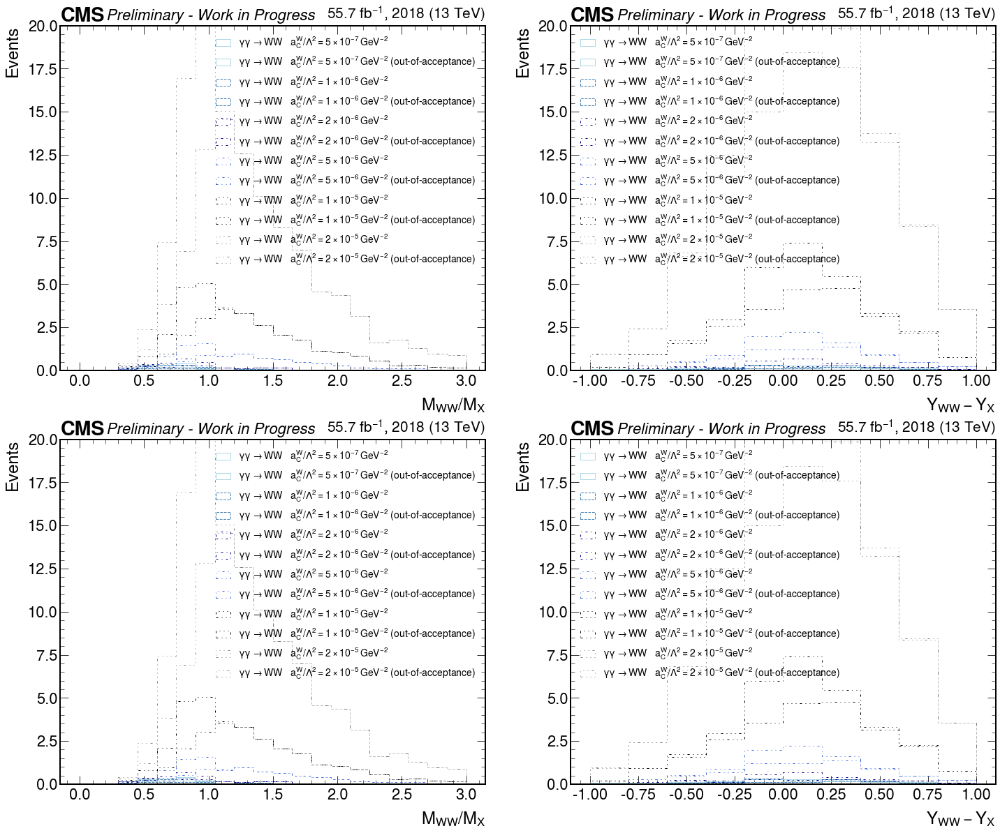

In [76]:
variation__ = "_nom"
var_str__ = {}
# var_str__[ "_nom" ] = "_nom_nom"
var_str__[ "_nom" ] = "_nom"
var_weights__ = "nom"

fig, axes = plt.subplots( 2, 2, figsize=(2*12,2*10) )

colors_ = [ "lightblue", "steelblue", "darkblue", "royalblue", "black", "gray" ]

linestyles_ = [ "solid", "dashed", (0, (3, 5, 1, 5)), (0, (3, 5, 1, 5, 1, 5)), (0, (3, 5, 1, 5, 1, 5, 1, 5)), (0, (3, 5, 1, 5, 1, 5, 1, 5, 1, 5)) ]

bins_R_MWW_MX_ = 20
bins_Diff_YWW_YX_ = 10
for idx_, label_ in enumerate( labels_signals[6:] ):
    axes[0,0].hist( df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat[ label_ ][ variation__ ][ "R_MWW_MX" + var_str__[ "_nom" ] ], weights=weights_sig_plus_mix_categories_concat[ label_ ][ var_weights__ ][ variation__ ],
              histtype='step', color=colors_[ idx_ ], linestyle=linestyles_[ idx_ ], label=labels_samples[ label_ ],
              bins=bins_R_MWW_MX_, range=(0.,3.) )
    axes[0,0].hist( df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat_skip_sig[ label_ ][ variation__ ][ "R_MWW_MX" + var_str__[ "_nom" ] ], weights=weights_sig_plus_mix_categories_concat_skip_sig[ label_ ][ var_weights__ ][ variation__ ],
              histtype='step', color=colors_[ idx_ ], linestyle=linestyles_[ idx_ ], label=( labels_samples[ label_ ] + " (out-of-acceptance)" ),
              bins=bins_R_MWW_MX_, range=(0.,3.) )
    axes[0,1].hist( df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat[ label_ ][ variation__ ][ "Diff_YWW_YX" + var_str__[ "_nom" ] ], weights=weights_sig_plus_mix_categories_concat[ label_ ][ var_weights__ ][ variation__ ],
              histtype='step', color=colors_[ idx_ ], linestyle=linestyles_[ idx_ ], label=labels_samples[ label_ ],
              bins=bins_Diff_YWW_YX_, range=(-1.,1.) )
    axes[0,1].hist( df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat_skip_sig[ label_ ][ variation__ ][ "Diff_YWW_YX" + var_str__[ "_nom" ] ], weights=weights_sig_plus_mix_categories_concat_skip_sig[ label_ ][ var_weights__ ][ variation__ ],
              histtype='step', color=colors_[ idx_ ], linestyle=linestyles_[ idx_ ], label=( labels_samples[ label_ ] + " (out-of-acceptance)" ),
              bins=bins_Diff_YWW_YX_, range=(-1.,1.) )
for idx_, label_ in enumerate( labels_signals[6:] ):
    axes[1,0].hist( df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat[ label_ ][ variation__ ][ "R_MWW_MX" + var_str__[ "_nom" ] ], weights=weights_sig_plus_mix_categories_concat[ label_ ][ var_weights__ ][ variation__ ],
              histtype='step', color=colors_[ idx_ ], linestyle=linestyles_[ idx_ ], label=labels_samples[ label_ ],
              bins=bins_R_MWW_MX_, range=(0.,3.) )
    axes[1,0].hist( df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat_skip_sig[ label_ ][ variation__ ][ "R_MWW_MX" + var_str__[ "_nom" ] ], weights=weights_sig_plus_mix_categories_concat_skip_sig[ label_ ][ var_weights__ ][ variation__ ],
              histtype='step', color=colors_[ idx_ ], linestyle=linestyles_[ idx_ ], label=( labels_samples[ label_ ] + " (out-of-acceptance)" ),
              bins=bins_R_MWW_MX_, range=(0.,3.) )
    axes[1,1].hist( df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat[ label_ ][ variation__ ][ "Diff_YWW_YX" + var_str__[ "_nom" ] ], weights=weights_sig_plus_mix_categories_concat[ label_ ][ var_weights__ ][ variation__ ],
              histtype='step', color=colors_[ idx_ ], linestyle=linestyles_[ idx_ ], label=labels_samples[ label_ ],
              bins=bins_Diff_YWW_YX_, range=(-1.,1.) )
    axes[1,1].hist( df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat_skip_sig[ label_ ][ variation__ ][ "Diff_YWW_YX" + var_str__[ "_nom" ] ], weights=weights_sig_plus_mix_categories_concat_skip_sig[ label_ ][ var_weights__ ][ variation__ ],
              histtype='step', color=colors_[ idx_ ], linestyle=linestyles_[ idx_ ], label=( labels_samples[ label_ ] + " (out-of-acceptance)" ),
              bins=bins_Diff_YWW_YX_, range=(-1.,1.) )

axes[0,0].set_xlabel( r"$ M_{WW} / M_{X} $" )
axes[0,0].set_ylabel( "Events" )
axes[0,0].legend( loc='best', fontsize=14 )
mplhep.cms.label('Preliminary - Work in Progress', ax=axes[0,0], data=True, lumi=55.7, year=2018, loc=0, fontsize=22)
axes[0,1].set_xlabel( r"$ Y_{WW} - Y_{X} $" )
axes[0,1].set_ylabel( "Events" )
axes[0,1].legend( loc='best', fontsize=14 )
mplhep.cms.label('Preliminary - Work in Progress', ax=axes[0,1], data=True, lumi=55.7, year=2018, loc=0, fontsize=22)
axes[1,0].set_xlabel( r"$ M_{WW} / M_{X} $" )
axes[1,0].set_ylabel( "Events" )
axes[1,0].legend( loc='best', fontsize=14 )
mplhep.cms.label('Preliminary - Work in Progress', ax=axes[1,0], data=True, lumi=55.7, year=2018, loc=0, fontsize=22)
axes[1,1].set_xlabel( r"$ Y_{WW} - Y_{X} $" )
axes[1,1].set_ylabel( "Events" )
axes[1,1].legend( loc='best', fontsize=14 )
mplhep.cms.label('Preliminary - Work in Progress', ax=axes[1,1], data=True, lumi=55.7, year=2018, loc=0, fontsize=22)
    
axes[0,0].set_ylim( (0.,20.) )
axes[0,1].set_ylim( (0.,20.) )
axes[1,0].set_ylim( (0.,20.) )
axes[1,1].set_ylim( (0.,20.) )


if save_figures:
    if lepton_type == 'muon':
        plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Mix-Muon_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Mix-Muon_2018.png", bbox_inches='tight' )
    if lepton_type == 'electron':
        plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Mix-Electron_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Mix-Electron_2018.png", bbox_inches='tight' )

2protons_sig
1proton_sig_Arm0
1proton_sig_Arm1
2protons_mix


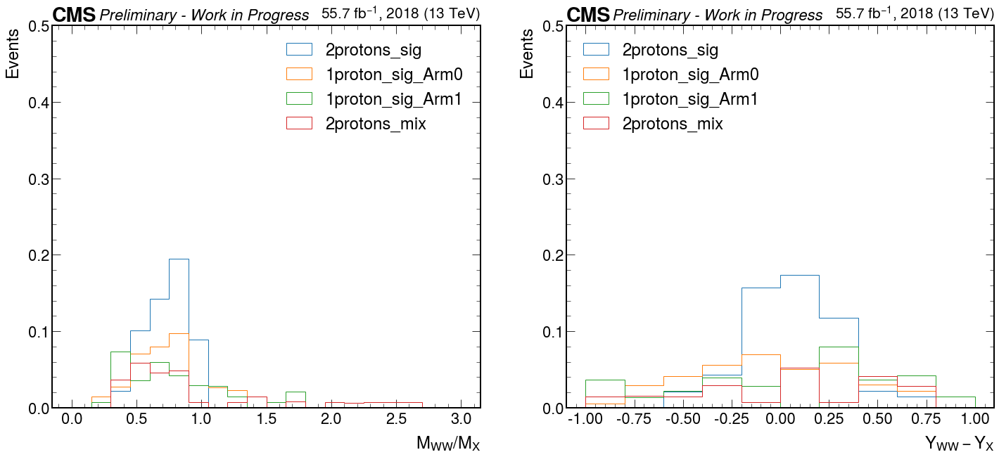

In [77]:
label_ = ""
coupling_str_ = "ACW5e-7"
# coupling_str_ = "A0W1e-6"
if data_sample == '2017':
    if lepton_type == 'muon':
#         label_ = "GGToWW-AQGC-A0W2e-6"
#         label_ = "GGToWW-AQGC-muon-A0W2e-6"
        label_ = "GGToWW-AQGC-2017-muon-" + coupling_str_
    elif lepton_type == 'electron':
#         label_ = "GGToWW-AQGC-electron-A0W2e-6"
        label_ = "GGToWW-AQGC-2017-electron-" + coupling_str_
elif data_sample == '2018':
    if lepton_type == 'muon':
        label_ = "GGToWW-AQGC-2018-muon-" + coupling_str_
    elif lepton_type == 'electron':
        label_ = "GGToWW-AQGC-2018-electron-" + coupling_str_

fig, axes = plt.subplots( 1, 2, figsize=(2*12,10) )
for key_ in df_signals_protons_multiRP_sig_plus_mix_selected_events_categories[ label_ ]:
    print ( key_ )
    df_selected_events__ = df_signals_protons_multiRP_sig_plus_mix_selected_events_categories[ label_ ][ key_ ][ variation__ ]
    axes[0].hist( df_selected_events__[ "R_MWW_MX" + var_str__[ "_nom" ] ], weights=weights_sig_plus_mix_categories[ label_ ][ var_weights__ ][ key_ ][ variation__ ],
              histtype='step', label=key_,
              bins=bins_R_MWW_MX_, range=(0.,3.) )
    axes[1].hist( df_selected_events__[ "Diff_YWW_YX" + var_str__[ "_nom" ] ], weights=weights_sig_plus_mix_categories[ label_ ][ var_weights__ ][ key_ ][ variation__ ],
              histtype='step', label=key_,
              bins=bins_Diff_YWW_YX_, range=(-1.,1.) )

axes[0].set_xlabel( r"$ M_{WW} / M_{X} $" )
axes[0].set_ylabel( "Events" )
axes[0].legend( loc='best' )
mplhep.cms.label('Preliminary - Work in Progress', ax=axes[0], data=True, lumi=55.7, year=2018, loc=0, fontsize=22)
axes[1].set_xlabel( r"$ Y_{WW} - Y_{X} $" )
axes[1].set_ylabel( "Events" )
axes[1].legend( loc='upper left' )
mplhep.cms.label('Preliminary - Work in Progress', ax=axes[1], data=True, lumi=55.7, year=2018, loc=0, fontsize=22)
# plt.ylim( 0., 0.5 )
# plt.ylim( 0., 3. )
axes[0].set_ylim( 0., .5 )
axes[1].set_ylim( 0., .5 )

if save_figures:
    if lepton_type == 'muon':
        plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Mix-Categories-Muon_aCw5e-7_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Mix-Categories-Muon_aCw5e-7_2018.png", bbox_inches='tight' )
    if lepton_type == 'electron':
        plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Mix-Categories-Electron_aCw5e-7_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Mix-Categories-Electron_aCw5e-7_2018.png", bbox_inches='tight' )

2protons_sig
1proton_sig_Arm0
1proton_sig_Arm1
2protons_mix


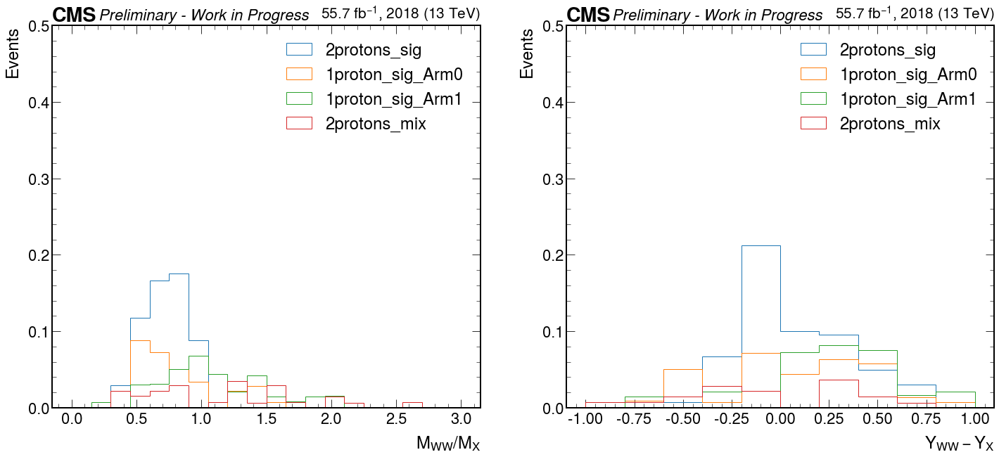

In [78]:
label_ = ""
coupling_str_ = "ACW1e-6"
# coupling_str_ = "A0W2e-6"
if data_sample == '2017':
    if lepton_type == 'muon':
#         label_ = "GGToWW-AQGC-A0W2e-6"
#         label_ = "GGToWW-AQGC-muon-A0W2e-6"
        label_ = "GGToWW-AQGC-2017-muon-" + coupling_str_
    elif lepton_type == 'electron':
#         label_ = "GGToWW-AQGC-electron-A0W2e-6"
        label_ = "GGToWW-AQGC-2017-electron-" + coupling_str_
elif data_sample == '2018':
    if lepton_type == 'muon':
        label_ = "GGToWW-AQGC-2018-muon-" + coupling_str_
    elif lepton_type == 'electron':
        label_ = "GGToWW-AQGC-2018-electron-" + coupling_str_

fig, axes = plt.subplots( 1, 2, figsize=(2*12,10) )
for key_ in df_signals_protons_multiRP_sig_plus_mix_selected_events_categories[ label_ ]:
    print ( key_ )
    df_selected_events__ = df_signals_protons_multiRP_sig_plus_mix_selected_events_categories[ label_ ][ key_ ][ variation__ ]
    axes[0].hist( df_selected_events__[ "R_MWW_MX" + var_str__[ "_nom" ] ], weights=weights_sig_plus_mix_categories[ label_ ][ var_weights__ ][ key_ ][ variation__ ],
              histtype='step', label=key_,
              bins=bins_R_MWW_MX_, range=(0.,3.) )
    axes[1].hist( df_selected_events__[ "Diff_YWW_YX" + var_str__[ "_nom" ] ], weights=weights_sig_plus_mix_categories[ label_ ][ var_weights__ ][ key_ ][ variation__ ],
              histtype='step', label=key_,
              bins=bins_Diff_YWW_YX_, range=(-1.,1.) )
    
axes[0].set_xlabel( r"$ M_{WW} / M_{X} $" )
axes[0].set_ylabel( "Events" )
axes[0].legend( loc='best' )
mplhep.cms.label('Preliminary - Work in Progress', ax=axes[0], data=True, lumi=55.7, year=2018, loc=0, fontsize=22)
axes[1].set_xlabel( r"$ Y_{WW} - Y_{X} $" )
axes[1].set_ylabel( "Events" )
axes[1].legend( loc='best' )
mplhep.cms.label('Preliminary - Work in Progress', ax=axes[1], data=True, lumi=55.7, year=2018, loc=0, fontsize=22)
# plt.ylim( 0., 0.3 )
# plt.ylim( 0., 0.5 )
# plt.ylim( 0., 3. )
axes[0].set_ylim( 0., .5 )
axes[1].set_ylim( 0., .5 )

if save_figures:
    if lepton_type == 'muon':
        plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Mix-Categories-Muon_aCw1e-6_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Mix-Categories-Muon_aCw1e-6_2018.png", bbox_inches='tight' )
    if lepton_type == 'electron':
        plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Mix-Categories-Electron_aCw1e-6_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Mix-Categories-Electron_aCw1e-6_2018.png", bbox_inches='tight' )

2protons_sig
1proton_sig_Arm0
1proton_sig_Arm1
2protons_mix


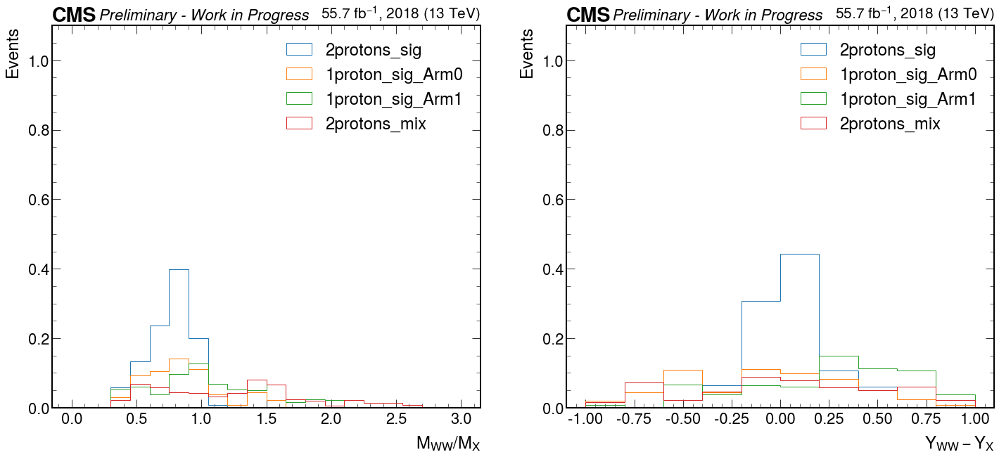

In [79]:
label_ = ""
coupling_str_ = "ACW2e-6"
# coupling_str_ = "A0W2e-6"
if data_sample == '2017':
    if lepton_type == 'muon':
#         label_ = "GGToWW-AQGC-A0W2e-6"
#         label_ = "GGToWW-AQGC-muon-A0W2e-6"
        label_ = "GGToWW-AQGC-2017-muon-" + coupling_str_
    elif lepton_type == 'electron':
#         label_ = "GGToWW-AQGC-electron-A0W2e-6"
        label_ = "GGToWW-AQGC-2017-electron-" + coupling_str_
elif data_sample == '2018':
    if lepton_type == 'muon':
        label_ = "GGToWW-AQGC-2018-muon-" + coupling_str_
    elif lepton_type == 'electron':
        label_ = "GGToWW-AQGC-2018-electron-" + coupling_str_

fig, axes = plt.subplots( 1, 2, figsize=(2*12,10) )
for key_ in df_signals_protons_multiRP_sig_plus_mix_selected_events_categories[ label_ ]:
    print ( key_ )
    df_selected_events__ = df_signals_protons_multiRP_sig_plus_mix_selected_events_categories[ label_ ][ key_ ][ variation__ ]
    axes[0].hist( df_selected_events__[ "R_MWW_MX" + var_str__[ "_nom" ] ], weights=weights_sig_plus_mix_categories[ label_ ][ var_weights__ ][ key_ ][ variation__ ],
              histtype='step', label=key_,
              bins=bins_R_MWW_MX_, range=(0.,3.) )
    axes[1].hist( df_selected_events__[ "Diff_YWW_YX" + var_str__[ "_nom" ] ], weights=weights_sig_plus_mix_categories[ label_ ][ var_weights__ ][ key_ ][ variation__ ],
              histtype='step', label=key_,
              bins=bins_Diff_YWW_YX_, range=(-1.,1.) )
    
axes[0].set_xlabel( r"$ M_{WW} / M_{X} $" )
axes[0].set_ylabel( "Events" )
axes[0].legend( loc='best' )
mplhep.cms.label('Preliminary - Work in Progress', ax=axes[0], data=True, lumi=55.7, year=2018, loc=0, fontsize=22)
axes[1].set_xlabel( r"$ Y_{WW} - Y_{X} $" )
axes[1].set_ylabel( "Events" )
axes[1].legend( loc='best' )
mplhep.cms.label('Preliminary - Work in Progress', ax=axes[1], data=True, lumi=55.7, year=2018, loc=0, fontsize=22)
# plt.ylim( 0., 0.3 )
# plt.ylim( 0., 0.5 )
# plt.ylim( 0., 3. )
axes[0].set_ylim( 0., 1.1 )
axes[1].set_ylim( 0., 1.1 )

if save_figures:
    if lepton_type == 'muon':
        plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Mix-Categories-Muon_aCw2e-6_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Mix-Categories-Muon_aCw2e-6_2018.png", bbox_inches='tight' )
    if lepton_type == 'electron':
        plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Mix-Categories-Electron_aCw2e-6_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Mix-Categories-Electron_aCw2e-6_2018.png", bbox_inches='tight' )

2protons_sig
1proton_sig_Arm0
1proton_sig_Arm1
2protons_mix


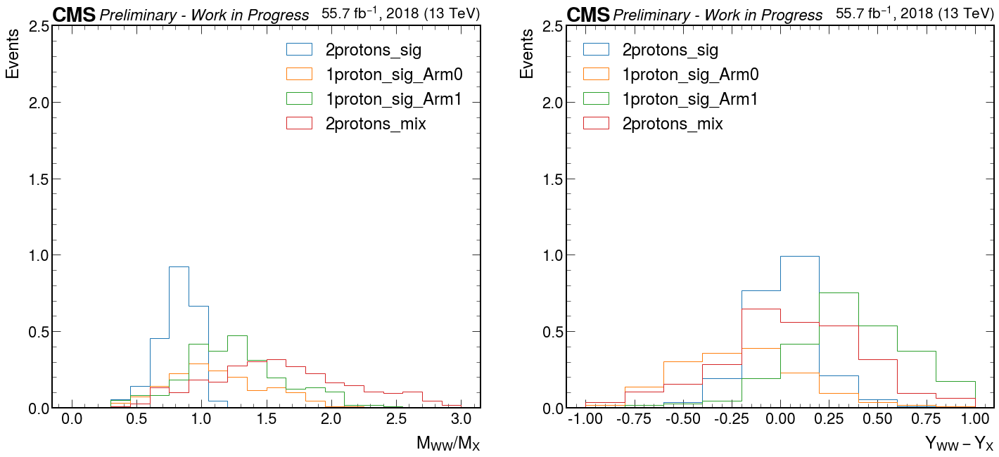

In [80]:
label_ = ""
coupling_str_ = "ACW5e-6"
# coupling_str_ = "A0W2e-6"
if data_sample == '2017':
    if lepton_type == 'muon':
#         label_ = "GGToWW-AQGC-A0W2e-6"
#         label_ = "GGToWW-AQGC-muon-A0W2e-6"
        label_ = "GGToWW-AQGC-2017-muon-" + coupling_str_
    elif lepton_type == 'electron':
#         label_ = "GGToWW-AQGC-electron-A0W2e-6"
        label_ = "GGToWW-AQGC-2017-electron-" + coupling_str_
elif data_sample == '2018':
    if lepton_type == 'muon':
        label_ = "GGToWW-AQGC-2018-muon-" + coupling_str_
    elif lepton_type == 'electron':
        label_ = "GGToWW-AQGC-2018-electron-" + coupling_str_

fig, axes = plt.subplots( 1, 2, figsize=(2*12,10) )
for key_ in df_signals_protons_multiRP_sig_plus_mix_selected_events_categories[ label_ ]:
    print ( key_ )
    df_selected_events__ = df_signals_protons_multiRP_sig_plus_mix_selected_events_categories[ label_ ][ key_ ][ variation__ ]
    axes[0].hist( df_selected_events__[ "R_MWW_MX" + var_str__[ "_nom" ] ], weights=weights_sig_plus_mix_categories[ label_ ][ var_weights__ ][ key_ ][ variation__ ],
              histtype='step', label=key_,
              bins=bins_R_MWW_MX_, range=(0.,3.) )
    axes[1].hist( df_selected_events__[ "Diff_YWW_YX" + var_str__[ "_nom" ] ], weights=weights_sig_plus_mix_categories[ label_ ][ var_weights__ ][ key_ ][ variation__ ],
              histtype='step', label=key_,
              bins=bins_Diff_YWW_YX_, range=(-1.,1.) )
    
axes[0].set_xlabel( r"$ M_{WW} / M_{X} $" )
axes[0].set_ylabel( "Events" )
axes[0].legend( loc='best' )
mplhep.cms.label('Preliminary - Work in Progress', ax=axes[0], data=True, lumi=55.7, year=2018, loc=0, fontsize=22)
axes[1].set_xlabel( r"$ Y_{WW} - Y_{X} $" )
axes[1].set_ylabel( "Events" )
axes[1].legend( loc='upper left' )
mplhep.cms.label('Preliminary - Work in Progress', ax=axes[1], data=True, lumi=55.7, year=2018, loc=0, fontsize=22)
# plt.ylim( 0., 0.3 )
# plt.ylim( 0., 0.5 )
# plt.ylim( 0., 3. )
axes[0].set_ylim( 0., 2.5 )
axes[1].set_ylim( 0., 2.5 )

if save_figures:
    if lepton_type == 'muon':
        plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Mix-Categories-Muon_aCw5e-6_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Mix-Categories-Muon_aCw5e-6_2018.png", bbox_inches='tight' )
    if lepton_type == 'electron':
        plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Mix-Categories-Electron_aCw5e-6_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Mix-Categories-Electron_aCw5e-6_2018.png", bbox_inches='tight' )

2protons_sig
1proton_sig_Arm0
1proton_sig_Arm1
2protons_mix


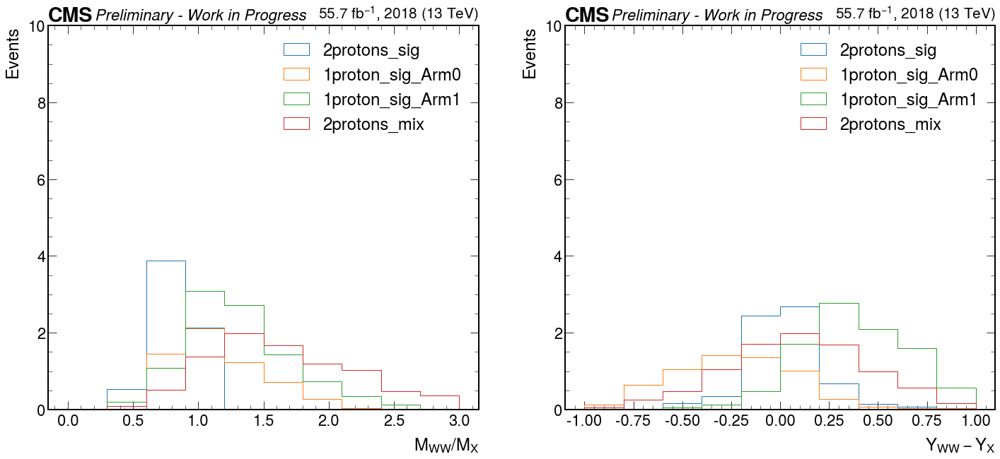

In [81]:
label_ = ""
coupling_str_ = "ACW1e-5"
# coupling_str_ = "A0W5e-6"
if data_sample == '2017':
    if lepton_type == 'muon':
#         label_ = "GGToWW-AQGC-A0W2e-6"
#         label_ = "GGToWW-AQGC-muon-A0W2e-6"
        label_ = "GGToWW-AQGC-2017-muon-" + coupling_str_
    elif lepton_type == 'electron':
#         label_ = "GGToWW-AQGC-electron-A0W2e-6"
        label_ = "GGToWW-AQGC-2017-electron-" + coupling_str_
elif data_sample == '2018':
    if lepton_type == 'muon':
        label_ = "GGToWW-AQGC-2018-muon-" + coupling_str_
    elif lepton_type == 'electron':
        label_ = "GGToWW-AQGC-2018-electron-" + coupling_str_

fig, axes = plt.subplots( 1, 2, figsize=(2*12,10) )
for key_ in df_signals_protons_multiRP_sig_plus_mix_selected_events_categories[ label_ ]:
    print ( key_ )
    df_selected_events__ = df_signals_protons_multiRP_sig_plus_mix_selected_events_categories[ label_ ][ key_ ][ variation__ ]
    axes[0].hist( df_selected_events__[ "R_MWW_MX" + var_str__[ "_nom" ] ], weights=weights_sig_plus_mix_categories[ label_ ][ var_weights__ ][ key_ ][ variation__ ],
              histtype='step', label=key_,
              bins=bins_Diff_YWW_YX_, range=(0.,3.) )
    axes[1].hist( df_selected_events__[ "Diff_YWW_YX" + var_str__[ "_nom" ] ], weights=weights_sig_plus_mix_categories[ label_ ][ var_weights__ ][ key_ ][ variation__ ],
              histtype='step', label=key_,
              bins=bins_Diff_YWW_YX_, range=(-1.,1.) )
    
axes[0].set_xlabel( r"$ M_{WW} / M_{X} $" )
axes[0].set_ylabel( "Events" )
axes[0].legend( loc='best' )
mplhep.cms.label('Preliminary - Work in Progress', ax=axes[0], data=True, lumi=55.7, year=2018, loc=0, fontsize=22)
axes[1].set_xlabel( r"$ Y_{WW} - Y_{X} $" )
axes[1].set_ylabel( "Events" )
axes[1].legend( loc='best' )
mplhep.cms.label('Preliminary - Work in Progress', ax=axes[1], data=True, lumi=55.7, year=2018, loc=0, fontsize=22)
# plt.ylim( 0., 0.3 )
# plt.ylim( 0., 0.5 )
# plt.ylim( 0., 3. )
axes[0].set_ylim( 0., 10. )
axes[1].set_ylim( 0., 10. )

if save_figures:
    if lepton_type == 'muon':
        plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Mix-Categories-Muon_aCw1e-5_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Mix-Categories-Muon_aCw1e-5_2018.png", bbox_inches='tight' )
    if lepton_type == 'electron':
        plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Mix-Categories-Electron_aCw1e-5_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Mix-Categories-Electron_aCw1e-5_2018.png", bbox_inches='tight' )

2protons_sig
1proton_sig_Arm0
1proton_sig_Arm1
2protons_mix


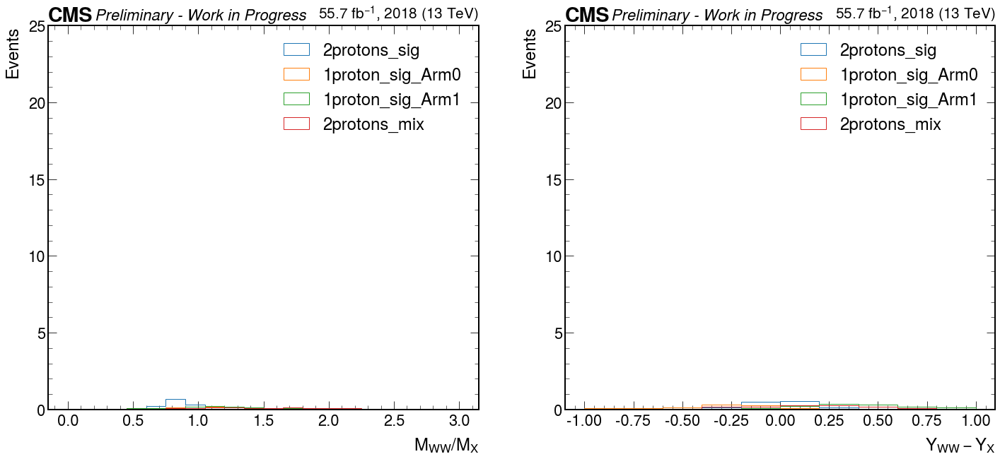

In [82]:
label_ = ""
# coupling_str_ = "ACW2e-5"
coupling_str_ = "A0W1e-6"
if data_sample == '2017':
    if lepton_type == 'muon':
#         label_ = "GGToWW-AQGC-A0W2e-6"
#         label_ = "GGToWW-AQGC-muon-A0W2e-6"
        label_ = "GGToWW-AQGC-2017-muon-" + coupling_str_
    elif lepton_type == 'electron':
#         label_ = "GGToWW-AQGC-electron-A0W2e-6"
        label_ = "GGToWW-AQGC-2017-electron-" + coupling_str_
elif data_sample == '2018':
    if lepton_type == 'muon':
        label_ = "GGToWW-AQGC-2018-muon-" + coupling_str_
    elif lepton_type == 'electron':
        label_ = "GGToWW-AQGC-2018-electron-" + coupling_str_

fig, axes = plt.subplots( 1, 2, figsize=(2*12,10) )
for key_ in df_signals_protons_multiRP_sig_plus_mix_selected_events_categories[ label_ ]:
    print ( key_ )
    df_selected_events__ = df_signals_protons_multiRP_sig_plus_mix_selected_events_categories[ label_ ][ key_ ][ variation__ ]
    axes[0].hist( df_selected_events__[ "R_MWW_MX" + var_str__[ "_nom" ] ], weights=weights_sig_plus_mix_categories[ label_ ][ var_weights__ ][ key_ ][ variation__ ],
              histtype='step', label=key_,
              bins=bins_R_MWW_MX_, range=(0.,3.) )
    axes[1].hist( df_selected_events__[ "Diff_YWW_YX" + var_str__[ "_nom" ] ], weights=weights_sig_plus_mix_categories[ label_ ][ var_weights__ ][ key_ ][ variation__ ],
              histtype='step', label=key_,
              bins=bins_Diff_YWW_YX_, range=(-1.,1.) )
    
axes[0].set_xlabel( r"$ M_{WW} / M_{X} $" )
axes[0].set_ylabel( "Events" )
axes[0].legend( loc='best' )
mplhep.cms.label('Preliminary - Work in Progress', ax=axes[0], data=True, lumi=55.7, year=2018, loc=0, fontsize=22)
axes[1].set_xlabel( r"$ Y_{WW} - Y_{X} $" )
axes[1].set_ylabel( "Events" )
axes[1].legend( loc='best' )
mplhep.cms.label('Preliminary - Work in Progress', ax=axes[1], data=True, lumi=55.7, year=2018, loc=0, fontsize=22)
# plt.ylim( 0., 0.3 )
# plt.ylim( 0., 0.5 )
# plt.ylim( 0., 3. )
axes[0].set_ylim( 0., 25. )
axes[1].set_ylim( 0., 25. )

if save_figures:
    if lepton_type == 'muon':
        plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Mix-Categories-Muon_a0w1e-6_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Mix-Categories-Muon_a0w1e-6_2018.png", bbox_inches='tight' )
    if lepton_type == 'electron':
        plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Mix-Categories-Electron_a0w1e-6_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Mix-Categories-Electron_a0w1e-6_2018.png", bbox_inches='tight' )

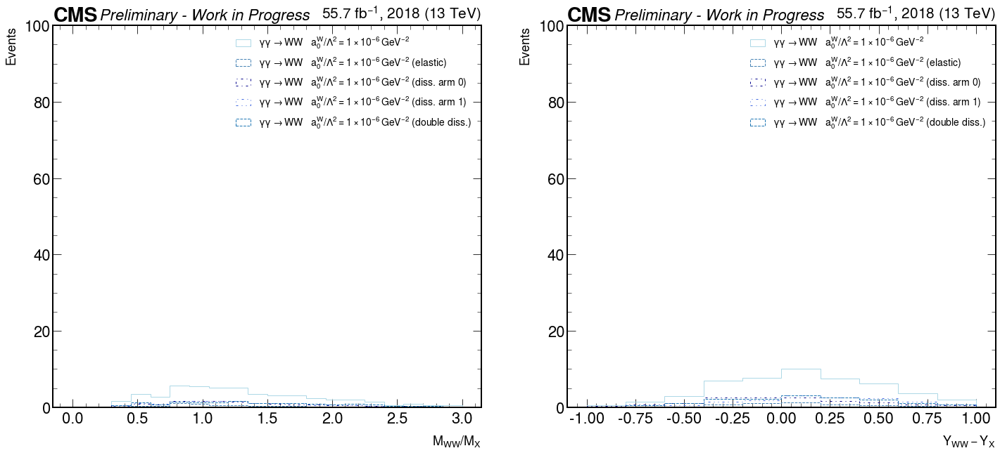

In [83]:
if run_dissociative_signal:
    variation__ = "_nom"
    var_str__ = {}
    var_str__[ "_nom" ] = "_nom"
    var_weights__ = "nom"

    fig, axes = plt.subplots( 1, 2, figsize=(2*12,10) )

    colors_ = [ "lightblue", "steelblue", "darkblue", "royalblue", "tab:blue" ]

    linestyles_ = [ "solid", "dashed", (0, (3, 5, 1, 5)), (0, (3, 5, 1, 5, 1, 5)), "dashed" ]
    
    idx_ = 0
    axes[0].hist( df_signals_protons_multiRP_sig_plus_mix_All_selected_events[ label_ ][ variation__ ][ "R_MWW_MX" + var_str__[ "_nom" ] ],
                  weights=weights_sig_plus_mix_All[ label_ ][ var_weights__ ][ variation__ ],
                  histtype='step', color=colors_[ idx_ ], linestyle=linestyles_[ idx_ ], label=labels_samples[ label_ ],
                  bins=bins_R_MWW_MX_, range=(0.,3.) )
    idx_ = 1
    axes[0].hist( df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat[ label_ ][ variation__ ][ "R_MWW_MX" + var_str__[ "_nom" ] ],
                  weights=weights_sig_plus_mix_categories_concat[ label_ ][ var_weights__ ][ variation__ ],
                  histtype='step', color=colors_[ idx_ ], linestyle=linestyles_[ idx_ ], label=( labels_samples[ label_ ] + " (elastic)" ),
                  bins=bins_R_MWW_MX_, range=(0.,3.) )
    idx_ = 2
    axes[0].hist( df_signals_protons_multiRP_sig_plus_mix_Arm0_selected_events_categories_concat[ label_ ][ variation__ ][ "R_MWW_MX" + var_str__[ "_nom" ] ],
                  weights=weights_sig_plus_mix_Arm0_categories_concat[ label_ ][ var_weights__ ][ variation__ ],
                  histtype='step', color=colors_[ idx_ ], linestyle=linestyles_[ idx_ ], label=( labels_samples[ label_ ] + " (diss. arm 0)" ),
                  bins=bins_R_MWW_MX_, range=(0.,3.) )
    idx_ = 3
    axes[0].hist( df_signals_protons_multiRP_sig_plus_mix_Arm1_selected_events_categories_concat[ label_ ][ variation__ ][ "R_MWW_MX" + var_str__[ "_nom" ] ],
                  weights=weights_sig_plus_mix_Arm1_categories_concat[ label_ ][ var_weights__ ][ variation__ ],
                  histtype='step', color=colors_[ idx_ ], linestyle=linestyles_[ idx_ ], label=( labels_samples[ label_ ] + " (diss. arm 1)" ),
                  bins=bins_R_MWW_MX_, range=(0.,3.) )
    idx_ = 4
    axes[0].hist( df_signals_protons_multiRP_mix_protons_selected_events[ label_ ][ variation__ ][ "R_MWW_MX" + var_str__[ "_nom" ] ],
                  weights=weights_sig_mix_protons[ label_ ][ var_weights__ ][ variation__ ],
                  histtype='step', color=colors_[ idx_ ], linestyle=linestyles_[ idx_ ], label=( labels_samples[ label_ ] + " (double diss.)" ),
                  bins=bins_R_MWW_MX_, range=(0.,3.) )
    
    
    
    idx_ = 0
    axes[1].hist( df_signals_protons_multiRP_sig_plus_mix_All_selected_events[ label_ ][ variation__ ][ "Diff_YWW_YX" + var_str__[ "_nom" ] ],
                  weights=weights_sig_plus_mix_All[ label_ ][ var_weights__ ][ variation__ ],
                  histtype='step', color=colors_[ idx_ ], linestyle=linestyles_[ idx_ ], label=labels_samples[ label_ ],
                  bins=bins_Diff_YWW_YX_, range=(-1.,1.) )
    idx_ = 1
    axes[1].hist( df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat[ label_ ][ variation__ ][ "Diff_YWW_YX" + var_str__[ "_nom" ] ],
                  weights=weights_sig_plus_mix_categories_concat[ label_ ][ var_weights__ ][ variation__ ],
                  histtype='step', color=colors_[ idx_ ], linestyle=linestyles_[ idx_ ], label=( labels_samples[ label_ ] + " (elastic)" ),
                  bins=bins_Diff_YWW_YX_, range=(-1.,1.) )
    idx_ = 2
    axes[1].hist( df_signals_protons_multiRP_sig_plus_mix_Arm0_selected_events_categories_concat[ label_ ][ variation__ ][ "Diff_YWW_YX" + var_str__[ "_nom" ] ],
                  weights=weights_sig_plus_mix_Arm0_categories_concat[ label_ ][ var_weights__ ][ variation__ ],
                  histtype='step', color=colors_[ idx_ ], linestyle=linestyles_[ idx_ ], label=( labels_samples[ label_ ] + " (diss. arm 0)" ),
                  bins=bins_Diff_YWW_YX_, range=(-1.,1.) )
    idx_ = 3
    axes[1].hist( df_signals_protons_multiRP_sig_plus_mix_Arm1_selected_events_categories_concat[ label_ ][ variation__ ][ "Diff_YWW_YX" + var_str__[ "_nom" ] ],
                  weights=weights_sig_plus_mix_Arm1_categories_concat[ label_ ][ var_weights__ ][ variation__ ],
                  histtype='step', color=colors_[ idx_ ], linestyle=linestyles_[ idx_ ], label=( labels_samples[ label_ ] + " (diss. arm 1)" ),
                  bins=bins_Diff_YWW_YX_, range=(-1.,1.) )
    idx_ = 4
    axes[1].hist( df_signals_protons_multiRP_mix_protons_selected_events[ label_ ][ variation__ ][ "Diff_YWW_YX" + var_str__[ "_nom" ] ],
                  weights=weights_sig_mix_protons[ label_ ][ var_weights__ ][ variation__ ],
                  histtype='step', color=colors_[ idx_ ], linestyle=linestyles_[ idx_ ], label=( labels_samples[ label_ ] + " (double diss.)" ),
                  bins=bins_Diff_YWW_YX_, range=(-1.,1.) )
    
    axes[0].set_xlabel( r"$ M_{WW} / M_{X} $", fontsize=18 )
    axes[0].set_ylabel( "Events", fontsize=18 )
    axes[0].legend( loc='best', fontsize=14 )
    mplhep.cms.label('Preliminary - Work in Progress', ax=axes[0], data=True, lumi=55.7, year=2018, loc=0, fontsize=22)
    axes[1].set_xlabel( r"$ Y_{WW} - Y_{X} $", fontsize=18 )
    axes[1].set_ylabel( "Events", fontsize=18 )
    axes[1].legend( loc='best', fontsize=14 )
    mplhep.cms.label('Preliminary - Work in Progress', ax=axes[1], data=True, lumi=55.7, year=2018, loc=0, fontsize=22)

    axes[0].set_ylim( (0.,100.) )
    axes[1].set_ylim( (0.,100.) )
#     axes[0].set_ylim( (0.,30.) )
#     axes[1].set_ylim( (0.,30.) )

if save_figures:
    if lepton_type == 'muon':
        plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Mix-Categories-Muon_a0w1e-6_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Mix-Categories-Muon_a0w1e-6_2018.png", bbox_inches='tight' )
    if lepton_type == 'electron':
        plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Mix-Categories-Electron_a0w1e-6_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Mix-Categories-Electron_a0w1e-6_2018.png", bbox_inches='tight' )

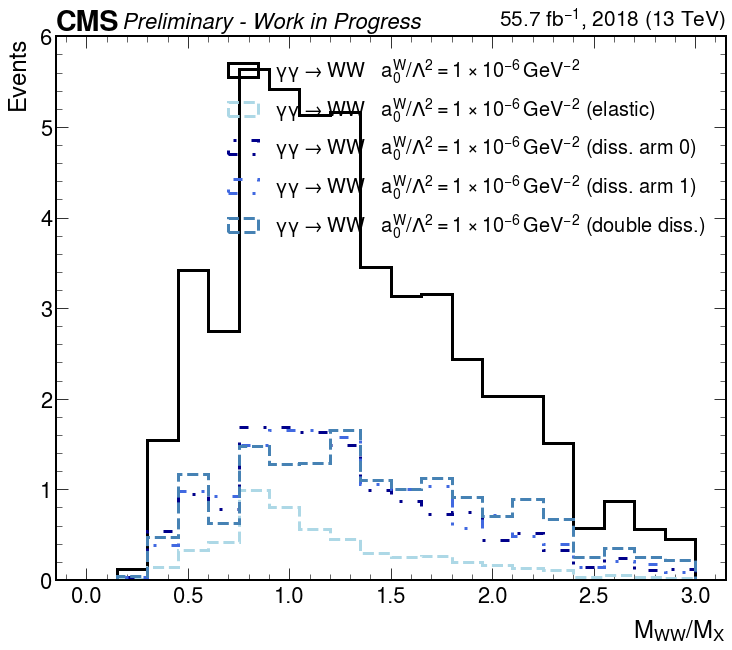

In [84]:
if run_dissociative_signal:
    variation__ = "_nom"
    var_str__ = {}
    var_str__[ "_nom" ] = "_nom"
    var_weights__ = "nom"

    fig = plt.figure( figsize=(12,10) )
    ax_ = plt.gca()
    
    colors_ = [ "black", "lightblue", "darkblue", "royalblue", "steelblue" ]

    linestyles_ = [ "solid", "dashed", (0, (3, 5, 1, 5)), (0, (3, 5, 1, 5, 1, 5)), "dashed" ]
    
    idx_ = 0
    ax_.hist( df_signals_protons_multiRP_sig_plus_mix_All_selected_events[ label_ ][ variation__ ][ "R_MWW_MX" + var_str__[ "_nom" ] ],
                  weights=weights_sig_plus_mix_All[ label_ ][ var_weights__ ][ variation__ ],
                  histtype='step', color=colors_[ idx_ ], linestyle=linestyles_[ idx_ ], label=labels_samples[ label_ ],
                  bins=bins_R_MWW_MX_, range=(0.,3.), linewidth=3 )
    idx_ = 1
    ax_.hist( df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat[ label_ ][ variation__ ][ "R_MWW_MX" + var_str__[ "_nom" ] ],
                  weights=weights_sig_plus_mix_categories_concat[ label_ ][ var_weights__ ][ variation__ ],
                  histtype='step', color=colors_[ idx_ ], linestyle=linestyles_[ idx_ ], label=( labels_samples[ label_ ] + " (elastic)" ),
                  bins=bins_R_MWW_MX_, range=(0.,3.), linewidth=3 )
    idx_ = 2
    ax_.hist( df_signals_protons_multiRP_sig_plus_mix_Arm0_selected_events_categories_concat[ label_ ][ variation__ ][ "R_MWW_MX" + var_str__[ "_nom" ] ],
                  weights=weights_sig_plus_mix_Arm0_categories_concat[ label_ ][ var_weights__ ][ variation__ ],
                  histtype='step', color=colors_[ idx_ ], linestyle=linestyles_[ idx_ ], label=( labels_samples[ label_ ] + " (diss. arm 0)" ),
                  bins=bins_R_MWW_MX_, range=(0.,3.), linewidth=3 )
    idx_ = 3
    ax_.hist( df_signals_protons_multiRP_sig_plus_mix_Arm1_selected_events_categories_concat[ label_ ][ variation__ ][ "R_MWW_MX" + var_str__[ "_nom" ] ],
                  weights=weights_sig_plus_mix_Arm1_categories_concat[ label_ ][ var_weights__ ][ variation__ ],
                  histtype='step', color=colors_[ idx_ ], linestyle=linestyles_[ idx_ ], label=( labels_samples[ label_ ] + " (diss. arm 1)" ),
                  bins=bins_R_MWW_MX_, range=(0.,3.), linewidth=3 )
    idx_ = 4
    ax_.hist( df_signals_protons_multiRP_mix_protons_selected_events[ label_ ][ variation__ ][ "R_MWW_MX" + var_str__[ "_nom" ] ],
                  weights=weights_sig_mix_protons[ label_ ][ var_weights__ ][ variation__ ],
                  histtype='step', color=colors_[ idx_ ], linestyle=linestyles_[ idx_ ], label=( labels_samples[ label_ ] + " (double diss.)" ),
                  bins=bins_R_MWW_MX_, range=(0.,3.), linewidth=3 )
    
  
    ax_.set_xlabel( r"$ M_{WW} / M_{X} $" )
    ax_.set_ylabel( "Events" )
    ax_.legend( loc='best', fontsize=20 )
    mplhep.cms.label('Preliminary - Work in Progress', ax=ax_, data=True, lumi=55.7, year=2018, loc=0, fontsize=22)
    
    ax_.set_ylim( (0.,6.) )
#     ax_[0].set_ylim( (0.,30.) )


if save_figures:
    if lepton_type == 'muon':
        plt.savefig( plots_folder_str+"/Cut-Based-Mass-Signal-Mix-Categories-Muon_a0w1e-6_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Mass-Signal-Mix-Categories-Muon_a0w1e-6_2018.png", bbox_inches='tight' )
    if lepton_type == 'electron':
        plt.savefig( plots_folder_str+"/Cut-Based-Mass-Signal-Mix-Categories-Electron_a0w1e-6_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Mass-Signal-Mix-Categories-Electron_a0w1e-6_2018.png", bbox_inches='tight' )

In [85]:
# df = stop['cell']

In [86]:
if lepton_type == 'muon':
    row_labels = ["GGToWW-AQGC-2018-muon-A0W1e-7", "GGToWW-AQGC-2018-muon-A0W2e-7", "GGToWW-AQGC-2018-muon-A0W5e-7",
                  "GGToWW-AQGC-2018-muon-A0W1e-6", "GGToWW-AQGC-2018-muon-A0W2e-6", "GGToWW-AQGC-2018-muon-A0W5e-6", 
                  "GGToWW-AQGC-2018-muon-ACW5e-7", "GGToWW-AQGC-2018-muon-ACW1e-6", "GGToWW-AQGC-2018-muon-ACW2e-6", 
                  "GGToWW-AQGC-2018-muon-ACW5e-6", "GGToWW-AQGC-2018-muon-ACW1e-5", "GGToWW-AQGC-2018-muon-ACW2e-5"]
elif lepton_type == 'electron':
    row_labels = ["GGToWW-AQGC-2018-electron-A0W1e-7", "GGToWW-AQGC-2018-electron-A0W2e-7", "GGToWW-AQGC-2018-electron-A0W5e-7",
                  "GGToWW-AQGC-2018-electron-A0W1e-6", "GGToWW-AQGC-2018-electron-A0W2e-6", "GGToWW-AQGC-2018-electron-A0W5e-6", 
                  "GGToWW-AQGC-2018-electron-ACW5e-7", "GGToWW-AQGC-2018-electron-ACW1e-6", "GGToWW-AQGC-2018-electron-ACW2e-6", 
                  "GGToWW-AQGC-2018-electron-ACW5e-6", "GGToWW-AQGC-2018-electron-ACW1e-5", "GGToWW-AQGC-2018-electron-ACW2e-5"]

table = pd.DataFrame(index=row_labels, columns=['2protons_sig', '1proton_sig_Arm0', '1proton_sig_Arm1', '2protons_mix'])

for row_label in row_labels:
    #num_entries_df1 = len(df_signals_protons_multiRP_sig_plus_mix_selected_events_categories[row_label]['2protons_sig']['_nom'][ "R_MWW_MX" + var_str__[ "_nom" ] ])
    #num_entries_df2 = len(df_signals_protons_multiRP_sig_plus_mix_selected_events_categories[row_label]['1proton_sig_Arm0']['_nom'][ "R_MWW_MX" + var_str__[ "_nom" ] ])
    #num_entries_df3 = len(df_signals_protons_multiRP_sig_plus_mix_selected_events_categories[row_label]['1proton_sig_Arm1']['_nom'][ "R_MWW_MX" + var_str__[ "_nom" ] ])
    #num_entries_df4 = len(df_signals_protons_multiRP_sig_plus_mix_selected_events_categories[row_label]['2protons_mix']['_nom'][ "R_MWW_MX" + var_str__[ "_nom" ] ])
    num_entries_df1 = np.sum(weights_sig_plus_mix_categories[row_label]['nom']['2protons_sig']['_nom'])
    num_entries_df2 = np.sum(weights_sig_plus_mix_categories[row_label]['nom']['1proton_sig_Arm0']['_nom'])
    num_entries_df3 = np.sum(weights_sig_plus_mix_categories[row_label]['nom']['1proton_sig_Arm1']['_nom'])
    num_entries_df4 = np.sum(weights_sig_plus_mix_categories[row_label]['nom']['2protons_mix']['_nom'])

    table.loc[row_label, '2protons_sig'] = num_entries_df1
    table.loc[row_label, '1proton_sig_Arm0'] = num_entries_df2
    table.loc[row_label, '1proton_sig_Arm1'] = num_entries_df3
    table.loc[row_label, '2protons_mix'] = num_entries_df4

pd.set_option('display.width', 1000)

print(table)

                              2protons_sig 1proton_sig_Arm0 1proton_sig_Arm1 2protons_mix
GGToWW-AQGC-2018-muon-A0W1e-7     0.648259         0.422503         0.269113     0.168604
GGToWW-AQGC-2018-muon-A0W2e-7     0.601459         0.369056         0.373371     0.197572
GGToWW-AQGC-2018-muon-A0W5e-7     0.816549         0.526068         0.531113     0.642428
GGToWW-AQGC-2018-muon-A0W1e-6     1.395466         1.113517         1.410649     1.350186
GGToWW-AQGC-2018-muon-A0W2e-6     3.633528         3.410557         5.221397     5.059819
GGToWW-AQGC-2018-muon-A0W5e-6    19.342501        19.367846        32.990106    34.750516
GGToWW-AQGC-2018-muon-ACW5e-7      0.54949         0.376799         0.320415     0.269907
GGToWW-AQGC-2018-muon-ACW1e-6     0.577065         0.324726          0.34782     0.203627
GGToWW-AQGC-2018-muon-ACW2e-6     1.035467         0.593891         0.677342     0.584517
GGToWW-AQGC-2018-muon-ACW5e-6     2.286463         1.618745         2.579001     2.879572
GGToWW-AQG

In [87]:
#stop[cell]

GGToWW-AQGC-2018-muon-A0W5e-6
Number of events: 106.450969795861 +/- 1.6958283501337676
Number of events (A): 79.03216121060431 +/- 1.4609833276238642
Number of events (B): 11.479697909592671 +/- 0.5566675878982498
Number of events (C): 14.944049984396276 +/- 0.6360754377078081
Number of events (D): 0.9950606912677334 +/- 0.16398397376232135
0 0
GGToWW-AQGC-2018-muon-A0W2e-6
Number of events: 17.32530163937433 +/- 0.425192902690562
Number of events (A): 12.969834622201045 +/- 0.3677137094721341
Number of events (B): 1.8965300267527 +/- 0.14083857900129035
Number of events (C): 2.096332404083838 +/- 0.14824109777236785
Number of events (D): 0.3626045863367452 +/- 0.061357183449121964
0 1
GGToWW-AQGC-2018-muon-ACW1e-5
Number of events: 31.427022445746093 +/- 0.6391118176802371
Number of events (A): 22.870359552683468 +/- 0.5450810648794439
Number of events (B): 3.9241666679160914 +/- 0.22542869151339368
Number of events (C): 4.169719179468934 +/- 0.2335865512072041
Number of events (D): 

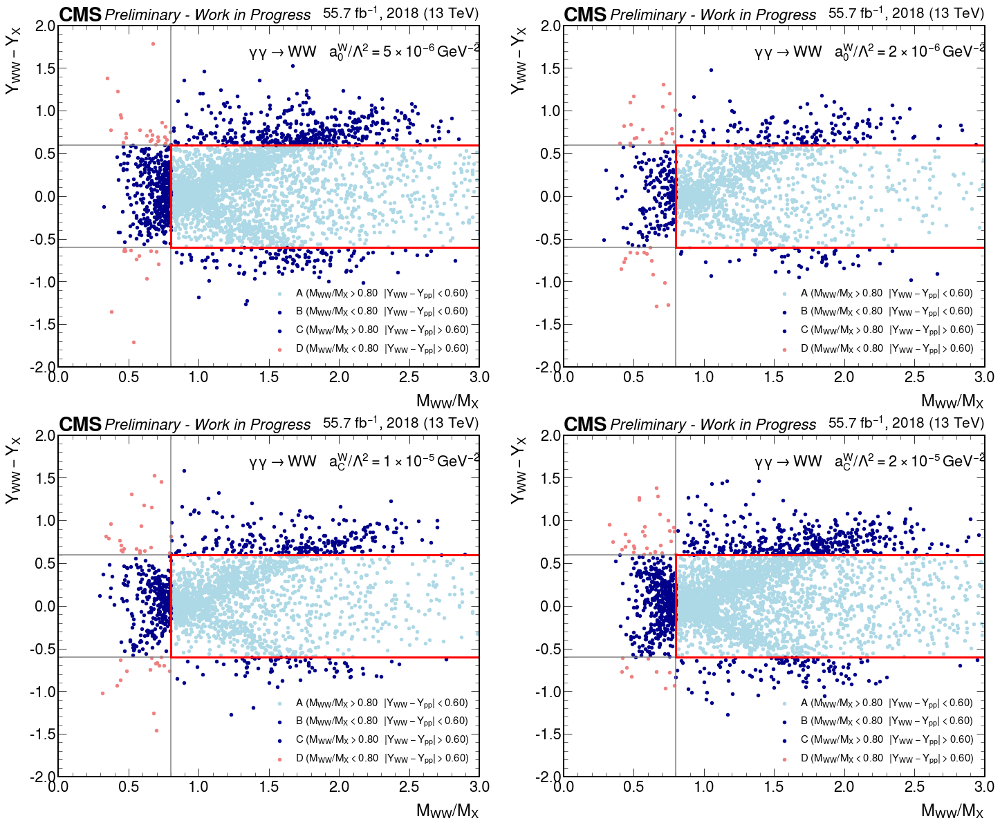

In [88]:
variation__ = "_nom"
var_weights__ = "nom"

labels_signals_alt = ['GGToWW-AQGC-2018-'+lepton_type+'-A0W5e-6', 'GGToWW-AQGC-2018-'+lepton_type+'-A0W2e-6', 'GGToWW-AQGC-2018-'+lepton_type+'-ACW1e-5', 'GGToWW-AQGC-2018-'+lepton_type+'-ACW2e-5']

nrows_ = ( int( len(labels_signals_alt)/2 ) + 1 if ( len(labels_signals_alt) % 2 ) > 0 else int( len(labels_signals_alt)/2 ) )
fig, axes = plt.subplots( nrows_, 2, figsize=(2*12,nrows_*10) )

row_ = 0
col_ = 0
for label_ in labels_signals_alt:
    print ( label_ )
    df__ = df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat[ label_ ][ variation__ ]
    weights__ = weights_sig_plus_mix_categories_concat[ label_ ][ var_weights__ ][ variation__ ]
    var1__ = ( "R_MWW_MX" + var_str__[ "_nom" ] )
    var2__ = ( "Diff_YWW_YX" + var_str__[ "_nom" ] )
    
    msk_sig_cut1 = ( df__[ var1__ ] >= 0.80  )
    msk_sig_cut2 = ( np.abs( df__[ var2__ ] ) <= 0.60 )
    msk_sig_A =  msk_sig_cut1 &  msk_sig_cut2
    msk_sig_B = ~msk_sig_cut1 &  msk_sig_cut2
    msk_sig_C =  msk_sig_cut1 & ~msk_sig_cut2
    msk_sig_D = ~msk_sig_cut1 & ~msk_sig_cut2

    n_events_sig   = np.sum( weights__ )
    err_n_events_sig = np.sqrt( np.sum( weights__ ** 2 ) )
    n_events_sig_A = np.sum( weights__[ msk_sig_A ] )
    err_n_events_sig_A = np.sqrt( np.sum( weights__[ msk_sig_A ] ** 2 ) )
    n_events_sig_B = np.sum( weights__[ msk_sig_B ] )
    err_n_events_sig_B = np.sqrt( np.sum( weights__[ msk_sig_B ] ** 2 ) )
    n_events_sig_C = np.sum( weights__[ msk_sig_C ] )
    err_n_events_sig_C = np.sqrt( np.sum( weights__[ msk_sig_C ] ** 2 ) )
    n_events_sig_D = np.sum( weights__[ msk_sig_D ] )
    err_n_events_sig_D = np.sqrt( np.sum( weights__[ msk_sig_D ] ** 2 ) )

    print ( "Number of events: {} +/- {}".format( n_events_sig, err_n_events_sig ) )
    print ( "Number of events (A): {} +/- {}".format( n_events_sig_A, err_n_events_sig_A ) )
    print ( "Number of events (B): {} +/- {}".format( n_events_sig_B, err_n_events_sig_B ) )
    print ( "Number of events (C): {} +/- {}".format( n_events_sig_C, err_n_events_sig_C ) )
    print ( "Number of events (D): {} +/- {}".format( n_events_sig_D, err_n_events_sig_D ) )

    x_min =  0.
    x_max =  3.0
    y_min = -2.0
    y_max =  2.0
    x_cut = 0.80
    y_cut = 0.60

    print ( row_, col_ )
    axes[ row_, col_ ].plot( (x_min,x_max), (-y_cut,-y_cut), color='gray' )
    axes[ row_, col_ ].plot( (x_min,x_max), (y_cut,y_cut), color='gray' )
    axes[ row_, col_ ].plot( (x_cut,x_cut), (y_min,y_max), color='gray' )
    axes[ row_, col_ ].plot( (x_cut,x_cut), (-y_cut,y_cut), color='red', linewidth=3 )
    axes[ row_, col_ ].plot( (x_cut,x_max), (y_cut,y_cut), color='red', linewidth=3 )
    axes[ row_, col_ ].plot( (x_cut,x_max), (-y_cut,-y_cut), color='red', linewidth=3 )
    
    if np.sum( msk_sig_A ) > 0:
        df__[ msk_sig_A ].plot( var1__, var2__, 'scatter', ax=axes[ row_, col_ ], color='lightblue', label=r"A ($M_{WW} / M_{X} > 0.80$  $|Y_{WW} - Y_{pp}| < 0.60$)" )
    if np.sum( msk_sig_B ) > 0:
        df__[ msk_sig_B ].plot( var1__, var2__, 'scatter', ax=axes[ row_, col_ ], color='darkblue', label=r"B ($M_{WW} / M_{X} < 0.80$  $|Y_{WW} - Y_{pp}| < 0.60$)" )
    if np.sum( msk_sig_C ) > 0:
        df__[ msk_sig_C ].plot( var1__, var2__, 'scatter', ax=axes[ row_, col_ ], color='darkblue', label=r"C ($M_{WW} / M_{X} > 0.80$  $|Y_{WW} - Y_{pp}| > 0.60$)" )
    if np.sum( msk_sig_D ) > 0:
        df__[ msk_sig_D ].plot( var1__, var2__, 'scatter', ax=axes[ row_, col_ ], color='lightcoral', label=r"D ($M_{WW} / M_{X} < 0.80$  $|Y_{WW} - Y_{pp}| > 0.60$)" )
    title_str_ = labels_samples[ label_ ]
    axes[ row_, col_ ].legend( loc='lower right', fontsize=15 )
    axes[ row_, col_ ].text( 0.45, 0.92, title_str_, horizontalalignment='left', verticalalignment='center', transform=axes[ row_, col_ ].transAxes, fontsize=22 )
    axes[ row_, col_ ].set_xlim(x_min, x_max)
    axes[ row_, col_ ].set_ylim(y_min, y_max)
    axes[ row_, col_ ].set_xlabel( r"$M_{WW} / M_{X}$" )
    axes[ row_, col_ ].set_ylabel( r"$Y_{WW} - Y_{X}$" )
    mplhep.cms.label('Preliminary - Work in Progress', ax=axes[ row_, col_ ], data=True, lumi=55.7, year=2018, loc=0, fontsize=22)
    col_ += 1
    if col_ >= 2:
        row_ += 1
        col_  = 0
if col_ == 1: axes[ row_, col_ ].axis('off')
    
if save_figures:
    if lepton_type == 'muon':
        plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-2D-Signal-Muon_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-2D-Signal-Muon_2018.png", bbox_inches='tight' )
    if lepton_type == 'electron':
        plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-2D-Signal-Electron_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-2D-Signal-Electron_2018.png", bbox_inches='tight' )  

In [89]:
# df=stop['cell']

### Calculate uncertainties from variations

In [90]:
from scipy.interpolate import make_interp_spline

relative_uncertainty_ = True

vars_ = {}
vars_[ "R_MWW_MX" ] = {}
# vars_[ "R_MWW_MX" ][ "bins" ]  = 30
# # vars_[ "R_MWW_MX" ][ "bins" ]  = 15
# vars_[ "R_MWW_MX" ][ "range" ] = (0.,3.)
# vars_[ "R_MWW_MX" ][ "xlim" ]  = (0.5,2.)
vars_[ "R_MWW_MX" ][ "bins" ]  = 0.6 + 0.2 * np.arange( 8 )
# vars_[ "R_MWW_MX" ][ "bins" ]  = 0.6 + 0.1 * np.arange( 6 )
# vars_[ "R_MWW_MX" ][ "bins" ]  = 0.2 + 0.2 * np.arange( 10 )
vars_[ "R_MWW_MX" ][ "range" ] = None
vars_[ "R_MWW_MX" ][ "xlim" ]  = ( 0.6, 2. )
# vars_[ "R_MWW_MX" ][ "xlim" ]  = ( 0.6, 1.1 )
# vars_[ "R_MWW_MX" ][ "xlim" ]  = ( 0.2, 2. )
vars_[ "R_MWW_MX" ][ "xtitle" ]  = r"$M_{WW} / M_{X}$"
vars_[ "Diff_YWW_YX" ] = {}
# vars_[ "Diff_YWW_YX" ][ "bins" ]  = 20
# # vars_[ "Diff_YWW_YX" ][ "bins" ]  = 10
# vars_[ "Diff_YWW_YX" ][ "range" ] = (-1.,1.)
# vars_[ "Diff_YWW_YX" ][ "xlim" ]  = (-1.,1.)
# vars_[ "Diff_YWW_YX" ][ "bins" ]  = -1. + 0.2 * np.arange( 11 )
# vars_[ "Diff_YWW_YX" ][ "bins" ]  = -1. + 0.4 * np.arange( 6 )
vars_[ "Diff_YWW_YX" ][ "bins" ]  = -0.6 + 0.4 * np.arange( 4 )
vars_[ "Diff_YWW_YX" ][ "range" ] = None
# vars_[ "Diff_YWW_YX" ][ "xlim" ]  = ( -1., 1. )
vars_[ "Diff_YWW_YX" ][ "xlim" ]  = ( -0.60, 0.60 )
vars_[ "Diff_YWW_YX" ][ "xtitle" ]  = r"$Y_{WW} - Y_{X}$"

# ylim_ = (0.,0.2)
# ylim_ = (0.,0.5)
# ylim_ = (0.,1.)
ylim_ = (0.,3.)
# ylim_ = (0.,5.)

color_ = "darkblue"

def plot_uncertainties_variations(df_dict, weights_dict, variables, variations, selection_dict, scale_variation, label, var_info, ylim, ylim_ratio, color, relative_uncertainty):

    __df_dict = df_dict
    __weights_dict = weights_dict
    vars_ = variables
    __variations = variations
    sel_str__ = selection_dict
#     var_weights__ = var_weights
    scale_variation_=scale_variation
    label_ = label
    vars_ = var_info
    ylim_ = ylim
    color_ = color
    relative_uncertainty_ = relative_uncertainty

    max_ = {}
    min_ = {}
    spline_nom_ = {}
    spline_max_ = {}
    spline_min_ = {}
    spline_nom_arr_ = {}
    spline_max_arr_ = {}
    spline_min_arr_ = {}
    idx_row_ = 0
    idx_col_ = 0

    fig_, axes_ = plt.subplots( 2, 2, figsize=(2*10,2*8) )

    print ( label_ )
    for var__ in vars_:
        print ( var__ )
        max_[ var__ ] = None
        min_[ var__ ] = None
        for idx_, variation__ in enumerate( __variations ):
            __variation__ = variation__ if not scale_variation_ else "_nom"
            __sel_str__ = sel_str__[ __variation__ ] if not scale_variation_ else "_nom"
            __var_weights__ = variation__ if scale_variation_ else "nom"
            if variation__ != "_nom" and variation__ != "nom":
                print ( __variation__ )
                print ( __sel_str__ )
                print ( __var_weights__ )
                df__ = __df_dict[ label_ ][ __sel_str__ ]
                weights__ = __weights_dict[ label_ ][ __var_weights__ ][ __sel_str__ ]
                arr__ = df__[ var__ + __variation__ ]
                
                arr_Diff_YWW_YX__ = df__[ "Diff_YWW_YX" + __variation__ ]
                msk__ = ( ( np.abs( arr_Diff_YWW_YX__ ) <= 0.60 ) )
                arr__ = arr__.loc[ msk__ ]
                weights__ = weights__.loc[ msk__ ]
                counts_, bins_ = np.histogram( arr__, weights=weights__, bins=vars_[ var__ ][ "bins" ], range=vars_[ var__ ][ "range" ] )

                if max_[ var__ ] is None: max_[ var__ ] = counts_.copy()
                if min_[ var__ ] is None: min_[ var__ ] = counts_.copy()
                msk__ = counts_ > max_[ var__ ]
                max_[ var__ ][ msk__ ] = counts_[ msk__ ]
                msk__ = counts_ < min_[ var__ ]
                min_[ var__ ][ msk__ ] = counts_[ msk__ ]

        print ( max_[ var__ ] )
        print ( min_[ var__ ] )
        idx_row_ = 0
        df__ = __df_dict[ label_ ][ "_nom" ]
        arr__ = df__[ var__ + "_nom" ]
        weights__ = __weights_dict[ label_ ][ "nom" ][ "_nom" ]
        arr_Diff_YWW_YX__ = df__[ "Diff_YWW_YX" + "_nom" ]
        msk__ = ( ( np.abs( arr_Diff_YWW_YX__ ) <= 0.60 ) )
        arr__ = arr__.loc[ msk__ ]
        weights__ = weights__.loc[ msk__ ]
        counts_, bins_, _ = axes_[idx_row_,idx_col_].hist( arr__, 
                                                           weights=weights__,
                                                           histtype='step', color=color_, linestyle="-", label="_nom",
                                                           bins=vars_[ var__ ][ "bins" ], range=vars_[ var__ ][ "range" ] )
        bin_centers_ = ( bins_[:-1] + bins_[1:] ) / 2

        spline_nom_[ var__ ] = make_interp_spline( bin_centers_, counts_, k=2 )
        spline_max_[ var__ ] = make_interp_spline( bin_centers_, max_[ var__ ], k=2 )
        spline_min_[ var__ ] = make_interp_spline( bin_centers_, min_[ var__ ], k=2 )
        x_plot__ = np.linspace( bin_centers_[0], bin_centers_[-1], 200 )
        spline_nom_arr_[ var__ ] = spline_nom_[ var__ ]( x_plot__ )
        spline_max_arr_[ var__ ] = spline_max_[ var__ ]( x_plot__ )
        spline_min_arr_[ var__ ] = spline_min_[ var__ ]( x_plot__ )

        axes_[idx_row_,idx_col_].plot( x_plot__, spline_nom_arr_[ var__ ], color=color_, linestyle="-" )
        axes_[idx_row_,idx_col_].plot( x_plot__, spline_max_arr_[ var__ ], color=color_, linestyle="--" )
        axes_[idx_row_,idx_col_].plot( x_plot__, spline_min_arr_[ var__ ], color=color_, linestyle="--" )
        axes_[idx_row_,idx_col_].fill_between( x_plot__, spline_min_arr_[ var__ ], spline_max_arr_[ var__ ], color=color_, alpha=0.10 )
        axes_[idx_row_,idx_col_].set_xlim( vars_[ var__ ][ "xlim" ] )
        axes_[idx_row_,idx_col_].set_ylim( ylim_ )

        idx_row_ = 1
        if relative_uncertainty_:
            ratio_max_ = ( spline_max_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
            ratio_min_ = ( spline_min_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
            ratio_max_sel_ = pd.Series( ratio_max_ )
            ratio_max_sel_ = ratio_max_sel_[ ( x_plot__ >= vars_[ var__ ][ "xlim" ][0] ) & ( x_plot__ <= vars_[ var__ ][ "xlim" ][1] ) ]
            ratio_min_sel_ = pd.Series( ratio_min_ )
            ratio_min_sel_ = ratio_min_sel_[ ( x_plot__ >= vars_[ var__ ][ "xlim" ][0] ) & ( x_plot__ <= vars_[ var__ ][ "xlim" ][1] ) ]
            print ( ratio_max_sel_, ratio_max_sel_.mean() )
            print ( ratio_min_sel_, ratio_min_sel_.dropna().mean() )
            axes_[idx_row_,idx_col_].plot( x_plot__, ratio_max_, color=color_, linestyle="--" )
            axes_[idx_row_,idx_col_].plot( x_plot__, ratio_min_, color=color_, linestyle="--" )
            axes_[idx_row_,idx_col_].fill_between( x_plot__, ratio_min_, ratio_max_, color=color_, alpha=0.10 )
        else:
            diff_max_ = ( spline_max_arr_[ var__ ] - spline_nom_arr_[ var__ ] )
            diff_min_ = ( spline_min_arr_[ var__ ] - spline_nom_arr_[ var__ ] )
            axes_[idx_row_,idx_col_].plot( x_plot__, diff_max_, color=color_, linestyle="--" )
            axes_[idx_row_,idx_col_].plot( x_plot__, diff_min_, color=color_, linestyle="--" )
            axes_[idx_row_,idx_col_].fill_between( x_plot__, diff_min_, diff_max_, color=color_, alpha=0.10 )
        axes_[idx_row_,idx_col_].set_xlim( vars_[ var__ ][ "xlim" ] )
        # axes_[idx_row_,idx_col_].set_ylim( -1., 1. )
        axes_[idx_row_,idx_col_].set_ylim( ylim_ratio_ )
        idx_col_ += 1
        
    return ( max_, min_ )

In [91]:
def calculate_uncertainties_variations(df_dict, weights_dict, variations, selection_dict, scale_variation):
    
    __df_dict = df_dict
    __weights_dict = weights_dict
    variations_ = variations
    sel_str__ = selection_dict
    scale_variation_=scale_variation
    
    sum_weights_cut = {}
    sum_weights_squared_cut = {}
    sum_weights_cut_max = {}
    sum_weights_cut_min = {}
    for label_ in labels_signals:
        print ( label_ )
        sum_weights_cut_max_ = None
        sum_weights_cut_min_ = None
        for idx_, variation__ in enumerate( variations_ ):
            __variation__ = variation__ if not scale_variation_ else "_nom"
            __sel_str__ = sel_str__[ __variation__ ] if not scale_variation_ else "_nom"
            __var_weights__ = variation__ if scale_variation_ else "nom"
            if variation__ != "_nom" and variation__ != "nom":
                print ( __variation__ )
                print ( __sel_str__ )
                print ( __var_weights__ )
                df__ = __df_dict[ label_ ][ __sel_str__ ]
                weights__ = __weights_dict[ label_ ][ __var_weights__ ][ __sel_str__ ]
                arr_R_MWW_MX__ = df__.loc[ :, "R_MWW_MX" + __variation__ ]
                arr_Diff_YWW_YX__ = df__.loc[ :, "Diff_YWW_YX" + __variation__ ]
#                 msk__ = ( ( np.abs( arr_Diff_YWW_YX__ ) <= 0.60 ) & ( arr_R_MWW_MX__ >= 0.80 ) )
                if not upper_mass_ratio_cut:
                    msk__ = ( ( np.abs( arr_Diff_YWW_YX__ ) <= 0.60 ) & ( arr_R_MWW_MX__ >= 0.80 ) )
                if upper_mass_ratio_cut:
                    msk__ = ( ( np.abs( arr_Diff_YWW_YX__ ) <= 0.60 ) & ( arr_R_MWW_MX__ >= 0.80 ) & ( arr_R_MWW_MX__ <= 1.1 ) )
                sum_weights_cut__ = np.sum( weights__.loc[ msk__ ] )
                if sum_weights_cut_max_ is None:
                    sum_weights_cut_max_ = sum_weights_cut__
                if sum_weights_cut_min_ is None:
                    sum_weights_cut_min_ = sum_weights_cut__
                if sum_weights_cut__ > sum_weights_cut_max_:
                    sum_weights_cut_max_ = sum_weights_cut__
                if sum_weights_cut__ < sum_weights_cut_min_:
                    sum_weights_cut_min_ = sum_weights_cut__

        df__ = __df_dict[ label_ ][ "_nom" ]
        weights__ = __weights_dict[ label_ ][ "nom" ][ "_nom" ]
        weights_squared__ = ( weights__ ** 2 )
        arr_R_MWW_MX__ = df__.loc[ :, "R_MWW_MX" + "_nom" ]
        arr_Diff_YWW_YX__ = df__.loc[ :, "Diff_YWW_YX" + "_nom" ]
        if not upper_mass_ratio_cut:
            msk__ = ( ( np.abs( arr_Diff_YWW_YX__ ) <= 0.60 ) & ( arr_R_MWW_MX__ >= 0.80 ) )
        if upper_mass_ratio_cut:
            msk__ = ( ( np.abs( arr_Diff_YWW_YX__ ) <= 0.60 ) & ( arr_R_MWW_MX__ >= 0.80 ) & ( arr_R_MWW_MX__ <= 1.1 ) )
        sum_weights_cut__ = np.sum( weights__.loc[ msk__ ] )
        sum_weights_squared_cut__ = np.sum( weights_squared__.loc[ msk__ ] )
        print ( "{} ± {}".format( sum_weights_cut__, np.sqrt( sum_weights_squared_cut__ ) ) )
        print ( sum_weights_cut_max_ )
        print ( sum_weights_cut_min_ )
        sum_weights_cut[ label_ ] = sum_weights_cut__
        sum_weights_squared_cut[ label_ ] = sum_weights_squared_cut__
        sum_weights_cut_max[ label_ ] = sum_weights_cut_max_
        sum_weights_cut_min[ label_ ] = sum_weights_cut_min_

    print ( sum_weights_cut )
    print ( sum_weights_squared_cut )
    print ( sum_weights_cut_max )
    print ( sum_weights_cut_min )
    
    return ( sum_weights_cut, sum_weights_squared_cut, sum_weights_cut_max, sum_weights_cut_min )

In [92]:
label_ref_ = ""
coupling_str_ = "ACW5e-6"
# coupling_str_ = "A0W1e-6"
if data_sample == '2017':
    if lepton_type == 'muon':
#         label_ref_ = "GGToWW-AQGC-A0W2e-6"
#         label_ref_ = "GGToWW-AQGC-muon-A0W2e-6"
        label_ref_ = "GGToWW-AQGC-2017-muon-" + coupling_str_
    elif lepton_type == 'electron':
#         label_ref_ = "GGToWW-AQGC-electron-A0W2e-6"
        label_ref_ = "GGToWW-AQGC-2017-electron-" + coupling_str_
if data_sample == '2018':
    if lepton_type == 'muon':
        label_ref_ = "GGToWW-AQGC-2018-muon-" + coupling_str_
    elif lepton_type == 'electron':
        label_ref_ = "GGToWW-AQGC-2018-electron-" + coupling_str_

#### JES

In [93]:
variations_ = [ "_nom", "_jes_up", "_jes_dw" ]

sel_str__ = {}
for key_ in variations_:
    sel_str__[ key_ ] = key_

# var_weights__ = "nom"

In [94]:
if plot_separate_syst_uncertainties:

    relative_uncertainty_ = True

    # ylim_ = (0.,1.)
    ylim_ = (0.,60.)
    ylim_ratio_ = (-0.10,0.10)

    color_ = "darkblue"

    max_, min_ = plot_uncertainties_variations(
#         df_dict=df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat,
#         weights_dict=weights_sig_plus_mix_categories_concat,
        df_dict=df_signals_protons_multiRP_sig_plus_mix_All_selected_events,
        weights_dict=weights_sig_plus_mix_All,
        variables=vars_,
        variations=variations_,
        selection_dict=sel_str__,
        scale_variation=False,
        label=label_ref_,
        var_info=vars_,
        ylim=ylim_,
        ylim_ratio=ylim_ratio_,
        color=color_,
        relative_uncertainty=relative_uncertainty_)

    print ( max_, min_ )

In [95]:
max_variations = {}
min_variations = {}
if plot_separate_syst_uncertainties:
    max_variations[ "jes" ] = max_
    min_variations[ "jes" ] = min_
    print ( max_variations )
    print ( min_variations )

In [96]:
sum_weights_cut, sum_weights_squared_cut, sum_weights_cut_max, sum_weights_cut_min = calculate_uncertainties_variations(
#     df_dict=df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat,
#     weights_dict=weights_sig_plus_mix_categories_concat,
    df_dict=df_signals_protons_multiRP_sig_plus_mix_All_selected_events,
    weights_dict=weights_sig_plus_mix_All,
    variations=variations_,
    selection_dict=sel_str__,
    scale_variation=False
    )

GGToWW-AQGC-2018-muon-A0W1e-7
_jes_up
_jes_up
nom
_jes_dw
_jes_dw
nom
3.9257544993176334 ± 0.3264331070061721
3.9257544993176334
3.8892251868385594
GGToWW-AQGC-2018-muon-A0W2e-7
_jes_up
_jes_up
nom
_jes_dw
_jes_dw
nom
4.866850951439395 ± 0.3695936118515945
4.893169866652305
4.726413704066962
GGToWW-AQGC-2018-muon-A0W5e-7
_jes_up
_jes_up
nom
_jes_dw
_jes_dw
nom
11.219740802126562 ± 0.5762336509063731
11.286441301867775
11.247548813920176
GGToWW-AQGC-2018-muon-A0W1e-6
_jes_up
_jes_up
nom
_jes_dw
_jes_dw
nom
34.00532912915138 ± 1.054425980635245
34.1484013288523
33.577598605222335
GGToWW-AQGC-2018-muon-A0W2e-6
_jes_up
_jes_up
nom
_jes_dw
_jes_dw
nom
126.43411580068039 ± 2.3084245053550823
127.40668772760273
125.28014540596189
GGToWW-AQGC-2018-muon-A0W5e-6
_jes_up
_jes_up
nom
_jes_dw
_jes_dw
nom
816.8875238995687 ± 9.471624170179027
823.2905611066717
815.6307613321553
GGToWW-AQGC-2018-muon-ACW5e-7
_jes_up
_jes_up
nom
_jes_dw
_jes_dw
nom
3.784579582266982 ± 0.3245890452830075
3.714674368451

In [97]:
sum_weights = {}
for label_ in labels_signals:
    sum_weights[ label_ ] = {}
    sum_weights[ label_ ][ "central" ]        = sum_weights_cut[ label_ ]
    sum_weights[ label_ ][ "stat" ]           = np.sqrt( sum_weights_squared_cut[ label_ ] )
    sum_weights[ label_ ][ "syst_up_jes" ]    = ( sum_weights_cut_max[ label_ ] - sum_weights_cut[ label_ ] )
    sum_weights[ label_ ][ "syst_dw_jes" ]    = ( sum_weights_cut_min[ label_ ] - sum_weights_cut[ label_ ] )
print ( sum_weights )

{'GGToWW-AQGC-2018-muon-A0W1e-7': {'central': 3.9257544993176334, 'stat': 0.3264331070061721, 'syst_up_jes': 0.0, 'syst_dw_jes': -0.03652931247907398}, 'GGToWW-AQGC-2018-muon-A0W2e-7': {'central': 4.866850951439395, 'stat': 0.3695936118515945, 'syst_up_jes': 0.026318915212909744, 'syst_dw_jes': -0.14043724737243313}, 'GGToWW-AQGC-2018-muon-A0W5e-7': {'central': 11.219740802126562, 'stat': 0.5762336509063731, 'syst_up_jes': 0.06670049974121284, 'syst_dw_jes': 0.027808011793613474}, 'GGToWW-AQGC-2018-muon-A0W1e-6': {'central': 34.00532912915138, 'stat': 1.054425980635245, 'syst_up_jes': 0.14307219970092433, 'syst_dw_jes': -0.42773052392904276}, 'GGToWW-AQGC-2018-muon-A0W2e-6': {'central': 126.43411580068039, 'stat': 2.3084245053550823, 'syst_up_jes': 0.9725719269223418, 'syst_dw_jes': -1.153970394718499}, 'GGToWW-AQGC-2018-muon-A0W5e-6': {'central': 816.8875238995687, 'stat': 9.471624170179027, 'syst_up_jes': 6.4030372071030115, 'syst_dw_jes': -1.256762567413375}, 'GGToWW-AQGC-2018-muon-

#### JER

In [98]:
variations_ = [ "_nom", "_jer_up", "_jer_dw" ]

sel_str__ = {}
for key_ in variations_:
    sel_str__[ key_ ] = key_

In [99]:
if plot_separate_syst_uncertainties:
    
    relative_uncertainty_ = True

    # ylim_ = (0.,1.)
    ylim_ = (0.,60.)
    ylim_ratio_ = (-0.10,0.10)

    color_ = "darkblue"

    max_, min_ = plot_uncertainties_variations(
#         df_dict=df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat,
#         weights_dict=weights_sig_plus_mix_categories_concat,
        df_dict=df_signals_protons_multiRP_sig_plus_mix_All_selected_events,
        weights_dict=weights_sig_plus_mix_All,
        variables=vars_,
        variations=variations_,
        selection_dict=sel_str__,
        scale_variation=False,
        label=label_ref_,
        var_info=vars_,
        ylim=ylim_,
        ylim_ratio=ylim_ratio_,
        color=color_,
        relative_uncertainty=relative_uncertainty_)

    print ( max_, min_ )

In [100]:
if plot_separate_syst_uncertainties:
    max_variations[ "jer" ] = max_
    min_variations[ "jer" ] = min_
    print ( max_variations )
    print ( min_variations )

In [101]:
sum_weights_cut, sum_weights_squared_cut, sum_weights_cut_max, sum_weights_cut_min = calculate_uncertainties_variations(
#     df_dict=df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat,
#     weights_dict=weights_sig_plus_mix_categories_concat,
    df_dict=df_signals_protons_multiRP_sig_plus_mix_All_selected_events,
    weights_dict=weights_sig_plus_mix_All,
    variations=variations_,
    selection_dict=sel_str__,
    scale_variation=False
    )

GGToWW-AQGC-2018-muon-A0W1e-7
_jer_up
_jer_up
nom
_jer_dw
_jer_dw
nom
3.9257544993176334 ± 0.3264331070061721
3.9257544993176334
3.9257544993176334
GGToWW-AQGC-2018-muon-A0W2e-7
_jer_up
_jer_up
nom
_jer_dw
_jer_dw
nom
4.866850951439395 ± 0.3695936118515945
4.866850951439395
4.866850951439395
GGToWW-AQGC-2018-muon-A0W5e-7
_jer_up
_jer_up
nom
_jer_dw
_jer_dw
nom
11.219740802126562 ± 0.5762336509063731
11.219740802126562
11.219740802126562
GGToWW-AQGC-2018-muon-A0W1e-6
_jer_up
_jer_up
nom
_jer_dw
_jer_dw
nom
34.00532912915138 ± 1.054425980635245
34.11914593549129
33.84940776921796
GGToWW-AQGC-2018-muon-A0W2e-6
_jer_up
_jer_up
nom
_jer_dw
_jer_dw
nom
126.43411580068039 ± 2.3084245053550823
126.68038515289263
126.1971341241163
GGToWW-AQGC-2018-muon-A0W5e-6
_jer_up
_jer_up
nom
_jer_dw
_jer_dw
nom
816.8875238995687 ± 9.471624170179027
818.0950985901052
816.4447624970923
GGToWW-AQGC-2018-muon-ACW5e-7
_jer_up
_jer_up
nom
_jer_dw
_jer_dw
nom
3.784579582266982 ± 0.3245890452830075
3.8115629950719

In [102]:
for label_ in labels_signals:
    sum_weights[ label_ ][ "syst_up_jer" ]    = ( sum_weights_cut_max[ label_ ] - sum_weights_cut[ label_ ] )
    sum_weights[ label_ ][ "syst_dw_jer" ]    = ( sum_weights_cut_min[ label_ ] - sum_weights_cut[ label_ ] )
print ( sum_weights )

{'GGToWW-AQGC-2018-muon-A0W1e-7': {'central': 3.9257544993176334, 'stat': 0.3264331070061721, 'syst_up_jes': 0.0, 'syst_dw_jes': -0.03652931247907398, 'syst_up_jer': 0.0, 'syst_dw_jer': 0.0}, 'GGToWW-AQGC-2018-muon-A0W2e-7': {'central': 4.866850951439395, 'stat': 0.3695936118515945, 'syst_up_jes': 0.026318915212909744, 'syst_dw_jes': -0.14043724737243313, 'syst_up_jer': 0.0, 'syst_dw_jer': 0.0}, 'GGToWW-AQGC-2018-muon-A0W5e-7': {'central': 11.219740802126562, 'stat': 0.5762336509063731, 'syst_up_jes': 0.06670049974121284, 'syst_dw_jes': 0.027808011793613474, 'syst_up_jer': 0.0, 'syst_dw_jer': 0.0}, 'GGToWW-AQGC-2018-muon-A0W1e-6': {'central': 34.00532912915138, 'stat': 1.054425980635245, 'syst_up_jes': 0.14307219970092433, 'syst_dw_jes': -0.42773052392904276, 'syst_up_jer': 0.11381680633991209, 'syst_dw_jer': -0.15592135993341572}, 'GGToWW-AQGC-2018-muon-A0W2e-6': {'central': 126.43411580068039, 'stat': 2.3084245053550823, 'syst_up_jes': 0.9725719269223418, 'syst_dw_jes': -1.1539703947

#### Lepton Id

In [103]:
variations_weights_ = []
if lepton_type == 'muon':
    variations_weights_ = [ "nom", "sf_muon_id_up", "sf_muon_id_dw" ]
elif lepton_type == 'electron':
    variations_weights_ = [ "nom", "sf_electron_id_up", "sf_electron_id_dw" ]

In [104]:
if plot_separate_syst_uncertainties:
    
    relative_uncertainty_ = True

    # ylim_ = (0.,1.)
    ylim_ = (0.,60.)
    ylim_ratio_ = (-0.05,0.05)

    color_ = "darkblue"

    max_, min_ = plot_uncertainties_variations(
#         df_dict=df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat,
#         weights_dict=weights_sig_plus_mix_categories_concat,
        df_dict=df_signals_protons_multiRP_sig_plus_mix_All_selected_events,
        weights_dict=weights_sig_plus_mix_All,
        variables=vars_,
        variations=variations_weights_,
        selection_dict=None,
        scale_variation=True,
        label=label_ref_,
        var_info=vars_,
        ylim=ylim_,
        ylim_ratio=ylim_ratio_,
        color=color_,
        relative_uncertainty=relative_uncertainty_)

    print ( max_, min_ )

In [105]:
if plot_separate_syst_uncertainties:
    if lepton_type == 'muon':
        max_variations[ "sf_muon_id" ] = max_
        min_variations[ "sf_muon_id" ] = min_
    elif lepton_type == 'electron':
        max_variations[ "sf_electron_id" ] = max_
        min_variations[ "sf_electron_id" ] = min_
    print ( max_variations )
    print ( min_variations )

In [106]:
sum_weights_cut, sum_weights_squared_cut, sum_weights_cut_max, sum_weights_cut_min = calculate_uncertainties_variations(
#     df_dict=df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat,
#     weights_dict=weights_sig_plus_mix_categories_concat,
    df_dict=df_signals_protons_multiRP_sig_plus_mix_All_selected_events,
    weights_dict=weights_sig_plus_mix_All,
    variations=variations_weights_,
    selection_dict=None,
    scale_variation=True
    )

GGToWW-AQGC-2018-muon-A0W1e-7
_nom
_nom
sf_muon_id_up
_nom
_nom
sf_muon_id_dw
3.9257544993176334 ± 0.3264331070061721
3.9281734024981003
3.923335596137168
GGToWW-AQGC-2018-muon-A0W2e-7
_nom
_nom
sf_muon_id_up
_nom
_nom
sf_muon_id_dw
4.866850951439395 ± 0.3695936118515945
4.8698960001175795
4.86380590276121
GGToWW-AQGC-2018-muon-A0W5e-7
_nom
_nom
sf_muon_id_up
_nom
_nom
sf_muon_id_dw
11.219740802126562 ± 0.5762336509063731
11.225273129252974
11.214208475000149
GGToWW-AQGC-2018-muon-A0W1e-6
_nom
_nom
sf_muon_id_up
_nom
_nom
sf_muon_id_dw
34.00532912915138 ± 1.054425980635245
34.02224190423726
33.98841635406551
GGToWW-AQGC-2018-muon-A0W2e-6
_nom
_nom
sf_muon_id_up
_nom
_nom
sf_muon_id_dw
126.43411580068039 ± 2.3084245053550823
126.49420185427391
126.3740297470869
GGToWW-AQGC-2018-muon-A0W5e-6
_nom
_nom
sf_muon_id_up
_nom
_nom
sf_muon_id_dw
816.8875238995687 ± 9.471624170179027
817.2914307642009
816.4836170349365
GGToWW-AQGC-2018-muon-ACW5e-7
_nom
_nom
sf_muon_id_up
_nom
_nom
sf_muon_id_dw

In [107]:
for label_ in labels_signals:
    if lepton_type == 'muon':
        sum_weights[ label_ ][ "syst_up_sf_muon_id" ]    = ( sum_weights_cut_max[ label_ ] - sum_weights_cut[ label_ ] )
        sum_weights[ label_ ][ "syst_dw_sf_muon_id" ]    = ( sum_weights_cut_min[ label_ ] - sum_weights_cut[ label_ ] )
    elif lepton_type == 'electron':
        sum_weights[ label_ ][ "syst_up_sf_electron_id" ]    = ( sum_weights_cut_max[ label_ ] - sum_weights_cut[ label_ ] )
        sum_weights[ label_ ][ "syst_dw_sf_electron_id" ]    = ( sum_weights_cut_min[ label_ ] - sum_weights_cut[ label_ ] )
print ( sum_weights )

{'GGToWW-AQGC-2018-muon-A0W1e-7': {'central': 3.9257544993176334, 'stat': 0.3264331070061721, 'syst_up_jes': 0.0, 'syst_dw_jes': -0.03652931247907398, 'syst_up_jer': 0.0, 'syst_dw_jer': 0.0, 'syst_up_sf_muon_id': 0.0024189031804668915, 'syst_dw_sf_muon_id': -0.002418903180465559}, 'GGToWW-AQGC-2018-muon-A0W2e-7': {'central': 4.866850951439395, 'stat': 0.3695936118515945, 'syst_up_jes': 0.026318915212909744, 'syst_dw_jes': -0.14043724737243313, 'syst_up_jer': 0.0, 'syst_dw_jer': 0.0, 'syst_up_sf_muon_id': 0.0030450486781843367, 'syst_dw_sf_muon_id': -0.003045048678185225}, 'GGToWW-AQGC-2018-muon-A0W5e-7': {'central': 11.219740802126562, 'stat': 0.5762336509063731, 'syst_up_jes': 0.06670049974121284, 'syst_dw_jes': 0.027808011793613474, 'syst_up_jer': 0.0, 'syst_dw_jer': 0.0, 'syst_up_sf_muon_id': 0.005532327126411829, 'syst_dw_sf_muon_id': -0.005532327126413605}, 'GGToWW-AQGC-2018-muon-A0W1e-6': {'central': 34.00532912915138, 'stat': 1.054425980635245, 'syst_up_jes': 0.14307219970092433

#### Trigger

In [108]:
variations_weights_ = []
if lepton_type == 'muon':
    variations_weights_ = [ "nom", "sf_muon_trigger_up", "sf_muon_trigger_dw" ]
elif lepton_type == 'electron':
    variations_weights_ = [ "nom", "sf_electron_trigger_up", "sf_electron_trigger_dw" ]

In [109]:
sum_weights_cut, sum_weights_squared_cut, sum_weights_cut_max, sum_weights_cut_min = calculate_uncertainties_variations(
#     df_dict=df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat,
#     weights_dict=weights_sig_plus_mix_categories_concat,
    df_dict=df_signals_protons_multiRP_sig_plus_mix_All_selected_events,
    weights_dict=weights_sig_plus_mix_All,
    variations=variations_weights_,
    selection_dict=None,
    scale_variation=True
    )

GGToWW-AQGC-2018-muon-A0W1e-7
_nom
_nom
sf_muon_trigger_up
_nom
_nom
sf_muon_trigger_dw
3.9257544993176334 ± 0.3264331070061721
3.934537808006989
3.916971190628278
GGToWW-AQGC-2018-muon-A0W2e-7
_nom
_nom
sf_muon_trigger_up
_nom
_nom
sf_muon_trigger_dw
4.866850951439395 ± 0.3695936118515945
4.877893414184356
4.855808488694432
GGToWW-AQGC-2018-muon-A0W5e-7
_nom
_nom
sf_muon_trigger_up
_nom
_nom
sf_muon_trigger_dw
11.219740802126562 ± 0.5762336509063731
11.242494554732671
11.196987049520454
GGToWW-AQGC-2018-muon-A0W1e-6
_nom
_nom
sf_muon_trigger_up
_nom
_nom
sf_muon_trigger_dw
34.00532912915138 ± 1.054425980635245
34.074757648626246
33.93590060967651
GGToWW-AQGC-2018-muon-A0W2e-6
_nom
_nom
sf_muon_trigger_up
_nom
_nom
sf_muon_trigger_dw
126.43411580068039 ± 2.3084245053550823
126.69016243681278
126.17806916454803
GGToWW-AQGC-2018-muon-A0W5e-6
_nom
_nom
sf_muon_trigger_up
_nom
_nom
sf_muon_trigger_dw
816.8875238995687 ± 9.471624170179027
818.5824736126656
815.1925741864718
GGToWW-AQGC-2018

In [110]:
for label_ in labels_signals:
    if lepton_type == 'muon':
        sum_weights[ label_ ][ "syst_up_sf_muon_trigger" ]    = ( sum_weights_cut_max[ label_ ] - sum_weights_cut[ label_ ] )
        sum_weights[ label_ ][ "syst_dw_sf_muon_trigger" ]    = ( sum_weights_cut_min[ label_ ] - sum_weights_cut[ label_ ] )
    elif lepton_type == 'electron':
        sum_weights[ label_ ][ "syst_up_sf_electron_trigger" ]    = ( sum_weights_cut_max[ label_ ] - sum_weights_cut[ label_ ] )
        sum_weights[ label_ ][ "syst_dw_sf_electron_trigger" ]    = ( sum_weights_cut_min[ label_ ] - sum_weights_cut[ label_ ] )
print ( sum_weights )

{'GGToWW-AQGC-2018-muon-A0W1e-7': {'central': 3.9257544993176334, 'stat': 0.3264331070061721, 'syst_up_jes': 0.0, 'syst_dw_jes': -0.03652931247907398, 'syst_up_jer': 0.0, 'syst_dw_jer': 0.0, 'syst_up_sf_muon_id': 0.0024189031804668915, 'syst_dw_sf_muon_id': -0.002418903180465559, 'syst_up_sf_muon_trigger': 0.008783308689355618, 'syst_dw_sf_muon_trigger': -0.008783308689355618}, 'GGToWW-AQGC-2018-muon-A0W2e-7': {'central': 4.866850951439395, 'stat': 0.3695936118515945, 'syst_up_jes': 0.026318915212909744, 'syst_dw_jes': -0.14043724737243313, 'syst_up_jer': 0.0, 'syst_dw_jer': 0.0, 'syst_up_sf_muon_id': 0.0030450486781843367, 'syst_dw_sf_muon_id': -0.003045048678185225, 'syst_up_sf_muon_trigger': 0.011042462744961234, 'syst_dw_sf_muon_trigger': -0.01104246274496301}, 'GGToWW-AQGC-2018-muon-A0W5e-7': {'central': 11.219740802126562, 'stat': 0.5762336509063731, 'syst_up_jes': 0.06670049974121284, 'syst_dw_jes': 0.027808011793613474, 'syst_up_jer': 0.0, 'syst_dw_jer': 0.0, 'syst_up_sf_muon_i

#### Prefiring

In [111]:
variations_weights_ = []
variations_weights_ = [ "nom", "sf_prefiring_up", "sf_prefiring_dw" ]

In [112]:
sum_weights_cut, sum_weights_squared_cut, sum_weights_cut_max, sum_weights_cut_min = calculate_uncertainties_variations(
#     df_dict=df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat,
#     weights_dict=weights_sig_plus_mix_categories_concat,
    df_dict=df_signals_protons_multiRP_sig_plus_mix_All_selected_events,
    weights_dict=weights_sig_plus_mix_All,
    variations=variations_weights_,
    selection_dict=None,
    scale_variation=True
    )

GGToWW-AQGC-2018-muon-A0W1e-7
_nom
_nom
sf_prefiring_up
_nom
_nom
sf_prefiring_dw
3.9257544993176334 ± 0.3264331070061721
3.9299002352858863
3.9216087633493806
GGToWW-AQGC-2018-muon-A0W2e-7
_nom
_nom
sf_prefiring_up
_nom
_nom
sf_prefiring_dw
4.866850951439395 ± 0.3695936118515945
4.870613247315674
4.863088655563114
GGToWW-AQGC-2018-muon-A0W5e-7
_nom
_nom
sf_prefiring_up
_nom
_nom
sf_prefiring_dw
11.219740802126562 ± 0.5762336509063731
11.228414169150529
11.2110674351026
GGToWW-AQGC-2018-muon-A0W1e-6
_nom
_nom
sf_prefiring_up
_nom
_nom
sf_prefiring_dw
34.00532912915138 ± 1.054425980635245
34.04123996262493
33.96941829567784
GGToWW-AQGC-2018-muon-A0W2e-6
_nom
_nom
sf_prefiring_up
_nom
_nom
sf_prefiring_dw
126.43411580068039 ± 2.3084245053550823
126.56763471063269
126.30059689072812
GGToWW-AQGC-2018-muon-A0W5e-6
_nom
_nom
sf_prefiring_up
_nom
_nom
sf_prefiring_dw
816.8875238995687 ± 9.471624170179027
817.5023854189099
816.2726623802274
GGToWW-AQGC-2018-muon-ACW5e-7
_nom
_nom
sf_prefiring_

In [113]:
for label_ in labels_signals:
    sum_weights[ label_ ][ "syst_up_sf_prefiring" ]    = ( sum_weights_cut_max[ label_ ] - sum_weights_cut[ label_ ] )
    sum_weights[ label_ ][ "syst_dw_sf_prefiring" ]    = ( sum_weights_cut_min[ label_ ] - sum_weights_cut[ label_ ] )
print ( sum_weights )

{'GGToWW-AQGC-2018-muon-A0W1e-7': {'central': 3.9257544993176334, 'stat': 0.3264331070061721, 'syst_up_jes': 0.0, 'syst_dw_jes': -0.03652931247907398, 'syst_up_jer': 0.0, 'syst_dw_jer': 0.0, 'syst_up_sf_muon_id': 0.0024189031804668915, 'syst_dw_sf_muon_id': -0.002418903180465559, 'syst_up_sf_muon_trigger': 0.008783308689355618, 'syst_dw_sf_muon_trigger': -0.008783308689355618, 'syst_up_sf_prefiring': 0.0041457359682528505, 'syst_dw_sf_prefiring': -0.0041457359682528505}, 'GGToWW-AQGC-2018-muon-A0W2e-7': {'central': 4.866850951439395, 'stat': 0.3695936118515945, 'syst_up_jes': 0.026318915212909744, 'syst_dw_jes': -0.14043724737243313, 'syst_up_jer': 0.0, 'syst_dw_jer': 0.0, 'syst_up_sf_muon_id': 0.0030450486781843367, 'syst_dw_sf_muon_id': -0.003045048678185225, 'syst_up_sf_muon_trigger': 0.011042462744961234, 'syst_dw_sf_muon_trigger': -0.01104246274496301, 'syst_up_sf_prefiring': 0.003762295876279076, 'syst_dw_sf_prefiring': -0.0037622958762808523}, 'GGToWW-AQGC-2018-muon-A0W5e-7': {'

#### Proton momentum scale

In [114]:
labels_xi_ = [ "_nom", "_p100", "_m100" ]
variations_ = []
for label0_ in labels_xi_:
    for label1_ in [ "_nom" ]:
        variations_.append( label0_ + label1_ )

sel_str__ = {}
for key_ in variations_:
    sel_str__[ key_ ] = "_nom"
    
if plot_separate_syst_uncertainties:
    
    # vars_ = {}
    # vars_[ "R_MWW_MX" ] = {}
    # vars_[ "R_MWW_MX" ][ "bins" ]  = 30
    # vars_[ "R_MWW_MX" ][ "range" ] = (0.,3.)
    # vars_[ "R_MWW_MX" ][ "xlim" ]  = (0.5,2.)
    # # vars_[ "R_MWW_MX" ][ "bins" ]  = 0.5 + 0.2 * np.arange( 9 )
    # # vars_[ "R_MWW_MX" ][ "range" ] = None
    # # vars_[ "R_MWW_MX" ][ "xlim" ]  = ( 0.5, 2.1 )
    # vars_[ "Diff_YWW_YX" ] = {}
    # vars_[ "Diff_YWW_YX" ][ "bins" ]  = 20
    # vars_[ "Diff_YWW_YX" ][ "range" ] = (-1.,1.)
    # vars_[ "Diff_YWW_YX" ][ "xlim" ]  = (-1.,1.)
    # # vars_[ "Diff_YWW_YX" ][ "bins" ]  = -1.1 + 0.2 * np.arange( 12 )
    # # vars_[ "Diff_YWW_YX" ][ "range" ] = None
    # # vars_[ "Diff_YWW_YX" ][ "xlim" ]  = ( -1.1, 1.1 )

    # ylim_ = (0.,0.2)
    # ylim_ = (0.,0.5)
    # ylim_ = (0.,1.)
    ylim_ = (0.,60.)
    # ylim_ = (0.,3.)
    # ylim_ = (0.,5.)
    ylim_ratio_ = (-0.50,0.50)

    color_ = "darkblue"

    relative_uncertainty_ = True

    max_, min_ = plot_uncertainties_variations(
#         df_dict=df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat,
#         weights_dict=weights_sig_plus_mix_categories_concat,
        df_dict=df_signals_protons_multiRP_sig_plus_mix_All_selected_events,
        weights_dict=weights_sig_plus_mix_All,
        variables=vars_,
        variations=variations_,
        selection_dict=sel_str__,
        scale_variation=False,
        label=label_ref_,
        var_info=vars_,
        ylim=ylim_,
        ylim_ratio=ylim_ratio_,
        color=color_,
        relative_uncertainty=relative_uncertainty_)

    max_var_xi_ = {}
    min_var_xi_ = {}
    max_var_xi_["arm0"] = max_
    min_var_xi_["arm0"] = min_

In [115]:
if plot_separate_syst_uncertainties:
    max_variations[ "proton_scale_arm0" ] = max_
    min_variations[ "proton_scale_arm0" ] = min_
    print ( max_variations )
    print ( min_variations )

In [116]:
variations_ = []

for label0_ in [ "_nom" ]:
    for label1_ in labels_xi_:
        variations_.append( label0_ + label1_ )

sel_str__ = {}
for key_ in variations_:
    sel_str__[ key_ ] = "_nom"
    
if plot_separate_syst_uncertainties:
    
    max_, min_ = plot_uncertainties_variations(
#         df_dict=df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat,
#         weights_dict=weights_sig_plus_mix_categories_concat,
        df_dict=df_signals_protons_multiRP_sig_plus_mix_All_selected_events,
        weights_dict=weights_sig_plus_mix_All,
        variables=vars_,
        variations=variations_,
        selection_dict=sel_str__,
        scale_variation=False,
        label=label_ref_,
        var_info=vars_,
        ylim=ylim_,
        ylim_ratio=ylim_ratio_,
        color=color_,
        relative_uncertainty=relative_uncertainty_)

    max_var_xi_["arm1"] = max_
    min_var_xi_["arm1"] = min_

In [117]:
if plot_separate_syst_uncertainties:
    max_variations[ "proton_scale_arm1" ] = max_
    min_variations[ "proton_scale_arm1" ] = min_
    print ( max_variations )
    print ( min_variations )

In [118]:
if plot_separate_syst_uncertainties:
    spline_nom_ = {}
    spline_max_ = {}
    spline_min_ = {}
    spline_nom_arr_ = {}
    spline_max_arr_ = {}
    spline_min_arr_ = {}

    idx_row_ = 0
    idx_col_ = 0

    fig, axes = plt.subplots( 2, 2, figsize=(2*10,2*8) )

    label_ = label_ref_
    print ( label_ )
    for var__ in vars_:
        print ( var__ )
        idx_row_ = 0
#         df__ = df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat[ label_ ][ "_nom" ]
#         weights__ = weights_sig_plus_mix_categories_concat[ label_ ][ "nom" ][ "_nom" ]
        df__ = df_signals_protons_multiRP_sig_plus_mix_All_selected_events[ label_ ][ "_nom" ]
        weights__ = weights_sig_plus_mix_All[ label_ ][ "nom" ][ "_nom" ]
        arr__ = df__[ var__ + "_nom" ]

        arr_Diff_YWW_YX__ = df__[ "Diff_YWW_YX" + "_nom" ]
        msk__ = ( ( np.abs( arr_Diff_YWW_YX__ ) <= 0.60 ) )
        arr__ = arr__.loc[ msk__ ]
        weights__ = weights__.loc[ msk__ ]
        counts_, bins_, _ = axes[idx_row_,idx_col_].hist( arr__,
                                                          weights=weights__,
                                                          histtype='step', color=color_, linestyle="-", label="_nom",
                                                          bins=vars_[ var__ ][ "bins" ], range=vars_[ var__ ][ "range" ] )
        __max__ = ( counts_ +
                    np.sqrt( ( max_var_xi_[ "arm0" ][ var__ ] - counts_ ) ** 2 +
                             ( max_var_xi_[ "arm1" ][ var__ ] - counts_ ) ** 2 ) )
        __min__ = ( counts_ -
                    np.sqrt( ( counts_ - min_var_xi_[ "arm0" ][ var__ ] ) ** 2 +
                             ( counts_ - min_var_xi_[ "arm1" ][ var__ ] ) ** 2 ) )
        print ( __max__ )
        print ( __min__ )

        bin_centers_ = ( bins_[:-1] + bins_[1:] ) / 2

        spline_nom_[ var__ ] = make_interp_spline( bin_centers_, counts_, k=2 )
        spline_max_[ var__ ] = make_interp_spline( bin_centers_, __max__, k=2 )
        spline_min_[ var__ ] = make_interp_spline( bin_centers_, __min__, k=2 )
        x_plot__ = np.linspace( bin_centers_[0], bin_centers_[-1], 200 )
        spline_nom_arr_[ var__ ] = spline_nom_[ var__ ]( x_plot__ )
        spline_max_arr_[ var__ ] = spline_max_[ var__ ]( x_plot__ )
        spline_min_arr_[ var__ ] = spline_min_[ var__ ]( x_plot__ )

        axes[idx_row_,idx_col_].plot( x_plot__, spline_nom_arr_[ var__ ], color=color_, linestyle="-" )
        axes[idx_row_,idx_col_].plot( x_plot__, spline_max_arr_[ var__ ], color=color_, linestyle="--" )
        axes[idx_row_,idx_col_].plot( x_plot__, spline_min_arr_[ var__ ], color=color_, linestyle="--" )
        axes[idx_row_,idx_col_].fill_between( x_plot__, spline_min_arr_[ var__ ], spline_max_arr_[ var__ ], color=color_, alpha=0.10 )
        axes[idx_row_,idx_col_].set_xlim( vars_[ var__ ][ "xlim" ] )
        axes[idx_row_,idx_col_].set_ylim( ylim_ )

        idx_row_ = 1
        if relative_uncertainty_:
            ratio_max_ = ( spline_max_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
            ratio_min_ = ( spline_min_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
            ratio_max_sel_ = pd.Series( ratio_max_ )
            ratio_max_sel_ = ratio_max_sel_[ ( x_plot__ >= vars_[ var__ ][ "xlim" ][0] ) & ( x_plot__ <= vars_[ var__ ][ "xlim" ][1] ) ]
            ratio_min_sel_ = pd.Series( ratio_min_ )
            ratio_min_sel_ = ratio_min_sel_[ ( x_plot__ >= vars_[ var__ ][ "xlim" ][0] ) & ( x_plot__ <= vars_[ var__ ][ "xlim" ][1] ) ]
            print ( ratio_max_sel_, ratio_max_sel_.mean() )
            print ( ratio_min_sel_, ratio_min_sel_.dropna().mean() )
            axes[idx_row_,idx_col_].plot( x_plot__, ratio_max_, color=color_, linestyle="--" )
            axes[idx_row_,idx_col_].plot( x_plot__, ratio_min_, color=color_, linestyle="--" )
            axes[idx_row_,idx_col_].fill_between( x_plot__, ratio_min_, ratio_max_, color=color_, alpha=0.10 )
        else:
            diff_max_ = ( spline_max_arr_[ var__ ] - spline_nom_arr_[ var__ ] )
            diff_min_ = ( spline_min_arr_[ var__ ] - spline_nom_arr_[ var__ ] )
            axes[idx_row_,idx_col_].plot( x_plot__, diff_max_, color=color_, linestyle="--" )
            axes[idx_row_,idx_col_].plot( x_plot__, diff_min_, color=color_, linestyle="--" )
            axes[idx_row_,idx_col_].fill_between( x_plot__, diff_min_, diff_max_, color=color_, alpha=0.10 )
    #     axes[idx_row_,idx_col_].set_xlim( 0.5, 2. )
        axes[idx_row_,idx_col_].set_xlim( vars_[ var__ ][ "xlim" ] )
        axes[idx_row_,idx_col_].set_ylim( ylim_ratio_ )
        idx_col_ += 1

In [119]:
variations_ = []
for label0_ in labels_xi_:
    for label1_ in [ "_nom" ]:
        variations_.append( label0_ + label1_ )
sel_str__ = {}
for key_ in variations_:
    sel_str__[ key_ ] = "_nom"

print ( variations_ )
print ( sel_str__ )

sum_weights_cut, sum_weights_squared_cut, sum_weights_cut_max, sum_weights_cut_min = calculate_uncertainties_variations(
#     df_dict=df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat,
#     weights_dict=weights_sig_plus_mix_categories_concat,
    df_dict=df_signals_protons_multiRP_sig_plus_mix_All_selected_events,
    weights_dict=weights_sig_plus_mix_All,
    variations=variations_,
    selection_dict=sel_str__,
    scale_variation=False
    )

['_nom_nom', '_p100_nom', '_m100_nom']
{'_nom_nom': '_nom', '_p100_nom': '_nom', '_m100_nom': '_nom'}
GGToWW-AQGC-2018-muon-A0W1e-7
_nom_nom
_nom
nom
_p100_nom
_nom
nom
_m100_nom
_nom
nom
3.9257544993176334 ± 0.3264331070061721
4.009058717894503
3.7216352274809372
GGToWW-AQGC-2018-muon-A0W2e-7
_nom_nom
_nom
nom
_p100_nom
_nom
nom
_m100_nom
_nom
nom
4.866850951439395 ± 0.3695936118515945
4.971304203998696
4.649603155028862
GGToWW-AQGC-2018-muon-A0W5e-7
_nom_nom
_nom
nom
_p100_nom
_nom
nom
_m100_nom
_nom
nom
11.219740802126562 ± 0.5762336509063731
11.374161867752342
11.035326016954386
GGToWW-AQGC-2018-muon-A0W1e-6
_nom_nom
_nom
nom
_p100_nom
_nom
nom
_m100_nom
_nom
nom
34.00532912915138 ± 1.054425980635245
34.34615961722601
33.48164865715185
GGToWW-AQGC-2018-muon-A0W2e-6
_nom_nom
_nom
nom
_p100_nom
_nom
nom
_m100_nom
_nom
nom
126.43411580068039 ± 2.3084245053550823
127.52604856860216
124.99307127438061
GGToWW-AQGC-2018-muon-A0W5e-6
_nom_nom
_nom
nom
_p100_nom
_nom
nom
_m100_nom
_nom
nom


In [120]:
for label_ in labels_signals:
    sum_weights[ label_ ][ "syst_up_proton_scale_arm0" ]    = ( sum_weights_cut_max[ label_ ] - sum_weights_cut[ label_ ] )
    sum_weights[ label_ ][ "syst_dw_proton_scale_arm0" ]    = ( sum_weights_cut_min[ label_ ] - sum_weights_cut[ label_ ] )
print ( sum_weights )

{'GGToWW-AQGC-2018-muon-A0W1e-7': {'central': 3.9257544993176334, 'stat': 0.3264331070061721, 'syst_up_jes': 0.0, 'syst_dw_jes': -0.03652931247907398, 'syst_up_jer': 0.0, 'syst_dw_jer': 0.0, 'syst_up_sf_muon_id': 0.0024189031804668915, 'syst_dw_sf_muon_id': -0.002418903180465559, 'syst_up_sf_muon_trigger': 0.008783308689355618, 'syst_dw_sf_muon_trigger': -0.008783308689355618, 'syst_up_sf_prefiring': 0.0041457359682528505, 'syst_dw_sf_prefiring': -0.0041457359682528505, 'syst_up_proton_scale_arm0': 0.08330421857686998, 'syst_dw_proton_scale_arm0': -0.2041192718366962}, 'GGToWW-AQGC-2018-muon-A0W2e-7': {'central': 4.866850951439395, 'stat': 0.3695936118515945, 'syst_up_jes': 0.026318915212909744, 'syst_dw_jes': -0.14043724737243313, 'syst_up_jer': 0.0, 'syst_dw_jer': 0.0, 'syst_up_sf_muon_id': 0.0030450486781843367, 'syst_dw_sf_muon_id': -0.003045048678185225, 'syst_up_sf_muon_trigger': 0.011042462744961234, 'syst_dw_sf_muon_trigger': -0.01104246274496301, 'syst_up_sf_prefiring': 0.0037

In [121]:
variations_ = []
for label0_ in [ "_nom" ]:
    for label1_ in labels_xi_:
        variations_.append( label0_ + label1_ )
sel_str__ = {}
for key_ in variations_:
    sel_str__[ key_ ] = "_nom"

print ( variations_ )
print ( sel_str__ )

sum_weights_cut, sum_weights_squared_cut, sum_weights_cut_max, sum_weights_cut_min = calculate_uncertainties_variations(
#     df_dict=df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat,
#     weights_dict=weights_sig_plus_mix_categories_concat,
    df_dict=df_signals_protons_multiRP_sig_plus_mix_All_selected_events,
    weights_dict=weights_sig_plus_mix_All,
    variations=variations_,
    selection_dict=sel_str__,
    scale_variation=False
    )

['_nom_nom', '_nom_p100', '_nom_m100']
{'_nom_nom': '_nom', '_nom_p100': '_nom', '_nom_m100': '_nom'}
GGToWW-AQGC-2018-muon-A0W1e-7
_nom_nom
_nom
nom
_nom_p100
_nom
nom
_nom_m100
_nom
nom
3.9257544993176334 ± 0.3264331070061721
4.207252708543048
3.7859706444719685
GGToWW-AQGC-2018-muon-A0W2e-7
_nom_nom
_nom
nom
_nom_p100
_nom
nom
_nom_m100
_nom
nom
4.866850951439395 ± 0.3695936118515945
5.084308629451265
4.647085047490799
GGToWW-AQGC-2018-muon-A0W5e-7
_nom_nom
_nom
nom
_nom_p100
_nom
nom
_nom_m100
_nom
nom
11.219740802126562 ± 0.5762336509063731
11.475163635271157
10.999958933022906
GGToWW-AQGC-2018-muon-A0W1e-6
_nom_nom
_nom
nom
_nom_p100
_nom
nom
_nom_m100
_nom
nom
34.00532912915138 ± 1.054425980635245
34.35867381290832
33.5183859770802
GGToWW-AQGC-2018-muon-A0W2e-6
_nom_nom
_nom
nom
_nom_p100
_nom
nom
_nom_m100
_nom
nom
126.43411580068039 ± 2.3084245053550823
127.6529196879868
124.85652691442067
GGToWW-AQGC-2018-muon-A0W5e-6
_nom_nom
_nom
nom
_nom_p100
_nom
nom
_nom_m100
_nom
nom
81

In [122]:
for label_ in labels_signals:
    sum_weights[ label_ ][ "syst_up_proton_scale_arm1" ]    = ( sum_weights_cut_max[ label_ ] - sum_weights_cut[ label_ ] )
    sum_weights[ label_ ][ "syst_dw_proton_scale_arm1" ]    = ( sum_weights_cut_min[ label_ ] - sum_weights_cut[ label_ ] )
print ( sum_weights )

{'GGToWW-AQGC-2018-muon-A0W1e-7': {'central': 3.9257544993176334, 'stat': 0.3264331070061721, 'syst_up_jes': 0.0, 'syst_dw_jes': -0.03652931247907398, 'syst_up_jer': 0.0, 'syst_dw_jer': 0.0, 'syst_up_sf_muon_id': 0.0024189031804668915, 'syst_dw_sf_muon_id': -0.002418903180465559, 'syst_up_sf_muon_trigger': 0.008783308689355618, 'syst_dw_sf_muon_trigger': -0.008783308689355618, 'syst_up_sf_prefiring': 0.0041457359682528505, 'syst_dw_sf_prefiring': -0.0041457359682528505, 'syst_up_proton_scale_arm0': 0.08330421857686998, 'syst_dw_proton_scale_arm0': -0.2041192718366962, 'syst_up_proton_scale_arm1': 0.28149820922541435, 'syst_dw_proton_scale_arm1': -0.1397838548456649}, 'GGToWW-AQGC-2018-muon-A0W2e-7': {'central': 4.866850951439395, 'stat': 0.3695936118515945, 'syst_up_jes': 0.026318915212909744, 'syst_dw_jes': -0.14043724737243313, 'syst_up_jer': 0.0, 'syst_dw_jer': 0.0, 'syst_up_sf_muon_id': 0.0030450486781843367, 'syst_dw_sf_muon_id': -0.003045048678185225, 'syst_up_sf_muon_trigger': 0

In [123]:
for label_ in labels_signals:
    sum_weights[ label_ ][ "syst_up_proton_scale" ]    =  np.sqrt( sum_weights[ label_ ][ "syst_up_proton_scale_arm0" ] ** 2 +
                                                                   sum_weights[ label_ ][ "syst_up_proton_scale_arm1" ] ** 2 )
    sum_weights[ label_ ][ "syst_dw_proton_scale" ]    = -np.sqrt( sum_weights[ label_ ][ "syst_dw_proton_scale_arm0" ] ** 2 +
                                                                   sum_weights[ label_ ][ "syst_dw_proton_scale_arm1" ] ** 2 )
print ( sum_weights )

{'GGToWW-AQGC-2018-muon-A0W1e-7': {'central': 3.9257544993176334, 'stat': 0.3264331070061721, 'syst_up_jes': 0.0, 'syst_dw_jes': -0.03652931247907398, 'syst_up_jer': 0.0, 'syst_dw_jer': 0.0, 'syst_up_sf_muon_id': 0.0024189031804668915, 'syst_dw_sf_muon_id': -0.002418903180465559, 'syst_up_sf_muon_trigger': 0.008783308689355618, 'syst_dw_sf_muon_trigger': -0.008783308689355618, 'syst_up_sf_prefiring': 0.0041457359682528505, 'syst_dw_sf_prefiring': -0.0041457359682528505, 'syst_up_proton_scale_arm0': 0.08330421857686998, 'syst_dw_proton_scale_arm0': -0.2041192718366962, 'syst_up_proton_scale_arm1': 0.28149820922541435, 'syst_dw_proton_scale_arm1': -0.1397838548456649, 'syst_up_proton_scale': 0.29356572454872537, 'syst_dw_proton_scale': -0.24739483262723375}, 'GGToWW-AQGC-2018-muon-A0W2e-7': {'central': 4.866850951439395, 'stat': 0.3695936118515945, 'syst_up_jes': 0.026318915212909744, 'syst_dw_jes': -0.14043724737243313, 'syst_up_jer': 0.0, 'syst_dw_jer': 0.0, 'syst_up_sf_muon_id': 0.003

#### Proton efficiency

In [124]:
variations_weights_ = [ "nom", "proton_eff_up", "proton_eff_dw" ]

In [125]:
if plot_separate_syst_uncertainties:
    
    relative_uncertainty_ = True

    # ylim_ = (0.,1.)
    ylim_ = (0.,60.)
    ylim_ratio_ = (-0.05,0.05)

    color_ = "darkblue"

    max_, min_ = plot_uncertainties_variations(
#       df_dict=df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat,
#       weights_dict=weights_sig_plus_mix_categories_concat,
        df_dict=df_signals_protons_multiRP_sig_plus_mix_All_selected_events,
        weights_dict=weights_sig_plus_mix_All,
        variables=vars_,
        variations=variations_weights_,
        selection_dict=None,
        scale_variation=True,
        label=label_ref_,
        var_info=vars_,
        ylim=ylim_,
        ylim_ratio=ylim_ratio_,
        color=color_,
        relative_uncertainty=relative_uncertainty_)

    print ( max_, min_ )

In [126]:
if plot_separate_syst_uncertainties:
    max_variations[ "proton_eff" ] = max_
    min_variations[ "proton_eff" ] = min_
    print ( max_variations )
    print ( min_variations )

In [127]:
sum_weights_cut, sum_weights_squared_cut, sum_weights_cut_max, sum_weights_cut_min = calculate_uncertainties_variations(
#     df_dict=df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat,
#     weights_dict=weights_sig_plus_mix_categories_concat,
    df_dict=df_signals_protons_multiRP_sig_plus_mix_All_selected_events,
    weights_dict=weights_sig_plus_mix_All,
    variations=variations_weights_,
    selection_dict=None,
    scale_variation=True
    )

GGToWW-AQGC-2018-muon-A0W1e-7
_nom
_nom
proton_eff_up
_nom
_nom
proton_eff_dw
3.9257544993176334 ± 0.3264331070061721
3.9724663185480824
3.879042680087185
GGToWW-AQGC-2018-muon-A0W2e-7
_nom
_nom
proton_eff_up
_nom
_nom
proton_eff_dw
4.866850951439395 ± 0.3695936118515945
4.917735751877887
4.815966151000902
GGToWW-AQGC-2018-muon-A0W5e-7
_nom
_nom
proton_eff_up
_nom
_nom
proton_eff_dw
11.219740802126562 ± 0.5762336509063731
11.298806893417755
11.14067471083537
GGToWW-AQGC-2018-muon-A0W1e-6
_nom
_nom
proton_eff_up
_nom
_nom
proton_eff_dw
34.00532912915138 ± 1.054425980635245
34.22462646474062
33.78603179356213
GGToWW-AQGC-2018-muon-A0W2e-6
_nom
_nom
proton_eff_up
_nom
_nom
proton_eff_dw
126.43411580068039 ± 2.3084245053550823
127.20633328651732
125.66189831484348
GGToWW-AQGC-2018-muon-A0W5e-6
_nom
_nom
proton_eff_up
_nom
_nom
proton_eff_dw
816.8875238995687 ± 9.471624170179027
821.4650545333827
812.3099932657547
GGToWW-AQGC-2018-muon-ACW5e-7
_nom
_nom
proton_eff_up
_nom
_nom
proton_eff_dw

In [128]:
for label_ in labels_signals:
    sum_weights[ label_ ][ "syst_up_proton_eff" ]    = ( sum_weights_cut_max[ label_ ] - sum_weights_cut[ label_ ] )
    sum_weights[ label_ ][ "syst_dw_proton_eff" ]    = ( sum_weights_cut_min[ label_ ] - sum_weights_cut[ label_ ] )
print ( sum_weights )

{'GGToWW-AQGC-2018-muon-A0W1e-7': {'central': 3.9257544993176334, 'stat': 0.3264331070061721, 'syst_up_jes': 0.0, 'syst_dw_jes': -0.03652931247907398, 'syst_up_jer': 0.0, 'syst_dw_jer': 0.0, 'syst_up_sf_muon_id': 0.0024189031804668915, 'syst_dw_sf_muon_id': -0.002418903180465559, 'syst_up_sf_muon_trigger': 0.008783308689355618, 'syst_dw_sf_muon_trigger': -0.008783308689355618, 'syst_up_sf_prefiring': 0.0041457359682528505, 'syst_dw_sf_prefiring': -0.0041457359682528505, 'syst_up_proton_scale_arm0': 0.08330421857686998, 'syst_dw_proton_scale_arm0': -0.2041192718366962, 'syst_up_proton_scale_arm1': 0.28149820922541435, 'syst_dw_proton_scale_arm1': -0.1397838548456649, 'syst_up_proton_scale': 0.29356572454872537, 'syst_dw_proton_scale': -0.24739483262723375, 'syst_up_proton_eff': 0.04671181923044898, 'syst_dw_proton_eff': -0.04671181923044854}, 'GGToWW-AQGC-2018-muon-A0W2e-7': {'central': 4.866850951439395, 'stat': 0.3695936118515945, 'syst_up_jes': 0.026318915212909744, 'syst_dw_jes': -0

In [129]:
if plot_separate_syst_uncertainties:
    color_ = "darkblue"

    relative_uncertainty_ = True

    # ylim_ = (0.,1.)
    ylim_ = (0.,60.)
    ylim_ratio_ = (-0.50,0.50)

    spline_nom_ = {}
    spline_max_ = {}
    spline_min_ = {}
    spline_max_err_ = {}
    spline_min_err_ = {}
    spline_nom_arr_ = {}
    spline_max_arr_ = {}
    spline_min_arr_ = {}
    spline_max_err_arr_ = {}
    spline_min_err_arr_ = {}

    idx_row_ = 0
    idx_col_ = 0

    fig, axes = plt.subplots( 2, 2, figsize=(2*10,2*8) )

    variation_name_lepton_id_ = ""
    if lepton_type == 'muon': variation_name_lepton_id_ =  "sf_muon_id"
    elif lepton_type == 'electron': variation_name_lepton_id_ =  "sf_electron_id"

    label_ = label_ref_
    print ( label_ )
    for var__ in vars_:
        print ( var__ )
        idx_row_ = 0
#         df__ = df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat[ label_ ][ "_nom" ]
#         weights__ = weights_sig_plus_mix_categories_concat[ label_ ][ "nom" ][ "_nom" ]
        df__ = df_signals_protons_multiRP_sig_plus_mix_All_selected_events[ label_ ][ "_nom" ]
        weights__ = weights_sig_plus_mix_All[ label_ ][ "nom" ][ "_nom" ]
        arr__ = df__[ var__ + "_nom" ]

        arr_Diff_YWW_YX__ = df__[ "Diff_YWW_YX" + "_nom" ]
        msk__ = ( ( np.abs( arr_Diff_YWW_YX__ ) <= 0.60 ) )
        arr__ = arr__.loc[ msk__ ]
        weights__ = weights__.loc[ msk__ ]
        sum_w_, bins_ = np.histogram( arr__, weights=weights__, bins=vars_[ var__ ][ "bins" ], range=vars_[ var__ ][ "range" ] )
        sum_w2_, __ = np.histogram( arr__, weights=( weights__ ** 2 ), bins=vars_[ var__ ][ "bins" ], range=vars_[ var__ ][ "range" ] )

        __max_err__ = ( sum_w_ + np.sqrt( sum_w2_ ) )
        __min_err__ = ( sum_w_ - np.sqrt( sum_w2_ ) )

        __max__ = ( sum_w_ +
                    np.sqrt(
                        ( max_variations[ "jes" ][ var__ ] - sum_w_ ) ** 2 +
                        ( max_variations[ "jer" ][ var__ ] - sum_w_ ) ** 2 +
                        ( max_variations[ variation_name_lepton_id_ ][ var__ ] - sum_w_ ) ** 2 +
                        ( max_variations[ "proton_scale_arm0" ][ var__ ] - sum_w_ ) ** 2 +
                        ( max_variations[ "proton_scale_arm1" ][ var__ ] - sum_w_ ) ** 2 +
                        ( max_variations[ "proton_eff" ][ var__ ] - sum_w_ ) ** 2 +
                        sum_w2_
                        ) )
        __min__ = ( sum_w_ -
                    np.sqrt(
                        ( sum_w_ - min_variations[ "jes" ][ var__ ] ) ** 2 +
                        ( sum_w_ - min_variations[ "jer" ][ var__ ] ) ** 2 +
                        ( sum_w_ - min_variations[ variation_name_lepton_id_ ][ var__ ] ) ** 2 +
                        ( sum_w_ - min_variations[ "proton_scale_arm0" ][ var__ ] ) ** 2 +
                        ( sum_w_ - min_variations[ "proton_scale_arm1" ][ var__ ] ) ** 2 +
                        ( sum_w_ - min_variations[ "proton_eff" ][ var__ ] ) ** 2 +
                        sum_w2_
                        ) )
        print ( sum_w_ )
        print ( __max_err__ )
        print ( __min_err__ )
        print ( __max__ )
        print ( __min__ )

        bin_centers_ = ( bins_[:-1] + bins_[1:] ) / 2

        axes[idx_row_,idx_col_].hist( bin_centers_, weights=sum_w_,
                                      histtype='step', color=color_, linestyle="-", label="_nom",
                                      bins=vars_[ var__ ][ "bins" ], range=vars_[ var__ ][ "range" ] )
    #     axes[idx_row_,idx_col_].errorbar( bin_centers_, sum_w_, yerr=np.sqrt( sum_w2_ ),
    #                                       color=color_, fmt='o', label="_nom" )

        spline_nom_[ var__ ] = make_interp_spline( bin_centers_, sum_w_, k=2 )
        spline_max_[ var__ ] = make_interp_spline( bin_centers_, __max__, k=2 )
        spline_min_[ var__ ] = make_interp_spline( bin_centers_, __min__, k=2 )
        spline_max_err_[ var__ ] = make_interp_spline( bin_centers_, __max_err__, k=2 )
        spline_min_err_[ var__ ] = make_interp_spline( bin_centers_, __min_err__, k=2 )
        x_plot__ = np.linspace( bin_centers_[0], bin_centers_[-1], 200 )
    #     x_plot__ = np.linspace( bin_centers_[0], bin_centers_[-1], 100 )
        spline_nom_arr_[ var__ ] = spline_nom_[ var__ ]( x_plot__ )
        spline_max_arr_[ var__ ] = spline_max_[ var__ ]( x_plot__ )
        spline_min_arr_[ var__ ] = spline_min_[ var__ ]( x_plot__ )
        spline_max_err_arr_[ var__ ] = spline_max_err_[ var__ ]( x_plot__ )
        spline_min_err_arr_[ var__ ] = spline_min_err_[ var__ ]( x_plot__ )

        axes[idx_row_,idx_col_].plot( x_plot__, spline_nom_arr_[ var__ ], color=color_, linestyle="-" )
        axes[idx_row_,idx_col_].plot( x_plot__, spline_max_arr_[ var__ ], color=color_, linestyle="--" )
        axes[idx_row_,idx_col_].plot( x_plot__, spline_min_arr_[ var__ ], color=color_, linestyle="--" )
    #     axes[idx_row_,idx_col_].plot( x_plot__, spline_max_err_arr_[ var__ ], color=color_, linestyle="--" )
    #     axes[idx_row_,idx_col_].plot( x_plot__, spline_min_err_arr_[ var__ ], color=color_, linestyle="--" )
        axes[idx_row_,idx_col_].fill_between( x_plot__, spline_min_arr_[ var__ ], spline_max_arr_[ var__ ], color=color_, alpha=0.10 )
        axes[idx_row_,idx_col_].fill_between( x_plot__, spline_min_err_arr_[ var__ ], spline_max_err_arr_[ var__ ], color='lightgrey', alpha=0.90 )
        axes[idx_row_,idx_col_].set_xlim( vars_[ var__ ][ "xlim" ] )
        axes[idx_row_,idx_col_].set_ylim( ylim_ )

        idx_row_ = 1
        if relative_uncertainty_:
            ratio_max_ = ( spline_max_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
            ratio_min_ = ( spline_min_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
            ratio_max_sel_ = pd.Series( ratio_max_ )
            ratio_max_sel_ = ratio_max_sel_[ ( x_plot__ >= vars_[ var__ ][ "xlim" ][0] ) & ( x_plot__ <= vars_[ var__ ][ "xlim" ][1] ) ]
            ratio_min_sel_ = pd.Series( ratio_min_ )
            ratio_min_sel_ = ratio_min_sel_[ ( x_plot__ >= vars_[ var__ ][ "xlim" ][0] ) & ( x_plot__ <= vars_[ var__ ][ "xlim" ][1] ) ]
            print ( ratio_max_sel_, ratio_max_sel_.mean() )
            print ( ratio_min_sel_, ratio_min_sel_.dropna().mean() )
            axes[idx_row_,idx_col_].plot( x_plot__, ratio_max_, color=color_, linestyle="--" )
            axes[idx_row_,idx_col_].plot( x_plot__, ratio_min_, color=color_, linestyle="--" )
            axes[idx_row_,idx_col_].fill_between( x_plot__, ratio_min_, ratio_max_, color=color_, alpha=0.10 )
        else:
            diff_max_ = ( spline_max_arr_[ var__ ] - spline_nom_arr_[ var__ ] )
            diff_min_ = ( spline_min_arr_[ var__ ] - spline_nom_arr_[ var__ ] )
            axes[idx_row_,idx_col_].plot( x_plot__, diff_max_, color=color_, linestyle="--" )
            axes[idx_row_,idx_col_].plot( x_plot__, diff_min_, color=color_, linestyle="--" )
            axes[idx_row_,idx_col_].fill_between( x_plot__, diff_min_, diff_max_, color=color_, alpha=0.10 )
    #     axes[idx_row_,idx_col_].set_xlim( 0.5, 2. )
        axes[idx_row_,idx_col_].set_xlim( vars_[ var__ ][ "xlim" ] )
        axes[idx_row_,idx_col_].set_ylim( ylim_ratio_ )
        idx_col_ += 1

### Total uncertainties

In [130]:
def plot_total_systematic( df_dict, weights_dict, lepton_type, label, ylim, ylim_ratio, color ):

    lepton_type_ = lepton_type
    label_ = label
    ylim_ = ylim
    ylim_ratio_ = ylim_ratio
    color_ = color
    
    # JES
    variations_ = [ "_nom", "_jes_up", "_jes_dw" ]

    sel_str__ = {}
    for key_ in variations_:
        sel_str__[ key_ ] = key_

    relative_uncertainty_ = True

    __max_variations = {}
    __min_variations = {}
    
    max_, min_ = plot_uncertainties_variations(
        df_dict=df_dict,
        weights_dict=weights_dict,
        variables=vars_,
        variations=variations_,
        selection_dict=sel_str__,
        scale_variation=False,
        label=label_,
        var_info=vars_,
        ylim=ylim_,
        ylim_ratio=ylim_ratio_,
        color=color_,
        relative_uncertainty=relative_uncertainty_)
    
    __max_variations[ "jes" ] = max_
    __min_variations[ "jes" ] = min_
    
    # JER
    variations_ = [ "_nom", "_jer_up", "_jer_dw" ]

    sel_str__ = {}
    for key_ in variations_:
        sel_str__[ key_ ] = key_

    max_, min_ = plot_uncertainties_variations(
        df_dict=df_dict,
        weights_dict=weights_dict,
        variables=vars_,
        variations=variations_,
        selection_dict=sel_str__,
        scale_variation=False,
        label=label_,
        var_info=vars_,
        ylim=ylim_,
        ylim_ratio=ylim_ratio_,
        color=color_,
        relative_uncertainty=relative_uncertainty_)

    __max_variations[ "jer" ] = max_
    __min_variations[ "jer" ] = min_
    
    # Lepton Id
    variations_weights_ = []
    if lepton_type_ == 'muon':
        variations_weights_ = [ "nom", "sf_muon_id_up", "sf_muon_id_dw" ]
    elif lepton_type_ == 'electron':
        variations_weights_ = [ "nom", "sf_electron_id_up", "sf_electron_id_dw" ]

    max_, min_ = plot_uncertainties_variations(
        df_dict=df_dict,
        weights_dict=weights_dict,
        variables=vars_,
        variations=variations_weights_,
        selection_dict=None,
        scale_variation=True,
        label=label_,
        var_info=vars_,
        ylim=ylim_,
        ylim_ratio=ylim_ratio_,
        color=color_,
        relative_uncertainty=relative_uncertainty_)

    variation_name_lepton_id_ = ""
    if lepton_type == 'muon': variation_name_lepton_id_ =  "sf_muon_id"
    elif lepton_type == 'electron': variation_name_lepton_id_ =  "sf_electron_id"

    __max_variations[ variation_name_lepton_id_ ] = max_
    __min_variations[ variation_name_lepton_id_ ] = min_

    # Trigger
    variations_weights_ = []
    if lepton_type_ == 'muon':
        variations_weights_ = [ "nom", "sf_muon_trigger_up", "sf_muon_trigger_dw" ]
    elif lepton_type_ == 'electron':
        variations_weights_ = [ "nom", "sf_electron_trigger_up", "sf_electron_trigger_dw" ]

    max_, min_ = plot_uncertainties_variations(
        df_dict=df_dict,
        weights_dict=weights_dict,
        variables=vars_,
        variations=variations_weights_,
        selection_dict=None,
        scale_variation=True,
        label=label_,
        var_info=vars_,
        ylim=ylim_,
        ylim_ratio=ylim_ratio_,
        color=color_,
        relative_uncertainty=relative_uncertainty_)

    variation_name_trigger_ = ""
    if lepton_type == 'muon': variation_name_trigger_ =  "sf_muon_trigger"
    elif lepton_type == 'electron': variation_name_trigger_ =  "sf_electron_trigger"

    __max_variations[ variation_name_trigger_ ] = max_
    __min_variations[ variation_name_trigger_ ] = min_
    
    # Prefiring
    variations_weights_ = [ "nom", "sf_prefiring_up", "sf_prefiring_dw" ]
    
    max_, min_ = plot_uncertainties_variations(
        df_dict=df_dict,
        weights_dict=weights_dict,
        variables=vars_,
        variations=variations_weights_,
        selection_dict=None,
        scale_variation=True,
        label=label_,
        var_info=vars_,
        ylim=ylim_,
        ylim_ratio=ylim_ratio_,
        color=color_,
        relative_uncertainty=relative_uncertainty_)

    __max_variations[ "sf_prefiring" ] = max_
    __min_variations[ "sf_prefiring" ] = min_

    # Proton momentum scale
    labels_xi_ = [ "_nom", "_p100", "_m100" ]
    variations_ = []
    for label0_ in labels_xi_:
        for label1_ in [ "_nom" ]:
            variations_.append( label0_ + label1_ )

    sel_str__ = {}
    for key_ in variations_:
        sel_str__[ key_ ] = "_nom"

    max_, min_ = plot_uncertainties_variations(
        df_dict=df_dict,
        weights_dict=weights_dict,
        variables=vars_,
        variations=variations_,
        selection_dict=sel_str__,
        scale_variation=False,
        label=label_,
        var_info=vars_,
        ylim=ylim_,
        ylim_ratio=ylim_ratio_,
        color=color_,
        relative_uncertainty=relative_uncertainty_)

    __max_variations[ "proton_scale_arm0" ] = max_
    __min_variations[ "proton_scale_arm0" ] = min_

    variations_ = []
    for label0_ in [ "_nom" ]:
        for label1_ in labels_xi_:
            variations_.append( label0_ + label1_ )

    sel_str__ = {}
    for key_ in variations_:
        sel_str__[ key_ ] = "_nom"

    max_, min_ = plot_uncertainties_variations(
        df_dict=df_dict,
        weights_dict=weights_dict,
        variables=vars_,
        variations=variations_,
        selection_dict=sel_str__,
        scale_variation=False,
        label=label_,
        var_info=vars_,
        ylim=ylim_,
        ylim_ratio=ylim_ratio_,
        color=color_,
        relative_uncertainty=relative_uncertainty_)

    __max_variations[ "proton_scale_arm1" ] = max_
    __min_variations[ "proton_scale_arm1" ] = min_

    # Proton efficiency
    variations_weights_ = [ "nom", "proton_eff_up", "proton_eff_dw" ]

    max_, min_ = plot_uncertainties_variations(
        df_dict=df_dict,
        weights_dict=weights_dict,
        variables=vars_,
        variations=variations_weights_,
        selection_dict=None,
        scale_variation=True,
        label=label_,
        var_info=vars_,
        ylim=ylim_,
        ylim_ratio=ylim_ratio_,
        color=color_,
        relative_uncertainty=relative_uncertainty_)

    __max_variations[ "proton_eff" ] = max_
    __min_variations[ "proton_eff" ] = min_

    print ( __max_variations )
    print ( __min_variations )
    
    # Total uncertainties
    
    spline_nom_ = {}
    spline_max_ = {}
    spline_min_ = {}
    spline_max_err_ = {}
    spline_min_err_ = {}
    spline_nom_arr_ = {}
    spline_max_arr_ = {}
    spline_min_arr_ = {}
    spline_max_err_arr_ = {}
    spline_min_err_arr_ = {}

    idx_row_ = 0
    idx_col_ = 0

    fig, axes = plt.subplots( 2, 2, figsize=(2*10,2*8) )

    print ( label_ )
    counts__ = {}
    err__ = {}
    bins__ = {}
    max_variations_total__ = {}
    min_variations_total__ = {}
    for var__ in vars_:
        print ( var__ )
        idx_row_ = 0
        df__ = df_dict[ label_ ][ "_nom" ]
        weights__ = weights_dict[ label_ ][ "nom" ][ "_nom" ]
        arr__ = df__[ var__ + "_nom" ]

        arr_Diff_YWW_YX__ = df__[ "Diff_YWW_YX" + "_nom" ]
        msk__ = ( ( np.abs( arr_Diff_YWW_YX__ ) <= 0.60 ) )
        arr__ = arr__.loc[ msk__ ]
        weights__ = weights__.loc[ msk__ ]
        sum_w_, bins_ = np.histogram( arr__, weights=weights__,
                                      bins=vars_[ var__ ][ "bins" ], range=vars_[ var__ ][ "range" ] )
        sum_w2_, __ = np.histogram( arr__, weights=( weights__ ** 2 ),
                                    bins=vars_[ var__ ][ "bins" ], range=vars_[ var__ ][ "range" ] )

        __max_err__ = ( sum_w_ + np.sqrt( sum_w2_ ) )
        __min_err__ = ( sum_w_ - np.sqrt( sum_w2_ ) )

        __max__ = ( sum_w_ +
                    np.sqrt(
                        ( __max_variations[ "jes" ][ var__ ] - sum_w_ ) ** 2 +
                        ( __max_variations[ "jer" ][ var__ ] - sum_w_ ) ** 2 +
                        ( __max_variations[ variation_name_lepton_id_ ][ var__ ] - sum_w_ ) ** 2 +
                        ( __max_variations[ variation_name_trigger_ ][ var__ ] - sum_w_ ) ** 2 +
                        ( __max_variations[ "sf_prefiring" ][ var__ ] - sum_w_ ) ** 2 +
                        ( __max_variations[ "proton_scale_arm0" ][ var__ ] - sum_w_ ) ** 2 +
                        ( __max_variations[ "proton_scale_arm1" ][ var__ ] - sum_w_ ) ** 2 +
                        ( __max_variations[ "proton_eff" ][ var__ ] - sum_w_ ) ** 2 +
                        sum_w2_
                        ) )
        __min__ = ( sum_w_ -
                    np.sqrt(
                        ( sum_w_ - __min_variations[ "jes" ][ var__ ] ) ** 2 +
                        ( sum_w_ - __min_variations[ "jer" ][ var__ ] ) ** 2 +
                        ( sum_w_ - __min_variations[ variation_name_lepton_id_ ][ var__ ] ) ** 2 +
                        ( sum_w_ - __min_variations[ variation_name_trigger_ ][ var__ ] ) ** 2 +
                        ( sum_w_ - __min_variations[ "sf_prefiring" ][ var__ ] ) ** 2 +
                        ( sum_w_ - __min_variations[ "proton_scale_arm0" ][ var__ ] ) ** 2 +
                        ( sum_w_ - __min_variations[ "proton_scale_arm1" ][ var__ ] ) ** 2 +
                        ( sum_w_ - __min_variations[ "proton_eff" ][ var__ ] ) ** 2 +
                        sum_w2_
                        ) )
        print ( sum_w_ )
        print ( __max_err__ )
        print ( __min_err__ )
        print ( __max__ )
        print ( __min__ )
        counts__[ var__ ] = sum_w_
        err__[ var__ ] = np.sqrt( sum_w2_ )
        bins__[ var__ ] = bins_
        max_variations_total__[ var__ ] = __max__
        min_variations_total__[ var__ ] = __min__
        
        bin_centers_ = ( bins_[:-1] + bins_[1:] ) / 2

        axes[idx_row_,idx_col_].hist( bin_centers_, weights=sum_w_,
                                      histtype='step', color=color_, linestyle="-", label="_nom",
                                      bins=vars_[ var__ ][ "bins" ], range=vars_[ var__ ][ "range" ] )
        
        spline_nom_[ var__ ] = make_interp_spline( bin_centers_, sum_w_, k=2 )
        spline_max_[ var__ ] = make_interp_spline( bin_centers_, __max__, k=2 )
        spline_min_[ var__ ] = make_interp_spline( bin_centers_, __min__, k=2 )
        spline_max_err_[ var__ ] = make_interp_spline( bin_centers_, __max_err__, k=2 )
        spline_min_err_[ var__ ] = make_interp_spline( bin_centers_, __min_err__, k=2 )
        x_plot__ = np.linspace( bin_centers_[0], bin_centers_[-1], 200 )
        spline_nom_arr_[ var__ ] = spline_nom_[ var__ ]( x_plot__ )
        spline_max_arr_[ var__ ] = spline_max_[ var__ ]( x_plot__ )
        spline_min_arr_[ var__ ] = spline_min_[ var__ ]( x_plot__ )
        spline_max_err_arr_[ var__ ] = spline_max_err_[ var__ ]( x_plot__ )
        spline_min_err_arr_[ var__ ] = spline_min_err_[ var__ ]( x_plot__ )

        axes[idx_row_,idx_col_].plot( x_plot__, spline_nom_arr_[ var__ ], color=color_, linestyle="-" )
        axes[idx_row_,idx_col_].plot( x_plot__, spline_max_arr_[ var__ ], color=color_, linestyle="--" )
        axes[idx_row_,idx_col_].plot( x_plot__, spline_min_arr_[ var__ ], color=color_, linestyle="--" )
        axes[idx_row_,idx_col_].fill_between( x_plot__, spline_min_arr_[ var__ ], spline_max_arr_[ var__ ], color=color_, alpha=0.10 )
        axes[idx_row_,idx_col_].fill_between( x_plot__, spline_min_err_arr_[ var__ ], spline_max_err_arr_[ var__ ], color='lightgrey', alpha=0.90 )
        axes[idx_row_,idx_col_].set_xlim( vars_[ var__ ][ "xlim" ] )
        axes[idx_row_,idx_col_].set_ylim( ylim_ )
        mplhep.cms.label('Preliminary - Work in Progress', ax=axes[idx_row_,idx_col_], data=True, lumi=55.7, year=2018, loc=0, fontsize=18)

        idx_row_ = 1
        if relative_uncertainty_:
            ratio_max_ = ( spline_max_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
            ratio_min_ = ( spline_min_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
            ratio_max_sel_ = pd.Series( ratio_max_ )
            ratio_max_sel_ = ratio_max_sel_[ ( x_plot__ >= vars_[ var__ ][ "xlim" ][0] ) & ( x_plot__ <= vars_[ var__ ][ "xlim" ][1] ) ]
            ratio_min_sel_ = pd.Series( ratio_min_ )
            ratio_min_sel_ = ratio_min_sel_[ ( x_plot__ >= vars_[ var__ ][ "xlim" ][0] ) & ( x_plot__ <= vars_[ var__ ][ "xlim" ][1] ) ]
            print ( ratio_max_sel_, ratio_max_sel_.mean() )
            print ( ratio_min_sel_, ratio_min_sel_.dropna().mean() )
            axes[idx_row_,idx_col_].plot( x_plot__, ratio_max_, color=color_, linestyle="--" )
            axes[idx_row_,idx_col_].plot( x_plot__, ratio_min_, color=color_, linestyle="--" )
            axes[idx_row_,idx_col_].fill_between( x_plot__, ratio_min_, ratio_max_, color=color_, alpha=0.10 )
            mplhep.cms.label('Preliminary - Work in Progress', ax=axes[idx_row_,idx_col_], data=True, lumi=55.7, year=2018, loc=0, fontsize=18)
        else:
            diff_max_ = ( spline_max_arr_[ var__ ] - spline_nom_arr_[ var__ ] )
            diff_min_ = ( spline_min_arr_[ var__ ] - spline_nom_arr_[ var__ ] )
            axes[idx_row_,idx_col_].plot( x_plot__, diff_max_, color=color_, linestyle="--" )
            axes[idx_row_,idx_col_].plot( x_plot__, diff_min_, color=color_, linestyle="--" )
            axes[idx_row_,idx_col_].fill_between( x_plot__, diff_min_, diff_max_, color=color_, alpha=0.10 )
            mplhep.cms.label('Preliminary - Work in Progress', ax=axes[idx_row_,idx_col_], data=True, lumi=55.7, year=2018, loc=0, fontsize=18)
    #     axes[idx_row_,idx_col_].set_xlim( 0.5, 2. )
        axes[idx_row_,idx_col_].set_xlim( vars_[ var__ ][ "xlim" ] )
        axes[idx_row_,idx_col_].set_ylim( ylim_ratio_ )
        idx_col_ += 1
        
    return ( counts__, err__, bins__, max_variations_total__, min_variations_total__ )

In [131]:
counts = {}
err = {}
bins = {}
max_variations_total = {}
min_variations_total = {}

GGToWW-AQGC-2018-muon-A0W1e-6
R_MWW_MX
_jes_up
_jes_up
nom
_jes_dw
_jes_dw
nom
[0.6357133  1.24730661 0.78178956 0.49671941 0.24920878 0.25499232
 0.11325528]
[0.63531179 1.23917684 0.77271573 0.48010644 0.24086207 0.25499232
 0.11325528]
0      0.000000e+00
1      8.140571e-04
2      1.519471e-03
3      2.135222e-03
4      2.676048e-03
           ...     
195    2.294089e-05
196    1.870859e-05
197    1.360433e-05
198    7.447525e-06
199    3.921135e-15
Length: 200, dtype: float64 0.0014060152452227883
0     -6.315859e-04
1     -3.426211e-04
2     -9.778754e-05
3      1.104288e-04
4      2.878525e-04
           ...     
195    3.454678e-03
196    2.817335e-03
197    2.048682e-03
198    1.121526e-03
199   -3.921135e-15
Length: 200, dtype: float64 -0.012461766650470637
Diff_YWW_YX
_jes_up
_jes_up
nom
_jes_dw
_jes_dw
nom
[0.85445778 2.24160225 1.33992518]
[0.84794153 2.21698778 1.33806708]
0     -0.001716
1     -0.001229
2     -0.000774
3     -0.000348
4      0.000052
         ...   
195

GGToWW-AQGC-2018-muon-A0W1e-6
R_MWW_MX
_nom
_nom
proton_eff_up
_nom
_nom
proton_eff_dw
[0.64912558 1.26770097 0.79507862 0.50411837 0.25233096 0.2570569
 0.11379169]
[0.62230102 1.21065271 0.76850049 0.48932045 0.24608661 0.25292775
 0.11271887]
0      0.021098
1      0.021432
2      0.021718
3      0.021966
4      0.022181
         ...   
195    0.005523
196    0.005358
197    0.005175
198    0.004970
199    0.004736
Length: 200, dtype: float64 0.014937324148649815
0     -0.021098
1     -0.021432
2     -0.021718
3     -0.021966
4     -0.022181
         ...   
195   -0.005523
196   -0.005358
197   -0.005175
198   -0.004970
199   -0.004736
Length: 200, dtype: float64 -0.014937324148652818
Diff_YWW_YX
_nom
_nom
proton_eff_up
_nom
_nom
proton_eff_dw
[0.86744376 2.26765916 1.36581087]
[0.84440881 2.18317528 1.33014999]
0      0.013456
1      0.013737
2      0.014000
3      0.014246
4      0.014478
         ...   
195    0.013932
196    0.013766
197    0.013593
198    0.013414
199    0.0132

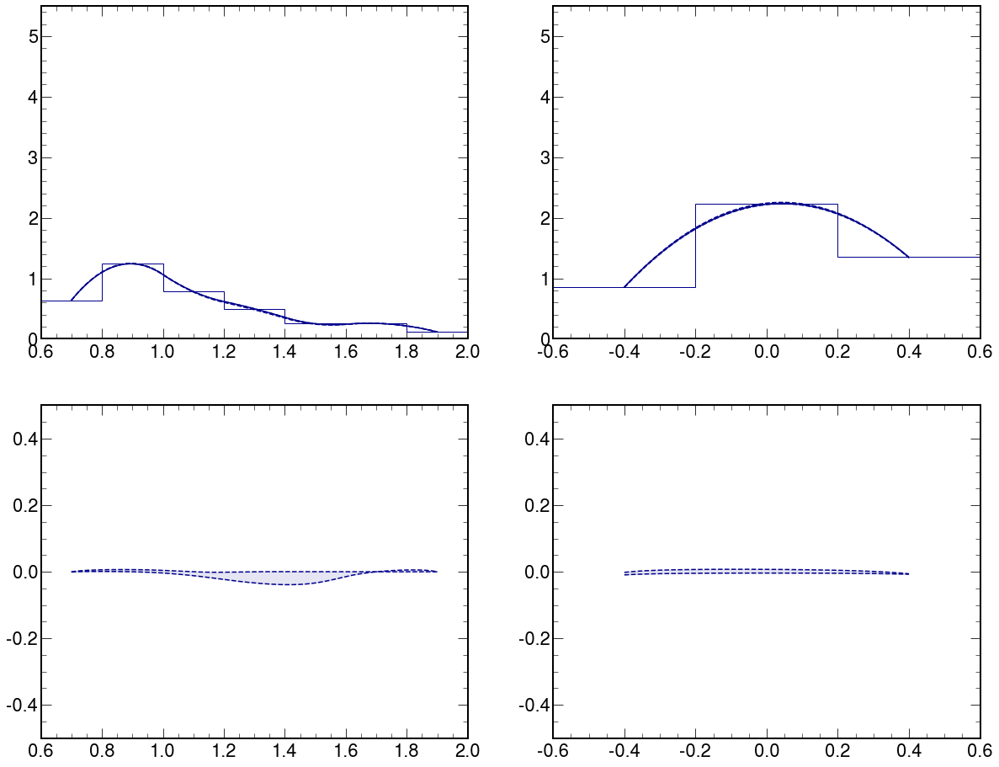

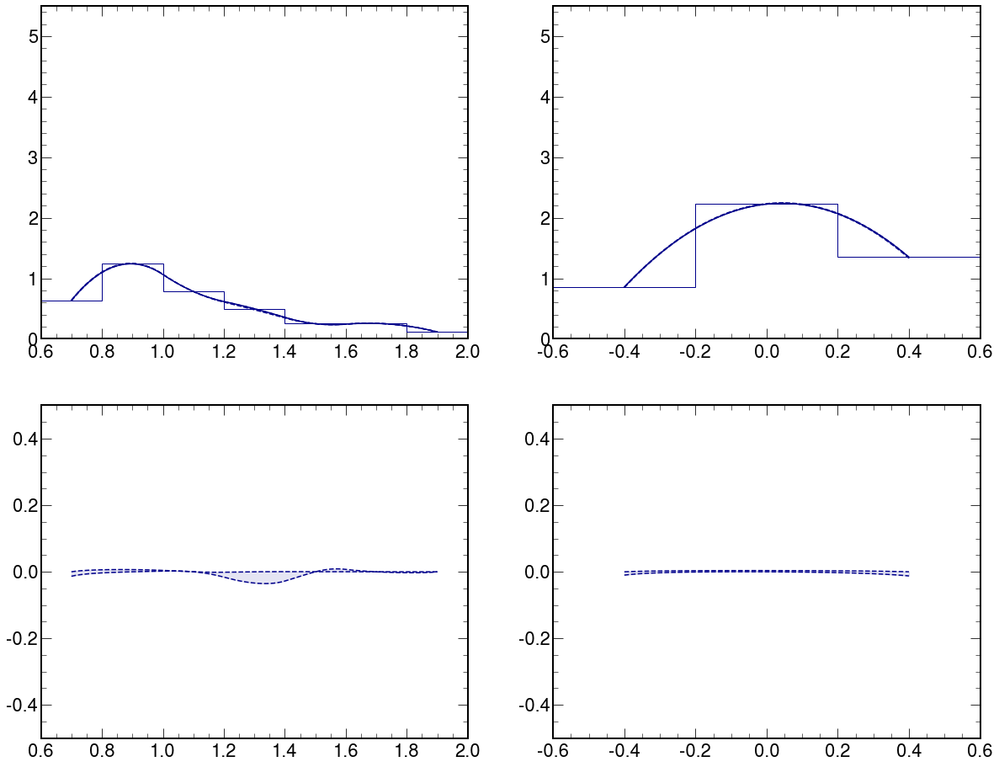

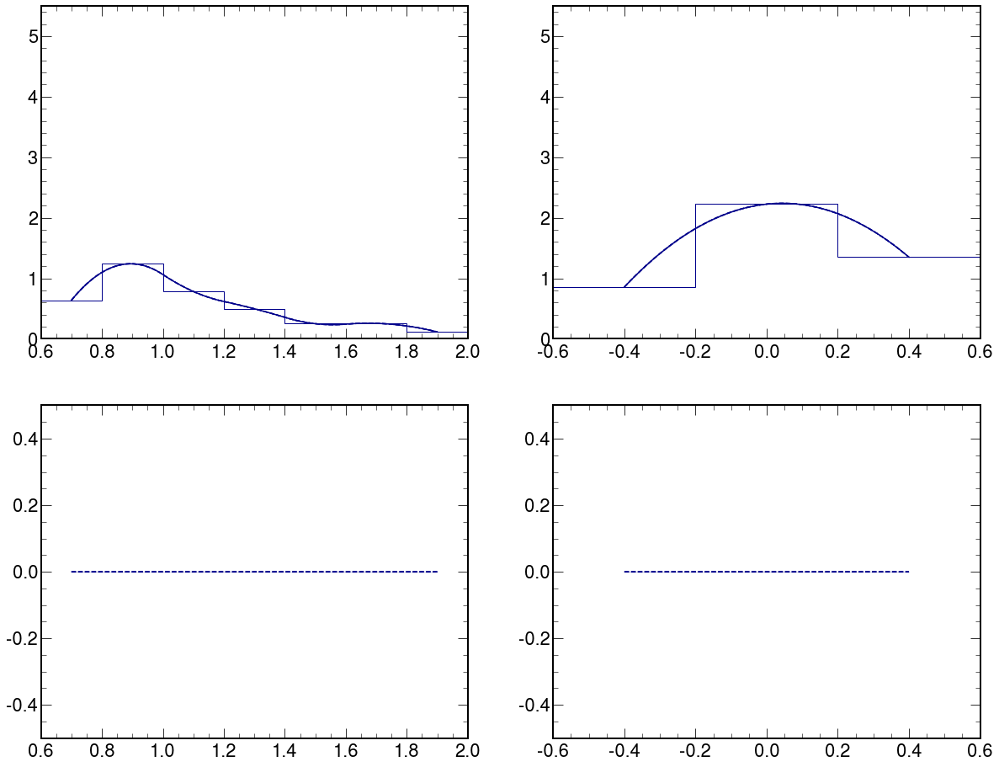

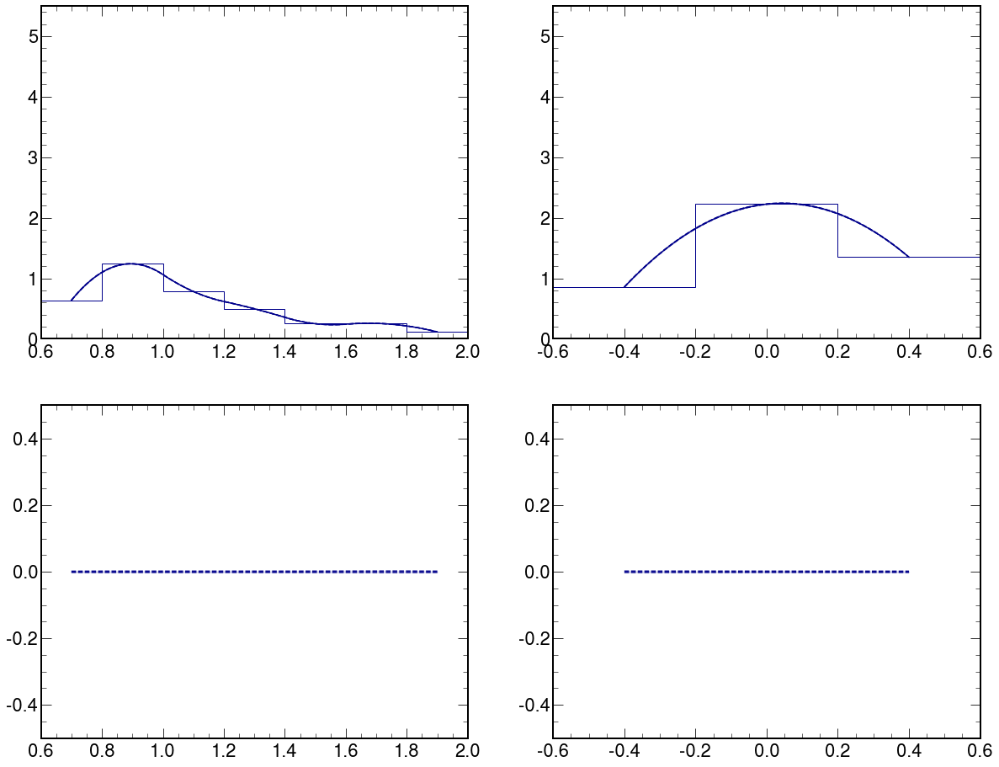

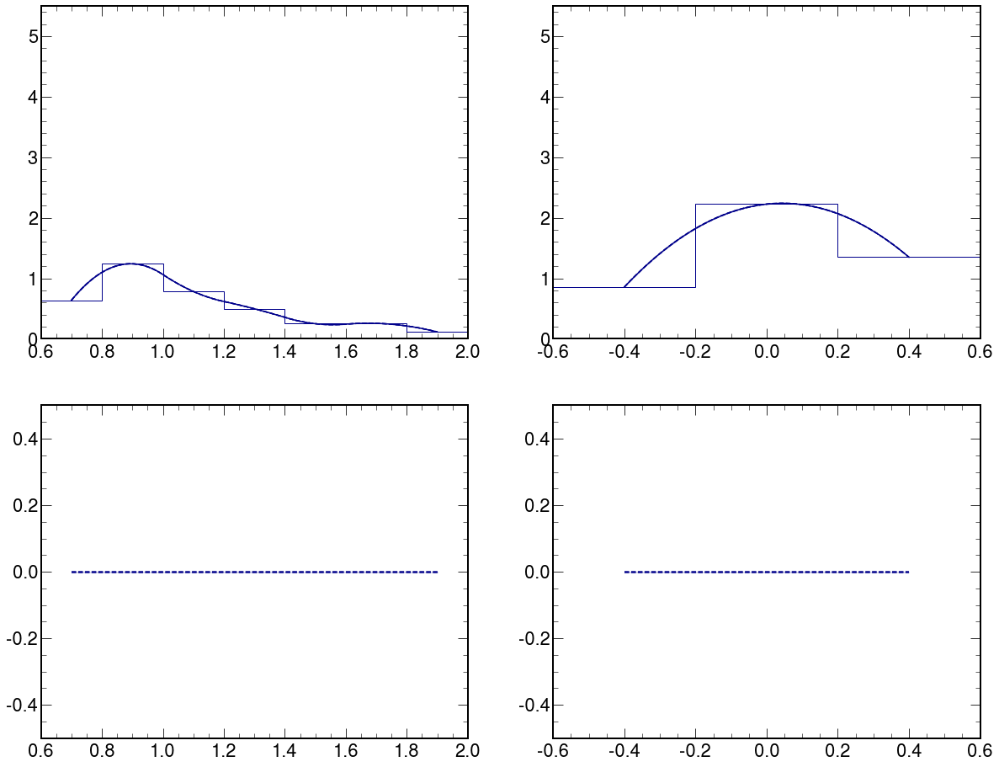

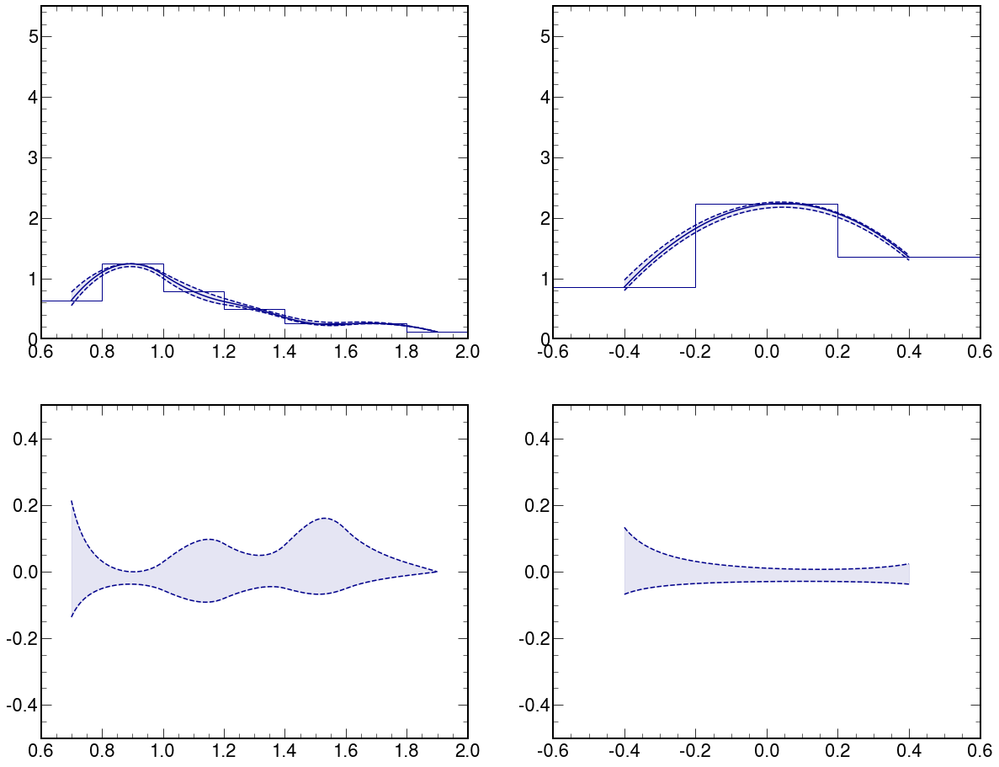

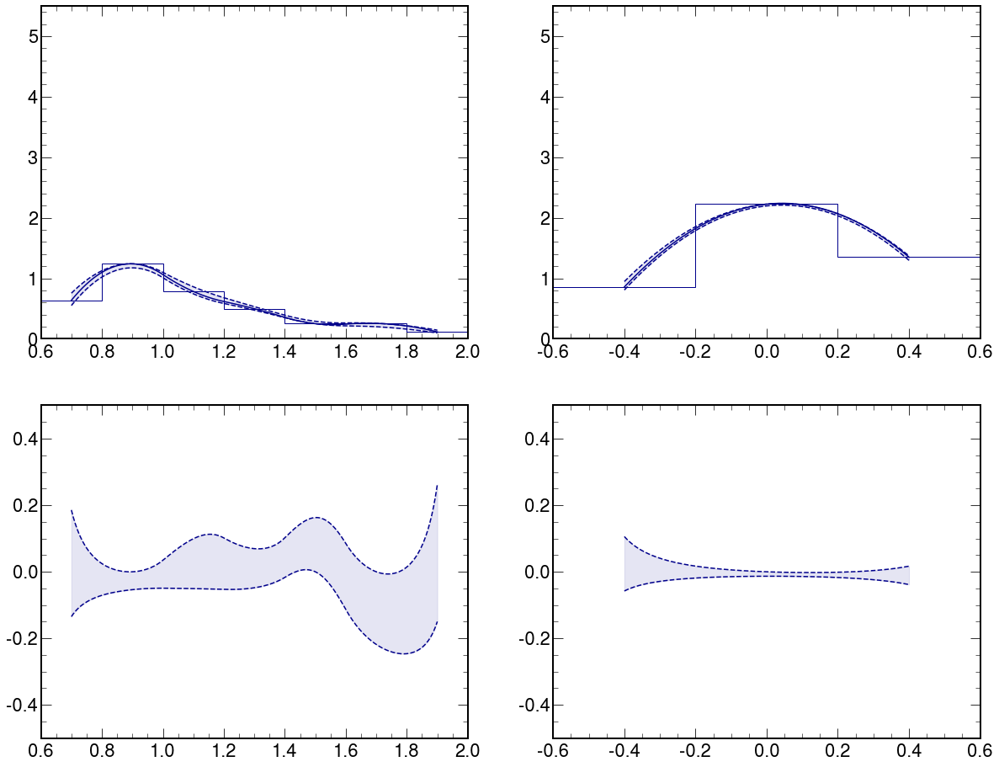

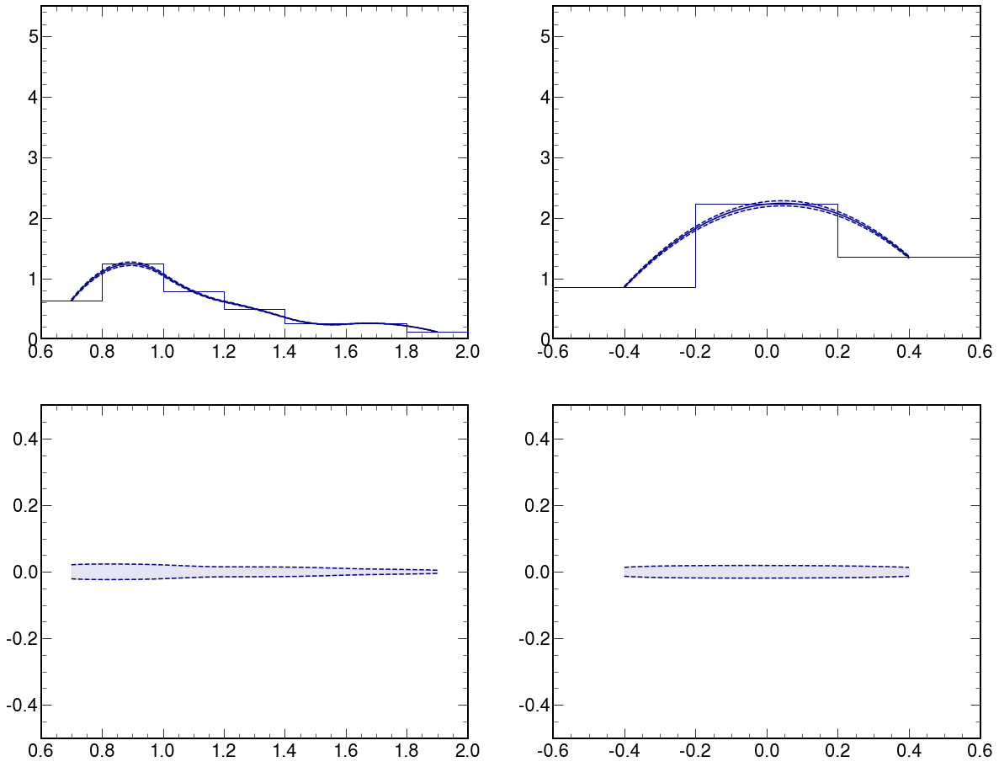

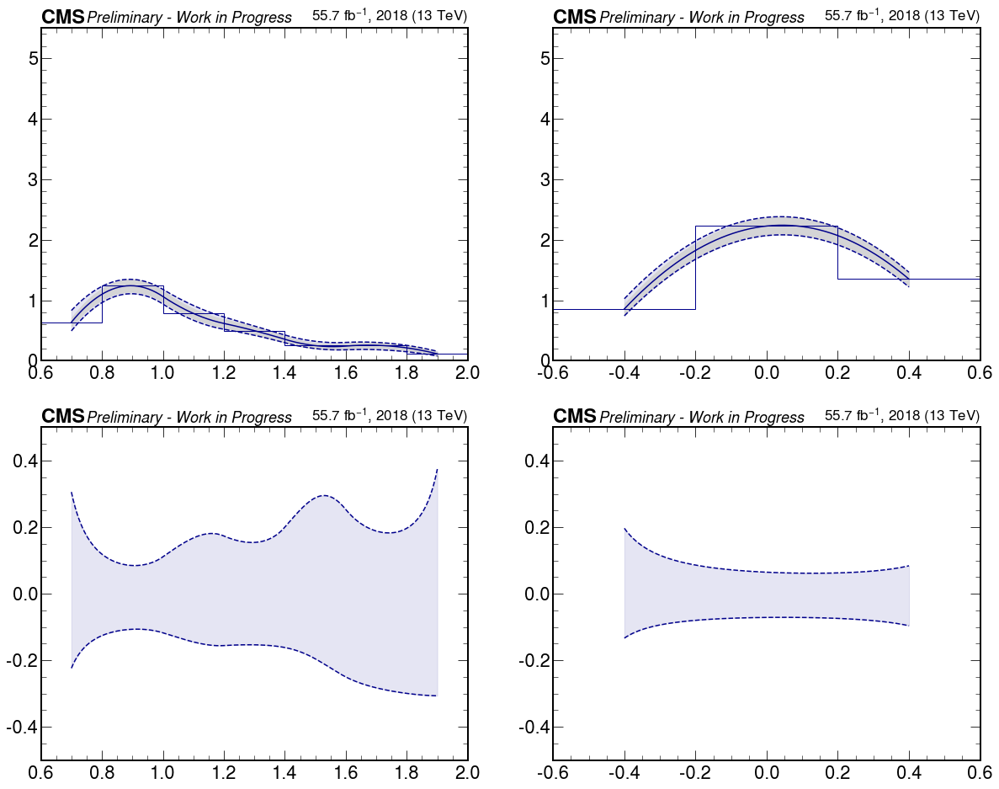

In [132]:
if data_sample == '2018':
    # ylim_ = (0.,0.3)
    ylim_ = (0.,5.5)
    ylim_ratio_ = (-0.50,0.50)
    color_ = "darkblue"

    counts = {}
    err = {}
    bins = {}
    max_variations_total = {}
    min_variations_total = {}

    label_ = ""
    coupling_str_ = "A0W1e-6"
    if lepton_type == 'muon':
        label_ = "GGToWW-AQGC-2018-muon-" + coupling_str_
    elif lepton_type == 'electron':
        label_ = "GGToWW-AQGC-2018-electron-" + coupling_str_

    counts[ label_ ], err[ label_ ], bins[ label_ ], max_variations_total[ label_ ], min_variations_total[ label_ ] = plot_total_systematic(
        df_dict=df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat,
        weights_dict=weights_sig_plus_mix_categories_concat,
        lepton_type=lepton_type,
        label=label_,
        ylim=ylim_,
        ylim_ratio=ylim_ratio_,
        color=color_
        )

GGToWW-AQGC-2018-muon-A0W1e-7
R_MWW_MX
_jes_up
_jes_up
nom
_jes_dw
_jes_dw
nom
[2.36849432 2.1962563  0.93631063 0.51526265 0.17440724 0.
 0.        ]
[2.36849432 2.18856592 0.9074717  0.51526265 0.17440724 0.
 0.        ]
0      0.0
1      0.0
2      0.0
3      0.0
4      0.0
      ... 
195   -0.0
196   -0.0
197   -0.0
198   -0.0
199    NaN
Length: 200, dtype: float64 0.0
0      0.000000
1      0.000067
2      0.000123
3      0.000169
4      0.000204
         ...   
195   -0.007748
196   -0.007748
197   -0.007748
198   -0.007748
199         NaN
Length: 200, dtype: float64 -0.007644581875500099
Diff_YWW_YX
_jes_up
_jes_up
nom
_jes_dw
_jes_dw
nom
[2.22411196 3.68212093 2.46445808]
[2.19527302 3.64001443 2.43004195]
0      1.313683e-02
1      1.282501e-02
2      1.252334e-02
3      1.223132e-02
4      1.194850e-02
           ...     
195   -4.559944e-05
196   -3.558769e-05
197   -2.467142e-05
198   -1.281977e-05
199    7.207900e-16
Length: 200, dtype: float64 0.0029048398583851015
0     

/tmp/ipykernel_612/923357951.py:131: RuntimeWarning: invalid value encountered in divide
  ratio_max_ = ( spline_max_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
/tmp/ipykernel_612/923357951.py:132: RuntimeWarning: invalid value encountered in divide
  ratio_min_ = ( spline_min_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
/tmp/ipykernel_612/923357951.py:131: RuntimeWarning: invalid value encountered in divide
  ratio_max_ = ( spline_max_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
/tmp/ipykernel_612/923357951.py:132: RuntimeWarning: invalid value encountered in divide
  ratio_min_ = ( spline_min_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
/tmp/ipykernel_612/923357951.py:131: RuntimeWarning: invalid value encountered in divide
  ratio_max_ = ( spline_max_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
/tmp/ipykernel_612/923357951.py:132: RuntimeWarning: invalid valu

GGToWW-AQGC-2018-muon-A0W1e-7
R_MWW_MX
_nom
_nom
sf_muon_trigger_up
_nom
_nom
sf_muon_trigger_dw
[2.37239617 2.20114069 0.93830869 0.51670433 0.17479547 0.
 0.        ]
[2.36459248 2.19137192 0.93431257 0.51382097 0.174019   0.
 0.        ]
0      0.001647
1      0.001680
2      0.001710
3      0.001740
4      0.001768
         ...   
195    0.001711
196    0.001711
197    0.001711
198    0.001711
199         NaN
Length: 200, dtype: float64 0.0021387306092029187
0     -0.001647
1     -0.001680
2     -0.001710
3     -0.001740
4     -0.001768
         ...   
195   -0.001711
196   -0.001711
197   -0.001711
198   -0.001711
199         NaN
Length: 200, dtype: float64 -0.002138730609207362
Diff_YWW_YX
_nom
_nom
sf_muon_trigger_up
_nom
_nom
sf_muon_trigger_dw
[2.19900599 3.68349306 2.4694857 ]
[2.19154006 3.66959442 2.45943046]
0      0.001700
1      0.001705
2      0.001709
3      0.001713
4      0.001717
         ...   
195    0.002029
196    0.002031
197    0.002034
198    0.002037
199    

/tmp/ipykernel_612/923357951.py:131: RuntimeWarning: invalid value encountered in divide
  ratio_max_ = ( spline_max_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
/tmp/ipykernel_612/923357951.py:132: RuntimeWarning: invalid value encountered in divide
  ratio_min_ = ( spline_min_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]


GGToWW-AQGC-2018-muon-A0W1e-7
R_MWW_MX
_nom
_nom
sf_prefiring_up
_nom
_nom
sf_prefiring_dw
[2.37099554 2.19857563 0.93729941 0.51580679 0.17459142 0.
 0.        ]
[2.36599311 2.19393698 0.93532186 0.51471851 0.17422306 0.
 0.        ]
0      0.001056
1      0.001056
2      0.001056
3      0.001056
4      0.001056
         ...   
195    0.001056
196    0.001056
197    0.001056
198    0.001056
199         NaN
Length: 200, dtype: float64 0.001056035462473353
0     -0.001056
1     -0.001056
2     -0.001056
3     -0.001056
4     -0.001056
         ...   
195   -0.001056
196   -0.001056
197   -0.001056
198   -0.001056
199         NaN
Length: 200, dtype: float64 -0.0010560354624836918
Diff_YWW_YX
_nom
_nom
sf_prefiring_up
_nom
_nom
sf_prefiring_dw
[2.19759131 3.6804263  2.46706063]
[2.19295474 3.67266118 2.46185552]
0      0.001056
1      0.001056
2      0.001056
3      0.001056
4      0.001056
         ...   
195    0.001056
196    0.001056
197    0.001056
198    0.001056
199    0.001056
Len

/tmp/ipykernel_612/923357951.py:131: RuntimeWarning: invalid value encountered in divide
  ratio_max_ = ( spline_max_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
/tmp/ipykernel_612/923357951.py:132: RuntimeWarning: invalid value encountered in divide
  ratio_min_ = ( spline_min_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
/tmp/ipykernel_612/923357951.py:131: RuntimeWarning: invalid value encountered in divide
  ratio_max_ = ( spline_max_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
/tmp/ipykernel_612/923357951.py:132: RuntimeWarning: invalid value encountered in divide
  ratio_min_ = ( spline_min_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
/tmp/ipykernel_612/923357951.py:131: RuntimeWarning: invalid value encountered in divide
  ratio_max_ = ( spline_max_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
/tmp/ipykernel_612/923357951.py:132: RuntimeWarning: invalid valu

GGToWW-AQGC-2018-muon-A0W1e-7
R_MWW_MX
_nom
_nom
proton_eff_up
_nom
_nom
proton_eff_dw
[2.39843958 2.22613046 0.94735769 0.5196914  0.17576909 0.
 0.        ]
[2.33854907 2.16638215 0.92526357 0.5108339  0.17304538 0.
 0.        ]
0      0.012643
1      0.012707
2      0.012768
3      0.012826
4      0.012881
         ...   
195    0.007674
196    0.007674
197    0.007674
198    0.007674
199         NaN
Length: 200, dtype: float64 0.009969846970122898
0     -0.012643
1     -0.012707
2     -0.012768
3     -0.012826
4     -0.012881
         ...   
195   -0.007674
196   -0.007674
197   -0.007674
198   -0.007674
199         NaN
Length: 200, dtype: float64 -0.009969846970138864
Diff_YWW_YX
_nom
_nom
proton_eff_up
_nom
_nom
proton_eff_dw
[2.22147972 3.71978169 2.48679766]
[2.16906633 3.63330578 2.4421185 ]
0      0.011938
1      0.011948
2      0.011957
3      0.011966
4      0.011975
         ...   
195    0.009322
196    0.009260
197    0.009197
198    0.009132
199    0.009065
Length: 200,

/tmp/ipykernel_612/923357951.py:131: RuntimeWarning: invalid value encountered in divide
  ratio_max_ = ( spline_max_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
/tmp/ipykernel_612/923357951.py:132: RuntimeWarning: invalid value encountered in divide
  ratio_min_ = ( spline_min_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
/tmp/ipykernel_612/4012396432.py:322: RuntimeWarning: invalid value encountered in divide
  ratio_max_ = ( spline_max_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
/tmp/ipykernel_612/4012396432.py:323: RuntimeWarning: invalid value encountered in divide
  ratio_min_ = ( spline_min_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]


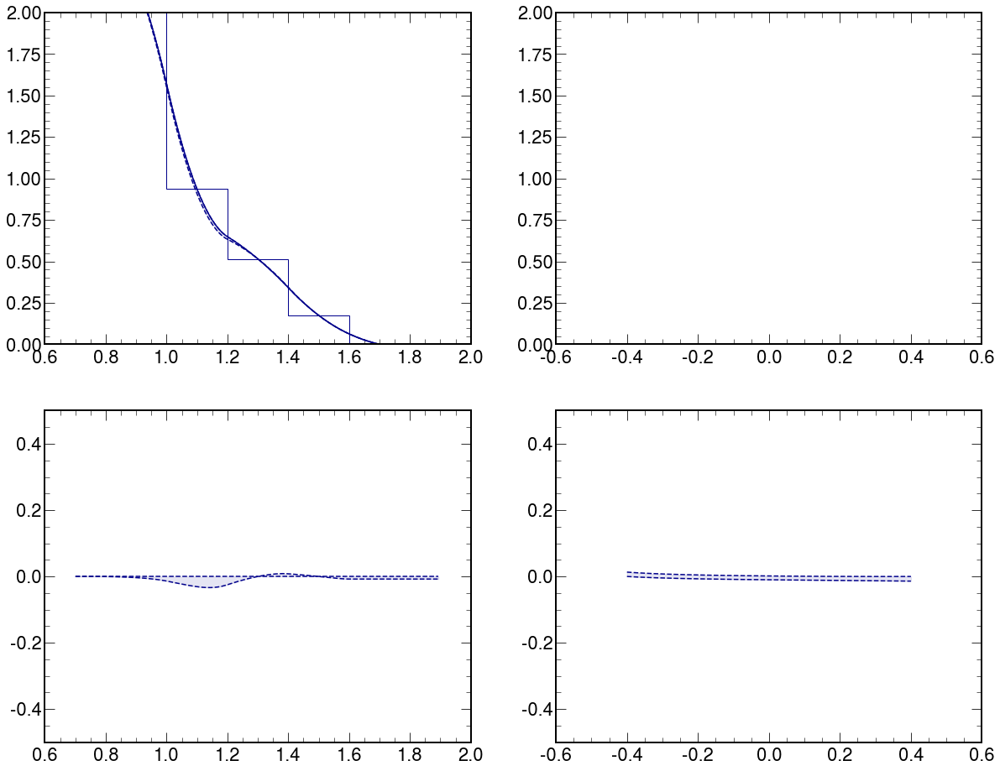

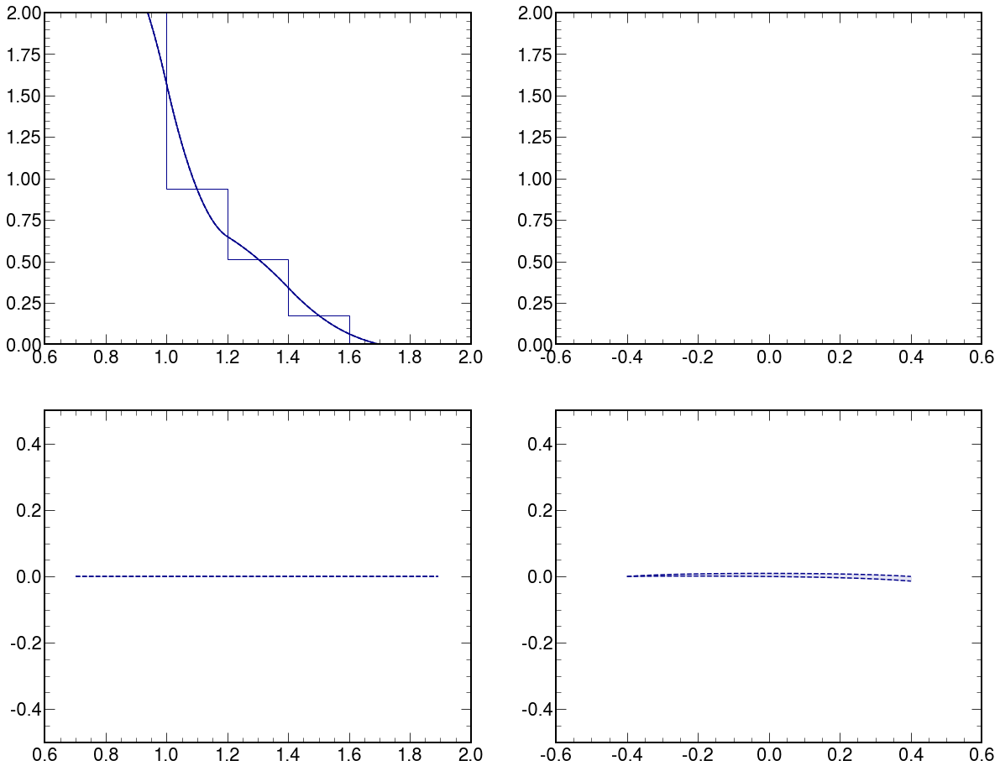

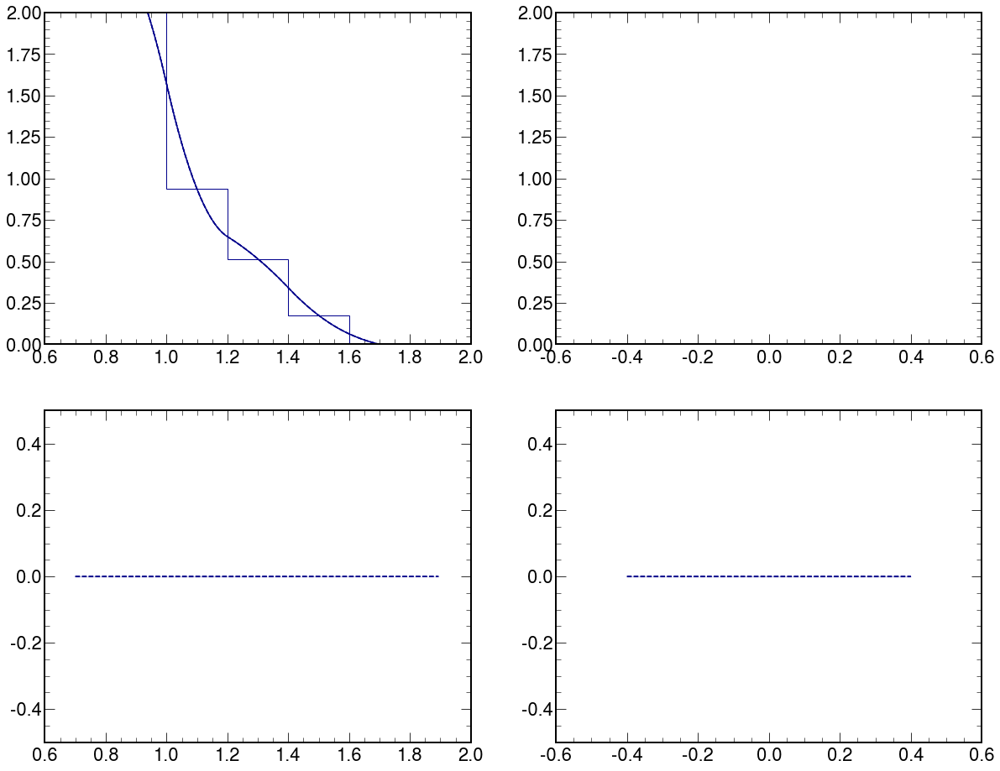

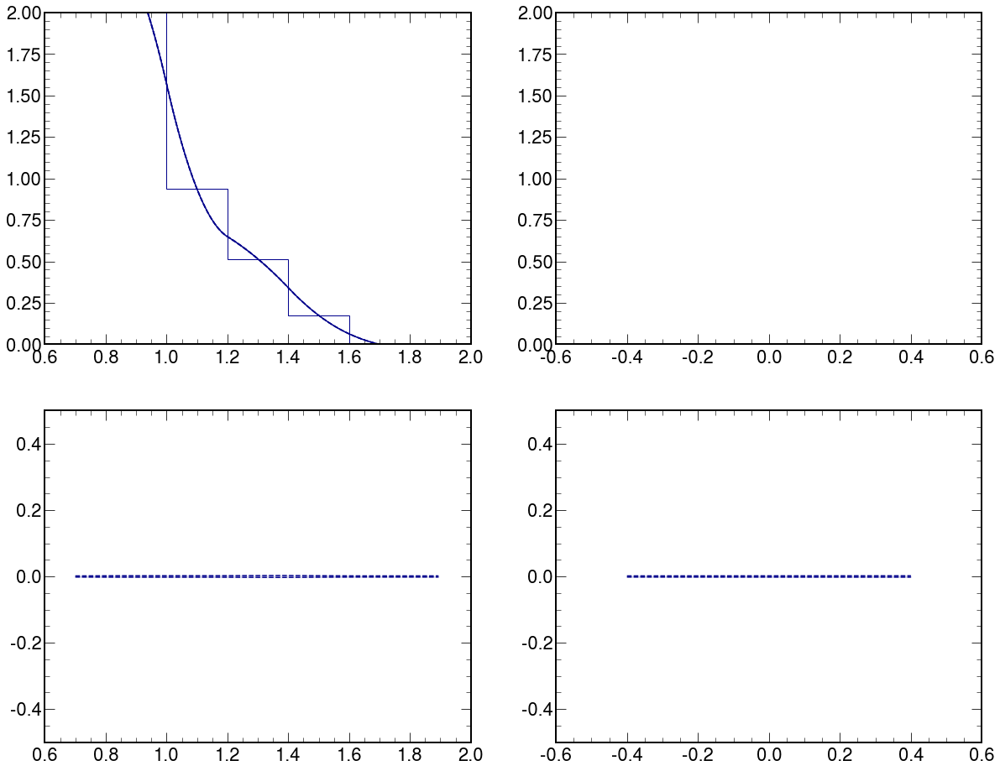

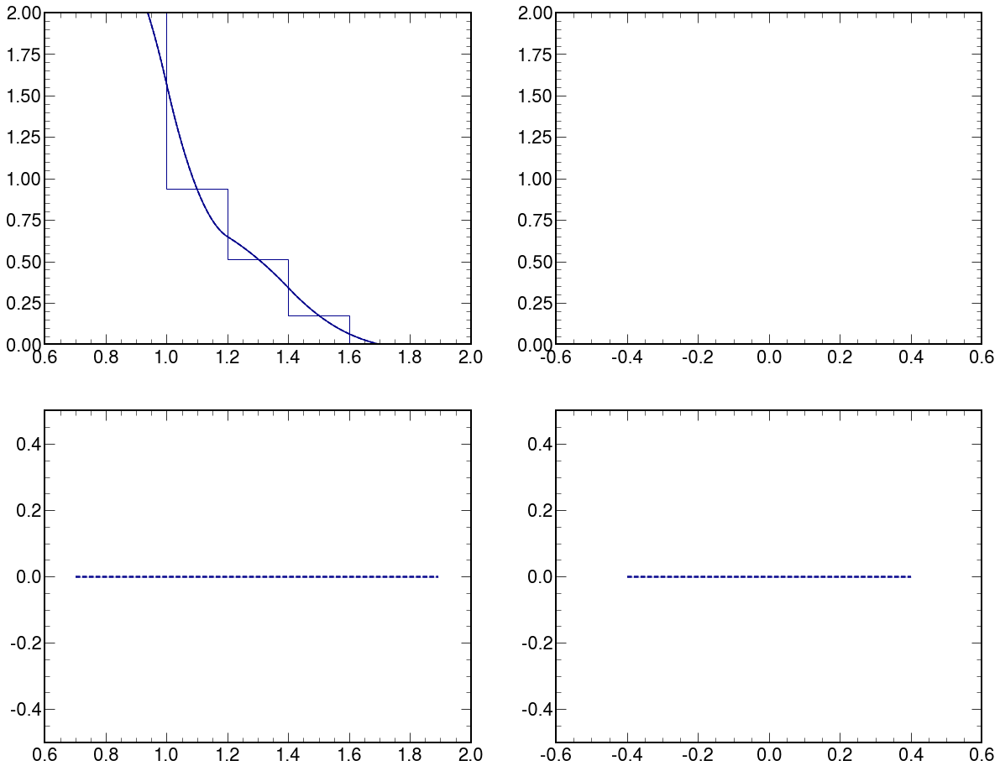

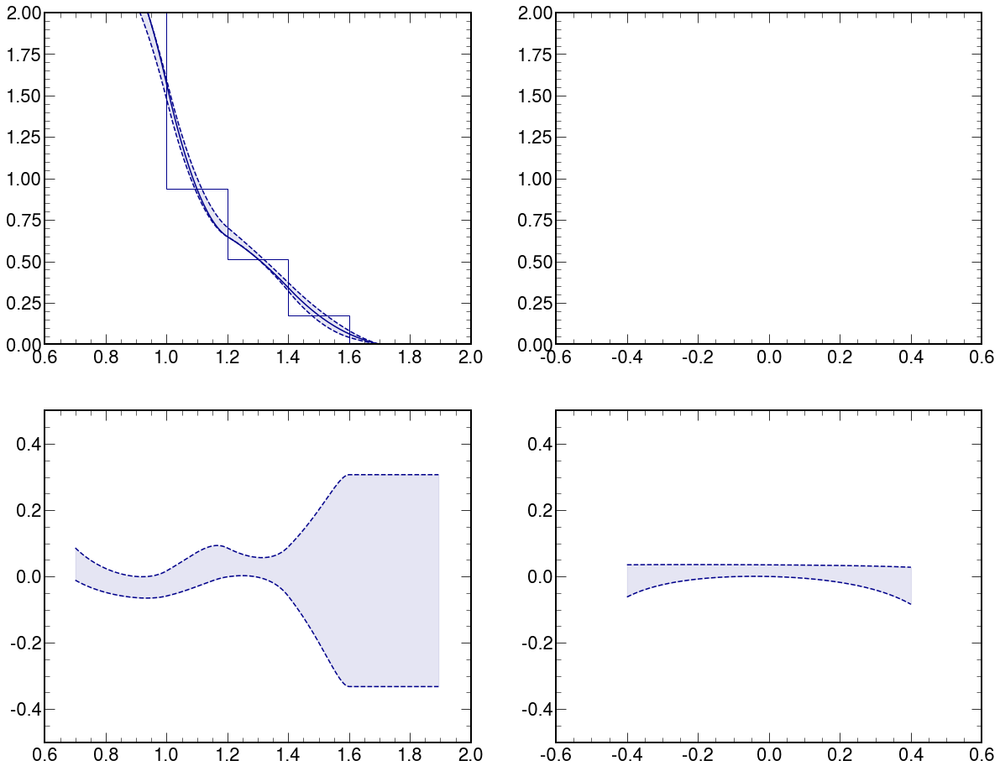

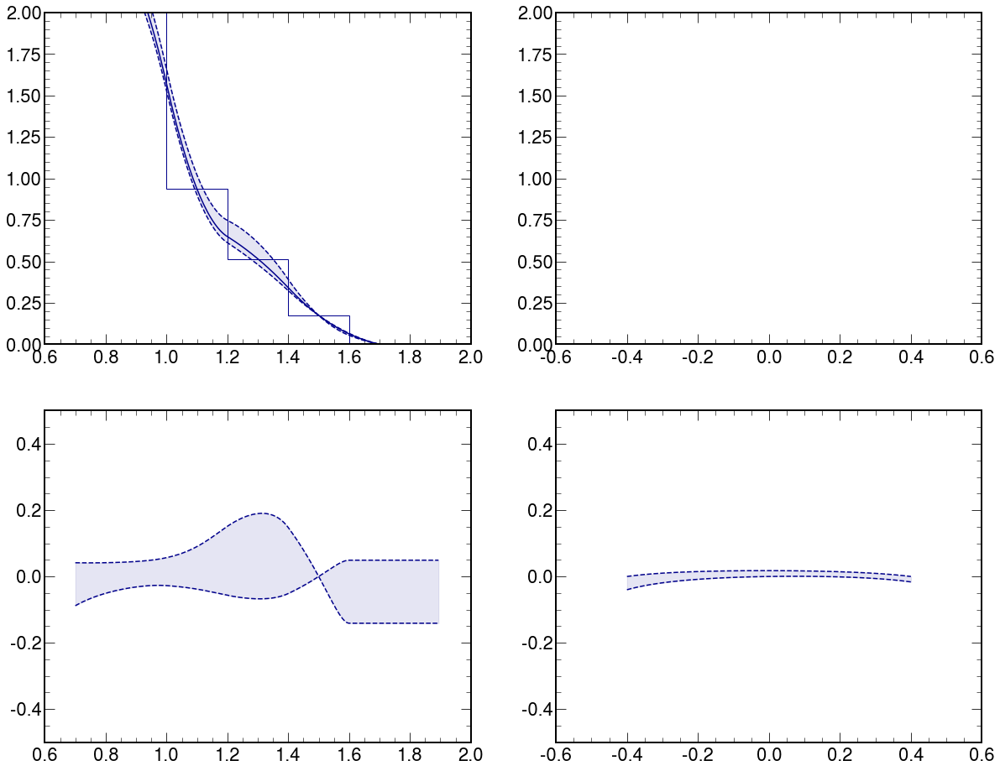

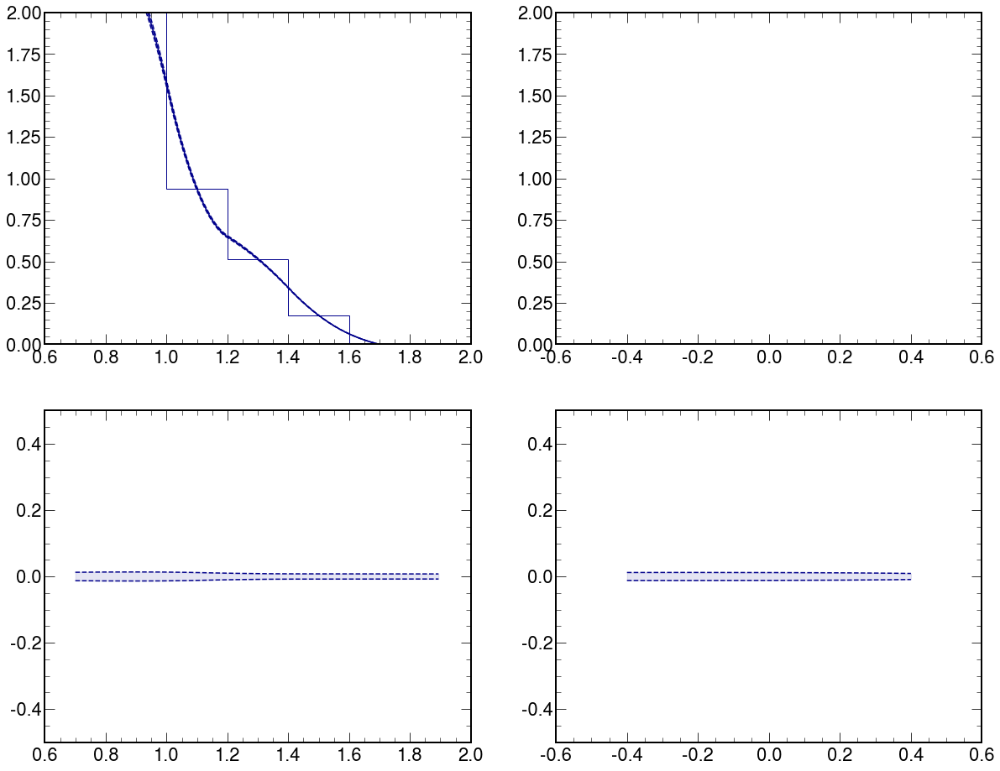

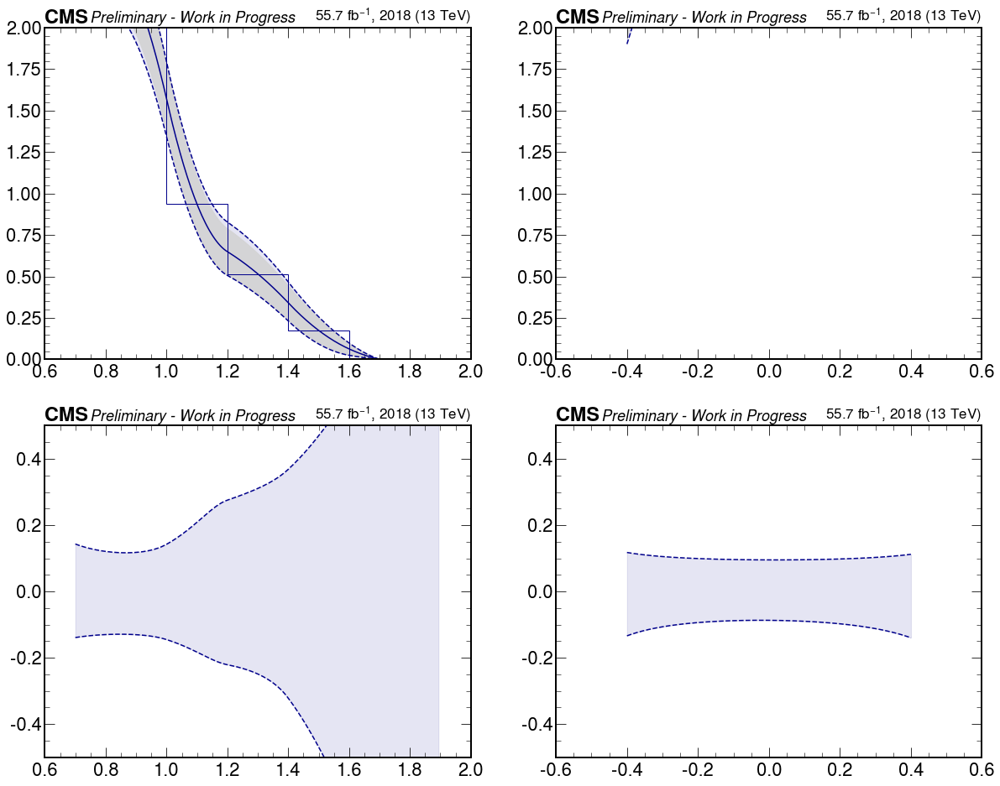

In [133]:
# ylim_ = (0.,0.3)
ylim_ = (0.,2.)
ylim_ratio_ = (-0.50,0.50)
color_ = "darkblue"

label_ = ""
coupling_str_ = "A0W1e-7"
if data_sample == '2017':
    if lepton_type == 'muon':
#         label_ = "GGToWW-AQGC-A0W1e-6"
#         label_ = "GGToWW-AQGC-muon-A0W1e-6"
        label_ = "GGToWW-AQGC-2017-muon-" + coupling_str_
    elif lepton_type == 'electron':
#         label_ = "GGToWW-AQGC-electron-A0W1e-6"
        label_ = "GGToWW-AQGC-2017-electron-" + coupling_str_
if data_sample == '2018':
    if lepton_type == 'muon':
        label_ = "GGToWW-AQGC-2018-muon-" + coupling_str_
    elif lepton_type == 'electron':
        label_ = "GGToWW-AQGC-2018-electron-" + coupling_str_
    
counts[ label_ ], err[ label_ ], bins[ label_ ], max_variations_total[ label_ ], min_variations_total[ label_ ] = plot_total_systematic(
#     df_dict=df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat,
#     weights_dict=weights_sig_plus_mix_categories_concat,
    df_dict=df_signals_protons_multiRP_sig_plus_mix_All_selected_events,
    weights_dict=weights_sig_plus_mix_All,
    lepton_type=lepton_type,
    label=label_,
    ylim=ylim_,
    ylim_ratio=ylim_ratio_,
    color=color_
    )
    
if save_figures:
    if lepton_type == 'muon':
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-A0W1e-7-Muon_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-A0W1e-7-Muon_2018.png", bbox_inches='tight' )
    if lepton_type == 'electron':
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-A0W1e-7-Electron_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-A0W1e-7-Electron_2018.png", bbox_inches='tight' )

GGToWW-AQGC-2018-muon-A0W2e-7
R_MWW_MX
_jes_up
_jes_up
nom
_jes_dw
_jes_dw
nom
[2.06742726 1.96499446 1.04154084 0.69994647 0.49538402 0.10257292
 0.07617514]
[2.06684942 1.96499446 1.04154084 0.67362755 0.46034177 0.10257292
 0.07617514]
0      0.003688
1      0.003543
2      0.003402
3      0.003265
4      0.003132
         ...   
195    0.007101
196    0.005055
197    0.003196
198    0.001515
199    0.000000
Length: 200, dtype: float64 0.008842763474611472
0      0.003407
1      0.003238
2      0.003075
3      0.002917
4      0.002766
         ...   
195    0.055157
196    0.039268
197    0.024824
198    0.011764
199    0.000000
Length: 200, dtype: float64 0.005269978646086157
Diff_YWW_YX
_jes_up
_jes_up
nom
_jes_dw
_jes_dw
nom
[2.38839024 3.37126386 3.25917934]
[2.3346253  3.33779248 3.11329459]
0      1.114230e-02
1      1.124672e-02
2      1.134802e-02
3      1.144629e-02
4      1.154158e-02
           ...     
195    8.172337e-04
196    6.164966e-04
197    4.134000e-04
198    2.

0      0.112160
1      0.111975
2      0.111793
3      0.111614
4      0.111438
         ...   
195    0.097109
196    0.097064
197    0.097018
198    0.096973
199    0.096927
Length: 200, dtype: float64 0.10266645006446039
0     -0.127334
1     -0.126349
2     -0.125385
3     -0.124442
4     -0.123520
         ...   
195   -0.118556
196   -0.119173
197   -0.119798
198   -0.120433
199   -0.121076
Length: 200, dtype: float64 -0.10108791975199204


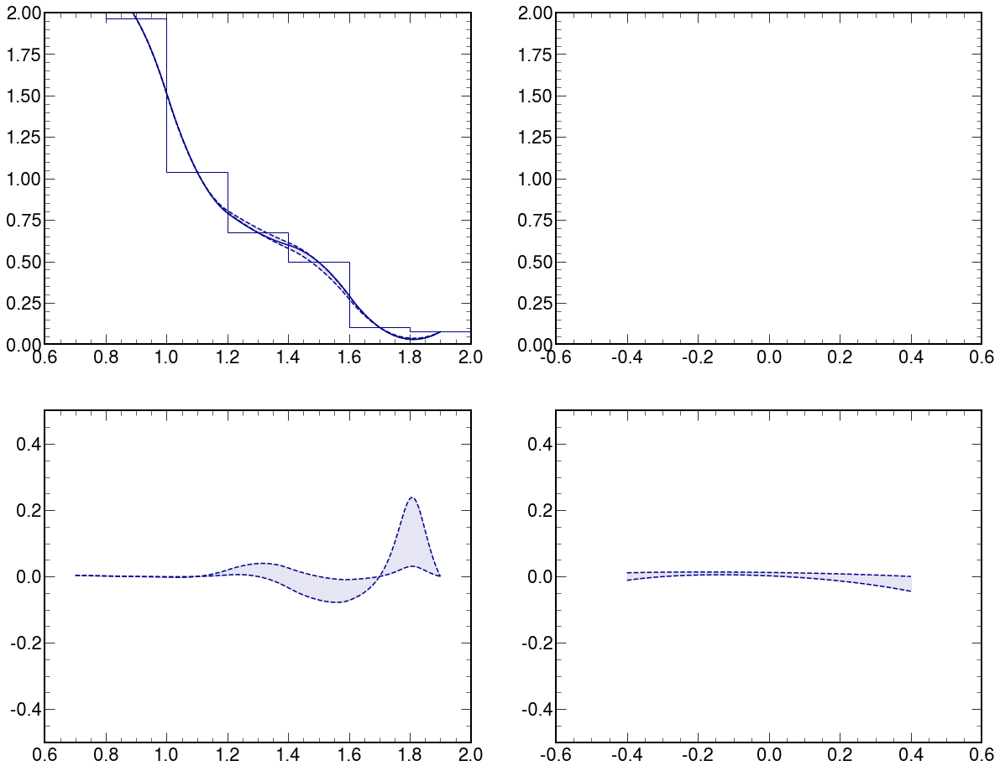

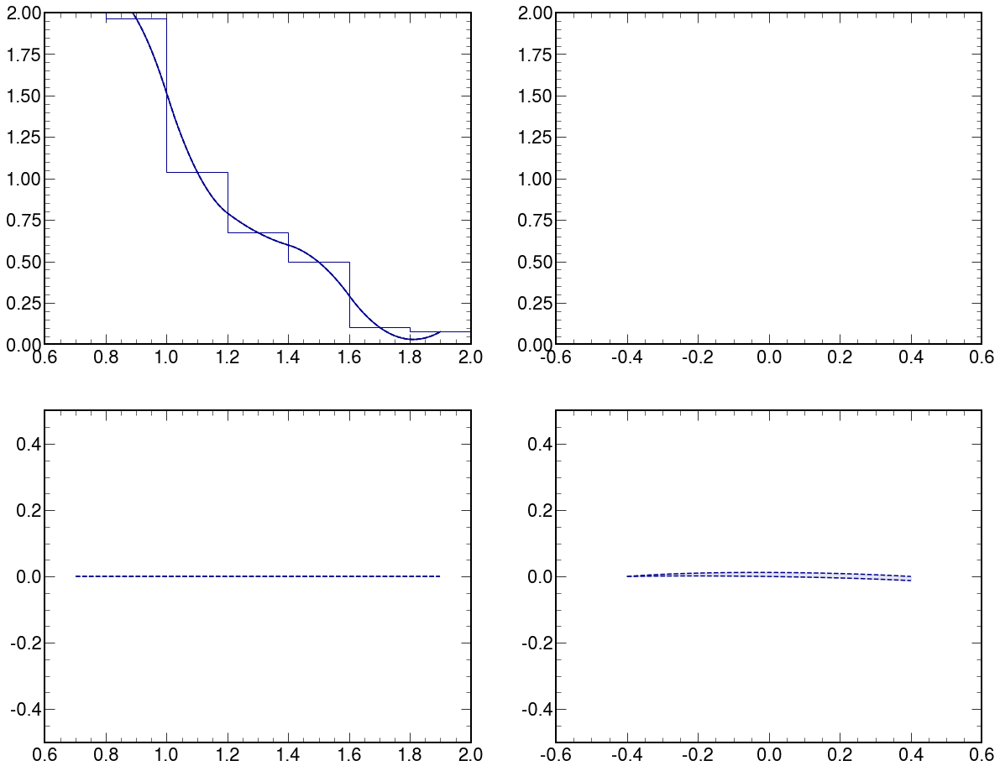

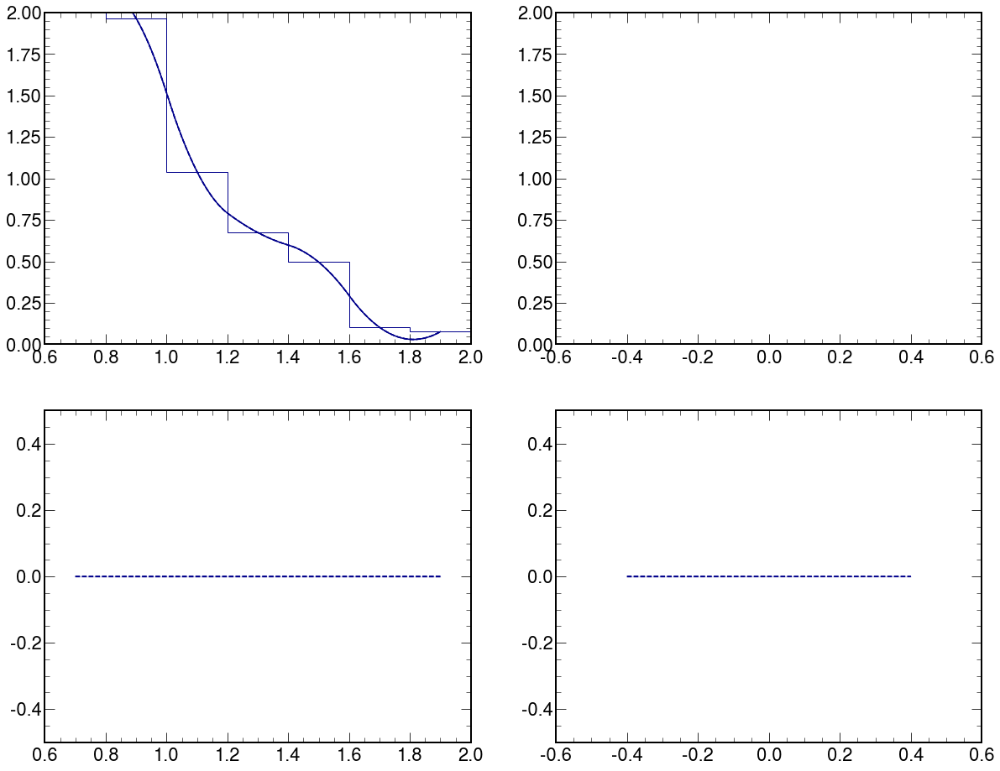

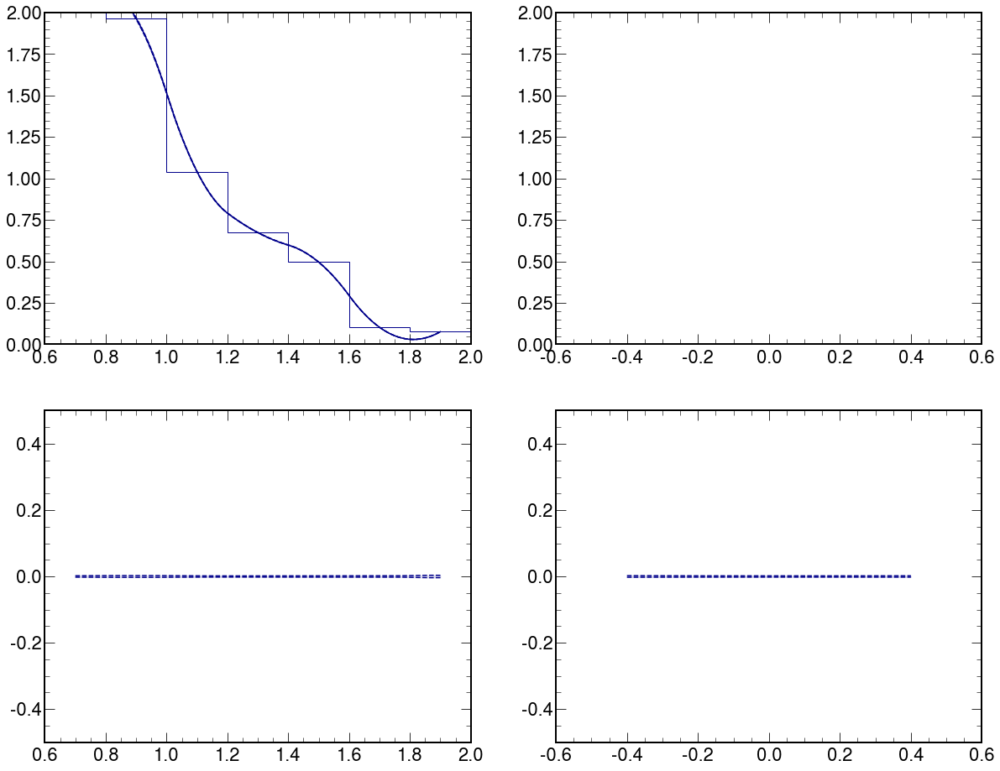

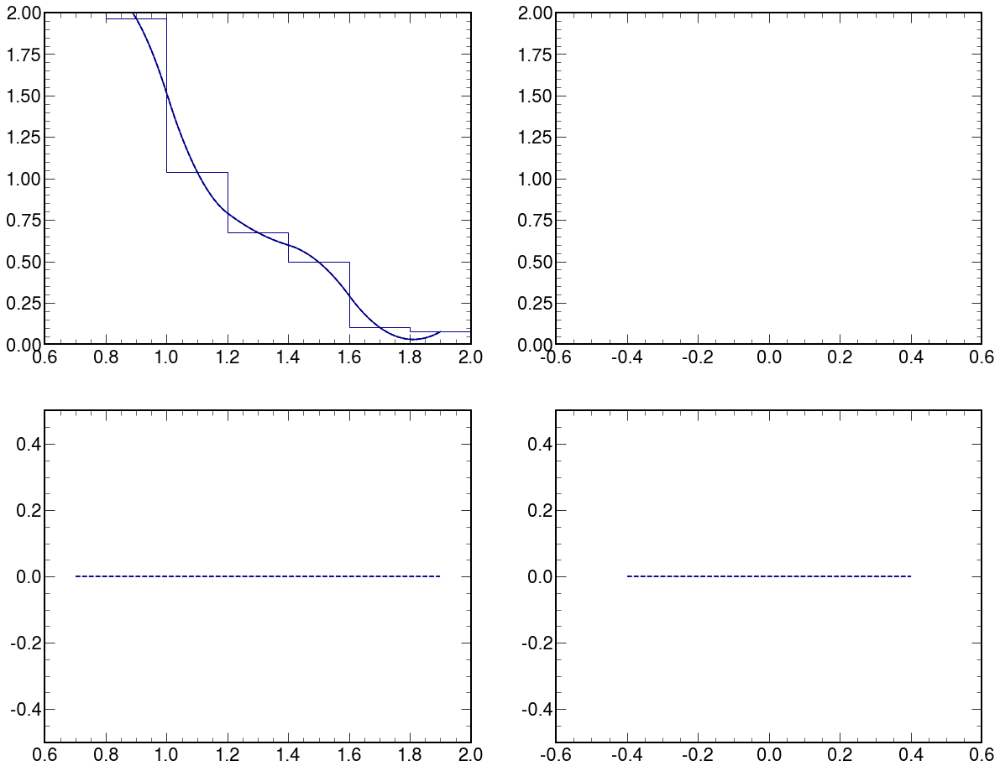

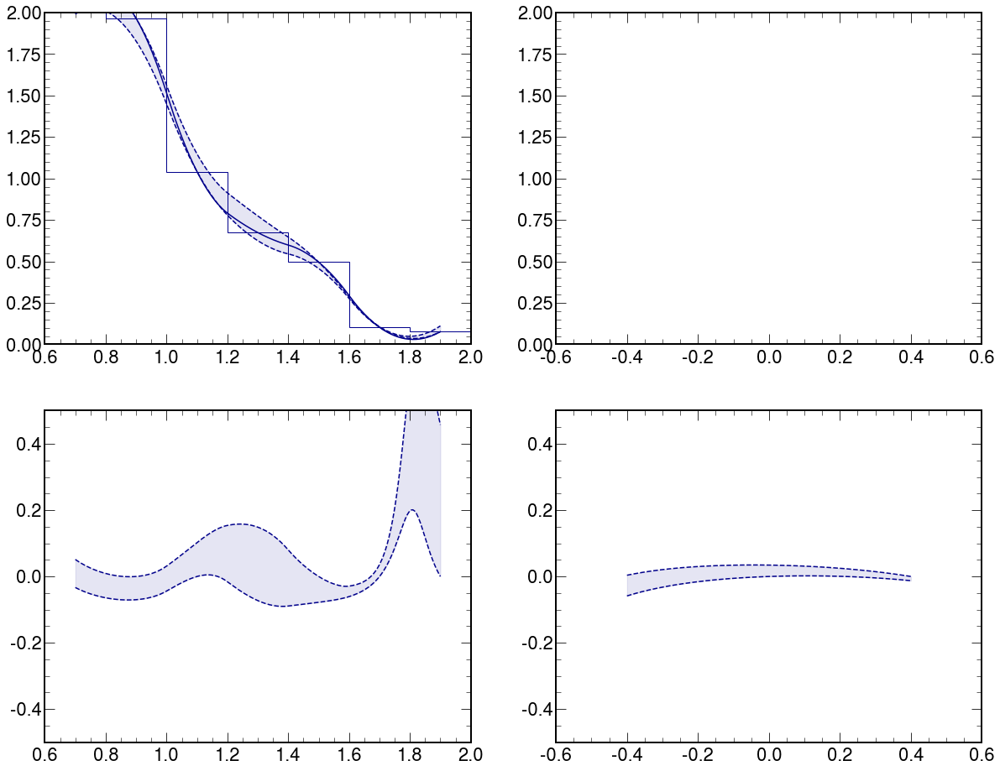

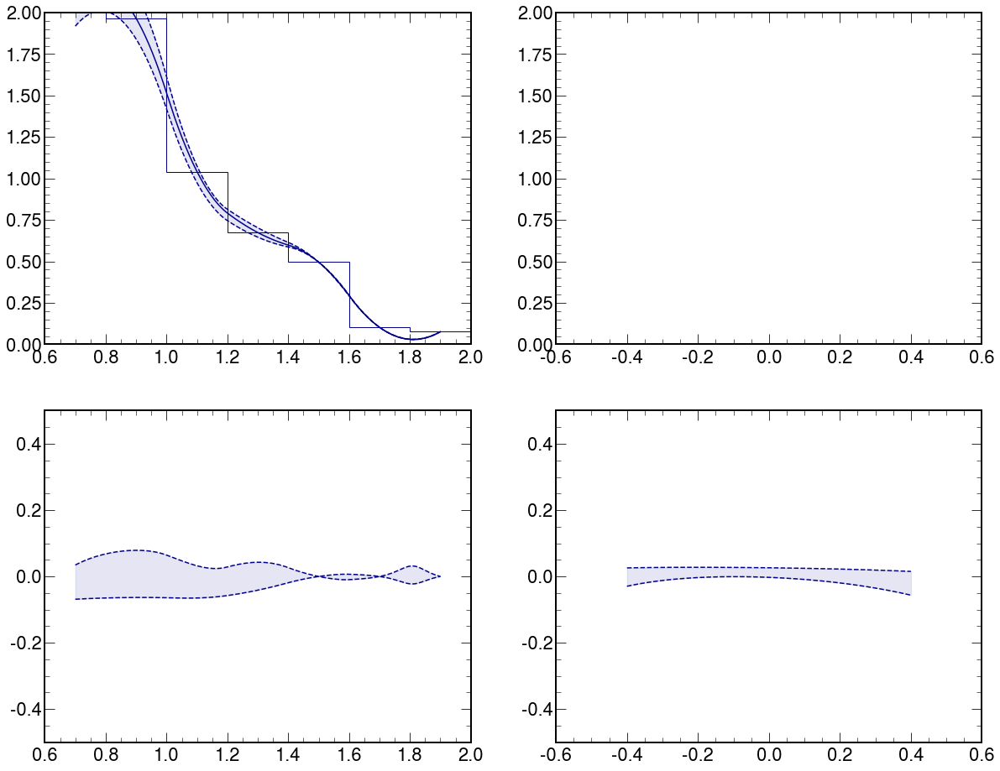

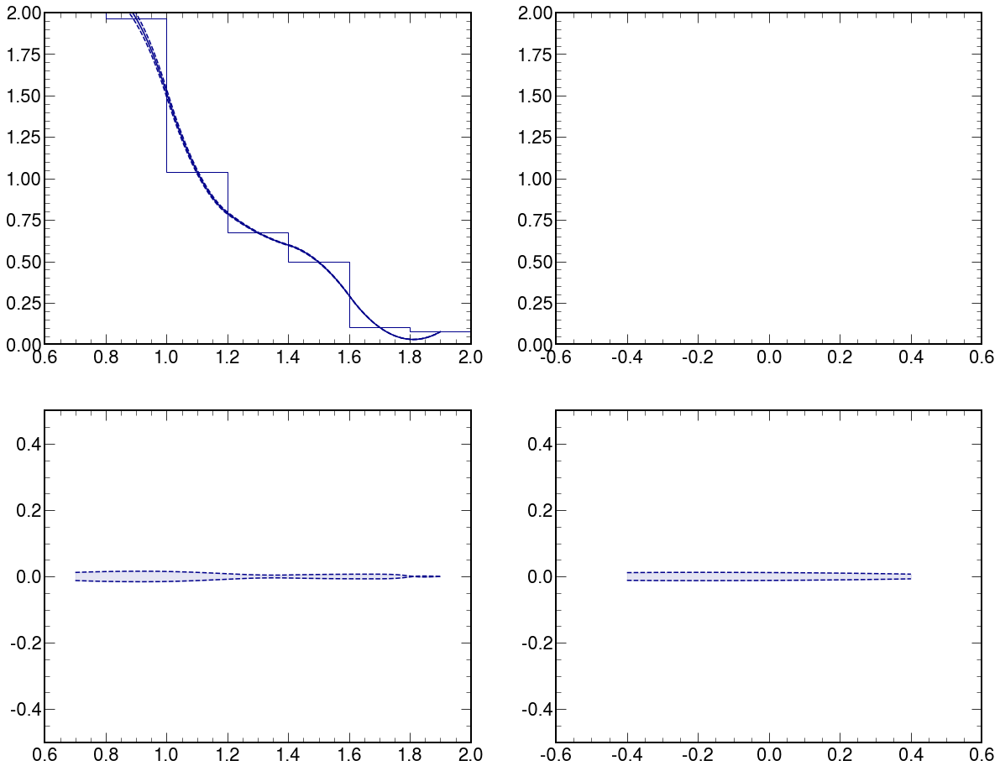

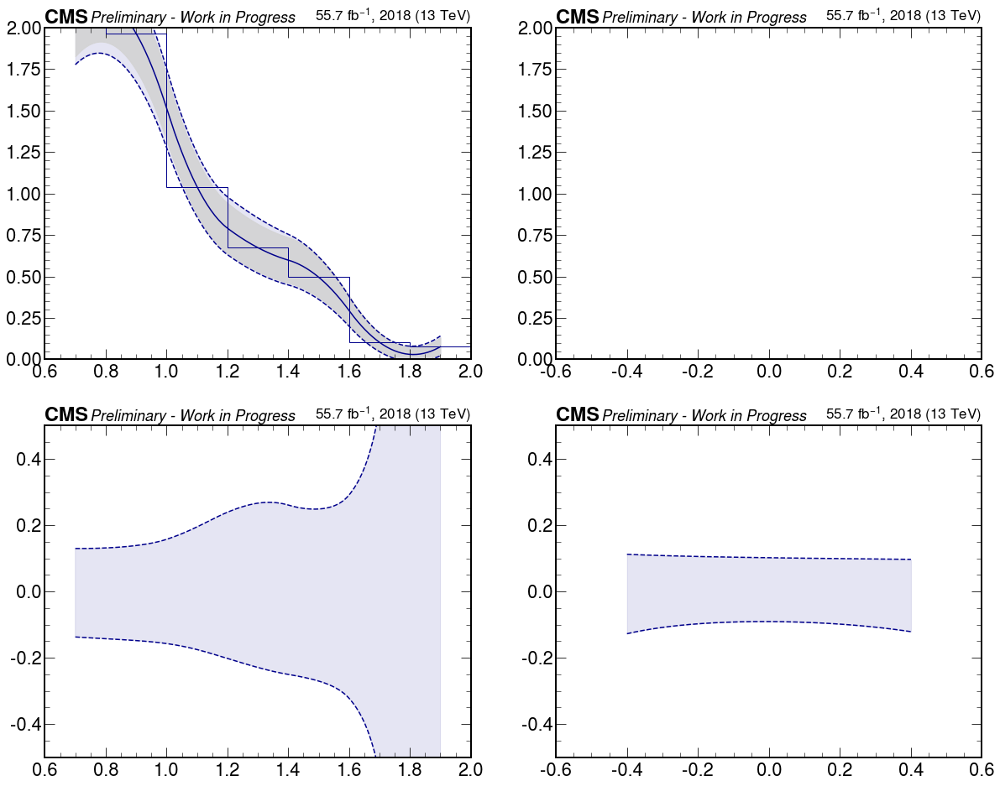

In [134]:
# ylim_ = (0.,0.3)
ylim_ = (0.,2.)
ylim_ratio_ = (-0.50,0.50)
color_ = "darkblue"

label_ = ""
coupling_str_ = "A0W2e-7"
if data_sample == '2017':
    if lepton_type == 'muon':
#         label_ = "GGToWW-AQGC-A0W1e-6"
#         label_ = "GGToWW-AQGC-muon-A0W1e-6"
        label_ = "GGToWW-AQGC-2017-muon-" + coupling_str_
    elif lepton_type == 'electron':
#         label_ = "GGToWW-AQGC-electron-A0W1e-6"
        label_ = "GGToWW-AQGC-2017-electron-" + coupling_str_
if data_sample == '2018':
    if lepton_type == 'muon':
        label_ = "GGToWW-AQGC-2018-muon-" + coupling_str_
    elif lepton_type == 'electron':
        label_ = "GGToWW-AQGC-2018-electron-" + coupling_str_
    
counts[ label_ ], err[ label_ ], bins[ label_ ], max_variations_total[ label_ ], min_variations_total[ label_ ] = plot_total_systematic(
#     df_dict=df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat,
#     weights_dict=weights_sig_plus_mix_categories_concat,
    df_dict=df_signals_protons_multiRP_sig_plus_mix_All_selected_events,
    weights_dict=weights_sig_plus_mix_All,
    lepton_type=lepton_type,
    label=label_,
    ylim=ylim_,
    ylim_ratio=ylim_ratio_,
    color=color_
    )
    
if save_figures:
    if lepton_type == 'muon':
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-A0W2e-7-Muon_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-A0W2e-7-Muon_2018.png", bbox_inches='tight' )
    if lepton_type == 'electron':
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-A0W2e-7-Electron_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-A0W2e-7-Electron_2018.png", bbox_inches='tight' )

GGToWW-AQGC-2018-muon-A0W5e-7
R_MWW_MX
_jes_up
_jes_up
nom
_jes_dw
_jes_dw
nom
[2.77657629 2.68402669 2.69664012 1.50830524 1.43899736 0.89293753
 0.91374302]
[2.74354123 2.58114123 2.69664012 1.44431227 1.43899736 0.89293753
 0.91374302]
0     -0.002724
1     -0.000067
2      0.002530
3      0.005062
4      0.007527
         ...   
195    0.000517
196    0.000396
197    0.000269
198    0.000137
199    0.000000
Length: 200, dtype: float64 0.010562735695067861
0     -0.014589
1     -0.014033
2     -0.013480
3     -0.012930
4     -0.012384
         ...   
195   -0.000608
196   -0.000466
197   -0.000317
198   -0.000161
199    0.000000
Length: 200, dtype: float64 -0.00492601179489751
Diff_YWW_YX
_jes_up
_jes_up
nom
_jes_dw
_jes_dw
nom
[3.45542376 7.8160603  4.85386958]
[3.39417999 7.65503404 4.74822966]
0      0.001324
1      0.001648
2      0.001955
3      0.002247
4      0.002525
         ...   
195    0.013379
196    0.013427
197    0.013476
198    0.013526
199    0.013578
Length: 200, 

GGToWW-AQGC-2018-muon-A0W5e-7
R_MWW_MX
[2.78416029 2.58114123 2.69664012 1.48049723 1.43899736 0.89293753
 0.91374302]
[3.05895758 2.83930953 2.97880465 1.69089058 1.64768313 1.06183196
 1.08682891]
[2.509363   2.32297293 2.41447559 1.27010387 1.23031159 0.72404309
 0.74065713]
[3.06950051 2.88201414 2.98389255 1.72159425 1.66712999 1.11411698
 1.09092755]
[2.45282679 2.32018931 2.39556505 1.19174622 1.20547203 0.72402936
 0.74064634]
0      0.102487
1      0.103394
2      0.104279
3      0.105141
4      0.105980
         ...   
195    0.212873
196    0.208278
197    0.203575
198    0.198781
199    0.193911
Length: 200, dtype: float64 0.15908281954891562
0     -0.119007
1     -0.118201
2     -0.117406
3     -0.116621
4     -0.115847
         ...   
195   -0.193851
196   -0.192821
197   -0.191740
198   -0.190610
199   -0.189437
Length: 200, dtype: float64 -0.15200387212746638
Diff_YWW_YX
[3.45085436 7.73409131 4.78884872]
[3.76697038 8.21081911 5.16181003]
[3.13473835 7.2573635  4.41588

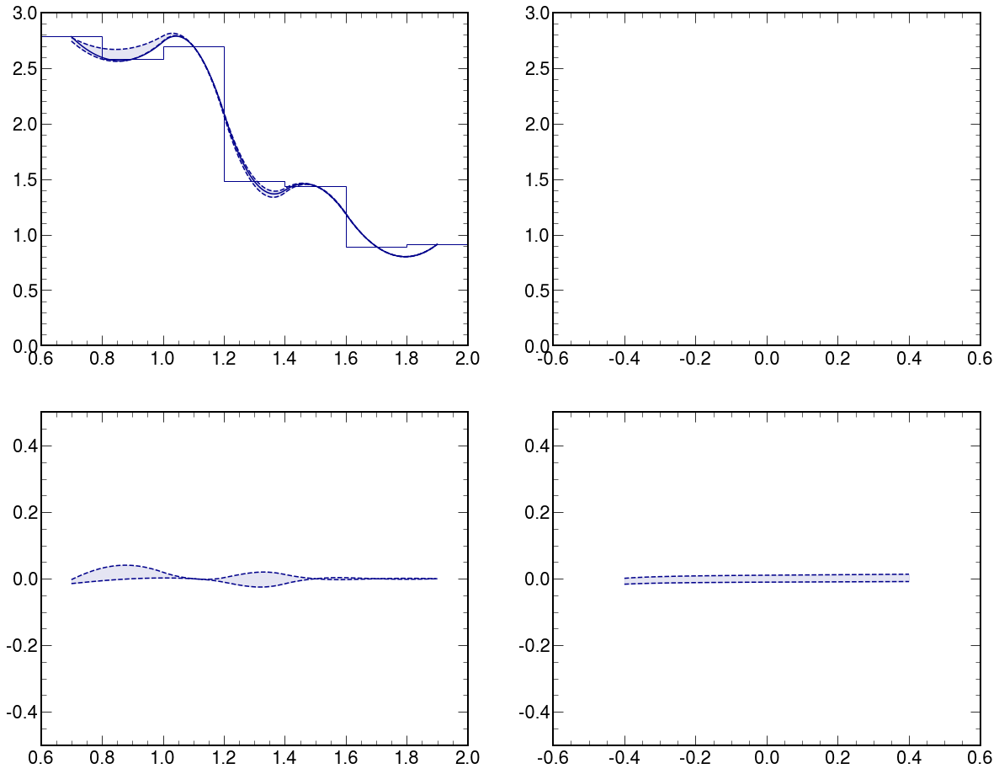

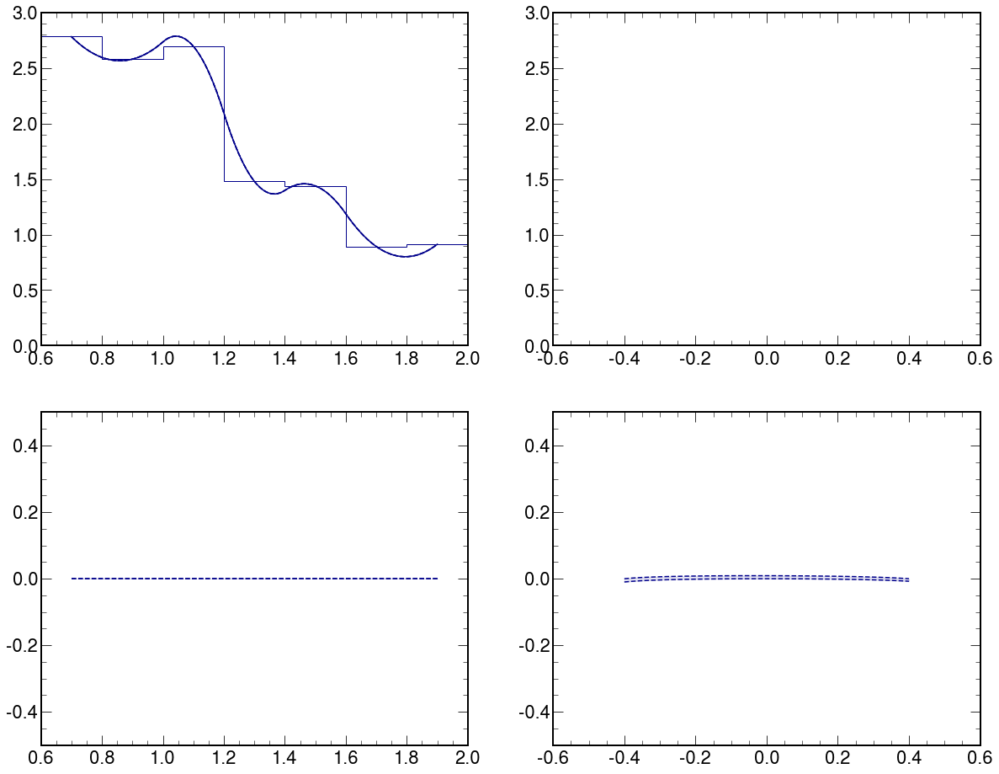

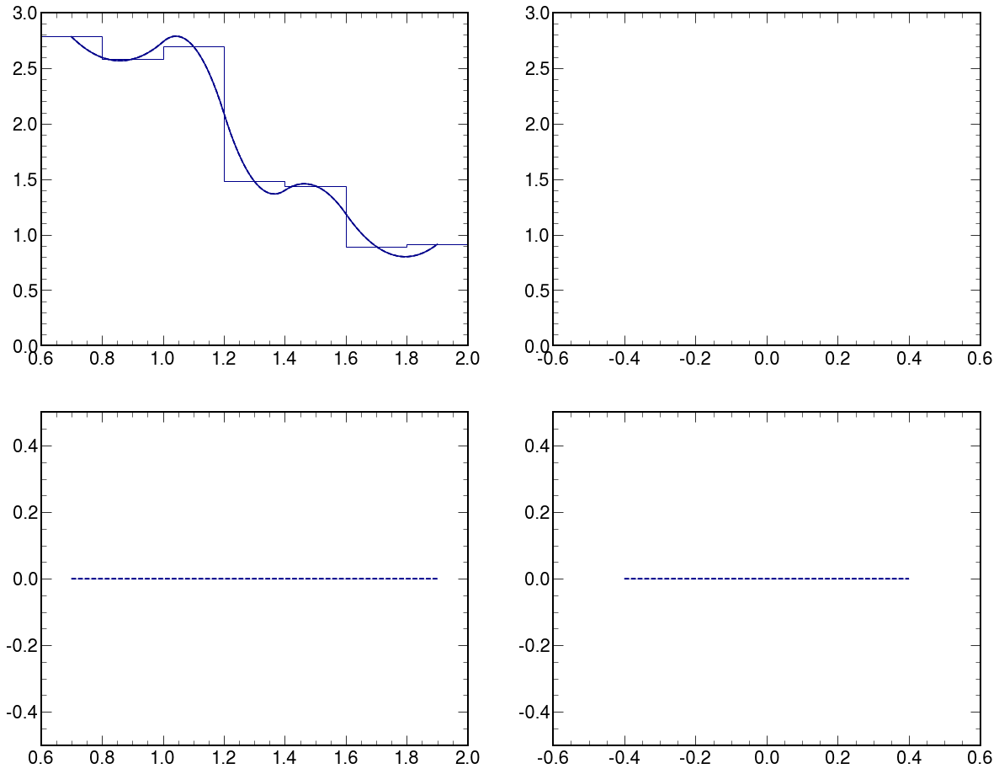

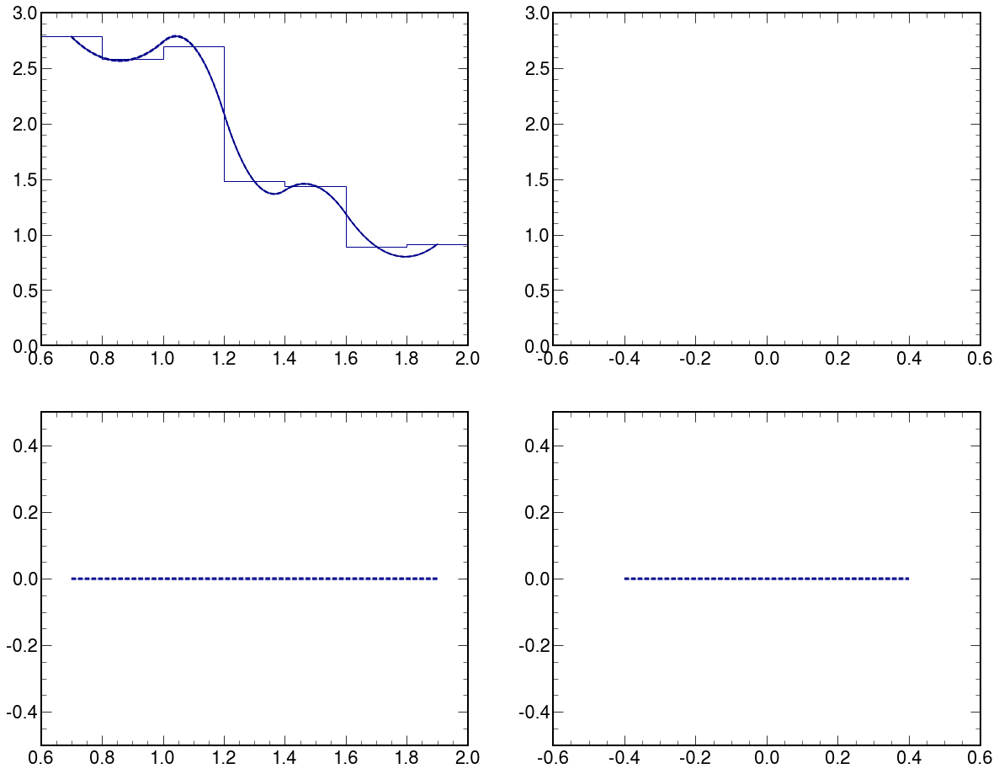

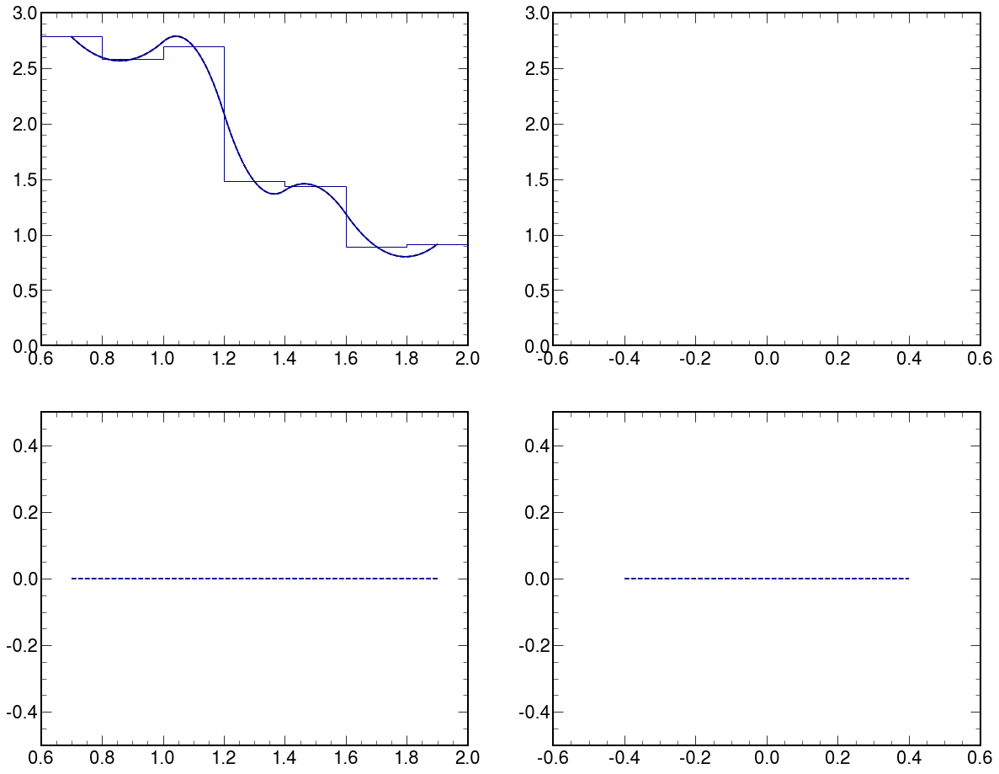

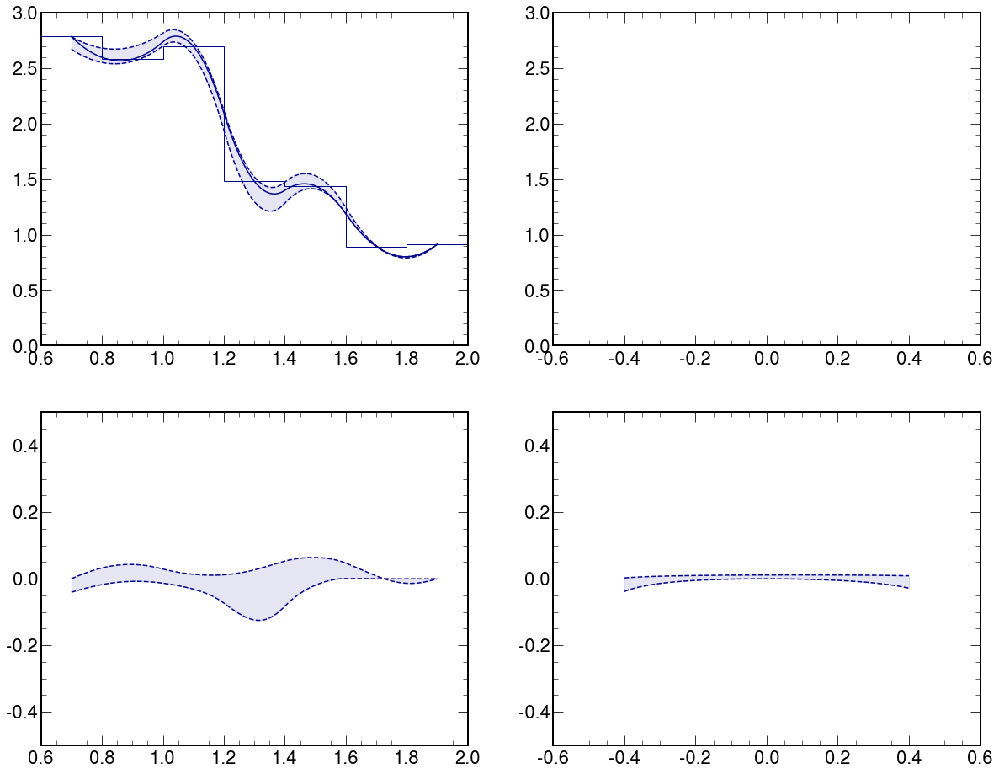

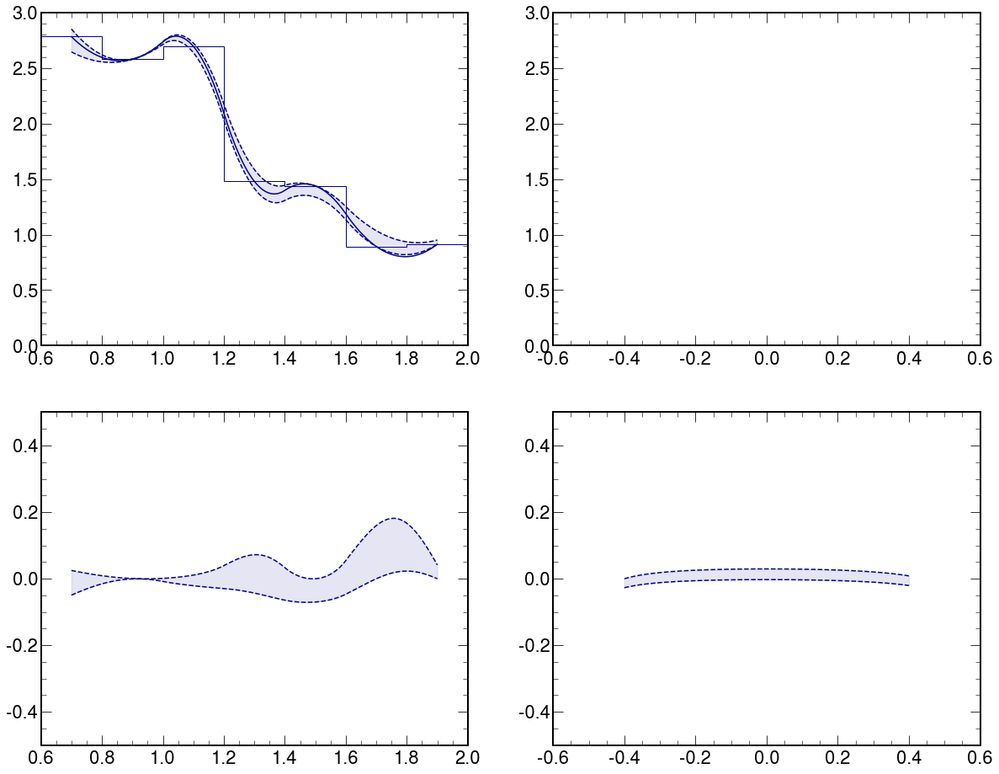

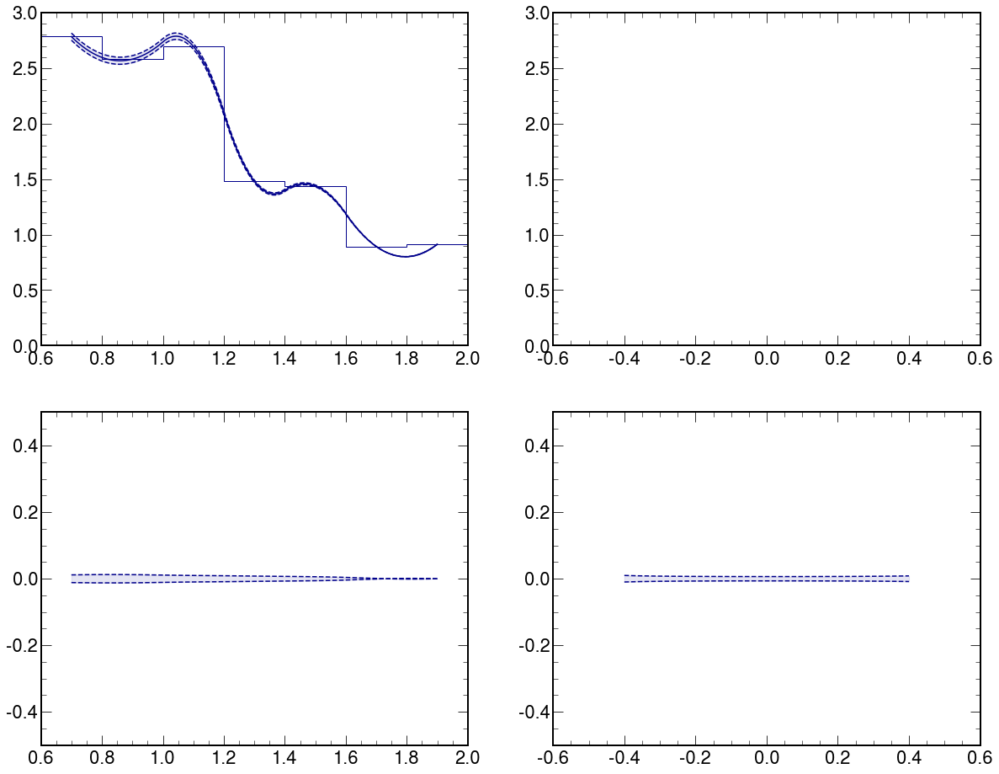

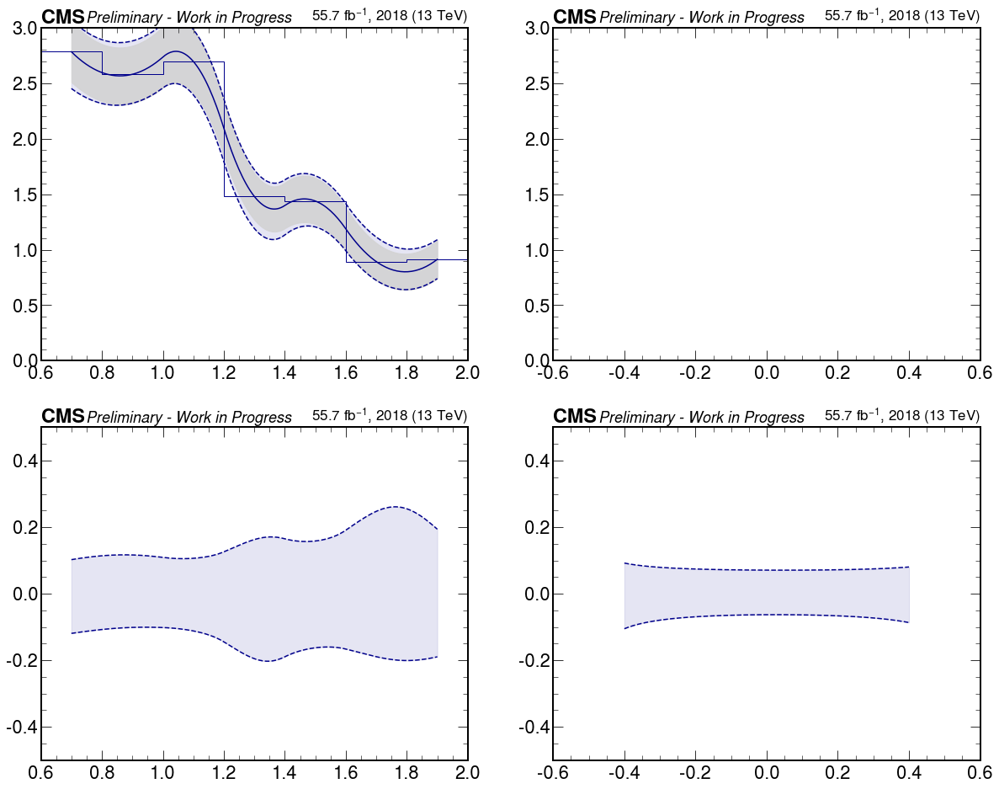

In [135]:
# ylim_ = (0.,0.3)
ylim_ = (0.,3.)
ylim_ratio_ = (-0.50,0.50)
color_ = "darkblue"

label_ = ""
coupling_str_ = "A0W5e-7"
if data_sample == '2017':
    if lepton_type == 'muon':
#         label_ = "GGToWW-AQGC-A0W1e-6"
#         label_ = "GGToWW-AQGC-muon-A0W1e-6"
        label_ = "GGToWW-AQGC-2017-muon-" + coupling_str_
    elif lepton_type == 'electron':
#         label_ = "GGToWW-AQGC-electron-A0W1e-6"
        label_ = "GGToWW-AQGC-2017-electron-" + coupling_str_
if data_sample == '2018':
    if lepton_type == 'muon':
        label_ = "GGToWW-AQGC-2018-muon-" + coupling_str_
    elif lepton_type == 'electron':
        label_ = "GGToWW-AQGC-2018-electron-" + coupling_str_
    
counts[ label_ ], err[ label_ ], bins[ label_ ], max_variations_total[ label_ ], min_variations_total[ label_ ] = plot_total_systematic(
#     df_dict=df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat,
#     weights_dict=weights_sig_plus_mix_categories_concat,
    df_dict=df_signals_protons_multiRP_sig_plus_mix_All_selected_events,
    weights_dict=weights_sig_plus_mix_All,
    lepton_type=lepton_type,
    label=label_,
    ylim=ylim_,
    ylim_ratio=ylim_ratio_,
    color=color_
    )
    
if save_figures:
    if lepton_type == 'muon':
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-A0W5e-7-Muon_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-A0W5e-7-Muon_2018.png", bbox_inches='tight' )
    if lepton_type == 'electron':
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-A0W5e-7-Electron_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-A0W5e-7-Electron_2018.png", bbox_inches='tight' )

GGToWW-AQGC-2018-muon-A0W1e-6
R_MWW_MX
_jes_up
_jes_up
nom
_jes_dw
_jes_dw
nom
[3.96454838 6.67132326 6.44131435 5.75772718 3.32693728 3.67371065
 1.97053713]
[3.93204467 6.66319349 6.29252664 5.56849248 3.18082794 3.67371065
 1.93129966]
0      2.240302e-16
1     -4.777546e-04
2     -8.936437e-04
3     -1.254157e-03
4     -1.564795e-03
           ...     
195    1.270695e-02
196    1.427948e-02
197    1.604773e-02
198    1.804583e-02
199    2.031661e-02
Length: 200, dtype: float64 0.004970590718940784
0     -0.008199
1     -0.007475
2     -0.006816
3     -0.006214
4     -0.005662
         ...   
195    0.003167
196    0.002556
197    0.001837
198    0.000993
199    0.000000
Length: 200, dtype: float64 -0.012355342173886997
Diff_YWW_YX
_jes_up
_jes_up
nom
_jes_dw
_jes_dw
nom
[ 9.72339804 17.74866432 13.67348306]
[ 9.61630625 17.58504572 13.46059765]
0     -0.003750
1     -0.003558
2     -0.003372
3     -0.003194
4     -0.003021
         ...   
195    0.001732
196    0.001689
197    0.0

_nom_m100
_nom
nom
[ 9.97178971 17.88204779 13.81881113]
[ 9.62188197 17.40440562 13.40590029]
0      0.021700
1      0.021353
2      0.021019
3      0.020696
4      0.020384
         ...   
195    0.011869
196    0.011948
197    0.012029
198    0.012112
199    0.012198
Length: 200, dtype: float64 0.012042576999487041
0     -0.014151
1     -0.014219
2     -0.014285
3     -0.014349
4     -0.014411
         ...   
195   -0.017976
196   -0.017994
197   -0.018011
198   -0.018029
199   -0.018047
Length: 200, dtype: float64 -0.01662415873078035
GGToWW-AQGC-2018-muon-A0W1e-6
R_MWW_MX
_nom
_nom
proton_eff_up
_nom
_nom
proton_eff_dw
[4.01107139 6.73945184 6.40192383 5.79865345 3.31854766 3.68549321
 1.93446754]
[3.91802537 6.58693513 6.26933081 5.71680092 3.27681612 3.66192809
 1.92813178]
0      0.011735
1      0.011725
2      0.011716
3      0.011707
4      0.011698
         ...   
195    0.001856
196    0.001807
197    0.001754
198    0.001699
199    0.001640
Length: 200, dtype: float64 0.00

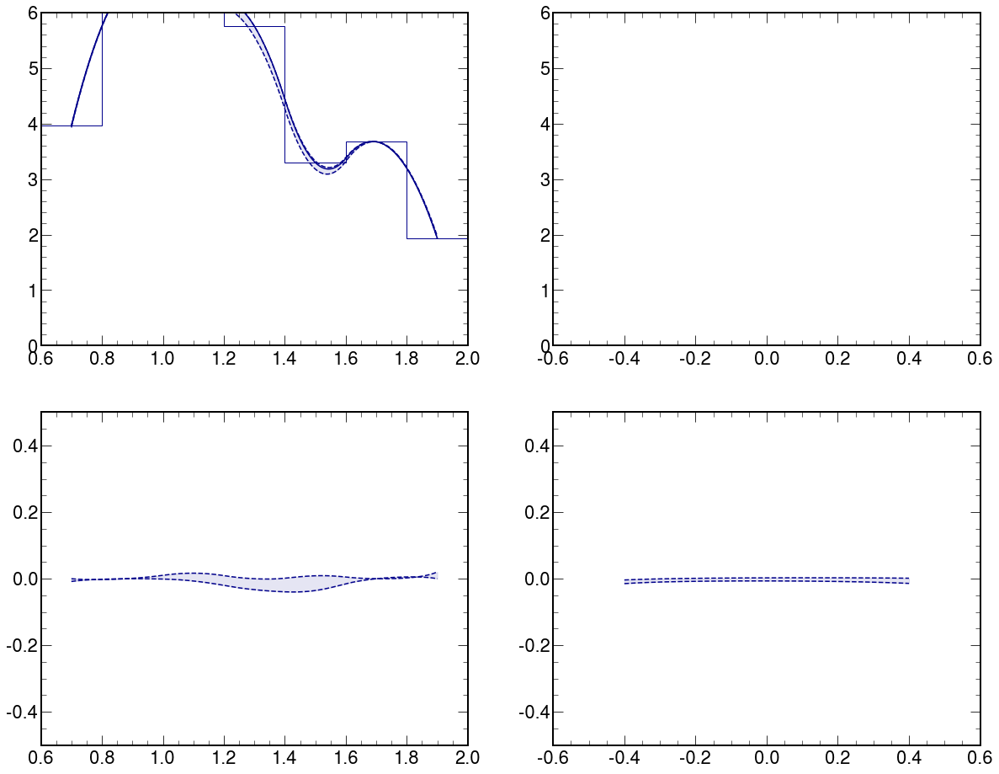

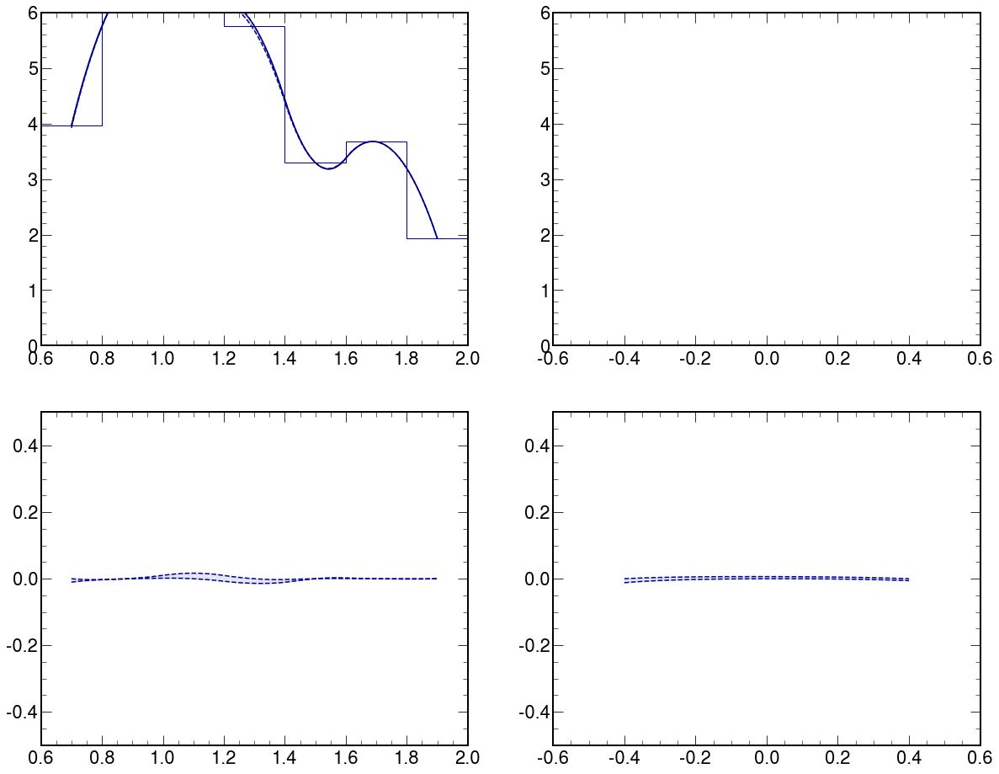

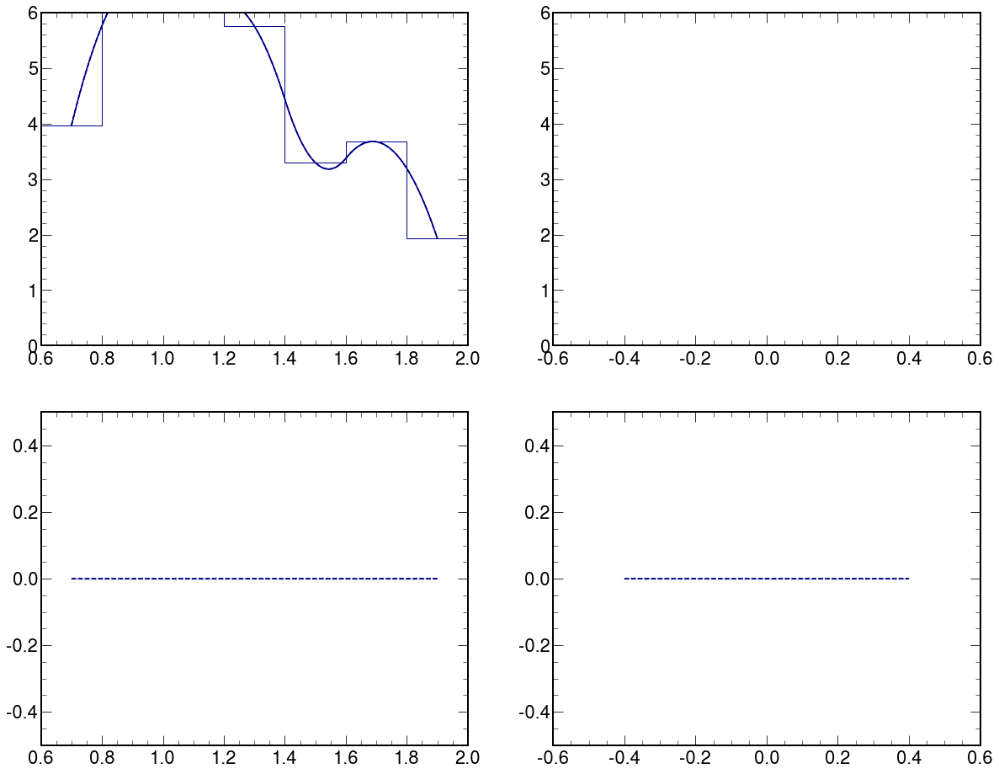

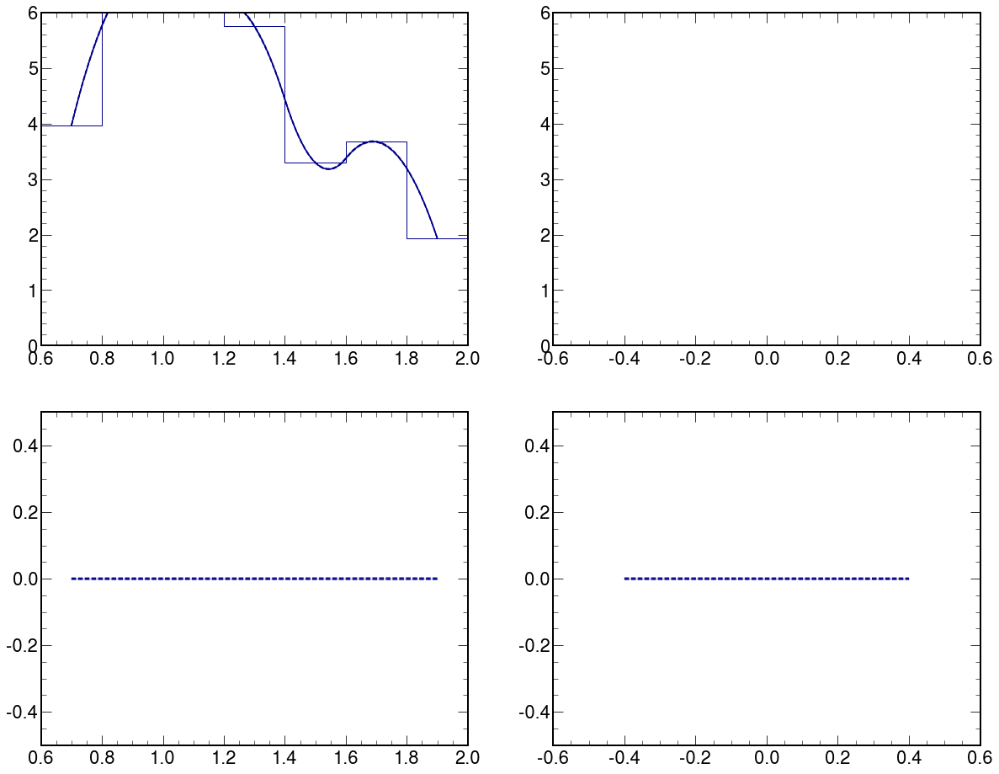

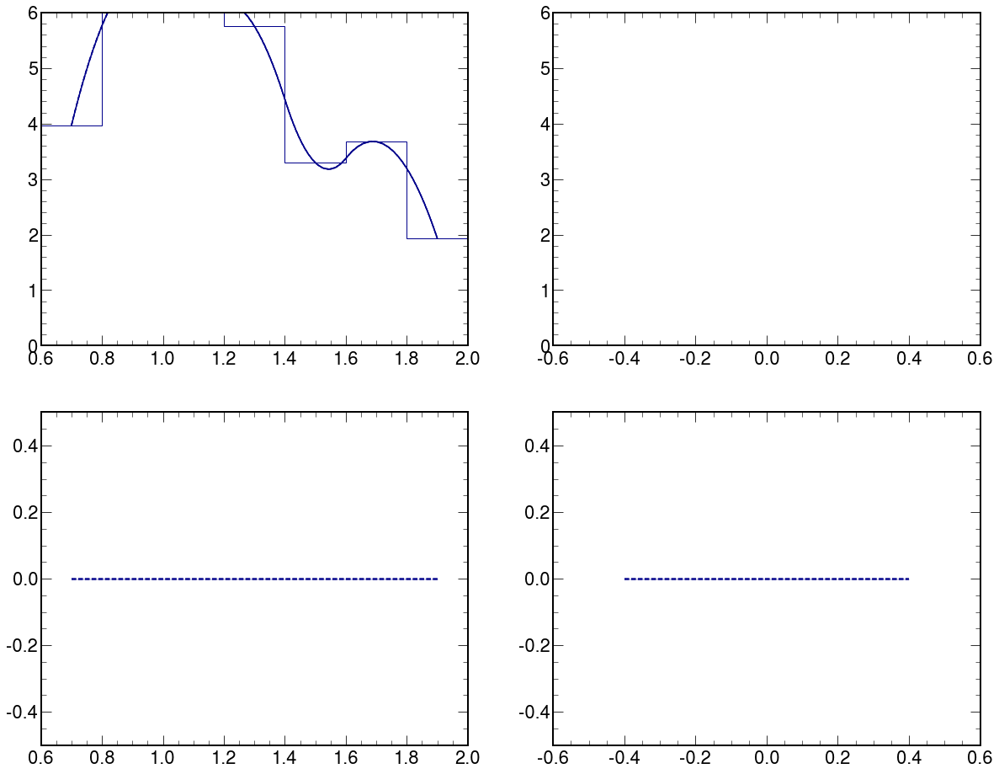

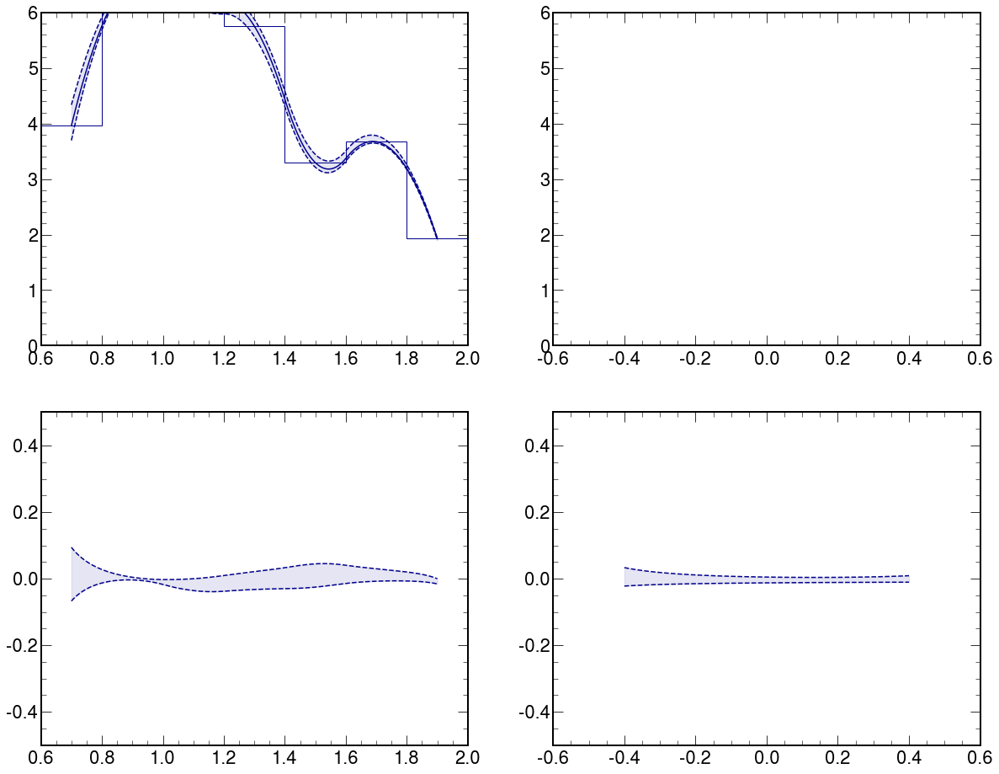

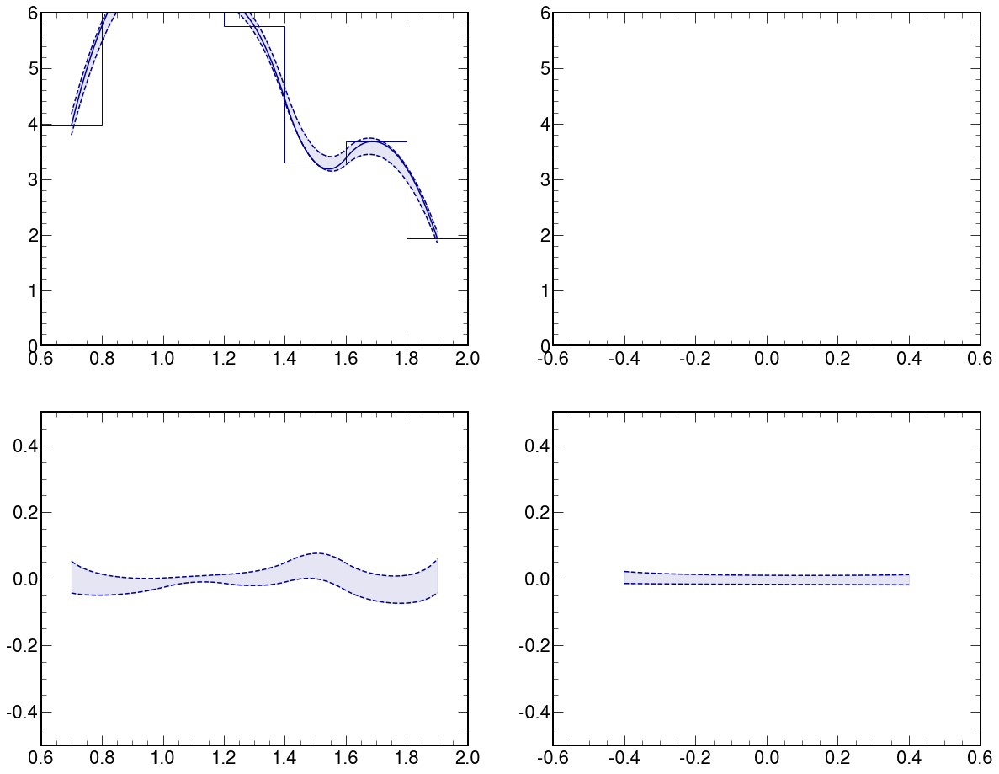

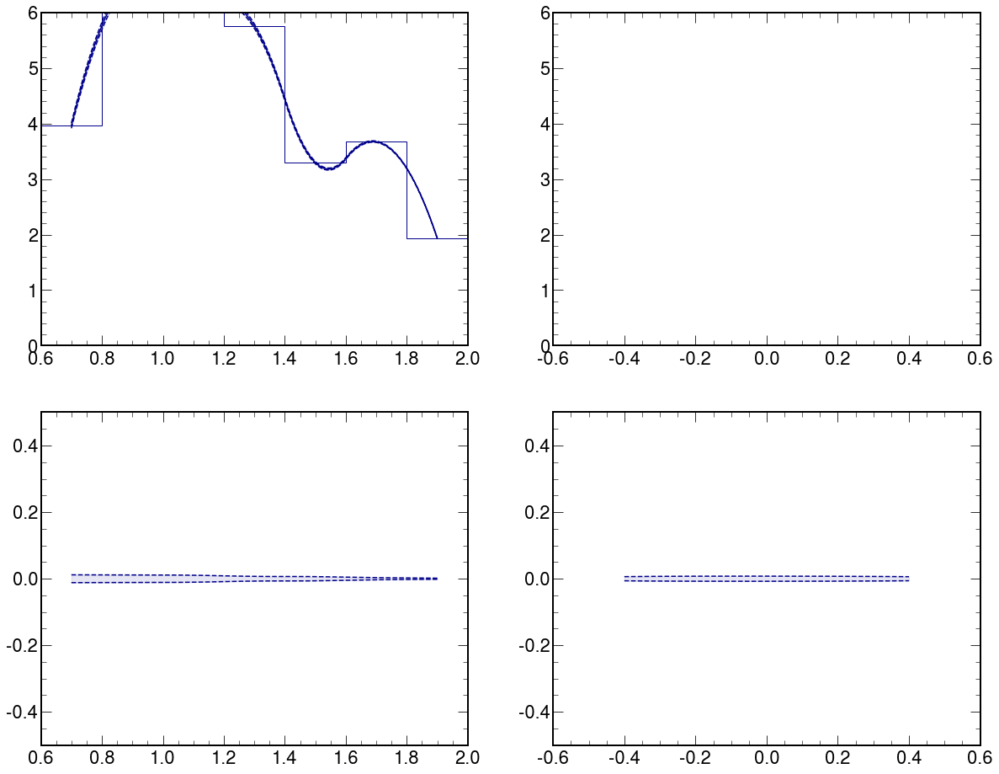

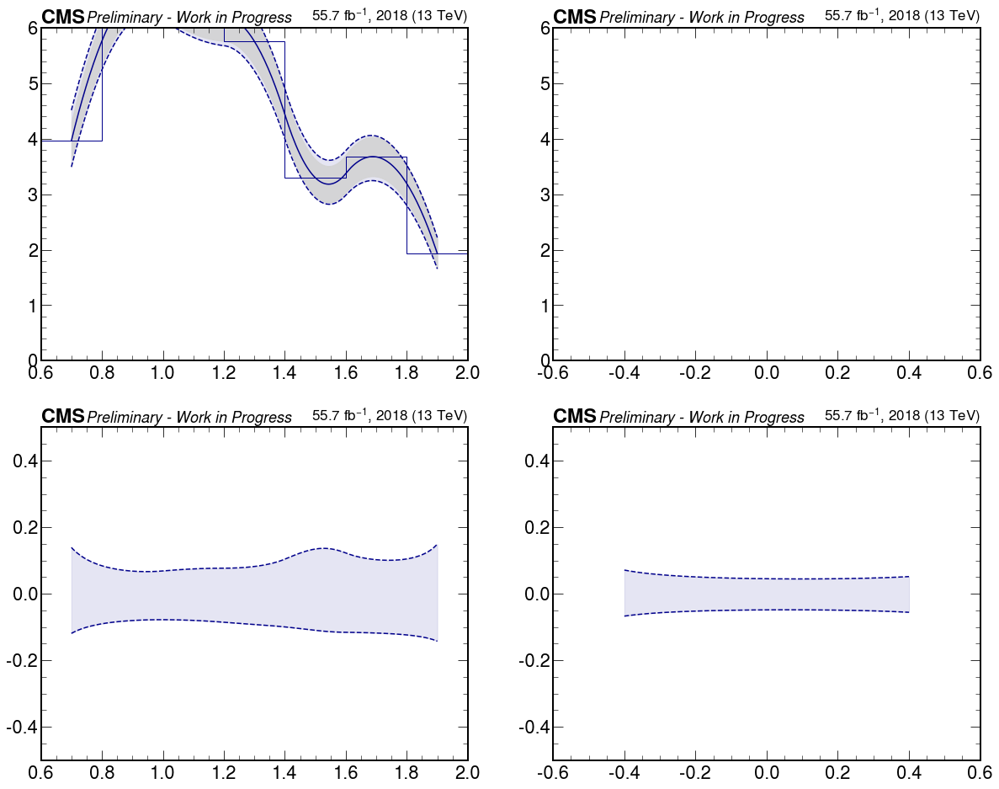

In [136]:
# ylim_ = (0.,0.3)
ylim_ = (0.,6.)
ylim_ratio_ = (-0.50,0.50)
color_ = "darkblue"

label_ = ""
coupling_str_ = "A0W1e-6"
if data_sample == '2017':
    if lepton_type == 'muon':
#         label_ = "GGToWW-AQGC-A0W1e-6"
#         label_ = "GGToWW-AQGC-muon-A0W1e-6"
        label_ = "GGToWW-AQGC-2017-muon-" + coupling_str_
    elif lepton_type == 'electron':
#         label_ = "GGToWW-AQGC-electron-A0W1e-6"
        label_ = "GGToWW-AQGC-2017-electron-" + coupling_str_
if data_sample == '2018':
    if lepton_type == 'muon':
        label_ = "GGToWW-AQGC-2018-muon-" + coupling_str_
    elif lepton_type == 'electron':
        label_ = "GGToWW-AQGC-2018-electron-" + coupling_str_
    
counts[ label_ ], err[ label_ ], bins[ label_ ], max_variations_total[ label_ ], min_variations_total[ label_ ] = plot_total_systematic(
#     df_dict=df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat,
#     weights_dict=weights_sig_plus_mix_categories_concat,
    df_dict=df_signals_protons_multiRP_sig_plus_mix_All_selected_events,
    weights_dict=weights_sig_plus_mix_All,
    lepton_type=lepton_type,
    label=label_,
    ylim=ylim_,
    ylim_ratio=ylim_ratio_,
    color=color_
    )
    
if save_figures:
    if lepton_type == 'muon':
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-A0W1e-6-Muon_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-A0W1e-6-Muon_2018.png", bbox_inches='tight' )
    if lepton_type == 'electron':
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-A0W1e-6-Electron_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-A0W1e-6-Electron_2018.png", bbox_inches='tight' )

GGToWW-AQGC-2018-muon-A0W2e-6
R_MWW_MX
_jes_up
_jes_up
nom
_jes_dw
_jes_dw
nom
[ 9.72706661 20.78274439 23.24147286 22.43086579 17.48367522 11.61624216
 10.0898945 ]
[ 9.71614073 20.66548929 22.74437303 22.05711272 17.35175938 11.11422316
  9.64977825]
0     -1.826200e-16
1      6.695016e-04
2      1.262269e-03
3      1.789151e-03
4      2.259001e-03
           ...     
195    2.256394e-02
196    2.084251e-02
197    1.904276e-02
198    1.716854e-02
199    1.522388e-02
Length: 200, dtype: float64 0.011127866150437163
0     -0.001123
1     -0.000124
2      0.000735
3      0.001471
4      0.002101
         ...   
195   -0.026614
196   -0.027224
197   -0.027836
198   -0.028448
199   -0.029060
Length: 200, dtype: float64 -0.009194311129674925
Diff_YWW_YX
_jes_up
_jes_up
nom
_jes_dw
_jes_dw
nom
[32.70623677 57.59108551 50.99548466]
[31.81974998 57.25713513 50.14665306]
0      0.017996
1      0.017395
2      0.016815
3      0.016254
4      0.015712
         ...   
195    0.007743
196    0.007

0      0.009989
1      0.010271
2      0.010520
3      0.010740
4      0.010935
         ...   
195    0.001398
196    0.001387
197    0.001381
198    0.001379
199    0.001380
Length: 200, dtype: float64 0.007269998147669957
0     -0.009989
1     -0.010271
2     -0.010520
3     -0.010740
4     -0.010935
         ...   
195   -0.001398
196   -0.001387
197   -0.001381
198   -0.001379
199   -0.001380
Length: 200, dtype: float64 -0.007269998147669482
Diff_YWW_YX
_nom
_nom
proton_eff_up
_nom
_nom
proton_eff_dw
[32.32986788 58.0338575  50.86197662]
[31.92625198 57.26207999 50.24828782]
0      0.006281
1      0.006298
2      0.006313
3      0.006328
4      0.006343
         ...   
195    0.006122
196    0.006109
197    0.006096
198    0.006083
199    0.006070
Length: 200, dtype: float64 0.006543472577226327
0     -0.006281
1     -0.006298
2     -0.006313
3     -0.006328
4     -0.006343
         ...   
195   -0.006122
196   -0.006109
197   -0.006096
198   -0.006083
199   -0.006070
Length: 200,

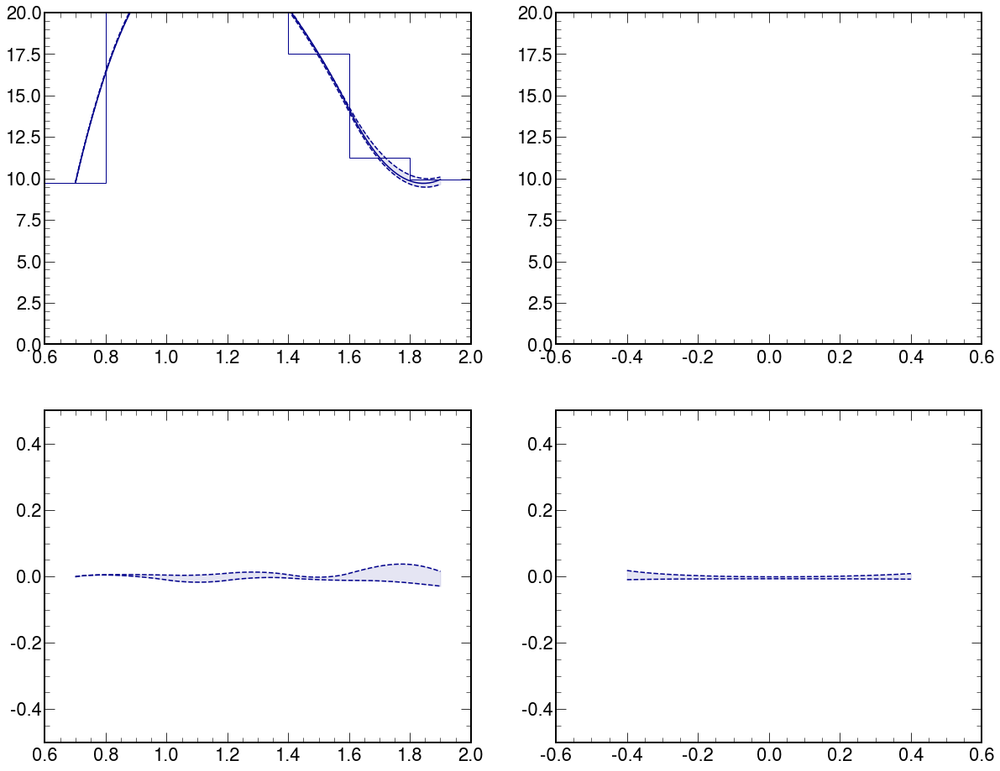

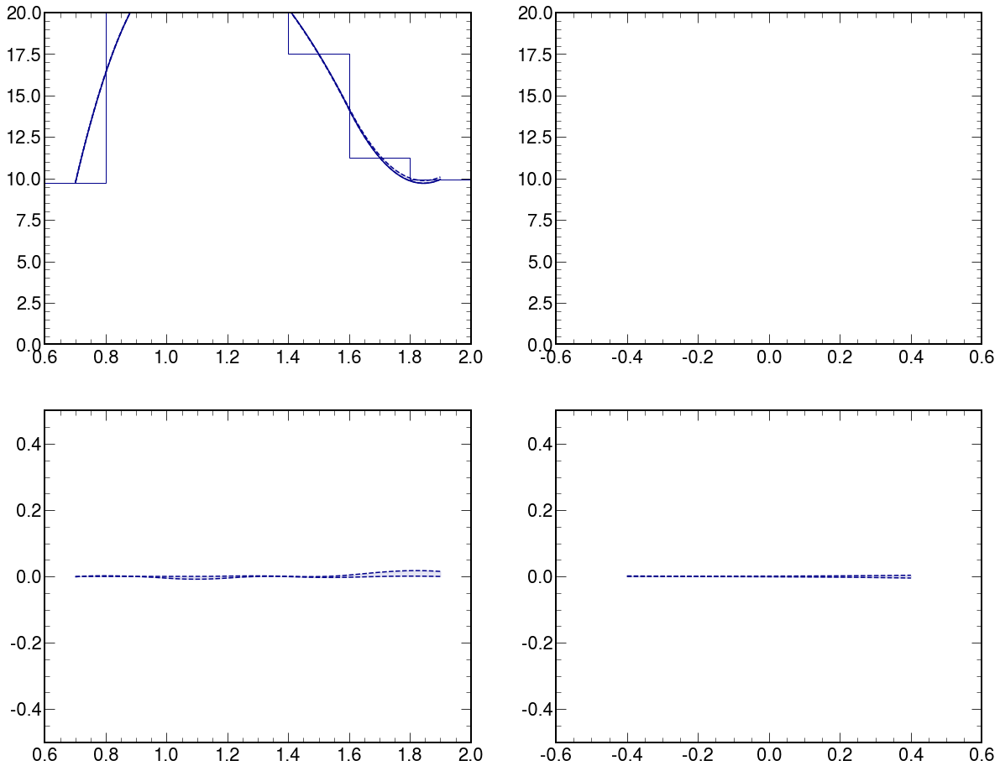

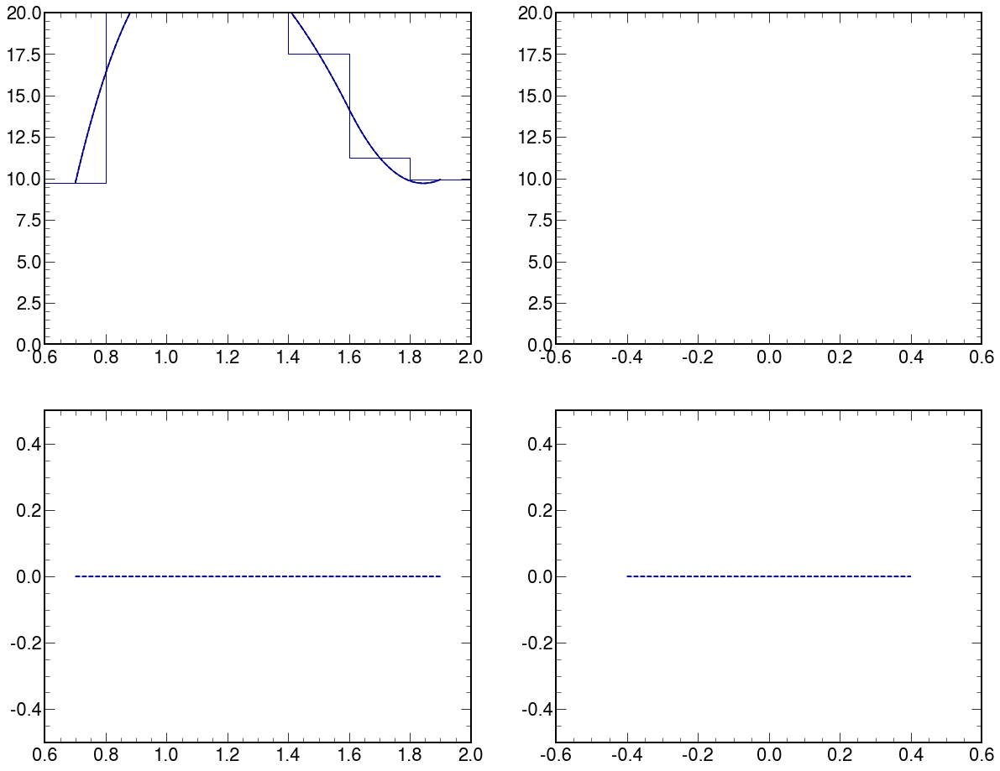

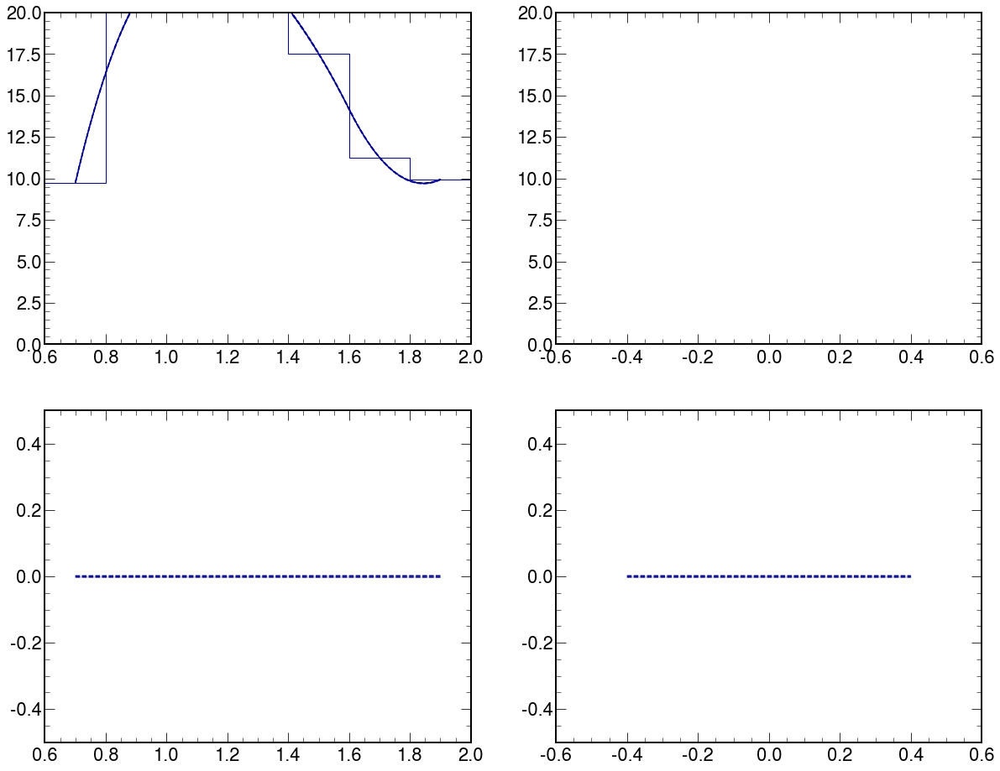

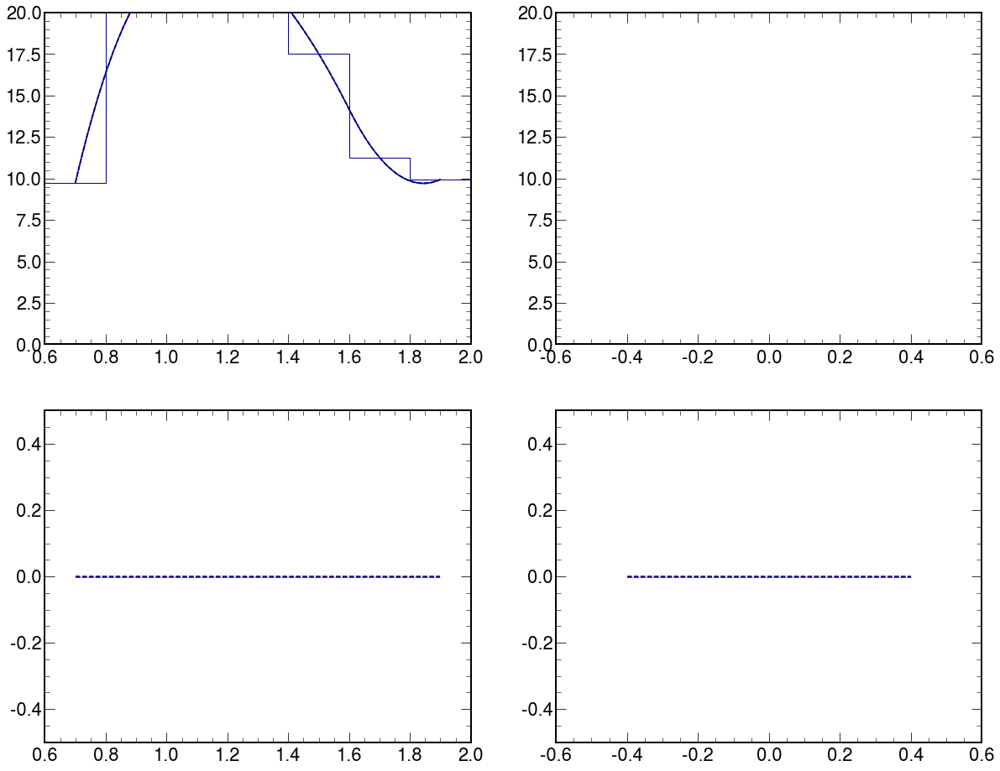

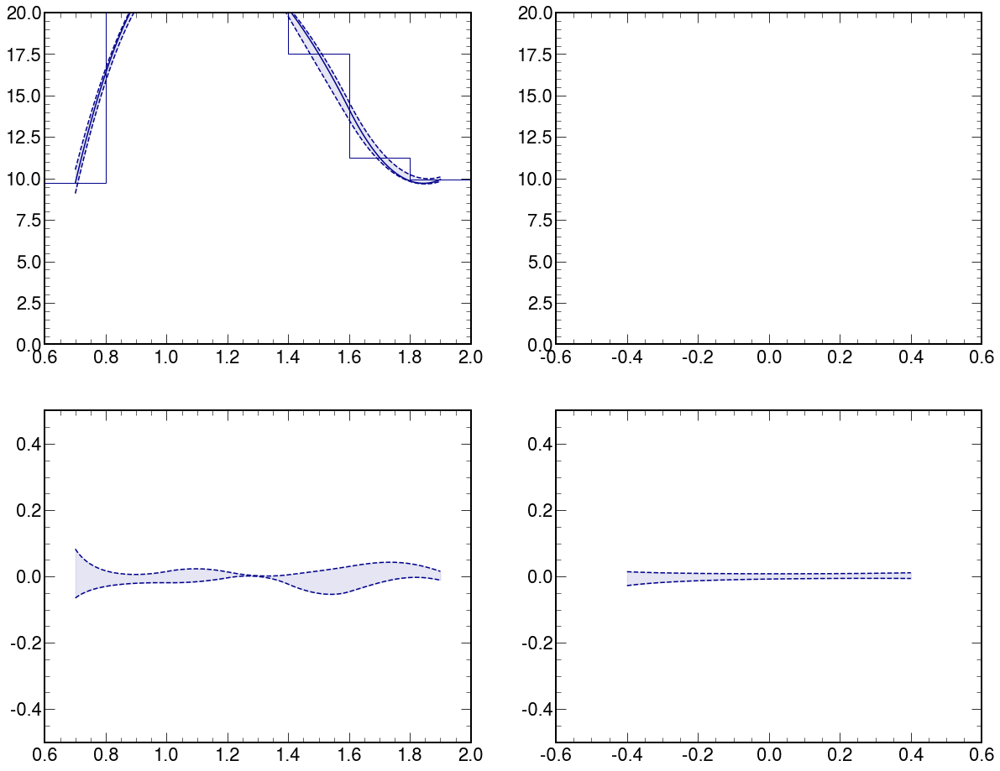

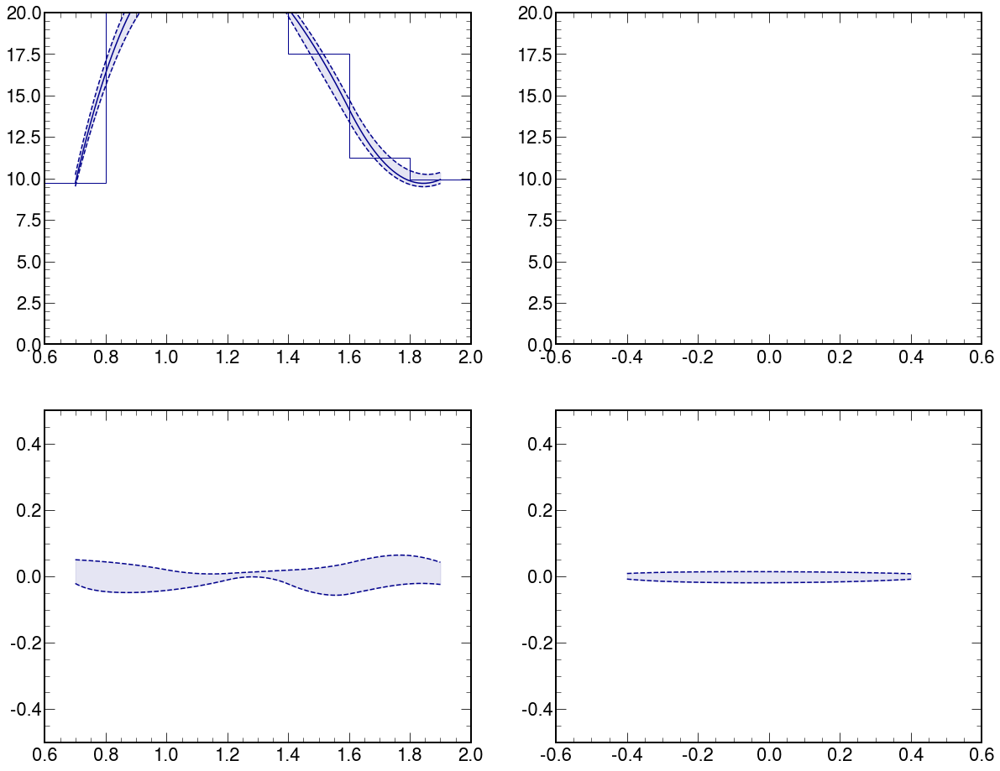

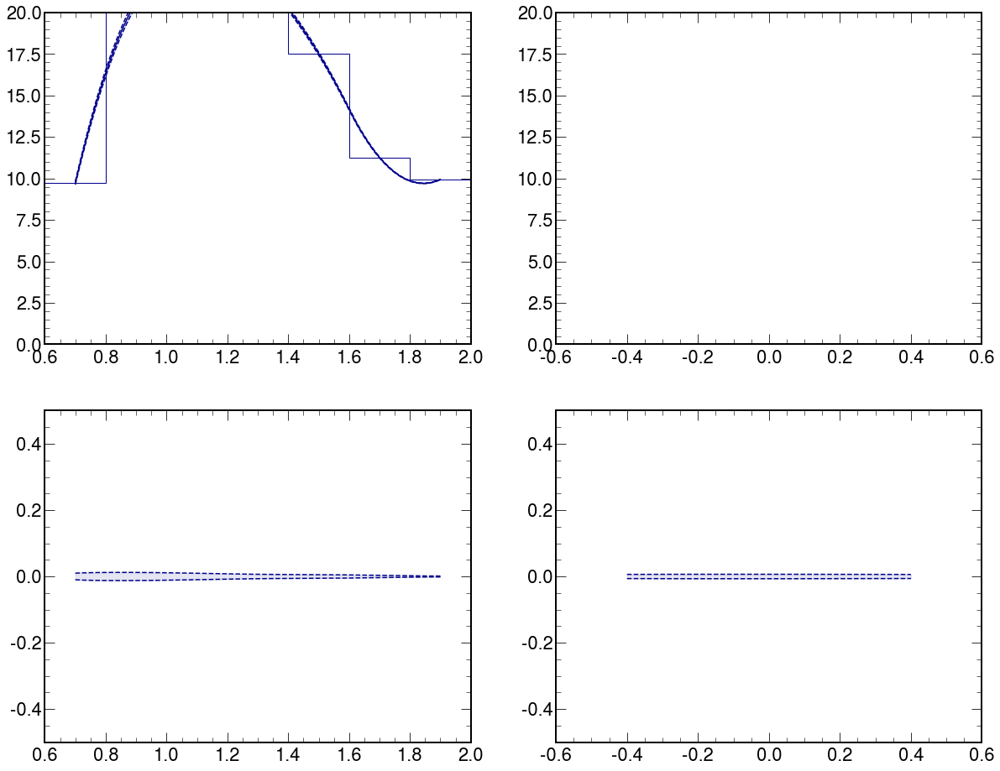

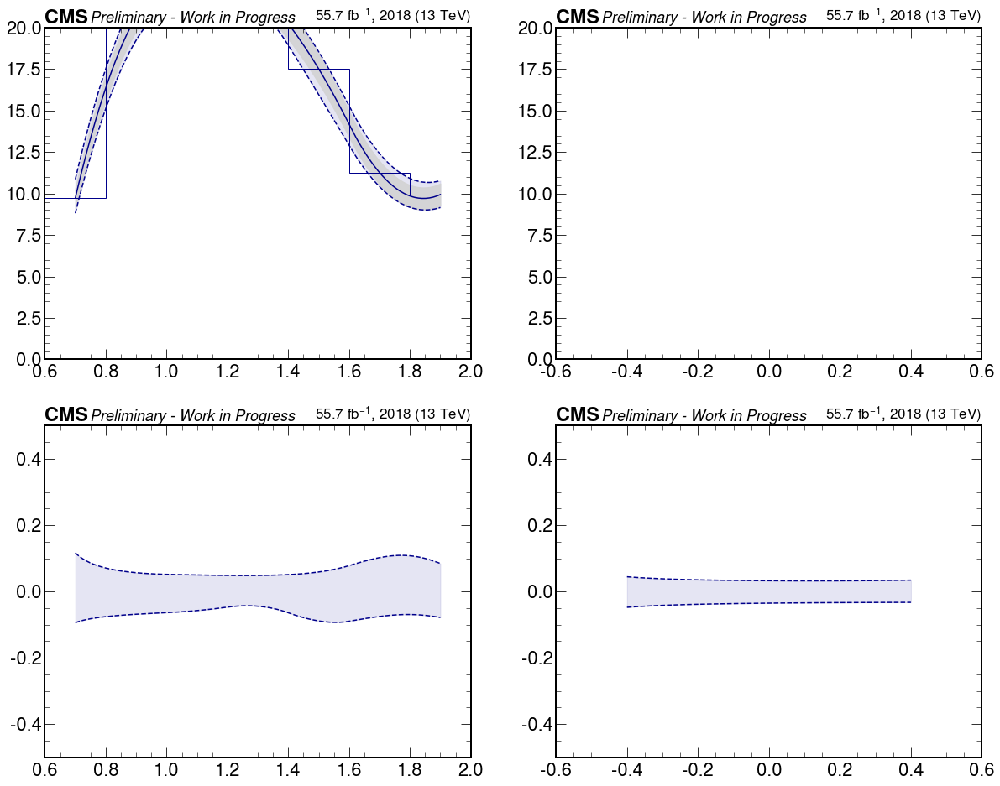

In [137]:
# ylim_ = (0.,0.3)
ylim_ = (0.,20.)
ylim_ratio_ = (-0.50,0.50)
color_ = "darkblue"

label_ = ""
coupling_str_ = "A0W2e-6"
if data_sample == '2017':
    if lepton_type == 'muon':
#         label_ = "GGToWW-AQGC-A0W1e-6"
#         label_ = "GGToWW-AQGC-muon-A0W1e-6"
        label_ = "GGToWW-AQGC-2017-muon-" + coupling_str_
    elif lepton_type == 'electron':
#         label_ = "GGToWW-AQGC-electron-A0W1e-6"
        label_ = "GGToWW-AQGC-2017-electron-" + coupling_str_
if data_sample == '2018':
    if lepton_type == 'muon':
        label_ = "GGToWW-AQGC-2018-muon-" + coupling_str_
    elif lepton_type == 'electron':
        label_ = "GGToWW-AQGC-2018-electron-" + coupling_str_
    
counts[ label_ ], err[ label_ ], bins[ label_ ], max_variations_total[ label_ ], min_variations_total[ label_ ] = plot_total_systematic(
#     df_dict=df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat,
#     weights_dict=weights_sig_plus_mix_categories_concat,
    df_dict=df_signals_protons_multiRP_sig_plus_mix_All_selected_events,
    weights_dict=weights_sig_plus_mix_All,
    lepton_type=lepton_type,
    label=label_,
    ylim=ylim_,
    ylim_ratio=ylim_ratio_,
    color=color_
    )
    
if save_figures:
    if lepton_type == 'muon':
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-A0W2e-6-Muon_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-A0W2e-6-Muon_2018.png", bbox_inches='tight' )
    if lepton_type == 'electron':
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-A0W2e-6-Electron_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-A0W2e-6-Electron_2018.png", bbox_inches='tight' )

GGToWW-AQGC-2018-muon-A0W5e-6
R_MWW_MX
_jes_up
_jes_up
nom
_jes_dw
_jes_dw
nom
[ 61.16043153 123.07193208 155.47405624 135.63783257 112.3876234
  76.15035514  55.7350307 ]
[ 61.0269305  122.15800489 154.92296178 133.44578212 111.80850874
  74.52131319  54.85831385]
0      0.004282
1      0.003781
2      0.003330
3      0.002921
4      0.002552
         ...   
195    0.015218
196    0.014315
197    0.013356
198    0.012342
199    0.011273
Length: 200, dtype: float64 0.008829692330541846
0      0.002090
1      0.000861
2     -0.000244
3     -0.001239
4     -0.002136
         ...   
195   -0.004608
196   -0.004624
197   -0.004635
198   -0.004638
199   -0.004634
Length: 200, dtype: float64 -0.0024928599823913302
Diff_YWW_YX
_jes_up
_jes_up
nom
_jes_dw
_jes_dw
nom
[186.67549019 381.09587819 333.40324553]
[184.81859498 378.43389733 329.99554777]
0      0.006805
1      0.006835
2      0.006864
3      0.006891
4      0.006918
         ...   
195    0.007540
196    0.007534
197    0.007527
198 

GGToWW-AQGC-2018-muon-A0W5e-6
R_MWW_MX
[ 60.89964661 123.07434516 154.77188273 133.8348139  111.7407886
  74.67025652  55.11371894]
[ 63.3712495  126.55222102 158.83582492 137.63253033 115.25467961
  77.6088641   57.65737857]
[ 58.42804373 119.59646931 150.70794055 130.03709746 108.22689759
  71.73164893  52.57005931]
[ 65.74418483 128.33376544 161.2038313  138.23881877 118.09766111
  80.46422318  58.80433819]
[ 56.24151256 116.32561405 150.47782156 128.71967887 105.09785169
  69.49962708  52.34747216]
0      0.079550
1      0.076535
2      0.073776
3      0.071245
4      0.068917
         ...   
195    0.071246
196    0.070260
197    0.069217
198    0.068118
199    0.066964
Length: 200, dtype: float64 0.05355014203319363
0     -0.076489
1     -0.076148
2     -0.075775
3     -0.075371
4     -0.074940
         ...   
195   -0.054830
196   -0.053731
197   -0.052590
198   -0.051411
199   -0.050192
Length: 200, dtype: float64 -0.05257729851523949
Diff_YWW_YX
[185.41381455 378.18052442 330.

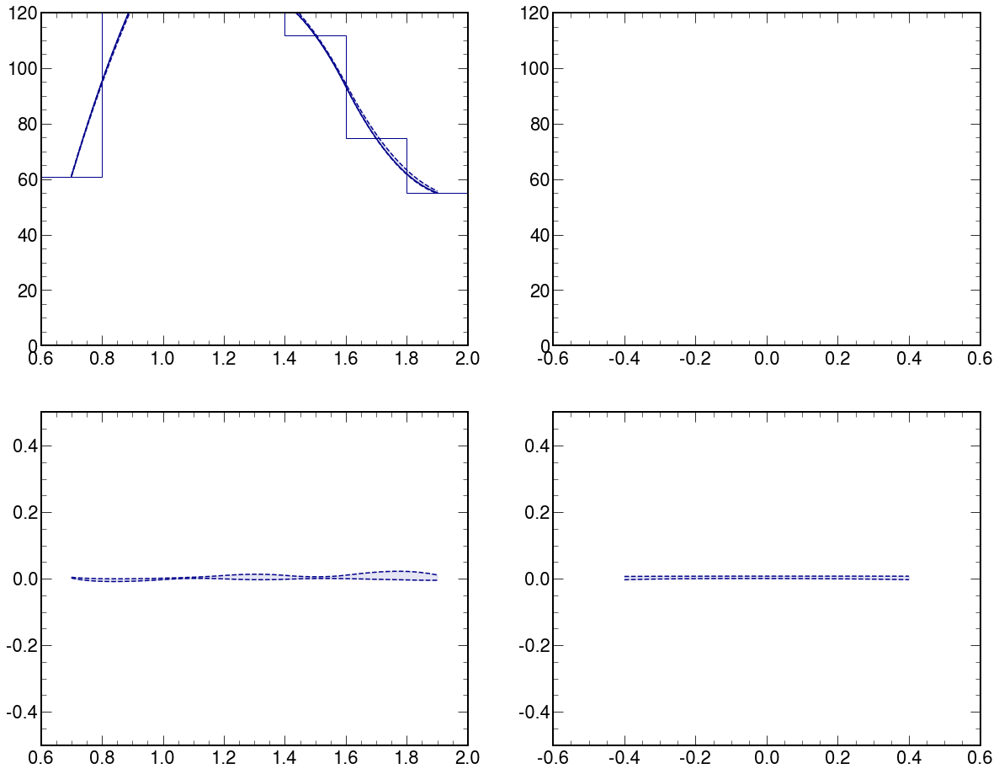

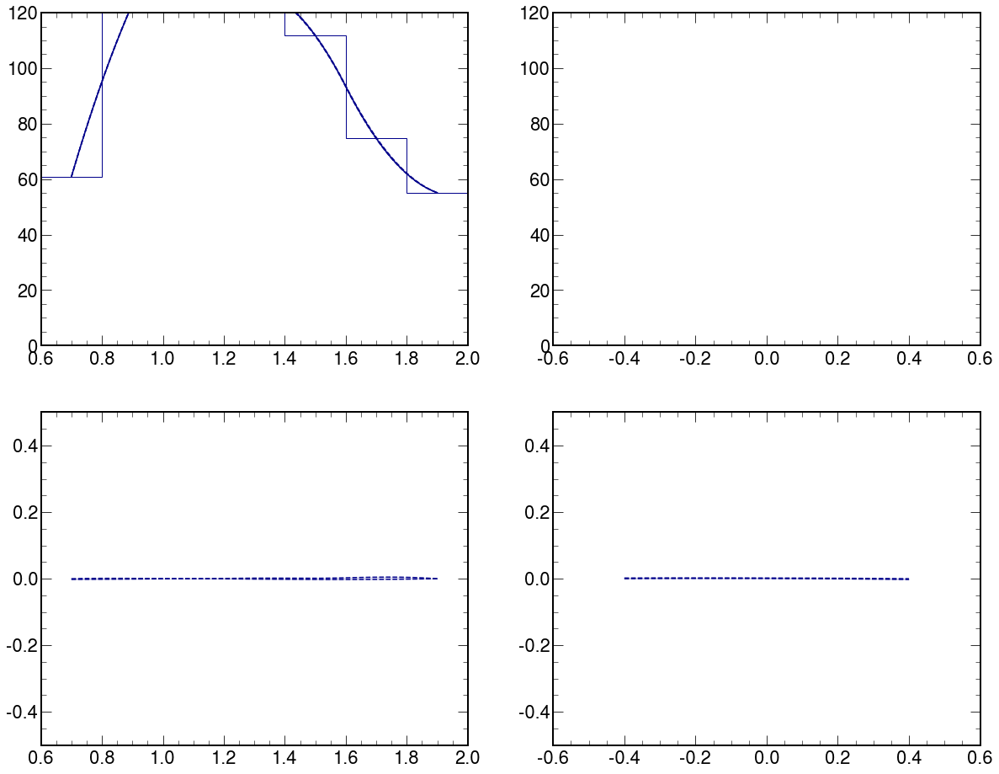

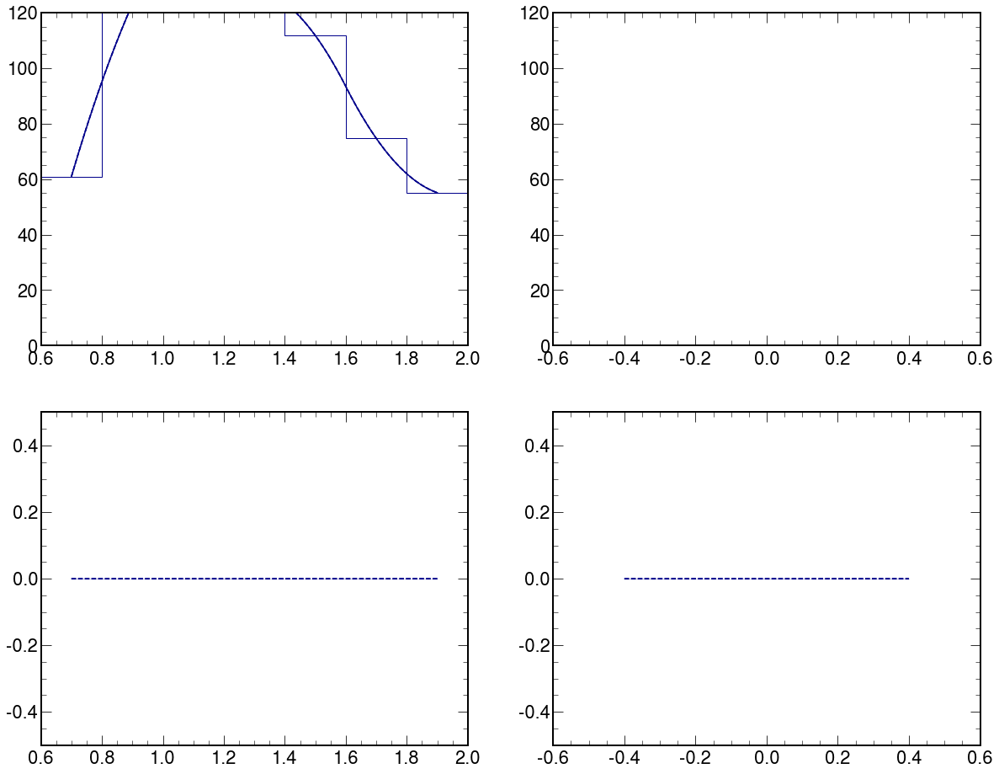

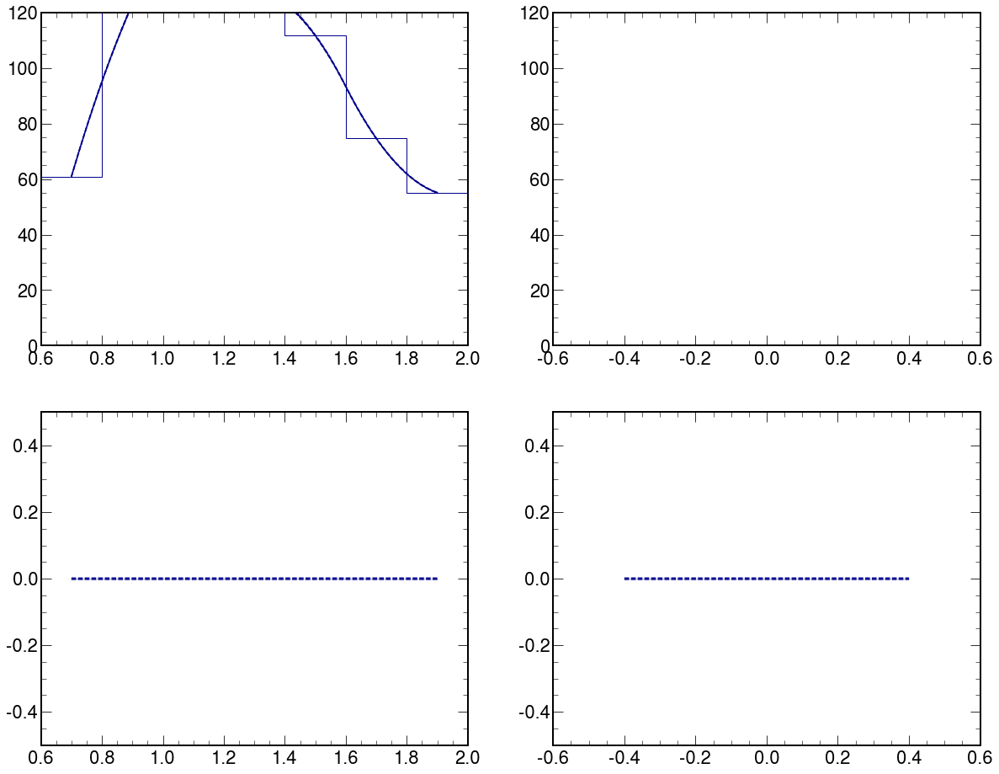

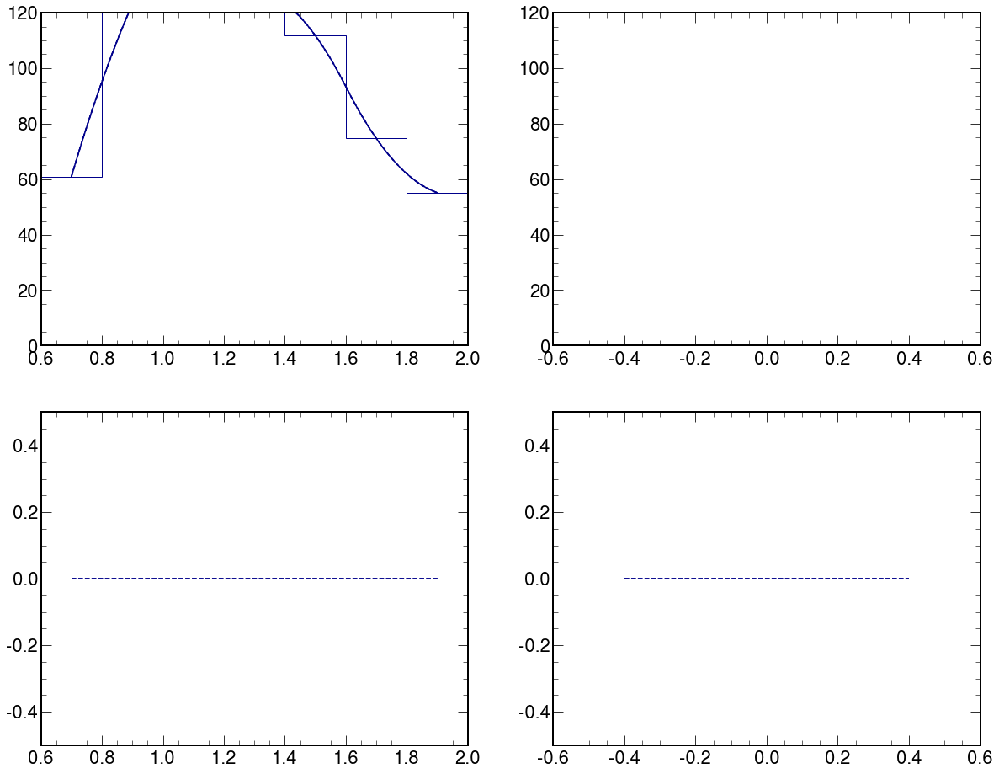

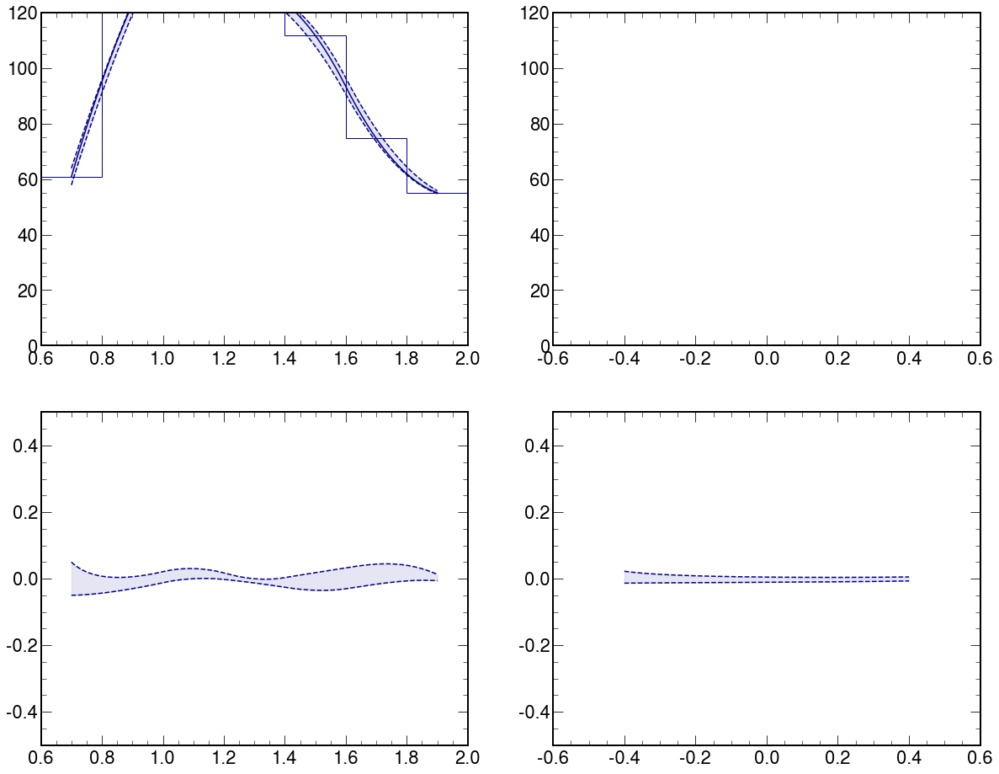

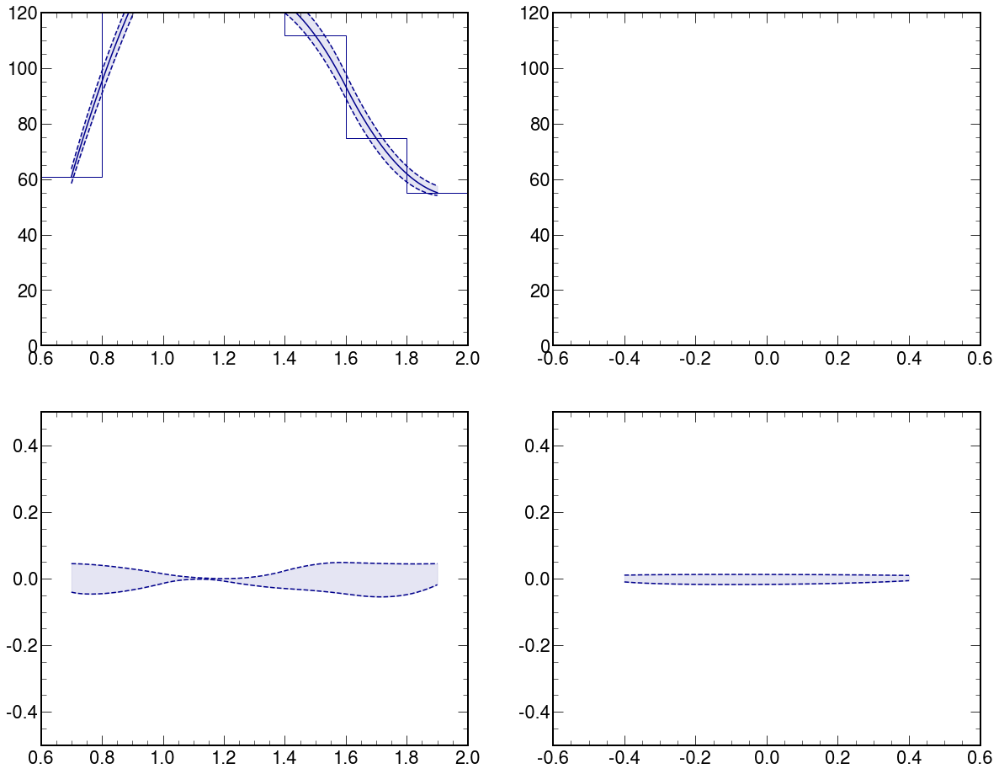

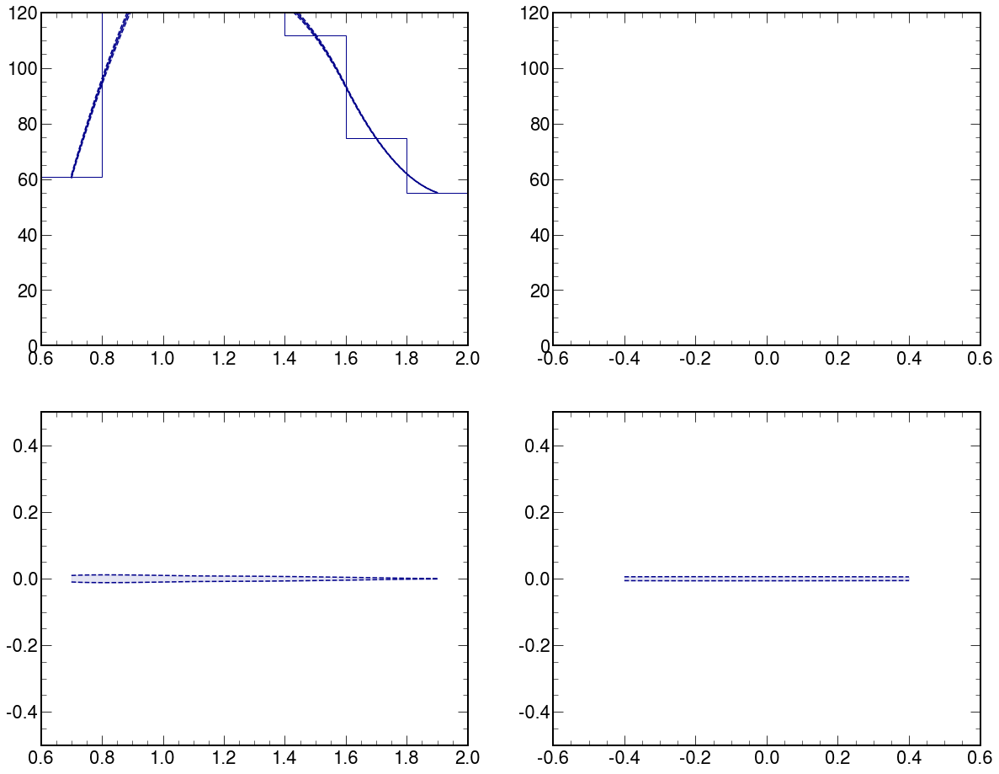

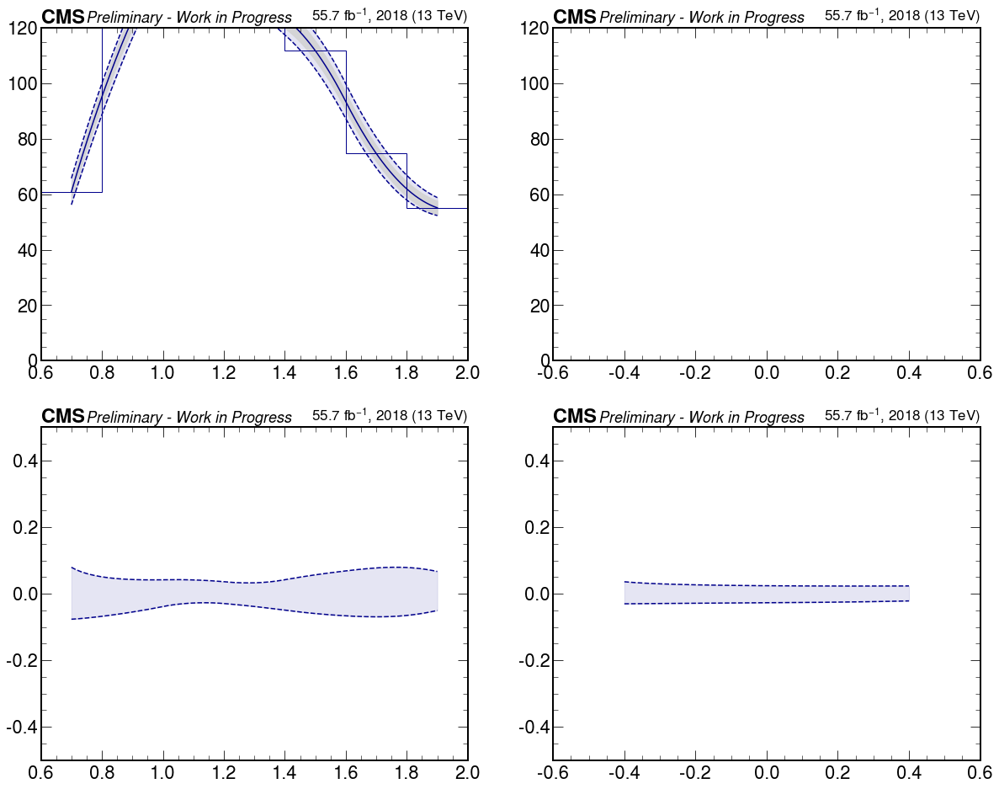

In [138]:
# ylim_ = (0.,0.3)
ylim_ = (0.,120.)
ylim_ratio_ = (-0.50,0.50)
color_ = "darkblue"

label_ = ""
coupling_str_ = "A0W5e-6"
if data_sample == '2017':
    if lepton_type == 'muon':
#         label_ = "GGToWW-AQGC-A0W1e-6"
#         label_ = "GGToWW-AQGC-muon-A0W1e-6"
        label_ = "GGToWW-AQGC-2017-muon-" + coupling_str_
    elif lepton_type == 'electron':
#         label_ = "GGToWW-AQGC-electron-A0W1e-6"
        label_ = "GGToWW-AQGC-2017-electron-" + coupling_str_
if data_sample == '2018':
    if lepton_type == 'muon':
        label_ = "GGToWW-AQGC-2018-muon-" + coupling_str_
    elif lepton_type == 'electron':
        label_ = "GGToWW-AQGC-2018-electron-" + coupling_str_
    
counts[ label_ ], err[ label_ ], bins[ label_ ], max_variations_total[ label_ ], min_variations_total[ label_ ] = plot_total_systematic(
#     df_dict=df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat,
#     weights_dict=weights_sig_plus_mix_categories_concat,
    df_dict=df_signals_protons_multiRP_sig_plus_mix_All_selected_events,
    weights_dict=weights_sig_plus_mix_All,
    lepton_type=lepton_type,
    label=label_,
    ylim=ylim_,
    ylim_ratio=ylim_ratio_,
    color=color_
    )
    
if save_figures:
    if lepton_type == 'muon':
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-A0W5e-6-Muon_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-A0W5e-6-Muon_2018.png", bbox_inches='tight' )
    if lepton_type == 'electron':
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-A0W5e-6-Electron_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-A0W5e-6-Electron_2018.png", bbox_inches='tight' )

GGToWW-AQGC-2018-muon-ACW5e-7
R_MWW_MX
_jes_up
_jes_up
nom
_jes_dw
_jes_dw
nom
[2.46564326 1.52213148 0.73607994 0.47646013 0.16359042 0.1718564
 0.        ]
[2.40110018 1.41562917 0.73007343 0.4005484  0.16359042 0.1718564
 0.        ]
0      0.000000
1     -0.000058
2     -0.000114
3     -0.000167
4     -0.000218
         ...   
195   -0.000421
196   -0.000430
197   -0.000438
198   -0.000445
199         NaN
Length: 200, dtype: float64 0.001275238788764806
0     -0.026177
1     -0.028310
2     -0.030413
3     -0.032484
4     -0.034523
         ...   
195   -0.032305
196   -0.032940
197   -0.033558
198   -0.034159
199         NaN
Length: 200, dtype: float64 -0.045011431650430485
Diff_YWW_YX
_jes_up
_jes_up
nom
_jes_dw
_jes_dw
nom
[2.8124498  3.57062732 2.8090663 ]
[2.80507608 3.47874755 2.79243217]
0      0.000000
1      0.000414
2      0.000818
3      0.001212
4      0.001597
         ...   
195   -0.029909
196   -0.030749
197   -0.031603
198   -0.032472
199   -0.033356
Length: 200, d

/tmp/ipykernel_612/923357951.py:131: RuntimeWarning: invalid value encountered in divide
  ratio_max_ = ( spline_max_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
/tmp/ipykernel_612/923357951.py:132: RuntimeWarning: invalid value encountered in divide
  ratio_min_ = ( spline_min_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
/tmp/ipykernel_612/923357951.py:131: RuntimeWarning: invalid value encountered in divide
  ratio_max_ = ( spline_max_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
/tmp/ipykernel_612/923357951.py:132: RuntimeWarning: invalid value encountered in divide
  ratio_min_ = ( spline_min_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
/tmp/ipykernel_612/923357951.py:131: RuntimeWarning: invalid value encountered in divide
  ratio_max_ = ( spline_max_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
/tmp/ipykernel_612/923357951.py:132: RuntimeWarning: invalid valu

GGToWW-AQGC-2018-muon-ACW5e-7
R_MWW_MX
_nom
_nom
sf_muon_trigger_up
_nom
_nom
sf_muon_trigger_dw
[2.46972266 1.52512865 0.73140621 0.47754075 0.16382648 0.17217117
 0.        ]
[2.46156386 1.5191343  0.72874064 0.47537951 0.16335436 0.17154164
 0.        ]
0      0.001654
1      0.001667
2      0.001679
3      0.001692
4      0.001704
         ...   
195    0.002072
196    0.002077
197    0.002082
198    0.002086
199         NaN
Length: 200, dtype: float64 0.001878627363154524
0     -0.001654
1     -0.001667
2     -0.001679
3     -0.001692
4     -0.001704
         ...   
195   -0.002072
196   -0.002077
197   -0.002082
198   -0.002086
199         NaN
Length: 200, dtype: float64 -0.0018786273631553434
Diff_YWW_YX
_nom
_nom
sf_muon_trigger_up
_nom
_nom
sf_muon_trigger_dw
[2.81740094 3.54275344 2.91157146]
[2.80749866 3.52970135 2.90042398]
0      0.001760
1      0.001762
2      0.001763
3      0.001764
4      0.001766
         ...   
195    0.001914
196    0.001915
197    0.001916
198    

/tmp/ipykernel_612/923357951.py:131: RuntimeWarning: invalid value encountered in divide
  ratio_max_ = ( spline_max_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
/tmp/ipykernel_612/923357951.py:132: RuntimeWarning: invalid value encountered in divide
  ratio_min_ = ( spline_min_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
/tmp/ipykernel_612/923357951.py:131: RuntimeWarning: invalid value encountered in divide
  ratio_max_ = ( spline_max_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
/tmp/ipykernel_612/923357951.py:132: RuntimeWarning: invalid value encountered in divide
  ratio_min_ = ( spline_min_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
/tmp/ipykernel_612/923357951.py:131: RuntimeWarning: invalid value encountered in divide
  ratio_max_ = ( spline_max_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
/tmp/ipykernel_612/923357951.py:132: RuntimeWarning: invalid valu

0      0.024859
1      0.024590
2      0.024325
3      0.024067
4      0.023813
         ...   
195    0.028054
196    0.028363
197    0.028677
198    0.028997
199    0.029323
Length: 200, dtype: float64 0.01872794540594108
0     -0.049144
1     -0.047978
2     -0.046835
3     -0.045714
4     -0.044615
         ...   
195   -0.032899
196   -0.033791
197   -0.034700
198   -0.035628
199   -0.036575
Length: 200, dtype: float64 -0.01323757282566004
GGToWW-AQGC-2018-muon-ACW5e-7
R_MWW_MX
_nom_nom
_nom
nom
_nom_p100
_nom
nom
_nom_m100
_nom
nom
[2.49019041 1.58497592 0.73007343 0.52869471 0.16460007 0.20031413
 0.        ]
[2.41199195 1.49508737 0.68724821 0.47646013 0.16359042 0.14445455
 0.        ]
0      0.009956
1      0.011424
2      0.012873
3      0.014302
4      0.015710
         ...   
195    0.223916
196    0.225064
197    0.226179
198    0.227264
199         NaN
Length: 200, dtype: float64 0.07549748763160641
0     -0.021760
1     -0.021317
2     -0.020886
3     -0.020468
4     -0

/tmp/ipykernel_612/923357951.py:131: RuntimeWarning: invalid value encountered in divide
  ratio_max_ = ( spline_max_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
/tmp/ipykernel_612/923357951.py:132: RuntimeWarning: invalid value encountered in divide
  ratio_min_ = ( spline_min_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
/tmp/ipykernel_612/923357951.py:131: RuntimeWarning: invalid value encountered in divide
  ratio_max_ = ( spline_max_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
/tmp/ipykernel_612/923357951.py:132: RuntimeWarning: invalid value encountered in divide
  ratio_min_ = ( spline_min_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
/tmp/ipykernel_612/4012396432.py:322: RuntimeWarning: invalid value encountered in divide
  ratio_max_ = ( spline_max_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
/tmp/ipykernel_612/4012396432.py:323: RuntimeWarning: invalid va

GGToWW-AQGC-2018-muon-ACW5e-7
R_MWW_MX
[2.46564326 1.52213148 0.73007343 0.47646013 0.16359042 0.1718564
 0.        ]
[2.72126115 1.71655685 0.87232223 0.5961219  0.23186741 0.24407218
 0.        ]
[2.21002537 1.3277061  0.58782463 0.35679836 0.09531342 0.09964063
 0.        ]
[2.74284863 1.72938365 0.88415531 0.6210909  0.23189016 0.24948904
 0.        ]
[2.19492974 1.21998126 0.58112632 0.33469543 0.09529813 0.08739062
 0.        ]
0      0.112427
1      0.112870
2      0.113324
3      0.113790
4      0.114267
         ...   
195    0.444092
196    0.443942
197    0.443795
198    0.443653
199         NaN
Length: 200, dtype: float64 0.2994098253731855
0     -0.109794
1     -0.113000
2     -0.116187
3     -0.119355
4     -0.122503
         ...   
195   -0.493401
196   -0.493439
197   -0.493475
198   -0.493511
199         NaN
Length: 200, dtype: float64 -0.3197905198910644
Diff_YWW_YX
[2.8124498  3.5362274  2.90599772]
[3.09704719 3.84945933 3.18971154]
[2.52785241 3.22299547 2.62228389

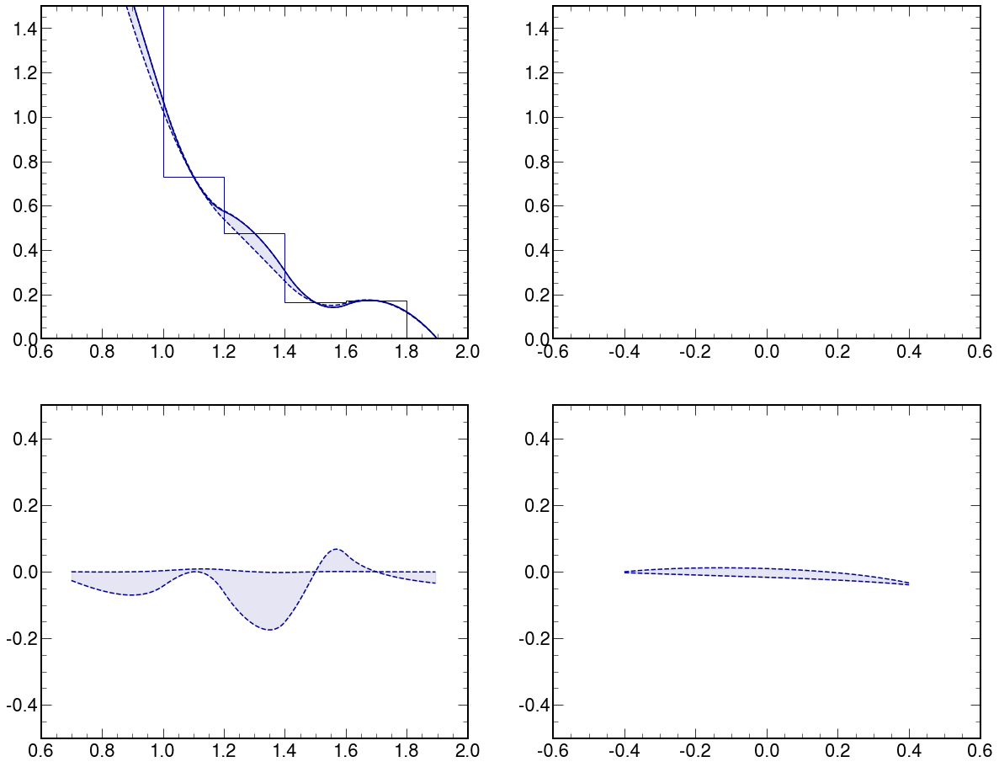

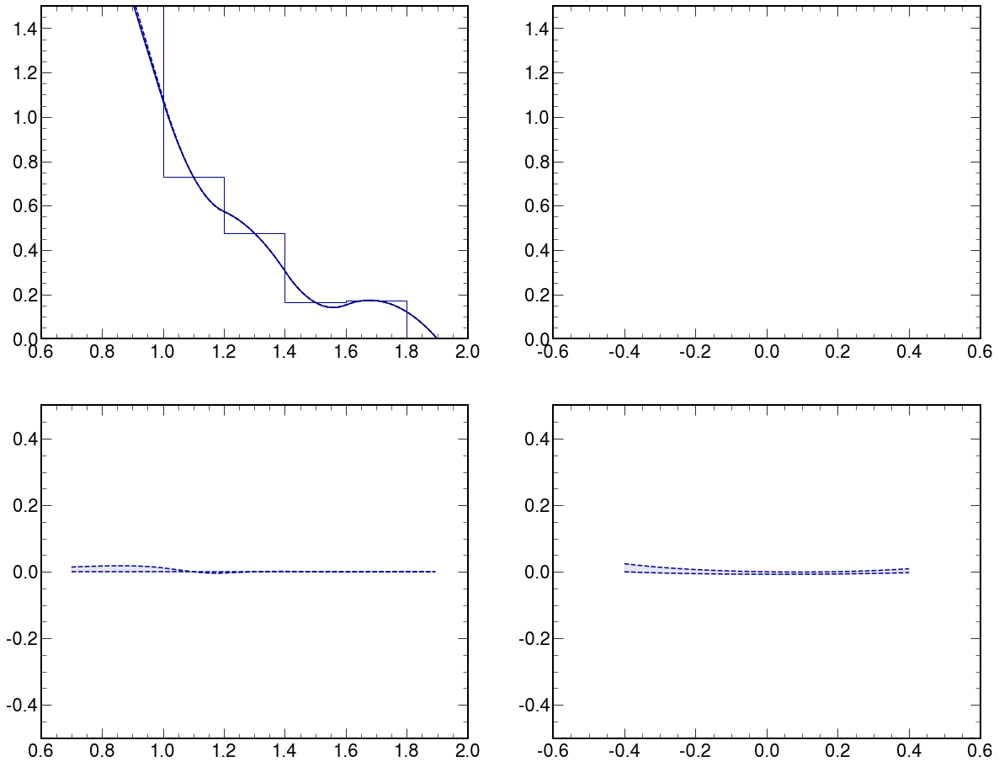

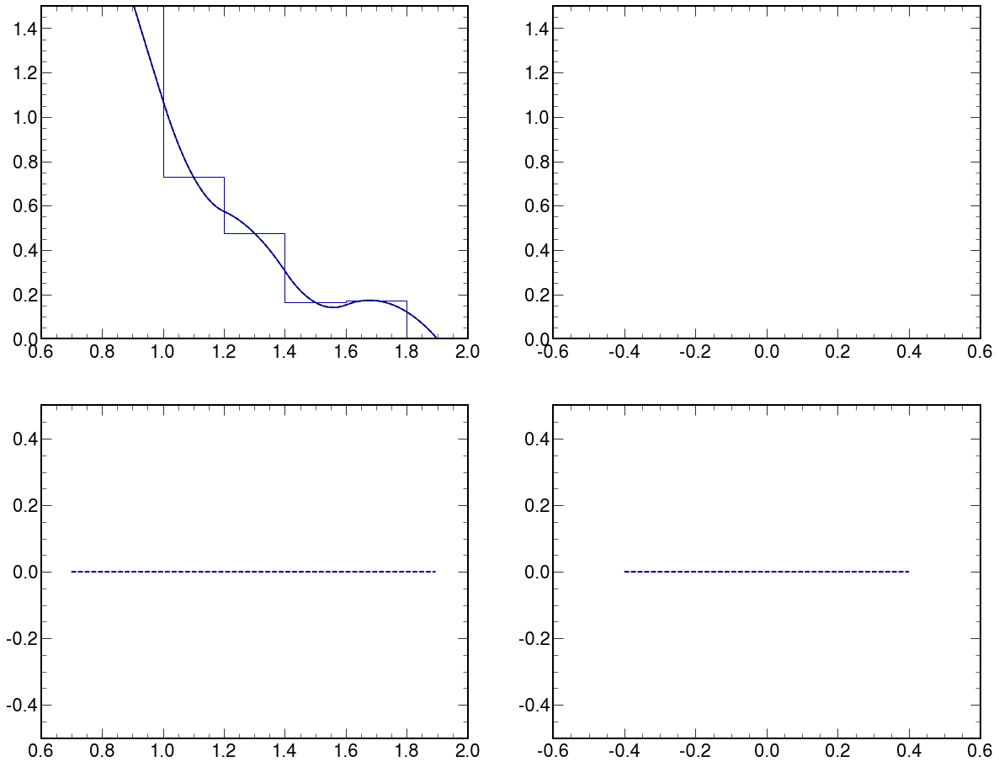

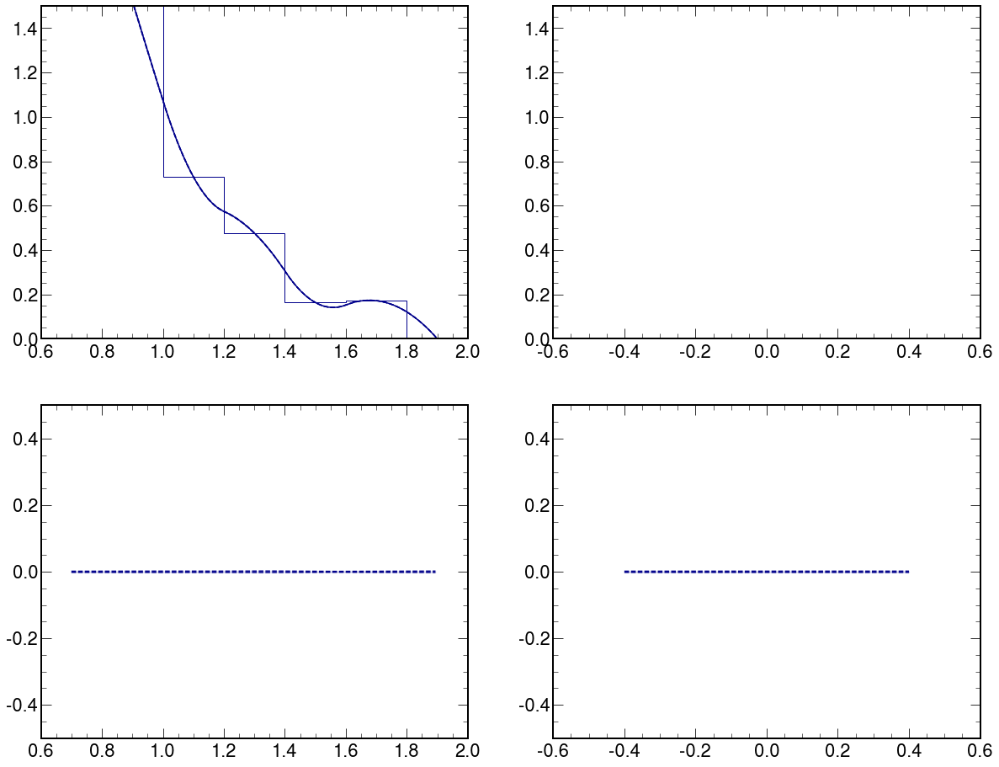

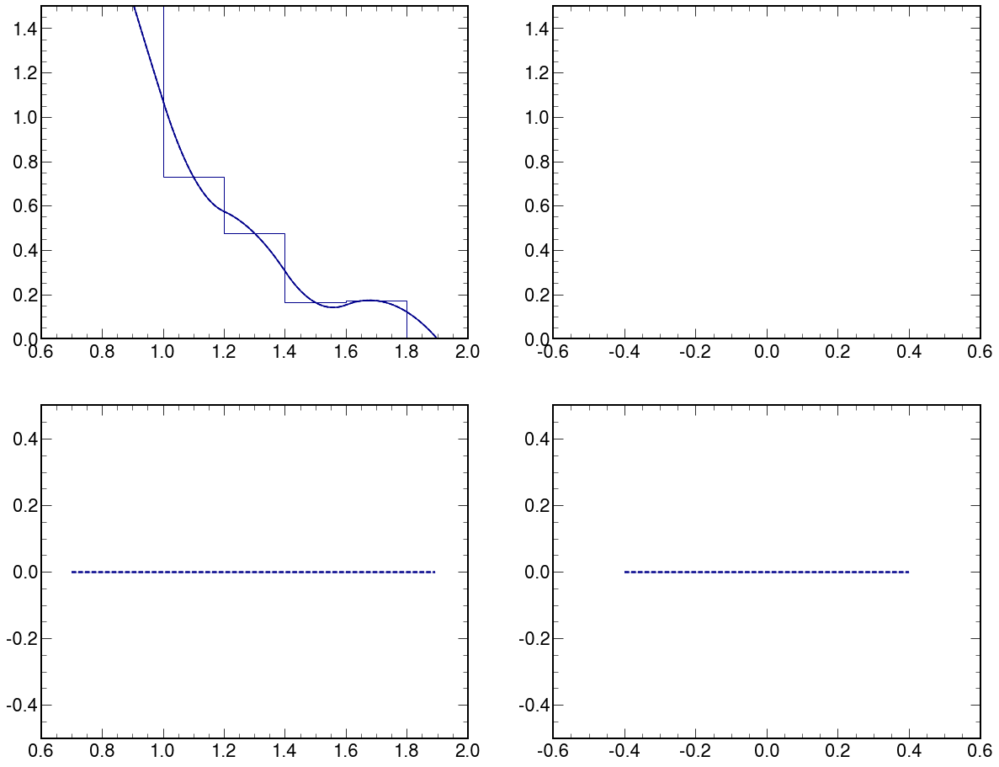

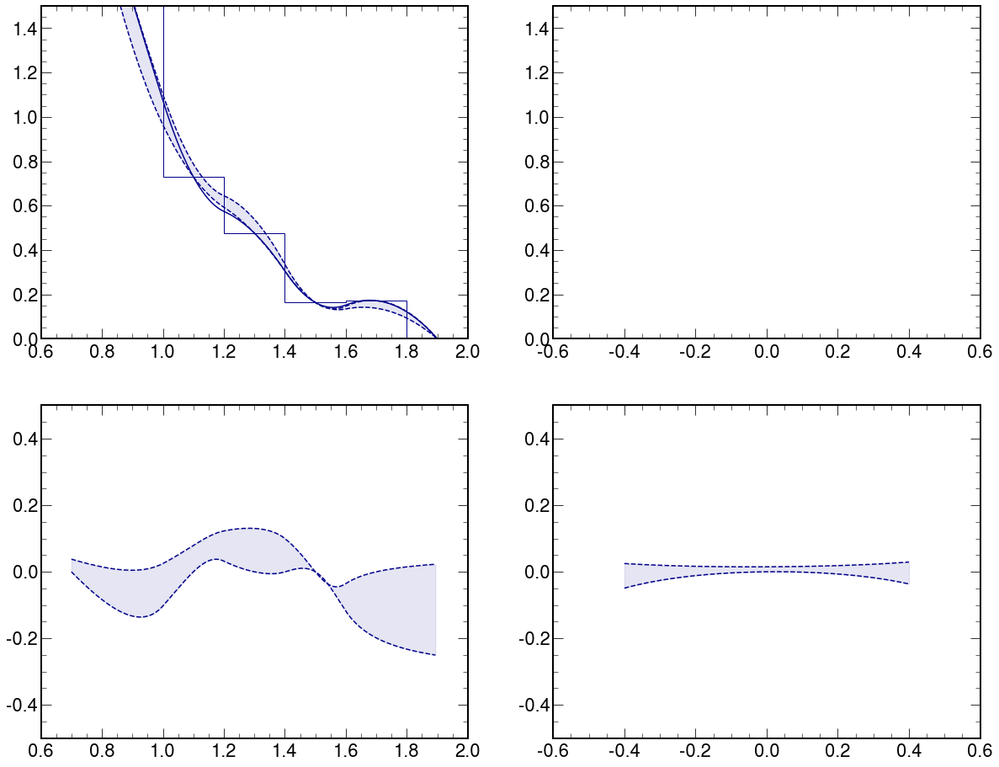

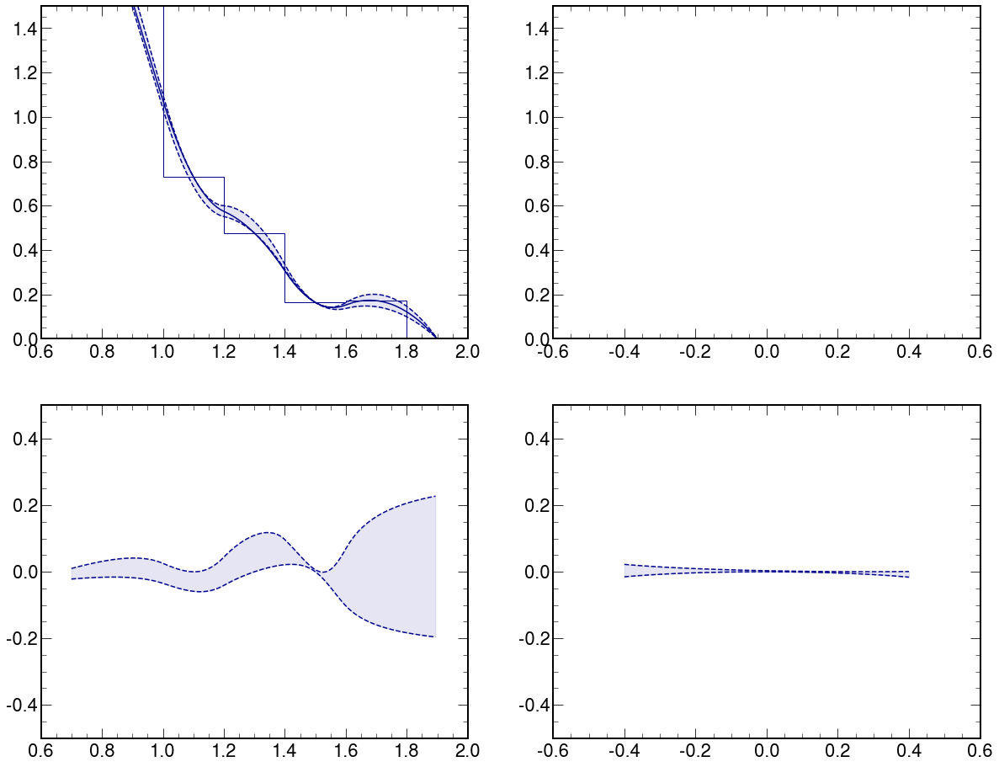

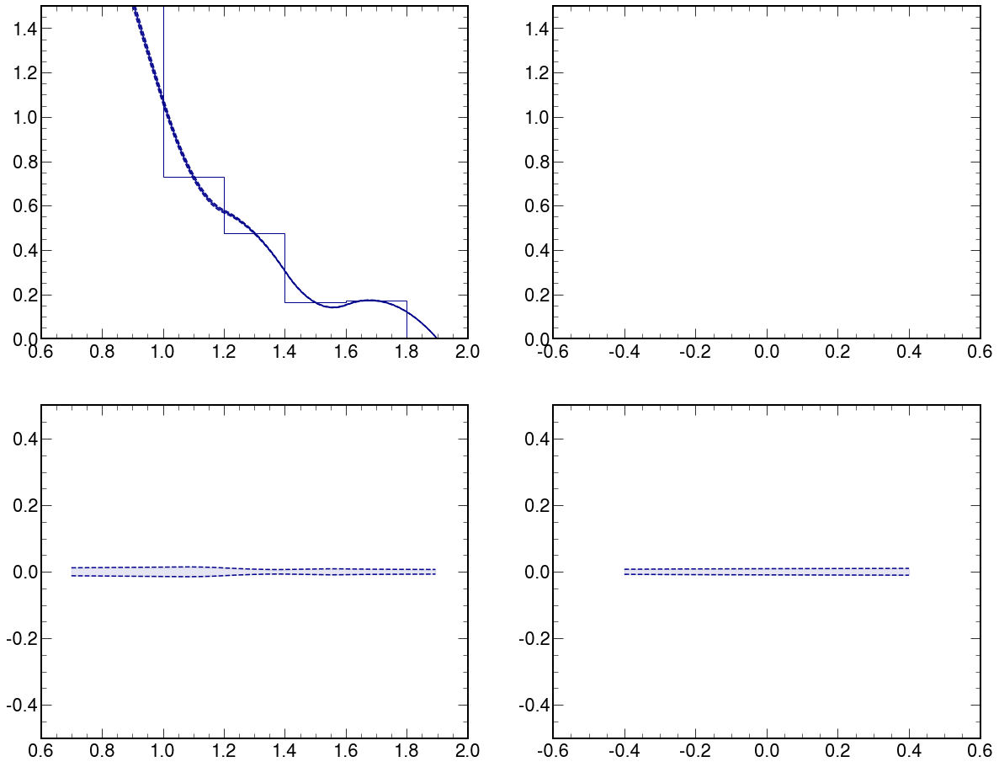

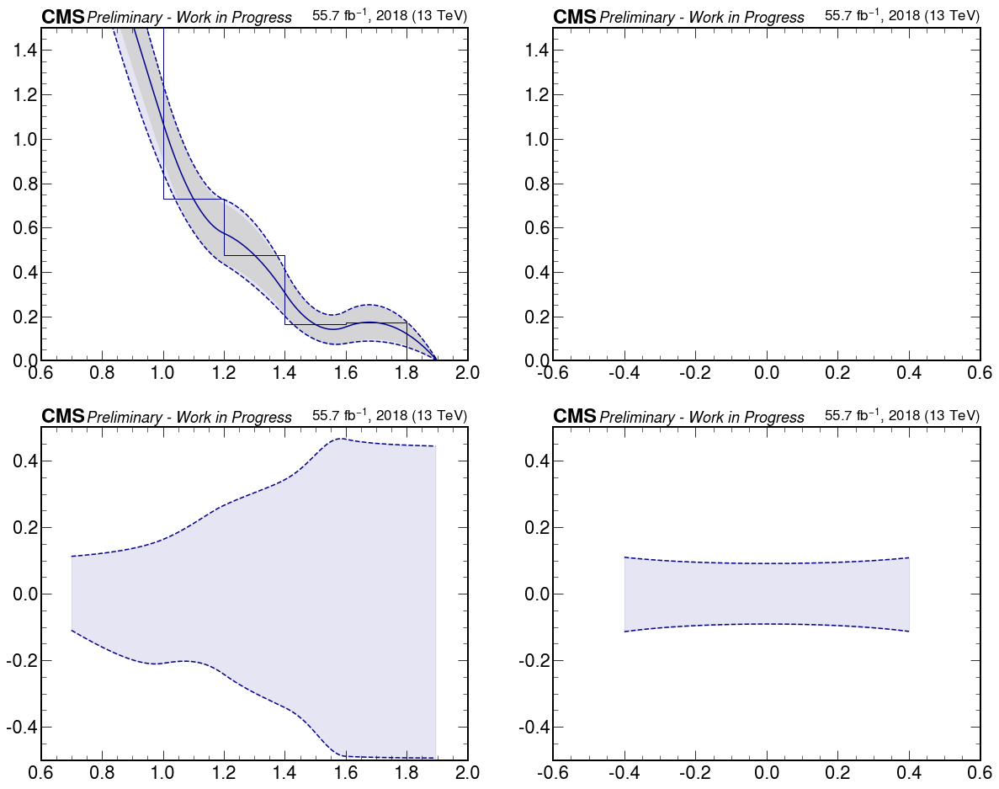

In [139]:
# ylim_ = (0.,0.3)
ylim_ = (0.,1.5)
ylim_ratio_ = (-0.50,0.50)
color_ = "darkblue"

label_ = ""
coupling_str_ = "ACW5e-7"
# coupling_str_ = "A0W1e-6"
if data_sample == '2017':
    if lepton_type == 'muon':
#         label_ = "GGToWW-AQGC-A0W1e-6"
#         label_ = "GGToWW-AQGC-muon-A0W1e-6"
        label_ = "GGToWW-AQGC-2017-muon-" + coupling_str_
    elif lepton_type == 'electron':
#         label_ = "GGToWW-AQGC-electron-A0W1e-6"
        label_ = "GGToWW-AQGC-2017-electron-" + coupling_str_
if data_sample == '2018':
    if lepton_type == 'muon':
        label_ = "GGToWW-AQGC-2018-muon-" + coupling_str_
    elif lepton_type == 'electron':
        label_ = "GGToWW-AQGC-2018-electron-" + coupling_str_
    
counts[ label_ ], err[ label_ ], bins[ label_ ], max_variations_total[ label_ ], min_variations_total[ label_ ] = plot_total_systematic(
#     df_dict=df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat,
#     weights_dict=weights_sig_plus_mix_categories_concat,
    df_dict=df_signals_protons_multiRP_sig_plus_mix_All_selected_events,
    weights_dict=weights_sig_plus_mix_All,
    lepton_type=lepton_type,
    label=label_,
    ylim=ylim_,
    ylim_ratio=ylim_ratio_,
    color=color_
    )
    
if save_figures:
    if lepton_type == 'muon':
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-ACW5e-7-Muon_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-ACW5e-7-Muon_2018.png", bbox_inches='tight' )
    if lepton_type == 'electron':
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-ACW5e-7-Electron_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-ACW5e-7-Electron_2018.png", bbox_inches='tight' )

GGToWW-AQGC-2018-muon-ACW1e-6
R_MWW_MX
_jes_up
_jes_up
nom
_jes_dw
_jes_dw
nom
[2.05122836 1.92585137 1.10380893 1.03557932 0.84856981 0.37455298
 0.16639002]
[2.05122836 1.92585137 1.10380893 1.03557932 0.84856981 0.37455298
 0.12995342]
0      0.000000e+00
1     -2.173290e-07
2     -4.192097e-07
3     -6.061110e-07
4     -7.784556e-07
           ...     
195    2.087903e-01
196    2.257517e-01
197    2.433830e-01
198    2.616195e-01
199    2.803819e-01
Length: 200, dtype: float64 0.014854148278400087
0      0.0
1      0.0
2      0.0
3      0.0
4      0.0
      ... 
195    0.0
196    0.0
197    0.0
198    0.0
199    0.0
Length: 200, dtype: float64 -4.2975835545046034e-17
Diff_YWW_YX
_jes_up
_jes_up
nom
_jes_dw
_jes_dw
nom
[2.2176545  3.97969312 3.91251673]
[2.2176545  3.8797113  3.84897149]
0      0.000000
1     -0.000304
2     -0.000595
3     -0.000874
4     -0.001142
         ...   
195    0.026083
196    0.026606
197    0.027137
198    0.027676
199    0.028223
Length: 200, dtype: f

0      0.036067
1      0.035281
2      0.034520
3      0.033781
4      0.033064
         ...   
195    0.000040
196    0.000028
197    0.000018
198    0.000009
199    0.000000
Length: 200, dtype: float64 0.008943676361868077
0     -0.022198
1     -0.021490
2     -0.020806
3     -0.020144
4     -0.019504
         ...   
195   -0.011452
196   -0.011729
197   -0.012010
198   -0.012295
199   -0.012586
Length: 200, dtype: float64 -0.0050477025144280915
GGToWW-AQGC-2018-muon-ACW1e-6
R_MWW_MX
_nom
_nom
proton_eff_up
_nom
_nom
proton_eff_dw
[2.07823171 1.94782507 1.11875714 1.04553358 0.85339706 0.37613498
 0.13066948]
[2.02422502 1.90387767 1.08886071 1.02562506 0.84374256 0.37297098
 0.12923737]
0      0.013164
1      0.013044
2      0.012929
3      0.012820
4      0.012715
         ...   
195    0.004864
196    0.005007
197    0.005162
198    0.005330
199    0.005510
Length: 200, dtype: float64 0.008817589703875002
0     -0.013164
1     -0.013044
2     -0.012929
3     -0.012820
4     -0.012

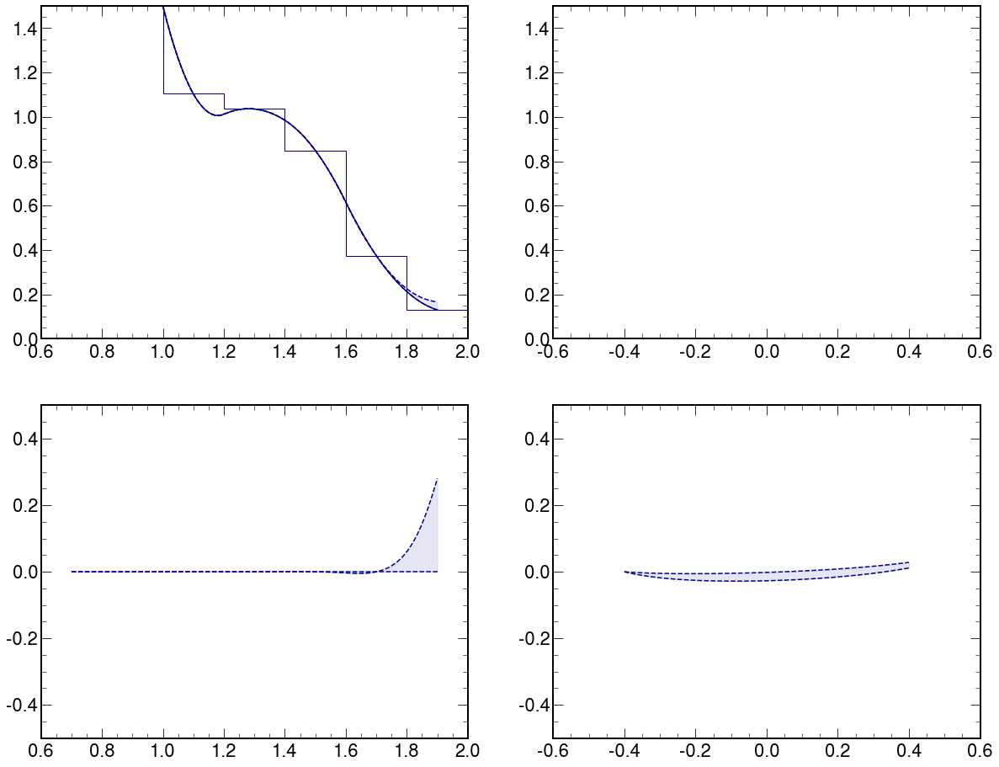

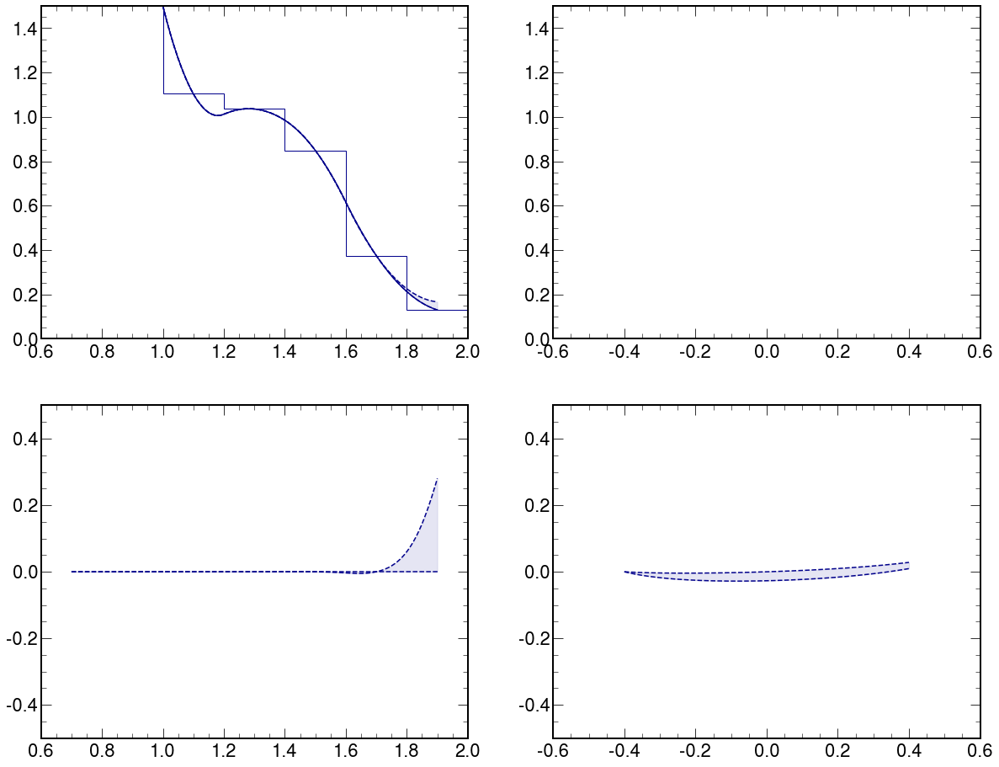

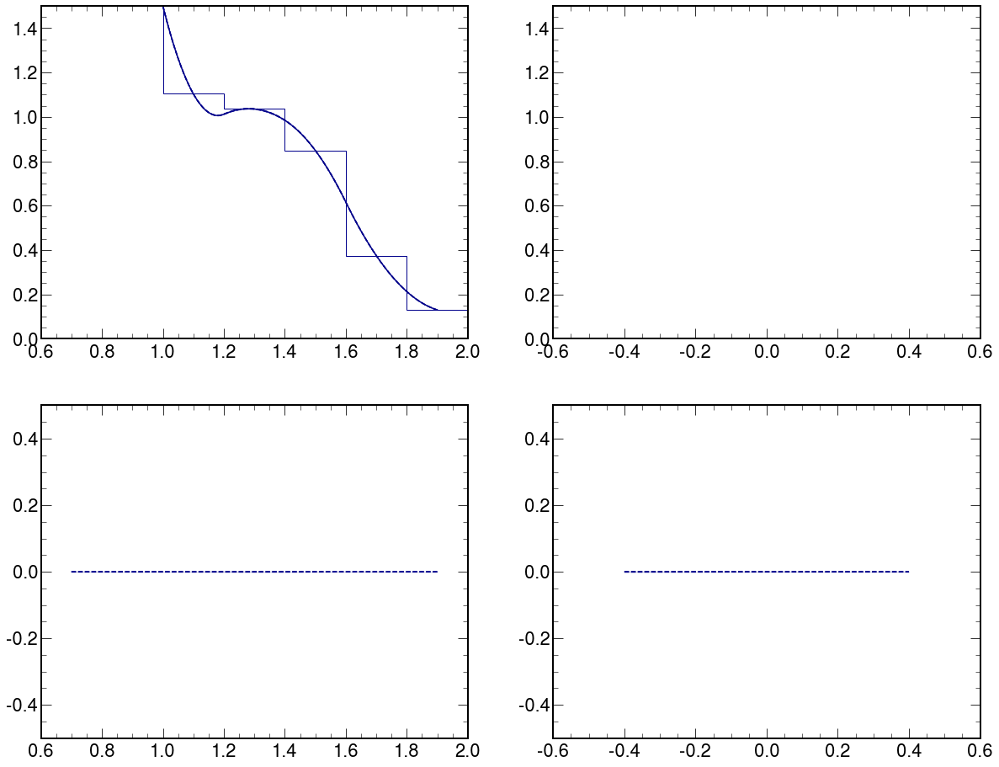

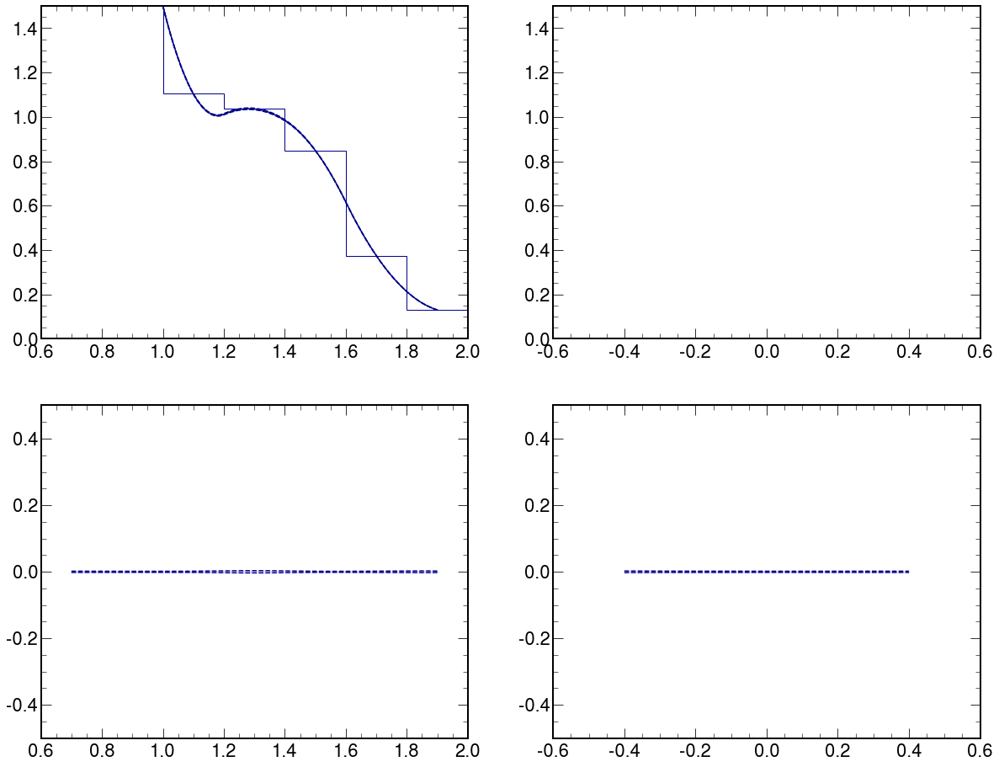

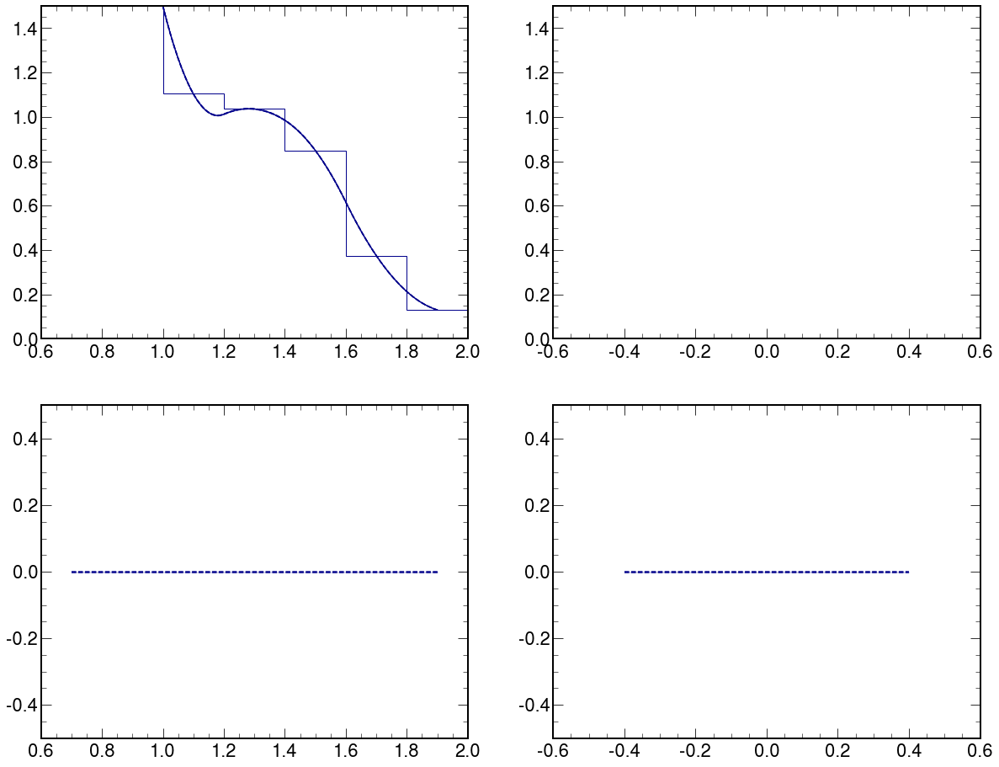

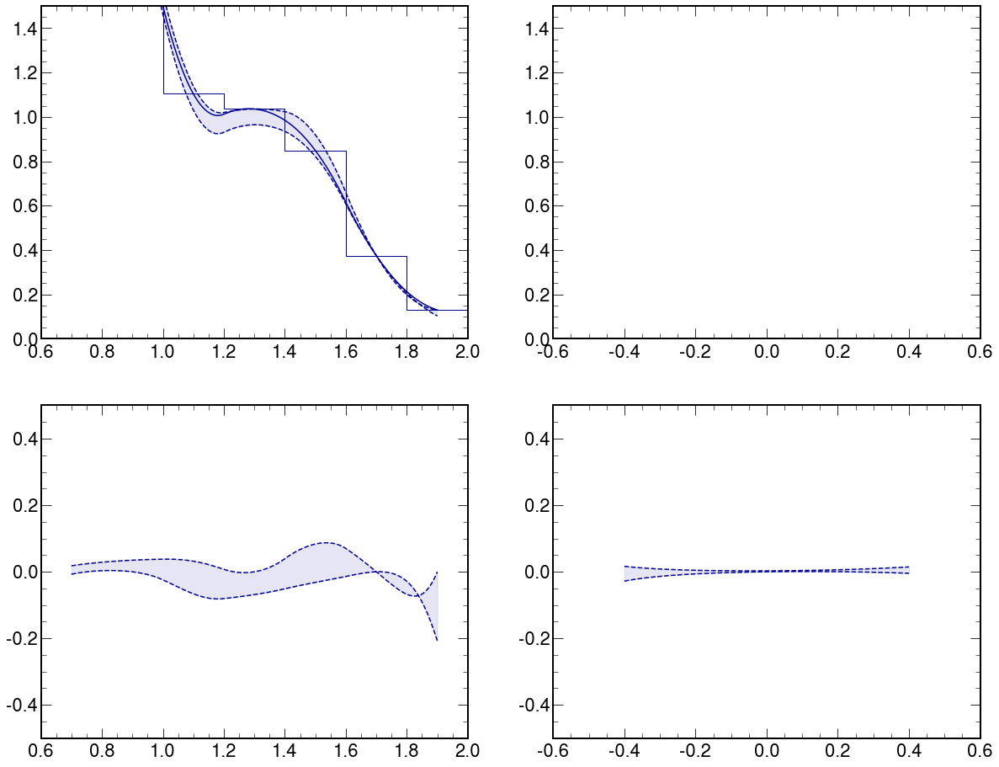

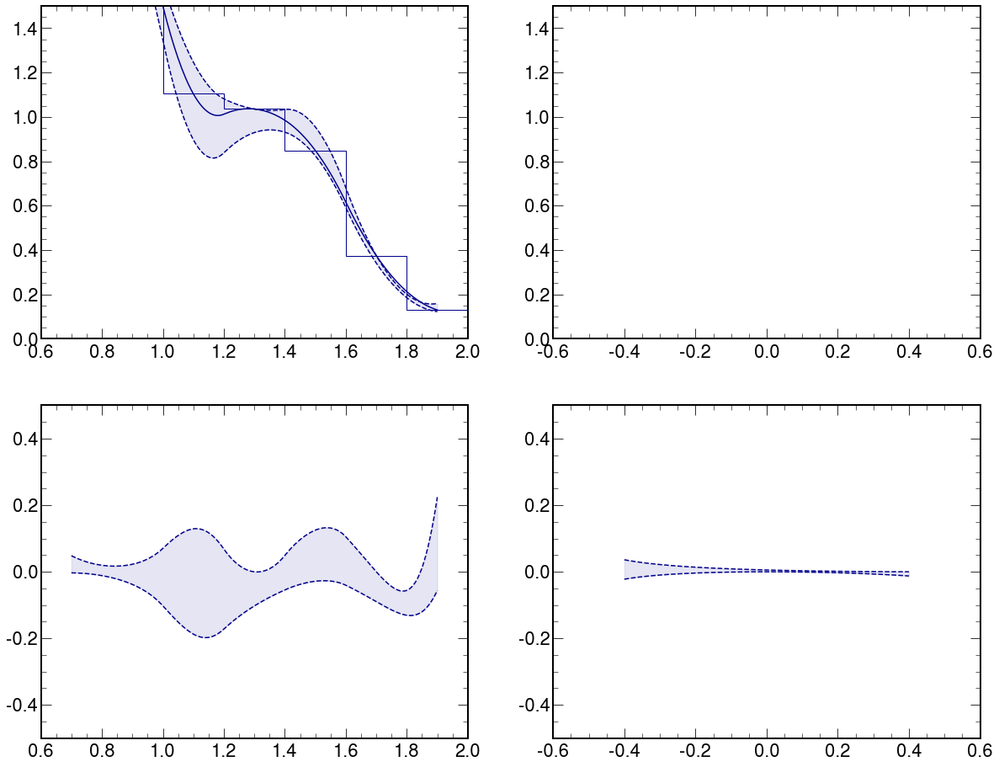

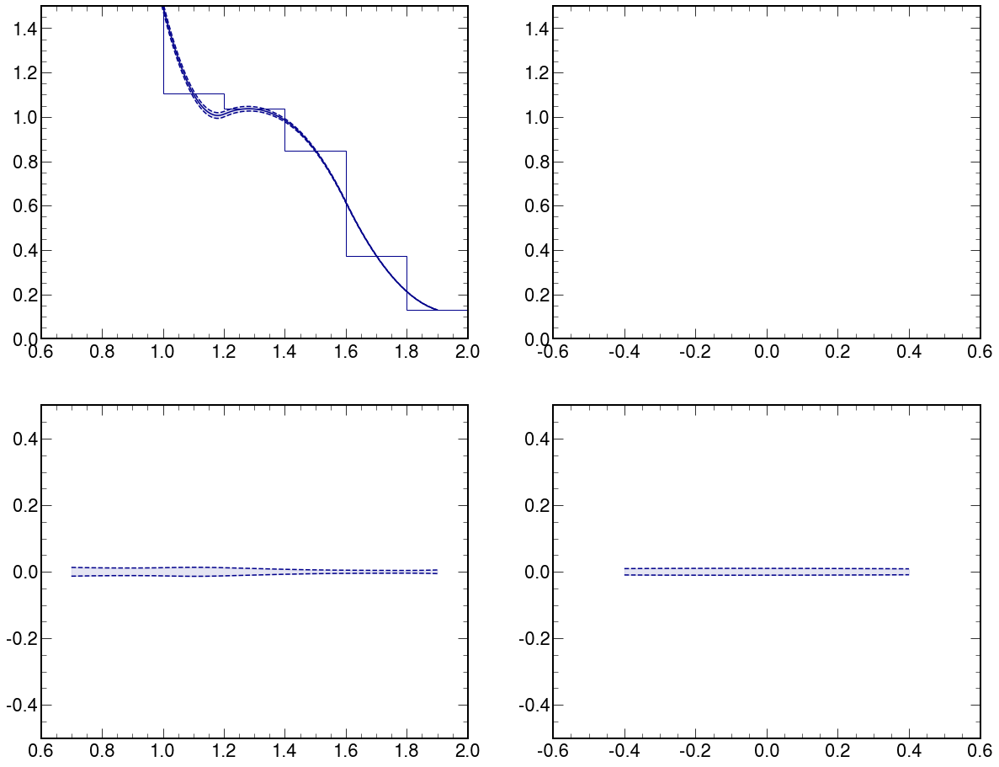

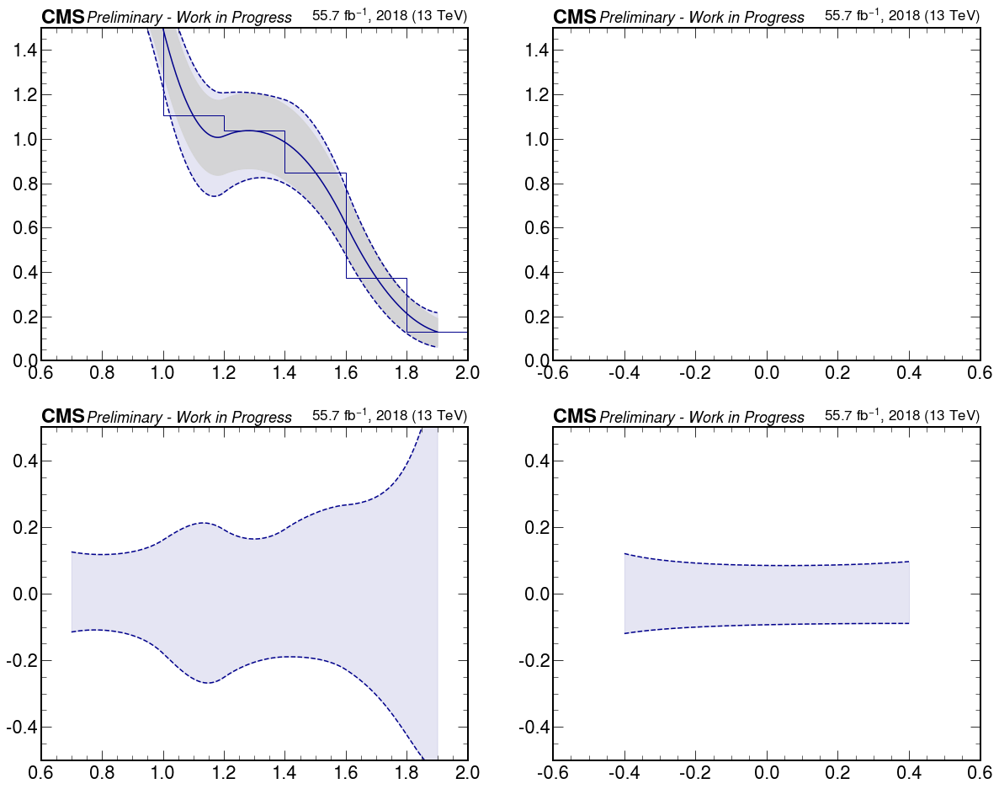

In [140]:
label_ = ""
coupling_str_ = "ACW1e-6"
# coupling_str_ = "A0W2e-6"
if data_sample == '2017':
    if lepton_type == 'muon':
#         label_ = "GGToWW-AQGC-A0W2e-6"
#         label_ = "GGToWW-AQGC-muon-A0W2e-6"
        label_ = "GGToWW-AQGC-2017-muon-" + coupling_str_
    elif lepton_type == 'electron':
#         label_ = "GGToWW-AQGC-electron-A0W2e-6"
        label_ = "GGToWW-AQGC-2017-electron-" + coupling_str_
if data_sample == '2018':
    if lepton_type == 'muon':
        label_ = "GGToWW-AQGC-2018-muon-" + coupling_str_
    elif lepton_type == 'electron':
        label_ = "GGToWW-AQGC-2018-electron-" + coupling_str_

# ylim_ = (0.,0.5)
# ylim_ = (0.,1.)
ylim_ = (0.,1.5)
counts[ label_ ], err[ label_ ], bins[ label_ ], max_variations_total[ label_ ], min_variations_total[ label_ ] = plot_total_systematic(
#     df_dict=df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat,
#     weights_dict=weights_sig_plus_mix_categories_concat,
    df_dict=df_signals_protons_multiRP_sig_plus_mix_All_selected_events,
    weights_dict=weights_sig_plus_mix_All,
    lepton_type=lepton_type,
    label=label_,
    ylim=ylim_,
    ylim_ratio=ylim_ratio_,
    color=color_
    )
    
if save_figures:
    if lepton_type == 'muon':
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-ACW1e-6-Muon_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-ACW1e-6-Muon_2018.png", bbox_inches='tight' )
    if lepton_type == 'electron':
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-ACW1e-6-Electron_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-ACW1e-6-Electron_2018.png", bbox_inches='tight' )

GGToWW-AQGC-2018-muon-ACW2e-6
R_MWW_MX
_jes_up
_jes_up
nom
_jes_dw
_jes_dw
nom
[2.73537644 3.56072903 3.02988607 1.93432352 1.97161663 0.57200317
 0.39834081]
[2.69956975 3.56031396 3.02988607 1.84413562 1.77430138 0.57200317
 0.39834081]
0      1.623503e-16
1     -4.885375e-05
2     -9.317657e-05
3     -1.332402e-04
4     -1.692883e-04
           ...     
195   -4.913518e-02
196   -3.682458e-02
197   -2.444514e-02
198   -1.213200e-02
199    0.000000e+00
Length: 200, dtype: float64 0.009651968934702932
0     -0.013090
1     -0.012406
2     -0.011755
3     -0.011135
4     -0.010542
         ...   
195   -0.003849
196   -0.002884
197   -0.001915
198   -0.000950
199    0.000000
Length: 200, dtype: float64 -0.009001753012500413
Diff_YWW_YX
_jes_up
_jes_up
nom
_jes_dw
_jes_dw
nom
[4.76380382 7.65669245 6.34947898]
[4.43675873 7.52885177 6.2779267 ]
0      0.022403
1      0.021841
2      0.021295
3      0.020766
4      0.020252
         ...   
195    0.010437
196    0.010669
197    0.010906


GGToWW-AQGC-2018-muon-ACW2e-6
R_MWW_MX
[2.73537644 3.56072903 3.02988607 1.93432352 1.77430138 0.57200317
 0.39834081]
[3.00354819 3.86664827 3.335118   2.17626402 2.01246802 0.70579328
 0.5147813 ]
[2.46720469 3.25480979 2.72465414 1.69238303 1.53613475 0.43821306
 0.28190033]
[3.04997424 3.89705891 3.37659536 2.17990071 2.15192434 0.72667543
 0.51892141]
[2.40554007 3.25152832 2.64671027 1.66639117 1.52267589 0.39866368
 0.28189825]
0      0.115011
1      0.113247
2      0.111598
3      0.110057
4      0.108616
         ...   
195    0.317467
196    0.313931
197    0.310258
198    0.306501
199    0.302707
Length: 200, dtype: float64 0.17391079456943806
0     -0.120582
1     -0.117566
2     -0.114751
3     -0.112122
4     -0.109668
         ...   
195   -0.353551
196   -0.338156
197   -0.322713
198   -0.307388
199   -0.292319
Length: 200, dtype: float64 -0.17743560337553205
Diff_YWW_YX
[4.65941824 7.63531506 6.2779267 ]
[5.03813982 8.10096194 6.70654941]
[4.28069666 7.16966819 5.84930

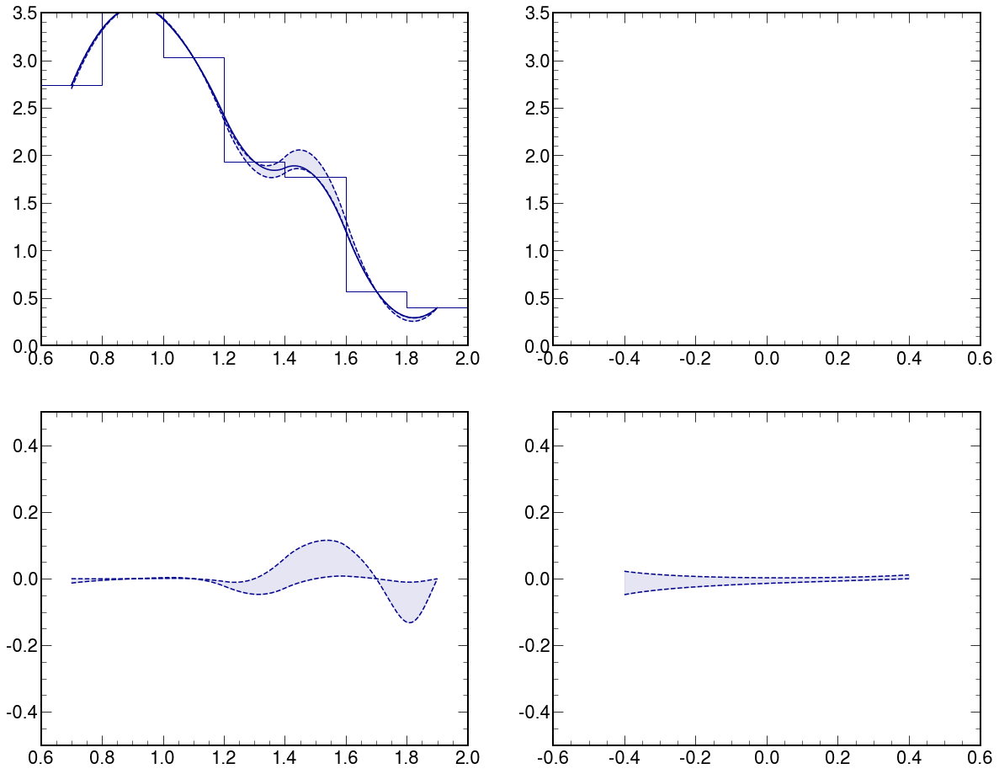

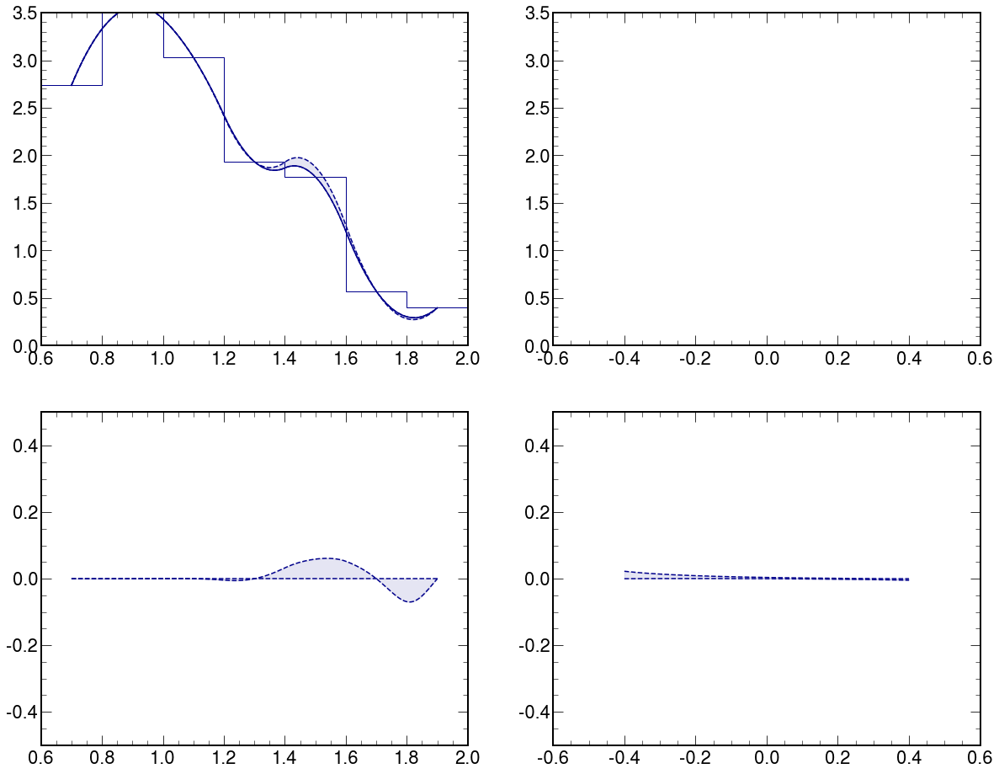

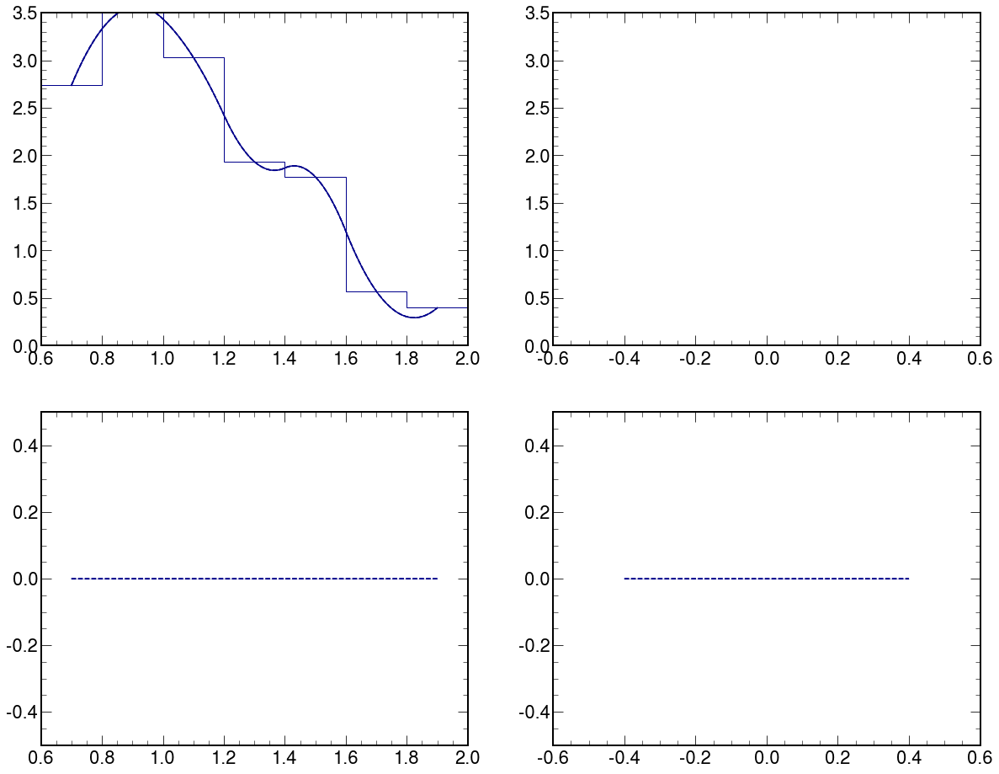

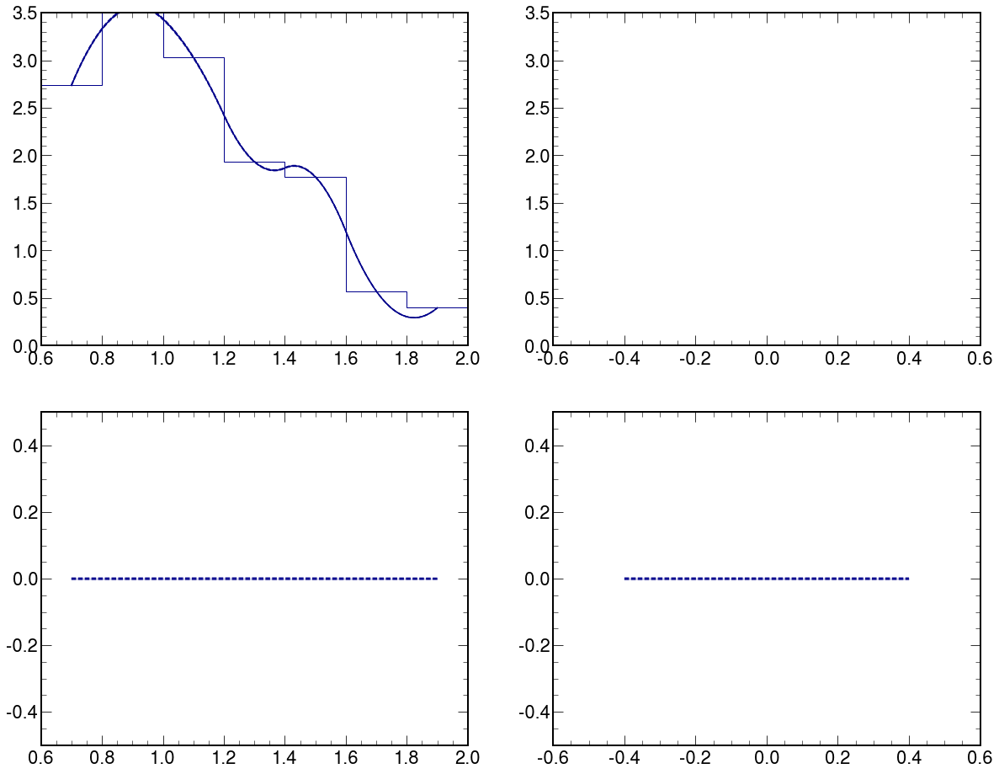

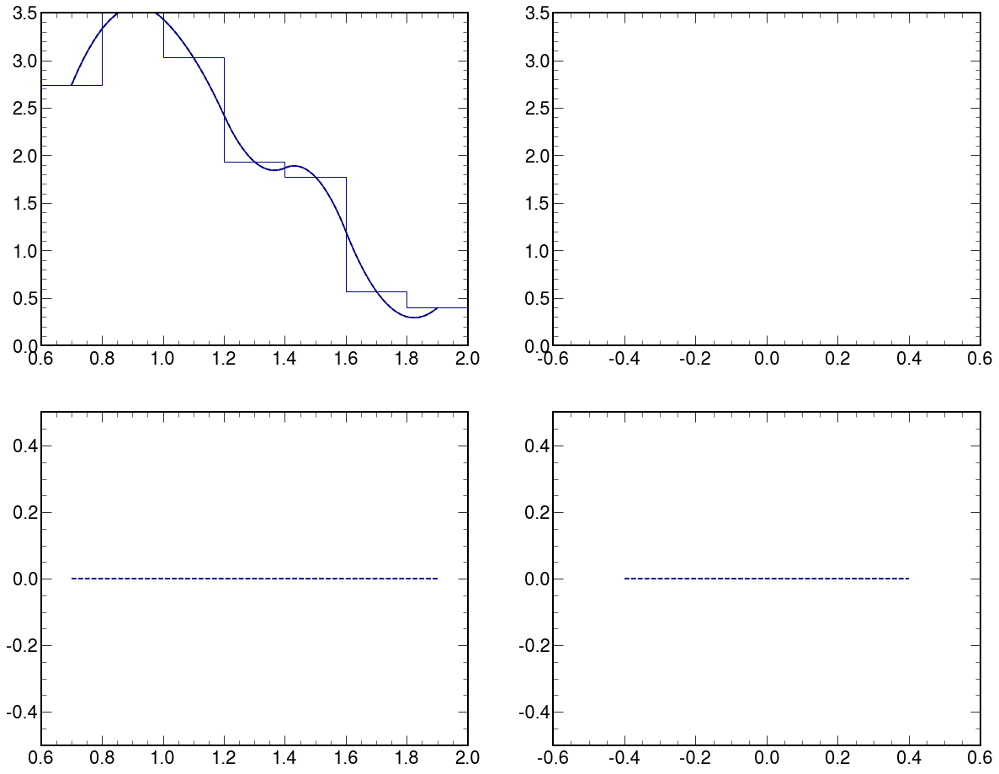

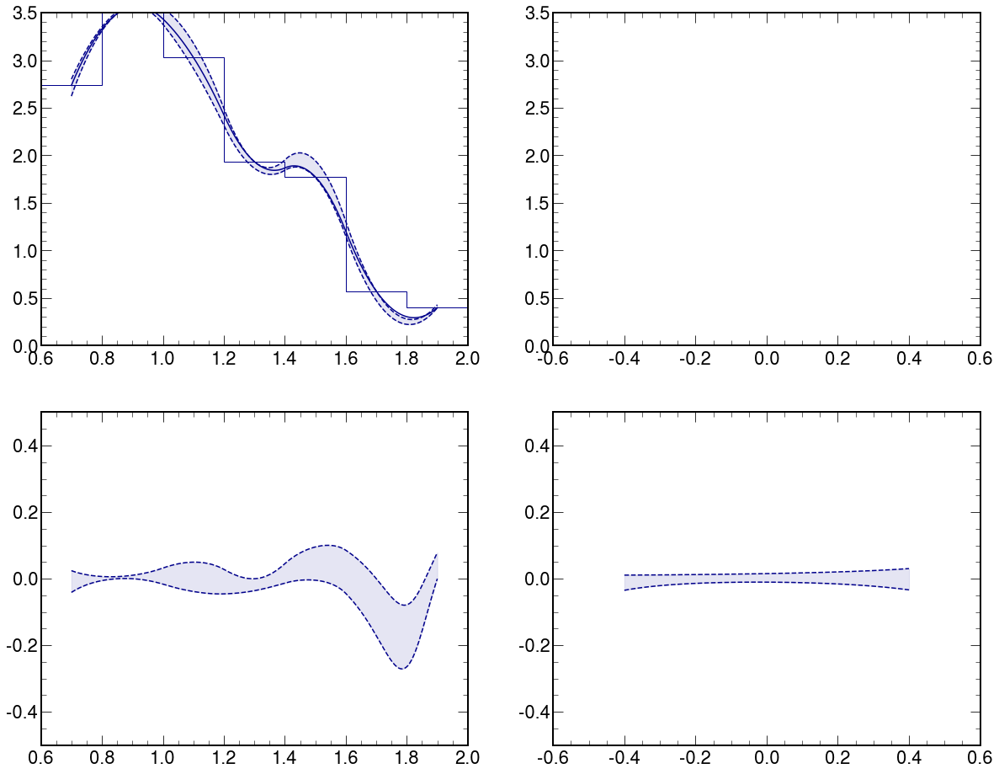

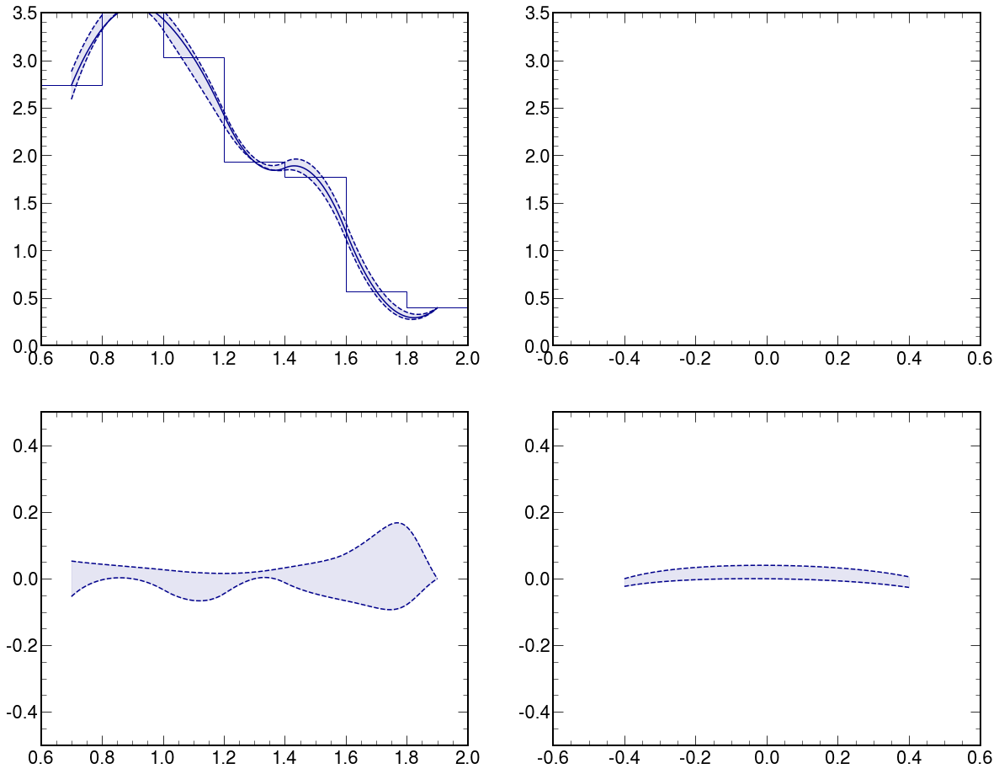

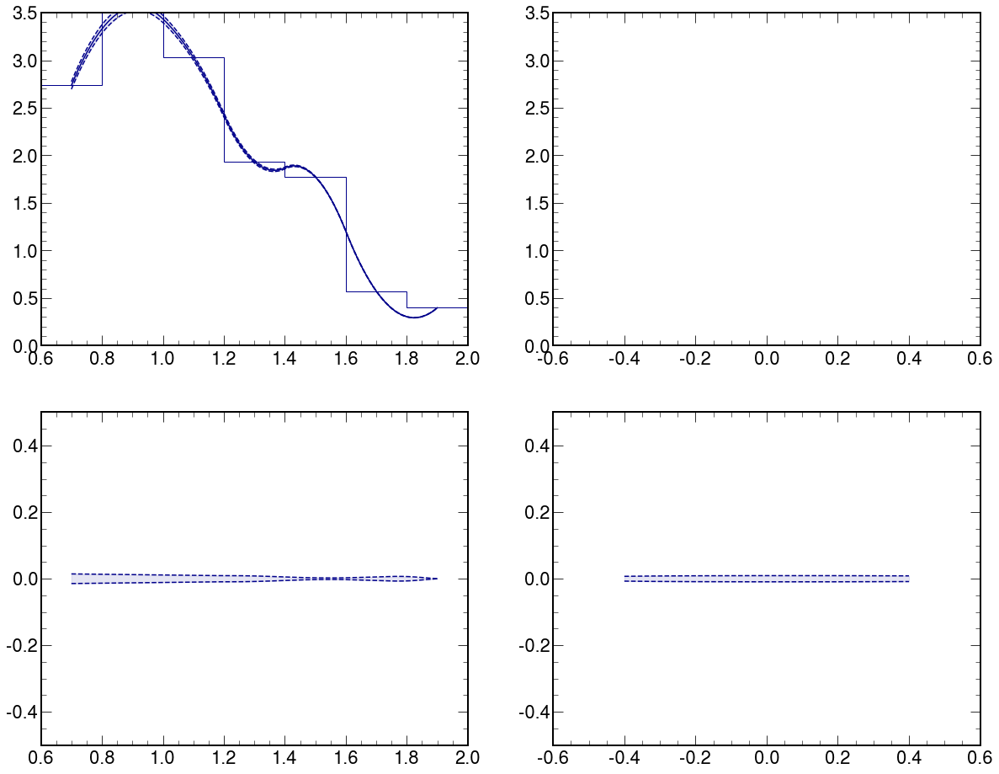

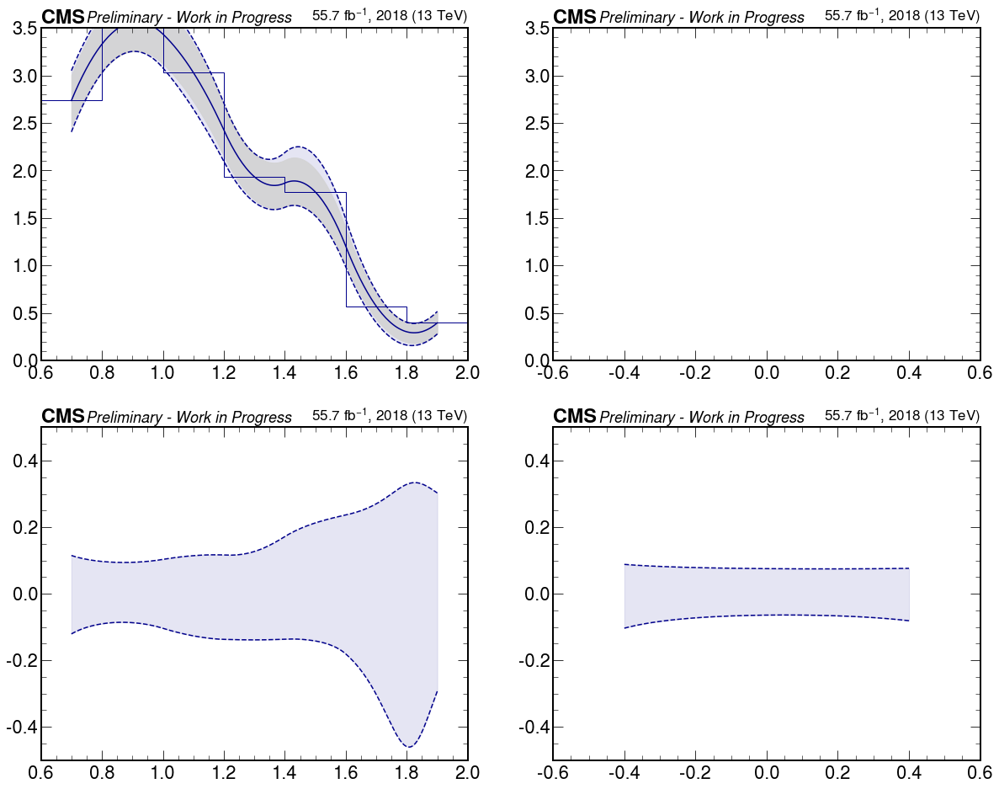

In [141]:
label_ = ""
coupling_str_ = "ACW2e-6"
# coupling_str_ = "A0W2e-6"
if data_sample == '2017':
    if lepton_type == 'muon':
#         label_ = "GGToWW-AQGC-A0W2e-6"
#         label_ = "GGToWW-AQGC-muon-A0W2e-6"
        label_ = "GGToWW-AQGC-2017-muon-" + coupling_str_
    elif lepton_type == 'electron':
#         label_ = "GGToWW-AQGC-electron-A0W2e-6"
        label_ = "GGToWW-AQGC-2017-electron-" + coupling_str_
if data_sample == '2018':
    if lepton_type == 'muon':
        label_ = "GGToWW-AQGC-2018-muon-" + coupling_str_
    elif lepton_type == 'electron':
        label_ = "GGToWW-AQGC-2018-electron-" + coupling_str_

# ylim_ = (0.,0.5)
# ylim_ = (0.,1.)
ylim_ = (0.,3.5)
counts[ label_ ], err[ label_ ], bins[ label_ ], max_variations_total[ label_ ], min_variations_total[ label_ ] = plot_total_systematic(
#     df_dict=df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat,
#     weights_dict=weights_sig_plus_mix_categories_concat,
    df_dict=df_signals_protons_multiRP_sig_plus_mix_All_selected_events,
    weights_dict=weights_sig_plus_mix_All,
    lepton_type=lepton_type,
    label=label_,
    ylim=ylim_,
    ylim_ratio=ylim_ratio_,
    color=color_
    )
    
if save_figures:
    if lepton_type == 'muon':
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-ACW2e-6-Muon_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-ACW2e-6-Muon_2018.png", bbox_inches='tight' )
    if lepton_type == 'electron':
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-ACW2e-6-Electron_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-ACW2e-6-Electron_2018.png", bbox_inches='tight' )

GGToWW-AQGC-2018-muon-ACW5e-6
R_MWW_MX
_jes_up
_jes_up
nom
_jes_dw
_jes_dw
nom
[ 6.6575372  10.57808173 10.74660431 11.87176062  9.20560737  7.76716236
  4.46872548]
[ 6.65107987 10.44521761 10.51898942 11.80546565  9.19592298  7.71907162
  4.13389532]
0      9.708695e-04
1      1.669420e-03
2      2.322956e-03
3      2.935977e-03
4      3.512416e-03
           ...     
195    5.633455e-03
196    4.401697e-03
197    3.059706e-03
198    1.596620e-03
199   -3.180069e-15
Length: 200, dtype: float64 0.009551203353280751
0     -2.670780e-16
1      2.044812e-04
2      3.861806e-04
3      5.471134e-04
4      6.890301e-04
           ...     
195   -5.177141e-02
196   -5.692313e-02
197   -6.247200e-02
198   -6.845813e-02
199   -7.492744e-02
Length: 200, dtype: float64 -0.0028569506287983103
Diff_YWW_YX
_jes_up
_jes_up
nom
_jes_dw
_jes_dw
nom
[15.43279659 35.2496525  25.5707154 ]
[15.02512067 34.94500417 25.24500761]
0      0.010368
1      0.009975
2      0.009603
3      0.009250
4      0.008915

0      0.011401
1      0.011469
2      0.011530
3      0.011585
4      0.011634
         ...   
195    0.001007
196    0.000884
197    0.000754
198    0.000616
199    0.000469
Length: 200, dtype: float64 0.007173081427815831
0     -0.011401
1     -0.011469
2     -0.011530
3     -0.011585
4     -0.011634
         ...   
195   -0.001007
196   -0.000884
197   -0.000754
198   -0.000616
199   -0.000469
Length: 200, dtype: float64 -0.007173081427812463
Diff_YWW_YX
_nom
_nom
proton_eff_up
_nom
_nom
proton_eff_dw
[15.3718566  35.41631089 25.47520003]
[15.1769949 34.9714837 25.1577818]
0      0.006379
1      0.006377
2      0.006375
3      0.006374
4      0.006372
         ...   
195    0.006273
196    0.006272
197    0.006271
198    0.006270
199    0.006269
Length: 200, dtype: float64 0.00632005722143679
0     -0.006379
1     -0.006377
2     -0.006375
3     -0.006374
4     -0.006372
         ...   
195   -0.006273
196   -0.006272
197   -0.006271
198   -0.006270
199   -0.006269
Length: 200, dty

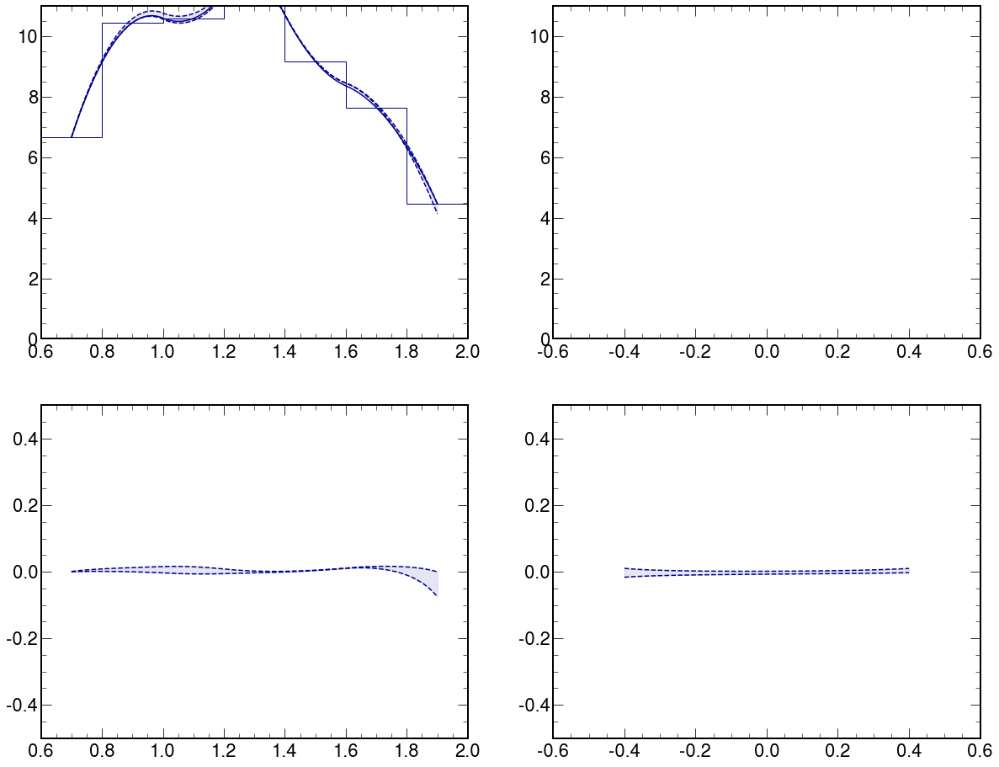

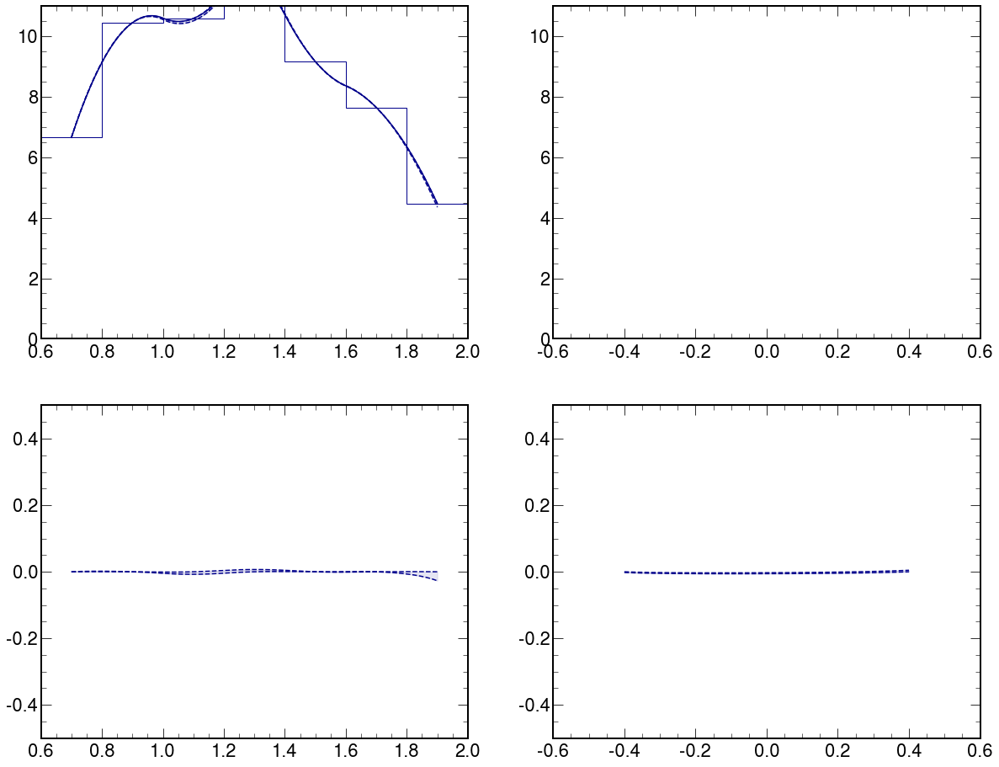

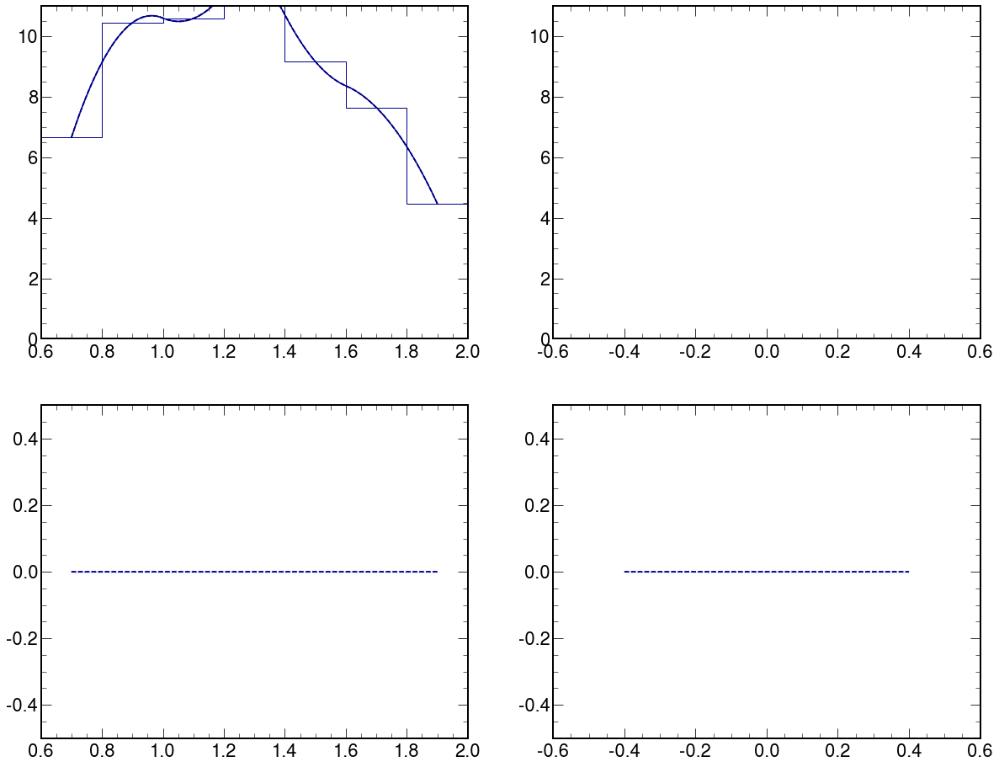

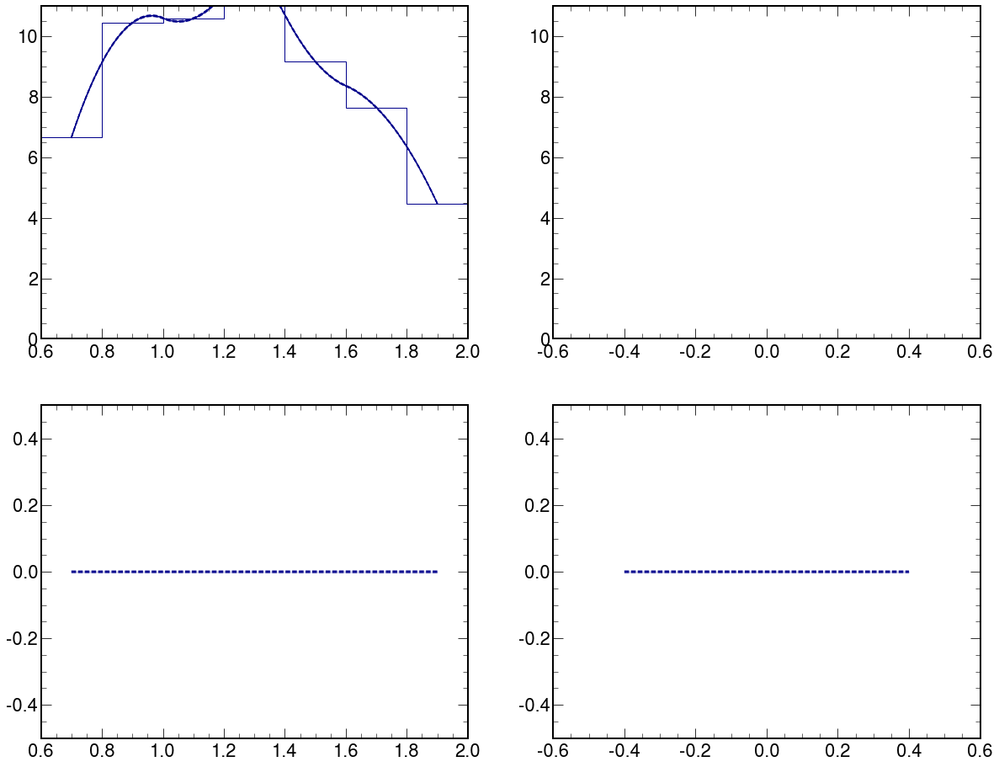

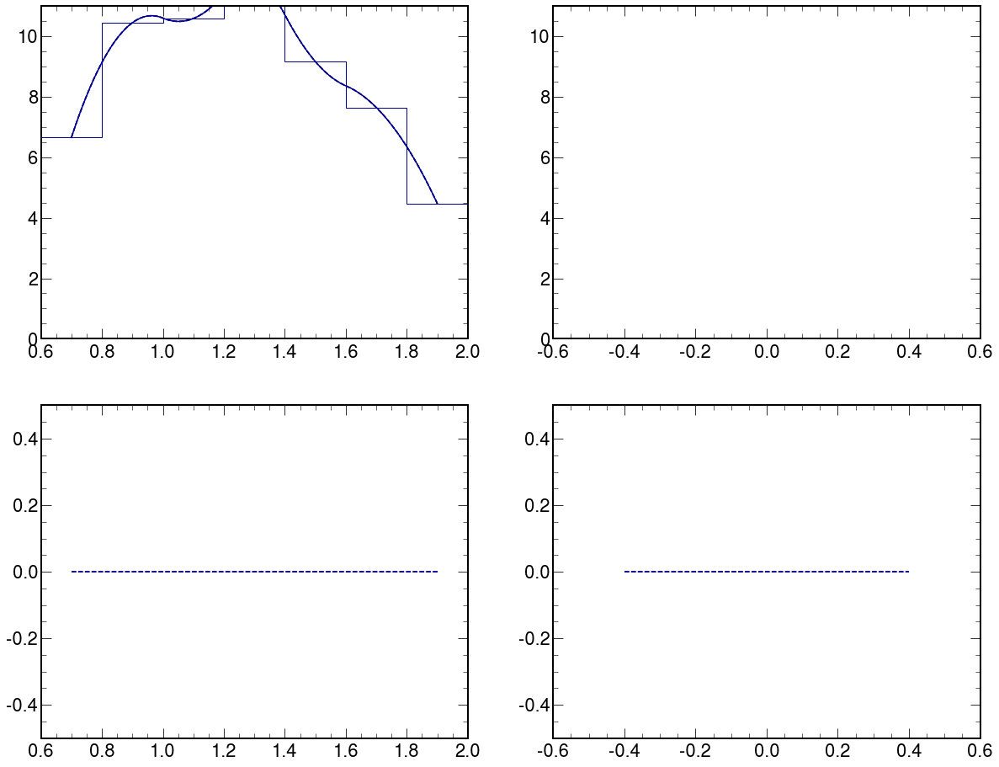

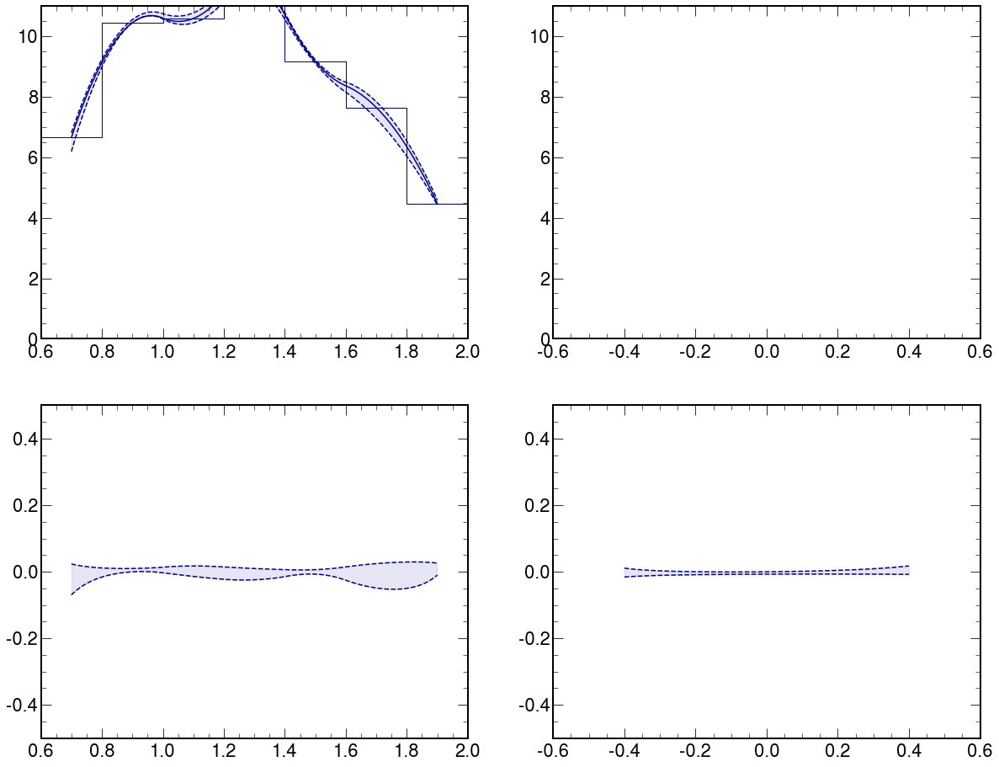

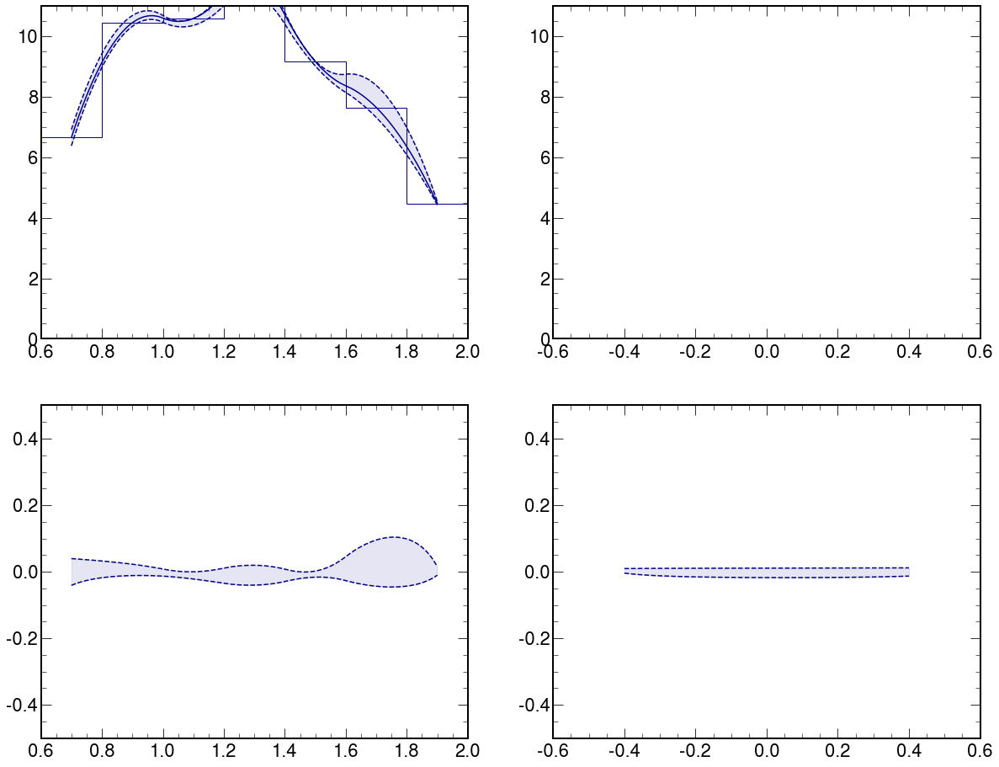

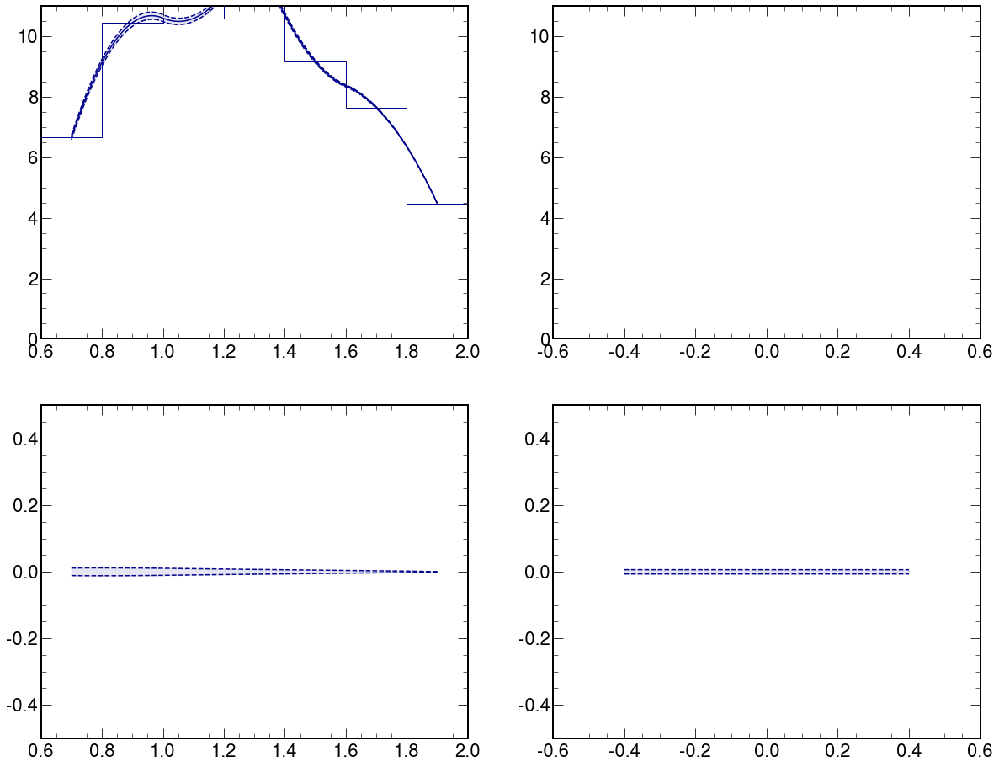

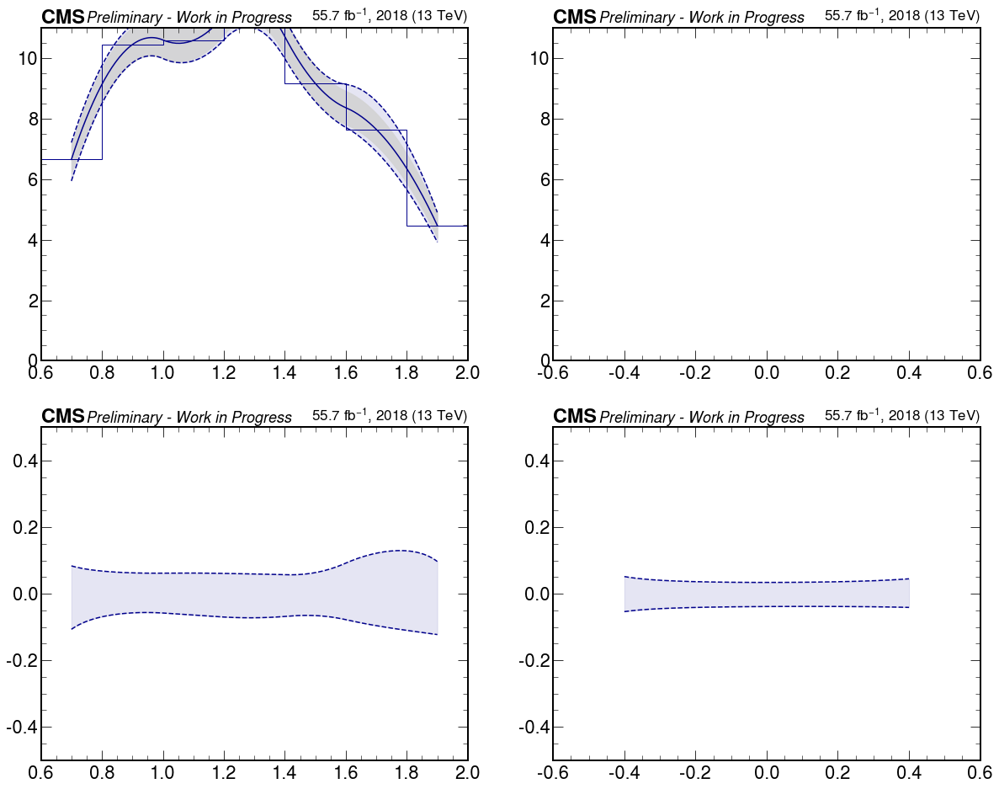

In [142]:
label_ = ""
coupling_str_ = "ACW5e-6"
# coupling_str_ = "A0W2e-6"
if data_sample == '2017':
    if lepton_type == 'muon':
#         label_ = "GGToWW-AQGC-A0W2e-6"
#         label_ = "GGToWW-AQGC-muon-A0W2e-6"
        label_ = "GGToWW-AQGC-2017-muon-" + coupling_str_
    elif lepton_type == 'electron':
#         label_ = "GGToWW-AQGC-electron-A0W2e-6"
        label_ = "GGToWW-AQGC-2017-electron-" + coupling_str_
if data_sample == '2018':
    if lepton_type == 'muon':
        label_ = "GGToWW-AQGC-2018-muon-" + coupling_str_
    elif lepton_type == 'electron':
        label_ = "GGToWW-AQGC-2018-electron-" + coupling_str_

# ylim_ = (0.,0.5)
# ylim_ = (0.,1.)
ylim_ = (0.,11.)
counts[ label_ ], err[ label_ ], bins[ label_ ], max_variations_total[ label_ ], min_variations_total[ label_ ] = plot_total_systematic(
#     df_dict=df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat,
#     weights_dict=weights_sig_plus_mix_categories_concat,
    df_dict=df_signals_protons_multiRP_sig_plus_mix_All_selected_events,
    weights_dict=weights_sig_plus_mix_All,
    lepton_type=lepton_type,
    label=label_,
    ylim=ylim_,
    ylim_ratio=ylim_ratio_,
    color=color_
    )
    
if save_figures:
    if lepton_type == 'muon':
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-ACW5e-6-Muon_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-ACW5e-6-Muon_2018.png", bbox_inches='tight' )
    if lepton_type == 'electron':
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-ACW5e-6-Electron_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-ACW5e-6-Electron_2018.png", bbox_inches='tight' )

GGToWW-AQGC-2018-muon-ACW1e-5
R_MWW_MX
_jes_up
_jes_up
nom
_jes_dw
_jes_dw
nom
[19.48117708 36.17209005 44.52920282 38.90569442 29.10873822 22.41716451
 14.81968726]
[19.35811299 35.79420771 44.05271007 38.71501462 28.49131837 22.10869911
 14.76598171]
0      0.006357
1      0.006032
2      0.005742
3      0.005482
4      0.005251
         ...   
195   -0.001817
196   -0.001431
197   -0.001001
198   -0.000525
199    0.000000
Length: 200, dtype: float64 0.004316212944528535
0      1.835258e-16
1     -5.717560e-04
2     -1.093435e-03
3     -1.569816e-03
4     -2.005067e-03
           ...     
195   -6.345134e-03
196   -5.722823e-03
197   -5.063339e-03
198   -4.364498e-03
199   -3.623933e-03
Length: 200, dtype: float64 -0.006915755593321623
Diff_YWW_YX
_jes_up
_jes_up
nom
_jes_dw
_jes_dw
nom
[ 53.7077324  114.35895599  88.96247969]
[ 53.32811527 112.44869705  88.44228173]
0      0.002538
1      0.002607
2      0.002673
3      0.002738
4      0.002800
         ...   
195    0.010134
196   

GGToWW-AQGC-2018-muon-ACW1e-5
R_MWW_MX
_nom
_nom
proton_eff_up
_nom
_nom
proton_eff_dw
[19.56159072 36.42842553 44.54518546 39.14504174 28.96118731 22.49235838
 14.83284749]
[19.15463526 35.55412775 43.75622606 38.59507173 28.63455096 22.35722117
 14.80652703]
0      0.010511
1      0.010769
2      0.011001
3      0.011210
4      0.011398
         ...   
195    0.001091
196    0.001038
197    0.000987
198    0.000937
199    0.000888
Length: 200, dtype: float64 0.007211285740038105
0     -0.010511
1     -0.010769
2     -0.011001
3     -0.011210
4     -0.011398
         ...   
195   -0.001091
196   -0.001038
197   -0.000987
198   -0.000937
199   -0.000888
Length: 200, dtype: float64 -0.007211285740032683
Diff_YWW_YX
_nom
_nom
proton_eff_up
_nom
_nom
proton_eff_dw
[ 53.87949188 114.43052785  88.61087162]
[ 53.26408675 112.98297528  87.46273791]
0      0.005744
1      0.005763
2      0.005782
3      0.005800
4      0.005817
         ...   
195    0.006514
196    0.006516
197    0.006517
19

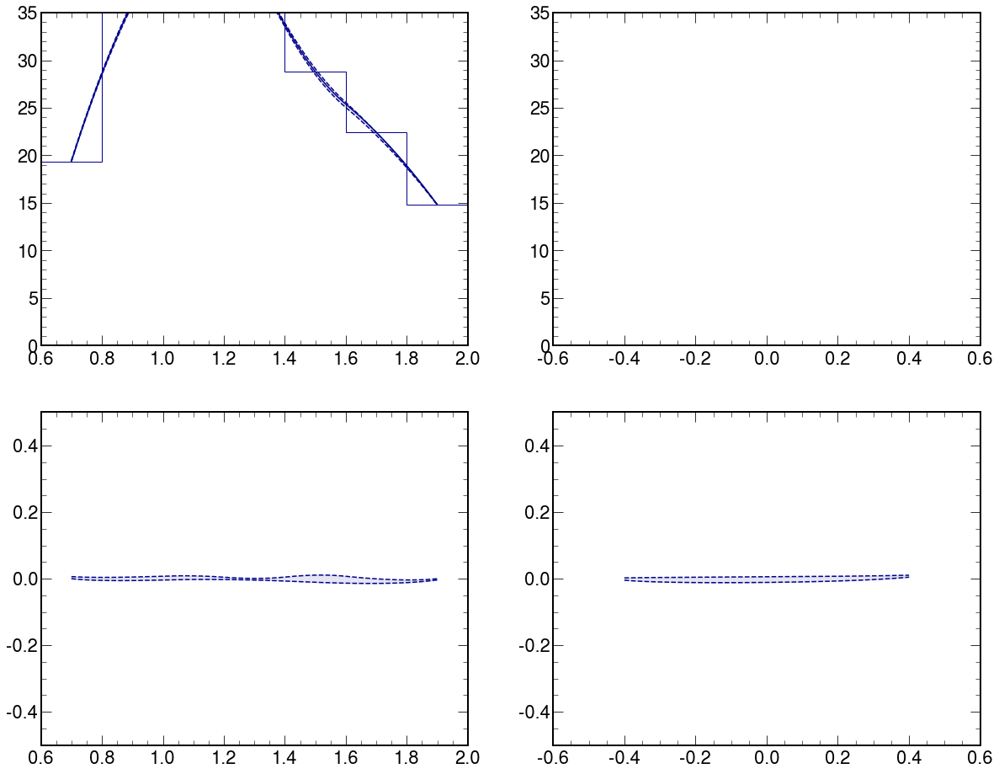

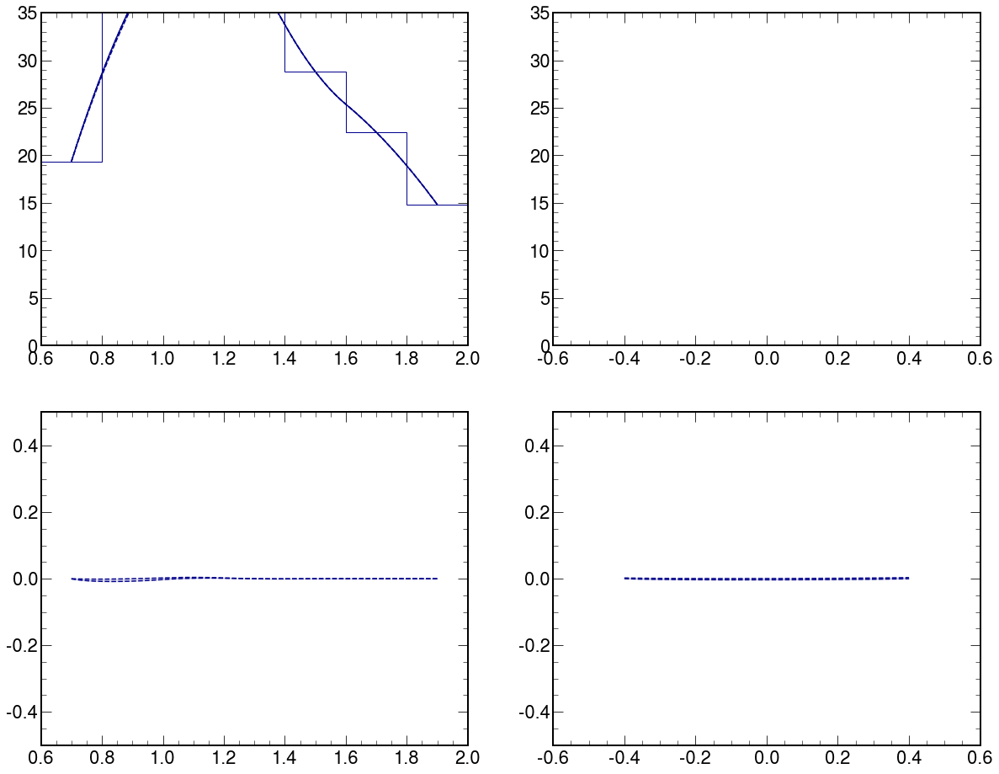

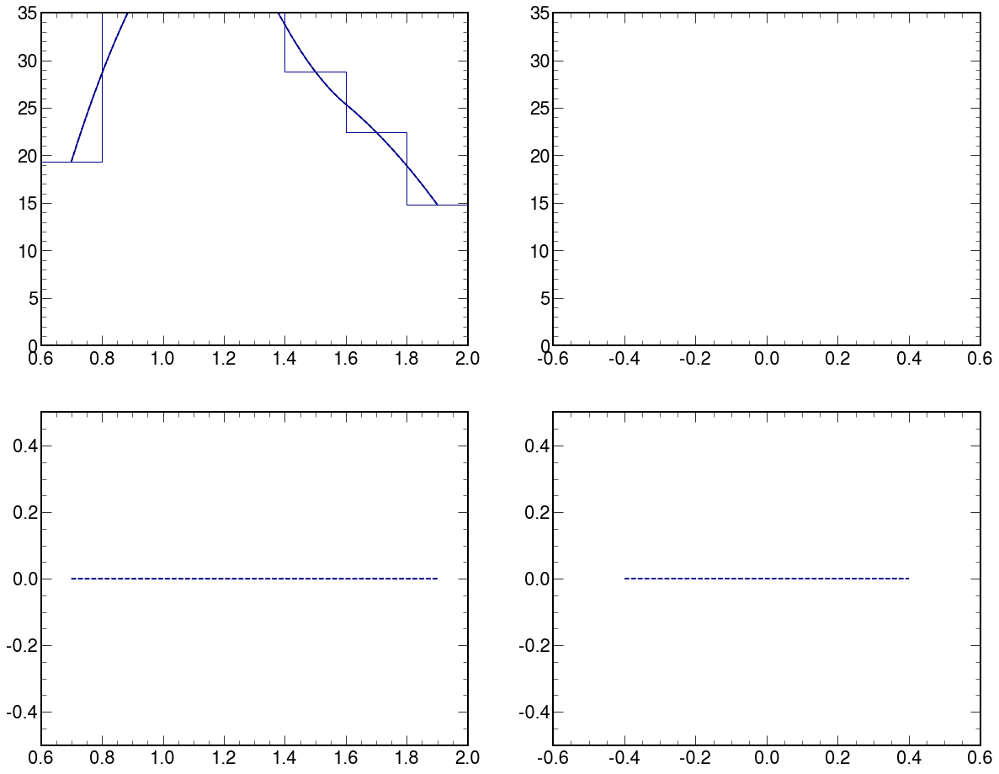

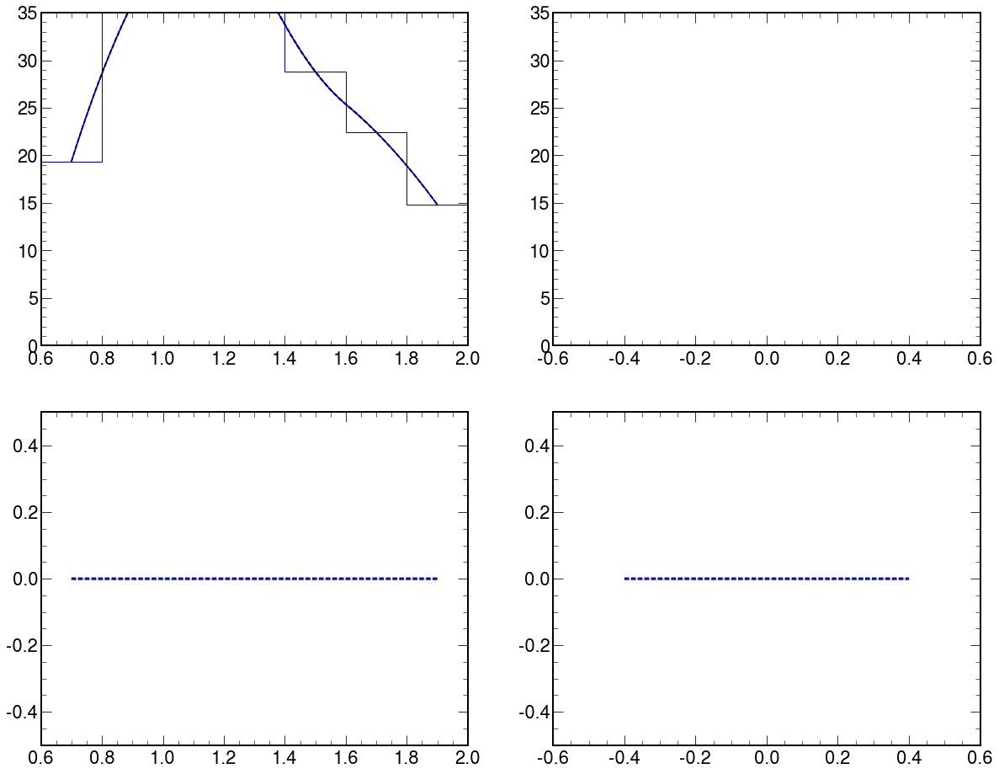

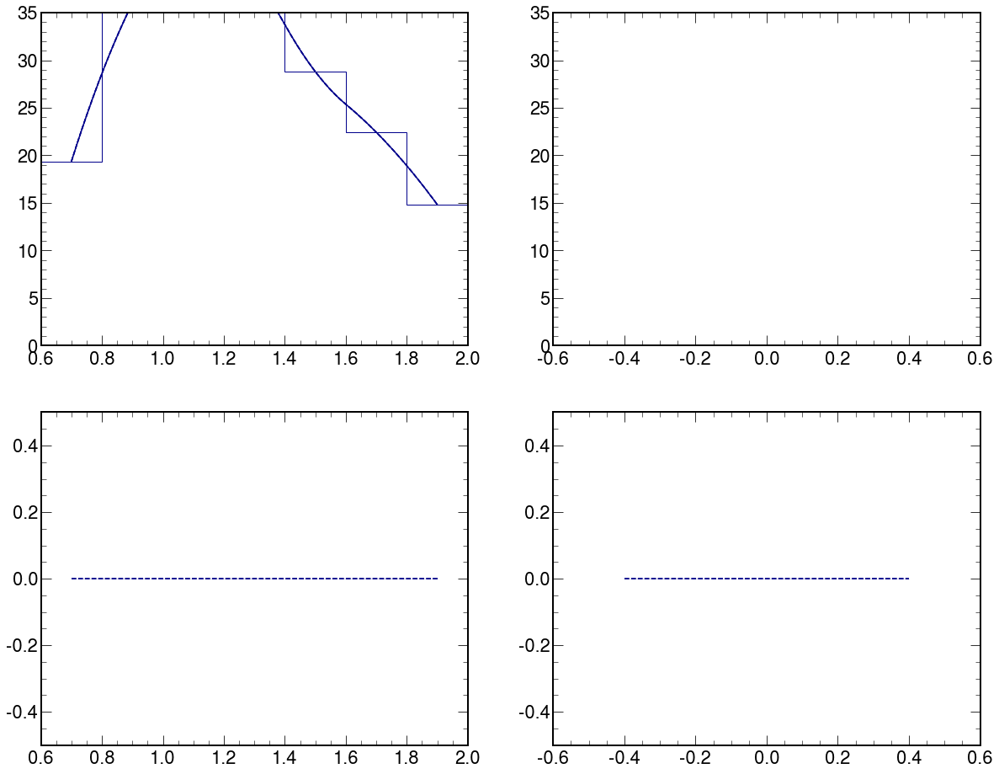

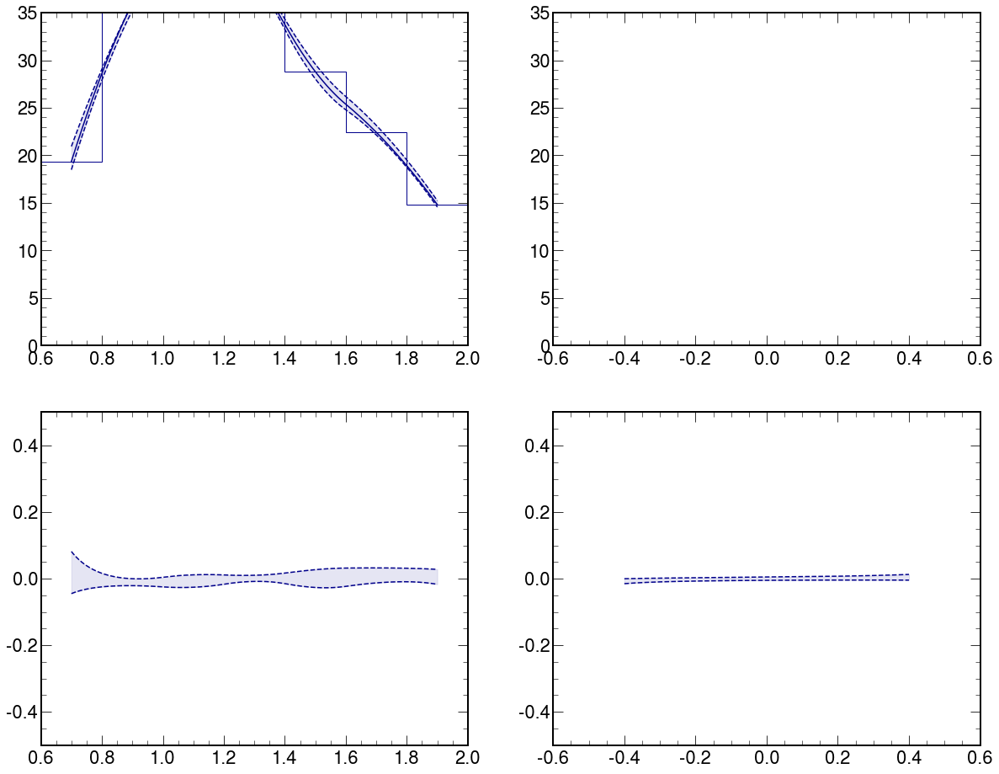

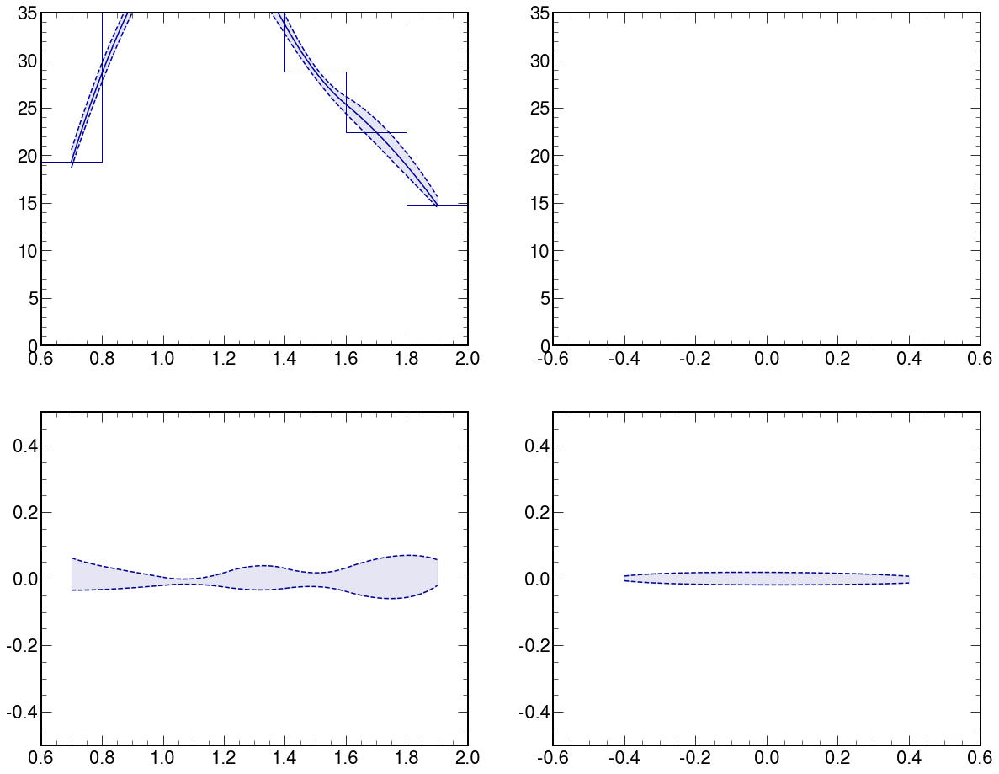

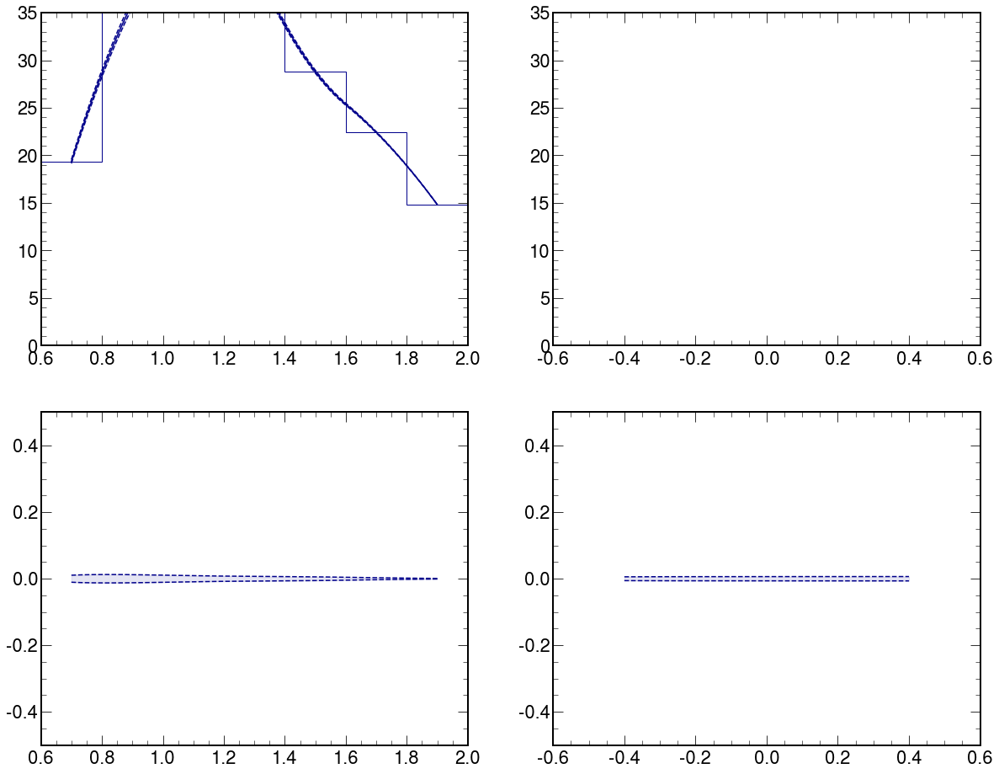

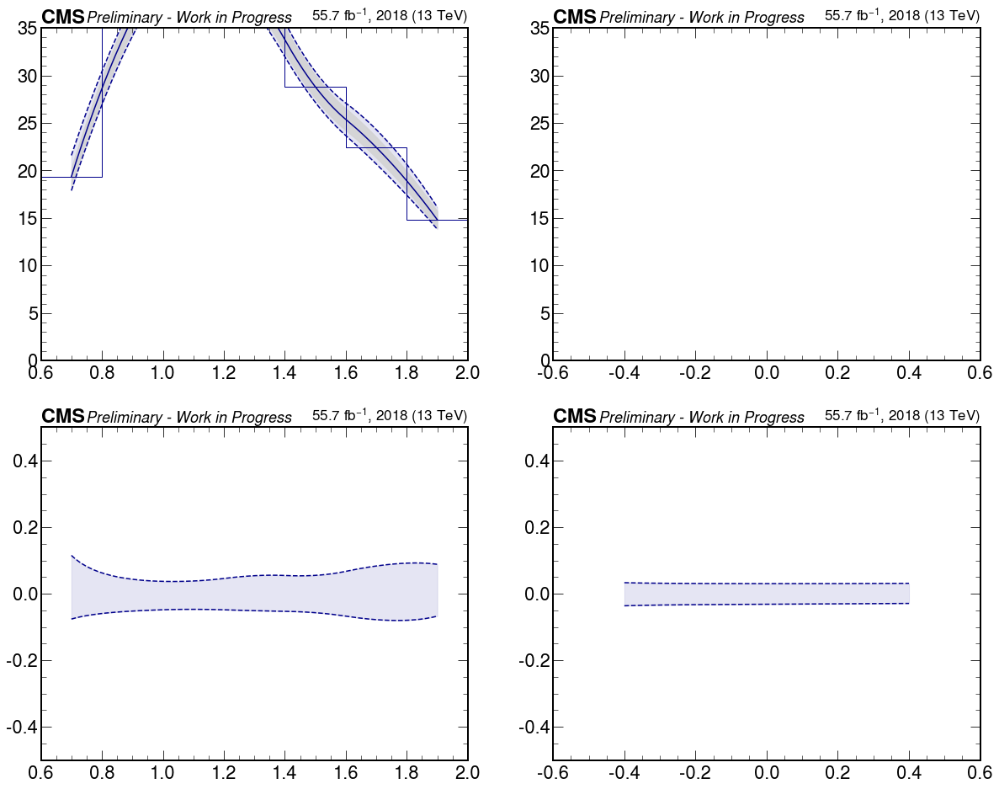

In [143]:
label_ = ""
coupling_str_ = "ACW1e-5"
# coupling_str_ = "A0W5e-6"
if data_sample == '2017':
    if lepton_type == 'muon':
#         label_ = "GGToWW-AQGC-A0W5e-6"
#         label_ = "GGToWW-AQGC-muon-A0W5e-6"
        label_ = "GGToWW-AQGC-2017-muon-" + coupling_str_
    elif lepton_type == 'electron':
#         label_ = "GGToWW-AQGC-electron-A0W5e-6"
        label_ = "GGToWW-AQGC-2017-electron-" + coupling_str_
if data_sample == '2018':
    if lepton_type == 'muon':
        label_ = "GGToWW-AQGC-2018-muon-" + coupling_str_
    elif lepton_type == 'electron':
        label_ = "GGToWW-AQGC-2018-electron-" + coupling_str_

# ylim_ = (0.,3.)
# ylim_ = (0.,5.)
ylim_ = (0.,35.)
counts[ label_ ], err[ label_ ], bins[ label_ ], max_variations_total[ label_ ], min_variations_total[ label_ ] = plot_total_systematic(
#     df_dict=df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat,
#     weights_dict=weights_sig_plus_mix_categories_concat,
    df_dict=df_signals_protons_multiRP_sig_plus_mix_All_selected_events,
    weights_dict=weights_sig_plus_mix_All,
    lepton_type=lepton_type,
    label=label_,
    ylim=ylim_,
    ylim_ratio=ylim_ratio_,
    color=color_
    )    

if save_figures:
    if lepton_type == 'muon':
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-ACW1e-5-Muon_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-ACW1e-5-Muon_2018.png", bbox_inches='tight' )
    if lepton_type == 'electron':
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-ACW1e-5-Electron_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-ACW1e-5-Electron_2018.png", bbox_inches='tight' )

GGToWW-AQGC-2018-muon-ACW2e-5
R_MWW_MX
_jes_up
_jes_up
nom
_jes_dw
_jes_dw
nom
[ 72.11125457 146.65536505 182.11150129 160.06935835 131.89676825
  92.59725936  57.67755207]
[ 71.12025483 145.73237943 181.72097601 159.20388064 129.64405395
  90.45076763  56.71806789]
0      0.005782
1      0.005873
2      0.005945
3      0.006000
4      0.006039
         ...   
195    0.012193
196    0.011617
197    0.010986
198    0.010299
199    0.009553
Length: 200, dtype: float64 0.004864842654854654
0     -0.008040
1     -0.007553
2     -0.007111
3     -0.006708
4     -0.006339
         ...   
195   -0.006778
196   -0.006860
197   -0.006964
198   -0.007091
199   -0.007242
Length: 200, dtype: float64 -0.006878773098758121
Diff_YWW_YX
_jes_up
_jes_up
nom
_jes_dw
_jes_dw
nom
[223.86686896 462.28706099 370.84000957]
[219.70999317 457.25290277 366.73951847]
0      0.003218
1      0.003311
2      0.003400
3      0.003485
4      0.003566
         ...   
195    0.005156
196    0.005132
197    0.005107
198 

0      0.005267
1      0.005300
2      0.005331
3      0.005362
4      0.005391
         ...   
195    0.005888
196    0.005879
197    0.005869
198    0.005858
199    0.005848
Length: 200, dtype: float64 0.006026359138592514
0     -0.005267
1     -0.005300
2     -0.005331
3     -0.005362
4     -0.005391
         ...   
195   -0.005888
196   -0.005879
197   -0.005869
198   -0.005858
199   -0.005848
Length: 200, dtype: float64 -0.006026359138585077
{'jes': {'R_MWW_MX': array([ 72.11125457, 146.65536505, 182.11150129, 160.06935835,
       131.89676825,  92.59725936,  57.67755207]), 'Diff_YWW_YX': array([223.86686896, 462.28706099, 370.84000957])}, 'jer': {'R_MWW_MX': array([ 71.69668349, 146.23640022, 182.56671443, 159.8786254 ,
       131.79811047,  91.42826307,  57.13179522]), 'Diff_YWW_YX': array([223.38490374, 460.42989837, 369.14396568])}, 'sf_muon_id': {'R_MWW_MX': array([ 71.73201776, 146.18522706, 182.3685749 , 159.70169296,
       131.82777783,  91.47028274,  57.15635152]), 'Diff

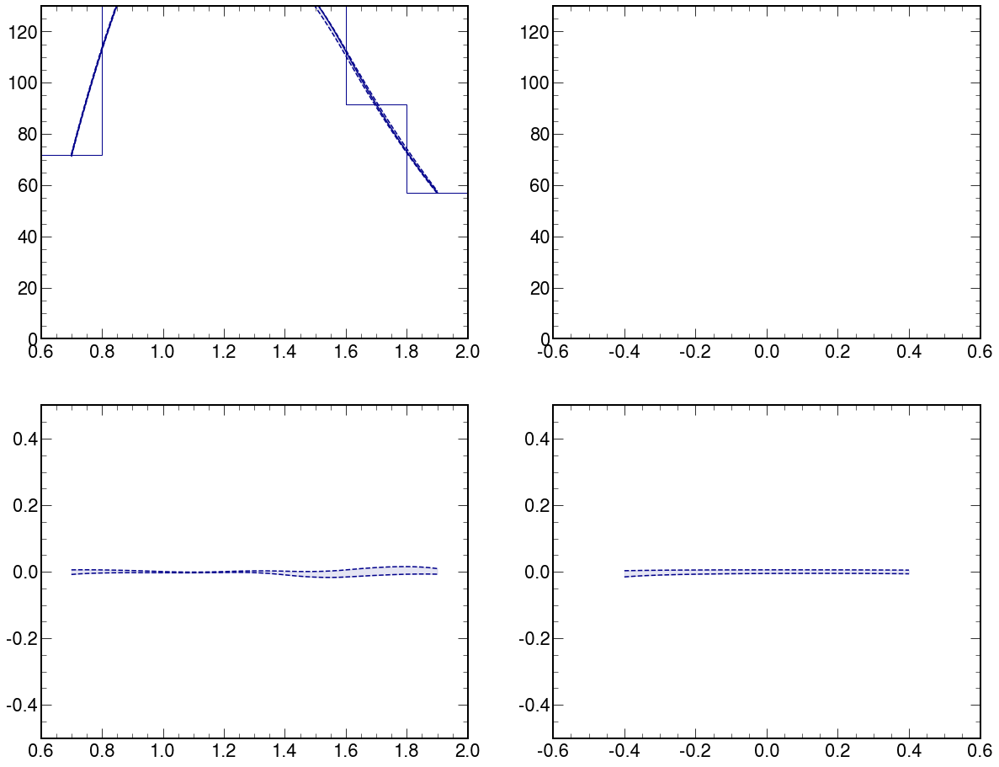

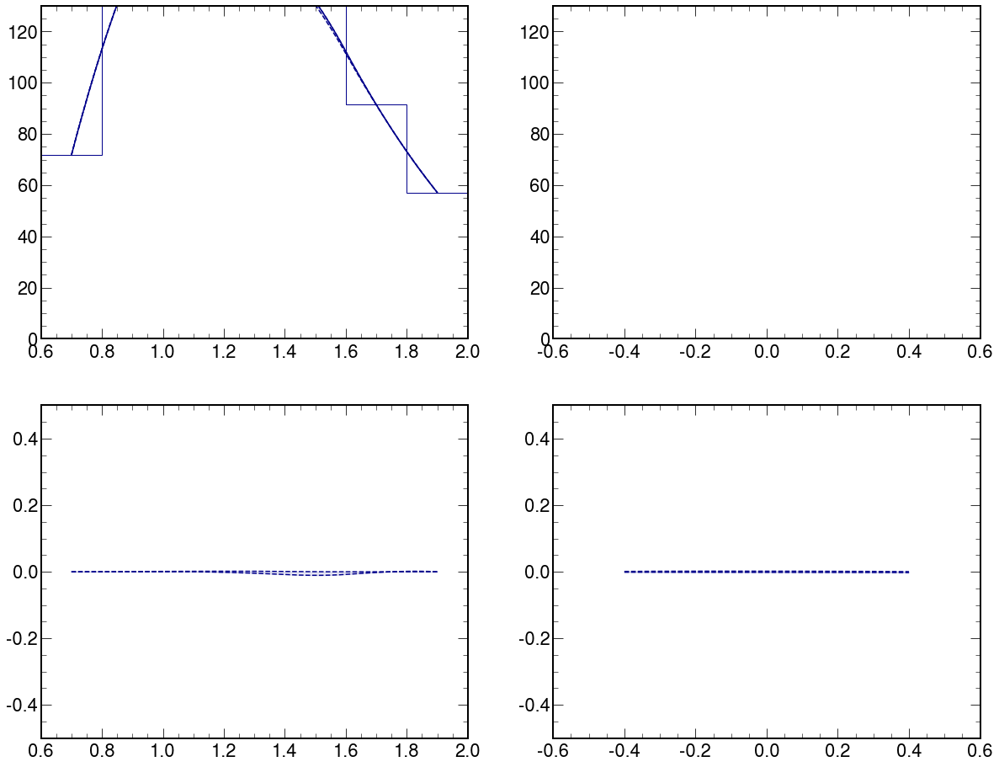

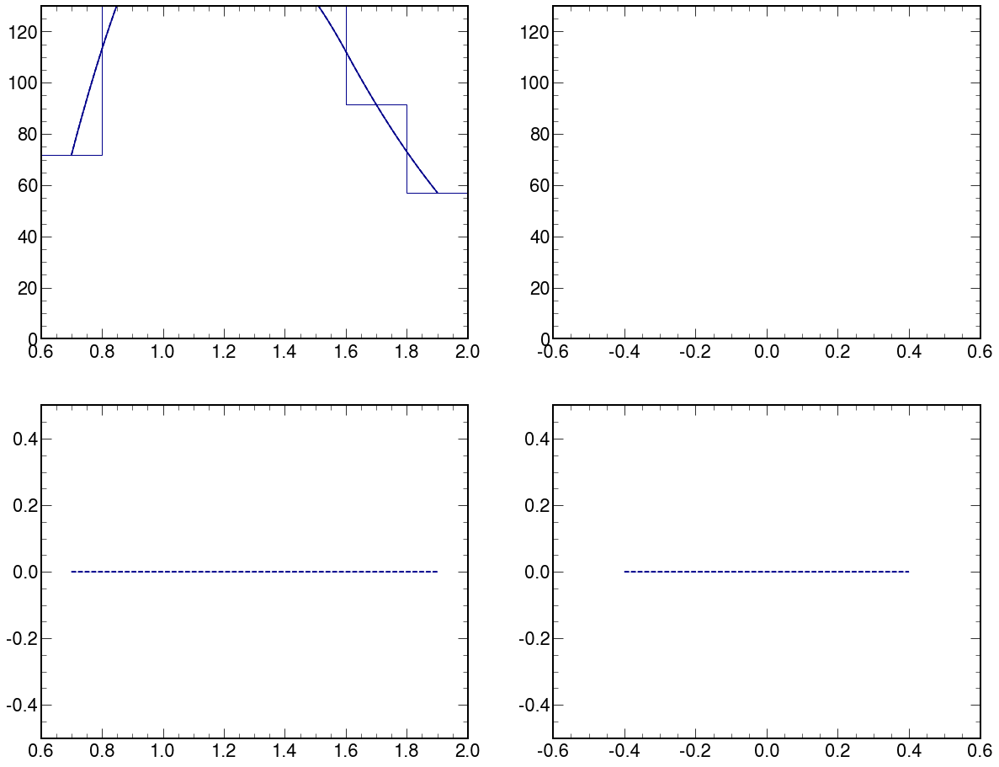

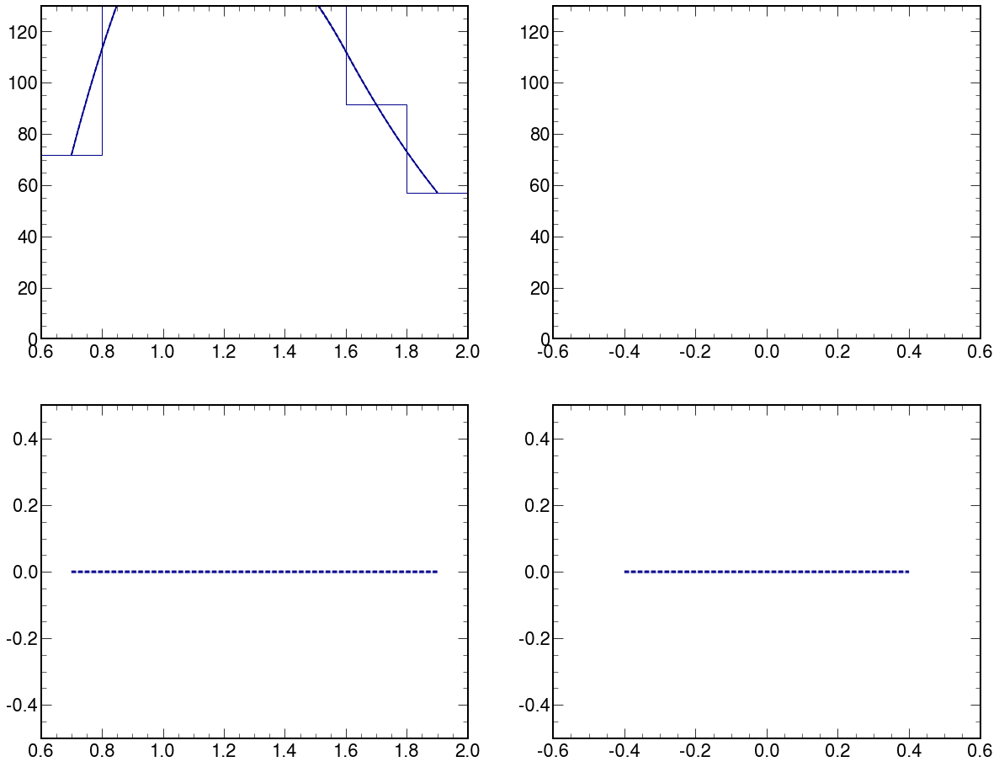

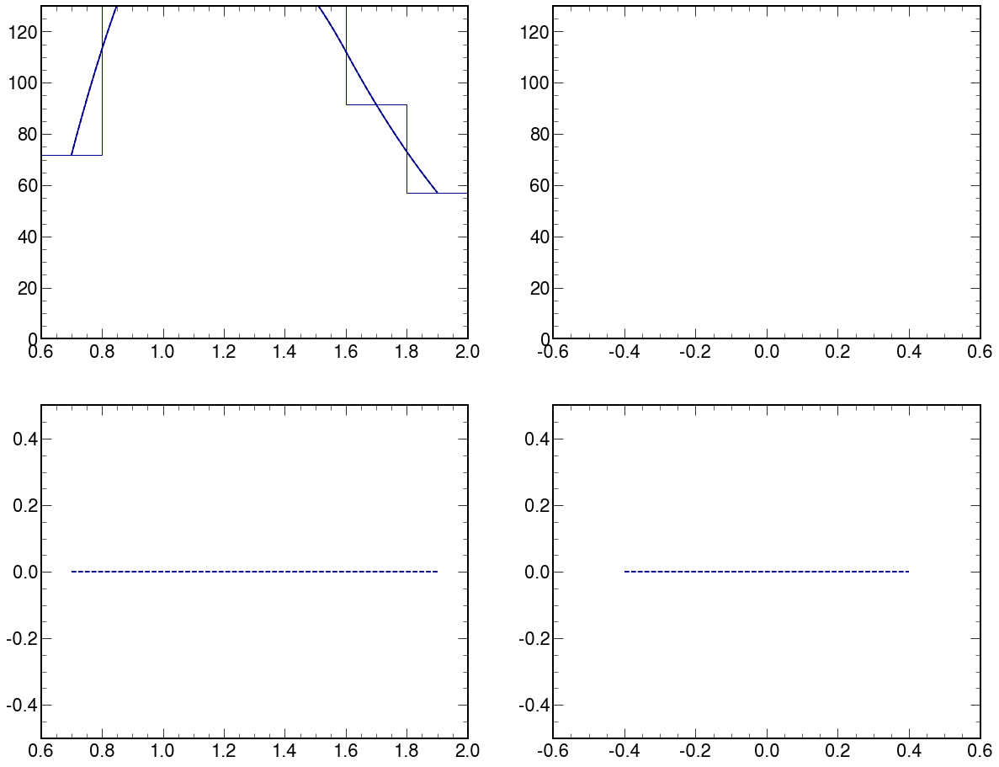

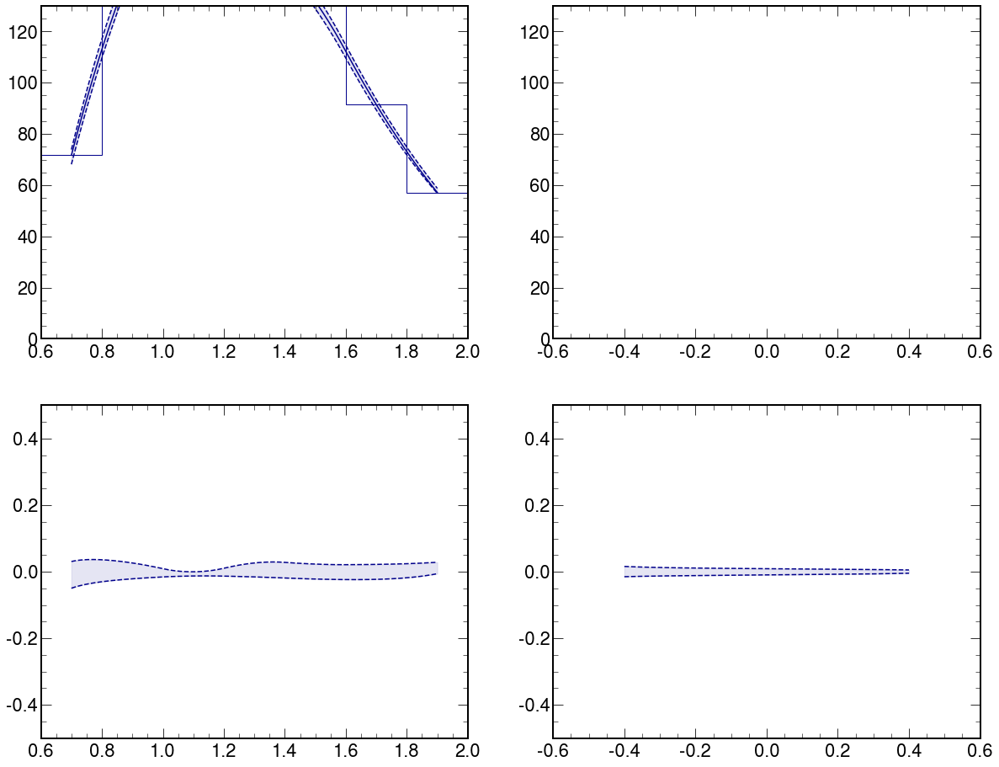

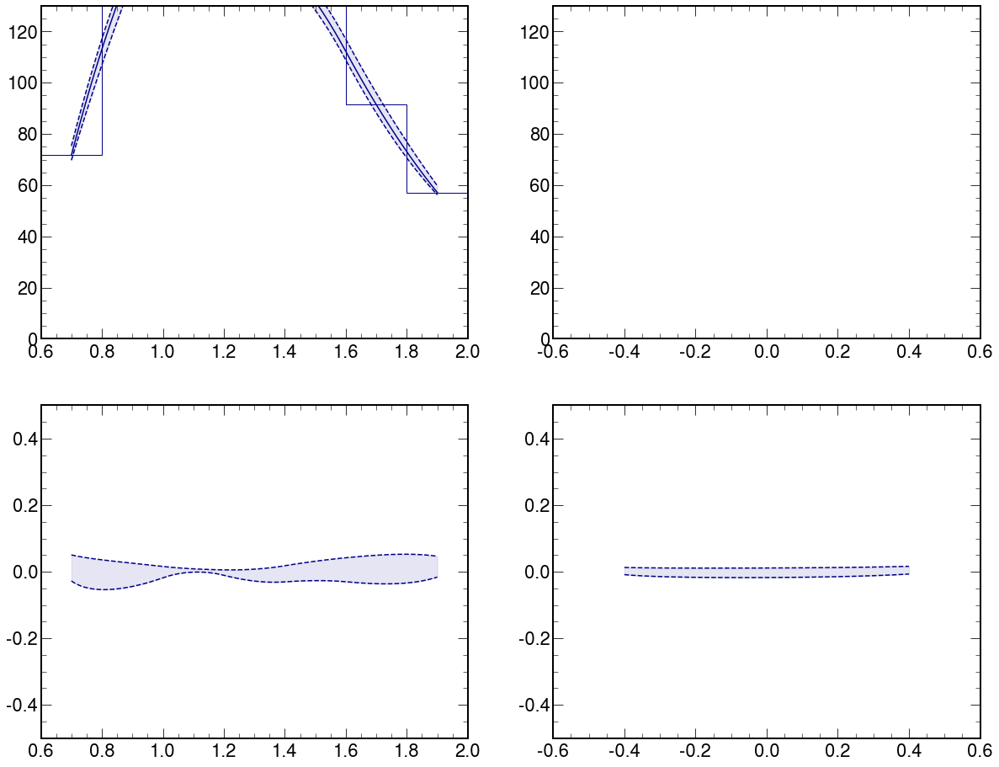

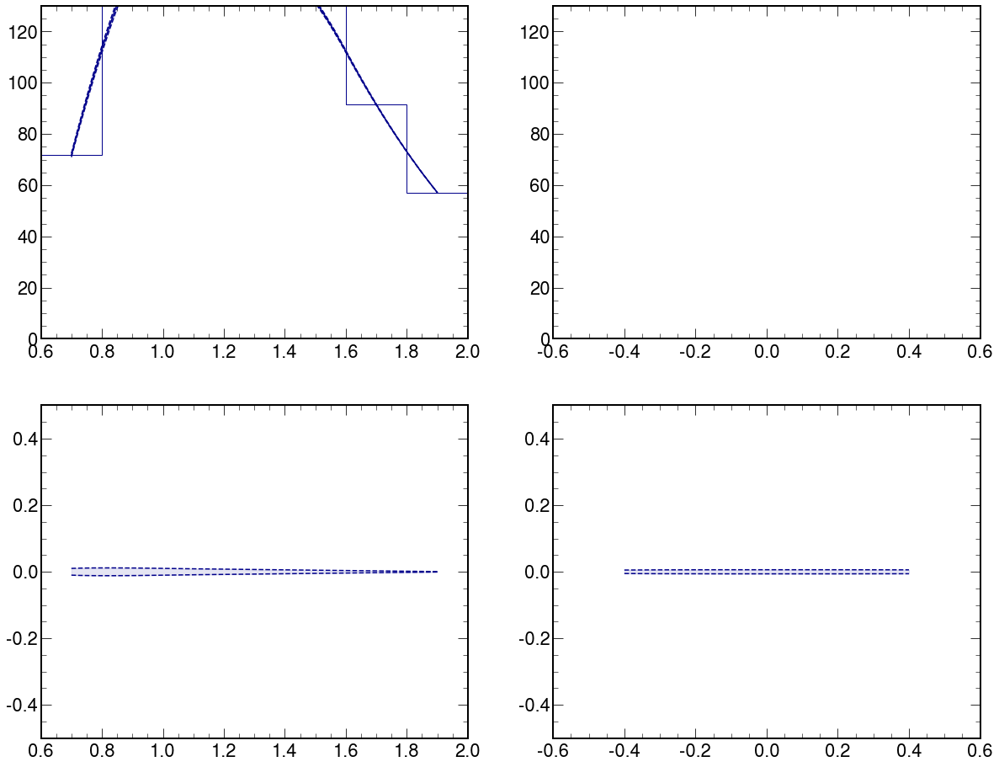

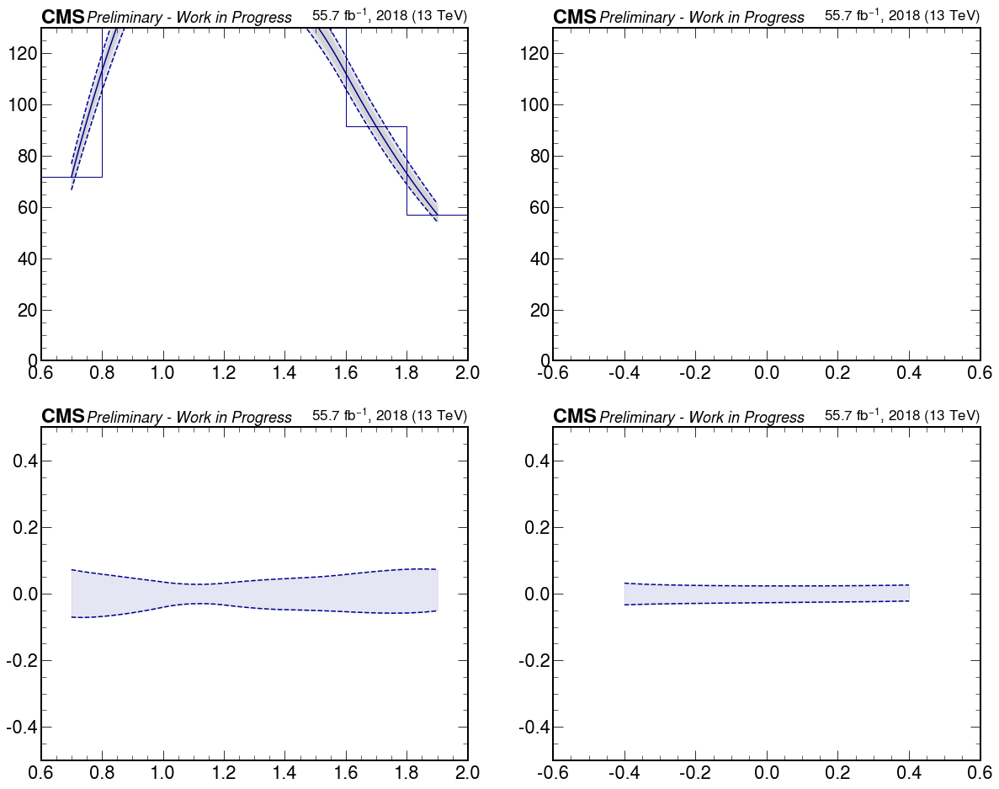

In [144]:
label_ = ""
coupling_str_ = "ACW2e-5"
# coupling_str_ = "A0W5e-6"
if data_sample == '2017':
    if lepton_type == 'muon':
#         label_ = "GGToWW-AQGC-A0W5e-6"
#         label_ = "GGToWW-AQGC-muon-A0W5e-6"
        label_ = "GGToWW-AQGC-2017-muon-" + coupling_str_
    elif lepton_type == 'electron':
#         label_ = "GGToWW-AQGC-electron-A0W5e-6"
        label_ = "GGToWW-AQGC-2017-electron-" + coupling_str_
if data_sample == '2018':
    if lepton_type == 'muon':
        label_ = "GGToWW-AQGC-2018-muon-" + coupling_str_
    elif lepton_type == 'electron':
        label_ = "GGToWW-AQGC-2018-electron-" + coupling_str_

# ylim_ = (0.,3.)
# ylim_ = (0.,5.)
ylim_ = (0.,130.)
counts[ label_ ], err[ label_ ], bins[ label_ ], max_variations_total[ label_ ], min_variations_total[ label_ ] = plot_total_systematic(
#     df_dict=df_signals_protons_multiRP_sig_plus_mix_selected_events_categories_concat,
#     weights_dict=weights_sig_plus_mix_categories_concat,
    df_dict=df_signals_protons_multiRP_sig_plus_mix_All_selected_events,
    weights_dict=weights_sig_plus_mix_All,
    lepton_type=lepton_type,
    label=label_,
    ylim=ylim_,
    ylim_ratio=ylim_ratio_,
    color=color_
    )    

if save_figures:
    if lepton_type == 'muon':
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-ACW2e-5-Muon_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-ACW2e-5-Muon_2018.png", bbox_inches='tight' )
    if lepton_type == 'electron':
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-ACW2e-5-Electron_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/Cut-Based-Signal-Variations-ACW2e-5-Electron_2018.png", bbox_inches='tight' )

In [145]:
print ( counts )
print ( err )
print ( bins )
print ( max_variations_total )
print ( min_variations_total )

{'GGToWW-AQGC-2018-muon-A0W1e-6': {'R_MWW_MX': array([3.96454838, 6.66319349, 6.33562732, 5.75772718, 3.29768189,
       3.67371065, 1.93129966]), 'Diff_YWW_YX': array([ 9.75999444, 17.70198241, 13.65228292])}, 'GGToWW-AQGC-2018-muon-A0W1e-7': {'R_MWW_MX': array([2.36849432, 2.1962563 , 0.93631063, 0.51526265, 0.17440724,
       0.        , 0.        ]), 'Diff_YWW_YX': array([2.19527302, 3.67654374, 2.46445808])}, 'GGToWW-AQGC-2018-muon-A0W2e-7': {'R_MWW_MX': array([2.05983104, 1.96499446, 1.04154084, 0.67362755, 0.49538402,
       0.10257292, 0.07617514]), 'Diff_YWW_YX': array([2.36207132, 3.3307741 , 3.25917934])}, 'GGToWW-AQGC-2018-muon-A0W5e-7': {'R_MWW_MX': array([2.78416029, 2.58114123, 2.69664012, 1.48049723, 1.43899736,
       0.89293753, 0.91374302]), 'Diff_YWW_YX': array([3.45085436, 7.73409131, 4.78884872])}, 'GGToWW-AQGC-2018-muon-A0W2e-6': {'R_MWW_MX': array([ 9.72706661, 20.66548929, 23.14340539, 22.14051426, 17.51990233,
       11.26442111,  9.93859059]), 'Diff_YWW_YX': 

### Background

### Load and select events

In [146]:
##criar flag para usar bkg assim ou da MC+mix_protons

# ['crossingAngle', 'betaStar', 'instLumi', 'jet0_pt', 'jet0_eta',
#        'jet0_phi', 'jet0_energy', 'jet0_mass', 'jet0_corrmass',
#        'jet0_tau1', 'jet0_tau2', 'jet0_vertexz', 'jet0_px', 'jet0_py',
#        'jet0_pz', 'calo_met', 'met', 'met_x', 'met_y', 'met_phi',
#        'nVertices', 'num_bjets_ak8', 'num_bjets_ak4', 'num_jets_ak4',
#        'pfcand_nextracks', 'pfcand_nextracks_noDRl', 'recoMWhad',
#        'recoMWlep', 'recoMWW', 'recoRapidityWW', 'dphiWW', 'WLeptonicPt',
#        'WLeptonicEta', 'WLeptonicPhi', 'muon0_pt', 'muon0_eta',
#        'muon0_phi', 'muon0_energy', 'muon0_charge', 'muon0_iso',
#        'muon0_dxy', 'muon0_dz', 'muon0_trackerLayersWithMeasurement',
#        'run_rnd', 'lumiblock_rnd', 'event_rnd', 'crossingAngle_rnd',
#        'betaStar_rnd', 'period', 'jet0_pt_nom', 'jet0_energy_nom',
#        'jet0_mass_nom', 'jet0_corrmass_nom', 'jet0_px_nom', 'jet0_py_nom',
#        'jet0_pz_nom', 'muon0_pt_nom', 'muon0_energy_nom', 'muon0_px_nom',
#        'muon0_py_nom', 'muon0_pz_nom', 'WLeptonicPt_nom',
#        'WLeptonicPx_nom', 'WLeptonicPy_nom', 'WLeptonicPz_nom',
#        'WLeptonicE_nom', 'WLeptonicM_nom', 'WW_energy_nom', 'WW_pz_nom',
#        'MWW_nom', 'YWW_nom', 'xiCMS_45_nom', 'xiCMS_56_nom', 'xi_nom',
#        'within_aperture', 'xlow', 'xhigh', 'ylow', 'yhigh', 'MX', 'YX',
#        'diffMWW_MX', 'ratioMWW_MX', 'shiftedRatioMWW_MX', 'diffYWW_YX',
#        'MX_nom', 'YX_nom', 'R_MWW_MX_nom', 'Diff_YWW_YX_nom']

In [147]:
# resample_factor = 20
# resample_factor = 50

# label = "data-random-resample_20"
# label = "data-random-resample_50-single-arm"

if not bkg_MC_mix_protons: 
    labels_background = []
    fileNames_bkg = {}
    resample_factor = 50
    if data_sample == '2017':
        if lepton_type == 'muon':
            labels_background = [
                "data-random-resample_50-single-arm-muon-2017B",
                "data-random-resample_50-single-arm-muon-2017C",
                "data-random-resample_50-single-arm-muon-2017D",
                "data-random-resample_50-single-arm-muon-2017E",
                "data-random-resample_50-single-arm-muon-2017F"
            ]
            fileNames_bkg = {
                "data-random-resample_50-single-arm-muon-2017B": "data-store-data-random-resample_50-single-arm-2017B.h5",
                "data-random-resample_50-single-arm-muon-2017C": "data-store-data-random-resample_50-single-arm-2017C.h5",
                "data-random-resample_50-single-arm-muon-2017D": "data-store-data-random-resample_50-single-arm-2017D.h5",
                "data-random-resample_50-single-arm-muon-2017E": "data-store-data-random-resample_50-single-arm-2017E.h5",
                "data-random-resample_50-single-arm-muon-2017F": "data-store-data-random-resample_50-single-arm-2017F.h5"
            }
        elif lepton_type == 'electron':
            labels_background = [
                "data-random-resample_50-single-arm-electron-2017B",
                "data-random-resample_50-single-arm-electron-2017C",
                "data-random-resample_50-single-arm-electron-2017D",
                "data-random-resample_50-single-arm-electron-2017E",
                "data-random-resample_50-single-arm-electron-2017F"
            ]
            fileNames_bkg = {
                "data-random-resample_50-single-arm-electron-2017B": "data-store-data-random-resample_50-single-arm-electron-2017B.h5",
                "data-random-resample_50-single-arm-electron-2017C": "data-store-data-random-resample_50-single-arm-electron-2017C.h5",
                "data-random-resample_50-single-arm-electron-2017D": "data-store-data-random-resample_50-single-arm-electron-2017D.h5",
                "data-random-resample_50-single-arm-electron-2017E": "data-store-data-random-resample_50-single-arm-electron-2017E.h5",
                "data-random-resample_50-single-arm-electron-2017F": "data-store-data-random-resample_50-single-arm-electron-2017F.h5"
            }
    elif data_sample == '2018':
        if lepton_type == 'muon':
            labels_background = [
                "data-random-resample_50-2018-muon-2018A",
                "data-random-resample_50-2018-muon-2018B",
                "data-random-resample_50-2018-muon-2018C",
                #"data-random-resample_50-2018-muon-2018D",
                "data-random-resample_50-2018-muon-2018D-1",
                "data-random-resample_50-2018-muon-2018D-2",
                "data-random-resample_50-2018-muon-2018D-3",
                "data-random-resample_50-2018-muon-2018D-4",
                "data-random-resample_50-2018-muon-2018D-5",
                "data-random-resample_50-2018-muon-2018D-6"
            ]
            fileNames_bkg = {
                "data-random-resample_50-2018-muon-2018A": "data-store-data-random-resample_50-2018-muon-2018A.h5",
                "data-random-resample_50-2018-muon-2018B": "data-store-data-random-resample_50-2018-muon-2018B.h5",
                "data-random-resample_50-2018-muon-2018C": "data-store-data-random-resample_50-2018-muon-2018C.h5",
                #"data-random-resample_50-2018-muon-2018D": "data-store-data-random-resample_50-2018-muon-2018D.h5",
                "data-random-resample_50-2018-muon-2018D-1": "data-store-data-random-resample_50-2018-muon-2018D-1.h5",
                "data-random-resample_50-2018-muon-2018D-2": "data-store-data-random-resample_50-2018-muon-2018D-2.h5",
                "data-random-resample_50-2018-muon-2018D-3": "data-store-data-random-resample_50-2018-muon-2018D-3.h5",
                "data-random-resample_50-2018-muon-2018D-4": "data-store-data-random-resample_50-2018-muon-2018D-4.h5",
                "data-random-resample_50-2018-muon-2018D-5": "data-store-data-random-resample_50-2018-muon-2018D-5.h5",
                "data-random-resample_50-2018-muon-2018D-6": "data-store-data-random-resample_50-2018-muon-2018D-6.h5"
            }             
        elif lepton_type == 'electron':
            labels_background = [
                "data-random-resample_50-2018-electron-2018A",
                "data-random-resample_50-2018-electron-2018B",
                "data-random-resample_50-2018-electron-2018C",
                #"data-random-resample_50-2018-electron-2018D",
                "data-random-resample_50-2018-electron-2018D-1",
                "data-random-resample_50-2018-electron-2018D-2",
                "data-random-resample_50-2018-electron-2018D-3",
                "data-random-resample_50-2018-electron-2018D-4",
                "data-random-resample_50-2018-electron-2018D-5",
                "data-random-resample_50-2018-electron-2018D-6"
            ]
            fileNames_bkg = {
                "data-random-resample_50-2018-electron-2018A": "data-store-data-random-resample_50-2018-electron-2018A.h5",
                "data-random-resample_50-2018-electron-2018B": "data-store-data-random-resample_50-2018-electron-2018B.h5",
                "data-random-resample_50-2018-electron-2018C": "data-store-data-random-resample_50-2018-electron-2018C.h5",
                #"data-random-resample_50-2018-electron-2018D": "data-store-data-random-resample_50-2018-electron-2018D.h5",
                "data-random-resample_50-2018-electron-2018D-1": "data-store-data-random-resample_50-2018-electron-2018D-1.h5",
                "data-random-resample_50-2018-electron-2018D-2": "data-store-data-random-resample_50-2018-electron-2018D-2.h5",
                "data-random-resample_50-2018-electron-2018D-3": "data-store-data-random-resample_50-2018-electron-2018D-3.h5",
                "data-random-resample_50-2018-electron-2018D-4": "data-store-data-random-resample_50-2018-electron-2018D-4.h5",
                "data-random-resample_50-2018-electron-2018D-5": "data-store-data-random-resample_50-2018-electron-2018D-5.h5",
                "data-random-resample_50-2018-electron-2018D-6": "data-store-data-random-resample_50-2018-electron-2018D-6.h5"
            }

    
    if load_background: 
        #     base_path_ = "output"
            base_path_ = "output-final"
            #base_path_ = "output_new"
            for label_ in fileNames_bkg:
                fileNames_bkg[ label_ ] = "{}/{}".format( base_path_, fileNames_bkg[ label_ ] )
            print ( fileNames_bkg )

            # file_path_ = "{}/data-store-{}.h5".format( base_path_, label )
            # print ( file_path_ )

            df_counts_bkg = None
        #     df_protons_multiRP_bkg_index = None #
            df_protons_multiRP_bkg_events = None
            df_protons_multiRP_bkg_events_nTracks40 = None

            df_counts_bkg_list_ = []
        #     df_protons_multiRP_bkg_index_list_ = [] #
            df_protons_multiRP_bkg_events_list_ = []
            df_protons_multiRP_bkg_events_list_nTracks40_ = []
            for label_ in labels_background:
                print ( label_ )
                file_path_ = fileNames_bkg[ label_ ]
                print ( file_path_ )
                with pd.HDFStore( file_path_, 'r' ) as store_:
                    print ( list( store_ ) )

                    df_counts_bkg__ = store_[ "counts" ]
                    df_protons_multiRP_bkg_index__  = store_[ "protons_multiRP" ] #
                    df_protons_multiRP_bkg_events__ = store_[ "events_multiRP" ]
                    if lepton_type == 'muon':
                        df_protons_multiRP_bkg_events__ = df_protons_multiRP_bkg_events__.loc[ :, 
                            ['crossingAngle',
                             'jet0_eta', 'jet0_phi', 
                             'jet0_tau1', 'jet0_tau2',
                             'met', 'met_phi',
                             'num_bjets_ak4',
                             'pfcand_nextracks', 'pfcand_nextracks_noDRl',
                             'WLeptonicEta', 'WLeptonicPhi',
                             'muon0_eta', 'muon0_phi', 'muon0_iso',
                             'run_rnd', 'lumiblock_rnd', 'event_rnd', 'crossingAngle_rnd', 'period',
                             'nprotons_arm0', 'nprotons_arm1',
                             'jet0_pt_nom', 'jet0_energy_nom', 'jet0_corrmass_nom',
                             'muon0_pt_nom', 
                             'WLeptonicPt_nom', 
                             'MWW_nom', 'YWW_nom', 'xiCMS_45_nom', 'xiCMS_56_nom', 'xi_nom', 'xi_max_arm0', 'xi_max_arm1',
                             'MX_nom', 'YX_nom', 'R_MWW_MX_nom', 'Diff_YWW_YX_nom']
                        ]
        #                 df_protons_multiRP_bkg_index__ = df_protons_multiRP_bkg_index__.loc[ :, 
        #                     ['crossingAngle',
        #                      'jet0_eta', 'jet0_phi', 
        #                      'jet0_tau1', 'jet0_tau2',
        #                      'met', 'met_phi',
        #                      'num_bjets_ak4',
        #                      'pfcand_nextracks', 'pfcand_nextracks_noDRl',
        #                      'WLeptonicEta', 'WLeptonicPhi',
        #                      'muon0_eta', 'muon0_phi', 'muon0_iso',
        #                      'run_rnd', 'lumiblock_rnd', 'event_rnd', 'crossingAngle_rnd', 'period',
        #                      'nprotons_arm0', 'nprotons_arm1',
        #                      'jet0_pt_nom', 'jet0_energy_nom', 'jet0_corrmass_nom',
        #                      'muon0_pt_nom', 
        #                      'WLeptonicPt_nom', 
        #                      'MWW_nom', 'YWW_nom', 'xiCMS_45_nom', 'xiCMS_56_nom', 'xi_nom']
        #                 ]
                    if lepton_type == 'electron':
                        df_protons_multiRP_bkg_events__ = df_protons_multiRP_bkg_events__.loc[ :, 
                            ['crossingAngle',
                             'jet0_eta', 'jet0_phi', 
                             'jet0_tau1', 'jet0_tau2',
                             'met', 'met_phi',
                             'num_bjets_ak4',
                             'pfcand_nextracks', 'pfcand_nextracks_noDRl',
                             'WLeptonicEta', 'WLeptonicPhi',
                             'electron0_eta', 'electron0_phi', 
                             'run_rnd', 'lumiblock_rnd', 'event_rnd', 'crossingAngle_rnd', 'period',
                             'nprotons_arm0', 'nprotons_arm1',
                             'jet0_pt_nom', 'jet0_energy_nom', 'jet0_corrmass_nom',
                             'electron0_pt_nom', 
                             'WLeptonicPt_nom', 
                             'MWW_nom', 'YWW_nom', 'xiCMS_45_nom', 'xiCMS_56_nom', 'xi_nom', 'xi_max_arm0', 'xi_max_arm1',
                             'MX_nom', 'YX_nom', 'R_MWW_MX_nom', 'Diff_YWW_YX_nom']
                        ]
        #                 df_protons_multiRP_bkg_index__ = df_protons_multiRP_bkg_index__.loc[ :, 
        #                     ['crossingAngle',
        #                      'jet0_eta', 'jet0_phi', 
        #                      'jet0_tau1', 'jet0_tau2',
        #                      'met', 'met_phi',
        #                      'num_bjets_ak4',
        #                      'pfcand_nextracks', 'pfcand_nextracks_noDRl',
        #                      'WLeptonicEta', 'WLeptonicPhi',
        #                      'muon0_eta', 'muon0_phi', 'muon0_iso',
        #                      'run_rnd', 'lumiblock_rnd', 'event_rnd', 'crossingAngle_rnd', 'period',
        #                      'nprotons_arm0', 'nprotons_arm1',
        #                      'jet0_pt_nom', 'jet0_energy_nom', 'jet0_corrmass_nom',
        #                      'muon0_pt_nom', 
        #                      'WLeptonicPt_nom', 
        #                      'MWW_nom', 'YWW_nom', 'xiCMS_45_nom', 'xiCMS_56_nom', 'xi_nom']
        #                 ]

                    print ( df_protons_multiRP_bkg_events__.shape[0] )
                    df_protons_multiRP_bkg_events_nTracks40__, selection_keys__, selections__ = select_events( df_protons_multiRP_bkg_events__, lepton_type, max_num_tracks=40 )
                    print ( df_protons_multiRP_bkg_events_nTracks40__.shape[0] )
                    print ( selection_keys__ )
                    print ( selections__ )
                    df_protons_multiRP_bkg_events_def__, selection_keys__, selections__ = select_events( df_protons_multiRP_bkg_events__, lepton_type )
                    print ( df_protons_multiRP_bkg_events_def__.shape[0] )
                    print ( selection_keys__ )
                    print ( selections__ ) 
                    df_protons_multiRP_bkg_index__, selection_keys__, selections__ = select_events( df_protons_multiRP_bkg_index__, lepton_type )
                    print ( df_protons_multiRP_bkg_index__.shape[0] )
                    print ( selection_keys__ )
                    print ( selections__ )

                    df_counts_bkg_list_.append( df_counts_bkg__ )
        #             df_protons_multiRP_bkg_index_list_.append( df_protons_multiRP_bkg_index__ ) #
            #         df_protons_multiRP_bkg_events_list_.append( df_protons_multiRP_bkg_events__ )
                    df_protons_multiRP_bkg_events_list_.append( df_protons_multiRP_bkg_events_def__ )
                    df_protons_multiRP_bkg_events_list_nTracks40_.append( df_protons_multiRP_bkg_events_nTracks40__ )

            df_counts_bkg = df_counts_bkg_list_[0]
            for idx_ in range( 1, len( df_counts_bkg_list_ ) ):
                df_counts_bkg = df_counts_bkg.add( df_counts_bkg_list_[ idx_ ] )

        #     df_protons_multiRP_bkg_index = pd.concat( df_protons_multiRP_bkg_index_list_ ) #
            df_protons_multiRP_bkg_events = pd.concat( df_protons_multiRP_bkg_events_list_ )
            df_protons_multiRP_bkg_events_nTracks40 = pd.concat( df_protons_multiRP_bkg_events_list_nTracks40_ )

In [148]:
if bkg_MC_mix_protons:
    labels_background = []
    fileNames_bkg = {}
    resample_factor = 1
    if data_sample == '2017':
        if lepton_type == 'muon':
            labels_background = [ "GGToWW-AQGC-mix_protons-2017-muon-A0W1e-6", "GGToWW-AQGC-mix_protons-2017-muon-A0W2e-6", "GGToWW-AQGC-mix_protons-2017-muon-A0W5e-6" ]
            fileNames_bkg = {
                "GGToWW-AQGC-mix_protons-2017-muon-A0W1e-6": "data-store-GGToWW-AQGC-mix_protons-2018-muon-A0W1e-6.h5",
                "GGToWW-AQGC-mix_protons-2017-muon-A0W2e-6": "data-store-GGToWW-AQGC-mix_protons-2018-muon-A0W2e-6.h5",
                "GGToWW-AQGC-mix_protons-2017-muon-A0W5e-6": "data-store-GGToWW-AQGC-mix_protons-2018-muon-A0W5e-6.h5"
            }
        elif lepton_type == 'electron':
            labels_background = [ "GGToWW-AQGC-mix_protons-2017-electron-A0W1e-6", "GGToWW-AQGC-mix_protons-2017-electron-A0W2e-6", "GGToWW-AQGC-mix_protons-2017-electron-A0W5e-6" ] 
            fileNames_bkg = {
                "GGToWW-AQGC-mix_protons-2017-electron-A0W1e-6": "data-store-GGToWW-AQGC-mix_protons-2018-electron-A0W1e-6.h5",
                "GGToWW-AQGC-mix_protons-2017-electron-A0W2e-6": "data-store-GGToWW-AQGC-mix_protons-2018-electron-A0W2e-6.h5",
                "GGToWW-AQGC-mix_protons-2017-electron-A0W5e-6": "data-store-GGToWW-AQGC-mix_protons-2018-electron-A0W5e-6.h5"
            }
    elif data_sample == '2018':
        if lepton_type == 'muon':
            labels_background = [ "Bkg-mix_protons-2018-muon-TTJets", "Bkg-mix_protons-2018-muon-WJetsToLNu_0J", "Bkg-mix_protons-2018-muon-WJetsToLNu_1J", "Bkg-mix_protons-2018-muon-WJetsToLNu_2J", "Bkg-mix_protons-2018-muon-DYJetsToLL_0J", "Bkg-mix_protons-2018-muon-DYJetsToLL_1J", "Bkg-mix_protons-2018-muon-DYJetsToLL_2J", "Bkg-mix_protons-2018-muon-QCD_Pt_170to300", "Bkg-mix_protons-2018-muon-QCD_Pt_300to470", "Bkg-mix_protons-2018-muon-QCD_Pt_470to600", "Bkg-mix_protons-2018-muon-QCD_Pt_600to800", "Bkg-mix_protons-2018-muon-QCD_Pt_800to1000", "Bkg-mix_protons-2018-muon-QCD_Pt_1000to1400", "Bkg-mix_protons-2018-muon-QCD_Pt_1400to1800", "Bkg-mix_protons-2018-muon-QCD_Pt_1800to2400", "Bkg-mix_protons-2018-muon-QCD_Pt_2400to3200", "Bkg-mix_protons-2018-muon-QCD_Pt_3200toInf", "Bkg-mix_protons-2018-muon-ST_s-channel_4f_leptonDecays", "Bkg-mix_protons-2018-muon-ST_t-channel_antitop_4f_InclusiveDecays", "Bkg-mix_protons-2018-muon-ST_t-channel_top_4f_InclusiveDecays", "Bkg-mix_protons-2018-muon-ST_tW_antitop_5f_inclusiveDecays", "Bkg-mix_protons-2018-muon-ST_tW_top_5f_inclusiveDecays", "Bkg-mix_protons-2018-muon-WW", "Bkg-mix_protons-2018-muon-WZ", "Bkg-mix_protons-2018-muon-ZZ"]
            #labels_background = [ "Bkg-mix_protons-2018-muon-WJetsToLNu_2J", "Bkg-mix_protons-2018-muon-QCD_Pt_300to470", "Bkg-mix_protons-2018-muon-QCD_Pt_470to600", "Bkg-mix_protons-2018-muon-QCD_Pt_600to800", "Bkg-mix_protons-2018-muon-QCD_Pt_800to1000", "Bkg-mix_protons-2018-muon-QCD_Pt_1000to1400", "Bkg-mix_protons-2018-muon-ST_s-channel_4f_leptonDecays", "Bkg-mix_protons-2018-muon-ST_t-channel_antitop_4f_InclusiveDecays", "Bkg-mix_protons-2018-muon-ST_t-channel_top_4f_InclusiveDecays", "Bkg-mix_protons-2018-muon-ST_tW_antitop_5f_inclusiveDecays", "Bkg-mix_protons-2018-muon-ST_tW_top_5f_inclusiveDecays" ] 
            fileNames_bkg = {
                "Bkg-mix_protons-2018-muon-TTJets": "data-store-Bkg-mix_protons-2018-muon-TTJets.h5",
                "Bkg-mix_protons-2018-muon-WJetsToLNu_0J": "data-store-Bkg-mix_protons-2018-muon-WJetsToLNu_0J.h5",
                "Bkg-mix_protons-2018-muon-WJetsToLNu_1J": "data-store-Bkg-mix_protons-2018-muon-WJetsToLNu_1J.h5",
                "Bkg-mix_protons-2018-muon-WJetsToLNu_2J": "data-store-Bkg-mix_protons-2018-muon-WJetsToLNu_2J.h5",
                "Bkg-mix_protons-2018-muon-DYJetsToLL_0J": "data-store-Bkg-mix_protons-2018-muon-DYJetsToLL_0J.h5",
                "Bkg-mix_protons-2018-muon-DYJetsToLL_1J": "data-store-Bkg-mix_protons-2018-muon-DYJetsToLL_1J.h5",
                "Bkg-mix_protons-2018-muon-DYJetsToLL_2J": "data-store-Bkg-mix_protons-2018-muon-DYJetsToLL_2J.h5",
                "Bkg-mix_protons-2018-muon-QCD_Pt_170to300": "data-store-Bkg-mix_protons-2018-muon-QCD_Pt_170to300.h5",
                "Bkg-mix_protons-2018-muon-QCD_Pt_300to470": "data-store-Bkg-mix_protons-2018-muon-QCD_Pt_300to470.h5",
                "Bkg-mix_protons-2018-muon-QCD_Pt_470to600": "data-store-Bkg-mix_protons-2018-muon-QCD_Pt_470to600.h5",
                "Bkg-mix_protons-2018-muon-QCD_Pt_600to800": "data-store-Bkg-mix_protons-2018-muon-QCD_Pt_600to800.h5",
                "Bkg-mix_protons-2018-muon-QCD_Pt_800to1000": "data-store-Bkg-mix_protons-2018-muon-QCD_Pt_800to1000.h5",
                "Bkg-mix_protons-2018-muon-QCD_Pt_1000to1400": "data-store-Bkg-mix_protons-2018-muon-QCD_Pt_1000to1400.h5",
                "Bkg-mix_protons-2018-muon-QCD_Pt_1400to1800": "data-store-Bkg-mix_protons-2018-muon-QCD_Pt_1400to1800.h5",
                "Bkg-mix_protons-2018-muon-QCD_Pt_1800to2400": "data-store-Bkg-mix_protons-2018-muon-QCD_Pt_1800to2400.h5",
                "Bkg-mix_protons-2018-muon-QCD_Pt_2400to3200": "data-store-Bkg-mix_protons-2018-muon-QCD_Pt_2400to3200.h5",
                "Bkg-mix_protons-2018-muon-QCD_Pt_3200toInf": "data-store-Bkg-mix_protons-2018-muon-QCD_Pt_3200toInf.h5",
                "Bkg-mix_protons-2018-muon-ST_s-channel_4f_leptonDecays": "data-store-Bkg-mix_protons-2018-muon-ST_s-channel_4f_leptonDecays.h5",
                "Bkg-mix_protons-2018-muon-ST_t-channel_antitop_4f_InclusiveDecays": "data-store-Bkg-mix_protons-2018-muon-ST_t-channel_antitop_4f_InclusiveDecays.h5",
                "Bkg-mix_protons-2018-muon-ST_t-channel_top_4f_InclusiveDecays": "data-store-Bkg-mix_protons-2018-muon-ST_t-channel_top_4f_InclusiveDecays.h5",
                "Bkg-mix_protons-2018-muon-ST_tW_antitop_5f_inclusiveDecays": "data-store-Bkg-mix_protons-2018-muon-ST_tW_antitop_5f_inclusiveDecays.h5",
                "Bkg-mix_protons-2018-muon-ST_tW_top_5f_inclusiveDecays": "data-store-Bkg-mix_protons-2018-muon-ST_tW_top_5f_inclusiveDecays.h5",
                "Bkg-mix_protons-2018-muon-WW": "data-store-Bkg-mix_protons-2018-muon-WW.h5",
                "Bkg-mix_protons-2018-muon-WZ": "data-store-Bkg-mix_protons-2018-muon-WZ.h5",
                "Bkg-mix_protons-2018-muon-ZZ": "data-store-Bkg-mix_protons-2018-muon-ZZ.h5"
            }
  
        elif lepton_type == 'electron':
            labels_background = [ "Bkg-mix_protons-2018-electron-TTJets", "Bkg-mix_protons-2018-electron-WJetsToLNu_0J", "Bkg-mix_protons-2018-electron-WJetsToLNu_1J", "Bkg-mix_protons-2018-electron-WJetsToLNu_2J", "Bkg-mix_protons-2018-electron-DYJetsToLL_0J", "Bkg-mix_protons-2018-electron-DYJetsToLL_1J", "Bkg-mix_protons-2018-electron-DYJetsToLL_2J", "Bkg-mix_protons-2018-electron-QCD_Pt_170to300", "Bkg-mix_protons-2018-electron-QCD_Pt_300to470", "Bkg-mix_protons-2018-electron-QCD_Pt_470to600", "Bkg-mix_protons-2018-electron-QCD_Pt_600to800", "Bkg-mix_protons-2018-electron-QCD_Pt_800to1000", "Bkg-mix_protons-2018-electron-QCD_Pt_1000to1400", "Bkg-mix_protons-2018-electron-QCD_Pt_1400to1800", "Bkg-mix_protons-2018-electron-QCD_Pt_1800to2400", "Bkg-mix_protons-2018-electron-QCD_Pt_2400to3200", "Bkg-mix_protons-2018-electron-QCD_Pt_3200toInf", "Bkg-mix_protons-2018-electron-ST_s-channel_4f_leptonDecays", "Bkg-mix_protons-2018-electron-ST_t-channel_antitop_4f_InclusiveDecays", "Bkg-mix_protons-2018-electron-ST_t-channel_top_4f_InclusiveDecays", "Bkg-mix_protons-2018-electron-ST_tW_antitop_5f_inclusiveDecays", "Bkg-mix_protons-2018-electron-ST_tW_top_5f_inclusiveDecays", "Bkg-mix_protons-2018-electron-WW", "Bkg-mix_protons-2018-electron-WZ", "Bkg-mix_protons-2018-electron-ZZ" ]
            fileNames_bkg = {
                "Bkg-mix_protons-2018-electron-TTJets": "data-store-Bkg-mix_protons-2018-electron-TTJets.h5",
                "Bkg-mix_protons-2018-electron-WJetsToLNu_0J": "data-store-Bkg-mix_protons-2018-electron-WJetsToLNu_0J.h5",
                "Bkg-mix_protons-2018-electron-WJetsToLNu_1J": "data-store-Bkg-mix_protons-2018-electron-WJetsToLNu_1J.h5",
                "Bkg-mix_protons-2018-electron-WJetsToLNu_2J": "data-store-Bkg-mix_protons-2018-electron-WJetsToLNu_2J.h5",
                "Bkg-mix_protons-2018-electron-DYJetsToLL_0J": "data-store-Bkg-mix_protons-2018-electron-DYJetsToLL_0J.h5",
                "Bkg-mix_protons-2018-electron-DYJetsToLL_1J": "data-store-Bkg-mix_protons-2018-electron-DYJetsToLL_1J.h5",
                "Bkg-mix_protons-2018-electron-DYJetsToLL_2J": "data-store-Bkg-mix_protons-2018-electron-DYJetsToLL_2J.h5",
                "Bkg-mix_protons-2018-electron-QCD_Pt_170to300": "data-store-Bkg-mix_protons-2018-electron-QCD_Pt_170to300.h5",
                "Bkg-mix_protons-2018-electron-QCD_Pt_300to470": "data-store-Bkg-mix_protons-2018-electron-QCD_Pt_300to470.h5",
                "Bkg-mix_protons-2018-electron-QCD_Pt_470to600": "data-store-Bkg-mix_protons-2018-electron-QCD_Pt_470to600.h5",
                "Bkg-mix_protons-2018-electron-QCD_Pt_600to800": "data-store-Bkg-mix_protons-2018-electron-QCD_Pt_600to800.h5",
                "Bkg-mix_protons-2018-electron-QCD_Pt_800to1000": "data-store-Bkg-mix_protons-2018-electron-QCD_Pt_800to1000.h5",
                "Bkg-mix_protons-2018-electron-QCD_Pt_1000to1400": "data-store-Bkg-mix_protons-2018-electron-QCD_Pt_1000to1400.h5",
                "Bkg-mix_protons-2018-electron-QCD_Pt_1400to1800": "data-store-Bkg-mix_protons-2018-electron-QCD_Pt_1400to1800.h5",
                "Bkg-mix_protons-2018-electron-QCD_Pt_1800to2400": "data-store-Bkg-mix_protons-2018-electron-QCD_Pt_1800to2400.h5",
                "Bkg-mix_protons-2018-electron-QCD_Pt_2400to3200": "data-store-Bkg-mix_protons-2018-electron-QCD_Pt_2400to3200.h5",
                "Bkg-mix_protons-2018-electron-QCD_Pt_3200toInf": "data-store-Bkg-mix_protons-2018-electron-QCD_Pt_3200toInf.h5",
                "Bkg-mix_protons-2018-electron-ST_s-channel_4f_leptonDecays": "data-store-Bkg-mix_protons-2018-electron-ST_s-channel_4f_leptonDecays.h5",
                "Bkg-mix_protons-2018-electron-ST_t-channel_antitop_4f_InclusiveDecays": "data-store-Bkg-mix_protons-2018-electron-ST_t-channel_antitop_4f_InclusiveDecays.h5",
                "Bkg-mix_protons-2018-electron-ST_t-channel_top_4f_InclusiveDecays": "data-store-Bkg-mix_protons-2018-electron-ST_t-channel_top_4f_InclusiveDecays.h5",
                "Bkg-mix_protons-2018-electron-ST_tW_antitop_5f_inclusiveDecays": "data-store-Bkg-mix_protons-2018-electron-ST_tW_antitop_5f_inclusiveDecays.h5",
                "Bkg-mix_protons-2018-electron-ST_tW_top_5f_inclusiveDecays": "data-store-Bkg-mix_protons-2018-electron-ST_tW_top_5f_inclusiveDecays.h5",
                "Bkg-mix_protons-2018-electron-WW": "data-store-Bkg-mix_protons-2018-electron-WW.h5",
                "Bkg-mix_protons-2018-electron-WZ": "data-store-Bkg-mix_protons-2018-electron-WZ.h5",
                "Bkg-mix_protons-2018-electron-ZZ": "data-store-Bkg-mix_protons-2018-electron-ZZ.h5"
    
            } 
            
    df_counts_bkg = {}
    df_protons_multiRP_bkg_index = {}
    df_protons_multiRP_bkg_pre_sel_events = {}
    df_protons_multiRP_bkg_events = {}
    df_protons_multiRP_bkg_events_nTracks40 = {}
#    df_counts_bkg_list_ = []
#    df_protons_multiRP_bkg_index_list_ = []
#    df_protons_multiRP_bkg_events_list_ = []
#    df_protons_multiRP_bkg_events_list_nTracks40_ = []
    
#     base_path_ = "output"
    base_path_ = "output_05-07"
    #base_path_ = "output_new"
    for label_ in labels_background:
        print ( label_ )
        file_path_ = "{}/data-store-{}.h5".format( base_path_, label_ )
        with pd.HDFStore( file_path_, 'r' ) as store_:
            print ( list( store_ ) )
            df_counts_bkg[ label_ ] = store_[ "counts" ]
            df_protons_multiRP_bkg_index[ label_ ] = store_[ "protons_multiRP" ]
            df_protons_multiRP_bkg_pre_sel_events[ label_ ] = store_[ "events_multiRP" ]
            
            df_bkg__ = df_protons_multiRP_bkg_pre_sel_events[ label_ ]
            jet0_tau21_, rhoprime1_, jet0_tau21_ddt_ = tau21_ddt_calculation( df_bkg__, lepton_type )
            df_bkg__["jet0_tau21"] = jet0_tau21_
            df_bkg__["jet0_tau21_ddt"] = jet0_tau21_ddt_
            print ( df_bkg__.shape[0] )
            
            df_protons_multiRP_bkg_events__, selection_keys__, selections__ = select_events( df_bkg__, lepton_type )
            print ( df_protons_multiRP_bkg_events__.shape[0] )
            print ( selection_keys__ )
            print ( selections__ )
            df_protons_multiRP_bkg_events[ label_ ] = {}
            df_protons_multiRP_bkg_events[ label_ ][ "_nom" ] = df_protons_multiRP_bkg_events__
            
            df_protons_multiRP_bkg_events_nTracks40__, selection_keys__, selections__ = select_events( df_bkg__, lepton_type, max_num_tracks=40 )
            print ( df_protons_multiRP_bkg_events_nTracks40__.shape[0] )
            print ( selection_keys__ )
            print ( selections__ )
            df_protons_multiRP_bkg_events_nTracks40[ label_ ] = {}
            df_protons_multiRP_bkg_events_nTracks40[ label_ ][ "_nom" ] = df_protons_multiRP_bkg_events_nTracks40__

#            df_counts_bkg_list_.append( df_counts_bkg__ )
#            df_protons_multiRP_bkg_index_list_.append( df_protons_multiRP_bkg_index__ )
#            df_protons_multiRP_bkg_events_list_.append( df_protons_multiRP_bkg_events__ )
#            df_protons_multiRP_bkg_events_list_.append( df_protons_multiRP_bkg_events_def__ )
#            df_protons_multiRP_bkg_events_list_nTracks40_.append( df_protons_multiRP_bkg_events_nTracks40__ )

#    df_counts_bkg = df_counts_bkg_list_[0]
#    for idx_ in range( 1, len( df_counts_bkg_list_ ) ):
#        df_counts_bkg = df_counts_bkg.add( df_counts_bkg_list_[ idx_ ] )

#    # df_protons_multiRP_bkg_index = pd.concat( df_protons_multiRP_bkg_index_list_ )
#    df_protons_multiRP_bkg_events = pd.concat( df_protons_multiRP_bkg_events_list_ )
#    df_protons_multiRP_bkg_events_nTracks40 = pd.concat( df_protons_multiRP_bkg_events_list_nTracks40_ )

In [149]:
if not bkg_MC_mix_protons:
    print(df_protons_multiRP_bkg_events)
if bkg_MC_mix_protons:
    print(df_protons_multiRP_bkg_events[ label_ ][ "_nom" ])

NameError: name 'df_protons_multiRP_bkg_events' is not defined

In [ ]:
df_counts_bkg

In [ ]:
if not bkg_MC_mix_protons:
    print(df_protons_multiRP_bkg_events.columns.values)

In [ ]:
if not bkg_MC_mix_protons:
    print(df_protons_multiRP_bkg_events_nTracks40)
if bkg_MC_mix_protons:
    print(df_protons_multiRP_bkg_events_nTracks40[ label_ ][ "_nom" ])

In [ ]:
if load_background:
    if not bkg_MC_mix_protons:
        norm_factors = {}
        norm_factors['Bkg'] = np.array( [ ( 1. / resample_factor ) ] )
        df_protons_multiRP_bkg_events_nTracks40[ "norm" ] = np.product( norm_factors['Bkg'] )
        df_protons_multiRP_bkg_events[ "norm" ] = np.product( norm_factors['Bkg'] )
    #     df_protons_multiRP_bkg_index[ "norm" ] = np.product( norm_factors['Bkg'] )

In [ ]:
if bkg_MC_mix_protons:
    labels_samples_bkg = {
        "Bkg-mix_protons-2018-muon-TTJets": r"$t \bar{t} + \rm{jets}$",
        "Bkg-mix_protons-2018-electron-TTJets": r"$t \bar{t} + \rm{jets}$",
        "Bkg-mix_protons-2018-muon-WJetsToLNu_0J": r"$W + 0\rm{jet}$",
        "Bkg-mix_protons-2018-electron-WJetsToLNu_0J": r"$W + 0\rm{jet}$",
        "Bkg-mix_protons-2018-muon-WJetsToLNu_1J": r"$W + 1\rm{jet}$",
        "Bkg-mix_protons-2018-electron-WJetsToLNu_1J": r"$W + 1\rm{jet}$",
        "Bkg-mix_protons-2018-muon-WJetsToLNu_2J": r"$W + 2\rm{jets}$",
        "Bkg-mix_protons-2018-electron-WJetsToLNu_2J": r"$W + 2\rm{jets}$",
        "Bkg-mix_protons-2018-muon-WJetsToLNu": r"$W + \rm{jets}$",
        "Bkg-mix_protons-2018-electron-WJetsToLNu": r"$W + \rm{jets}$",
        "Bkg-mix_protons-2018-muon-DYJetsToLL_0J": r"$\rm{DY} + 0\rm{jet}$",
        "Bkg-mix_protons-2018-electron-DYJetsToLL_0J": r"$\rm{DY} + 0\rm{jet}$",
        "Bkg-mix_protons-2018-muon-DYJetsToLL_1J": r"$\rm{DY} + 1\rm{jet}$",
        "Bkg-mix_protons-2018-electron-DYJetsToLL_1J": r"$\rm{DY} + 1\rm{jet}$",
        "Bkg-mix_protons-2018-muon-DYJetsToLL_2J": r"$\rm{DY} + 2\rm{jet}$",
        "Bkg-mix_protons-2018-electron-DYJetsToLL_2J": r"$\rm{DY} + 2\rm{jet}$",
        "Bkg-mix_protons-2018-muon-DYJetsToLL": r"$\rm{DY} + \rm{jets}$",
        "Bkg-mix_protons-2018-electron-DYJetsToLL": r"$\rm{DY} + \rm{jets}$",
        "Bkg-mix_protons-2018-muon-QCD_Pt_170to300": r"QCD $170$--$300\,\rm{GeV}$",
        "Bkg-mix_protons-2018-electron-QCD_Pt_170to300": r"QCD $170$--$300\,\rm{GeV}$",
        "Bkg-mix_protons-2018-muon-QCD_Pt_300to470": r"QCD $300$--$470\,\rm{GeV}$",
        "Bkg-mix_protons-2018-electron-QCD_Pt_300to470": r"QCD $300$--$470\,\rm{GeV}$",
        "Bkg-mix_protons-2018-muon-QCD_Pt_470to600": r"QCD $470$--$600\,\rm{GeV}$",
        "Bkg-mix_protons-2018-electron-QCD_Pt_470to600": r"QCD $470$--$600\,\rm{GeV}$",
        "Bkg-mix_protons-2018-muon-QCD_Pt_600to800": r"QCD $600$--$800\,\rm{GeV}$",
        "Bkg-mix_protons-2018-electron-QCD_Pt_600to800": r"QCD $600$--$800\,\rm{GeV}$",
        "Bkg-mix_protons-2018-muon-QCD_Pt_800to1000": r"QCD $800$--$1000\,\rm{GeV}$",
        "Bkg-mix_protons-2018-electron-QCD_Pt_800to1000": r"QCD $800$--$1000\,\rm{GeV}$",
        "Bkg-mix_protons-2018-muon-QCD_Pt_1000to1400": r"QCD $1000$--$1400\,\rm{GeV}$",
        "Bkg-mix_protons-2018-electron-QCD_Pt_1000to1400": r"QCD $1000$--$1400\,\rm{GeV}$",
        "Bkg-mix_protons-2018-muon-QCD_Pt_1400to1800": r"QCD $1400$--$1800\,\rm{GeV}$",
        "Bkg-mix_protons-2018-electron-QCD_Pt_1400to1800": r"QCD $1400$--$1800\,\rm{GeV}$",
        "Bkg-mix_protons-2018-muon-QCD_Pt_1800to2400": r"QCD $1800$--$2400\,\rm{GeV}$",
        "Bkg-mix_protons-2018-electron-QCD_Pt_1800to2400": r"QCD $1800$--$2400\,\rm{GeV}$",
        "Bkg-mix_protons-2018-muon-QCD_Pt_2400to3200": r"QCD $2400$--$3200\,\rm{GeV}$",
        "Bkg-mix_protons-2018-electron-QCD_Pt_2400to3200": r"QCD $2400$--$3200\,\rm{GeV}$",
        "Bkg-mix_protons-2018-muon-QCD_Pt_3200toInf": r"QCD $3200$--$\,\rm{GeV}$",
        "Bkg-mix_protons-2018-electron-QCD_Pt_3200toInf": r"QCD $3200$--$\,\rm{GeV}$",
        "Bkg-mix_protons-2018-muon-QCD": r"QCD",
        "Bkg-mix_protons-2018-electron-QCD": r"QCD",
        "Bkg-mix_protons-2018-muon-ST_s-channel_4f_leptonDecays": r"single top $s$-channel $4f$",
        "Bkg-mix_protons-2018-electron-ST_s-channel_4f_leptonDecays": r"single top $s$-channel $4f$",
        "Bkg-mix_protons-2018-muon-ST_t-channel_antitop_4f_InclusiveDecays": r"single top $t$-channel $\bar{t}$ $4f$",
        "Bkg-mix_protons-2018-electron-ST_t-channel_antitop_4f_InclusiveDecays": r"single top $t$-channel $\bar{t}$ $4f$",
        "Bkg-mix_protons-2018-muon-ST_t-channel_top_4f_InclusiveDecays": r"single top $t$-channel $t$ $4f$",
        "Bkg-mix_protons-2018-electron-ST_t-channel_top_4f_InclusiveDecays": r"single top $t$-channel $t$ $4f$",
        "Bkg-mix_protons-2018-muon-ST_tW_antitop_5f_inclusiveDecays": r"single top $tW$ $\bar{t}$ $5f$",
        "Bkg-mix_protons-2018-electron-ST_tW_antitop_5f_inclusiveDecays": r"single top $tW$ $\bar{t}$ $5f$",
        "Bkg-mix_protons-2018-muon-ST_tW_top_5f_inclusiveDecays": r"single top $tW$ $t$ $5f$",
        "Bkg-mix_protons-2018-electron-ST_tW_top_5f_inclusiveDecays": r"single top $tW$ $t$ $5f$",
        "Bkg-mix_protons-2018-muon-ST": r"single top",
        "Bkg-mix_protons-2018-electron-ST": r"single top",
        "Bkg-mix_protons-2018-muon-WW": r"$WW$",
        "Bkg-mix_protons-2018-electron-WW": r"$WW$",
        "Bkg-mix_protons-2018-muon-WZ": r"$WZ$",
        "Bkg-mix_protons-2018-electron-WZ": r"$WZ$",
        "Bkg-mix_protons-2018-muon-ZZ": r"$ZZ$",
        "Bkg-mix_protons-2018-electron-ZZ": r"$ZZ$",
        "Bkg-mix_protons-2018-muon-VV": r"$VV$",
        "Bkg-mix_protons-2018-electron-VV": r"$VV$"
}

In [ ]:
if bkg_MC_mix_protons:
    sample_names_bkg = {}
    if data_sample == '2017':
        pass
    elif data_sample == '2018':
        sample_names_bkg[ "Bkg-mix_protons-2018-muon-TTJets" ] = 'TTJets_TuneCP5_13TeV-amcatnloFXFX-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-muon-WJetsToLNu_0J" ] = 'WJetsToLNu_0J_TuneCP5_13TeV-amcatnloFXFX-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-muon-WJetsToLNu_1J" ] = 'WJetsToLNu_1J_TuneCP5_13TeV-amcatnloFXFX-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-muon-WJetsToLNu_2J" ] = 'WJetsToLNu_2J_TuneCP5_13TeV-amcatnloFXFX-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-muon-DYJetsToLL_0J" ] = 'DYJetsToLL_0J_TuneCP5_13TeV-amcatnloFXFX-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-muon-DYJetsToLL_1J" ] = 'DYJetsToLL_1J_TuneCP5_13TeV-amcatnloFXFX-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-muon-DYJetsToLL_2J" ] = 'DYJetsToLL_2J_TuneCP5_13TeV-amcatnloFXFX-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-muon-QCD_Pt_300to470" ] = 'QCD_Pt_300to470_TuneCP5_13TeV-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-muon-QCD_Pt_470to600" ] = 'QCD_Pt_470to600_TuneCP5_13TeV-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-muon-QCD_Pt_600to800" ] = 'QCD_Pt_600to800_TuneCP5_13TeV-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-muon-QCD_Pt_800to1000" ] = 'QCD_Pt_800to1000_TuneCP5_13TeV-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-muon-QCD_Pt_1000to1400" ] = 'QCD_Pt_1000to1400_TuneCP5_13TeV-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-muon-QCD_Pt_170to300" ] = 'QCD_Pt_170to300_TuneCP5_13TeV-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-muon-QCD_Pt_1400to1800" ] = 'QCD_Pt_1400to1800_TuneCP5_13TeV-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-muon-QCD_Pt_1800to2400" ] = 'QCD_Pt_1800to2400_TuneCP5_13TeV-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-muon-QCD_Pt_2400to3200" ] = 'QCD_Pt_2400to3200_TuneCP5_13TeV-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-muon-QCD_Pt_3200toInf" ] = 'QCD_Pt_3200toInf_TuneCP5_13TeV-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-muon-ST_s-channel_4f_leptonDecays" ] = 'ST_s-channel_4f_leptonDecays_TuneCP5_13TeV-amcatnlo-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-muon-ST_t-channel_antitop_4f_InclusiveDecays" ] = 'ST_t-channel_antitop_4f_InclusiveDecays_TuneCP5_13TeV-powheg-madspin-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-muon-ST_t-channel_top_4f_InclusiveDecays" ] = 'ST_t-channel_top_4f_InclusiveDecays_TuneCP5_13TeV-powheg-madspin-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-muon-ST_tW_antitop_5f_inclusiveDecays" ] = 'ST_tW_antitop_5f_inclusiveDecays_TuneCP5_13TeV-powheg-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-muon-ST_tW_top_5f_inclusiveDecays" ] = 'ST_tW_top_5f_inclusiveDecays_TuneCP5_13TeV-powheg-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-muon-WW" ] = 'WW_TuneCP5_13TeV-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-muon-WZ" ] = 'WZ_TuneCP5_13TeV-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-muon-ZZ" ] = 'ZZ_TuneCP5_13TeV-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-electron-TTJets" ] = 'TTJets_TuneCP5_13TeV-amcatnloFXFX-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-electron-WJetsToLNu_0J" ] = 'WJetsToLNu_0J_TuneCP5_13TeV-amcatnloFXFX-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-electron-WJetsToLNu_1J" ] = 'WJetsToLNu_1J_TuneCP5_13TeV-amcatnloFXFX-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-electron-WJetsToLNu_2J" ] = 'WJetsToLNu_2J_TuneCP5_13TeV-amcatnloFXFX-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-electron-DYJetsToLL_0J" ] = 'DYJetsToLL_0J_TuneCP5_13TeV-amcatnloFXFX-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-electron-DYJetsToLL_1J" ] = 'DYJetsToLL_1J_TuneCP5_13TeV-amcatnloFXFX-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-electron-DYJetsToLL_2J" ] = 'DYJetsToLL_2J_TuneCP5_13TeV-amcatnloFXFX-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-electron-QCD_Pt_170to300" ] = 'QCD_Pt_170to300_TuneCP5_13TeV-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-electron-QCD_Pt_300to470" ] = 'QCD_Pt_300to470_TuneCP5_13TeV-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-electron-QCD_Pt_470to600" ] = 'QCD_Pt_470to600_TuneCP5_13TeV-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-electron-QCD_Pt_600to800" ] = 'QCD_Pt_600to800_TuneCP5_13TeV-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-electron-QCD_Pt_800to1000" ] = 'QCD_Pt_800to1000_TuneCP5_13TeV-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-electron-QCD_Pt_1000to1400" ] = 'QCD_Pt_1000to1400_TuneCP5_13TeV-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-electron-QCD_Pt_1400to1800" ] = 'QCD_Pt_1400to1800_TuneCP5_13TeV-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-electron-QCD_Pt_1800to2400" ] = 'QCD_Pt_1800to2400_TuneCP5_13TeV-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-electron-QCD_Pt_2400to3200" ] = 'QCD_Pt_2400to3200_TuneCP5_13TeV-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-electron-QCD_Pt_3200toInf" ] = 'QCD_Pt_3200toInf_TuneCP5_13TeV-pythia8'      
        sample_names_bkg[ "Bkg-mix_protons-2018-electron-ST_s-channel_4f_leptonDecays" ] = 'ST_s-channel_4f_leptonDecays_TuneCP5_13TeV-amcatnlo-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-electron-ST_t-channel_antitop_4f_InclusiveDecays" ] = 'ST_t-channel_antitop_4f_InclusiveDecays_TuneCP5_13TeV-powheg-madspin-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-electron-ST_t-channel_top_4f_InclusiveDecays" ] = 'ST_t-channel_top_4f_InclusiveDecays_TuneCP5_13TeV-powheg-madspin-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-electron-ST_tW_antitop_5f_inclusiveDecays" ] = 'ST_tW_antitop_5f_inclusiveDecays_TuneCP5_13TeV-powheg-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-electron-ST_tW_top_5f_inclusiveDecays" ] = 'ST_tW_top_5f_inclusiveDecays_TuneCP5_13TeV-powheg-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-electron-WW" ] = 'WW_TuneCP5_13TeV-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-electron-WZ" ] = 'WZ_TuneCP5_13TeV-pythia8'
        sample_names_bkg[ "Bkg-mix_protons-2018-electron-ZZ" ] = 'ZZ_TuneCP5_13TeV-pythia8'
        

In [ ]:
if bkg_MC_mix_protons:
    lumi_periods = None
    if data_sample == '2017':
        if lepton_type == 'muon':
            lumi_periods = lumi_periods_2017[ 'muon' ]
        elif lepton_type == 'electron':
            lumi_periods = lumi_periods_2017[ 'electron' ]
    elif data_sample == '2018':
        if lepton_type == 'muon':
            lumi_periods = lumi_periods_2018[ 'muon' ]
        elif lepton_type == 'electron':
            lumi_periods = lumi_periods_2018[ 'electron' ]
    
    lumi = np.sum( list( lumi_periods.values() ) )
    print ( lumi )
    
    norm_factors = {}
    for label__ in labels_background:
        print ( label__ )
        print ( samples_info[ sample_names_bkg[ label__ ] ] )
        sample_nevents_, sample_cross_section_, sel_eff_, _ = samples_info[ sample_names_bkg[ label__ ] ]
        sample_cross_section_ = sample_cross_section_ * sel_eff_
        if norm_to_1fb:
            sample_cross_section_ = 1.e-03
        print ( sample_cross_section_ )
        norm_factors[ label__ ] = np.array( [ lumi / ( sample_nevents_ ), sample_cross_section_*1000, 1.0 ] )
        print ( norm_factors[ label__ ] )
        norm_factors_product_ = np.product( norm_factors[ label__ ] )
        print ( norm_factors_product_ )
        if df_protons_multiRP_bkg_events[ label__ ][ "_nom" ].shape[0] > 0:
            df_protons_multiRP_bkg_events[ label__ ][ "_nom" ].loc[ :, "norm" ] = norm_factors_product_

        if df_protons_multiRP_bkg_events_nTracks40[ label__ ][ "_nom" ].shape[0] > 0:
            df_protons_multiRP_bkg_events_nTracks40[ label__ ][ "_nom" ].loc[ :, "norm" ] = norm_factors_product_

In [ ]:
df_protons_multiRP_bkg_events

In [ ]:
if bkg_MC_mix_protons:
    label_WJetsToLNu = ''
    samples_WJetsToLNu = []
    label_DYJetsToLL = ''
    samples_DYJetsToLL = []
    label_QCD = ''
    samples_QCD = []
    label_ST = ''
    samples_ST = []
    label_VV = ''
    samples_VV = []
    if data_sample == '2017':
        if lepton_type == 'muon':
            label_WJetsToLNu = ''
            samples_WJetsToLNu = [ ]
            label_DYJetsToLL = ''
            samples_DYJetsToLL = []
            label_QCD = ''
            samples_QCD = []
            label_ST = ''
            samples_ST = []
            label_VV = ''
            samples_VV = []
        elif lepton_type == 'electron':
            label_WJetsToLNu = ''
            samples_WJetsToLNu = [ ]
            label_DYJetsToLL = ''
            samples_DYJetsToLL = []
            label_QCD = ''
            samples_QCD = []
            label_ST = ''
            samples_ST = []
            label_VV = ''
            samples_VV = []
    elif data_sample == '2018':
        if lepton_type == 'muon':
            label_WJetsToLNu = "Bkg-mix_protons-2018-muon-WJetsToLNu"
            samples_WJetsToLNu = [ "Bkg-mix_protons-2018-muon-WJetsToLNu_0J", "Bkg-mix_protons-2018-muon-WJetsToLNu_1J", "Bkg-mix_protons-2018-muon-WJetsToLNu_2J" ]
            label_DYJetsToLL = "Bkg-mix_protons-2018-muon-DYJetsToLL"
            samples_DYJetsToLL = [ "Bkg-mix_protons-2018-muon-DYJetsToLL_0J", "Bkg-mix_protons-2018-muon-DYJetsToLL_1J", "Bkg-mix_protons-2018-muon-DYJetsToLL_2J" ]
            label_QCD = "Bkg-mix_protons-2018-muon-QCD"
            samples_QCD = [ "Bkg-mix_protons-2018-muon-QCD_Pt_170to300", "Bkg-mix_protons-2018-muon-QCD_Pt_300to470", "Bkg-mix_protons-2018-muon-QCD_Pt_470to600",
                            "Bkg-mix_protons-2018-muon-QCD_Pt_600to800","Bkg-mix_protons-2018-muon-QCD_Pt_800to1000", "Bkg-mix_protons-2018-muon-QCD_Pt_1000to1400",
                            "Bkg-mix_protons-2018-muon-QCD_Pt_1400to1800", "Bkg-mix_protons-2018-muon-QCD_Pt_1800to2400", "Bkg-mix_protons-2018-muon-QCD_Pt_2400to3200", "Bkg-mix_protons-2018-muon-QCD_Pt_3200toInf" ]
            label_ST = "Bkg-mix_protons-2018-muon-ST"
            samples_ST = [ "Bkg-mix_protons-2018-muon-ST_s-channel_4f_leptonDecays", "Bkg-mix_protons-2018-muon-ST_t-channel_antitop_4f_InclusiveDecays",
                           "Bkg-mix_protons-2018-muon-ST_t-channel_top_4f_InclusiveDecays","Bkg-mix_protons-2018-muon-ST_tW_antitop_5f_inclusiveDecays", "Bkg-mix_protons-2018-muon-ST_tW_top_5f_inclusiveDecays" ]
            label_VV = "Bkg-mix_protons-2018-muon-VV"
            samples_VV = [ "Bkg-mix_protons-2018-muon-WW",
                           "Bkg-mix_protons-2018-muon-WZ",
                           "Bkg-mix_protons-2018-muon-ZZ" ]
        elif lepton_type == 'electron':
            label_WJetsToLNu = "Bkg-mix_protons-2018-electron-WJetsToLNu"
            samples_WJetsToLNu = [ "Bkg-mix_protons-2018-electron-WJetsToLNu_0J", "Bkg-mix_protons-2018-electron-WJetsToLNu_1J", "Bkg-mix_protons-2018-electron-WJetsToLNu_2J" ]
            label_DYJetsToLL = "Bkg-mix_protons-2018-electron-DYJetsToLL"
            samples_DYJetsToLL = [ "Bkg-mix_protons-2018-electron-DYJetsToLL_0J", "Bkg-mix_protons-2018-electron-DYJetsToLL_1J", "Bkg-mix_protons-2018-electron-DYJetsToLL_2J" ]
            label_QCD = "Bkg-mix_protons-2018-electron-QCD"
            samples_QCD = [ "Bkg-mix_protons-2018-electron-QCD_Pt_170to300", "Bkg-mix_protons-2018-electron-QCD_Pt_300to470", "Bkg-mix_protons-2018-electron-QCD_Pt_470to600",
                            "Bkg-mix_protons-2018-electron-QCD_Pt_600to800","Bkg-mix_protons-2018-electron-QCD_Pt_800to1000", "Bkg-mix_protons-2018-electron-QCD_Pt_1000to1400",
                            "Bkg-mix_protons-2018-electron-QCD_Pt_1400to1800", "Bkg-mix_protons-2018-electron-QCD_Pt_1800to2400", "Bkg-mix_protons-2018-electron-QCD_Pt_2400to3200", "Bkg-mix_protons-2018-electron-QCD_Pt_3200toInf" ]
            label_ST = "Bkg-mix_protons-2018-electron-ST"
            samples_ST = [ "Bkg-mix_protons-2018-electron-ST_s-channel_4f_leptonDecays", "Bkg-mix_protons-2018-electron-ST_t-channel_antitop_4f_InclusiveDecays",
                           "Bkg-mix_protons-2018-electron-ST_t-channel_top_4f_InclusiveDecays","Bkg-mix_protons-2018-electron-ST_tW_antitop_5f_inclusiveDecays", "Bkg-mix_protons-2018-electron-ST_tW_top_5f_inclusiveDecays" ]
            label_VV = "Bkg-mix_protons-2018-electron-VV"
            samples_VV = [ "Bkg-mix_protons-2018-electron-WW",
                           "Bkg-mix_protons-2018-electron-WZ",
                           "Bkg-mix_protons-2018-electron-ZZ" ]

    df_protons_multiRP_bkg_events[ label_WJetsToLNu ] = {}
    df_protons_multiRP_bkg_events[ label_DYJetsToLL ] = {}
    df_protons_multiRP_bkg_events[ label_QCD ] = {}
    df_protons_multiRP_bkg_events[ label_ST ] = {}
    df_protons_multiRP_bkg_events[ label_VV ] = {}
    df_protons_multiRP_bkg_events_nTracks40[ label_WJetsToLNu ] = {}
    df_protons_multiRP_bkg_events_nTracks40[ label_DYJetsToLL ] = {}
    df_protons_multiRP_bkg_events_nTracks40[ label_QCD ] = {}
    df_protons_multiRP_bkg_events_nTracks40[ label_ST ] = {}
    df_protons_multiRP_bkg_events_nTracks40[ label_VV ] = {}


    for variation__ in df_protons_multiRP_bkg_events[ samples_WJetsToLNu[ 1 ] ]:
        print ( variation__ )
        df_events_list__ = []
        for label__ in samples_WJetsToLNu:
            df_events_list__.append( df_protons_multiRP_bkg_events[ label__ ][ variation__ ] )
        df_protons_multiRP_bkg_events[ label_WJetsToLNu ][ variation__ ] = pd.concat( df_events_list__ )

        df_events_list__ = []
        for label__ in samples_DYJetsToLL:
            df_events_list__.append( df_protons_multiRP_bkg_events[ label__ ][ variation__ ] )
        df_protons_multiRP_bkg_events[ label_DYJetsToLL ][ variation__ ] = pd.concat( df_events_list__ )

        df_events_list__ = []
        for label__ in samples_QCD:
            df_events_list__.append( df_protons_multiRP_bkg_events[ label__ ][ variation__ ] )
        df_protons_multiRP_bkg_events[ label_QCD ][ variation__ ] = pd.concat( df_events_list__ )

        df_events_list__ = []
        for label__ in samples_ST:
            df_events_list__.append( df_protons_multiRP_bkg_events[ label__ ][ variation__ ] )
        df_protons_multiRP_bkg_events[ label_ST ][ variation__ ] = pd.concat( df_events_list__ )

        df_events_list__ = []
        for label__ in samples_VV:
            df_events_list__.append( df_protons_multiRP_bkg_events[ label__ ][ variation__ ] )
        df_protons_multiRP_bkg_events[ label_VV ][ variation__ ] = pd.concat( df_events_list__ )

    labels_background.append( label_WJetsToLNu )
    labels_background.append( label_DYJetsToLL )
    labels_background.append( label_QCD )
    labels_background.append( label_ST )
    labels_background.append( label_VV )
    # print ( df_selected_events_MC[ label_WJetsToLNu ] )

    for variation__ in df_protons_multiRP_bkg_events_nTracks40[ samples_WJetsToLNu[ 1 ] ]:
        print ( variation__ )
        df_events_list__ = []
        for label__ in samples_WJetsToLNu:
            df_events_list__.append( df_protons_multiRP_bkg_events_nTracks40[ label__ ][ variation__ ] )
        df_protons_multiRP_bkg_events_nTracks40[ label_WJetsToLNu ][ variation__ ] = pd.concat( df_events_list__ )

        df_events_list__ = []
        for label__ in samples_DYJetsToLL:
            df_events_list__.append( df_protons_multiRP_bkg_events_nTracks40[ label__ ][ variation__ ] )
        df_protons_multiRP_bkg_events_nTracks40[ label_DYJetsToLL ][ variation__ ] = pd.concat( df_events_list__ )

        df_events_list__ = []
        for label__ in samples_QCD:
            df_events_list__.append( df_protons_multiRP_bkg_events_nTracks40[ label__ ][ variation__ ] )
        df_protons_multiRP_bkg_events_nTracks40[ label_QCD ][ variation__ ] = pd.concat( df_events_list__ )

        df_events_list__ = []
        for label__ in samples_ST:
            df_events_list__.append( df_protons_multiRP_bkg_events_nTracks40[ label__ ][ variation__ ] )
        df_protons_multiRP_bkg_events_nTracks40[ label_ST ][ variation__ ] = pd.concat( df_events_list__ )

        df_events_list__ = []
        for label__ in samples_VV:
            df_events_list__.append( df_protons_multiRP_bkg_events_nTracks40[ label__ ][ variation__ ] )
        df_protons_multiRP_bkg_events_nTracks40[ label_VV ][ variation__ ] = pd.concat( df_events_list__ )

    labels_background.append( label_WJetsToLNu )
    labels_background.append( label_DYJetsToLL )
    labels_background.append( label_QCD )
    labels_background.append( label_ST )
    labels_background.append( label_VV )
    # print ( df_selected_events_MC[ label_WJetsToLNu ] )

In [ ]:
if bkg_MC_mix_protons:
    df_protons_multiRP_bkg_events[ label_DYJetsToLL ]

In [ ]:
if bkg_MC_mix_protons:
    labels_bkg_plot = []
    if data_sample == '2017':
        if lepton_type == 'muon':
            labels_bkg_plot = [ ]
        elif lepton_type == 'electron':
            labels_bkg_plot = [ ]
    elif data_sample == '2018':
        if lepton_type == 'muon':
            labels_bkg_plot = [ "Bkg-mix_protons-2018-muon-WJetsToLNu", "Bkg-mix_protons-2018-muon-DYJetsToLL", "Bkg-mix_protons-2018-muon-TTJets", "Bkg-mix_protons-2018-muon-QCD", "Bkg-mix_protons-2018-muon-ST", "Bkg-mix_protons-2018-muon-VV" ]
            #labels_bkg_plot = [ "Bkg-mix_protons-2018-muon-TTJets", "Bkg-mix_protons-2018-muon-WJetsToLNu", "Bkg-mix_protons-2018-muon-QCD", "Bkg-mix_protons-2018-muon-ST" ]
    #         labels_bkg_plot = [ "Bkg-mix_protons-2018-muon-TTJets", "Bkg-mix_protons-2018-muon-WJetsToLNu", "Bkg-mix_protons-2018-muon-DYJetsToLL", "Bkg-mix_protons-2018-muon-VV" ]
        elif lepton_type == 'electron':
            #labels_bkg_plot = [ "Bkg-mix_protons-2018-electron-WJetsToLNu", "Bkg-mix_protons-2018-electron-DYJetsToLL", "Bkg-mix_protons-2018-electron-TTJets", "Bkg-mix_protons-2018-electron-QCD", "Bkg-mix_protons-2018-electron-ST", "Bkg-mix_protons-2018-electron-VV" ]
            labels_bkg_plot = [ "Bkg-mix_protons-2018-electron-WJetsToLNu", "Bkg-mix_protons-2018-electron-DYJetsToLL", "Bkg-mix_protons-2018-electron-TTJets", "Bkg-mix_protons-2018-electron-QCD", "Bkg-mix_protons-2018-electron-ST", "Bkg-mix_protons-2018-electron-VV" ]        #labels_bkg_plot = [ "Bkg-mix_protons-2018-electron-TTJets", "Bkg-mix_protons-2018-electron-WJetsToLNu", "Bkg-mix_protons-2018-electron-DYJetsToLL", "Bkg-mix_protons-2018-electron-QCD", "Bkg-mix_protons-2018-electron-ST", "Bkg-mix_protons-2018-electron-VV" ]

In [ ]:
def plot_regions_background( df_bkg_events ):
    if bkg_MC_mix_protons:
        for label_ in labels_bkg_plot:
            df__ = df_bkg_events[ label_ ][ "_nom" ]
    
    if not bkg_MC_mix_protons:
        df__ = df_bkg_events
        
    weights__ = ( df__[ "norm" ] )
    var1__ = ( "R_MWW_MX" + "_nom" )
    var2__ = ( "Diff_YWW_YX" + "_nom" )

    msk_bkg_cut1 = ( df__[ var1__ ] >= 0.80  )
    msk_bkg_cut2 = ( np.abs( df__[ var2__ ] ) <= 0.60 )
    msk_bkg_A =  msk_bkg_cut1 &  msk_bkg_cut2
    msk_bkg_B = ~msk_bkg_cut1 &  msk_bkg_cut2
    msk_bkg_C =  msk_bkg_cut1 & ~msk_bkg_cut2
    msk_bkg_D = ~msk_bkg_cut1 & ~msk_bkg_cut2

    n_events_bkg   = np.sum( weights__ )
    err_n_events_bkg = np.sqrt( np.sum( weights__ ** 2 ) )
    n_events_bkg_A = np.sum( weights__[ msk_bkg_A ] )
    err_n_events_bkg_A = np.sqrt( np.sum( weights__[ msk_bkg_A ] ** 2 ) )
    n_events_bkg_B = np.sum( weights__[ msk_bkg_B ] )
    err_n_events_bkg_B = np.sqrt( np.sum( weights__[ msk_bkg_B ] ** 2 ) )
    n_events_bkg_C = np.sum( weights__[ msk_bkg_C ] )
    err_n_events_bkg_C = np.sqrt( np.sum( weights__[ msk_bkg_C ] ** 2 ) )
    n_events_bkg_D = np.sum( weights__[ msk_bkg_D ] )
    err_n_events_bkg_D = np.sqrt( np.sum( weights__[ msk_bkg_D ] ** 2 ) )

    print ( "Number of events: {} +/- {}".format( n_events_bkg, err_n_events_bkg ) )
    print ( "Number of events (A): {} +/- {}".format( n_events_bkg_A, err_n_events_bkg_A ) )
    print ( "Number of events (B): {} +/- {}".format( n_events_bkg_B, err_n_events_bkg_B ) )
    print ( "Number of events (C): {} +/- {}".format( n_events_bkg_C, err_n_events_bkg_C ) )
    print ( "Number of events (D): {} +/- {}".format( n_events_bkg_D, err_n_events_bkg_D ) )

    x_min =  0.
    x_max =  3.0
    y_min = -2.0
    y_max =  2.0
    x_cut = 0.80
    y_cut = 0.60

    fig = plt.figure( figsize=(12,10) )
    plt.plot( (x_min,x_max), (-y_cut,-y_cut), color='gray' )
    plt.plot( (x_min,x_max), (y_cut,y_cut), color='gray' )
    plt.plot( (x_cut,x_cut), (y_min,y_max), color='gray' )
    ax = plt.gca()
    label_str_ = r"A ($M_{WW} / M_{X} > 0.80$  $|Y_{WW} - Y_{pp}| < 0.60$)"
    df__[ msk_bkg_A ].plot( var1__, var2__, 'scatter', ax=ax, color='lightblue', label=label_str_ )
    label_str_ = r"B ($M_{WW} / M_{X} < 0.80$  $|Y_{WW} - Y_{pp}| < 0.60$)"
    df__[ msk_bkg_B ].plot( var1__, var2__, 'scatter', ax=ax, color='darkblue', label=label_str_ )
    label_str_ = r"C ($M_{WW} / M_{X} > 0.80$  $|Y_{WW} - Y_{pp}| > 0.60$)"
    df__[ msk_bkg_C ].plot( var1__, var2__, 'scatter', ax=ax, color='darkblue', label=label_str_ )
    label_str_ = r"D ($M_{WW} / M_{X} < 0.80$  $|Y_{WW} - Y_{pp}| > 0.60$)"
    df__[ msk_bkg_D ].plot( var1__, var2__, 'scatter', ax=ax, color='lightcoral', label=label_str_ )
    plt.legend( loc='lower right', fontsize=15 )
    mplhep.cms.label('Preliminary - Work in Progress', data=True, lumi=55.7, year=2018, loc=0, fontsize=22)
    ax.text( 0.80, 0.9, "Background", horizontalalignment='left', verticalalignment='center', transform=ax.transAxes, fontsize=22 )
    plt.xlim(x_min, x_max)
    plt.ylim(y_min, y_max)
    plt.xlabel( r"$M_{WW} / M_{pp}$" )
    plt.ylabel( r"$Y_{WW} - Y_{pp}$" )

    if save_figures:
        if lepton_type == 'muon':
            plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-2D-Background-Muon_2018.pdf", bbox_inches='tight' )
            plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-2D-Background-Muon_2018.png", bbox_inches='tight' )
        if lepton_type == 'electron':
            plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-2D-Background-Electron_2018.pdf", bbox_inches='tight' )
            plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-2D-Background-Electron_2018.png", bbox_inches='tight' )
        
    return ( ( n_events_bkg_A, err_n_events_bkg_A ),
             ( n_events_bkg_B, err_n_events_bkg_B ),
             ( n_events_bkg_C, err_n_events_bkg_C ),
             ( n_events_bkg_D, err_n_events_bkg_D ) )

In [ ]:
res_ = plot_regions_background( df_protons_multiRP_bkg_events_nTracks40 )
n_events_bkg_A_nTracks40, err_n_events_bkg_A_nTracks40 = res_[ 0 ]
n_events_bkg_B_nTracks40, err_n_events_bkg_B_nTracks40 = res_[ 1 ]
n_events_bkg_C_nTracks40, err_n_events_bkg_C_nTracks40 = res_[ 2 ]
n_events_bkg_D_nTracks40, err_n_events_bkg_D_nTracks40 = res_[ 3 ]

In [ ]:
res_ = plot_regions_background( df_protons_multiRP_bkg_events )
n_events_bkg_A, err_n_events_bkg_A = res_[ 0 ]
n_events_bkg_B, err_n_events_bkg_B = res_[ 1 ]
n_events_bkg_C, err_n_events_bkg_C = res_[ 2 ]
n_events_bkg_D, err_n_events_bkg_D = res_[ 3 ]

### Data

In [ ]:
# label_data = ""
# if lepton_type == 'muon':
#     label_data = "data-single-arm"
# elif lepton_type == 'electron':
#     label_data = "data-single-arm-electron"

labels_data = []
fileNames_data = {}
if data_sample == '2017':
    if lepton_type == 'muon':
        labels_data = [ "data-single-arm" ]
        fileNames_data = {
            "data-single-arm": "data-store-data-single-arm.h5"
        }
    elif lepton_type == 'electron':
        labels_data = [ "data-single-arm-electron" ]
        fileNames_data = {
            "data-single-arm-electron": "data-store-data-single-arm-electron.h5"
        }
elif data_sample == '2018':
    if lepton_type == 'muon':
        labels_data = [
            "data-2018-muon-2018A",
            "data-2018-muon-2018B",
            "data-2018-muon-2018C",
            "data-2018-muon-2018D"
        ]
        fileNames_data = {
            "data-2018-muon-2018A": "data-store-data-2018-muon-2018A.h5",
            "data-2018-muon-2018B": "data-store-data-2018-muon-2018B.h5",
            "data-2018-muon-2018C": "data-store-data-2018-muon-2018C.h5",
            "data-2018-muon-2018D": "data-store-data-2018-muon-2018D.h5"
        }
    elif lepton_type == 'electron':
        labels_data = [
            "data-2018-electron-2018A",
            "data-2018-electron-2018B",
            "data-2018-electron-2018C",
            "data-2018-electron-2018D"
        ]
        fileNames_data = {
            "data-2018-electron-2018A": "data-store-data-2018-electron-2018A.h5",
            "data-2018-electron-2018B": "data-store-data-2018-electron-2018B.h5",
            "data-2018-electron-2018C": "data-store-data-2018-electron-2018C.h5",
            "data-2018-electron-2018D": "data-store-data-2018-electron-2018D.h5"
        }

# base_path_ = 'output'
base_path_ = 'output-final'
#base_path_ = 'output_new'
# file_path_ = "{}/data-store-{}.h5".format( base_path_, label_data )
for label_ in fileNames_data:
    fileNames_data[ label_ ] = "{}/{}".format( base_path_, fileNames_data[ label_ ] )
print ( fileNames_data )

# df_counts_data = None
# # df_protons_multiRP_data_index = None
# df_protons_multiRP_data_events = None
# with pd.HDFStore( file_path_, 'r' ) as store_:
#     print ( list( store_ ) )
#     df_counts_data = store_[ "counts" ]
# #     df_protons_multiRP_data_index = store_[ "protons_multiRP" ]
#     df_protons_multiRP_data_events = store_[ "events_multiRP" ]

df_counts_data = None
df_protons_multiRP_data_index = None
df_protons_multiRP_data_events = None

df_counts_data_list_ = []
df_protons_multiRP_data_index_list_ = []
df_protons_multiRP_data_events_list_ = []
for label_ in labels_data:
    print ( label_ )
    file_path_ = fileNames_data[ label_ ]
    print ( file_path_ )
    with pd.HDFStore( file_path_, 'r' ) as store_:
        print ( list( store_ ) )
        
        df_counts_data__ = store_[ "counts" ]
        df_protons_multiRP_data_index__  = store_[ "protons_multiRP" ]
        df_protons_multiRP_data_events__ = store_[ "events_multiRP" ]
        jet0_tau21_, rhoprime1_, jet0_tau21_ddt_ = tau21_ddt_calculation( df_protons_multiRP_data_events__, lepton_type )
        df_protons_multiRP_data_events__["jet0_tau21"] = jet0_tau21_
        df_protons_multiRP_data_events__["jet0_tau21_ddt"] = jet0_tau21_ddt_
#         M_ = -0.055114753311384504
#         df_protons_multiRP_data_events__["jet0_tau21_ddt"] = ( df_protons_multiRP_data_events__.loc[ :, "jet0_tau2"] / df_protons_multiRP_data_events__.loc[ :, "jet0_tau1"] ) - (M_*(np.log((((df_protons_multiRP_data_events__.loc[ :, "jet0_corrmass" + "_nom"])**2)/(df_protons_multiRP_data_events__.loc[ :, "jet0_pt" + "_nom"])))))          
        df_counts_data_list_.append( df_counts_data__ )
        df_protons_multiRP_data_index_list_.append( df_protons_multiRP_data_index__ )
        df_protons_multiRP_data_events_list_.append( df_protons_multiRP_data_events__ )

df_counts_data = df_counts_data_list_[0]
for idx_ in range( 1, len( df_counts_data_list_ ) ):
    df_counts_data = df_counts_data.add( df_counts_data_list_[ idx_ ] )

df_protons_multiRP_data_index = pd.concat( df_protons_multiRP_data_index_list_ )
df_protons_multiRP_data_events = pd.concat( df_protons_multiRP_data_events_list_ )

In [ ]:
list(df_protons_multiRP_data_events.columns)

In [ ]:
df_counts_data

In [ ]:
df_protons_multiRP_data_events

### Select events

In [ ]:
print ( df_protons_multiRP_data_events.shape[0] )
df_protons_multiRP_data_events_nTracks40, selection_keys_, selections_ = select_events( df_protons_multiRP_data_events, lepton_type, max_num_tracks=40 )
print ( df_protons_multiRP_data_events_nTracks40.shape[0] )
print ( selection_keys_ )
print ( selections_ )
df_protons_multiRP_data_events__, selection_keys_, selections_ = select_events( df_protons_multiRP_data_events, lepton_type )
df_protons_multiRP_data_events = df_protons_multiRP_data_events__
print ( df_protons_multiRP_data_events.shape[0] )
print ( selection_keys_ )
print ( selections_ )
df_protons_multiRP_data_index__, selection_keys_, selections_ = select_events( df_protons_multiRP_data_index, lepton_type )
df_protons_multiRP_data_index = df_protons_multiRP_data_index__
print ( df_protons_multiRP_data_index.shape[0] )
print ( selection_keys_ )
print ( selections_ )

In [ ]:
def plot_data_bkg( plot_var, df_data, df_bkg, bins, range, xlabel ):

    plot_var__ = plot_var
    df_data__ = df_data
    df_bkg__ = df_bkg
    bins__ = bins
    range__ = range
    xlabel__ = xlabel
    
    fig = plt.figure( figsize=(12,10) )
    
    plt.hist( df_data__[ plot_var__ ], histtype='step', range=range__, bins=bins__, label=r"Data" )
    plt.hist( df_bkg__[ plot_var__ ], weights=df_bkg__["norm"], histtype='step', range=range__, bins=bins__, label=r"Bkg" )
    
#     counts_bins_data_, bin_edges_data_ = np.histogram( df_protons_multiRP_data_events[ plot_var__ ], range=range__, bins=bins__ )
#     counts_bins_bkg_, bin_edges_bkg_ = np.histogram( df_protons_multiRP_bkg_events[ plot_var__ ], weights=df_protons_multiRP_bkg_events["norm"], range=range__, bins=bins__ )

#     errors_bins_data_ = np.sqrt( counts_bins_data_ )
#     errors_bins_bkg_ = np.sqrt( counts_bins_bkg_ )

#     bin_centres_data_ = ( bin_edges_data_[:-1] + bin_edges_data_[1:] ) / 2.
#     bin_centres_bkg_ = ( bin_edges_bkg_[:-1] + bin_edges_bkg_[1:] ) / 2.

#     plt.errorbar( bin_centres_data_, counts_bins_data_, yerr=errors_bins_data_, fmt='o', color='black', label=r"Data" )
#     plt.errorbar( bin_centres_bkg_, counts_bins_bkg_, yerr=errors_bins_bkg_, fmt='o', color='red', label=r"Bkg" )
    
    mplhep.cms.label('Preliminary - Work in Progress', data=True, lumi=55.7, year=2018, loc=0, fontsize=22)
    plt.xlabel( xlabel__ )
    plt.ylabel( "Events" )
    plt.legend( loc='best' )

In [ ]:
plot_var__ = 'xi_max_arm0'
df_data__ = df_protons_multiRP_data_events
df_bkg__ = df_protons_multiRP_bkg_events
range_ = (0., 0.2) 
bins_ = 20
xlabel_ = r"$ \xi \,\rm{max (Arm 0)} $"
plot_data_bkg( plot_var=plot_var__, df_data=df_data__, df_bkg=df_bkg__, bins=bins_, range=range_, xlabel=xlabel_ )

if save_figures:
    if lepton_type == "muon":
        plt.savefig( plots_folder_str+"/data_bkg_xi_max_arm0_muon_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/data_bkg_xi_max_arm0_muon_2018.png", bbox_inches='tight' )
    if lepton_type == "electron":
        plt.savefig( plots_folder_str+"/data_bkg_xi_max_arm0_muon_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/data_bkg_xi_max_arm0_muon_2018.png", bbox_inches='tight' )

In [ ]:
plot_var__ = 'xi_max_arm1'
df_data__ = df_protons_multiRP_data_events
df_bkg__ = df_protons_multiRP_bkg_events
range_ = (0., 0.2) 
bins_ = 20
xlabel_ = r"$ \xi \,\rm{max (Arm 1)} $"
plot_data_bkg( plot_var=plot_var__, df_data=df_data__, df_bkg=df_bkg__, bins=bins_, range=range_, xlabel=xlabel_ )

if save_figures:
    if lepton_type == "muon":
        plt.savefig( plots_folder_str+"/data_bkg_xi_max_arm1_muon_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/data_bkg_xi_max_arm1_muon_2018.png", bbox_inches='tight' )
    if lepton_type == "electron":
        plt.savefig( plots_folder_str+"/data_bkg_xi_max_arm1_muon_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/data_bkg_xi_max_arm1_muon_2018.png", bbox_inches='tight' )

In [ ]:
msk_xi_max = ((df_protons_multiRP_data_events['xi_max_arm1'] >= 0.11) & (df_protons_multiRP_data_events['xi_max_arm1'] <= 0.15))
df_protons_multiRP_data_events['xi_max_arm1'][msk_xi_max]

In [ ]:
plot_var__ = 'nprotons_arm0'
df_data__ = df_protons_multiRP_data_events
df_bkg__ = df_protons_multiRP_bkg_events
range_ = (0., 4.) 
bins_ = 20
xlabel_ = r"$ \rm{Number \, of \, protons \, (Arm0)} $"
plot_data_bkg( plot_var=plot_var__, df_data=df_data__, df_bkg=df_bkg__, bins=bins_, range=range_, xlabel=xlabel_ )

if save_figures:
    if lepton_type == "muon":
        plt.savefig( plots_folder_str+"/data_bkg_nprotons_arm0_muon_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/data_bkg_nprotons_arm0_muon_2018.png", bbox_inches='tight' )
    if lepton_type == "electron":
        plt.savefig( plots_folder_str+"/data_bkg_nprotons_arm0_muon_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/data_bkg_nprotons_arm0_muon_2018.png", bbox_inches='tight' )

In [ ]:
plot_var__ = 'nprotons_arm1'
df_data__ = df_protons_multiRP_data_events
df_bkg__ = df_protons_multiRP_bkg_events
range_ = (0., 4.) 
bins_ = 20
xlabel_ = r"$ \rm{Number \, of \, protons \, (Arm1)} $"
plot_data_bkg( plot_var=plot_var__, df_data=df_data__, df_bkg=df_bkg__, bins=bins_, range=range_, xlabel=xlabel_ )

if save_figures:
    if lepton_type == "muon":
        plt.savefig( plots_folder_str+"/data_bkg_nprotons_arm1_muon_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/data_bkg_nprotons_arm1_muon_2018.png", bbox_inches='tight' )
    if lepton_type == "electron":
        plt.savefig( plots_folder_str+"/data_bkg_nprotons_arm1_muon_2018.pdf", bbox_inches='tight' )
        plt.savefig( plots_folder_str+"/data_bkg_nprotons_arm1_muon_2018.png", bbox_inches='tight' )

In [ ]:
# plot_var__ = 'xi_nom'
# df_data__ = df_protons_multiRP_data_index
# df_bkg__ = df_protons_multiRP_bkg_index
# range_ = (0., 0.2) 
# bins_ = 20
# xlabel_ = r"$ \xi $"
# plot_data_bkg( plot_var=plot_var__, df_data=df_data__, df_bkg=df_bkg__, bins=bins_, range=range_, xlabel=xlabel_ )

# if save_figures:
#     if lepton_type == "muon":
#         plt.savefig( "plots/xi_nom_muon_2018.pdf", bbox_inches='tight' )
#         plt.savefig( "plots/xi_nom_muon_2018.png", bbox_inches='tight' )
#     if lepton_type == "electron":
#         plt.savefig( "plots/xi_nom_muon_2018.pdf", bbox_inches='tight' )
#         plt.savefig( "plots/xi_nom_muon_2018.png", bbox_inches='tight' )

In [ ]:
def plot_regions_data( df_protons_multiRP_data_events ):
    df__ = df_protons_multiRP_data_events
    var1__ = ( "R_MWW_MX" + "_nom" )
    var2__ = ( "Diff_YWW_YX" + "_nom" )

    msk_data_cut1 = ( df__[ var1__ ] >= 0.80  )
    msk_data_cut2 = ( np.abs( df__[ var2__ ] ) <= 0.60 )
    # msk_data_A =  msk_data_cut1 &  msk_data_cut2
    msk_data_B = ~msk_data_cut1 &  msk_data_cut2
    msk_data_C =  msk_data_cut1 & ~msk_data_cut2
    msk_data_D = ~msk_data_cut1 & ~msk_data_cut2

    # n_events_data = df__.shape[0]
    # n_events_data_A = df__[ msk_data_A ].shape[0]
    n_events_data_B = df__[ msk_data_B ].shape[0]
    n_events_data_C = df__[ msk_data_C ].shape[0]
    n_events_data_D = df__[ msk_data_D ].shape[0]

    # print ( "Number of events: {} - Ratio: {}".format( n_events_data, ( n_events_data / ( n_events_bkg ) ) ) )
    # print ( "Number of events (A): {} - Ratio: {}".format( n_events_data_A, ( n_events_data_A / ( n_events_bkg_A ) ) ) )
    # print ( "Number of events (B): {} - Ratio: {}".format( n_events_data_B, ( n_events_data_B / ( n_events_bkg_B ) ) ) )
    # print ( "Number of events (C): {} - Ratio: {}".format( n_events_data_C, ( n_events_data_C / ( n_events_bkg_C ) ) ) )
    # print ( "Number of events (D): {} - Ratio: {}".format( n_events_data_D, ( n_events_data_D / ( n_events_bkg_D ) ) ) )
    print ( "Number of events (B): {}".format( n_events_data_B ) )
    print ( "Number of events (C): {}".format( n_events_data_C ) )
    print ( "Number of events (D): {}".format( n_events_data_D ) )

    x_min =  0.
    x_max =  3.0
    y_min = -2.0
    y_max =  2.0
    x_cut = 0.80
    y_cut = 0.60

    fig = plt.figure( figsize=(12,10) )
    plt.plot( (x_min,x_max), (-y_cut,-y_cut), color='gray' )
    plt.plot( (x_min,x_max), (y_cut,y_cut), color='gray' )
    plt.plot( (x_cut,x_cut), (y_min,y_max), color='gray' )
    ax = plt.gca()
    # label_str_ = "A (Data/Background: {:.2f})".format( ( n_events_data_A / ( n_events_bkg_A ) ) )
    # label_str_ = r"{}".format( label_str_ )
    # df__[ msk_data_A ].plot( var1__, var2__, 'scatter', ax=ax, color='lightblue', label=label_str_ )
    # label_str_ = "B (Data/Background: {:.2f})".format( ( n_events_data_B / ( n_events_bkg_B ) ) )
    label_str_ = "B (Data)"
    label_str_ = r"{}".format( label_str_ )
    df__[ msk_data_B ].plot( var1__, var2__, 'scatter', ax=ax, color='darkblue', label=label_str_ )
    # label_str_ = "C (Data/Background: {:.2f})".format( ( n_events_data_C / ( n_events_bkg_C ) ) )
    label_str_ = "C (Data)"
    label_str_ = r"{}".format( label_str_ )
    df__[ msk_data_C ].plot( var1__, var2__, 'scatter', ax=ax, color='darkblue', label=label_str_ )
    # label_str_ = "D (Data/Background: {:.2f})".format( ( n_events_data_D / ( n_events_bkg_D ) ) )
    label_str_ = "D (Data)"
    label_str_ = r"{}".format( label_str_ )
    df__[ msk_data_D ].plot( var1__, var2__, 'scatter', ax=ax, color='lightcoral', label=label_str_ )
    plt.legend( loc='lower right' )
    # leg_ = plt.legend( loc='best', fontsize=16 )
    # leg_.set_title( title_str_, prop={'size': 16} )
    # leg_._legend_box.align = "right"
    mplhep.cms.label('Preliminary - Work in Progress', data=True, lumi=55.7, year=2018, loc=0, fontsize=22)
    ax.text( 0.80, 0.90, "Data", horizontalalignment='left', verticalalignment='center', transform=ax.transAxes, fontsize=22 )
    plt.xlim(x_min, x_max)
    plt.ylim(y_min, y_max)
    plt.xlabel( r"$M_{WW} / M_{pp}$" )
    plt.ylabel( r"$Y_{WW} - Y_{pp}$" )
    
    return ( n_events_data_B, n_events_data_C, n_events_data_D )

In [ ]:
res_ = plot_regions_data( df_protons_multiRP_data_events_nTracks40 )
n_events_data_B_nTracks40 = res_[ 0 ]
n_events_data_C_nTracks40 = res_[ 1 ]
n_events_data_D_nTracks40 = res_[ 2 ]

In [ ]:
res_ = plot_regions_data( df_protons_multiRP_data_events )
n_events_data_B = res_[ 0 ]
n_events_data_C = res_[ 1 ]
n_events_data_D = res_[ 2 ]

In [ ]:
ratio_ = ( n_events_data_B_nTracks40 / n_events_bkg_B_nTracks40 )
err_ratio_ = ratio_ * np.sqrt( ( 1. / n_events_data_B_nTracks40 ) + ( err_n_events_bkg_B_nTracks40 / n_events_bkg_B_nTracks40 ) ** 2 )
print ( ratio_, err_ratio_ )
ratio_ = ( n_events_data_C_nTracks40 / n_events_bkg_C_nTracks40 )
err_ratio_ = ratio_ * np.sqrt( ( 1. / n_events_data_C_nTracks40 ) + ( err_n_events_bkg_C_nTracks40 / n_events_bkg_C_nTracks40 ) ** 2 )
print ( ratio_, err_ratio_ )
ratio_ = ( n_events_data_D_nTracks40 / n_events_bkg_D_nTracks40 )
err_ratio_ = ratio_ * np.sqrt( ( 1. / n_events_data_D_nTracks40 ) + ( err_n_events_bkg_D_nTracks40 / n_events_bkg_D_nTracks40 ) ** 2 )
print ( ratio_, err_ratio_ )

In [ ]:
n_events_data_B_D_nTracks40 = ( n_events_data_B_nTracks40 + n_events_data_D_nTracks40 )
# err_n_events_data_B_D_nTracks40 = np.sqrt( n_events_data_B_D_nTracks40 )
n_events_bkg_B_D_nTracks40 = ( n_events_bkg_B_nTracks40 + n_events_bkg_D_nTracks40 )
err_n_events_bkg_B_D_nTracks40 = np.sqrt( err_n_events_bkg_B_nTracks40 ** 2 + err_n_events_bkg_D_nTracks40 ** 2 )
ratio_ = ( n_events_data_B_D_nTracks40 / n_events_bkg_B_D_nTracks40 )
err_ratio_ = ratio_ * np.sqrt( ( 1. / n_events_data_B_D_nTracks40 ) + ( err_n_events_bkg_B_D_nTracks40 / n_events_bkg_B_D_nTracks40 ) ** 2 )
print ( ratio_, err_ratio_ )

In [ ]:
relative_uncertainty_ = True

# ylim_ = (0.,5.)
# ylim_ = (0.,3.)
# ylim_ = (0.,0.60)
ylim_ = (0.,10000000.)
ylim_ratio_ = (-1.,1.)

# yscale_=None
yscale_='log'

colors = [ "lightblue", "steelblue", "darkblue", "royalblue", "black", "gray" ]

# fig, axes = plt.subplots( 2, 2, figsize=(2*10,2*8) )
fig, axes_ = plt.subplots( 1, 2, figsize=( 2*10,( 1.5*8 ) ) )

class Obj2D:
    def __init__( self ):
        self.obj_ = [ [], [] ]
    def __getitem__( self, idx ):
        if isinstance( idx, tuple ): return self.obj_[ idx[0] ][ idx[1] ]
        else : return self.obj_[ idx ]

from mpl_toolkits.axes_grid1 import make_axes_locatable
divider0_ = make_axes_locatable( axes_[ 0 ] )
divider1_ = make_axes_locatable( axes_[ 1 ] )
axes = Obj2D()
axes.obj_[0].append( axes_[ 0 ] )
axes.obj_[0].append( axes_[ 1 ] )
axes.obj_[1].append( divider0_.append_axes( "bottom", size="50%", pad=0.30 ) )
axes.obj_[1].append( divider1_.append_axes( "bottom", size="50%", pad=0.30 ) )

def plot_signal_a0w( axes ):
    for idx_label_, label_ in enumerate( labels_signals[5::-1] ):
#     for idx_label_, label_ in enumerate( labels_signals[4:1:-1] ):
        print ( label_ )
        color_ = colors[ idx_label_ ]

        spline_nom_ = {}
        spline_max_ = {}
        spline_min_ = {}
        spline_max_err_ = {}
        spline_min_err_ = {}
        spline_nom_arr_ = {}
        spline_max_arr_ = {}
        spline_min_arr_ = {}
        spline_max_err_arr_ = {}
        spline_min_err_arr_ = {}

        idx_row_ = 0
        idx_col_ = 0
        for var__ in vars_:
            print ( var__ )
            idx_row_ = 0
            counts_ = counts[ label_ ][ var__ ]
            err_ = err[ label_ ][ var__ ]
            bins_ = bins[ label_ ][ var__ ]
            __max_err__ = ( counts_ + err_ )
            __min_err__ = ( counts_ - err_ )
            __max__ = max_variations_total[ label_ ][ var__ ]
            __min__ = min_variations_total[ label_ ][ var__ ]

            bin_centers_ = ( bins_[:-1] + bins_[1:] ) / 2

            axes[idx_row_,idx_col_].hist( bin_centers_, weights=counts_,
                                          histtype='step', color=color_, linestyle="-", label=labels_samples[ label_ ],
                                          bins=bins_ )

            spline_nom_[ var__ ] = make_interp_spline( bin_centers_, counts_, k=2 )
            spline_max_[ var__ ] = make_interp_spline( bin_centers_, __max__, k=2 )
            spline_min_[ var__ ] = make_interp_spline( bin_centers_, __min__, k=2 )
            spline_max_err_[ var__ ] = make_interp_spline( bin_centers_, __max_err__, k=2 )
            spline_min_err_[ var__ ] = make_interp_spline( bin_centers_, __min_err__, k=2 )
            x_plot__ = np.linspace( bin_centers_[0], bin_centers_[-1], 200 )
            spline_nom_arr_[ var__ ] = spline_nom_[ var__ ]( x_plot__ )
            spline_max_arr_[ var__ ] = spline_max_[ var__ ]( x_plot__ )
            spline_min_arr_[ var__ ] = spline_min_[ var__ ]( x_plot__ )
            spline_max_err_arr_[ var__ ] = spline_max_err_[ var__ ]( x_plot__ )
            spline_min_err_arr_[ var__ ] = spline_min_err_[ var__ ]( x_plot__ )

            axes[idx_row_,idx_col_].plot( x_plot__, spline_nom_arr_[ var__ ], color=color_, linestyle="-" )
            axes[idx_row_,idx_col_].plot( x_plot__, spline_max_arr_[ var__ ], color=color_, linestyle="--" )
            axes[idx_row_,idx_col_].plot( x_plot__, spline_min_arr_[ var__ ], color=color_, linestyle="--" )
            mplhep.cms.label('Preliminary - Work in Progress', ax=axes[0,0], data=True, lumi=55.7, year=2018, loc=0, fontsize=18.5)
            mplhep.cms.label('Preliminary - Work in Progress', ax=axes[0,1], data=True, lumi=55.7, year=2018, loc=0, fontsize=18.5)
            __label_0 = None
            __label_1 = None
            if idx_label_ == 0:
                __label_0 = "Total uncertainty"
                __label_1 = "Stat. uncertainty"
            axes[idx_row_,idx_col_].fill_between( x_plot__, spline_min_arr_[ var__ ], spline_max_arr_[ var__ ], color=color_, alpha=0.10, label=__label_0 )
            axes[idx_row_,idx_col_].fill_between( x_plot__, spline_min_err_arr_[ var__ ], spline_max_err_arr_[ var__ ], color='lightgrey', alpha=0.90, label=__label_1 )
            axes[idx_row_,idx_col_].set_xlim( vars_[ var__ ][ "xlim" ] )
            axes[idx_row_,idx_col_].set_ylim( ylim_ )
    #         axes[idx_row_,idx_col_].set_xlabel( vars_[ var__ ][ "xtitle" ], fontsize=18 )
            axes[idx_row_,idx_col_].get_xaxis().set_ticklabels( [] )
            axes[idx_row_,idx_col_].set_ylabel( "Events" )
            if yscale_:
                axes[idx_row_,idx_col_].set_ylim( bottom=0.01 )
                axes[idx_row_,idx_col_].set_yscale( yscale_ )
            axes[idx_row_,idx_col_].legend( loc='best', fontsize=16 )

            idx_row_ = 1
            if relative_uncertainty_:
                ratio_max_ = ( spline_max_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
                ratio_min_ = ( spline_min_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
                ratio_max_sel_ = pd.Series( ratio_max_ )
                ratio_max_sel_ = ratio_max_sel_[ ( x_plot__ >= vars_[ var__ ][ "xlim" ][0] ) & ( x_plot__ <= vars_[ var__ ][ "xlim" ][1] ) ]
                ratio_min_sel_ = pd.Series( ratio_min_ )
                ratio_min_sel_ = ratio_min_sel_[ ( x_plot__ >= vars_[ var__ ][ "xlim" ][0] ) & ( x_plot__ <= vars_[ var__ ][ "xlim" ][1] ) ]
                print ( ratio_max_sel_, ratio_max_sel_.mean() )
                print ( ratio_min_sel_, ratio_min_sel_.dropna().mean() )
                axes[idx_row_,idx_col_].plot( x_plot__, ratio_max_, color=color_, linestyle="--" )
                axes[idx_row_,idx_col_].plot( x_plot__, ratio_min_, color=color_, linestyle="--" )
                axes[idx_row_,idx_col_].fill_between( x_plot__, ratio_min_, ratio_max_, color=color_, alpha=0.10 )
                axes[idx_row_,idx_col_].set_ylabel( "Relative uncertainty" )
            else:
                diff_max_ = ( spline_max_arr_[ var__ ] - spline_nom_arr_[ var__ ] )
                diff_min_ = ( spline_min_arr_[ var__ ] - spline_nom_arr_[ var__ ] )
                axes[idx_row_,idx_col_].plot( x_plot__, diff_max_, color=color_, linestyle="--" )
                axes[idx_row_,idx_col_].plot( x_plot__, diff_min_, color=color_, linestyle="--" )
                axes[idx_row_,idx_col_].fill_between( x_plot__, diff_min_, diff_max_, color=color_, alpha=0.10 )
                axes[idx_row_,idx_col_].set_ylabel( "Uncertainty" )
        #     axes[idx_row_,idx_col_].set_xlim( 0.5, 2. )
            axes[idx_row_,idx_col_].set_xlim( vars_[ var__ ][ "xlim" ] )
            axes[idx_row_,idx_col_].set_ylim( ylim_ratio_ )
            axes[idx_row_,idx_col_].set_xlabel( vars_[ var__ ][ "xtitle" ] )
            idx_col_ += 1

plot_signal_a0w( axes=axes )

if save_figures:
    if lepton_type == 'muon':
        if yscale_:
            plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Systematics-log-Muon_a0w_2018.pdf", bbox_inches='tight' )
            plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Systematics-log-Muon_a0w_2018.png", bbox_inches='tight' )
        else:
            plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Systematics-Muon_a0w_2018.pdf", bbox_inches='tight' )
            plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Systematics-Muon_a0w_2018.png", bbox_inches='tight' )
    if lepton_type == 'electron':
        if yscale_:
            plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Systematics-log-Electron_a0w_2018.pdf", bbox_inches='tight' )
            plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Systematics-log-Electron_a0w_2018.png", bbox_inches='tight' )
        else:
            plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Systematics-Electron_a0w_2018.pdf", bbox_inches='tight' )
            plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Systematics-Electron_a0w_2018.png", bbox_inches='tight' )

In [ ]:
fig, axes_ = plt.subplots( 1, 2, figsize=( 2*10,( 1.5*8 ) ) )

from mpl_toolkits.axes_grid1 import make_axes_locatable
divider0_ = make_axes_locatable( axes_[ 0 ] )
divider1_ = make_axes_locatable( axes_[ 1 ] )
axes = Obj2D()
axes.obj_[0].append( axes_[ 0 ] )
axes.obj_[0].append( axes_[ 1 ] )
axes.obj_[1].append( divider0_.append_axes( "bottom", size="50%", pad=0.30 ) )
axes.obj_[1].append( divider1_.append_axes( "bottom", size="50%", pad=0.30 ) )

plot_signal_a0w( axes=axes )

color_ = 'lightcoral'

# counts__ = None
# err__ = None
# bins__ = None
# max_variations_total__ = None
# min_variations_total__ = None
spline_nom_ = {}
spline_max_ = {}
spline_min_ = {}
spline_max_err_ = {}
spline_min_err_ = {}
spline_nom_arr_ = {}
spline_max_arr_ = {}
spline_min_arr_ = {}
spline_max_err_arr_ = {}
spline_min_err_arr_ = {}
idx_row_ = 0
idx_col_ = 0
for var__ in vars_:
    print ( var__ )
    idx_row_ = 0
    if bkg_MC_mix_protons:
        arr_list__ = []
        weights_list__ = []
        for label_ in labels_bkg_plot:
            df__ = df_protons_multiRP_bkg_events[ label_ ][ "_nom" ]
        weights__ = ( df__[ "norm" ] )
        arr__ = df__[ var__ + "_nom" ]  
        arr_Diff_YWW_YX__ = df__[ "Diff_YWW_YX" + "_nom" ]
        msk__ = ( ( np.abs( arr_Diff_YWW_YX__ ) <= 0.60 ) )
        arr__ = arr__.loc[ msk__ ]
        weights__ = weights__.loc[ msk__ ]
        arr_list__.append(arr__)
        weights_list__.append(weights__)
        arr__ = pd.concat(arr_list__)
        weights__ = pd.concat(weights_list__)

    if not bkg_MC_mix_protons:
        df__ = df_protons_multiRP_bkg_events
        weights__ = ( df__[ "norm" ] )
        arr__ = df__[ var__ + "_nom" ]  
        arr_Diff_YWW_YX__ = df__[ "Diff_YWW_YX" + "_nom" ]
        msk__ = ( ( np.abs( arr_Diff_YWW_YX__ ) <= 0.60 ) )
        arr__ = arr__.loc[ msk__ ]
        weights__ = weights__.loc[ msk__ ]
        
#     df__ = df_protons_multiRP_bkg_events
#     weights__ = ( df__[ "norm" ] )
#     arr__ = df__[ var__ + "_nom" ]  
#     arr_Diff_YWW_YX__ = df__[ "Diff_YWW_YX" + "_nom" ]
#     msk__ = ( ( np.abs( arr_Diff_YWW_YX__ ) <= 0.60 ) )
#     arr__ = arr__.loc[ msk__ ]
#     weights__ = weights__.loc[ msk__ ]

    sum_w_, bins_ = np.histogram( arr__, weights=weights__,
                                  bins=vars_[ var__ ][ "bins" ], range=vars_[ var__ ][ "range" ] )
    sum_w2_, __ = np.histogram( arr__, weights=( weights__ ** 2 ),
                                bins=vars_[ var__ ][ "bins" ], range=vars_[ var__ ][ "range" ] )

    __max_err__ = ( sum_w_ + np.sqrt( sum_w2_ ) )
    __min_err__ = ( sum_w_ - np.sqrt( sum_w2_ ) )

    __max__ = ( sum_w_ + np.sqrt( sum_w2_ ) ) 
    __min__ = ( sum_w_ - np.sqrt( sum_w2_ ) )
    
    print ( sum_w_ )
    print ( __max_err__ )
    print ( __min_err__ )
    print ( __max__ )
    print ( __min__ )
#     counts__[ var__ ] = sum_w_
#     err__[ var__ ] = np.sqrt( sum_w2_ )
#     bins__[ var__ ] = bins_
#     max_variations_total__[ var__ ] = __max__
#     min_variations_total__[ var__ ] = __min__

    bin_centers_ = ( bins_[:-1] + bins_[1:] ) / 2

    axes[idx_row_,idx_col_].hist( bin_centers_, weights=sum_w_,
                                  histtype='step', color=color_, linestyle="-",
                                  bins=vars_[ var__ ][ "bins" ], range=vars_[ var__ ][ "range" ], label="Background" )

    spline_nom_[ var__ ] = make_interp_spline( bin_centers_, sum_w_, k=2 )
    spline_max_[ var__ ] = make_interp_spline( bin_centers_, __max__, k=2 )
    spline_min_[ var__ ] = make_interp_spline( bin_centers_, __min__, k=2 )
    spline_max_err_[ var__ ] = make_interp_spline( bin_centers_, __max_err__, k=2 )
    spline_min_err_[ var__ ] = make_interp_spline( bin_centers_, __min_err__, k=2 )
    x_plot__ = np.linspace( bin_centers_[0], bin_centers_[-1], 200 )
    spline_nom_arr_[ var__ ] = spline_nom_[ var__ ]( x_plot__ )
    spline_max_arr_[ var__ ] = spline_max_[ var__ ]( x_plot__ )
    spline_min_arr_[ var__ ] = spline_min_[ var__ ]( x_plot__ )
    spline_max_err_arr_[ var__ ] = spline_max_err_[ var__ ]( x_plot__ )
    spline_min_err_arr_[ var__ ] = spline_min_err_[ var__ ]( x_plot__ )
    mplhep.cms.label('Preliminary - Work in Progress', ax=axes[0,0], data=True, lumi=55.7, year=2018, loc=0, fontsize=18.5)
    mplhep.cms.label('Preliminary - Work in Progress', ax=axes[0,1], data=True, lumi=55.7, year=2018, loc=0, fontsize=18.5)

    axes[idx_row_,idx_col_].plot( x_plot__, spline_nom_arr_[ var__ ], color=color_, linestyle="-" )
    axes[idx_row_,idx_col_].plot( x_plot__, spline_max_arr_[ var__ ], color=color_, linestyle="--" )
    axes[idx_row_,idx_col_].plot( x_plot__, spline_min_arr_[ var__ ], color=color_, linestyle="--" )
#     axes[idx_row_,idx_col_].fill_between( x_plot__, spline_min_arr_[ var__ ], spline_max_arr_[ var__ ], color=color_, alpha=0.10, label="Background" )
    axes[idx_row_,idx_col_].fill_between( x_plot__, spline_min_arr_[ var__ ], spline_max_arr_[ var__ ], color=color_, alpha=0.10 )
    axes[idx_row_,idx_col_].fill_between( x_plot__, spline_min_err_arr_[ var__ ], spline_max_err_arr_[ var__ ], color='lightgrey', alpha=0.90 )
#     axes[idx_row_,idx_col_].set_xlim( vars_[ var__ ][ "xlim" ] )
#     axes[idx_row_,idx_col_].set_ylim( ylim_ )
#     axes[idx_row_,idx_col_].set_xlabel( vars_[ var__ ][ "xtitle" ], fontsize=18 )
#     axes[idx_row_,idx_col_].set_ylabel( "Events", fontsize=18 )
    axes[idx_row_,idx_col_].legend( loc='best', fontsize=16 )
    
    idx_row_ = 1
    if relative_uncertainty_:
        ratio_max_ = ( spline_max_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
        ratio_min_ = ( spline_min_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
        ratio_max_sel_ = pd.Series( ratio_max_ )
        ratio_max_sel_ = ratio_max_sel_[ ( x_plot__ >= vars_[ var__ ][ "xlim" ][0] ) & ( x_plot__ <= vars_[ var__ ][ "xlim" ][1] ) ]
        ratio_min_sel_ = pd.Series( ratio_min_ )
        ratio_min_sel_ = ratio_min_sel_[ ( x_plot__ >= vars_[ var__ ][ "xlim" ][0] ) & ( x_plot__ <= vars_[ var__ ][ "xlim" ][1] ) ]
        print ( ratio_max_sel_, ratio_max_sel_.mean() )
        print ( ratio_min_sel_, ratio_min_sel_.dropna().mean() )
        axes[idx_row_,idx_col_].plot( x_plot__, ratio_max_, color=color_, linestyle="--" )
        axes[idx_row_,idx_col_].plot( x_plot__, ratio_min_, color=color_, linestyle="--" )
        axes[idx_row_,idx_col_].fill_between( x_plot__, ratio_min_, ratio_max_, color=color_, alpha=0.10 )
#         axes[idx_row_,idx_col_].set_ylabel( "Relative uncertainty", fontsize=18 )
    else:
        diff_max_ = ( spline_max_arr_[ var__ ] - spline_nom_arr_[ var__ ] )
        diff_min_ = ( spline_min_arr_[ var__ ] - spline_nom_arr_[ var__ ] )
        axes[idx_row_,idx_col_].plot( x_plot__, diff_max_, color=color_, linestyle="--" )
        axes[idx_row_,idx_col_].plot( x_plot__, diff_min_, color=color_, linestyle="--" )
        axes[idx_row_,idx_col_].fill_between( x_plot__, diff_min_, diff_max_, color=color_, alpha=0.10 )
#         axes[idx_row_,idx_col_].set_ylabel( "Uncertainty", fontsize=18 )
#     axes[idx_row_,idx_col_].set_xlim( 0.5, 2. )
#     axes[idx_row_,idx_col_].set_xlim( vars_[ var__ ][ "xlim" ] )
#     axes[idx_row_,idx_col_].set_ylim( ylim_ratio_ )
#     axes[idx_row_,idx_col_].set_xlabel( vars_[ var__ ][ "xtitle" ], fontsize=18 )
    idx_col_ += 1
    
if save_figures:
    if lepton_type == 'muon':
        if yscale_:
            plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Background-Systematics-log-Muon_a0w_2018.pdf", bbox_inches='tight' )
            plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Background-Systematics-log-Muon_a0w_2018.png", bbox_inches='tight' )
        else:
            plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Background-Systematics-Muon_a0w_2018.pdf", bbox_inches='tight' )
            plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Background-Systematics-Muon_a0w_2018.png", bbox_inches='tight' )
    if lepton_type == 'electron':
        if yscale_:
            plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Background-Systematics-log-Electron_a0w_2018.pdf", bbox_inches='tight' )
            plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Background-Systematics-log-Electron_a0w_2018.png", bbox_inches='tight' )
        else:
            plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Background-Systematics-Electron_a0w_2018.pdf", bbox_inches='tight' )
            plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Background-Systematics-Electron_a0w_2018.png", bbox_inches='tight' )

In [ ]:
relative_uncertainty_ = True

# ylim_ = (0.,5.)
# ylim_ = (0.,3.)
# ylim_ = (0.,0.60)
ylim_ = (0.0001,10000000.)
ylim_ratio_ = (-1.,1.)

# yscale_=None
yscale_='log'

colors = [ "lightblue", "steelblue", "darkblue", "royalblue", "black", "gray" ]

# fig, axes = plt.subplots( 2, 2, figsize=(2*10,2*8) )
fig, axes_ = plt.subplots( 1, 2, figsize=( 2*10,( 1.5*8 ) ) )

class Obj2D:
    def __init__( self ):
        self.obj_ = [ [], [] ]
    def __getitem__( self, idx ):
        if isinstance( idx, tuple ): return self.obj_[ idx[0] ][ idx[1] ]
        else : return self.obj_[ idx ]

from mpl_toolkits.axes_grid1 import make_axes_locatable
divider0_ = make_axes_locatable( axes_[ 0 ] )
divider1_ = make_axes_locatable( axes_[ 1 ] )
axes = Obj2D()
axes.obj_[0].append( axes_[ 0 ] )
axes.obj_[0].append( axes_[ 1 ] )
axes.obj_[1].append( divider0_.append_axes( "bottom", size="50%", pad=0.30 ) )
axes.obj_[1].append( divider1_.append_axes( "bottom", size="50%", pad=0.30 ) )

def plot_signal_aCw( axes ):
    for idx_label_, label_ in enumerate( labels_signals[:5:-1] ):
        print ( label_ )
        color_ = colors[ idx_label_ ]

        spline_nom_ = {}
        spline_max_ = {}
        spline_min_ = {}
        spline_max_err_ = {}
        spline_min_err_ = {}
        spline_nom_arr_ = {}
        spline_max_arr_ = {}
        spline_min_arr_ = {}
        spline_max_err_arr_ = {}
        spline_min_err_arr_ = {}

        idx_row_ = 0
        idx_col_ = 0
        for var__ in vars_:
            print ( var__ )
            idx_row_ = 0
            counts_ = counts[ label_ ][ var__ ]
            err_ = err[ label_ ][ var__ ]
            bins_ = bins[ label_ ][ var__ ]
            __max_err__ = ( counts_ + err_ )
            __min_err__ = ( counts_ - err_ )
            __max__ = max_variations_total[ label_ ][ var__ ]
            __min__ = min_variations_total[ label_ ][ var__ ]

            bin_centers_ = ( bins_[:-1] + bins_[1:] ) / 2

            axes[idx_row_,idx_col_].hist( bin_centers_, weights=counts_,
                                          histtype='step', color=color_, linestyle="-", label=labels_samples[ label_ ],
                                          bins=bins_ )

            spline_nom_[ var__ ] = make_interp_spline( bin_centers_, counts_, k=2 )
            spline_max_[ var__ ] = make_interp_spline( bin_centers_, __max__, k=2 )
            spline_min_[ var__ ] = make_interp_spline( bin_centers_, __min__, k=2 )
            spline_max_err_[ var__ ] = make_interp_spline( bin_centers_, __max_err__, k=2 )
            spline_min_err_[ var__ ] = make_interp_spline( bin_centers_, __min_err__, k=2 )
            x_plot__ = np.linspace( bin_centers_[0], bin_centers_[-1], 200 )
            spline_nom_arr_[ var__ ] = spline_nom_[ var__ ]( x_plot__ )
            spline_max_arr_[ var__ ] = spline_max_[ var__ ]( x_plot__ )
            spline_min_arr_[ var__ ] = spline_min_[ var__ ]( x_plot__ )
            spline_max_err_arr_[ var__ ] = spline_max_err_[ var__ ]( x_plot__ )
            spline_min_err_arr_[ var__ ] = spline_min_err_[ var__ ]( x_plot__ )

            axes[idx_row_,idx_col_].plot( x_plot__, spline_nom_arr_[ var__ ], color=color_, linestyle="-" )
            axes[idx_row_,idx_col_].plot( x_plot__, spline_max_arr_[ var__ ], color=color_, linestyle="--" )
            axes[idx_row_,idx_col_].plot( x_plot__, spline_min_arr_[ var__ ], color=color_, linestyle="--" )
            mplhep.cms.label('Preliminary - Work in Progress', ax=axes[0,0], data=True, lumi=55.7, year=2018, loc=0, fontsize=18.5)
            mplhep.cms.label('Preliminary - Work in Progress', ax=axes[0,1], data=True, lumi=55.7, year=2018, loc=0, fontsize=18.5)
            __label_0 = None
            __label_1 = None
            if idx_label_ == 0:
                __label_0 = "Total uncertainty"
                __label_1 = "Stat. uncertainty"
            axes[idx_row_,idx_col_].fill_between( x_plot__, spline_min_arr_[ var__ ], spline_max_arr_[ var__ ], color=color_, alpha=0.10, label=__label_0 )
            axes[idx_row_,idx_col_].fill_between( x_plot__, spline_min_err_arr_[ var__ ], spline_max_err_arr_[ var__ ], color='lightgrey', alpha=0.90, label=__label_1 )
            axes[idx_row_,idx_col_].set_xlim( vars_[ var__ ][ "xlim" ] )
            axes[idx_row_,idx_col_].set_ylim( ylim_ )
    #         axes[idx_row_,idx_col_].set_xlabel( vars_[ var__ ][ "xtitle" ], fontsize=18 )
            axes[idx_row_,idx_col_].get_xaxis().set_ticklabels( [] )
            axes[idx_row_,idx_col_].set_ylabel( "Events" )
            if yscale_:
                axes[idx_row_,idx_col_].set_ylim( bottom=0.01 )
                axes[idx_row_,idx_col_].set_yscale( yscale_ )
            axes[idx_row_,idx_col_].legend( loc='best', fontsize=16 )

            idx_row_ = 1
            if relative_uncertainty_:
                ratio_max_ = ( spline_max_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
                ratio_min_ = ( spline_min_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
                ratio_max_sel_ = pd.Series( ratio_max_ )
                ratio_max_sel_ = ratio_max_sel_[ ( x_plot__ >= vars_[ var__ ][ "xlim" ][0] ) & ( x_plot__ <= vars_[ var__ ][ "xlim" ][1] ) ]
                ratio_min_sel_ = pd.Series( ratio_min_ )
                ratio_min_sel_ = ratio_min_sel_[ ( x_plot__ >= vars_[ var__ ][ "xlim" ][0] ) & ( x_plot__ <= vars_[ var__ ][ "xlim" ][1] ) ]
                print ( ratio_max_sel_, ratio_max_sel_.mean() )
                print ( ratio_min_sel_, ratio_min_sel_.dropna().mean() )
                axes[idx_row_,idx_col_].plot( x_plot__, ratio_max_, color=color_, linestyle="--" )
                axes[idx_row_,idx_col_].plot( x_plot__, ratio_min_, color=color_, linestyle="--" )
                axes[idx_row_,idx_col_].fill_between( x_plot__, ratio_min_, ratio_max_, color=color_, alpha=0.10 )
                axes[idx_row_,idx_col_].set_ylabel( "Relative uncertainty" )
            else:
                diff_max_ = ( spline_max_arr_[ var__ ] - spline_nom_arr_[ var__ ] )
                diff_min_ = ( spline_min_arr_[ var__ ] - spline_nom_arr_[ var__ ] )
                axes[idx_row_,idx_col_].plot( x_plot__, diff_max_, color=color_, linestyle="--" )
                axes[idx_row_,idx_col_].plot( x_plot__, diff_min_, color=color_, linestyle="--" )
                axes[idx_row_,idx_col_].fill_between( x_plot__, diff_min_, diff_max_, color=color_, alpha=0.10 )
                axes[idx_row_,idx_col_].set_ylabel( "Uncertainty", fontsize=18 )
        #     axes[idx_row_,idx_col_].set_xlim( 0.5, 2. )
            axes[idx_row_,idx_col_].set_xlim( vars_[ var__ ][ "xlim" ] )
            axes[idx_row_,idx_col_].set_ylim( ylim_ratio_ )
            axes[idx_row_,idx_col_].set_xlabel( vars_[ var__ ][ "xtitle" ] )
            idx_col_ += 1

plot_signal_aCw( axes=axes )

if save_figures:
    if lepton_type == 'muon':
        if yscale_:
            plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Systematics-log-Muon_aCw_2018.pdf", bbox_inches='tight' )
            plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Systematics-log-Muon_aCw_2018.png", bbox_inches='tight' )
        else:
            plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Systematics-Muon_aCw_2018.pdf", bbox_inches='tight' )
            plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Systematics-Muon_aCw_2018.png", bbox_inches='tight' )
    if lepton_type == 'electron':
        if yscale_:
            plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Systematics-log-Electron_aCw_2018.pdf", bbox_inches='tight' )
            plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Systematics-log-Electron_aCw_2018.png", bbox_inches='tight' )
        else:
            plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Systematics-Electron_aCw_2018.pdf", bbox_inches='tight' )
            plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Systematics-Electron_aCw_2018.png", bbox_inches='tight' )

In [ ]:
fig, axes_ = plt.subplots( 1, 2, figsize=( 2*10,( 1.5*8 ) ) )

from mpl_toolkits.axes_grid1 import make_axes_locatable
divider0_ = make_axes_locatable( axes_[ 0 ] )
divider1_ = make_axes_locatable( axes_[ 1 ] )
axes = Obj2D()
axes.obj_[0].append( axes_[ 0 ] )
axes.obj_[0].append( axes_[ 1 ] )
axes.obj_[1].append( divider0_.append_axes( "bottom", size="50%", pad=0.30 ) )
axes.obj_[1].append( divider1_.append_axes( "bottom", size="50%", pad=0.30 ) )

plot_signal_aCw( axes=axes )

color_ = 'lightcoral'

# counts__ = None
# err__ = None
# bins__ = None
# max_variations_total__ = None
# min_variations_total__ = None
spline_nom_ = {}
spline_max_ = {}
spline_min_ = {}
spline_max_err_ = {}
spline_min_err_ = {}
spline_nom_arr_ = {}
spline_max_arr_ = {}
spline_min_arr_ = {}
spline_max_err_arr_ = {}
spline_min_err_arr_ = {}
idx_row_ = 0
idx_col_ = 0
for var__ in vars_:
    print ( var__ )
    idx_row_ = 0
    if bkg_MC_mix_protons:
        arr_list__ = []
        weights_list__ = []
        for label_ in labels_bkg_plot:
            df__ = df_protons_multiRP_bkg_events[ label_ ][ "_nom" ]
        weights__ = ( df__[ "norm" ] )
        arr__ = df__[ var__ + "_nom" ]  
        arr_Diff_YWW_YX__ = df__[ "Diff_YWW_YX" + "_nom" ]
        msk__ = ( ( np.abs( arr_Diff_YWW_YX__ ) <= 0.60 ) )
        arr__ = arr__.loc[ msk__ ]
        weights__ = weights__.loc[ msk__ ]
        arr_list__.append(arr__)
        weights_list__.append(weights__)
        arr__ = pd.concat(arr_list__)
        weights__ = pd.concat(weights_list__)

    if not bkg_MC_mix_protons:
        df__ = df_protons_multiRP_bkg_events
        weights__ = ( df__[ "norm" ] )
        arr__ = df__[ var__ + "_nom" ]  
        arr_Diff_YWW_YX__ = df__[ "Diff_YWW_YX" + "_nom" ]
        msk__ = ( ( np.abs( arr_Diff_YWW_YX__ ) <= 0.60 ) )
        arr__ = arr__.loc[ msk__ ]
        weights__ = weights__.loc[ msk__ ]
        
#     df__ = df_protons_multiRP_bkg_events
#     weights__ = ( df__[ "norm" ] )
#     arr__ = df__[ var__ + "_nom" ]  
#     arr_Diff_YWW_YX__ = df__[ "Diff_YWW_YX" + "_nom" ]
#     msk__ = ( ( np.abs( arr_Diff_YWW_YX__ ) <= 0.60 ) )
#     arr__ = arr__.loc[ msk__ ]
#     weights__ = weights__.loc[ msk__ ]

    sum_w_, bins_ = np.histogram( arr__, weights=weights__,
                                  bins=vars_[ var__ ][ "bins" ], range=vars_[ var__ ][ "range" ] )
    sum_w2_, __ = np.histogram( arr__, weights=( weights__ ** 2 ),
                                bins=vars_[ var__ ][ "bins" ], range=vars_[ var__ ][ "range" ] )

    __max_err__ = ( sum_w_ + np.sqrt( sum_w2_ ) )
    __min_err__ = ( sum_w_ - np.sqrt( sum_w2_ ) )

    __max__ = ( sum_w_ + np.sqrt( sum_w2_ ) ) 
    __min__ = ( sum_w_ - np.sqrt( sum_w2_ ) )
    
    print ( sum_w_ )
    print ( __max_err__ )
    print ( __min_err__ )
    print ( __max__ )
    print ( __min__ )
#     counts__[ var__ ] = sum_w_
#     err__[ var__ ] = np.sqrt( sum_w2_ )
#     bins__[ var__ ] = bins_
#     max_variations_total__[ var__ ] = __max__
#     min_variations_total__[ var__ ] = __min__

    bin_centers_ = ( bins_[:-1] + bins_[1:] ) / 2

    axes[idx_row_,idx_col_].hist( bin_centers_, weights=sum_w_,
                                  histtype='step', color=color_, linestyle="-",
                                  bins=vars_[ var__ ][ "bins" ], range=vars_[ var__ ][ "range" ], label="Background" )

    spline_nom_[ var__ ] = make_interp_spline( bin_centers_, sum_w_, k=2 )
    spline_max_[ var__ ] = make_interp_spline( bin_centers_, __max__, k=2 )
    spline_min_[ var__ ] = make_interp_spline( bin_centers_, __min__, k=2 )
    spline_max_err_[ var__ ] = make_interp_spline( bin_centers_, __max_err__, k=2 )
    spline_min_err_[ var__ ] = make_interp_spline( bin_centers_, __min_err__, k=2 )
    x_plot__ = np.linspace( bin_centers_[0], bin_centers_[-1], 200 )
    spline_nom_arr_[ var__ ] = spline_nom_[ var__ ]( x_plot__ )
    spline_max_arr_[ var__ ] = spline_max_[ var__ ]( x_plot__ )
    spline_min_arr_[ var__ ] = spline_min_[ var__ ]( x_plot__ )
    spline_max_err_arr_[ var__ ] = spline_max_err_[ var__ ]( x_plot__ )
    spline_min_err_arr_[ var__ ] = spline_min_err_[ var__ ]( x_plot__ )
    mplhep.cms.label('Preliminary - Work in Progress', ax=axes[0,0], data=True, lumi=55.7, year=2018, loc=0, fontsize=18.5)
    mplhep.cms.label('Preliminary - Work in Progress', ax=axes[0,1], data=True, lumi=55.7, year=2018, loc=0, fontsize=18.5)

    axes[idx_row_,idx_col_].plot( x_plot__, spline_nom_arr_[ var__ ], color=color_, linestyle="-" )
    axes[idx_row_,idx_col_].plot( x_plot__, spline_max_arr_[ var__ ], color=color_, linestyle="--" )
    axes[idx_row_,idx_col_].plot( x_plot__, spline_min_arr_[ var__ ], color=color_, linestyle="--" )
#     axes[idx_row_,idx_col_].fill_between( x_plot__, spline_min_arr_[ var__ ], spline_max_arr_[ var__ ], color=color_, alpha=0.10, label="Background" )
    axes[idx_row_,idx_col_].fill_between( x_plot__, spline_min_arr_[ var__ ], spline_max_arr_[ var__ ], color=color_, alpha=0.10 )
    axes[idx_row_,idx_col_].fill_between( x_plot__, spline_min_err_arr_[ var__ ], spline_max_err_arr_[ var__ ], color='lightgrey', alpha=0.90 )
#     axes[idx_row_,idx_col_].set_xlim( vars_[ var__ ][ "xlim" ] )
#     axes[idx_row_,idx_col_].set_ylim( ylim_ )
#     axes[idx_row_,idx_col_].set_xlabel( vars_[ var__ ][ "xtitle" ], fontsize=18 )
#     axes[idx_row_,idx_col_].set_ylabel( "Events", fontsize=18 )
    axes[idx_row_,idx_col_].legend( loc='best', fontsize=16 )
    
    idx_row_ = 1
    if relative_uncertainty_:
        ratio_max_ = ( spline_max_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
        ratio_min_ = ( spline_min_arr_[ var__ ] - spline_nom_arr_[ var__ ] ) / spline_nom_arr_[ var__ ]
        ratio_max_sel_ = pd.Series( ratio_max_ )
        ratio_max_sel_ = ratio_max_sel_[ ( x_plot__ >= vars_[ var__ ][ "xlim" ][0] ) & ( x_plot__ <= vars_[ var__ ][ "xlim" ][1] ) ]
        ratio_min_sel_ = pd.Series( ratio_min_ )
        ratio_min_sel_ = ratio_min_sel_[ ( x_plot__ >= vars_[ var__ ][ "xlim" ][0] ) & ( x_plot__ <= vars_[ var__ ][ "xlim" ][1] ) ]
        print ( ratio_max_sel_, ratio_max_sel_.mean() )
        print ( ratio_min_sel_, ratio_min_sel_.dropna().mean() )
        axes[idx_row_,idx_col_].plot( x_plot__, ratio_max_, color=color_, linestyle="--" )
        axes[idx_row_,idx_col_].plot( x_plot__, ratio_min_, color=color_, linestyle="--" )
        axes[idx_row_,idx_col_].fill_between( x_plot__, ratio_min_, ratio_max_, color=color_, alpha=0.10 )
#         axes[idx_row_,idx_col_].set_ylabel( "Relative uncertainty", fontsize=18 )
    else:
        diff_max_ = ( spline_max_arr_[ var__ ] - spline_nom_arr_[ var__ ] )
        diff_min_ = ( spline_min_arr_[ var__ ] - spline_nom_arr_[ var__ ] )
        axes[idx_row_,idx_col_].plot( x_plot__, diff_max_, color=color_, linestyle="--" )
        axes[idx_row_,idx_col_].plot( x_plot__, diff_min_, color=color_, linestyle="--" )
        axes[idx_row_,idx_col_].fill_between( x_plot__, diff_min_, diff_max_, color=color_, alpha=0.10 )
#         axes[idx_row_,idx_col_].set_ylabel( "Uncertainty", fontsize=18 )
#     axes[idx_row_,idx_col_].set_xlim( 0.5, 2. )
#     axes[idx_row_,idx_col_].set_xlim( vars_[ var__ ][ "xlim" ] )
#     axes[idx_row_,idx_col_].set_ylim( ylim_ratio_ )
#     axes[idx_row_,idx_col_].set_xlabel( vars_[ var__ ][ "xtitle" ], fontsize=18 )
    idx_col_ += 1
    
if save_figures:
    if lepton_type == 'muon':
        if yscale_:
            plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Background-Systematics-log-Muon_aCw_2018.pdf", bbox_inches='tight' )
            plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Background-Systematics-log-Muon_aCw_2018.png", bbox_inches='tight' )
        else:
            plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Background-Systematics-Muon_aCw_2018.pdf", bbox_inches='tight' )
            plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Background-Systematics-Muon_aCw_2018.png", bbox_inches='tight' )
    if lepton_type == 'electron':
        if yscale_:
            plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Background-Systematics-log-Electron_aCw_2018.pdf", bbox_inches='tight' )
            plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Background-Systematics-log-Electron_aCw_2018.png", bbox_inches='tight' )
        else:
            plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Background-Systematics-Electron_aCw_2018.pdf", bbox_inches='tight' )
            plt.savefig( plots_folder_str+"/Cut-Based-Mass-Rapidity-Signal-Background-Systematics-Electron_aCw_2018.png", bbox_inches='tight' )

In [ ]:
# axes[0,0].set_xlim( 0.6, 2.0 )
# axes[1,0].set_xlim( 0.6, 2.0 )
# axes[0,1].set_xlim( -1., 1. )
# axes[1,1].set_xlim( -1., 1. )
# axes[0,1].set_xlim( -0.60, 0.60 )
# axes[1,1].set_xlim( -0.60, 0.60 )
# axes[0,0].set_ylim( 0., 5. )
# axes[0,0].set_ylim( 0., 9. )
# axes[0,1].set_ylim( 0., 5. )
# axes[0,1].set_ylim( 0., 8. )
# axes[0,1].set_ylim( 0., 9. )
# axes[0,0].set_ylim( 0., 1. )
# axes[0,1].set_ylim( 0., 1. )
# axes[0,0].set_yscale( 'log' )
# axes[0,1].set_yscale( 'log' )
# axes[0,0].set_ylim( 0.01, 5. )
# # axes[0,1].set_ylim( 0.01, 5. )
# axes[0,1].set_ylim( 0.01, 8. )
# fig

In [ ]:
# if save_figures:
#     plt.savefig( "plots/Cut-Based-Mass-Rapidity-Signal-Background-Systematics.pdf", bbox_inches='tight' )
#     plt.savefig( "plots/Cut-Based-Mass-Rapidity-Signal-Background-Systematics.png", bbox_inches='tight' )

In [ ]:
labels_signals[6:]

In [ ]:
# var_name_lepton_id_up_ = ""
# var_name_lepton_id_dw_ = ""
# if lepton_type == 'muon':
#     var_name_lepton_id_up_ = "syst_up_sf_muon_id"
#     var_name_lepton_id_dw_ = "syst_dw_sf_muon_id"
# elif lepton_type == 'electron':
#     var_name_lepton_id_up_ = "syst_up_sf_electron_id"
#     var_name_lepton_id_dw_ = "syst_dw_sf_electron_id"
var_name_lepton_id_ = ""
if lepton_type == 'muon':
    var_name_lepton_id_ = "sf_muon_id"
elif lepton_type == 'electron':
    var_name_lepton_id_ = "sf_electron_id"
var_name_trigger_ = ""
if lepton_type == 'muon':
    var_name_trigger_ = "sf_muon_trigger"
elif lepton_type == 'electron':
    var_name_trigger_ = "sf_electron_trigger"

uncertainties_ = [ 'jes', 'jer', var_name_lepton_id_, var_name_trigger_, 'sf_prefiring', 'proton_scale', 'proton_eff' ]

for label__ in labels_signals:
    for unc__ in uncertainties_:
        label_unc__ = "syst_up_{}".format( unc__ )
        if sum_weights[ label__ ][ label_unc__ ] < 0.: sum_weights[ label__ ][ label_unc__ ] = np.float64( 0. )
        label_unc__ = "syst_dw_{}".format( unc__ )
        if sum_weights[ label__ ][ label_unc__ ] > 0.: sum_weights[ label__ ][ label_unc__ ] = np.float64( 0. )

    var_name_lepton_id_up__ = "syst_up_{}".format( var_name_lepton_id_ )
    var_name_trigger_up__ = "syst_up_{}".format( var_name_trigger_ )
    sum_weights[ label__ ][ "syst_up_total" ]    =  np.sqrt( sum_weights[ label__ ][ "syst_up_jes" ] ** 2 +
                                                             sum_weights[ label__ ][ "syst_up_jer" ] ** 2 +
                                                             sum_weights[ label__ ][ var_name_lepton_id_up__ ] ** 2 +
                                                             sum_weights[ label__ ][ var_name_trigger_up__ ] ** 2 +
                                                             sum_weights[ label__ ][ "syst_up_sf_prefiring" ] ** 2 +
                                                             sum_weights[ label__ ][ "syst_up_proton_scale" ] ** 2 +
                                                             sum_weights[ label__ ][ "syst_up_proton_eff" ] ** 2
                                                          )
    var_name_lepton_id_dw__ = "syst_dw_{}".format( var_name_lepton_id_ )
    var_name_trigger_dw__ = "syst_dw_{}".format( var_name_trigger_ )
    sum_weights[ label__ ][ "syst_dw_total" ]    = -np.sqrt( sum_weights[ label__ ][ "syst_dw_jes" ] ** 2 +
                                                             sum_weights[ label__ ][ "syst_dw_jer" ] ** 2 +
                                                             sum_weights[ label__ ][ var_name_lepton_id_dw__ ] ** 2 +
                                                             sum_weights[ label__ ][ var_name_trigger_dw__ ] ** 2 +
                                                             sum_weights[ label__ ][ "syst_dw_sf_prefiring" ] ** 2 +
                                                             sum_weights[ label__ ][ "syst_dw_proton_scale" ] ** 2 +
                                                             sum_weights[ label__ ][ "syst_dw_proton_eff" ] ** 2
                                                          )
print ( sum_weights )

In [ ]:
df_sum_weights__ = pd.DataFrame( sum_weights )
if lepton_type == "muon":
    df_sum_weights__a0w = df_sum_weights__.drop( columns=['GGToWW-AQGC-2018-muon-ACW5e-7', 'GGToWW-AQGC-2018-muon-ACW1e-6', 'GGToWW-AQGC-2018-muon-ACW2e-6', 
                                                          'GGToWW-AQGC-2018-muon-ACW5e-6', 'GGToWW-AQGC-2018-muon-ACW1e-5', 'GGToWW-AQGC-2018-muon-ACW2e-5'] )
    df_sum_weights__aCw = df_sum_weights__.drop( columns=['GGToWW-AQGC-2018-muon-A0W1e-7', 'GGToWW-AQGC-2018-muon-A0W2e-7', 'GGToWW-AQGC-2018-muon-A0W5e-7', 
                                                          'GGToWW-AQGC-2018-muon-A0W1e-6', 'GGToWW-AQGC-2018-muon-A0W2e-6', 'GGToWW-AQGC-2018-muon-A0W5e-6'] )
if lepton_type == "electron":
    df_sum_weights__a0w = df_sum_weights__.drop( columns=['GGToWW-AQGC-2018-electron-ACW5e-7', 'GGToWW-AQGC-2018-electron-ACW1e-6', 'GGToWW-AQGC-2018-electron-ACW2e-6', 
                                                          'GGToWW-AQGC-2018-electron-ACW5e-6', 'GGToWW-AQGC-2018-electron-ACW1e-5', 'GGToWW-AQGC-2018-electron-ACW2e-5'] )
    df_sum_weights__aCw = df_sum_weights__.drop( columns=['GGToWW-AQGC-2018-electron-A0W1e-7', 'GGToWW-AQGC-2018-electron-A0W2e-7', 'GGToWW-AQGC-2018-electron-A0W5e-7', 
                                                          'GGToWW-AQGC-2018-electron-A0W1e-6', 'GGToWW-AQGC-2018-electron-A0W2e-6', 'GGToWW-AQGC-2018-electron-A0W5e-6'] )
    
df_sum_weights__a0w

In [ ]:
df_sum_weights__aCw

In [ ]:
# df_sum_weights__.iloc[ 1:, : ].divide( df_sum_weights__.iloc[ 0 ] ) * 100.

In [ ]:
symmetrize_uncertainties = True
if symmetrize_uncertainties:
#     var_name_lepton_id_ = ""
#     if lepton_type == 'muon':
#         var_name_lepton_id_ = "sf_muon_id"
#     elif lepton_type == 'electron':
#         var_name_lepton_id_ = "sf_electron_id"

    uncertainties_ = [ 'jes', 'jer', var_name_lepton_id_, var_name_trigger_, 'sf_prefiring', 'proton_scale', 'proton_eff' ]
    
    for label__ in labels_signals:
        for unc__ in uncertainties_:
            label_unc_up__ = "syst_up_{}".format( unc__ )
            label_unc_dw__ = "syst_dw_{}".format( unc__ )
            unc_max__ = np.max( [ np.abs( sum_weights[ label__ ][ label_unc_up__ ] ) , np.abs( sum_weights[ label__ ][ label_unc_dw__ ] ) ] )
            sum_weights[ label__ ][ label_unc_up__ ] =  unc_max__
            sum_weights[ label__ ][ label_unc_dw__ ] = -unc_max__

        var_name_lepton_id_up__ = "syst_up_{}".format( var_name_lepton_id_ )
        sum_weights[ label__ ][ "syst_up_total" ]    =  np.sqrt( sum_weights[ label__ ][ "syst_up_jes" ] ** 2 +
                                                                 sum_weights[ label__ ][ "syst_up_jer" ] ** 2 +
                                                                 sum_weights[ label__ ][ var_name_lepton_id_up__ ] ** 2 +
                                                                 sum_weights[ label__ ][ var_name_trigger_up__ ] ** 2 +
                                                                 sum_weights[ label__ ][ "syst_up_sf_prefiring" ] ** 2 +
                                                                 sum_weights[ label__ ][ "syst_up_proton_scale" ] ** 2 +
                                                                 sum_weights[ label__ ][ "syst_up_proton_eff" ] ** 2
                                                              )
        var_name_lepton_id_dw__ = "syst_dw_{}".format( var_name_lepton_id_ )
        sum_weights[ label__ ][ "syst_dw_total" ]    = -np.sqrt( sum_weights[ label__ ][ "syst_dw_jes" ] ** 2 +
                                                                 sum_weights[ label__ ][ "syst_dw_jer" ] ** 2 +
                                                                 sum_weights[ label__ ][ var_name_lepton_id_dw__ ] ** 2 +
                                                                 sum_weights[ label__ ][ var_name_trigger_dw__ ] ** 2 +
                                                                 sum_weights[ label__ ][ "syst_dw_sf_prefiring" ] ** 2 +
                                                                 sum_weights[ label__ ][ "syst_dw_proton_scale" ] ** 2 +
                                                                 sum_weights[ label__ ][ "syst_dw_proton_eff" ] ** 2
                                                              )
        sum_weights[ label__ ][ "syst_bkg" ] = -1.
        
print ( sum_weights )

In [ ]:
df_sum_weights__ = pd.DataFrame( sum_weights )
if lepton_type == "muon":
    df_sum_weights__a0w = df_sum_weights__.drop( columns=['GGToWW-AQGC-2018-muon-ACW5e-7', 'GGToWW-AQGC-2018-muon-ACW1e-6', 'GGToWW-AQGC-2018-muon-ACW2e-6', 
                                                          'GGToWW-AQGC-2018-muon-ACW5e-6', 'GGToWW-AQGC-2018-muon-ACW1e-5', 'GGToWW-AQGC-2018-muon-ACW2e-5'] )
    df_sum_weights__aCw = df_sum_weights__.drop( columns=['GGToWW-AQGC-2018-muon-A0W1e-7', 'GGToWW-AQGC-2018-muon-A0W2e-7', 'GGToWW-AQGC-2018-muon-A0W5e-7', 
                                                          'GGToWW-AQGC-2018-muon-A0W1e-6', 'GGToWW-AQGC-2018-muon-A0W2e-6', 'GGToWW-AQGC-2018-muon-A0W5e-6'] )
if lepton_type == "electron":
    df_sum_weights__a0w = df_sum_weights__.drop( columns=['GGToWW-AQGC-2018-electron-ACW5e-7', 'GGToWW-AQGC-2018-electron-ACW1e-6', 'GGToWW-AQGC-2018-electron-ACW2e-6', 
                                                          'GGToWW-AQGC-2018-electron-ACW5e-6', 'GGToWW-AQGC-2018-electron-ACW1e-5', 'GGToWW-AQGC-2018-electron-ACW2e-5'] )
    df_sum_weights__aCw = df_sum_weights__.drop( columns=['GGToWW-AQGC-2018-electron-A0W1e-7', 'GGToWW-AQGC-2018-electron-A0W2e-7', 'GGToWW-AQGC-2018-electron-A0W5e-7', 
                                                          'GGToWW-AQGC-2018-electron-A0W1e-6', 'GGToWW-AQGC-2018-electron-A0W2e-6', 'GGToWW-AQGC-2018-electron-A0W5e-6'] )    
    
df_sum_weights__a0w

In [ ]:
df_sum_weights__aCw

In [ ]:
if bkg_MC_mix_protons:
    weights_list__ = []
    for label_ in labels_bkg_plot:
        df__ = df_protons_multiRP_bkg_events[ label_ ][ "_nom" ]
    weights__ = ( df__[ "norm" ] )
    weights_list__.append(weights__)
    weights__ = pd.concat(weights_list__)
    
if not bkg_MC_mix_protons:
    df__ = df_protons_multiRP_bkg_events
    weights__ = ( df__[ "norm" ] )
        
# df__ = df_protons_multiRP_bkg_events
# weights__ = ( df__[ "norm" ] )
weights_squared__ = ( weights__ ** 2 )
arr_R_MWW_MX__ = df__.loc[ :, "R_MWW_MX" + "_nom" ]
arr_Diff_YWW_YX__ = df__.loc[ :, "Diff_YWW_YX" + "_nom" ]
if not upper_mass_ratio_cut:
    msk__ = ( ( np.abs( arr_Diff_YWW_YX__ ) <= 0.60 ) & ( arr_R_MWW_MX__ >= 0.80 ) )
if upper_mass_ratio_cut:
    msk__ = ( ( np.abs( arr_Diff_YWW_YX__ ) <= 0.60 ) & ( arr_R_MWW_MX__ >= 0.80 ) & ( arr_R_MWW_MX__ <= 1.1 ) )
# msk__ = ( ( np.abs( arr_Diff_YWW_YX__ ) <= 1.00 ) & ( arr_R_MWW_MX__ >= 0.40 ) )
sum_weights_cut__ = np.sum( weights__.loc[ msk__ ] )
sum_weights_squared_cut__ = np.sum( weights_squared__.loc[ msk__ ] )
print ( "{} ± {}".format( sum_weights_cut__, np.sqrt( sum_weights_squared_cut__ ) ) )

In [ ]:
df_sum_weights__[ "Background" ] = -1.
df_sum_weights__[ "Background" ][ "central" ] = sum_weights_cut__
df_sum_weights__[ "Background" ][ "stat" ] = np.sqrt( sum_weights_squared_cut__ )
if lepton_type == "muon":
    df_sum_weights__[ "Background" ][ "syst_bkg" ] = np.abs(sum_weights_cut__ - 4.337433864600599)
if lepton_type == "electron":
    df_sum_weights__[ "Background" ][ "syst_bkg" ] = np.abs(sum_weights_cut__ - 4.36257665421131)
df_sum_weights__

In [ ]:
if lepton_type == "muon":
    df_sum_weights__a0w = df_sum_weights__.drop( columns=['GGToWW-AQGC-2018-muon-ACW5e-7', 'GGToWW-AQGC-2018-muon-ACW1e-6', 'GGToWW-AQGC-2018-muon-ACW2e-6', 
                                                          'GGToWW-AQGC-2018-muon-ACW5e-6', 'GGToWW-AQGC-2018-muon-ACW1e-5', 'GGToWW-AQGC-2018-muon-ACW2e-5'] )
    df_sum_weights__aCw = df_sum_weights__.drop( columns=['GGToWW-AQGC-2018-muon-A0W1e-7', 'GGToWW-AQGC-2018-muon-A0W2e-7', 'GGToWW-AQGC-2018-muon-A0W5e-7', 
                                                          'GGToWW-AQGC-2018-muon-A0W1e-6', 'GGToWW-AQGC-2018-muon-A0W2e-6', 'GGToWW-AQGC-2018-muon-A0W5e-6'] )
if lepton_type == "electron":
    df_sum_weights__a0w = df_sum_weights__.drop( columns=['GGToWW-AQGC-2018-electron-ACW5e-7', 'GGToWW-AQGC-2018-electron-ACW1e-6', 'GGToWW-AQGC-2018-electron-ACW2e-6', 
                                                          'GGToWW-AQGC-2018-electron-ACW5e-6', 'GGToWW-AQGC-2018-electron-ACW1e-5', 'GGToWW-AQGC-2018-electron-ACW2e-5'] )
    df_sum_weights__aCw = df_sum_weights__.drop( columns=['GGToWW-AQGC-2018-electron-A0W1e-7', 'GGToWW-AQGC-2018-electron-A0W2e-7', 'GGToWW-AQGC-2018-electron-A0W5e-7', 
                                                          'GGToWW-AQGC-2018-electron-A0W1e-6', 'GGToWW-AQGC-2018-electron-A0W2e-6', 'GGToWW-AQGC-2018-electron-A0W5e-6'] )    
    
df_sum_weights__a0w

In [ ]:
df_sum_weights__aCw

In [ ]:
df_sum_weights__a0w.iloc[ 1:, : ].where( ~( df_sum_weights__a0w.iloc[ 1:, : ] != -1. ) , df_sum_weights__a0w.iloc[ 1:, : ].divide( df_sum_weights__a0w.iloc[ 0 ] ) * 100. )

In [ ]:
df_sum_weights__aCw.iloc[ 1:, : ].where( ~( df_sum_weights__aCw.iloc[ 1:, : ] != -1. ) , df_sum_weights__aCw.iloc[ 1:, : ].divide( df_sum_weights__aCw.iloc[ 0 ] ) * 100. )

In [ ]:
save_table_systematics = True

if save_table_systematics:
    file_path_a0w_ = ""
    file_path_aCw_ = ""
    file_str_ = "table_systematics"
    if norm_to_1fb:
        file_str_ += "-norm_to_1fb"
    if upper_mass_ratio_cut:
        file_str_ += "-mass_cut"
    if run_dissociative_signal:
        file_str_ += "-diss"
    if data_sample == '2017':
        if lepton_type == 'muon':
            file_path_a0w_ = file_str_ + "-a0w-2017-muon" + ".h5"
            file_path_aCw_ = file_str_ + "-aCw-2017-muon" + ".h5"
        elif lepton_type == 'electron':
            file_path_a0w_ = file_str_ + "-a0w-2017-electron" + ".h5"
            file_path_aCw_ = file_str_ + "-aCw-2017-electron" + ".h5"
    elif data_sample == '2018':
        if lepton_type == 'muon':
            file_path_a0w_ = file_str_ + "-a0w-2018-muon" + ".h5"
            file_path_aCw_ = file_str_ + "-aCw-2018-muon" + ".h5"
        elif lepton_type == 'electron':
            file_path_a0w_ = file_str_ + "-a0w-2018-electron" + ".h5"
            file_path_aCw_ = file_str_ + "-aCw-2018-electron" + ".h5"

    with pd.HDFStore( file_path_a0w_, 'w' ) as store_:
        store_[ "table_systematics" ] = df_sum_weights__a0w
        
    with pd.HDFStore( file_path_aCw_, 'w' ) as store_:
        store_[ "table_systematics" ] = df_sum_weights__aCw

In [ ]:
if save_table_systematics:
    with pd.HDFStore( file_path_a0w_, 'r' ) as store_:
        print ( list( store_ ) )
    with pd.HDFStore( file_path_aCw_, 'r' ) as store_:
        print ( list( store_ ) )

In [ ]:
# arrays = [
#     ["bar","bar","foo","foo","baz","baz"],
#     ["one","one","two","two","one","one"]
# ]
# index = pd.MultiIndex.from_arrays(arrays, names=["first", "second"])
# df = pd.DataFrame( np.arange( 6*2 ).reshape( 6, 2 ), index=index, columns=['A','B'] )
# df_groupby = df.groupby( ["first","second"] )
# for name, group in df_groupby:
#     print ( name )
#     print ( group )
# df_groupby_apply_ = df_groupby.apply( lambda df__: ( df__['A'].iloc[0] * df__['B'].iloc[1] ) )
# print ( df_groupby_apply_ )
# df_nonduplicated = df[ ~df.index.duplicated(keep='first') ]
# df_nonduplicated.loc[ :, 'C' ] = df_groupby_apply_
# df_nonduplicated

In [ ]:
# arrays = [
#     [ "bar", "bar", "bar", "foo", "foo", "foo", "baz" ],
#     [ "one", "two", "two", "one", "one", "two", "one" ]
# ]
# index = pd.MultiIndex.from_arrays(arrays, names=["first", "second"])
# df = pd.DataFrame( np.arange( 7*2 ).reshape( 7, 2 ), index=index, columns=['A','B'] )
# df = df.reset_index().set_index( ["first"] )
# print ( df )
# df_groupby = df.groupby( [ "first", "second" ] )
# # df_groupby = df.groupby( [ "first" ] )
# for name, group in df_groupby:
#     print ( name )
#     print ( group )
# # df_groupby_A_min = df_groupby[ "A" ].min()
# # print ( df_groupby_A_min )
# # df_groupby_A_max = df_groupby[ "A" ].max()
# # print ( df_groupby_A_max )
# # df_groupby_A_min.loc[ ("foo", "two") ]
# msk__ = df_groupby[ 'A' ].transform( lambda s__: ( s__ == s__.min() ) )
# print ( msk__ )
# df[ msk__ ]

In [ ]:
# help( df_groupby.transform )

In [ ]:
# from scipy.interpolate import make_interp_spline
# np.info( make_interp_spline )

In [ ]:
# import mpl_toolkits.axes_grid1
# dir( mpl_toolkits.axes_grid1 )
# fig_ = plt.figure()
# divider_ = mpl_toolkits.axes_grid1.make_axes_locatable( plt.gca() )
# divider_
# help( mpl_toolkits.axes_grid1.axes_divider.AxesDivider )